## Text Mining - Text Scraping and Classification
### Aida Sehic

#### Overview:
The objective of this project is to 
* scrape a corpus of news articles from a set of web pages, 
* pre-process the corpus, and 
* evaluate the performance of automated classification of these articles in a supervised learning context.

In [1]:
import urllib.request 
import bs4
import matplotlib.pyplot as plt
%matplotlib inline 
from matplotlib import ticker
import seaborn as sns
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction import text
import operator
import nltk
from nltk.stem.porter import PorterStemmer
from sklearn.metrics.pairwise import cosine_similarity
from IPython.display import Image
from sklearn.neighbors import KNeighborsClassifier
import numpy
import random 
seed = 42
numpy.random.seed(42)

from sklearn import metrics
from sklearn.metrics import accuracy_score
from sklearn.utils import shuffle
from sklearn.model_selection import StratifiedKFold
from imblearn.under_sampling import RandomUnderSampler

from sklearn import  svm

### Part 1. Data Collection
The goal here is to collect a **labelled news** corpus. Tasks to be completed:
1. Identify the **URLs** and **category labels** for **all news articles** listed on the website:
http://mlg.ucd.ie/modules/COMP41680/archive/index.html
2. Retrieve **all web pages** corresponding to these **article URLs**. From the web pages,
extract the **main body text** containing the content of each news article. Save the
**body** of each article as **plain text**.
3. Save the **category labels** for all articles in a **separate file**.

Many ways to parse HTML pages in Python. The third-party [Beautiful
Soup](http://www.crummy.com/software/BeautifulSoup) package is useful for working with badly written HTML pages.

We can use BeautifulSoup to find all the tags we need and get the text between them.

In [2]:
link_all_months= "http://mlg.ucd.ie/modules/COMP41680/archive/"
#Fetch the HTML code from the web page
response_all_months = urllib.request.urlopen(link_all_months)
status_code_all_months=response_all_months.code
if status_code_all_months == 200:
    print('status code = 200: The request succeeded, and the resource is returned.')
elif status_code_all_months == 404:
    print('status code = 404: The requested resource does not exist.')
elif status_code_all_months == 500:
    print('status code 500 = An unexpected error happened on the server side.')
elif status_code_all_months == 301 or status_code_all_months == 302 or status_code_all_months == 303:
    print('status code = 301/302/303: The resource has moved to another URL.')
else:
    print('status code =', status_code_all_months)
    
html_all_months = response_all_months.read().decode()

#Split into lines and print each line
lines_all_months = html_all_months.strip().split("\n")
for l in lines_all_months:
    print(l)

status code = 200: The request succeeded, and the resource is returned.
<!DOCTYPE html>
<html lang="en">
<head>
	<!-- Note: This data is made only available for educational purposes for use COMP41680 Assignment 2 -->
	<title>Online News Archive</title>
	<meta charset="utf-8">
	<meta name="viewport" content="width=device-width, initial-scale=1">
    <meta name="robots" content="noindex">
    <meta name="keywords" content="news,articles,news"/>
    <link rel="shortcut icon" href="http://www.insight-centre.org/sites/all/themes/bootstrap_insight/favicon.ico" type="image/vnd.microsoft.icon" />
	<meta property="og:title" content="Breaking News | International Headlines">
	<meta property="og:site_name" content="News Archive">
	<meta property="og:description" content="Latest news and more from the definitive brand of quality news.">
	<link rel="stylesheet" href="css/bootstrap.min.css">
	<script src="js/bootstrap.min.js"></script>
	  <style>
	  		.main{ padding: 0; text-align: center;}
	  		.fo

We want to get links name endings for all 12 months (12 web pages: News Archive - Articles for given Month). 
We will extract that information from < a> tag

In [3]:
parser_all_months = bs4.BeautifulSoup(html_all_months,"html.parser")
all_text_all_months=[]
for match in parser_all_months.find_all("a"):
    text_all_months = match.get_text()
    #print(text_all_months)
    all_text_all_months.append(text_all_months)

#print(all_text_all_months)
article_all_months=" ".join(all_text_all_months)

#Putting all the link name endings for web pages containing Articles for different months to a list link_names_months.
link_names_months=[]
for link in parser_all_months.findAll('a'):
    link_names_months.append(link.get('href'))
    #print(link_names_jan[0:])
link_names_months=link_names_months[0:-3] #removing '', '', ''    
print(link_names_months)

['month-jan-2017.html', 'month-feb-2017.html', 'month-mar-2017.html', 'month-apr-2017.html', 'month-may-2017.html', 'month-jun-2017.html', 'month-jul-2017.html', 'month-aug-2017.html', 'month-sep-2017.html', 'month-oct-2017.html', 'month-nov-2017.html', 'month-dec-2017.html']


We want to retrieve all web pages corresponding to article URLs. We will use BeautifulSoup to extract the main body text containing the content of each news article. 

But before doing that, we are going to extract the link name endings for web pages containing all Articles to a list link_names_articles_new.

Also, in this step I am saving the category labels for all articles to a separate list labels[].

status code = 200: The request succeeded, and the resource is returned.
Number of category labels contining N/A labels 122
Number of category labels without N/A labels 118
status code = 200: The request succeeded, and the resource is returned.
Number of category labels contining N/A labels 249
Number of category labels without N/A labels 240
status code = 200: The request succeeded, and the resource is returned.
Number of category labels contining N/A labels 371
Number of category labels without N/A labels 356
status code = 200: The request succeeded, and the resource is returned.
Number of category labels contining N/A labels 493
Number of category labels without N/A labels 473
status code = 200: The request succeeded, and the resource is returned.
Number of category labels contining N/A labels 610
Number of category labels without N/A labels 587
status code = 200: The request succeeded, and the resource is returned.
Number of category labels contining N/A labels 728
Number of categor

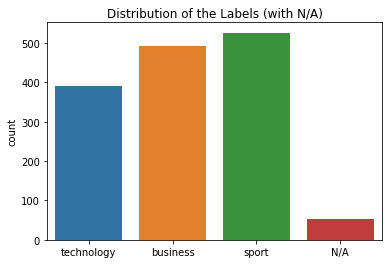

In [4]:
link_names_articles=[]
articles_all_months=[]
labels=[]
labels_old=[]
for i in range(len(link_names_months)):
    link_month='http://mlg.ucd.ie/modules/COMP41680/archive/'+link_names_months[i]
    #Fetch the HTML code from the web page
    response_month = urllib.request.urlopen(link_month)
    status_code_month=response_month.code
    if status_code_month == 200:
        print('status code = 200: The request succeeded, and the resource is returned.')
    elif status_code_month == 404:
        print('status code = 404: The requested resource does not exist.')
    elif status_code_month == 500:
        print('status code 500 = An unexpected error happened on the server side.')
    elif status_code_month == 301 or status_code_month == 302 or status_code_month == 303:
        print('status code = 301/302/303: The resource has moved to another URL.')
    else:
        print('status code =', status_code_month)

    html_month = response_month.read().decode()

    #Split into lines and print each line
    #lines_month = html_month.strip().split("\n")
    #for l in lines_month:
    #    print(l)
        
    parser_month = bs4.BeautifulSoup(html_month,"html.parser")
    all_text_month=[]
    for match in parser_month.find_all("body"):
        text_month = match.get_text()
        #print(text_month)
        all_text_month.append(text_month)
    article_month=" ".join(all_text_month)
    #print(article_month) #not a list

    #getting all the names for articles in a list 
    for link in parser_month.findAll('a'):
        link_names_articles.append(link.get('href'))
        #print(link_names_all_months[0:])
    link_names_articles=link_names_articles[0:-4] #removing 'index.html', '', '', ''
    link_names_articles_new = [x[:-5] for x in link_names_articles] # removing .html from names
    
    #Category Labels
    #Saving the category labels for all articles to a separate list labels[].
    all_text_labels=[]
    for match in parser_month.find_all("td"):
        text_labels = match.get_text()
        #print(text_labels)
        all_text_labels.append(text_labels)
     
    for i in range(2,len(all_text_labels),2):
            labels_old.append(all_text_labels[i])
    labels = [x[1:] for x in labels_old] #removing first unneccesery part from label names
    #print(labels)
    print('Number of category labels contining N/A labels',len(labels))
    ax = sns.countplot(labels) #seaborn.countplot - Show value counts for a single categorical variable
    ax.set_title("Distribution of the Labels (with N/A)")

    #Lets remove four N/A labels with no articles from labels list
    labels = [l for l in labels if l != 'N/A']
    print('Number of category labels without N/A labels',len(labels))
    #print(labels)

In [5]:
#print(labels)
#print(link_names_all_months_new)
print('There are',len(link_names_articles_new), 'web pages from which we need to extract the main body text containing the content of each news article, and', len(labels),'category labels')

There are 1408 web pages from which we need to extract the main body text containing the content of each news article, and 1408 category labels


From the plot we can see that labels do not have balanced distribution, hence we should apply the 
random under-sampling later on.
Oversampling and undersampling in data analysis are techniques used to adjust the class distribution of a data set 
(i.e. the ratio between the different classes/categories represented).

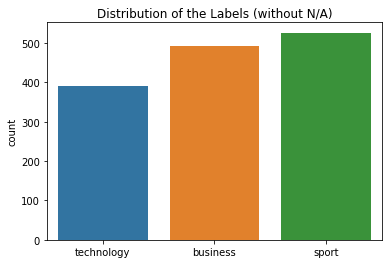

In [6]:
#Plot a bar plot of the labels
ax = sns.countplot(labels) #seaborn.countplot - Show value counts for a single categorical variable
ax.set_title("Distribution of the Labels (without N/A)")
plt.show()

We need to extract the main body text containing the content of each news article. We can use BeautifulSoup to find all these tags and get the text between them. We can use < body> tags or combination of < p> and < b> tags.
Note: In some articles Title is in < b> tab, while in some in < p>

In [7]:
#Extracting the main body text from the web pages containing the content of each news article.
articles_body=[]
aricles_b_p=[]
aricles_b_p_no_end=[]

link_article = []
for i in range(len(link_names_articles_new)):
    link="http://mlg.ucd.ie/modules/COMP41680/archive/"+link_names_articles_new[i] +".html"
    print('\n',link_names_articles_new[i])
    response = urllib.request.urlopen(link)
    status_code=response.code
    if status_code == 200:
        print('status code = 200: The request succeeded, and the resource is returned.')
    elif status_code == 404:
        print('status code = 404: The requested resource does not exist.')
    elif status_code == 500:
        print('status code 500 = An unexpected error happened on the server side.')
    elif status_code == 301 or status_code == 302 or status_code == 303:
        print('status code = 301/302/303: The resource has moved to another URL.')
    else:
        print('status code =', status_code)   
    html = response.read().decode()      
    #Split into lines and print each line
    #lines = html.strip().split("\n")
    #for l in lines:
    #    print(l)
    parser = bs4.BeautifulSoup(html,"html.parser")
    all_text_body=[]
    #Extracting text between < body> tags
    for match in parser.find_all("body"):
        text = match.get_text()
        #print(text)
        all_text_body.append(text)
    #print(all_text)
    article_body=" ".join(all_text_body)
    #print(article) 
    articles_body.append(article_body)
     
    all_text_b_p=[]
    #Extracting text between < b> and < p> tags
    for match in parser.find_all("b"):
        text = match.get_text()
        #print(text)
        all_text_b_p.append(text)
    for match in parser.find_all("p"):
        text = match.get_text()
        #print(text)
        all_text_b_p.append(text)      
    #print(all_text)
    article_b_p=" ".join(all_text_b_p)
    #print(article) 
    aricles_b_p.append(article_b_p)
    
    #Removing: 'Return to article search results' or 'Comments are closed for this article.' 
    #These sentences at the end don't have much to do with the article category so we want to exclude them so 
    #they don't influence similarity between documents/articles
    all_text_b_p_no_end = all_text_b_p[:-1]     
    article_b_p_no_end=" ".join(all_text_b_p_no_end)
    #print(article) 
    aricles_b_p_no_end.append(article_b_p_no_end)


 article-jan-0418
status code = 200: The request succeeded, and the resource is returned.

 article-jan-0027
status code = 200: The request succeeded, and the resource is returned.

 article-jan-0631
status code = 200: The request succeeded, and the resource is returned.

 article-jan-2105
status code = 200: The request succeeded, and the resource is returned.

 article-jan-3300
status code = 200: The request succeeded, and the resource is returned.

 article-jan-4187
status code = 200: The request succeeded, and the resource is returned.

 article-jan-1974
status code = 200: The request succeeded, and the resource is returned.

 article-jan-3666
status code = 200: The request succeeded, and the resource is returned.

 article-jan-2629
status code = 200: The request succeeded, and the resource is returned.

 article-jan-2415
status code = 200: The request succeeded, and the resource is returned.

 article-jan-4210
status code = 200: The request succeeded, and the resource is returned.

status code = 200: The request succeeded, and the resource is returned.

 article-jan-2407
status code = 200: The request succeeded, and the resource is returned.

 article-jan-1520
status code = 200: The request succeeded, and the resource is returned.

 article-jan-3036
status code = 200: The request succeeded, and the resource is returned.

 article-jan-1051
status code = 200: The request succeeded, and the resource is returned.

 article-jan-2864
status code = 200: The request succeeded, and the resource is returned.

 article-jan-4078
status code = 200: The request succeeded, and the resource is returned.

 article-jan-0269
status code = 200: The request succeeded, and the resource is returned.

 article-jan-1728
status code = 200: The request succeeded, and the resource is returned.

 article-jan-0976
status code = 200: The request succeeded, and the resource is returned.

 article-jan-3315
status code = 200: The request succeeded, and the resource is returned.

 article-jan-3425

status code = 200: The request succeeded, and the resource is returned.

 article-feb-1201
status code = 200: The request succeeded, and the resource is returned.

 article-feb-4578
status code = 200: The request succeeded, and the resource is returned.

 article-feb-3474
status code = 200: The request succeeded, and the resource is returned.

 article-feb-4987
status code = 200: The request succeeded, and the resource is returned.

 article-feb-4718
status code = 200: The request succeeded, and the resource is returned.

 article-feb-2135
status code = 200: The request succeeded, and the resource is returned.

 article-feb-1118
status code = 200: The request succeeded, and the resource is returned.

 article-feb-4768
status code = 200: The request succeeded, and the resource is returned.

 article-feb-4017
status code = 200: The request succeeded, and the resource is returned.

 article-feb-1005
status code = 200: The request succeeded, and the resource is returned.

 article-feb-0504

status code = 200: The request succeeded, and the resource is returned.

 article-mar-0012
status code = 200: The request succeeded, and the resource is returned.

 article-mar-4343
status code = 200: The request succeeded, and the resource is returned.

 article-mar-3567
status code = 200: The request succeeded, and the resource is returned.

 article-mar-1674
status code = 200: The request succeeded, and the resource is returned.

 article-mar-3810
status code = 200: The request succeeded, and the resource is returned.

 article-mar-3301
status code = 200: The request succeeded, and the resource is returned.

 article-mar-2795
status code = 200: The request succeeded, and the resource is returned.

 article-mar-3037
status code = 200: The request succeeded, and the resource is returned.

 article-mar-1629
status code = 200: The request succeeded, and the resource is returned.

 article-mar-0481
status code = 200: The request succeeded, and the resource is returned.

 article-mar-0388

status code = 200: The request succeeded, and the resource is returned.

 article-apr-3933
status code = 200: The request succeeded, and the resource is returned.

 article-apr-4960
status code = 200: The request succeeded, and the resource is returned.

 article-apr-4241
status code = 200: The request succeeded, and the resource is returned.

 article-apr-4901
status code = 200: The request succeeded, and the resource is returned.

 article-apr-0724
status code = 200: The request succeeded, and the resource is returned.

 article-apr-4907
status code = 200: The request succeeded, and the resource is returned.

 article-apr-3088
status code = 200: The request succeeded, and the resource is returned.

 article-apr-0395
status code = 200: The request succeeded, and the resource is returned.

 article-apr-4460
status code = 200: The request succeeded, and the resource is returned.

 article-apr-0524
status code = 200: The request succeeded, and the resource is returned.

 article-apr-3536

status code = 200: The request succeeded, and the resource is returned.

 article-may-2027
status code = 200: The request succeeded, and the resource is returned.

 article-may-2024
status code = 200: The request succeeded, and the resource is returned.

 article-may-2738
status code = 200: The request succeeded, and the resource is returned.

 article-may-4424
status code = 200: The request succeeded, and the resource is returned.

 article-may-2659
status code = 200: The request succeeded, and the resource is returned.

 article-may-4512
status code = 200: The request succeeded, and the resource is returned.

 article-may-0131
status code = 200: The request succeeded, and the resource is returned.

 article-may-2874
status code = 200: The request succeeded, and the resource is returned.

 article-may-2905
status code = 200: The request succeeded, and the resource is returned.

 article-may-1663
status code = 200: The request succeeded, and the resource is returned.

 article-may-1702

status code = 200: The request succeeded, and the resource is returned.

 article-may-1288
status code = 200: The request succeeded, and the resource is returned.

 article-may-2467
status code = 200: The request succeeded, and the resource is returned.

 article-may-2263
status code = 200: The request succeeded, and the resource is returned.

 article-may-0648
status code = 200: The request succeeded, and the resource is returned.

 article-may-3222
status code = 200: The request succeeded, and the resource is returned.

 article-may-1355
status code = 200: The request succeeded, and the resource is returned.

 article-may-3184
status code = 200: The request succeeded, and the resource is returned.

 article-may-2365
status code = 200: The request succeeded, and the resource is returned.

 article-may-0720
status code = 200: The request succeeded, and the resource is returned.

 article-may-3287
status code = 200: The request succeeded, and the resource is returned.

 article-may-2299

status code = 200: The request succeeded, and the resource is returned.

 article-jul-3520
status code = 200: The request succeeded, and the resource is returned.

 article-jul-0643
status code = 200: The request succeeded, and the resource is returned.

 article-jul-3273
status code = 200: The request succeeded, and the resource is returned.

 article-jul-3870
status code = 200: The request succeeded, and the resource is returned.

 article-jul-0803
status code = 200: The request succeeded, and the resource is returned.

 article-jul-4157
status code = 200: The request succeeded, and the resource is returned.

 article-jul-0297
status code = 200: The request succeeded, and the resource is returned.

 article-jul-4908
status code = 200: The request succeeded, and the resource is returned.

 article-jul-1013
status code = 200: The request succeeded, and the resource is returned.

 article-jul-4496
status code = 200: The request succeeded, and the resource is returned.

 article-jul-3168

status code = 200: The request succeeded, and the resource is returned.

 article-aug-1784
status code = 200: The request succeeded, and the resource is returned.

 article-aug-2063
status code = 200: The request succeeded, and the resource is returned.

 article-aug-1532
status code = 200: The request succeeded, and the resource is returned.

 article-aug-0644
status code = 200: The request succeeded, and the resource is returned.

 article-aug-3247
status code = 200: The request succeeded, and the resource is returned.

 article-aug-2464
status code = 200: The request succeeded, and the resource is returned.

 article-aug-2142
status code = 200: The request succeeded, and the resource is returned.

 article-aug-1157
status code = 200: The request succeeded, and the resource is returned.

 article-aug-2119
status code = 200: The request succeeded, and the resource is returned.

 article-aug-3859
status code = 200: The request succeeded, and the resource is returned.

 article-aug-1614


 article-aug-1146
status code = 200: The request succeeded, and the resource is returned.

 article-sep-1375
status code = 200: The request succeeded, and the resource is returned.

 article-sep-3874
status code = 200: The request succeeded, and the resource is returned.

 article-sep-0096
status code = 200: The request succeeded, and the resource is returned.

 article-sep-3814
status code = 200: The request succeeded, and the resource is returned.

 article-sep-4619
status code = 200: The request succeeded, and the resource is returned.

 article-sep-3639
status code = 200: The request succeeded, and the resource is returned.

 article-sep-4996
status code = 200: The request succeeded, and the resource is returned.

 article-sep-3370
status code = 200: The request succeeded, and the resource is returned.

 article-sep-0503
status code = 200: The request succeeded, and the resource is returned.

 article-sep-4426
status code = 200: The request succeeded, and the resource is returned.

status code = 200: The request succeeded, and the resource is returned.

 article-sep-2914
status code = 200: The request succeeded, and the resource is returned.

 article-sep-0174
status code = 200: The request succeeded, and the resource is returned.

 article-sep-4443
status code = 200: The request succeeded, and the resource is returned.

 article-sep-0063
status code = 200: The request succeeded, and the resource is returned.

 article-sep-4940
status code = 200: The request succeeded, and the resource is returned.

 article-sep-2528
status code = 200: The request succeeded, and the resource is returned.

 article-sep-4107
status code = 200: The request succeeded, and the resource is returned.

 article-sep-2374
status code = 200: The request succeeded, and the resource is returned.

 article-sep-3813
status code = 200: The request succeeded, and the resource is returned.

 article-sep-2892
status code = 200: The request succeeded, and the resource is returned.

 article-sep-0388

status code = 200: The request succeeded, and the resource is returned.

 article-oct-3663
status code = 200: The request succeeded, and the resource is returned.

 article-oct-2181
status code = 200: The request succeeded, and the resource is returned.

 article-oct-0999
status code = 200: The request succeeded, and the resource is returned.

 article-oct-2121
status code = 200: The request succeeded, and the resource is returned.

 article-oct-2094
status code = 200: The request succeeded, and the resource is returned.

 article-oct-2301
status code = 200: The request succeeded, and the resource is returned.

 article-oct-0815
status code = 200: The request succeeded, and the resource is returned.

 article-oct-3222
status code = 200: The request succeeded, and the resource is returned.

 article-oct-4804
status code = 200: The request succeeded, and the resource is returned.

 article-oct-1215
status code = 200: The request succeeded, and the resource is returned.

 article-oct-2080

status code = 200: The request succeeded, and the resource is returned.

 article-dec-2115
status code = 200: The request succeeded, and the resource is returned.

 article-dec-0625
status code = 200: The request succeeded, and the resource is returned.

 article-dec-2771
status code = 200: The request succeeded, and the resource is returned.

 article-dec-0788
status code = 200: The request succeeded, and the resource is returned.

 article-dec-1911
status code = 200: The request succeeded, and the resource is returned.

 article-dec-3413
status code = 200: The request succeeded, and the resource is returned.

 article-dec-0038
status code = 200: The request succeeded, and the resource is returned.

 article-dec-0035
status code = 200: The request succeeded, and the resource is returned.

 article-dec-4444
status code = 200: The request succeeded, and the resource is returned.

 article-dec-4307
status code = 200: The request succeeded, and the resource is returned.

 article-dec-4450

status code = 200: The request succeeded, and the resource is returned.

 article-dec-0068
status code = 200: The request succeeded, and the resource is returned.


List *articles_body* contains a list of strings - articles. Each article unnecessaraly contains:
* Title of the article two times, instead of just once, and 
* Each article ends with:
    'Return to article search results' OR 'Comments are closed for this article.' 
    Home | Terms & Conditions | Privacy Policy | Cookie Information 
    © 2017 — Original rights holders

These sentences at the end don't have much to do with the article and hence the article category.
We need to exclude them in orther for them not to influence similarity between documents/articles. 
Also, there is no need to have the Title writen twice, as that would affect our term vector/ term matrix (as we would count the appearance of the words in title twice)

Hence, we are going to use list *aricles_b_p_no_end*.

In [8]:
print('Number of articles in articles_body',len(articles_body))
print('Number of articles in aricles_b_p',len(aricles_b_p))
print('Number of articles in aricles_b_p_no_end', len(aricles_b_p_no_end))

#print(articles_body[0]) 
#print(aricles_b_p[0]) #unnecessary

#Let's check how the 1st article looks like
print('\n',aricles_b_p_no_end[0]) 
#print(aricles_b_p_no_end[0:5]) #prints the list containing first five articles

Number of articles in articles_body 1408
Number of articles in aricles_b_p 1408
Number of articles in aricles_b_p_no_end 1408

 21st-Century Sports: How Digital Technology Is Changing the Face Of The Sporting Industry  The sporting industry has come a long way since the ‘60s. It has carved out for itself a niche with its roots so deep that I cannot fathom the sports industry showing any sign of decline any time soon - or later.  The reason can be found in this seemingly subtle difference - other industries have customers; the sporting industry has fans. Vivek Ranadivé, leader of the ownership group of the NBA’s Sacramento Kings, explained it beautifully, “Fans will paint their face purple, fans will evangelize. ... Every other CEO in every business is dying to be in our position — they’re dying to have fans.“  While fan passion alone could almost certainly keep the industry going, leagues and sporting franchises have decided not to rest on their laurels. The last few years have seen th

We will store these articles in a single file and formatted so that one article appears on each line.

In [9]:
#Saving the body of each article as plain text.
for i in range(len(aricles_b_p_no_end)):
    fout = open("news-articles.txt","a")
    fout.write(aricles_b_p_no_end[i])  
    fout.write("\n")  #need to explicitly move to next line, so that each article appears on each line
    fout.close() 

Saving the category labels for all articles in a separate file.

In [10]:
#Saving the category labels for all articles in a separate file.
for i in range(len(aricles_b_p_no_end)):
    fout = open("labels.txt","a")  #"a"- to add data to the end of an existing file
    fout.write(labels[i])  
    fout.write("\n")  #need to explicitly move to next line
    fout.close()

### Part 2. Text Classification
The goal here is to analyse the corpus of documents from Part 1 in a text classification
context. Tasks to be completed:
1. From the files created in Part 1, **load** the **set of raw documents** into your
**notebook**. Ensure that **each document** has a **class label**, based on the **original
category label** that you identified.
2. From the raw documents, create a **document-term matrix**, using appropriate
**text pre-processing** and **term weighting** steps.
3. Build two multi-class classification models using two different classifiers of your
choice.
4. Compare the predictions of the two classification models using an appropriate
evaluation strategy. Report and discuss the evaluation results in your notebook. 

We will look at a range of text mining techniques, available as part of Scikit-learn.

As our sample corpus of text, we will read a collection of news articles. These articles have been stored in a single file and formatted so that one article appears on each line.

In [291]:
#Loading the set of raw documents into the notebook as raw_documents list
fin = open("news-articles.txt","r") # "r" - read
raw_documents = fin.readlines() #read all lines from a file to a list
fin.close()
print("Read %d raw text documents/articles" % len(raw_documents))

Read 1408 raw text documents/articles


In [292]:
#Loading class labels into the notebook as class_labels list
#Each document has a class label, based on the original category label that was identified.
fin = open("labels.txt","r")
class_labels = fin.readlines()
fin.close()
print("Read %d class labels" % len(class_labels))
#print(class_labels)

Read 1408 class labels


#### From the raw documents, create a document-term matrix, using appropriate text pre-processing and term weighting steps.
#### **Note**: Several following code/markdown cells serve to showcase pre-rocessing techniques needed for creating document-term matrix.
#### If not relevant, **skip to "Creating Document Term Matrix & using appropriate Text Pre-processing" pharagraph**.

### Tokenizing Text

Raw text documents are textual, not numeric. The first step in analysing unstructured documents is to split the raw text into individual tokens, each corresponding to a single term (word). As an example:

In [293]:
doc1 = raw_documents[0] #1st document/article from raw_documents
# print a snippet
print(doc1[0:300]) #print first 300 characters from first document

21st-Century Sports: How Digital Technology Is Changing the Face Of The Sporting Industry  The sporting industry has come a long way since the ‘60s. It has carved out for itself a niche with its roots so deep that I cannot fathom the sports industry showing any sign of decline any time soon - or lat


We will use the built-in scikit-learn **tokenizer** to split this document into tokens. Note that we will perform **case conversion** first to convert the entire text to lowercase.

In [294]:
tokenize = CountVectorizer().build_tokenizer()
# convert to lowercase, then tokenize
tokens1 = tokenize(doc1.lower()) #doc1.lower()-case conversion; tokenize(doc1.lower())-splitting into tokens
print(tokens1)

['21st', 'century', 'sports', 'how', 'digital', 'technology', 'is', 'changing', 'the', 'face', 'of', 'the', 'sporting', 'industry', 'the', 'sporting', 'industry', 'has', 'come', 'long', 'way', 'since', 'the', '60s', 'it', 'has', 'carved', 'out', 'for', 'itself', 'niche', 'with', 'its', 'roots', 'so', 'deep', 'that', 'cannot', 'fathom', 'the', 'sports', 'industry', 'showing', 'any', 'sign', 'of', 'decline', 'any', 'time', 'soon', 'or', 'later', 'the', 'reason', 'can', 'be', 'found', 'in', 'this', 'seemingly', 'subtle', 'difference', 'other', 'industries', 'have', 'customers', 'the', 'sporting', 'industry', 'has', 'fans', 'vivek', 'ranadivé', 'leader', 'of', 'the', 'ownership', 'group', 'of', 'the', 'nba', 'sacramento', 'kings', 'explained', 'it', 'beautifully', 'fans', 'will', 'paint', 'their', 'face', 'purple', 'fans', 'will', 'evangelize', 'every', 'other', 'ceo', 'in', 'every', 'business', 'is', 'dying', 'to', 'be', 'in', 'our', 'position', 'they', 're', 'dying', 'to', 'have', 'fans'

We immediately see that many of the words here are not useful (e.g. "while", "the" etc.). Scikit-learn provides a list of such **stop words**:

In [295]:
from sklearn.feature_extraction import text
#List of English stop words
stopwords = text.ENGLISH_STOP_WORDS
print(stopwords)

frozenset({'fifteen', 'these', 'a', 'own', 'co', 'had', 'however', 'only', 'with', 'un', 'too', 'move', 'several', 'others', 'still', 'hasnt', 'whereupon', 'thereby', 'whole', 'see', 'noone', 'per', 'can', 'has', 'whether', 'because', 'last', 'already', 'once', 'beside', 'those', 'almost', 'go', 'amongst', 'beyond', 'part', 'ten', 'would', 'perhaps', 'mill', 'whither', 'fire', 'and', 'formerly', 'again', 'one', 'what', 'front', 'becoming', 'below', 'everyone', 'everything', 'for', 'latter', 'yet', 'anywhere', 'nobody', 'she', 'themselves', 'couldnt', 'well', 'none', 'at', 'wherein', 'himself', 'mine', 'few', 'whoever', 'amount', 'cannot', 'indeed', 'someone', 'some', 'when', 'thin', 'but', 'will', 'nor', 'though', 'next', 'to', 'which', 'became', 'namely', 'keep', 'although', 'meanwhile', 'otherwise', 'more', 'anything', 'least', 'until', 'found', 'by', 'many', 'much', 'herein', 'afterwards', 'anyone', 're', 'into', 'across', 'ever', 'due', 'her', 'he', 'them', 'enough', 'so', 'either'

We can **filter out** these **stopwords** from our document:

In [296]:
filtered_tokens1 = []
for token in tokens1:  #tokens1 - list of lowercase terms/words/tokens from document1/article1
    if not token in stopwords:  #stopwords - list of english stopwords
        filtered_tokens1.append(token)
print(filtered_tokens1)  #filtered_tokens1 - list of lowercase tokens/terms/words without stopwords

['21st', 'century', 'sports', 'digital', 'technology', 'changing', 'face', 'sporting', 'industry', 'sporting', 'industry', 'come', 'long', 'way', '60s', 'carved', 'niche', 'roots', 'deep', 'fathom', 'sports', 'industry', 'showing', 'sign', 'decline', 'time', 'soon', 'later', 'reason', 'seemingly', 'subtle', 'difference', 'industries', 'customers', 'sporting', 'industry', 'fans', 'vivek', 'ranadivé', 'leader', 'ownership', 'group', 'nba', 'sacramento', 'kings', 'explained', 'beautifully', 'fans', 'paint', 'face', 'purple', 'fans', 'evangelize', 'ceo', 'business', 'dying', 'position', 'dying', 'fans', 'fan', 'passion', 'certainly', 'industry', 'going', 'leagues', 'sporting', 'franchises', 'decided', 'rest', 'laurels', 'years', 'seen', 'steady', 'introduction', 'technology', 'world', 'sports', 'amplifying', 'fans', 'appreciation', 'games', 'enhancing', 'athletes', 'public', 'profiles', 'informing', 'training', 'methods', 'influencing', 'contests', 'waged', 'digital', 'technology', 'partic

We will repeat this process for **all documents**:

In [297]:
all_filtered_tokens = []
for doc in raw_documents:  #raw_documents - list of documents/articles (lines in a file)
    # tokenize the next document
    tokens = tokenize(doc.lower()) #tokens - list of lowercase tokens from document doc
    # remove the stopwords
    filtered_tokens = []
    for token in tokens:
        if not token in stopwords:
            filtered_tokens.append(token)  #list of lowercase tokens without stpowords for that document
    # add to the overall list
    all_filtered_tokens.append( filtered_tokens ) #all_filtered_tokens- list of lists of lowercase tokens without 
                                                  #stopwords for each document in raw_documents
print("Created %d filtered token lists" % len(all_filtered_tokens) )
print('Number of tokens in 1st raw_document/article:', len(all_filtered_tokens[0]))
#all_filtered_tokens[0:3]

Created 1408 filtered token lists
Number of tokens in 1st raw_document/article: 110


### Counting Tokens

A simple type of analysis that we might do is to **count the number of times specific terms (words) appear in our corpus**. We could do this by creating a **dictionary** of **term frequency counts**:

In [298]:
#counts - dictionary of term frequancy counts, where:
#   --> key is token/word/term, and
#   --> value is the count (frequency of the token)
counts = {} 
# process filtered tokens for each document
for doc_tokens in all_filtered_tokens:
    for token in doc_tokens:
        # increment if existing
        if token in counts:
            counts[token] += 1
        # set up to 1 if it is a new term
        else:
            counts[token] = 1
print("Found %d unique terms in this corpus" % len(counts)) #22601 unique terms found
                                                            #accross doc_tokens in all_filtered_tokens
                                                            #(unique lowercase terms without stopwords)

Found 22601 unique terms in this corpus


We would like to find the **terms** in the **dictionary** with the **highest counts**. Python provides a convenient way of doing this.

The below creates a **list of tuple pairs**, where the **first value** is the **key** (i.e. the term/token) and the **second value** is the **value** (i.e the count). Let's display the top 20 terms.

In [299]:
sorted_counts = sorted(counts.items(), key=operator.itemgetter(1), reverse=True) #list of tuple pairs

In [300]:
for i in range(20):
    term = sorted_counts[i][0]
    count = sorted_counts[i][1]
    print( "%s (count=%d)" % ( term, count )  )

said (count=4119)
year (count=1557)
new (count=1215)
people (count=1203)
mr (count=1092)
world (count=960)
time (count=933)
game (count=881)
news (count=767)
online (count=728)
just (count=683)
market (count=644)
like (count=618)
games (count=608)
company (count=601)
players (count=599)
years (count=598)
make (count=597)
technology (count=576)
firm (count=547)


##### Bag-of-Words Representation
##### Corpus Vocabulary - vector in an m-dim space where m=len(counts)= 22601 (positioning of terms/words/tokens is lost)
##### Document Term Matrix - stacked term vectors

In the *bag-of-words model*, each document is represented by a vector in an *m*-dimensional coordinate space, where *m* is number of unique terms across all documents. This set of terms is called the corpus *vocabulary*. Note that the positioning (context) of terms within the original document is lost in this model.

Since each document can be represented as a term vector, we can stack these vectors to create a full *document-term matrix*. We can easily create this matrix from a list of document strings using Scikit-learn:

##### Document Term Matrix - stacked term vectors

In [301]:
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(raw_documents) #X - document-term matrix (each row represents document as a term vector)
print(X.shape) #(1408, 22895), where 1408 is the number of documents and 
               #22895 is the number of unique terms across all documents 
               #(stop-words are not filtered here, hence 22895 unique terms instead of 22601 like in above case )
               #Note. Scikit-learn does case conversion and minimum term length by default

#print(X[0])

(1408, 22895)


This process also builds a **vocabulary** for the corpus, both in the **form of a list** and in the **form of a dictionary**:

In [302]:
#Vocabulary for the corpus in the form of a list (list of terms) --> how many terms in the vocabulary?
terms = vectorizer.get_feature_names()

#Vocabulary for the Corpus in the Form of a dictionary 
#(dictionary which maps each unique term to a corresponding column in the matrix)-->Which column corresponds to a term?
vocab = vectorizer.vocabulary_
print("Vocabulary has %d distinct terms" % len(terms))

Vocabulary has 22895 distinct terms


Display some sample terms:

In [303]:
print(terms[10000:10050]) 

['helpful', 'helping', 'helpless', 'helps', 'helsinki', 'hemin', 'hemington', 'hemisphere', 'hence', 'henchoz', 'henderson', 'hendrix', 'henin', 'henk', 'henman', 'hennigar', 'henri', 'henric', 'henrik', 'henry', 'hensel', 'henson', 'heptathlon', 'her', 'herald', 'heralded', 'heralds', 'herbert', 'hercus', 'herded', 'here', 'heretic', 'heritage', 'hermann', 'herne', 'hernych', 'hero', 'heroes', 'heroic', 'heroics', 'heronry', 'herren', 'herself', 'hertfordshire', 'hertrich', 'hertzfeld', 'herve', 'hesaid', 'heseltine', 'hesitant']


Since each **column** in the **document-term matrix** correspond to a **term**, we can look up the **column** associated with each **term** using the **dictionary**:

In [304]:
# what column is the term 'year' on?
print('year column:', vocab["year"])
# what column is the term 'world' on?
print('world column:', vocab["world"])
# what column is the term 'games' on?
print('games column:', vocab["games"])
# what column is the term 'technology' on?
print('technology column:', vocab["technology"])
# what column is the term 'players' on?
print('players column:', vocab["players"])

year column: 22776
world column: 22628
games column: 9024
technology column: 20420
players column: 15620


###### BIGRAMS & N-GRAMS
###### Bag of words model (document-term matrix) does not preserve sequence in formation, so the order of words in a sentence is lost. 
###### Solution: Adjacent tokens 

###### TERM BIGRAMS - build terms from every pair of adjacent tokens  (N-GRAMS - N adjacent tokens)

We can use the same Scikit-learn functionality to create a **document-term matrix with N-grams**. We specify an extra parameter **ngram_range** which specifies the shortest and longest token sequences to include. Length 1 is just a single token.

For instance, transform our input documents into a matrix, extracting single tokens and bigrams:

In [305]:
vectorizer = CountVectorizer(ngram_range = (1,2)) #(1,2) - single tokens and bigrams
X = vectorizer.fit_transform(raw_documents) #X - document-term matrix where each row represents document as a term vector 
                                            #(single tokens & birams are columns)

Note the vocabulary is much larger now:

In [306]:
terms = vectorizer.get_feature_names()
vocab = vectorizer.vocabulary_
print("Vocabulary has %d distinct terms" % len(terms))  #still includes English stop-words

Vocabulary has 253007 distinct terms


Display some sample terms. Note that we see a mix of single tokens and bigrams (i.e. phrases of length 2):

In [307]:
print(terms[250000:250030])

['worries that', 'worries total', 'worries wholesale', 'worry', 'worry about', 'worry bit', 'worry centres', 'worry is', 'worry me', 'worry over', 'worry that', 'worry there', 'worry we', 'worrying', 'worrying about', 'worrying for', 'worrying if', 'worrying implications', 'worrying precedent', 'worrying signs', 'worrying telecoms', 'worrying that', 'worrying thing', 'worrying tone', 'worrying within', 'worryingly', 'worryingly easy', 'worryingly said', 'worse', 'worse 90']


##### Text Preprocessing

A range of steps can be used to process **text input files** to **reduce the number of terms** used to represent the text and to **improve** the resulting **bag-of-words model**. These include:
- **Minimum term length**: Exclude terms of length < 2. Scikit-learn does this by default.
- **Case conversion**: Converting all terms to lowercase. Scikit-learn does this by default.
- **Stop-word filtering**: Remove terms that appear on a **pre-defined "blacklist"** of terms that are **highly frequent** and do- not convey useful information.
- **Low frequency filtering**: Remove terms that appear in very few documents.
- **Stemming**: Reduce words to their stems (or base forms).
- **Lemmatization**: reduces a term to its canonical form (more advanced from stemming)

Scikit-learn allows us to perform one or more of these steps by adapting the CountVectorizer.

We can use the **built-in list of stop-words for a given language** by just specifying the name of the language (lower-case):

In [308]:
vectorizer = CountVectorizer(stop_words="english")
X = vectorizer.fit_transform(raw_documents)
print("Number of terms in model is %d" % len(vectorizer.vocabulary_) )
# Are standard stopwords gone? Let's check if "the" is in vocabulary
"the" in vectorizer.vocabulary_ #we get "false", hence built-in english stop-words were filtered out

Number of terms in model is 22601


False

Or we could use our own **custom stop-word list**, which might be more appropriate for specific applications:

In [309]:
custom_stop_words = [ "and", "the", "while" , "or"] 
vectorizer = CountVectorizer(stop_words=custom_stop_words)
X = vectorizer.fit_transform(raw_documents)
print("Number of terms in model is %d" % len(vectorizer.vocabulary_) )
# Are custom stopwords gone?
"while" in vectorizer.vocabulary_ #custom stop-words are gone

Number of terms in model is 22891


False

We can remove **low frequency terms** that appear in fewer than a specified number of documents:

In [310]:
# how many terms did we have with when we don't filter out stop words?
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(raw_documents)
print("Number of terms in model is %d" % len(vectorizer.vocabulary_) )

Number of terms in model is 22895


In [311]:
# build another matrix, but filter terms appearing in less than 5 documents
vectorizer = CountVectorizer(min_df = 5)
X = vectorizer.fit_transform(raw_documents)
print("Number of terms in model is %d" % len(vectorizer.vocabulary_) )

Number of terms in model is 7078


### Stemming 
##### Endings are removed (things like tense or plurals)

To stem tokens to their base form, we need to use functionality from another third party library.

We can test out the standard **English stemming algorithm** (called the **Porter Stemmer**):

In [312]:
# import the standard English stemming algorithm
from nltk.stem.porter import PorterStemmer
words = [sorted_counts[i][0] for i in range(20)] #list of top20 terms in the dictionary with the highest counts
print(words)
# trying stemming each sample word
stemmer = PorterStemmer()
for w in words:
    print( stemmer.stem(w) )

['said', 'year', 'new', 'people', 'mr', 'world', 'time', 'game', 'news', 'online', 'just', 'market', 'like', 'games', 'company', 'players', 'years', 'make', 'technology', 'firm']
said
year
new
peopl
mr
world
time
game
news
onlin
just
market
like
game
compani
player
year
make
technolog
firm


To use **NLTK stemming with Scikit-learn**, we need to create a **custom tokenisation function**:

In [313]:
import nltk
# define the function
def stem_tokenizer(text):
    # use the standard scikit-learn tokenizer first
    standard_tokenizer = CountVectorizer().build_tokenizer()
    tokens = standard_tokenizer(text)
    # then use NLTK to perform stemming on each token
    stemmer = PorterStemmer()
    stems = []
    for token in tokens:
        stems.append( stemmer.stem(token) )
    return stems

Now we can use our **custom tokenizer** with the standard **CountVectorizer approach**:

In [314]:
vectorizer = CountVectorizer(tokenizer=stem_tokenizer)
X = vectorizer.fit_transform(raw_documents)
# display some sample terms
terms = vectorizer.get_feature_names()
print(terms[1400:1420])

['affect', 'afficiando', 'affili', 'affirm', 'afflict', 'affluent', 'afford', 'afghanistan', 'afield', 'afoot', 'afp', 'afraid', 'africa', 'african', 'after', 'aftermath', 'afternoon', 'afterward', 'afteward', 'ag']


### Lemmatization
##### Reduces a term to its canonical form (more advanced from stemming)

We can perform **lemmatisation** in the same way, using **NLTK with Sckit-learn** (**WordNetLemmatizer()**):

In [315]:
# define the function
def lemma_tokenizer(text):
    # use the standard scikit-learn tokenizer first
    standard_tokenizer = CountVectorizer().build_tokenizer()
    tokens = standard_tokenizer(text)
    # then use NLTK to perform lemmatisation on each token
    lemmatizer = nltk.stem.WordNetLemmatizer()
    lemma_tokens = []
    for token in tokens:
        lemma_tokens.append( lemmatizer.lemmatize(token) )
    return lemma_tokens

Again we can use our **custom tokenizer** with the standard **CountVectorizer** approach. The **output terms** from **lemmatization** are somewhat **easier to intrepret** than those produced by **stemming**:

In [316]:
#[Link](https://stackoverflow.com/questions/13965823/resource-corpora-wordnet-not-found-on-heroku)
#nltk.download("wordnet", "whatever_the_absolute_path_to_myapp_is/nltk_data/")
nltk.download("wordnet", "/Users/aidasehic/Desktop/PYTHON/nltk_data/")

[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/aidasehic/Desktop/PYTHON/nltk_data/...
[nltk_data]   Package wordnet is already up-to-date!


True

In [317]:
nltk.data.path.append('/Users/aidasehic/Desktop/PYTHON/nltk_data')

In [318]:
vectorizer = CountVectorizer(tokenizer=lemma_tokenizer) #function lemma_tokenizer defined above
X = vectorizer.fit_transform(raw_documents)
# display some sample terms
print(list(vectorizer.vocabulary_.keys())[0:35])

['21st', 'century', 'sport', 'how', 'digital', 'technology', 'is', 'changing', 'the', 'face', 'of', 'sporting', 'industry', 'ha', 'come', 'long', 'way', 'since', '60', 'it', 'carved', 'out', 'for', 'itself', 'niche', 'with', 'root', 'so', 'deep', 'that', 'cannot', 'fathom', 'showing', 'any', 'sign']


## Creating Document Term Matrix & using appropriate Text Pre-processing

### Text Processing Pipeline Overview
##### Typical text preprocessing steps for processing a corpus...

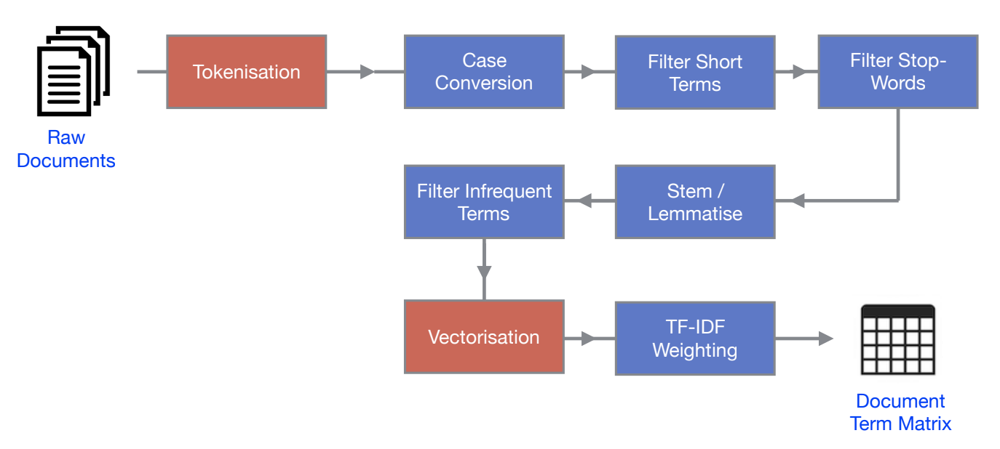

In [342]:
 Image(filename='text_processing_steps.png') 

### Let's put all of these steps together: **stop words**, **low frequency terms**, **lemmatization**.
Note: Scikit-learn does **Minimum term length** and **Case conversion** by default.

In [319]:
#does case conversion and min. term lenght by default
vectorizer_preprocessing = CountVectorizer(stop_words="english",min_df = 3,tokenizer=lemma_tokenizer) 
X_preproc = vectorizer_preprocessing.fit_transform(raw_documents)
print(X_preproc.shape)  # By default (1408, 22895), with all the steps (1408, 8750)

(1408, 8750)


In [320]:
print(list(vectorizer_preprocessing.vocabulary_.keys())[8000:8035])

['adelaide', 'hardcourt', 'ignacio', 'chela', 'melzer', 'kiefer', 'joachim', 'enqvist', 'pure', 'palmer', 'plea', 'retrieve', 'deleted', 'quinlan', 'purely', 'costello', 'duffy', 'citizenship', 'incumbent', 'ill', 'kenya', 'ak', 'isaiah', 'snack', 'obesity', 'wisely', 'quota', 'rand', 'organization', 'hat', 'taiwan', 'mauritius', 'mountainous', 'bus', 'donor']


### Let's use N-Grams in combination with  all of those steps together (**stop words**, **low frequency terms**, **lemmatization**).
**BIGRAMS** - building terms from every pair of adjacent tokens  (N-GRAMS - N adjacent tokens) with a goal of solving the problem with losing the order of words in a sentence (that bag of words representation has).
Note: Scikit-learn does **Minimum term length** and **Case conversion** by default.

In [321]:
vectorizer_ngrams = CountVectorizer(stop_words="english",min_df = 3,tokenizer=lemma_tokenizer, ngram_range=(1,3)) #does case conversion and min. term lenght by default
X_ngrams = vectorizer_ngrams.fit_transform(raw_documents)
print(X_ngrams.shape)  # By default (1408, 22895), with all the steps (1408, 8750), 
                # and then by applying bigrams vocabulary gets much larger (1408, 23035) --> from 8750 to 23035

(1408, 23035)


In [322]:
#Display some sample terms. Note that we see a mix of single tokens and bigrams and threegrams(eg 'mobile phone music')
print(list(vectorizer_ngrams.vocabulary_.keys())[18000:18035]) 

['u service', 'people transfer', 'report mobile', 'tv signal', 'people watch', 'hour day', 'standard mobile', '2004 european', 'video broadcasting', 'service need', 'need addressed', 'need able', 'tv service', 'good quality', 'price according', 'small screen', 'screen said', 'like europe', 'control tv', 'offering web', 'text multimedia', 'music download service', 'battery life said', 'mobile phone music', 'apple itunes napster', 'let people watch', 'people watch tv', 'digital video broadcasting', 'people control tv', 'marca', 'burnley', 'liverpool striker', 'said despite', 'southampton league', 'lot change']


### Term Weighting

As well as including/excluding terms, we can also modify or **weight the frequency values** themselves. We can improve the usefulness of the document-term matrix by **giving more weight to the more "important" terms**.

The most common normalisation is **term frequency–inverse document frequency** (**TF-IDF**). In Scikit-learn, we can generate **TF-IDF weighted document-term matrix** by using **TfidfVectorizer()** in place of **CountVectorizer()**.

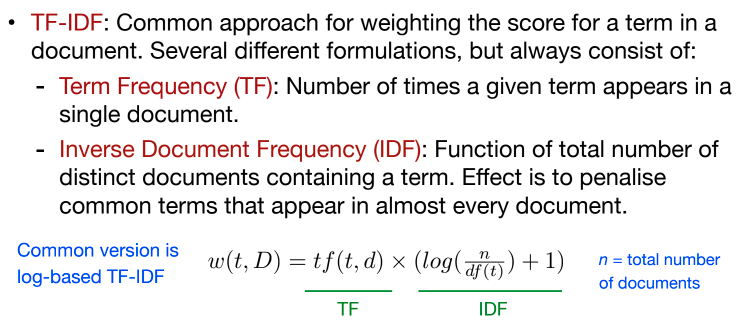

In [323]:
Image(filename='term_weighting.png') 

In [324]:
from sklearn.feature_extraction.text import TfidfVectorizer
# we can pass in the same preprocessing parameters
vectorizer_term_weighting = TfidfVectorizer(stop_words="english",min_df = 5,tokenizer=lemma_tokenizer) #we are using TfidfVectorizer in place of CountVectorizer
X_term_weighting = vectorizer_term_weighting.fit_transform(raw_documents)
# display some sample weighted values
print(X_term_weighting.shape) #(1408, 6101)
print((X_term_weighting[0]).shape) #(1, 6101)
print(X_term_weighting[0]) #6101 terms in first raw (first document), how many times that term appears and its weithted sum

(1408, 6101)
(1, 6101)
  (0, 93)	0.10009099976626194
  (0, 1026)	0.09160342032326424
  (0, 5148)	0.17445620312826257
  (0, 1683)	0.11925410743541424
  (0, 5452)	0.1507477477570906
  (0, 1047)	0.08585261081116488
  (0, 2134)	0.1068101503253814
  (0, 5149)	0.35790572254579966
  (0, 2877)	0.3243104496271507
  (0, 2567)	0.08671804858323616
  (0, 1197)	0.04438106399392263
  (0, 3336)	0.0486462301884699
  (0, 5938)	0.03995929838497884
  (0, 173)	0.0769592043968702
  (0, 3729)	0.10412064656284394
  (0, 4715)	0.11663787280242364
  (0, 1557)	0.08640830204688155
  (0, 4978)	0.0769592043968702
  (0, 4986)	0.06773443932390552
  (0, 1552)	0.07764073962772206
  (0, 5549)	0.03197428788594128
  (0, 5086)	0.06834665185841297
  (0, 3199)	0.06165824190545424
  (0, 4420)	0.06986142901071984
  (0, 4863)	0.1138541365505874
  :	:
  (0, 4605)	0.07227281103526628
  (0, 6076)	0.02569741609583775
  (0, 4864)	0.05593350971228571
  (0, 5199)	0.10267519210688146
  (0, 2975)	0.10412064656284394
  (0, 6039)	0.0362689

In [100]:
print(X_preproc[0].shape)
#print(X_term_weighting[0])

(1, 8750)


In [325]:
# we can pass in the same preprocessing parameters as above plus n-gram
vectorizer_term_weighting_ngram = TfidfVectorizer(stop_words="english",min_df = 5,tokenizer=lemma_tokenizer, ngram_range=(1,3)) #we are using TfidfVectorizer in place of CountVectorizer
X_term_weighting_ngram = vectorizer_term_weighting_ngram.fit_transform(raw_documents)
# display some sample weighted values
print(X_term_weighting_ngram.shape) #(1408, 10255)
print((X_term_weighting_ngram[0]).shape) #(1, 10255)
print(X_term_weighting_ngram[0]) #10255 terms in first raw (first document), how many times that term appears and its weithted sum

(1408, 10255)
(1, 10255)
  (0, 183)	0.09380673860827529
  (0, 1536)	0.08585205588869442
  (0, 8468)	0.16350288720925907
  (0, 2548)	0.11176668142271742
  (0, 8886)	0.14128297851613855
  (0, 1576)	0.08046231369461827
  (0, 3225)	0.10010402409489128
  (0, 8474)	0.3354344410552749
  (0, 4606)	0.3039484633698402
  (0, 3998)	0.08127341454340592
  (0, 1798)	0.04159457772384404
  (0, 5336)	0.04559195342462719
  (0, 9862)	0.03745043477758618
  (0, 325)	0.07212728404368948
  (0, 6145)	0.09758338210882365
  (0, 7628)	0.10931470832895289
  (0, 2364)	0.08098311559106765
  (0, 8221)	0.07212728404368948
  (0, 8229)	0.06348170024551435
  (0, 2358)	0.07276602876001911
  (0, 9054)	0.029966766971122386
  (0, 8378)	0.06405547472405251
  (0, 5112)	0.05778699977997795
  (0, 7249)	0.06547514587039004
  (0, 8019)	0.10670575028537059
  :	:
  (0, 2987)	0.09380673860827529
  (0, 867)	0.07309467454571807
  (0, 7069)	0.05904125691501418
  (0, 6995)	0.08152045361600475
  (0, 9189)	0.06634327083178623
  (0, 5708)	0

We heave now created two **document-term matrices** that we will use as our input data with two classification models (KNN and SVM):
1. **X_term_weighting** - document-term matrix that has filtered out english stop words, terms that appear less than 5 times, and on all terms are reduced to its canonical form (lemmatization). Also all words are lower case and more weights are given to the more "important" terms.
2. **X_term_weighting_ngram** - same as document_term matrix above except it uses three-grams (with a goal of solving the problem with losing the order of words in a sentence (that bag of words representation has). 

Before building two multi-class classification models on this data, let's check how we could measure whether **two documents are similar** and hence have the same class label.

### Measuring Similarity

**Cosine similarity**: Most common approach for measuring **similarity between two documents** in a **bag-of-words representation** is to look at the **cosine of the angle** between their corresponding two **term vectors**. The motivation is that vectors for documents containing similar terms will point in the same direction in the m-dimensional vector space.
Cosine similarity score is 1 if two documents are identical, and -1 if two documents share no terms in common

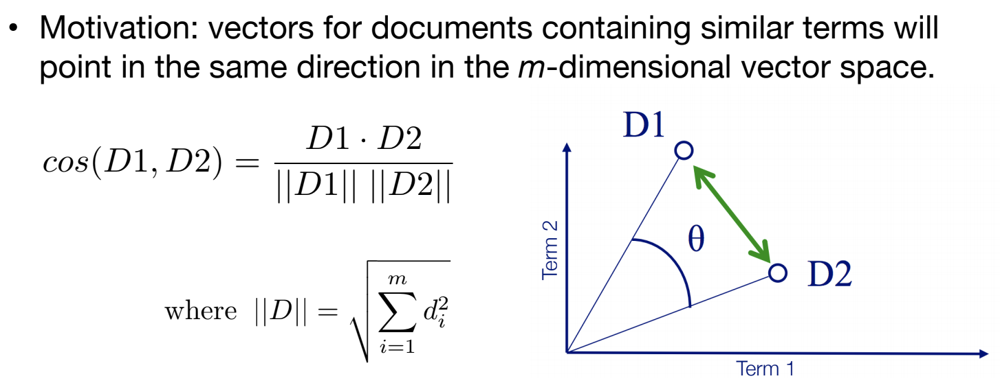

In [326]:
Image(filename='measuring_similarity.png') 

As an example, let's find the most similar document to the first document in our collection.

In [327]:
# First document - just display the start of it
print(raw_documents[0][0:300])

21st-Century Sports: How Digital Technology Is Changing the Face Of The Sporting Industry  The sporting industry has come a long way since the ‘60s. It has carved out for itself a niche with its roots so deep that I cannot fathom the sports industry showing any sign of decline any time soon - or lat


In [328]:
from sklearn.metrics.pairwise import cosine_similarity
# Measure the cosine similarity between the first document vector and all of the others
max_cos = 0
best_row = 0
for row in range(1,X_term_weighting.shape[0]):  #exclude 1st row/document for which we are trying to find the most similar document
                                 #X.shape[0] - number of rows in X, number of documents/articles
    cos = cosine_similarity( X_term_weighting[0], X_term_weighting[row] ) #cosine between two n-dim vectors (n=8750=X_term_weighting.shape[1])
    # best so far?
    if cos > max_cos:
        max_cos = cos
        best_row = row

In [329]:
print("Most similar document was row %d, with cosine similarity = %.3f" % ( best_row, max_cos ) )

Most similar document was row 1027, with cosine similarity = 0.189


In [331]:
# Best document - just display the start of it
print(raw_documents[best_row][0:300])

cosine_similarity( X_term_weighting[0], X_term_weighting[1027] )#0.18862176 (closer to one more similar they are)

Sporting rivals go to extra time  The current slew of sports games offers unparalleled opportunities for fans who like to emulate on-field action without ever moving from the couch.  The two giants in the field - ESPN and EA Sports - have been locked in a heavyweight battle for years. The latter is 


array([[0.18862176]])

In [340]:
#Cosine Similarity between the first document with all documents in the set. 
#Note that the first value of the array is 1.0 because it is the Cosine Similarity between 
#the first document with itself. 
cosine_similarity(X_term_weighting[0:1],X_term_weighting)
#cosine_similarity(X_term_weighting[0:1],X_term_weighting)[0][1027] #0.18862175501900125

array([[1.        , 0.03439677, 0.04066204, ..., 0.01457144, 0.01145571,
        0.05017004]])

In [341]:
(X_term_weighting * X_term_weighting.T).A

array([[1.        , 0.03439677, 0.04066204, ..., 0.01457144, 0.01145571,
        0.05017004],
       [0.03439677, 1.        , 0.04593687, ..., 0.04492278, 0.04691169,
        0.01780043],
       [0.04066204, 0.04593687, 1.        , ..., 0.01465356, 0.00814729,
        0.01158035],
       ...,
       [0.01457144, 0.04492278, 0.01465356, ..., 1.        , 0.69923545,
        0.01501832],
       [0.01145571, 0.04691169, 0.00814729, ..., 0.69923545, 1.        ,
        0.02698089],
       [0.05017004, 0.01780043, 0.01158035, ..., 0.01501832, 0.02698089,
        1.        ]])

### Part 2. Text Classification
The goal here is to analyse the corpus of documents from Part 1 in a text classification
context. Tasks to be completed:
* Build two multi-class classification models using two different classifiers of your choice.
* Compare the predictions of the two classification models using an appropriate evaluation strategy. Report and discuss the evaluation results in your notebook. 

We have created document-term matrix in previous steps: **X_term_weighting** and **X_term_weighting_ngram**
Subsequent modelling steps can then be applied to the **document-term matrix** - e.g. **document classification**, documenter clustering. 

### Text Classification

* **Goal**: To learn a *model* from the *training set* so that we can accurately *predict classes* for new unlabeled documents.
* **Input**: *Training set* of *labelled text documents*, annotated with in our case three class labels (categories).

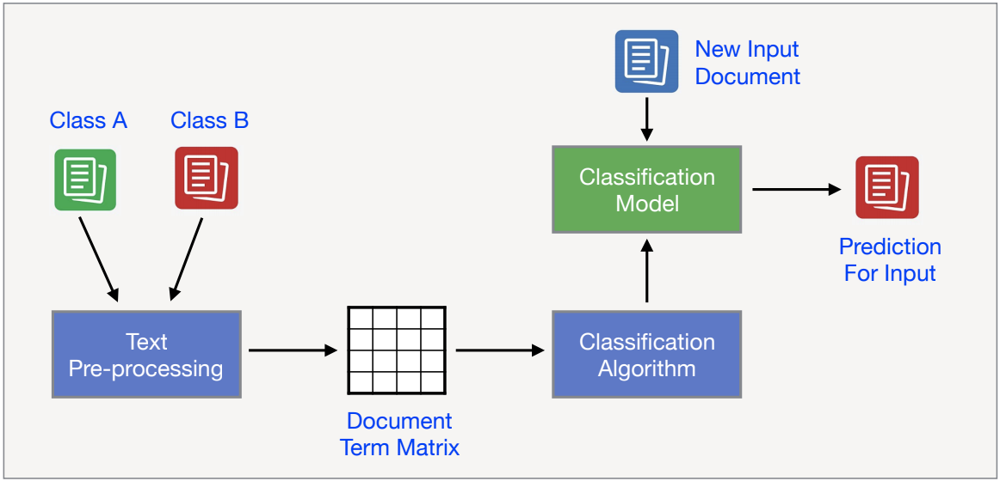

In [343]:
Image(filename='text_classification.png') 

* When we have **labelled documents** to use as **training data**, we can apply many standard **classifiers** to a **document-term matrix**, using the functionality from Scikit-learn that we saw previously.

A number of general purpose classification algorithms are frequently used for classifying text documents:

* **kNN**: Standard nearest neighbour classifier, using an appropriate similarity measure (e.g. Cosine).
* **Naive Bayes**: Classification based on term frequency counts. Incorrectly assumes all terms are independent, but can still be effective in practice.
* **Support Vector Machines**: Often apply SVMs with a linear kernel to calculate document similarity.

I will be using **kNN** and **SVM**. The reason not to go with Naive Bayes is that it incorrectly assumes all terms are independent, even though that is not the case (Barack Obama are not independent terms).

**kNN:** An document is classified by a majority vote of its neighbors, with the document being assigned to the class (sport/business/technology)that is most common among its k nearest neighbors
How odocument is close/far from the other document depends on the certain measure of similarity we are going to use (eg hamming distance, cosine, euclidean, etc). We saw that with Cosine_similarity the bigger the number, the more similar documents are (hence: 1-cosine_similarity) 

##### For a start lets Partition the dataset for evaluation and Train a model
* As before, we will need to *split training and test data* for **evaluations**, with 2 sets of documents: **train_documents**, **test_documents**

In [345]:
#from sklearn import KNeighborsClassifier
from sklearn.model_selection import train_test_split
import numpy as np
X_train, X_test, y_train, y_test = train_test_split(X_term_weighting, class_labels, test_size=0.33, random_state=0) 
knn= KNeighborsClassifier(n_neighbors=205,algorithm='brute', metric='cosine')
knn.fit(X_train, y_train)
predicted= knn.predict(X_test)

accuracy_score(y_test, predicted) * 100

96.34408602150538

In [346]:
from sklearn import datasets, svm
from sklearn.model_selection import train_test_split
import numpy as np
X_train, X_test, y_train, y_test = train_test_split(X_term_weighting, class_labels, test_size=0.33, random_state=0) 
svc_linear= svm.SVC(kernel='linear', C=1)
svc_linear.fit(X_train, y_train)
predicted= svc_linear.predict(X_test)

accuracy_score(y_test, predicted) * 100

98.49462365591398

## k-fold cross-validation
To compare the performance of kNN and SVM algorithms, we will use standard classifier evaluation methods - measure each **classifier's mean accuracy** in a **k-fold cross-validation** experiment.

We will use **stratisfiedKFold** - variation of KFold that returns stratified folds. The folds are **stratified**, meaning that the algorithm attempts to **balance the number of instances of each class in each fold**.

# k-Nearest Neighbors Classifier

In [375]:
#Cosine distance is defined as 1.0 minus the cosine similarity.

# creating odd list of K for KNN
neighbors = list(range(1,300,2))

cvscores_not_bal = []
k_model_accuracy_not_bal=[]

kfold = StratifiedKFold(n_splits=7, shuffle=True, random_state=seed)

for k in neighbors:
    fold=0
    model = KNeighborsClassifier(n_neighbors=k,algorithm='brute', metric='cosine')
    for train, test in kfold.split(X_term_weighting, class_labels):
        fold+=1
        print('FOLD',fold, 'Number of neighbors', k)
        labels_train=[]
        for i in range(len(train)):
            labels_train.append(class_labels[train[i]])
        labels_test=[]
        for i in range(len(test)):
            labels_test.append(class_labels[test[i]])
        
        # Fit/Train the model
        model.fit(X_term_weighting[train], labels_train)

        #Evaluate the Model; Use the test dataset to evaluate the model
        print('\n\n ****** Test Data ******** (Fold',fold,'):')
        # Make a set of predictions for the validation data
        predicted = model.predict(X_term_weighting[test])

        # Print performance details
        print(metrics.classification_report(labels_test, predicted))

        # Print confusion matrix
        print('Confusion Matrix (Fold',fold,'):')
        print(metrics.confusion_matrix(labels_test, predicted))

        cvscores_not_bal.append(accuracy_score(labels_test, predicted) * 100)
    print("\n\n Model accuracy (for",k," neighbours): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_not_bal), numpy.std(cvscores_not_bal)))
    k_model_accuracy_not_bal.append(numpy.mean(cvscores_not_bal))

FOLD 1 Number of neighbors 1


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.93      0.96      0.94        71
     sport
       1.00      0.95      0.97        76
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 3 72  1]
 [ 2  0 54]]
FOLD 2 Number of neighbors 1


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       1.00      0.87      0.93        70
     sport
       0.95      0.99      0.97        75
technology
       0.87      0.96      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 2 ):
[[61  2  7]
 [ 0 74  1]
 [ 0  2 54]]
FOLD 3 Number of neighbors 1


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.


Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 72  1]
 [ 2  0 54]]
FOLD 5 Number of neighbors 7


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 7


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.93      0.90      0.91        70
     sport
       0.96      0.99      0.97        75
technology
       0.89      0.89      0.89        56

avg / total       0.93      0.93      0.93       201

Confusion Matrix (Fold 6 ):
[[63  1  6]
 [ 1 74  0]
 [ 4  2 50]]
FOLD 7 Number of neighbors 7


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  busin

             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        71
     sport
       0.99      1.00      0.99        76
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 1  1 54]]
FOLD 2 Number of neighbors 15


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.90      0.98      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[65  0  5]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 15


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98  

             precision    recall  f1-score   support

  business
       0.95      0.90      0.93        70
     sport
       0.95      1.00      0.97        75
technology
       0.91      0.91      0.91        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[63  2  5]
 [ 0 75  0]
 [ 3  2 51]]
FOLD 7 Number of neighbors 21


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 21  neighbours): 96.22% (+/- 1.43%)
FOLD 1 Number of neighbors 23


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        71
     sport
       1.00      

             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 29


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.90      0.92        70
     sport
       0.94      1.00      0.97        75
technology
       0.93      0.89      0.91        56

avg / total       0.94      0.94      0.93       201

Confusion Matrix (Fold 6 ):
[[63  3  4]
 [ 0 75  0]
 [ 4  2 50]]
FOLD 7 Number of neighbors 29


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.96  

             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 37


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 37


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.95      0.90      0.93        70
     sport
       0.95      1.00      0.97        75
technology
       0.93      0.93  

             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 45


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 45


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00  

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 53


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.96      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 53


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 53


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  bus

             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 59  neighbours): 96.66% (+/- 1.33%)
FOLD 1 Number of neighbors 61


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 61


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      

FOLD 5 Number of neighbors 67


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 67


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 67


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
      

             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 75


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 75


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      0.98  

[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 83


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 83


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 83


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96 


Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 89


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 89


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.95      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 2  1 52]]


 Model accuracy (for 89  neighbours): 96.81% (+/- 1.23%)
FOLD 1 Number of neighbors 91


 ****** Test Data ******** (Fold 1 ):

             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 97


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 97


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98  

             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[66  2  2]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 103


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 103


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.95

FOLD 1 Number of neighbors 111


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 111


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 111


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
   

             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 117


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 117


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.96      0.95

Confusion Matrix (Fold 3 ):
[[66  2  2]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 123


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 5 Number of neighbors 123


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 123


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  

 Model accuracy (for 129  neighbours): 96.77% (+/- 1.16%)
FOLD 1 Number of neighbors 131


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 131


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 131


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  busines

             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 137


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      1.00      0.97        75
technology
       0.94      0.89      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 3  3 50]]
FOLD 7 Number of neighbors 137


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.94      0.93

FOLD 3 Number of neighbors 145


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.98      0.93      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[67  2  1]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 145


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 5 Number of neighbors 145


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
   

[[66  1  3]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 7 Number of neighbors 151


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.96      0.93      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  1  2]
 [ 1 74  0]
 [ 2  2 51]]


 Model accuracy (for 151  neighbours): 96.72% (+/- 1.15%)
FOLD 1 Number of neighbors 153


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.96      1.00      0.98        76
technology
       0.96      0.95      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 153


 ****** Test Data ******** (Fold 2 ):
             precision  

FOLD 3 Number of neighbors 159


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.98      0.91      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[67  2  1]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 4 Number of neighbors 159


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.96      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 5 Number of neighbors 159


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
   

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 165


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.93      1.00      0.96        75
technology
       0.94      0.88      0.91        56

avg / total       0.95      0.95      0.94       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  5 49]]
FOLD 7 Number of neighbors 165


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.99      0.97        75
technology
       0.94      0.91      0.93        55

avg / total       0.95      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  3 50]]


 Model accuracy (for 165  neighbours): 96.70% (+/- 1.15%)
FOLD 1 Number of neighbors 167


 ****** Test Data ******** (Fold 1

             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.98      0.93      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 173


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 173


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.93      1.00      0.96        75
technology
       0.98      0.89

             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.96      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 5 Number of neighbors 179


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 179


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.94      0.91

             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.96      0.91      0.93        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[68  0  2]
 [ 1 74  0]
 [ 2  3 50]]


 Model accuracy (for 185  neighbours): 96.68% (+/- 1.15%)
FOLD 1 Number of neighbors 187


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.98      0.93      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 187


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96   

             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.93      1.00      0.96        75
technology
       0.96      0.89      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[66  2  2]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 193


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.96      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 5 Number of neighbors 193


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.96

             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.94      0.91      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 7 Number of neighbors 199


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.98      0.91      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[68  1  1]
 [ 1 74  0]
 [ 2  3 50]]


 Model accuracy (for 199  neighbours): 96.67% (+/- 1.15%)
FOLD 1 Number of neighbors 201


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       0.95   

             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 207


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.96      0.89      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 207


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.96

             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 213


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.94      0.89      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 7 Number of neighbors 213


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      1.00      0.98        70
     sport
       0.96      0.99      0.97        75
technology
       1.00      0.91

             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.98      0.93      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 221


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 221


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.96      0.89

FOLD 4 Number of neighbors 227


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 5 Number of neighbors 227


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      0.96      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[69  0  1]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 227


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
   

             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.96      0.89      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 233


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 5 Number of neighbors 233


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      0.96

             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.94      1.00      0.97        75
technology
       0.98      0.89      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[68  1  1]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 239


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 5 Number of neighbors 239


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.93

             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 245


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.94      1.00      0.97        75
technology
       0.98      0.89      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[68  1  1]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 245


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 5 Number of neighbors 251


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.93      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[69  0  1]
 [ 1 74  0]
 [ 3  1 52]]
FOLD 6 Number of neighbors 251


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.94      0.89      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 7 Number of neighbors 251


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  

             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 5 Number of neighbors 259


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.93      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[69  0  1]
 [ 1 74  0]
 [ 3  1 52]]
FOLD 6 Number of neighbors 259


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.96      0.89

FOLD 7 Number of neighbors 265


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      1.00      0.98        70
     sport
       0.96      0.99      0.97        75
technology
       1.00      0.91      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[70  0  0]
 [ 1 74  0]
 [ 2  3 50]]


 Model accuracy (for 265  neighbours): 96.69% (+/- 1.11%)
FOLD 1 Number of neighbors 267


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.98      0.93      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 267


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  busin

             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.94      1.00      0.97        75
technology
       0.98      0.89      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[68  1  1]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 273


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 5 Number of neighbors 273


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.93

             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.94      1.00      0.97        75
technology
       0.98      0.89      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[68  1  1]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 279


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 5 Number of neighbors 279


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.93

             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.94      1.00      0.97        75
technology
       0.98      0.89      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[68  1  1]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 285


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 5 Number of neighbors 285


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.93

             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.94      1.00      0.97        75
technology
       0.98      0.89      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[68  1  1]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 291


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 5 Number of neighbors 291


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.93

             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.97      0.96      0.97        75
technology
       0.98      0.95      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[69  0  1]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 297


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.94      1.00      0.97        75
technology
       0.98      0.89      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[68  1  1]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 297


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      1.00      0.98        70
     sport
       0.97      0.97      0.97        75
technology
       1.00      0.95

The highest model accuracy 96.82067537908272 is achieved by using optimal number of neighbors 97


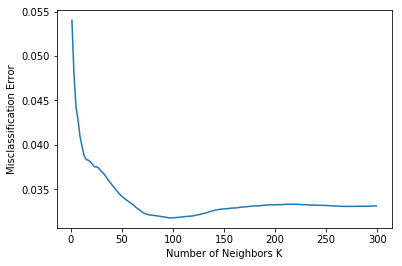

In [376]:
# changing to misclassification error
MSE_not_bal = [1-x/100 for x in k_model_accuracy_not_bal]
index_not_bal=MSE_not_bal.index(min(MSE_not_bal))
optimal_k_not_bal = neighbors[index_not_bal]
print ("The highest model accuracy",k_model_accuracy_not_bal[index_not_bal],"is achieved by using optimal number of neighbors %d" % optimal_k_not_bal)
# plot misclassification error vs k
plt.plot(neighbors, MSE_not_bal)
plt.xlabel('Number of Neighbors K')
plt.ylabel('Misclassification Error')
plt.show()

In [377]:
cvscores_ngram_not_bal = []
k_model_accuracy_ngram_not_bal=[]

kfold = StratifiedKFold(n_splits=7, shuffle=True, random_state=seed)

for k in neighbors:
    fold=0
    model = KNeighborsClassifier(n_neighbors=k,algorithm='brute', metric='cosine')
    for train, test in kfold.split(X_term_weighting_ngram, class_labels):
        fold+=1
        print('FOLD',fold, 'Number of neighbors', k)
        labels_train=[]
        for i in range(len(train)):
            labels_train.append(class_labels[train[i]])
        labels_test=[]
        for i in range(len(test)):
            labels_test.append(class_labels[test[i]])
 
        model.fit(X_term_weighting_ngram[train], labels_train)

        #Evaluate the Model; Use the test dataset to evaluate the model
        print('\n\n ****** Test Data ******** (Fold',fold,'):')
        # Make a set of predictions for the validation data
        predicted = model.predict(X_term_weighting_ngram[test])

        # Print performance details
        print(metrics.classification_report(labels_test, predicted))

        # Print confusion matrix
        print('Confusion Matrix (Fold',fold,'):')
        print(metrics.confusion_matrix(labels_test, predicted))

        cvscores_ngram_not_bal.append(accuracy_score(labels_test, predicted) * 100)
    print("\n\n Model accuracy (for",k," neighbours): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_ngram_not_bal), numpy.std(cvscores_ngram_not_bal)))
    k_model_accuracy_ngram_not_bal.append(numpy.mean(cvscores_ngram_not_bal))

FOLD 1 Number of neighbors 1


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        71
     sport
       1.00      0.96      0.98        76
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.96       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 2 73  1]
 [ 2  0 54]]
FOLD 2 Number of neighbors 1


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       1.00      0.87      0.93        70
     sport
       0.96      0.99      0.97        75
technology
       0.87      0.98      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[61  2  7]
 [ 0 74  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 1


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.

FOLD 3 Number of neighbors 7


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 4 Number of neighbors 7


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.93      0.99      0.96        70
     sport
       1.00      0.95      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 3 71  1]
 [ 2  0 54]]
FOLD 5 Number of neighbors 7


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.

             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      0.96      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 2  0 54]]
FOLD 5 Number of neighbors 13


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 6 Number of neighbors 13


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.91      0.93        70
     sport
       0.96      0.99      0.97        75
technology
       0.91      0.91  


Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 19


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 6 Number of neighbors 19


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.90      0.92        70
     sport
       0.95      0.99      0.97        75
technology
       0.91      0.91      0.91        56

avg / total       0.94      0.94      0.93       201

Confusion Matrix (Fold 6 ):
[[63  2  5]
 [ 1 74  0]
 [ 3  2 51]]
FOLD 7 Number of neighbors 19


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  bu

             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 27


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 27


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.96  


Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 4  2 50]]
FOLD 7 Number of neighbors 33


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.95      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 33  neighbours): 96.46% (+/- 1.41%)
FOLD 1 Number of neighbors 35


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 35


 ****** Test Data ******** (Fold 2 ):

             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       1.00      1.00      1.00        76
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 41


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      0.99      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 3 Number of neighbors 41


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98  

[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 47


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 47


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 47


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93 

             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 53


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 53


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00  

             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 59


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 59


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95  

             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 65


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.95      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 65  neighbours): 96.69% (+/- 1.27%)
FOLD 1 Number of neighbors 67


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       1.00      

             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 71


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.95      0.99      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.95      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 2  2 51]]


 Model accuracy (for 71  neighbours): 96.72% (+/- 1.26%)
FOLD 1 Number of neighbors 73


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  2  2]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 79


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 79


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      1.00      1.00     

             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 85


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 85


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.95      0.99      0.97        75
technology
       0.95      0.95  

             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.95      0.99      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.95      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 2  2 51]]


 Model accuracy (for 91  neighbours): 96.79% (+/- 1.23%)
FOLD 1 Number of neighbors 93


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 93


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      

             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 99


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 99


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96  

FOLD 3 Number of neighbors 105


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 105


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 105


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
   

             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 111


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[66  2  2]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 111


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00

             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 117


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  1  1]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 117


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96

             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 123


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 123


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.95      0.99      0.97        75
technology
       0.94      0.93

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  3 52]]
FOLD 7 Number of neighbors 129


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.95      0.99      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.95      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 2  2 51]]


 Model accuracy (for 129  neighbours): 96.80% (+/- 1.18%)
FOLD 1 Number of neighbors 131


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 131


 ****** Test Data ******** (Fold 2

 Model accuracy (for 135  neighbours): 96.79% (+/- 1.18%)
FOLD 1 Number of neighbors 137


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 137


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 137


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  busines

             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.94      0.99      0.96        75
technology
       0.94      0.91      0.93        55

avg / total       0.95      0.94      0.94       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 2  3 50]]


 Model accuracy (for 141  neighbours): 96.78% (+/- 1.18%)
FOLD 1 Number of neighbors 143


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 143


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95   

FOLD 2 Number of neighbors 149


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 149


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.95      1.00      0.97        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 149


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
   

FOLD 6 Number of neighbors 155


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.94      0.91      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  4 51]]
FOLD 7 Number of neighbors 155


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.99      0.97        75
technology
       0.94      0.91      0.93        55

avg / total       0.95      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  3 50]]


 Model accuracy (for 155  neighbours): 96.74% (+/- 1.17%)
FOLD 1 Number of neighbors 157


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  busin

             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.96      0.91      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[66  2  2]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 4 Number of neighbors 163


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.97      0.99      0.98        75
technology
       0.98      0.96      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  1  1]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 5 Number of neighbors 163


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.96


Confusion Matrix (Fold 3 ):
[[66  2  2]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 4 Number of neighbors 169


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.97      0.99      0.98        75
technology
       0.98      0.96      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  1  1]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 5 Number of neighbors 169


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 169


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

 


Confusion Matrix (Fold 4 ):
[[69  1  0]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 5 Number of neighbors 175


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 175


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  3 52]]
FOLD 7 Number of neighbors 175


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

 

             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.94      1.00      0.97        75
technology
       0.94      0.91      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 4 Number of neighbors 183


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.96      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  1  0]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 5 Number of neighbors 183


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.96

FOLD 1 Number of neighbors 191


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.96      1.00      0.98        76
technology
       0.96      0.95      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 191


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 191


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
   

FOLD 7 Number of neighbors 195


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.94      0.99      0.96        75
technology
       0.98      0.89      0.93        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[68  1  1]
 [ 1 74  0]
 [ 2  4 49]]


 Model accuracy (for 195  neighbours): 96.67% (+/- 1.16%)
FOLD 1 Number of neighbors 197


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.96      0.93      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 197


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  busin

             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 203


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.93      1.00      0.96        75
technology
       0.96      0.89      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[66  2  2]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 203


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.96

             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.96      0.93      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 209


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 209


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.93      1.00      0.96        75
technology
       0.96      0.89

             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       0.95      0.99      0.97        75
technology
       0.98      0.89      0.93        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[69  0  1]
 [ 1 74  0]
 [ 2  4 49]]


 Model accuracy (for 213  neighbours): 96.64% (+/- 1.15%)
FOLD 1 Number of neighbors 215


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.96      0.93      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 215


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96   

             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.94      0.89      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 7 Number of neighbors 219


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       0.96      0.99      0.97        75
technology
       0.98      0.91      0.94        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[69  0  1]
 [ 1 74  0]
 [ 2  3 50]]


 Model accuracy (for 219  neighbours): 96.64% (+/- 1.16%)
FOLD 1 Number of neighbors 221


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.95   


Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 5 Number of neighbors 227


 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      0.96      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[69  0  1]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 227


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.94      0.89      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 7 Number of neighbors 227


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

 

             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      0.96      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[69  0  1]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 233


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.94      0.89      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 7 Number of neighbors 233


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       0.96      0.99      0.97        75
technology
       0.98      0.91

[[69  0  1]
 [ 1 74  0]
 [ 3  0 53]]
FOLD 6 Number of neighbors 239


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.94      0.89      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 7 Number of neighbors 239


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      1.00      0.98        70
     sport
       0.96      0.99      0.97        75
technology
       1.00      0.91      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[70  0  0]
 [ 1 74  0]
 [ 2  3 50]]


 Model accuracy (for 239  neighbours): 96.65% (+/- 1.15%)
FOLD 1 Number of neighbors 241


 ****** Test Data ******** (Fold 1 ):
             precision  

             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      0.95      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[69  0  1]
 [ 1 74  0]
 [ 3  0 53]]
FOLD 6 Number of neighbors 245


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.94      0.89      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 7 Number of neighbors 245


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      1.00      0.98        70
     sport
       0.96      0.99      0.97        75
technology
       1.00      0.91

             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.97      0.96      0.97        75
technology
       0.98      0.95      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[69  0  1]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 253


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.96      0.89      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 253


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95

             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.94      0.89      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 7 Number of neighbors 259


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.95      1.00      0.97        70
     sport
       0.96      0.99      0.97        75
technology
       1.00      0.89      0.94        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[70  0  0]
 [ 1 74  0]
 [ 3  3 49]]


 Model accuracy (for 259  neighbours): 96.65% (+/- 1.14%)
FOLD 1 Number of neighbors 261


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       0.95   

             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.97      0.96      0.97        75
technology
       0.98      0.95      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[69  0  1]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 267


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.96      0.89      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 267


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.97      0.99      0.98        75
technology
       1.00      0.95

             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.98      0.93      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 273


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.97      0.96      0.97        75
technology
       0.98      0.95      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[69  0  1]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 273


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.96      0.89

             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.98      0.93      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 279


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.97      0.96      0.97        75
technology
       0.98      0.95      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[69  0  1]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 279


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.94      1.00      0.97        75
technology
       0.98      0.89

             precision    recall  f1-score   support

  business
       0.95      1.00      0.97        70
     sport
       0.96      0.99      0.97        75
technology
       1.00      0.89      0.94        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[70  0  0]
 [ 1 74  0]
 [ 3  3 49]]


 Model accuracy (for 283  neighbours): 96.65% (+/- 1.12%)
FOLD 1 Number of neighbors 285


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.98      0.93      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 285


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.97   

             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.97      0.96      0.97        75
technology
       0.98      0.95      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[69  0  1]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 291


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.94      1.00      0.97        75
technology
       0.98      0.89      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[68  1  1]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 4 Number of neighbors 291


 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      1.00      0.98        70
     sport
       0.97      0.97      0.97        75
technology
       1.00      0.95

             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.95      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[69  0  1]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 6 Number of neighbors 297


 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.94      1.00      0.97        75
technology
       0.96      0.89      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 6 ):
[[67  1  2]
 [ 0 75  0]
 [ 2  4 50]]
FOLD 7 Number of neighbors 297


 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.93      1.00      0.97        70
     sport
       0.95      0.99      0.97        75
technology
       1.00      0.85

The highest model accuracy 96.80225321345199 is achieved by using optimal number of neighbors 125


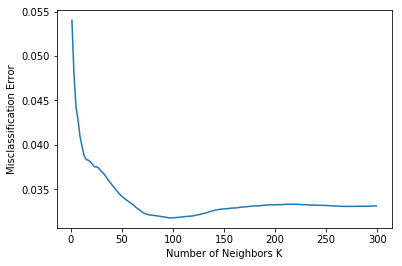

In [378]:
# changing to misclassification error
MSE_ngram_not_bal = [1-x/100 for x in k_model_accuracy_ngram_not_bal]
index_ngram_not_bal=MSE_ngram_not_bal.index(min(MSE_ngram_not_bal))
optimal_k_ngram_not_bal = neighbors[index_ngram_not_bal]
print ("The highest model accuracy",k_model_accuracy_ngram_not_bal[index_ngram_not_bal],"is achieved by using optimal number of neighbors %d" % optimal_k_ngram_not_bal)
# plot misclassification error vs k
plt.plot(neighbors, MSE_not_bal)
plt.xlabel('Number of Neighbors K')
plt.ylabel('Misclassification Error')
plt.show()

FOLD 1 Number of neighbors 1
Class Distribution --> Train data (Fold 1 ):


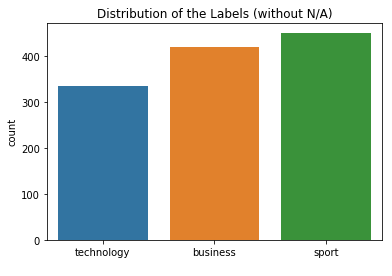

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


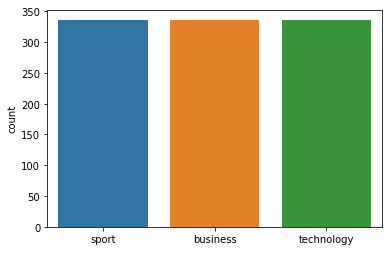



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        71
     sport
       1.00      0.96      0.98        76
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.96       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 2 73  1]
 [ 2  0 54]]
FOLD 2 Number of neighbors 1
Class Distribution --> Train data (Fold 2 ):


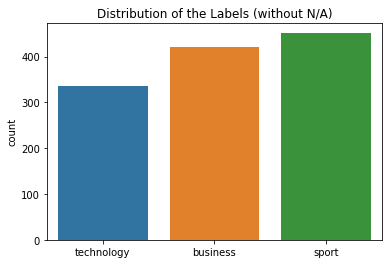

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


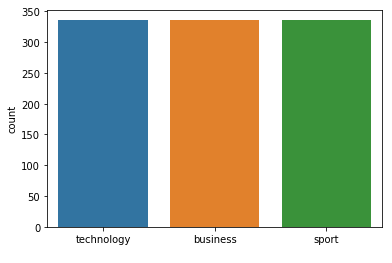



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.89      0.93        70
     sport
       0.96      0.96      0.96        75
technology
       0.87      0.96      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 2 ):
[[62  1  7]
 [ 2 72  1]
 [ 0  2 54]]
FOLD 3 Number of neighbors 1
Class Distribution --> Train data (Fold 3 ):


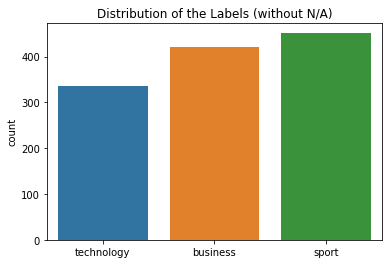

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


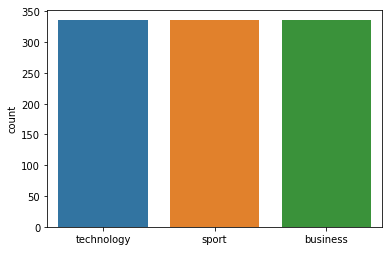



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.96      0.97        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[68  1  1]
 [ 2 72  1]
 [ 0  0 56]]
FOLD 4 Number of neighbors 1
Class Distribution --> Train data (Fold 4 ):


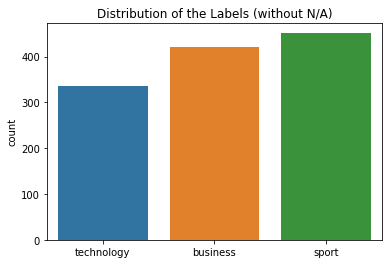

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


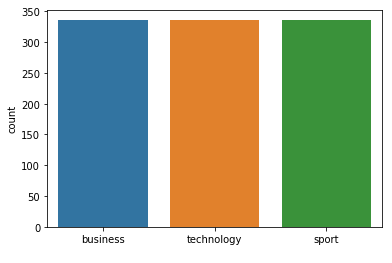



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.99      0.93      0.96        75
technology
       0.95      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 4 ):
[[68  1  1]
 [ 3 70  2]
 [ 2  0 54]]
FOLD 5 Number of neighbors 1
Class Distribution --> Train data (Fold 5 ):


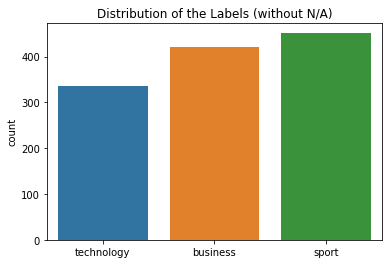

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


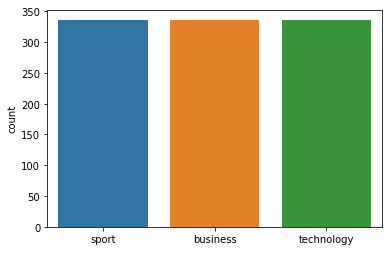



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.89      0.94        70
     sport
       0.99      0.97      0.98        75
technology
       0.86      1.00      0.93        56

avg / total       0.96      0.95      0.95       201

Confusion Matrix (Fold 5 ):
[[62  1  7]
 [ 0 73  2]
 [ 0  0 56]]
FOLD 6 Number of neighbors 1
Class Distribution --> Train data (Fold 6 ):


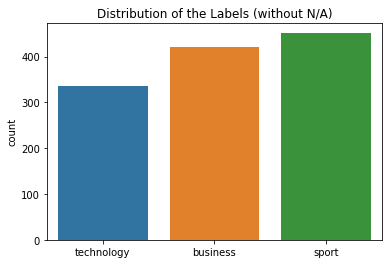

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


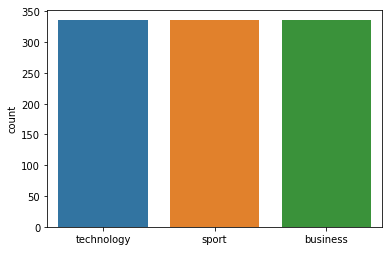



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.93      0.94        70
     sport
       0.95      0.97      0.96        75
technology
       0.95      0.93      0.94        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[65  3  2]
 [ 1 73  1]
 [ 3  1 52]]
FOLD 7 Number of neighbors 1
Class Distribution --> Train data (Fold 7 ):


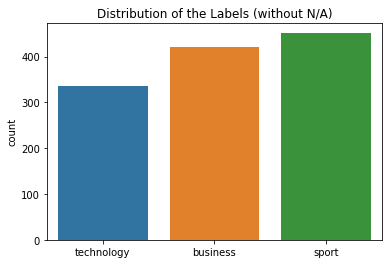

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


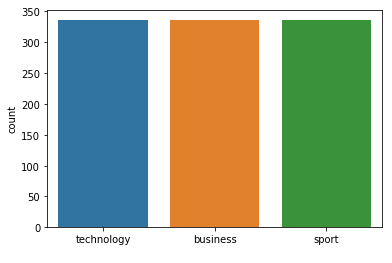



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.90      0.89      0.89        70
     sport
       0.91      0.96      0.94        75
technology
       0.90      0.85      0.88        55

avg / total       0.90      0.91      0.90       200

Confusion Matrix (Fold 7 ):
[[62  4  4]
 [ 2 72  1]
 [ 5  3 47]]


 Model accuracy (for 1  neighbours): 94.60% (+/- 2.01%)
FOLD 1 Number of neighbors 3
Class Distribution --> Train data (Fold 1 ):


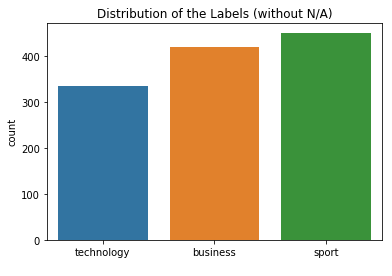

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


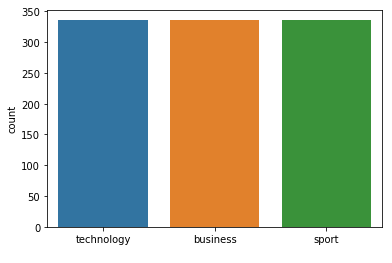



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.99      0.97      0.98        76
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 74  1]
 [ 1  1 54]]
FOLD 2 Number of neighbors 3
Class Distribution --> Train data (Fold 2 ):


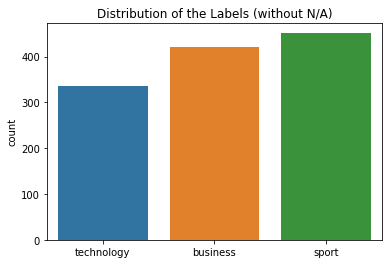

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


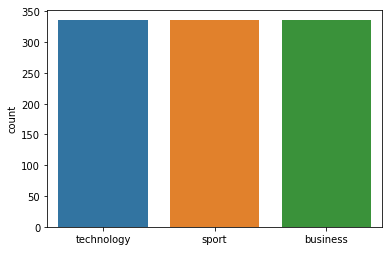



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.89      0.93        70
     sport
       0.97      0.96      0.97        75
technology
       0.87      0.98      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 2 ):
[[62  1  7]
 [ 2 72  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 3
Class Distribution --> Train data (Fold 3 ):


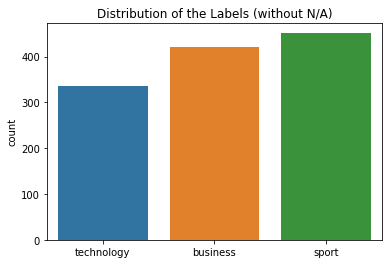

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


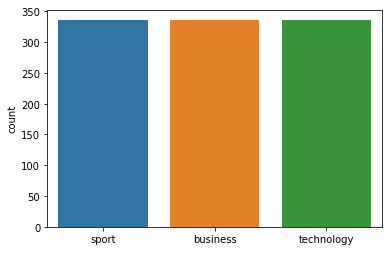



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 4 Number of neighbors 3
Class Distribution --> Train data (Fold 4 ):


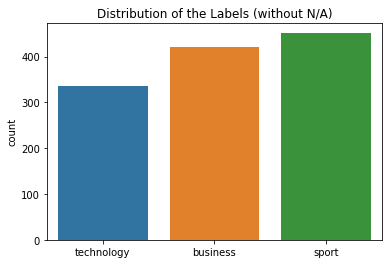

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


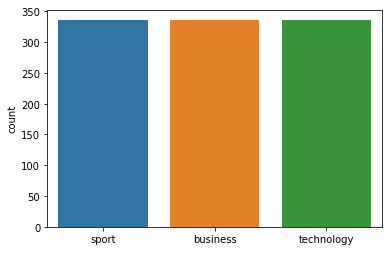



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.99      0.95      0.97        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[68  1  1]
 [ 2 71  2]
 [ 1  0 55]]
FOLD 5 Number of neighbors 3
Class Distribution --> Train data (Fold 5 ):


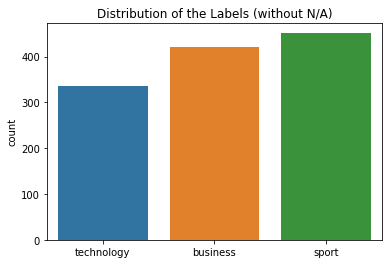

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


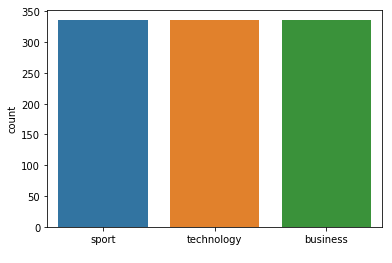



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 5 ):
[[64  1  5]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 6 Number of neighbors 3
Class Distribution --> Train data (Fold 6 ):


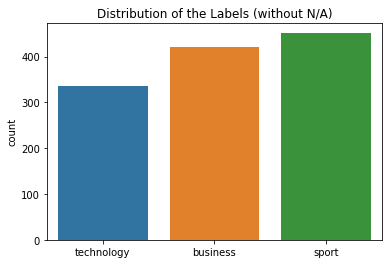

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


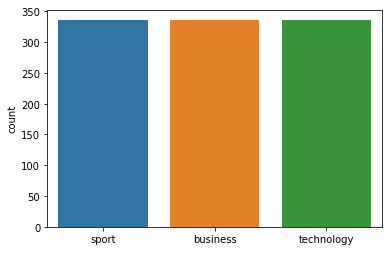



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.91      0.93        70
     sport
       0.97      0.97      0.97        75
technology
       0.88      0.91      0.89        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[64  0  6]
 [ 1 73  1]
 [ 3  2 51]]
FOLD 7 Number of neighbors 3
Class Distribution --> Train data (Fold 7 ):


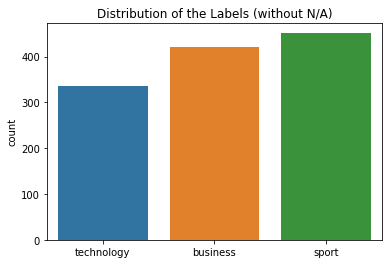

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


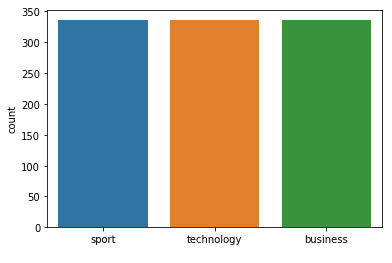



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.94      0.93      0.94        70
     sport
       0.97      0.95      0.96        75
technology
       0.91      0.96      0.94        55

avg / total       0.95      0.94      0.95       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 3 71  1]
 [ 1  1 53]]


 Model accuracy (for 3  neighbours): 95.02% (+/- 1.75%)
FOLD 1 Number of neighbors 5
Class Distribution --> Train data (Fold 1 ):


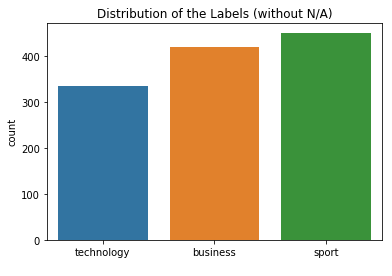

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


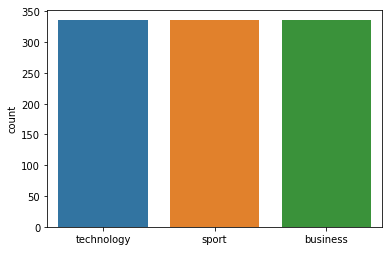



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        71
     sport
       0.99      0.97      0.98        76
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.96       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 1 74  1]
 [ 1  1 54]]
FOLD 2 Number of neighbors 5
Class Distribution --> Train data (Fold 2 ):


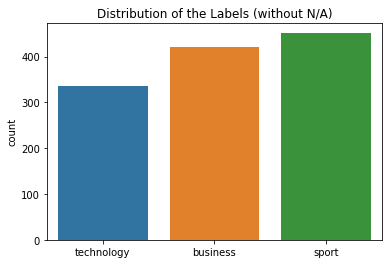

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


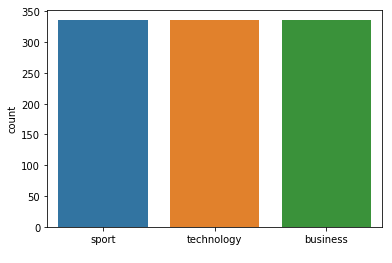



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[65  1  4]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 5
Class Distribution --> Train data (Fold 3 ):


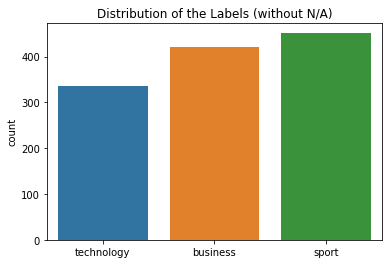

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


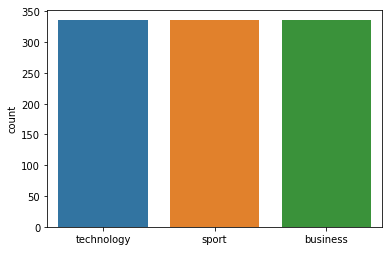



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 4 Number of neighbors 5
Class Distribution --> Train data (Fold 4 ):


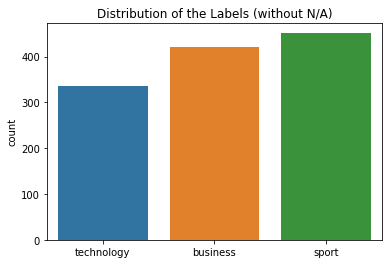

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


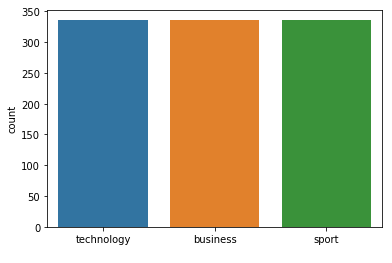



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       1.00      0.96      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 72  1]
 [ 1  0 55]]
FOLD 5 Number of neighbors 5
Class Distribution --> Train data (Fold 5 ):


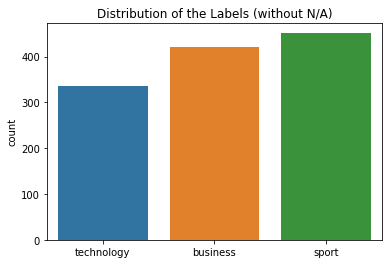

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


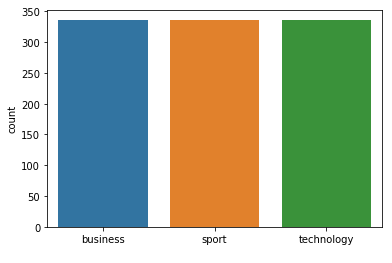



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 5
Class Distribution --> Train data (Fold 6 ):


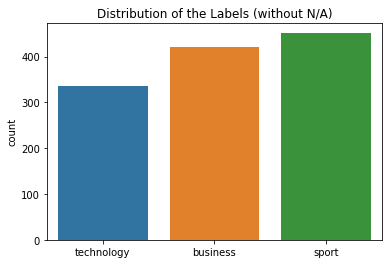

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


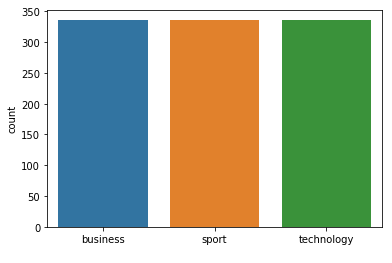



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.90      0.92        70
     sport
       0.96      0.99      0.97        75
technology
       0.89      0.91      0.90        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[63  1  6]
 [ 1 74  0]
 [ 3  2 51]]
FOLD 7 Number of neighbors 5
Class Distribution --> Train data (Fold 7 ):


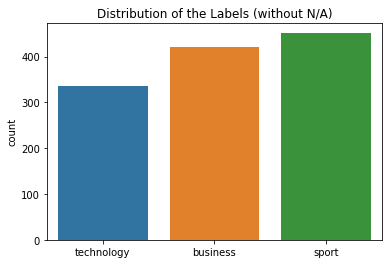

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


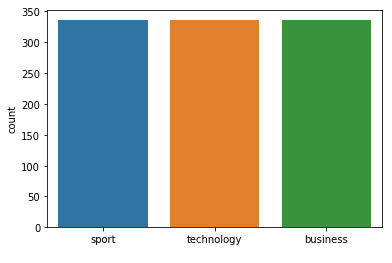



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[67  1  2]
 [ 3 71  1]
 [ 1  1 53]]


 Model accuracy (for 5  neighbours): 95.36% (+/- 1.65%)
FOLD 1 Number of neighbors 7
Class Distribution --> Train data (Fold 1 ):


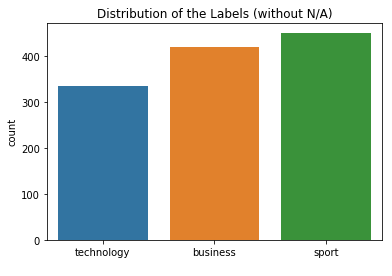

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


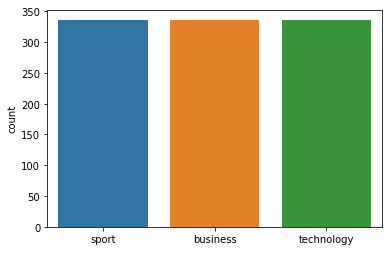



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        71
     sport
       0.99      0.97      0.98        76
technology
       0.90      0.96      0.93        56

avg / total       0.96      0.96      0.96       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 1 74  1]
 [ 1  1 54]]
FOLD 2 Number of neighbors 7
Class Distribution --> Train data (Fold 2 ):


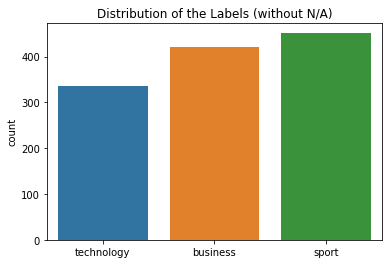

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


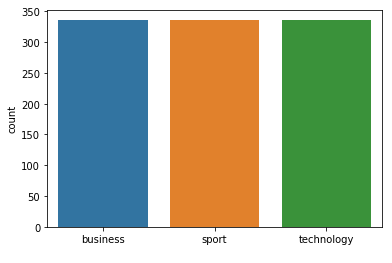



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       1.00      0.96      0.98        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  0  4]
 [ 2 72  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 7
Class Distribution --> Train data (Fold 3 ):


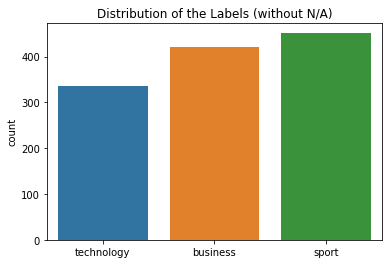

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


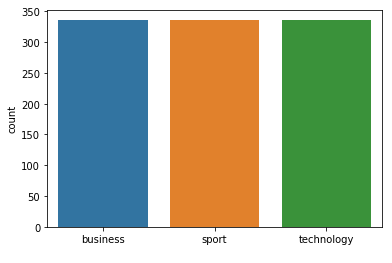



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 4 Number of neighbors 7
Class Distribution --> Train data (Fold 4 ):


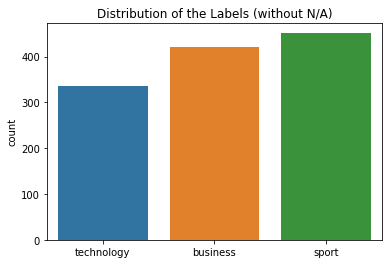

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


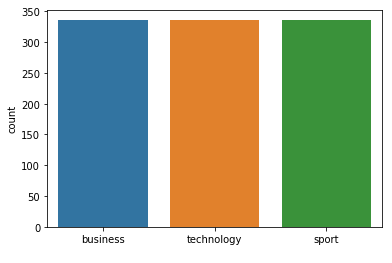



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.99      0.96      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[68  1  1]
 [ 2 72  1]
 [ 1  0 55]]
FOLD 5 Number of neighbors 7
Class Distribution --> Train data (Fold 5 ):


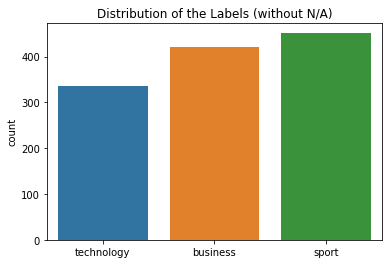

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


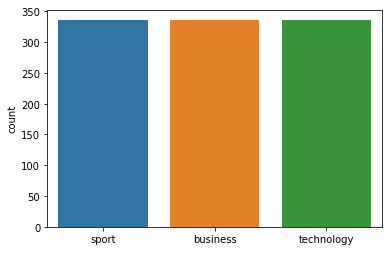



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 0 74  1]
 [ 0  0 56]]
FOLD 6 Number of neighbors 7
Class Distribution --> Train data (Fold 6 ):


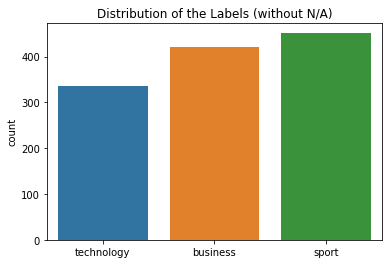

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


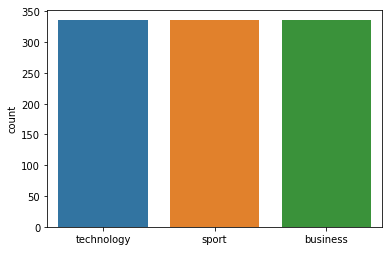



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.95      0.90      0.93        70
     sport
       0.96      0.99      0.97        75
technology
       0.90      0.93      0.91        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[63  1  6]
 [ 1 74  0]
 [ 2  2 52]]
FOLD 7 Number of neighbors 7
Class Distribution --> Train data (Fold 7 ):


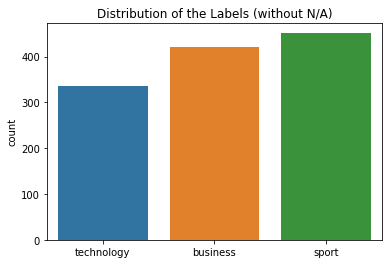

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


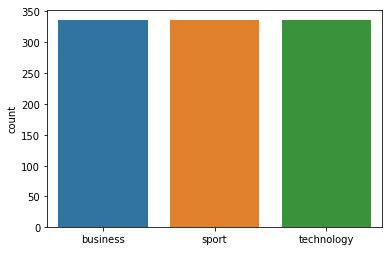



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 7  neighbours): 95.58% (+/- 1.58%)
FOLD 1 Number of neighbors 9
Class Distribution --> Train data (Fold 1 ):


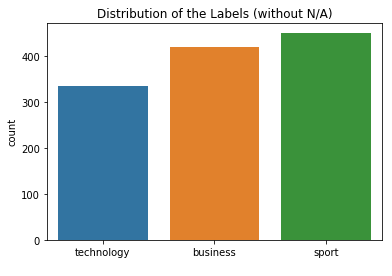

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


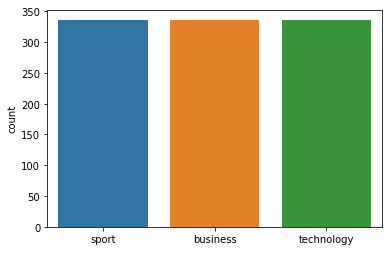



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.93      0.96        71
     sport
       0.99      0.99      0.99        76
technology
       0.90      0.96      0.93        56

avg / total       0.96      0.96      0.96       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 75  1]
 [ 1  1 54]]
FOLD 2 Number of neighbors 9
Class Distribution --> Train data (Fold 2 ):


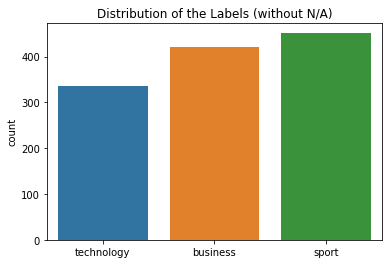

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


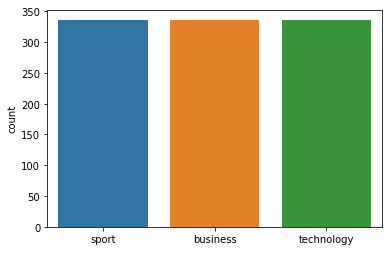



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  0  4]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 9
Class Distribution --> Train data (Fold 3 ):


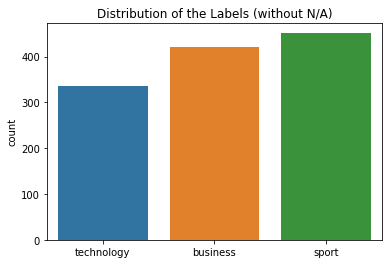

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


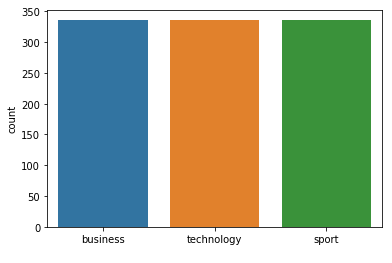



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 74  1]
 [ 0  0 56]]
FOLD 4 Number of neighbors 9
Class Distribution --> Train data (Fold 4 ):


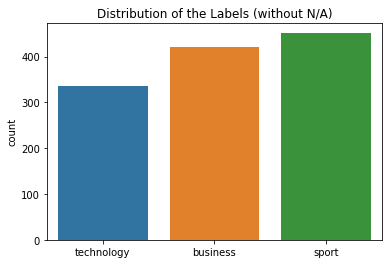

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


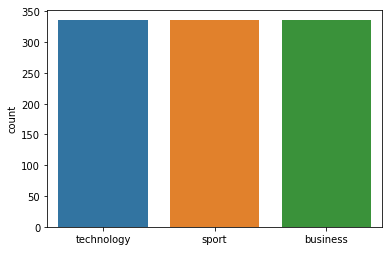



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.93      0.96      0.94        70
     sport
       0.99      0.95      0.97        75
technology
       0.95      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 3 71  1]
 [ 2  0 54]]
FOLD 5 Number of neighbors 9
Class Distribution --> Train data (Fold 5 ):


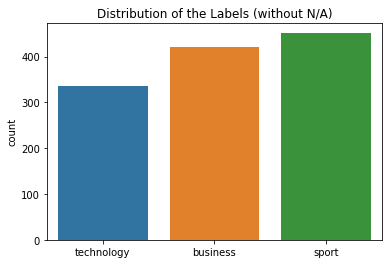

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


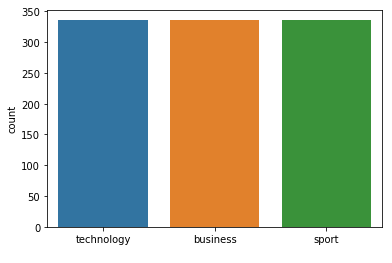



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.99      0.99      0.99        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[64  1  5]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 9
Class Distribution --> Train data (Fold 6 ):


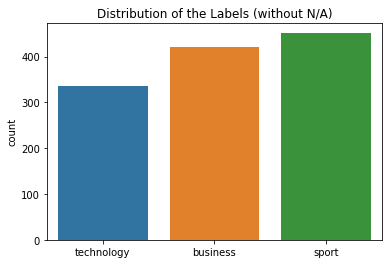

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


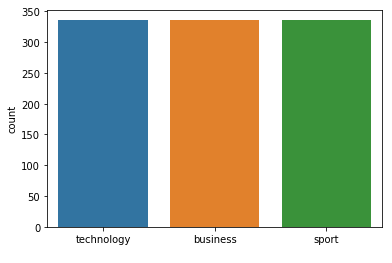



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.96      0.91      0.93        70
     sport
       0.96      0.97      0.97        75
technology
       0.90      0.93      0.91        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 1 73  1]
 [ 2  2 52]]
FOLD 7 Number of neighbors 9
Class Distribution --> Train data (Fold 7 ):


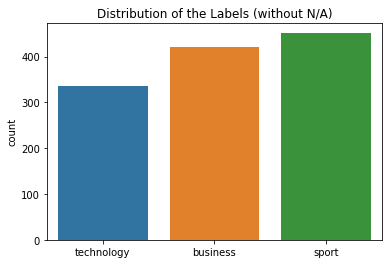

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


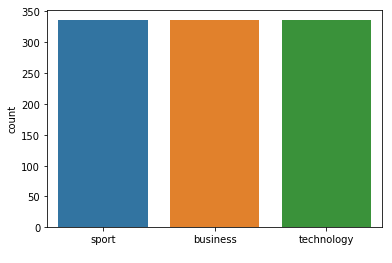



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 9  neighbours): 95.69% (+/- 1.50%)
FOLD 1 Number of neighbors 11
Class Distribution --> Train data (Fold 1 ):


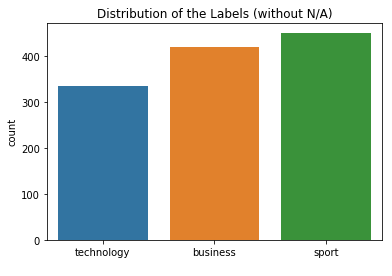

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


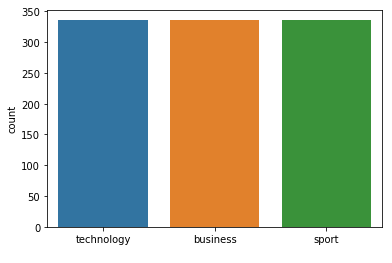



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.92      0.94        71
     sport
       0.99      0.99      0.99        76
technology
       0.90      0.96      0.93        56

avg / total       0.96      0.96      0.96       203

Confusion Matrix (Fold 1 ):
[[65  0  6]
 [ 1 75  0]
 [ 1  1 54]]
FOLD 2 Number of neighbors 11
Class Distribution --> Train data (Fold 2 ):


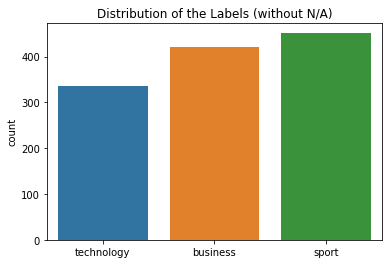

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


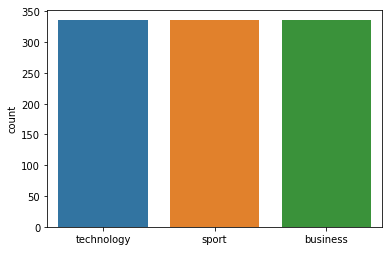



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.90      0.98      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[65  0  5]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 11
Class Distribution --> Train data (Fold 3 ):


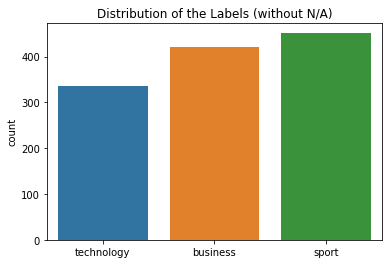

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


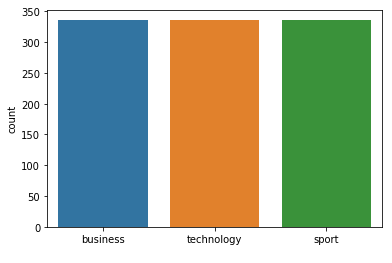



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 4 Number of neighbors 11
Class Distribution --> Train data (Fold 4 ):


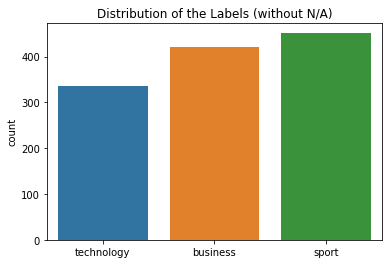

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


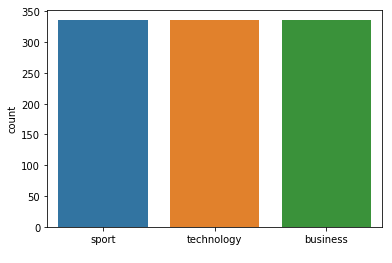



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 11
Class Distribution --> Train data (Fold 5 ):


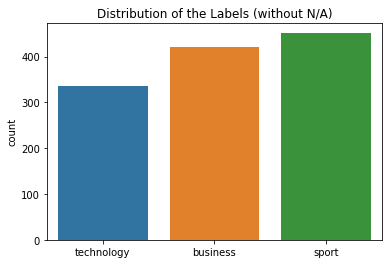

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


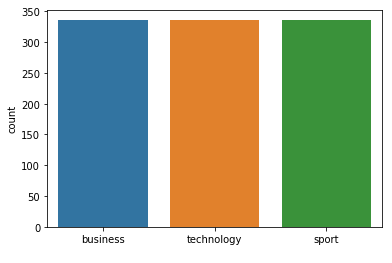



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  0  4]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 11
Class Distribution --> Train data (Fold 6 ):


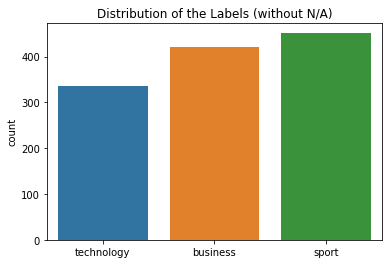

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


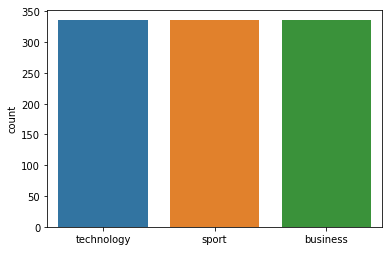



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.90      0.92        70
     sport
       0.96      0.99      0.97        75
technology
       0.91      0.93      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[63  2  5]
 [ 1 74  0]
 [ 3  1 52]]
FOLD 7 Number of neighbors 11
Class Distribution --> Train data (Fold 7 ):


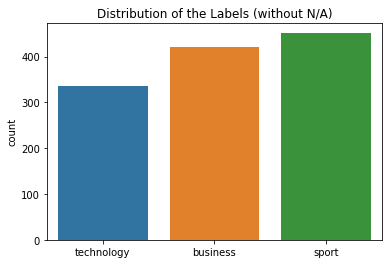

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


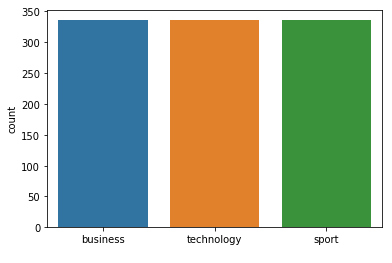



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.96      0.95        55

avg / total       0.97      0.96      0.97       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 11  neighbours): 95.81% (+/- 1.48%)
FOLD 1 Number of neighbors 13
Class Distribution --> Train data (Fold 1 ):


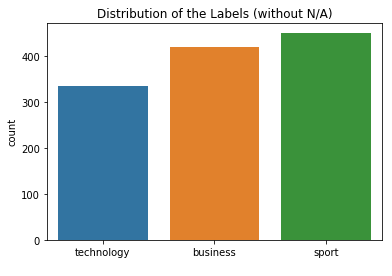

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


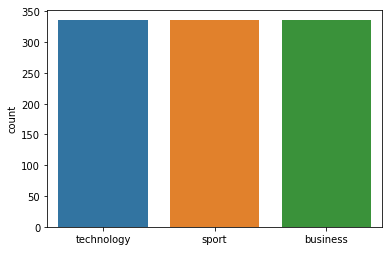



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        71
     sport
       1.00      0.99      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 1 75  0]
 [ 1  0 55]]
FOLD 2 Number of neighbors 13
Class Distribution --> Train data (Fold 2 ):


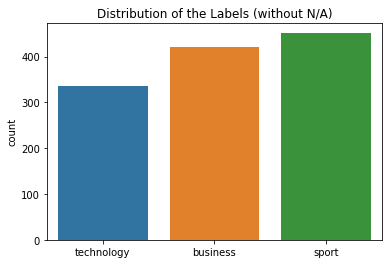

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


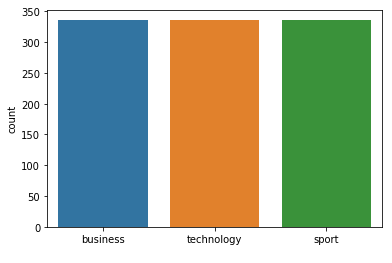



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.90      0.98      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[65  0  5]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 13
Class Distribution --> Train data (Fold 3 ):


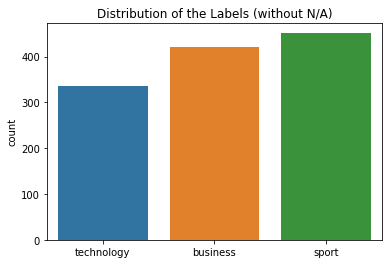

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


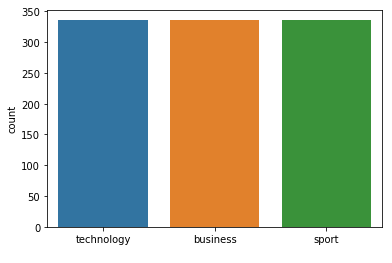



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 13
Class Distribution --> Train data (Fold 4 ):


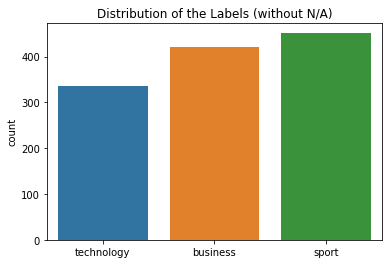

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


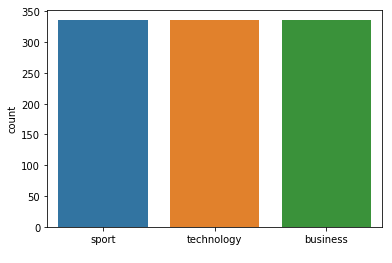



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.96      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 3 72  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 13
Class Distribution --> Train data (Fold 5 ):


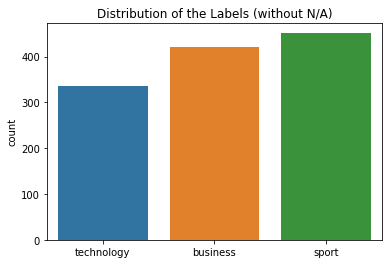

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


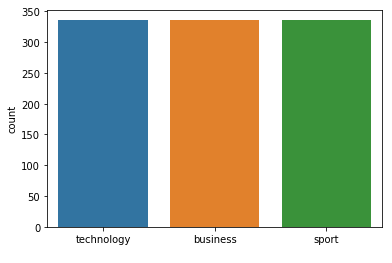



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  0  4]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 13
Class Distribution --> Train data (Fold 6 ):


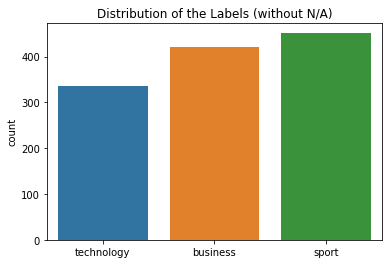

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


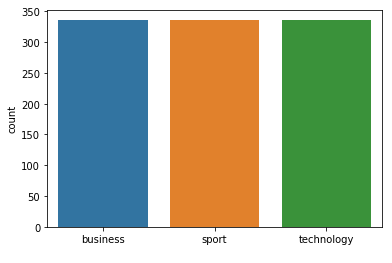



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.97      0.99      0.98        75
technology
       0.91      0.93      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[65  0  5]
 [ 1 74  0]
 [ 2  2 52]]
FOLD 7 Number of neighbors 13
Class Distribution --> Train data (Fold 7 ):


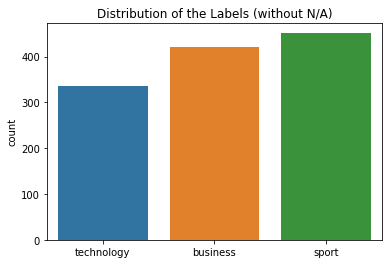

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


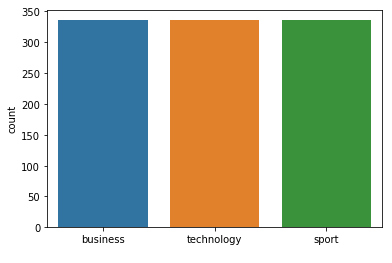



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 2  1 52]]


 Model accuracy (for 13  neighbours): 95.93% (+/- 1.44%)
FOLD 1 Number of neighbors 15
Class Distribution --> Train data (Fold 1 ):


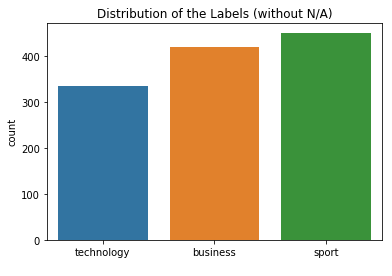

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


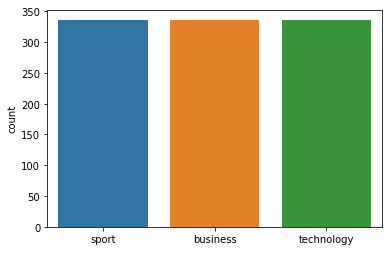



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 1  0 55]]
FOLD 2 Number of neighbors 15
Class Distribution --> Train data (Fold 2 ):


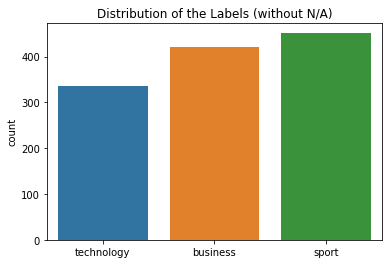

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


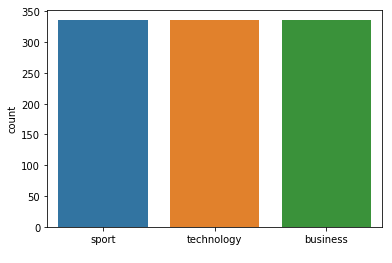



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.90      0.98      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[65  0  5]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 15
Class Distribution --> Train data (Fold 3 ):


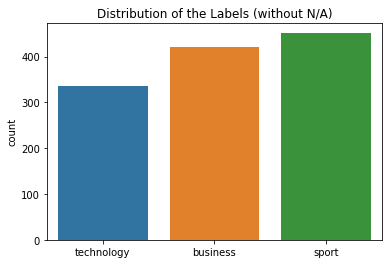

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


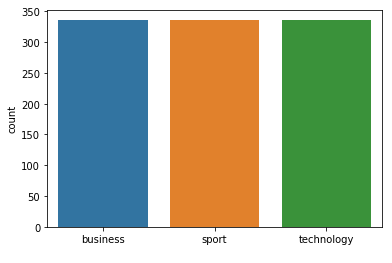



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 15
Class Distribution --> Train data (Fold 4 ):


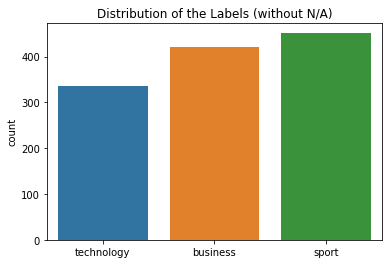

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


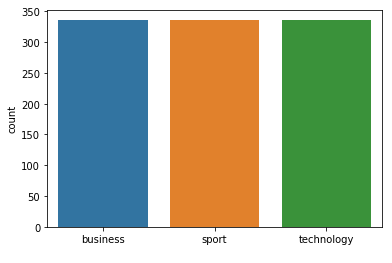



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 15
Class Distribution --> Train data (Fold 5 ):


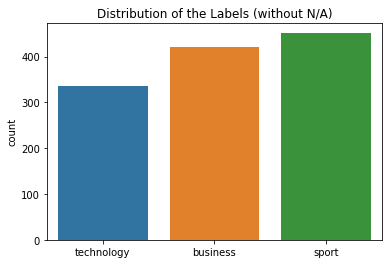

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


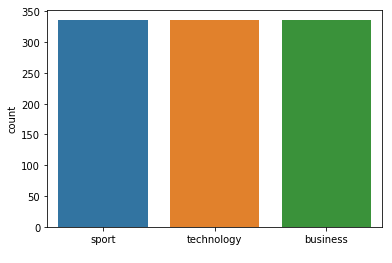



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 6 Number of neighbors 15
Class Distribution --> Train data (Fold 6 ):


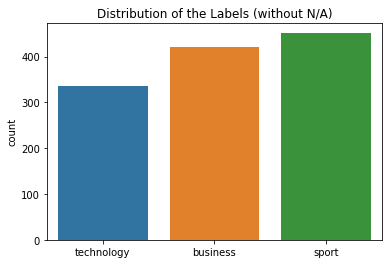

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


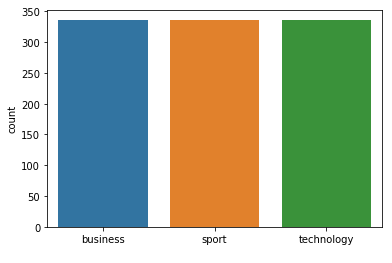



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.95      0.90      0.93        70
     sport
       0.95      0.99      0.97        75
technology
       0.91      0.93      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[63  2  5]
 [ 1 74  0]
 [ 2  2 52]]
FOLD 7 Number of neighbors 15
Class Distribution --> Train data (Fold 7 ):


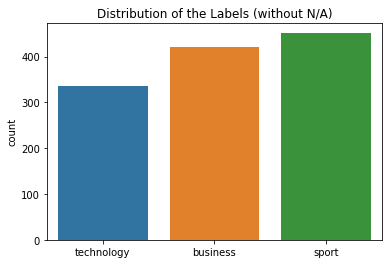

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


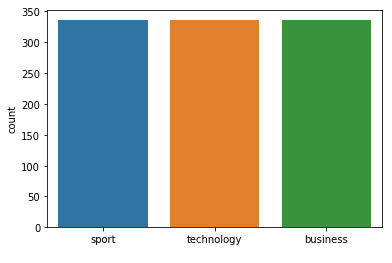



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.99      0.97      0.98        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 2 73  0]
 [ 1  1 53]]


 Model accuracy (for 15  neighbours): 96.00% (+/- 1.43%)
FOLD 1 Number of neighbors 17
Class Distribution --> Train data (Fold 1 ):


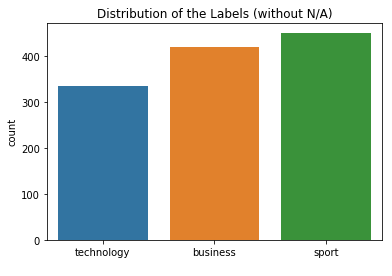

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


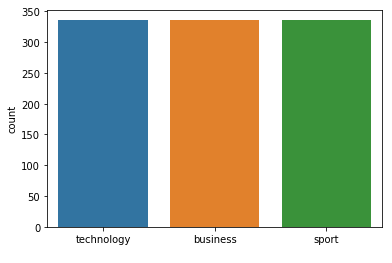



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.93      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.92      0.98      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 76  0]
 [ 1  0 55]]
FOLD 2 Number of neighbors 17
Class Distribution --> Train data (Fold 2 ):


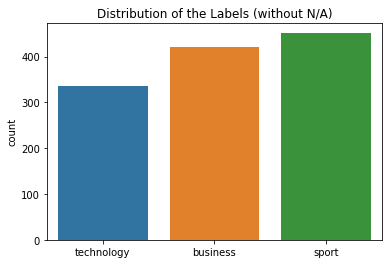

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


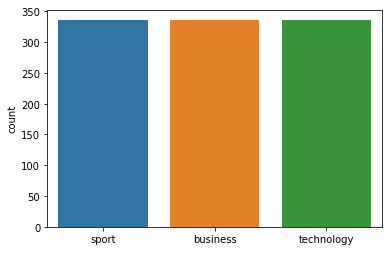



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.90      0.98      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[65  0  5]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 17
Class Distribution --> Train data (Fold 3 ):


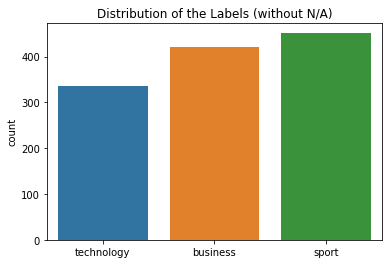

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


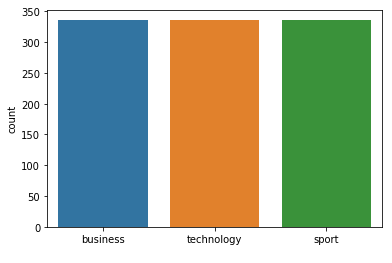



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 17
Class Distribution --> Train data (Fold 4 ):


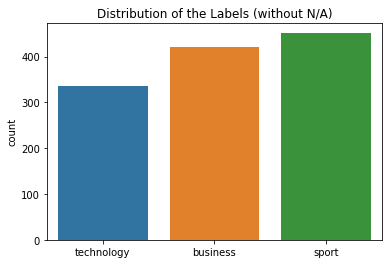

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


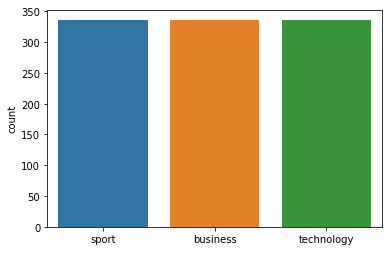



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 17
Class Distribution --> Train data (Fold 5 ):


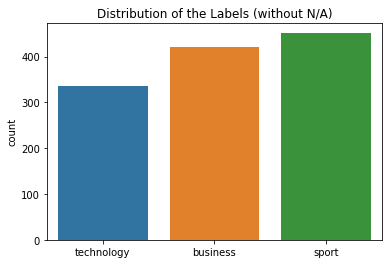

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


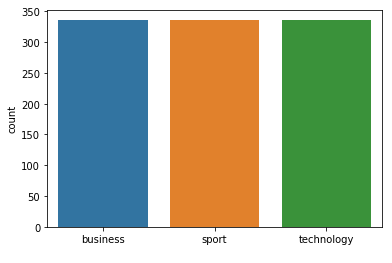



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 17
Class Distribution --> Train data (Fold 6 ):


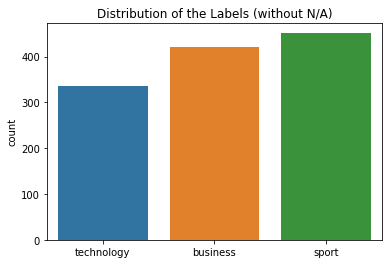

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


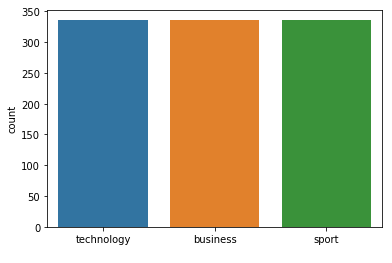



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.91      0.93        70
     sport
       0.97      0.99      0.98        75
technology
       0.91      0.93      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 1 74  0]
 [ 3  1 52]]
FOLD 7 Number of neighbors 17
Class Distribution --> Train data (Fold 7 ):


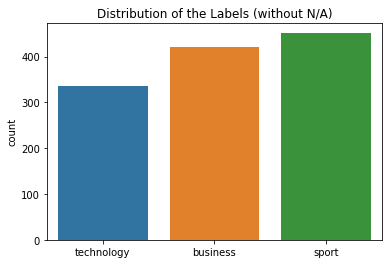

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


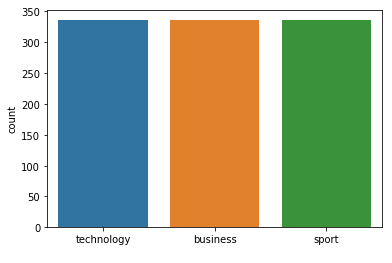



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 17  neighbours): 96.05% (+/- 1.39%)
FOLD 1 Number of neighbors 19
Class Distribution --> Train data (Fold 1 ):


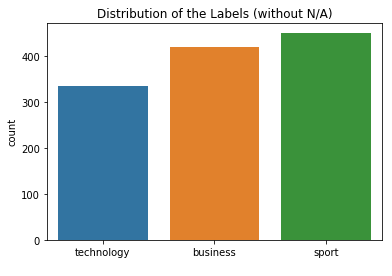

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


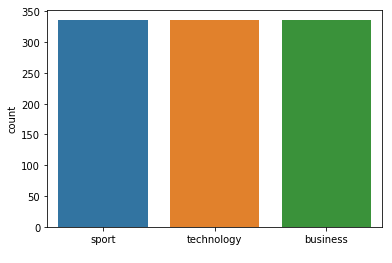



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 19
Class Distribution --> Train data (Fold 2 ):


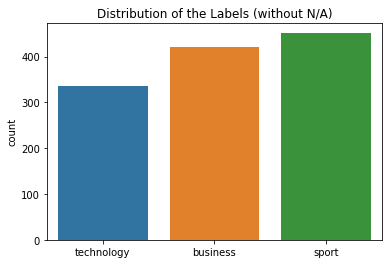

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


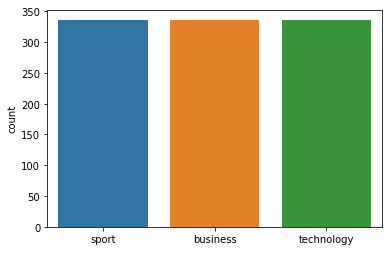



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.90      0.98      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[65  0  5]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 19
Class Distribution --> Train data (Fold 3 ):


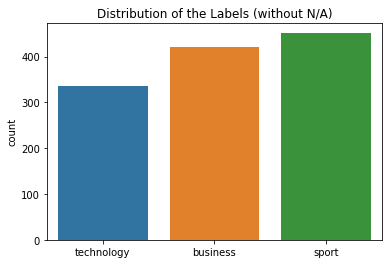

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


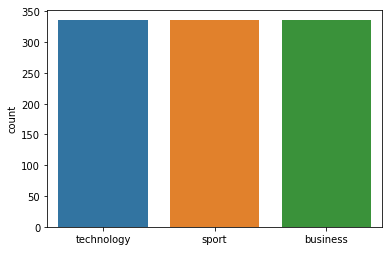



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 19
Class Distribution --> Train data (Fold 4 ):


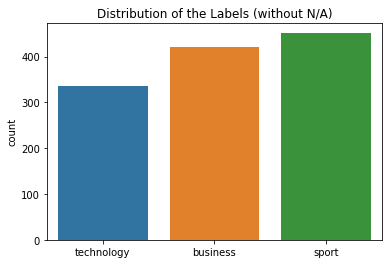

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


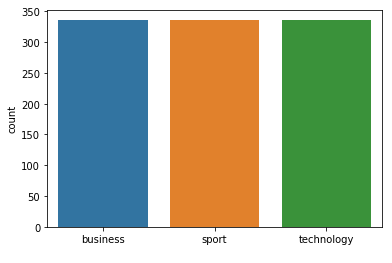



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 19
Class Distribution --> Train data (Fold 5 ):


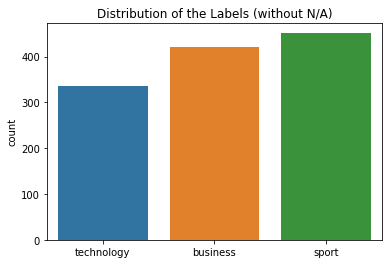

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


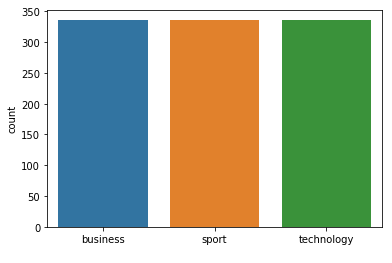



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 19
Class Distribution --> Train data (Fold 6 ):


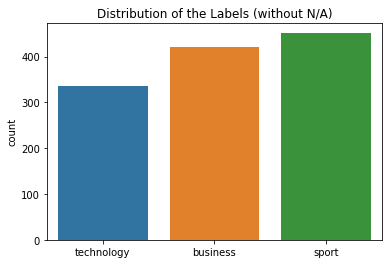

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


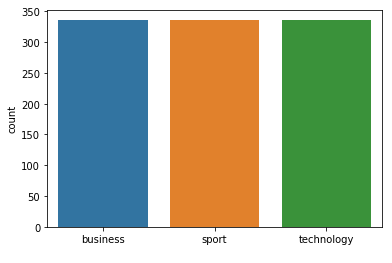



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.89      0.93        70
     sport
       0.94      1.00      0.97        75
technology
       0.91      0.93      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[62  3  5]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 7 Number of neighbors 19
Class Distribution --> Train data (Fold 7 ):


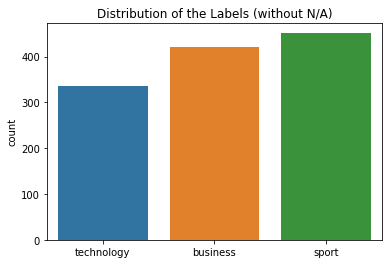

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


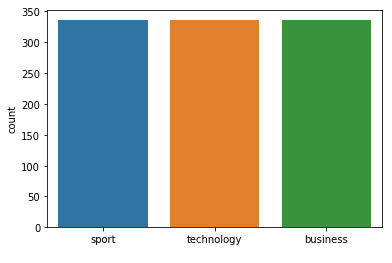



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 19  neighbours): 96.11% (+/- 1.38%)
FOLD 1 Number of neighbors 21
Class Distribution --> Train data (Fold 1 ):


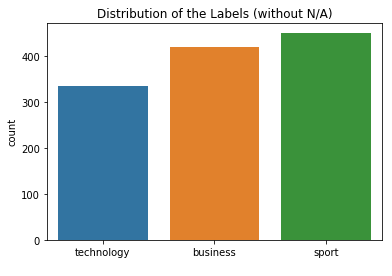

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


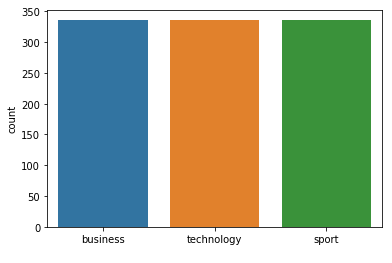



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 1  0 55]]
FOLD 2 Number of neighbors 21
Class Distribution --> Train data (Fold 2 ):


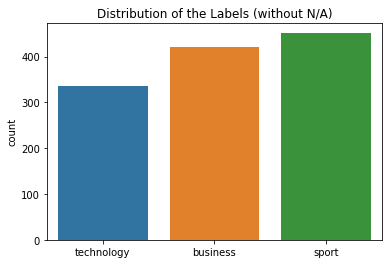

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


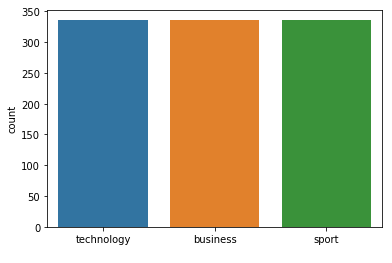



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.99      0.97      0.98        75
technology
       0.90      1.00      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[64  1  5]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 21
Class Distribution --> Train data (Fold 3 ):


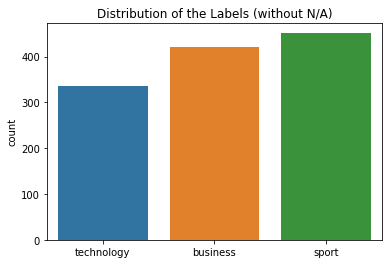

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


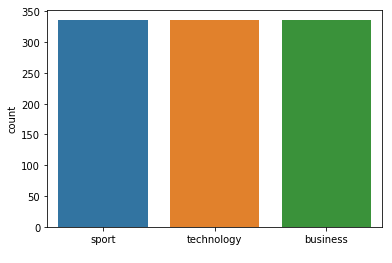



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 21
Class Distribution --> Train data (Fold 4 ):


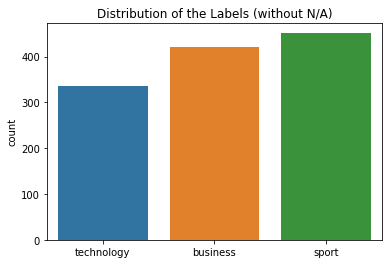

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


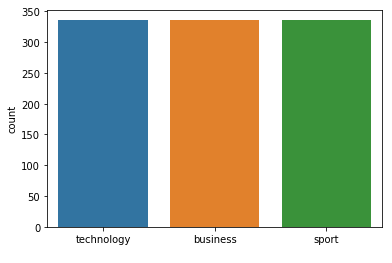



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 21
Class Distribution --> Train data (Fold 5 ):


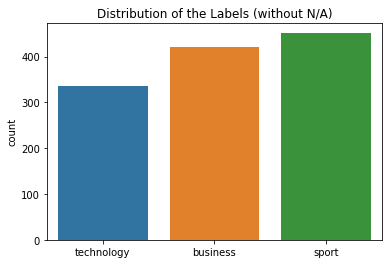

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


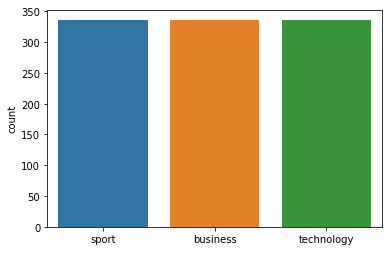



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 21
Class Distribution --> Train data (Fold 6 ):


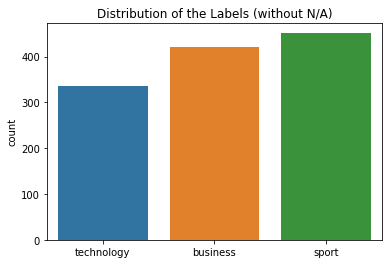

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


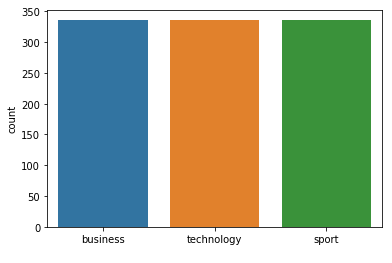



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.90      0.94        70
     sport
       0.95      1.00      0.97        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[63  2  5]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 21
Class Distribution --> Train data (Fold 7 ):


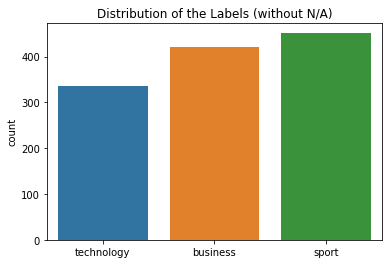

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


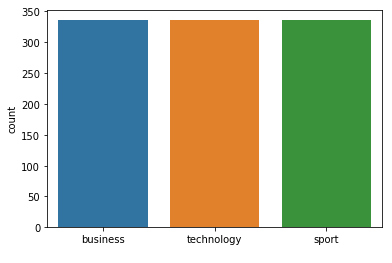



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 21  neighbours): 96.17% (+/- 1.36%)
FOLD 1 Number of neighbors 23
Class Distribution --> Train data (Fold 1 ):


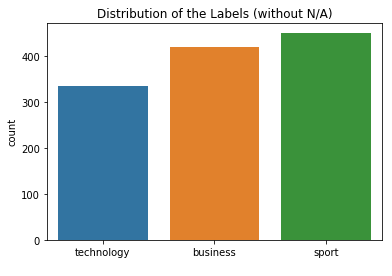

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


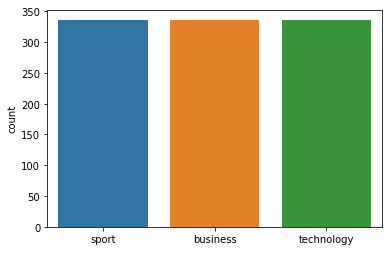



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       1.00      1.00      1.00        76
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 23
Class Distribution --> Train data (Fold 2 ):


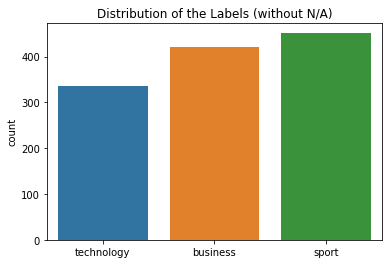

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


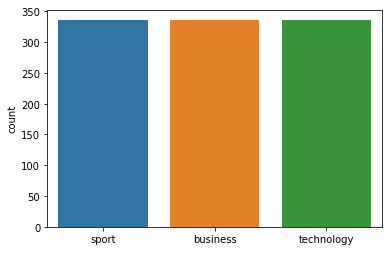



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  1  3]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 23
Class Distribution --> Train data (Fold 3 ):


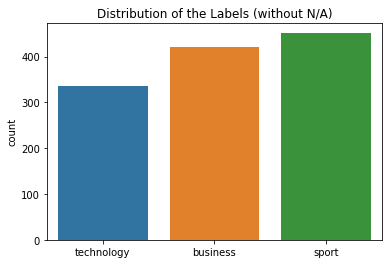

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


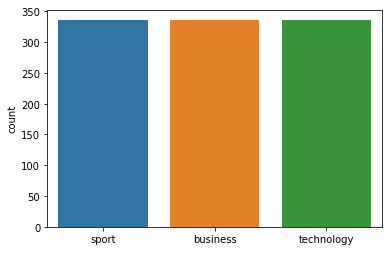



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 23
Class Distribution --> Train data (Fold 4 ):


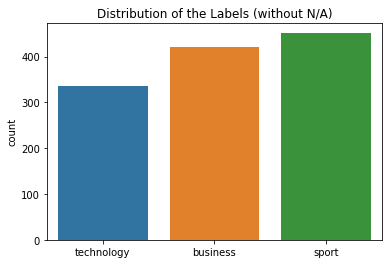

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


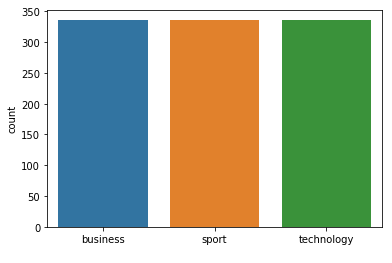



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 23
Class Distribution --> Train data (Fold 5 ):


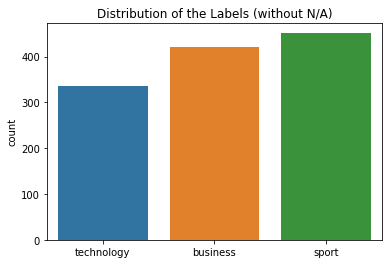

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


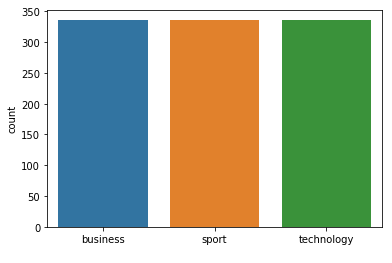



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  0  4]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 23
Class Distribution --> Train data (Fold 6 ):


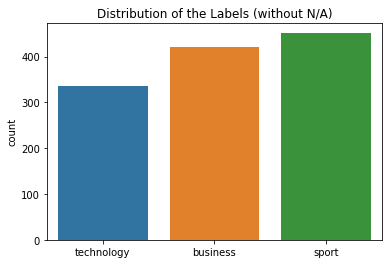

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


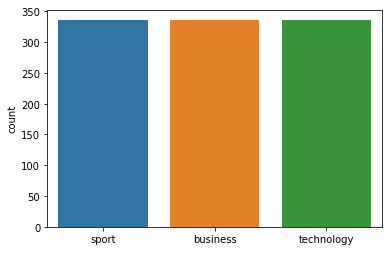



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.87      0.92        70
     sport
       0.95      1.00      0.97        75
technology
       0.90      0.96      0.93        56

avg / total       0.95      0.95      0.94       201

Confusion Matrix (Fold 6 ):
[[61  3  6]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 23
Class Distribution --> Train data (Fold 7 ):


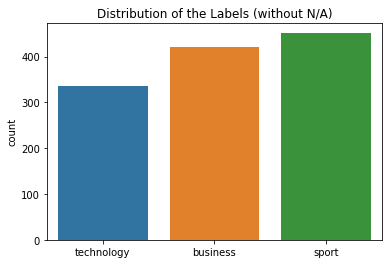

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


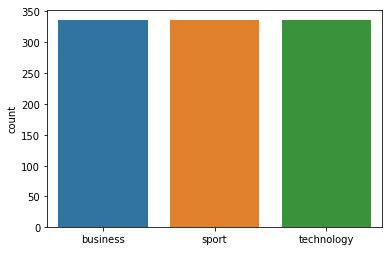



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 23  neighbours): 96.23% (+/- 1.36%)
FOLD 1 Number of neighbors 25
Class Distribution --> Train data (Fold 1 ):


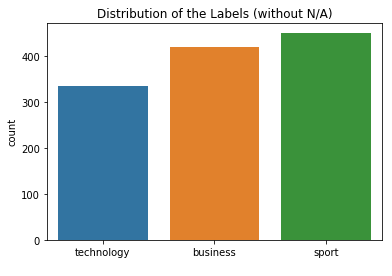

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


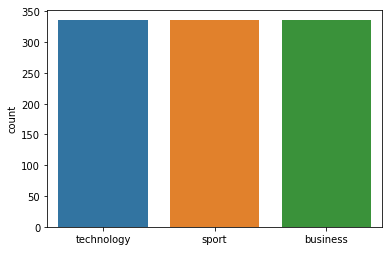



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 25
Class Distribution --> Train data (Fold 2 ):


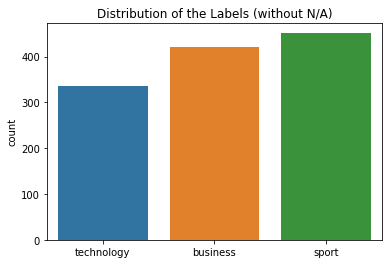

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


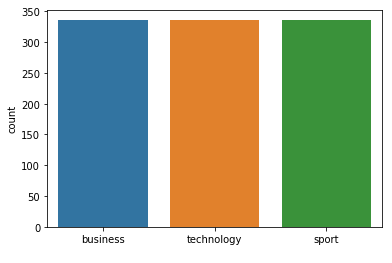



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  1  3]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 25
Class Distribution --> Train data (Fold 3 ):


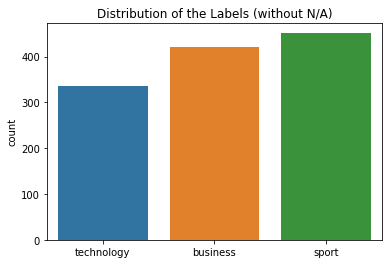

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


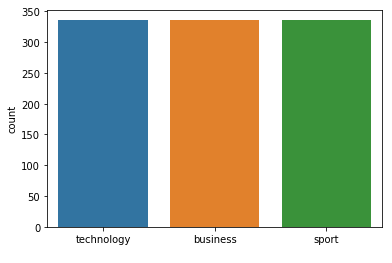



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 25
Class Distribution --> Train data (Fold 4 ):


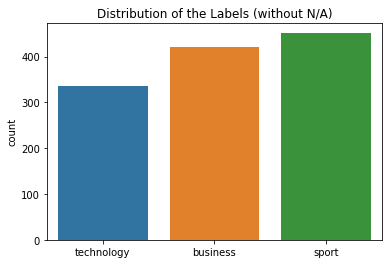

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


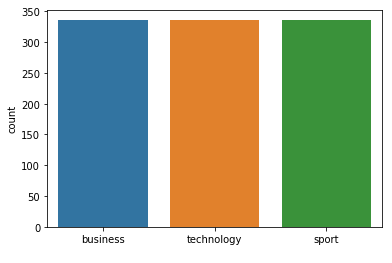



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 25
Class Distribution --> Train data (Fold 5 ):


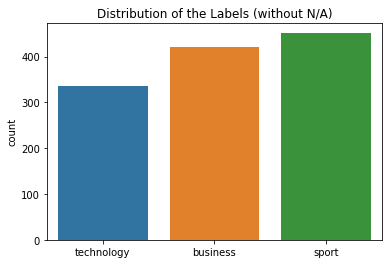

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


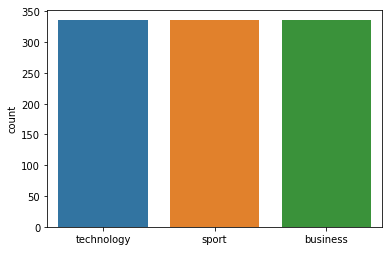



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 25
Class Distribution --> Train data (Fold 6 ):


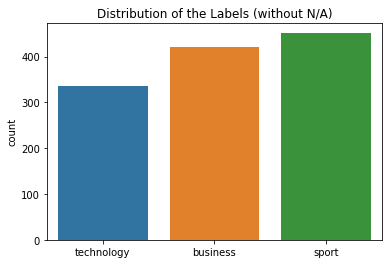

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


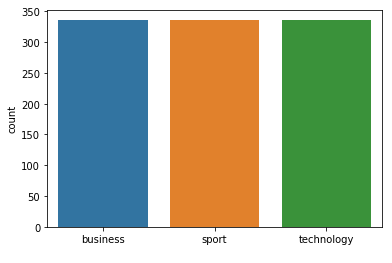



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.95      0.89      0.92        70
     sport
       0.96      1.00      0.98        75
technology
       0.90      0.93      0.91        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[62  2  6]
 [ 0 75  0]
 [ 3  1 52]]
FOLD 7 Number of neighbors 25
Class Distribution --> Train data (Fold 7 ):


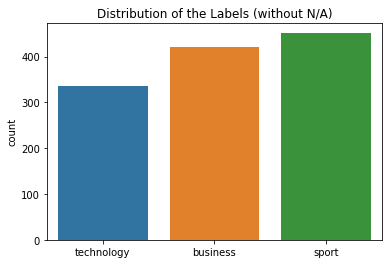

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


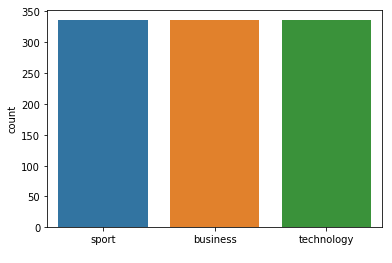



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.96      0.95        55

avg / total       0.97      0.96      0.97       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 25  neighbours): 96.27% (+/- 1.36%)
FOLD 1 Number of neighbors 27
Class Distribution --> Train data (Fold 1 ):


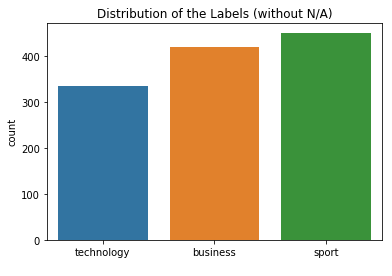

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


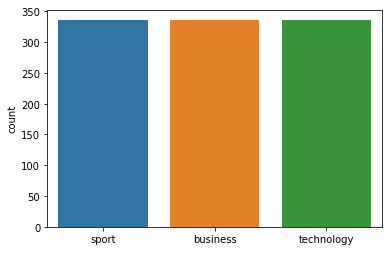



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 27
Class Distribution --> Train data (Fold 2 ):


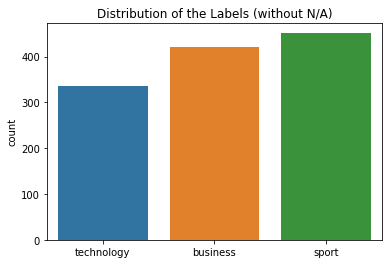

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


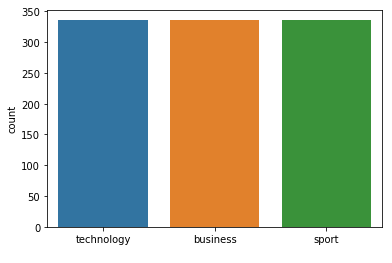



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 27
Class Distribution --> Train data (Fold 3 ):


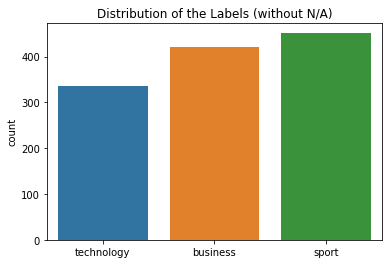

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


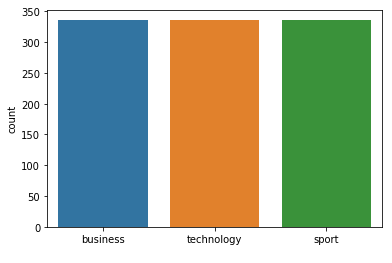



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 27
Class Distribution --> Train data (Fold 4 ):


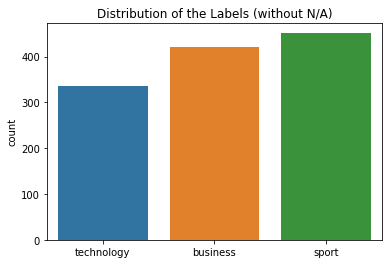

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


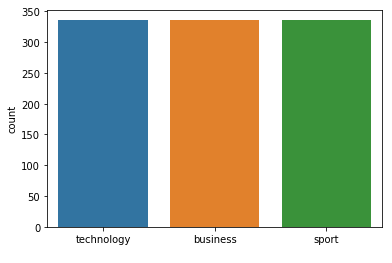



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 5 Number of neighbors 27
Class Distribution --> Train data (Fold 5 ):


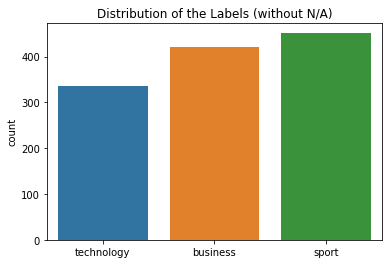

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


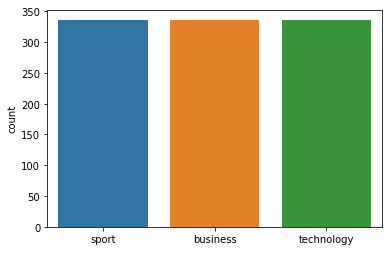



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 27
Class Distribution --> Train data (Fold 6 ):


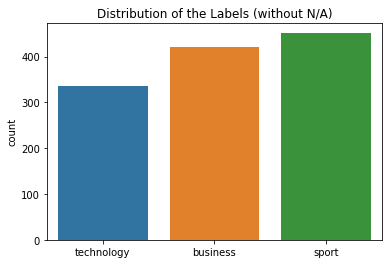

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


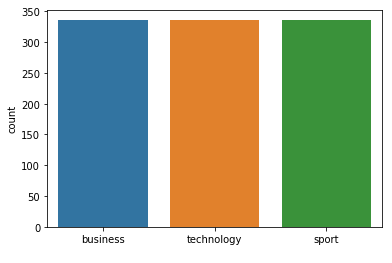



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.89      0.93        70
     sport
       0.95      1.00      0.97        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.94       201

Confusion Matrix (Fold 6 ):
[[62  3  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 27
Class Distribution --> Train data (Fold 7 ):


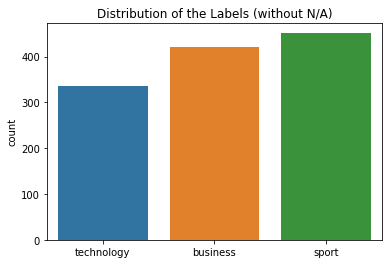

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


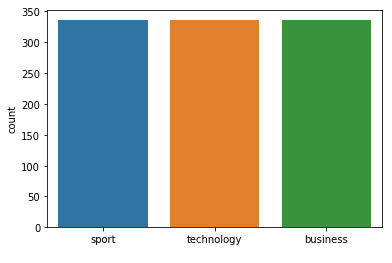



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 27  neighbours): 96.33% (+/- 1.36%)
FOLD 1 Number of neighbors 29
Class Distribution --> Train data (Fold 1 ):


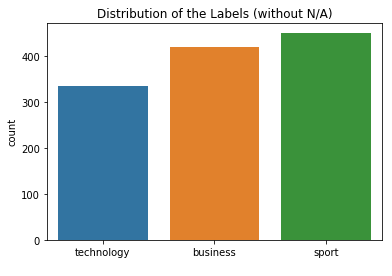

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


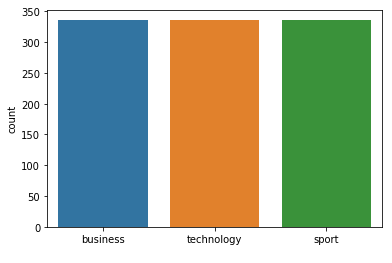



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 29
Class Distribution --> Train data (Fold 2 ):


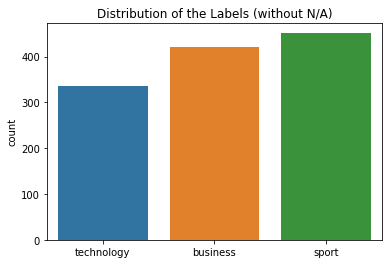

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


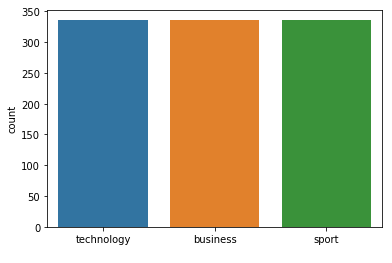



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 29
Class Distribution --> Train data (Fold 3 ):


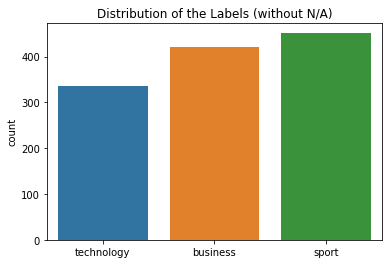

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


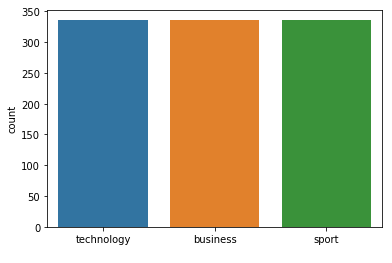



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 29
Class Distribution --> Train data (Fold 4 ):


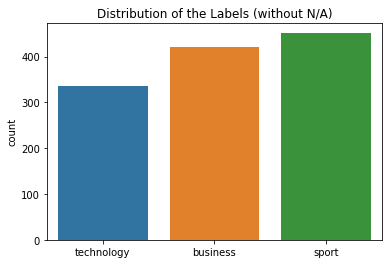

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


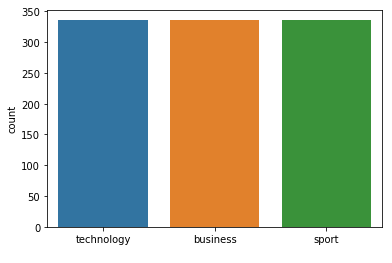



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.96      0.98        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 72  1]
 [ 1  0 55]]
FOLD 5 Number of neighbors 29
Class Distribution --> Train data (Fold 5 ):


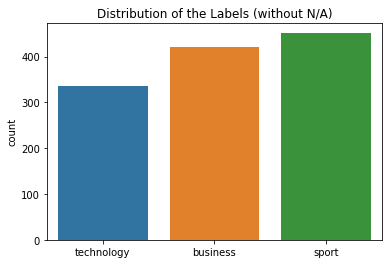

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


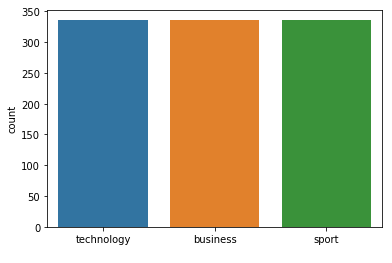



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 29
Class Distribution --> Train data (Fold 6 ):


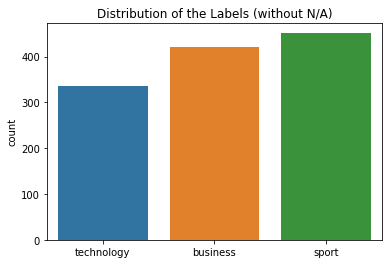

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


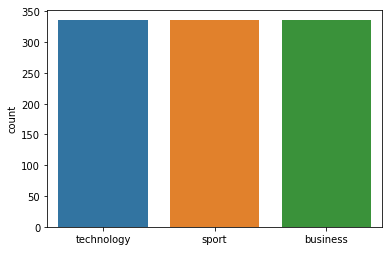



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 29
Class Distribution --> Train data (Fold 7 ):


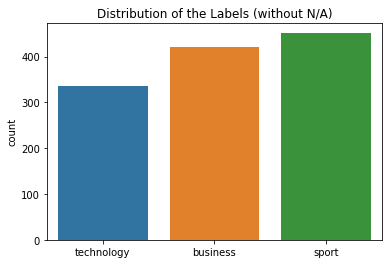

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


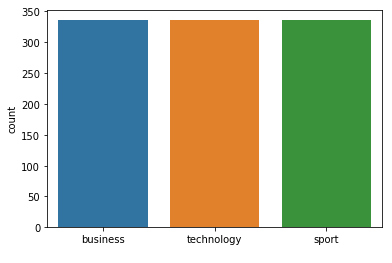



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 29  neighbours): 96.37% (+/- 1.34%)
FOLD 1 Number of neighbors 31
Class Distribution --> Train data (Fold 1 ):


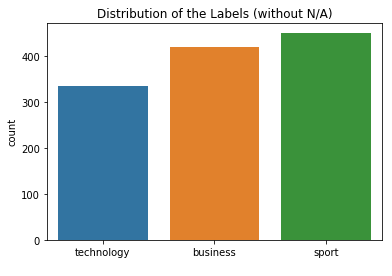

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


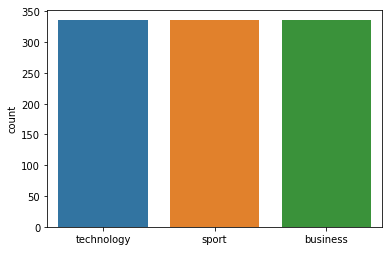



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 31
Class Distribution --> Train data (Fold 2 ):


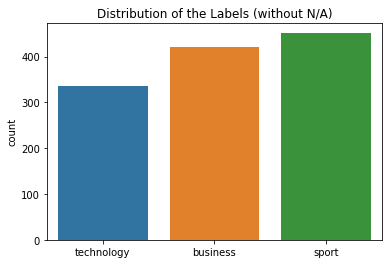

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


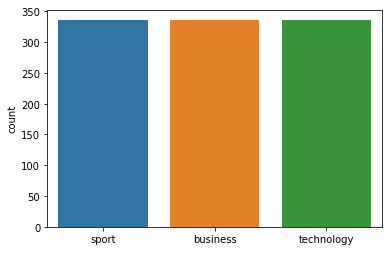



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 31
Class Distribution --> Train data (Fold 3 ):


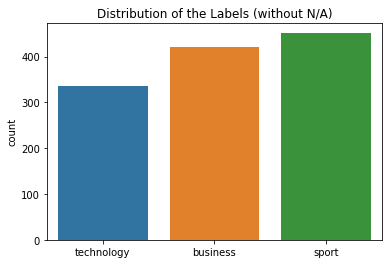

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


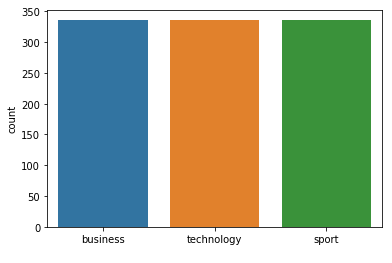



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 31
Class Distribution --> Train data (Fold 4 ):


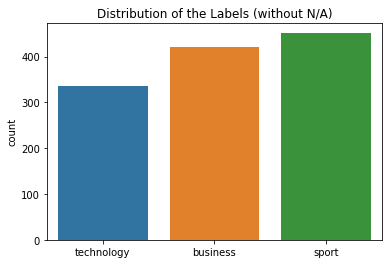

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


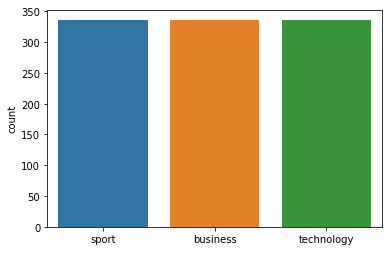



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 31
Class Distribution --> Train data (Fold 5 ):


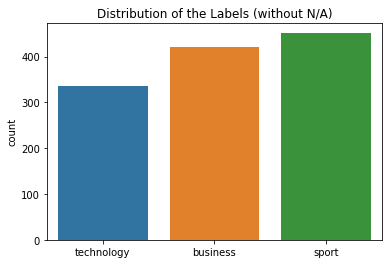

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


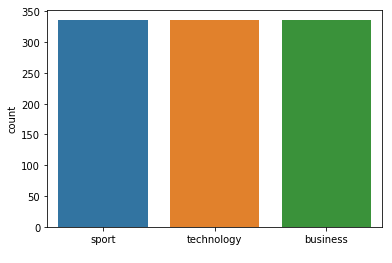



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 31
Class Distribution --> Train data (Fold 6 ):


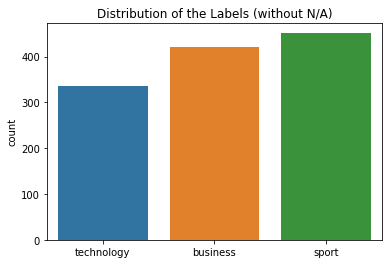

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


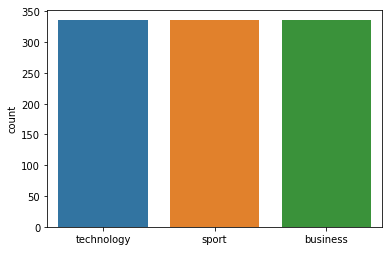



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 31
Class Distribution --> Train data (Fold 7 ):


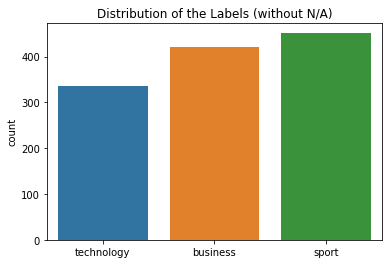

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


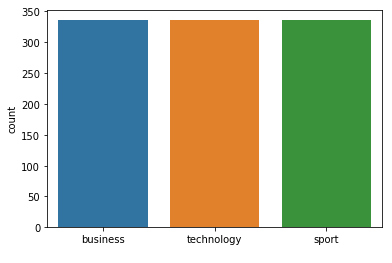



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 31  neighbours): 96.40% (+/- 1.33%)
FOLD 1 Number of neighbors 33
Class Distribution --> Train data (Fold 1 ):


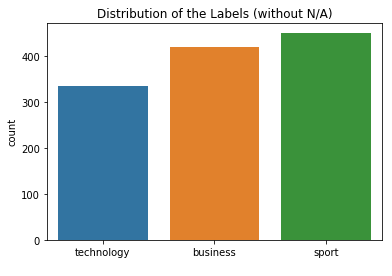

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


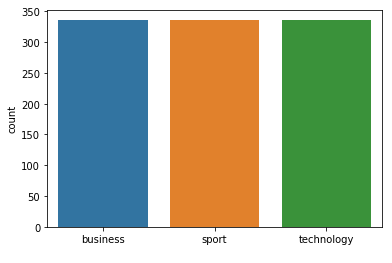



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 33
Class Distribution --> Train data (Fold 2 ):


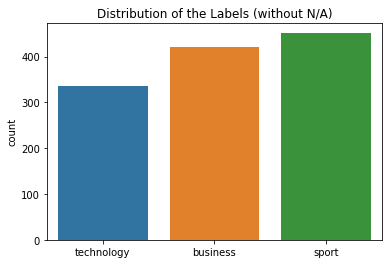

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


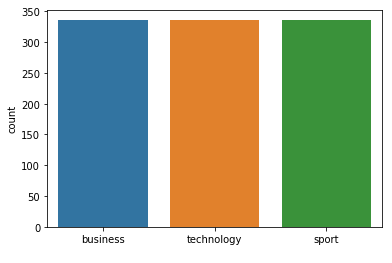



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 33
Class Distribution --> Train data (Fold 3 ):


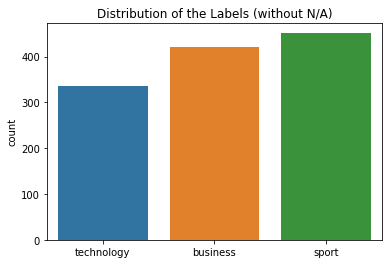

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


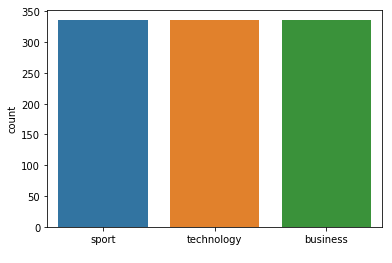



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 33
Class Distribution --> Train data (Fold 4 ):


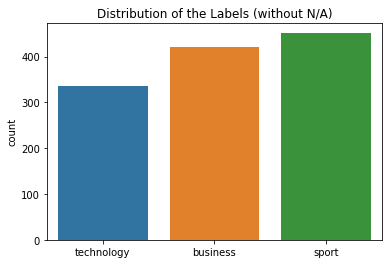

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


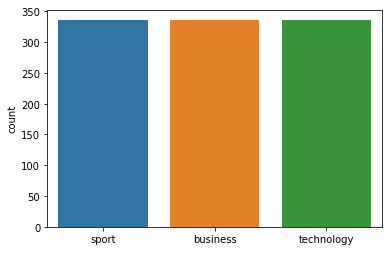



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 73  1]
 [ 1  0 55]]
FOLD 5 Number of neighbors 33
Class Distribution --> Train data (Fold 5 ):


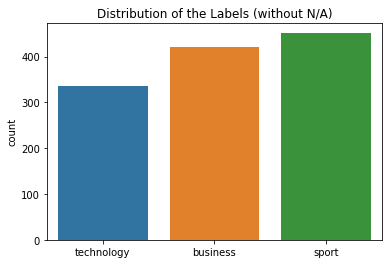

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


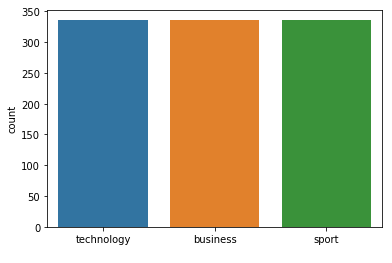



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 33
Class Distribution --> Train data (Fold 6 ):


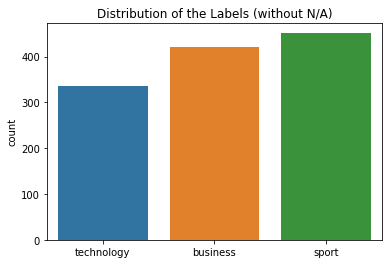

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


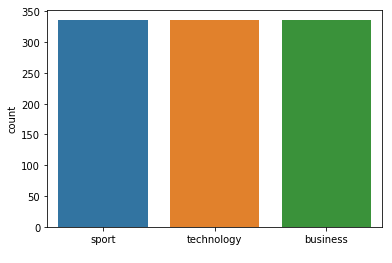



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.95      0.89      0.92        70
     sport
       0.95      1.00      0.97        75
technology
       0.91      0.93      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[62  3  5]
 [ 0 75  0]
 [ 3  1 52]]
FOLD 7 Number of neighbors 33
Class Distribution --> Train data (Fold 7 ):


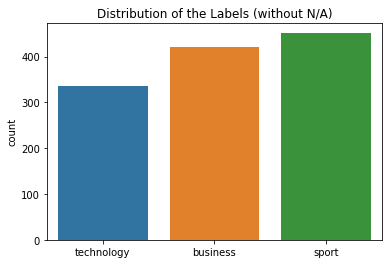

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


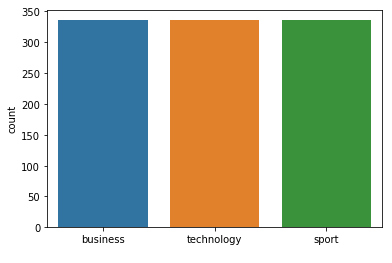



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 33  neighbours): 96.42% (+/- 1.33%)
FOLD 1 Number of neighbors 35
Class Distribution --> Train data (Fold 1 ):


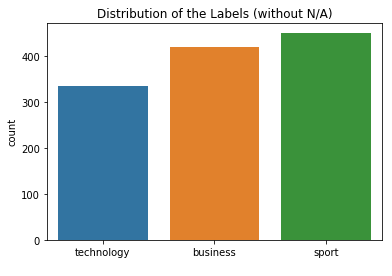

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


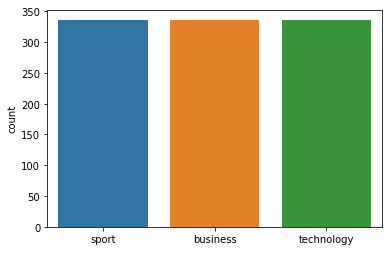



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 35
Class Distribution --> Train data (Fold 2 ):


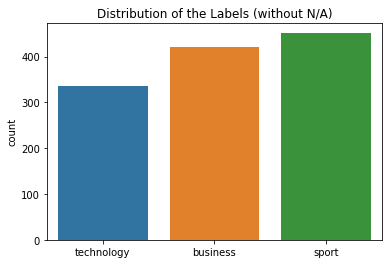

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


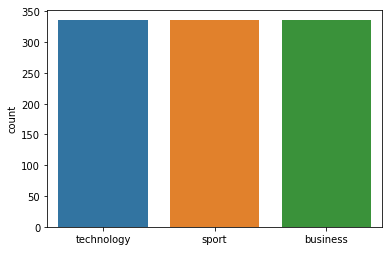



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.96      0.97        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 72  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 35
Class Distribution --> Train data (Fold 3 ):


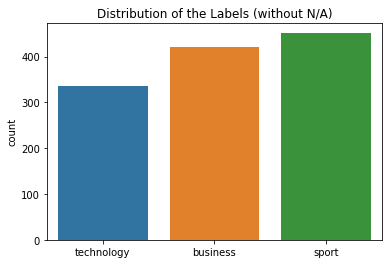

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


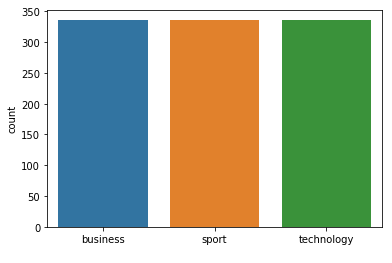



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 35
Class Distribution --> Train data (Fold 4 ):


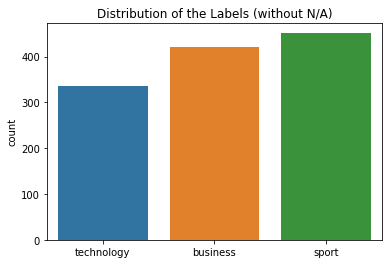

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


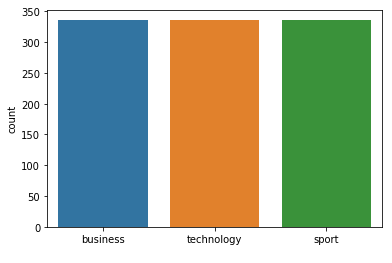



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 35
Class Distribution --> Train data (Fold 5 ):


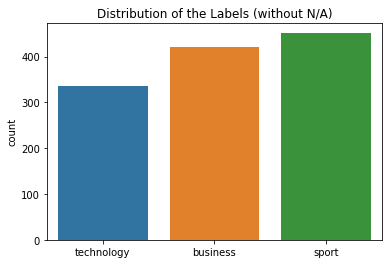

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


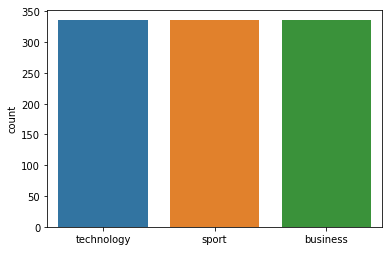



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 35
Class Distribution --> Train data (Fold 6 ):


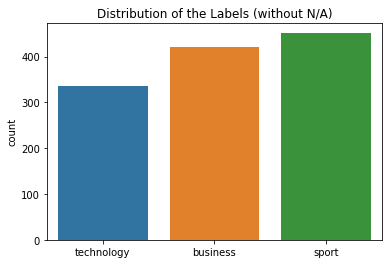

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


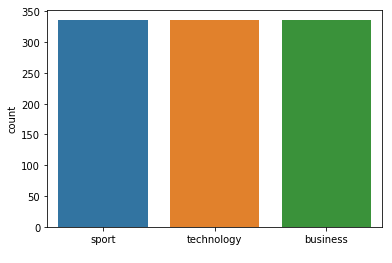



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 35
Class Distribution --> Train data (Fold 7 ):


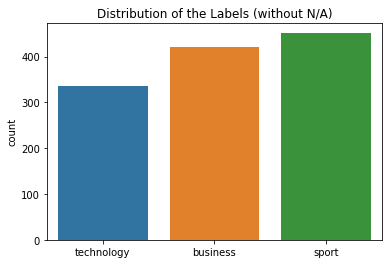

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


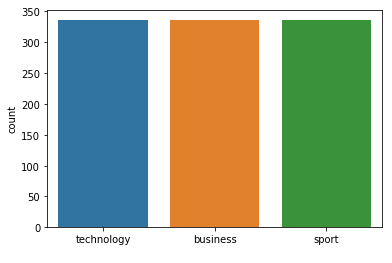



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 35  neighbours): 96.46% (+/- 1.32%)
FOLD 1 Number of neighbors 37
Class Distribution --> Train data (Fold 1 ):


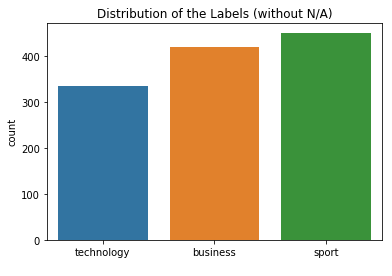

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


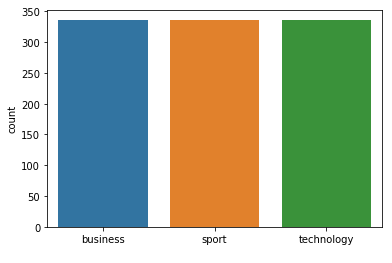



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 37
Class Distribution --> Train data (Fold 2 ):


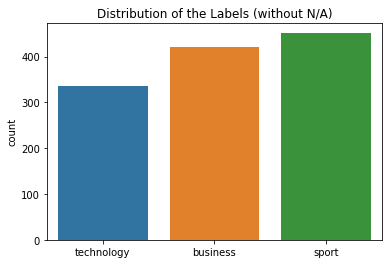

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


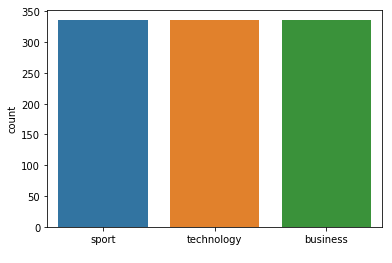



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 37
Class Distribution --> Train data (Fold 3 ):


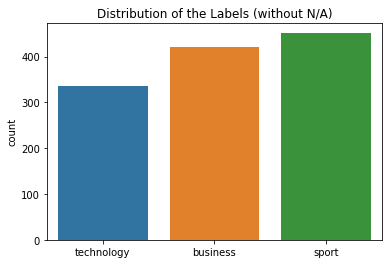

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


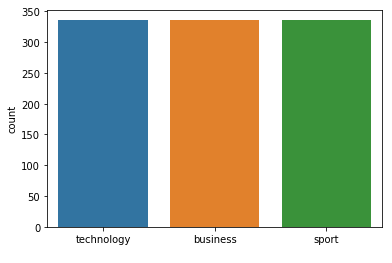



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 37
Class Distribution --> Train data (Fold 4 ):


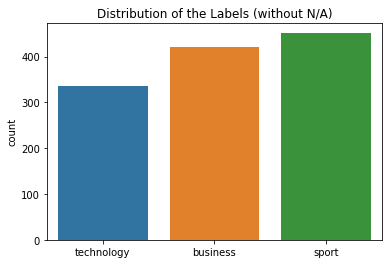

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


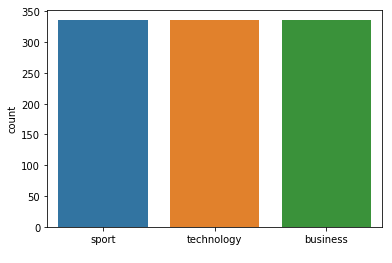



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 5 Number of neighbors 37
Class Distribution --> Train data (Fold 5 ):


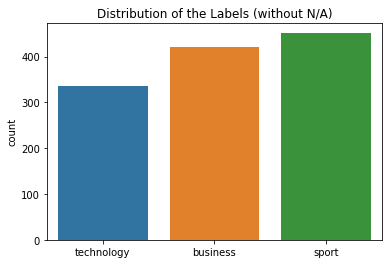

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


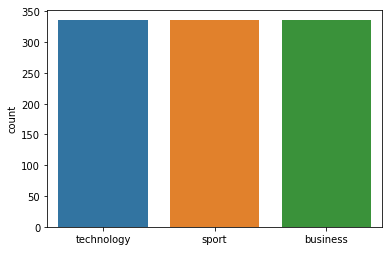



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 37
Class Distribution --> Train data (Fold 6 ):


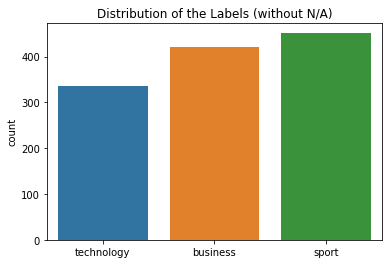

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


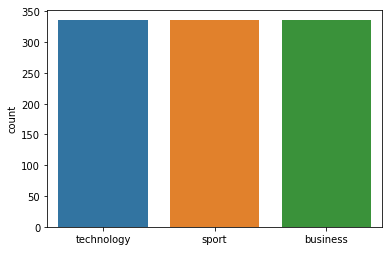



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.89      0.93        70
     sport
       0.95      1.00      0.97        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.94       201

Confusion Matrix (Fold 6 ):
[[62  3  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 37
Class Distribution --> Train data (Fold 7 ):


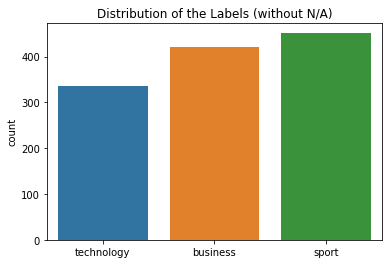

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


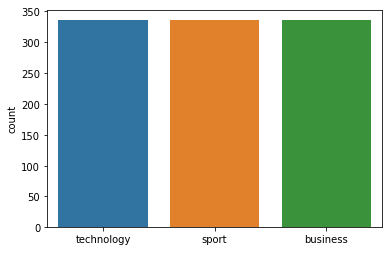



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 37  neighbours): 96.48% (+/- 1.31%)
FOLD 1 Number of neighbors 39
Class Distribution --> Train data (Fold 1 ):


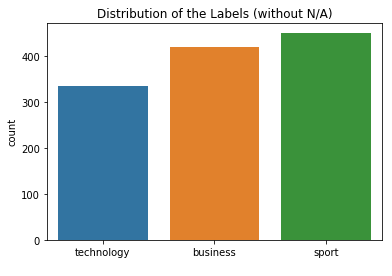

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


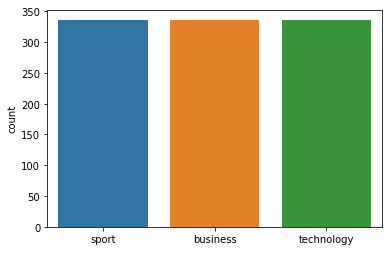



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 39
Class Distribution --> Train data (Fold 2 ):


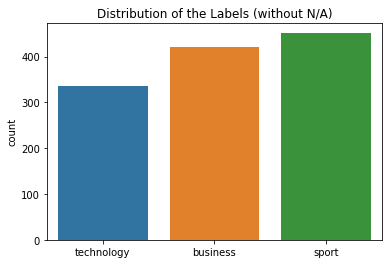

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


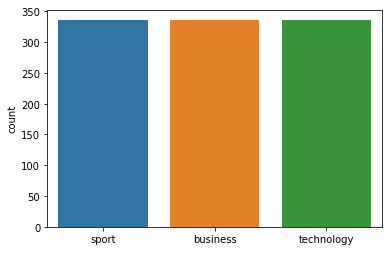



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 39
Class Distribution --> Train data (Fold 3 ):


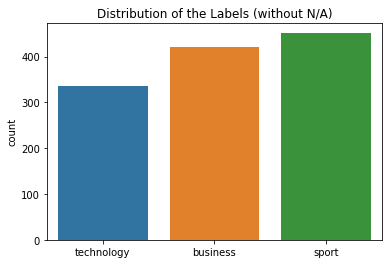

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


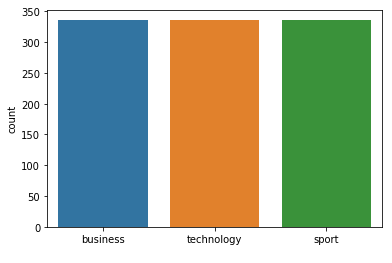



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 39
Class Distribution --> Train data (Fold 4 ):


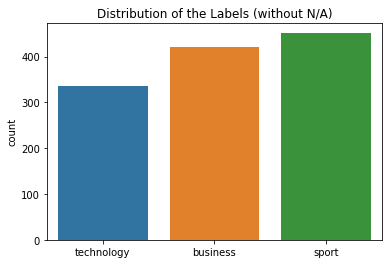

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


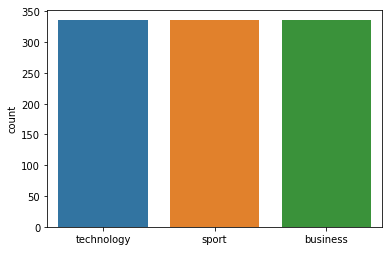



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 39
Class Distribution --> Train data (Fold 5 ):


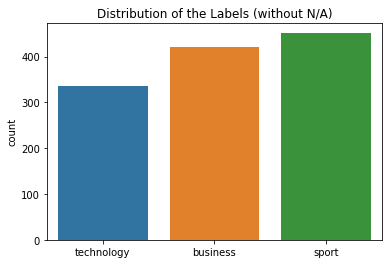

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


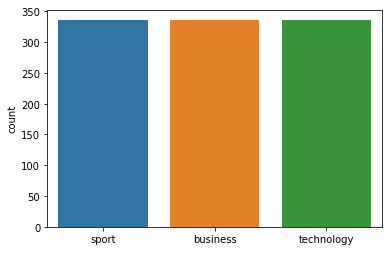



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 39
Class Distribution --> Train data (Fold 6 ):


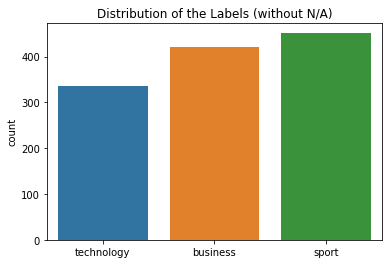

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


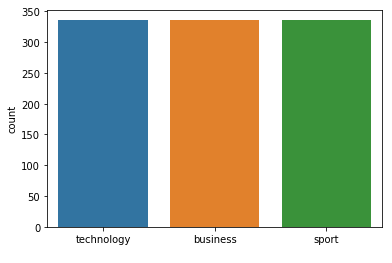



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 39
Class Distribution --> Train data (Fold 7 ):


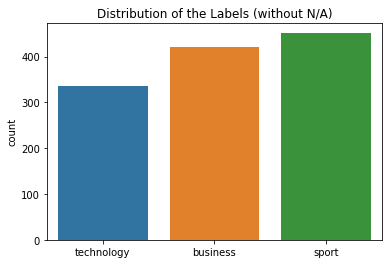

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


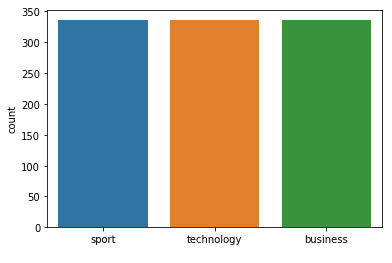



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 39  neighbours): 96.51% (+/- 1.31%)
FOLD 1 Number of neighbors 41
Class Distribution --> Train data (Fold 1 ):


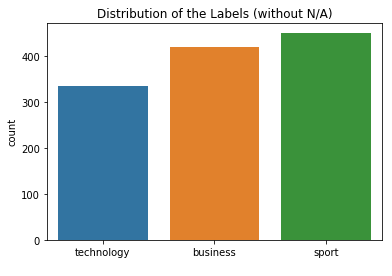

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


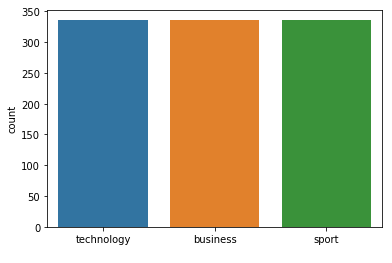



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 41
Class Distribution --> Train data (Fold 2 ):


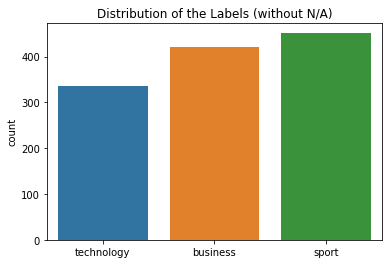

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


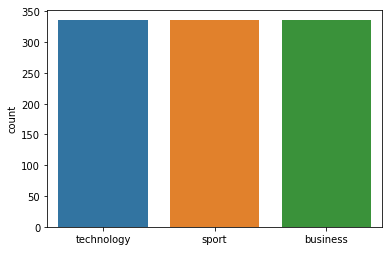



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.96      0.97        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 72  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 41
Class Distribution --> Train data (Fold 3 ):


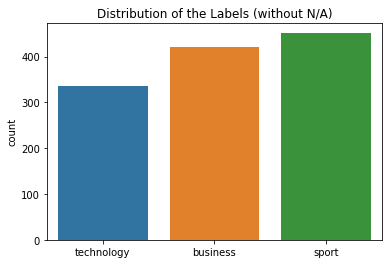

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


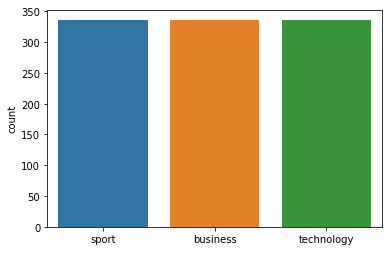



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 41
Class Distribution --> Train data (Fold 4 ):


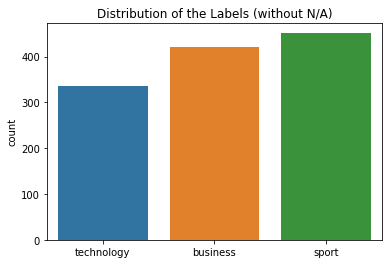

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


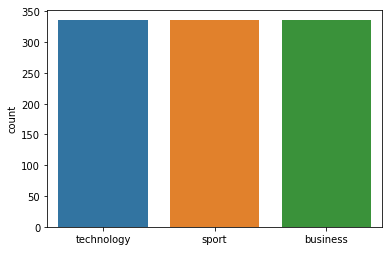



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 41
Class Distribution --> Train data (Fold 5 ):


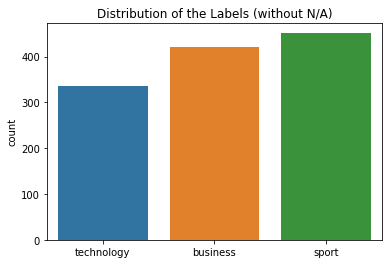

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


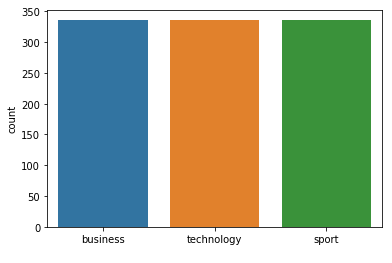



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 41
Class Distribution --> Train data (Fold 6 ):


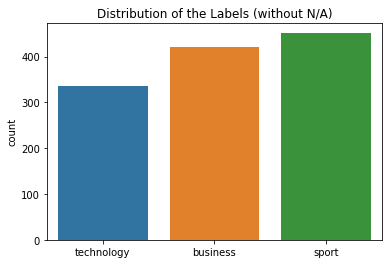

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


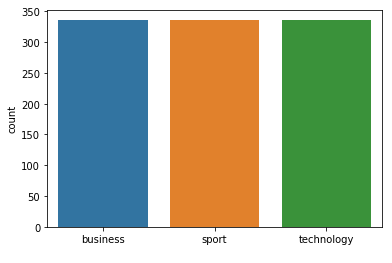



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 41
Class Distribution --> Train data (Fold 7 ):


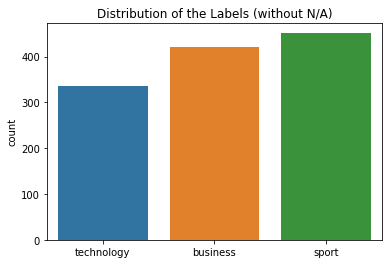

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


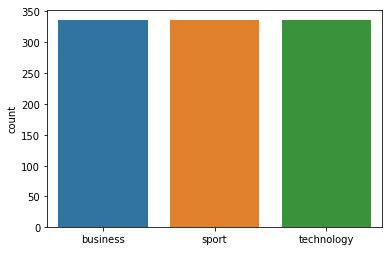



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 41  neighbours): 96.54% (+/- 1.30%)
FOLD 1 Number of neighbors 43
Class Distribution --> Train data (Fold 1 ):


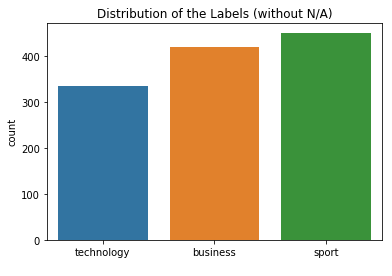

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


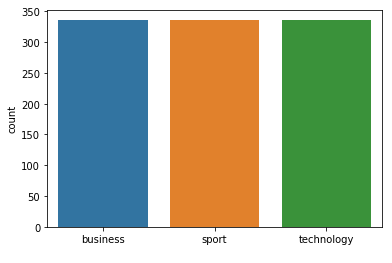



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 43
Class Distribution --> Train data (Fold 2 ):


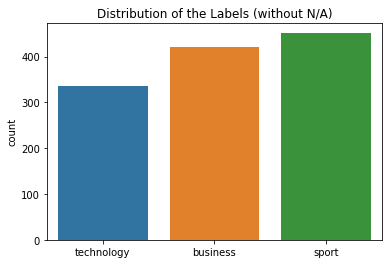

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


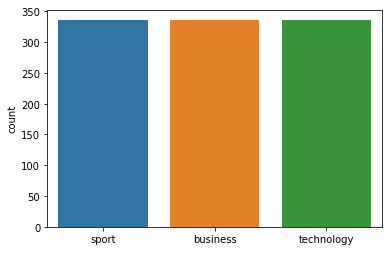



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.96      0.97        75
technology
       0.93      1.00      0.97        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[65  2  3]
 [ 2 72  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 43
Class Distribution --> Train data (Fold 3 ):


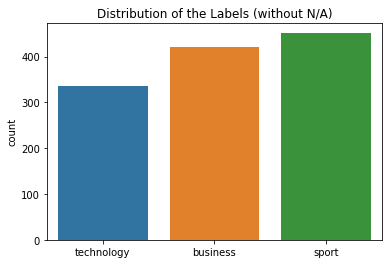

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


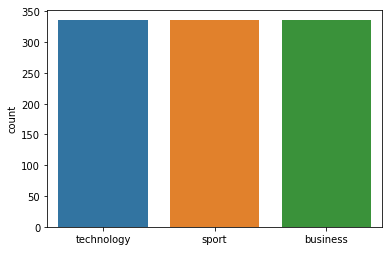



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 43
Class Distribution --> Train data (Fold 4 ):


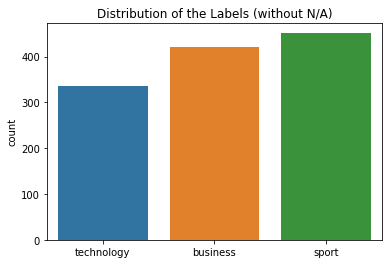

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


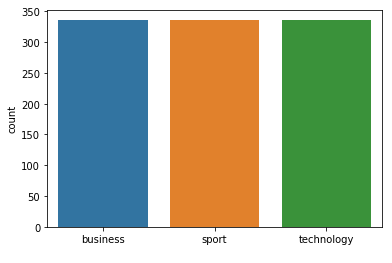



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 43
Class Distribution --> Train data (Fold 5 ):


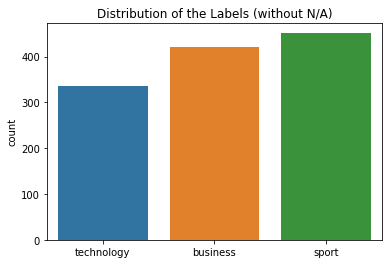

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


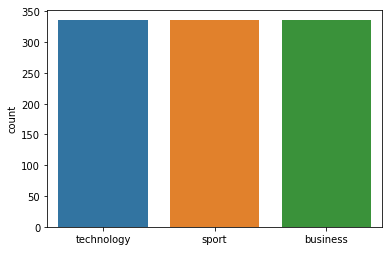



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 43
Class Distribution --> Train data (Fold 6 ):


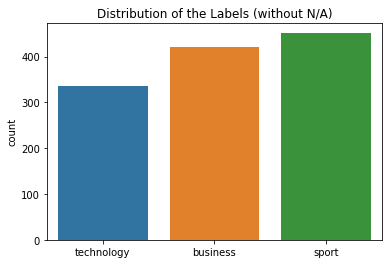

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


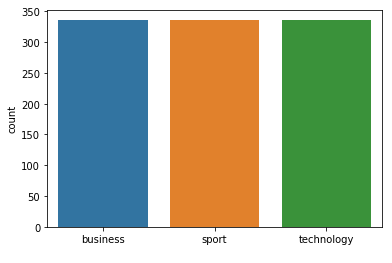



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 43
Class Distribution --> Train data (Fold 7 ):


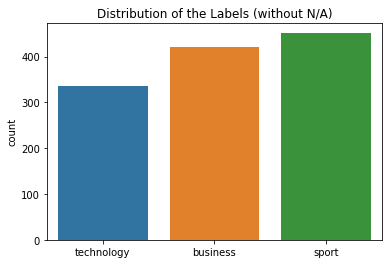

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


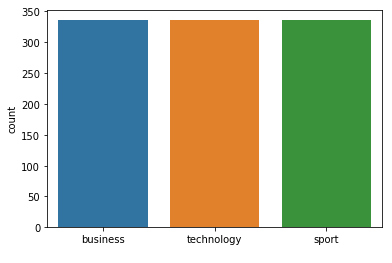



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 43  neighbours): 96.56% (+/- 1.30%)
FOLD 1 Number of neighbors 45
Class Distribution --> Train data (Fold 1 ):


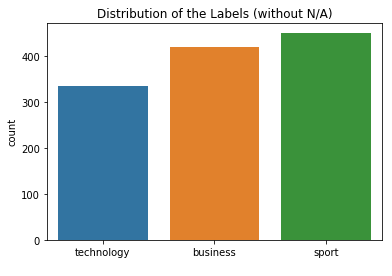

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


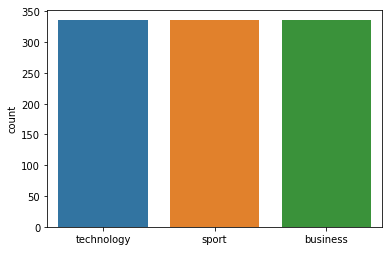



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 45
Class Distribution --> Train data (Fold 2 ):


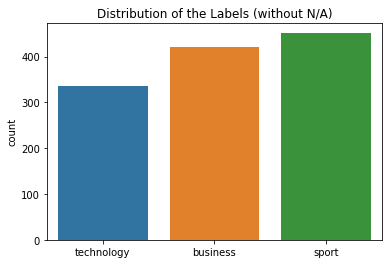

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


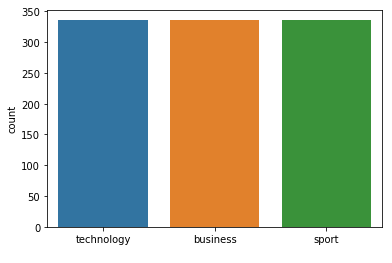



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 45
Class Distribution --> Train data (Fold 3 ):


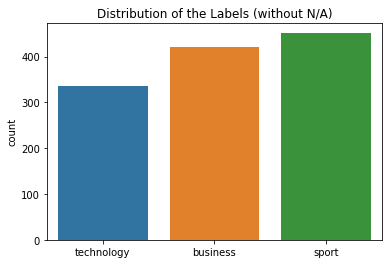

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


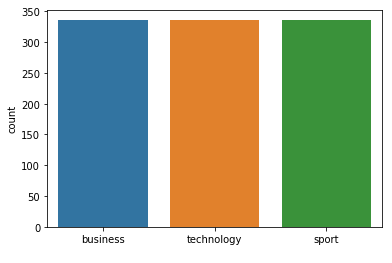



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 45
Class Distribution --> Train data (Fold 4 ):


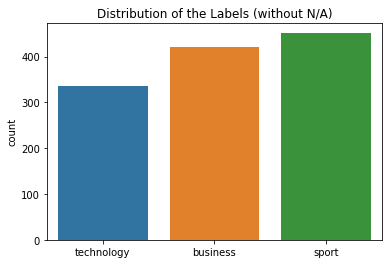

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


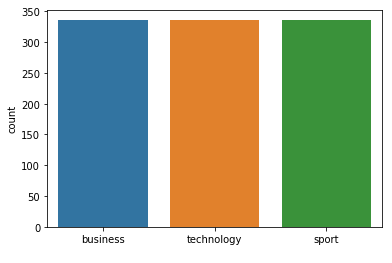



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 45
Class Distribution --> Train data (Fold 5 ):


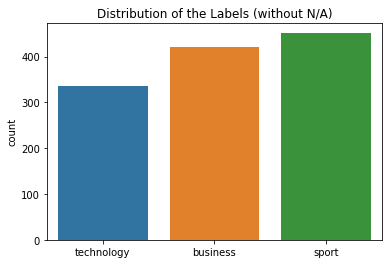

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


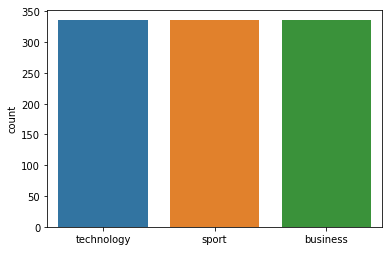



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 45
Class Distribution --> Train data (Fold 6 ):


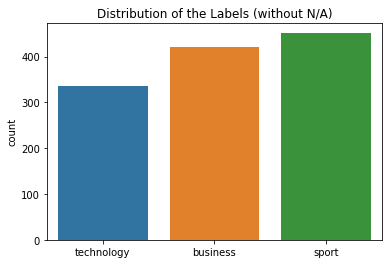

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


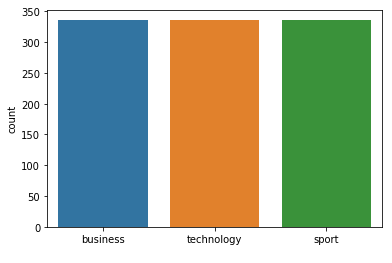



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 45
Class Distribution --> Train data (Fold 7 ):


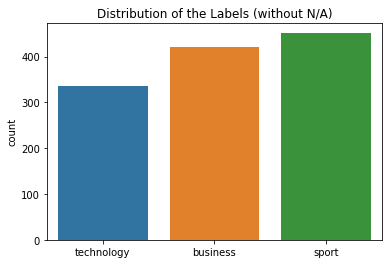

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


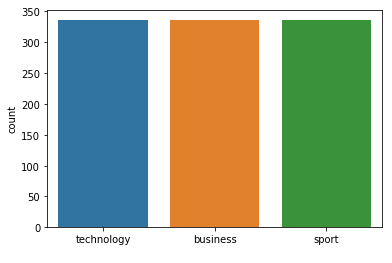



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 45  neighbours): 96.59% (+/- 1.29%)
FOLD 1 Number of neighbors 47
Class Distribution --> Train data (Fold 1 ):


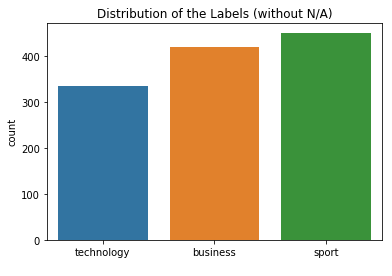

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


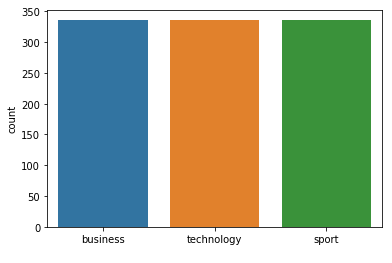



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 47
Class Distribution --> Train data (Fold 2 ):


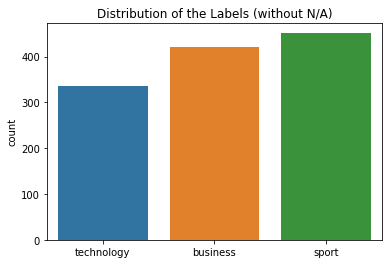

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


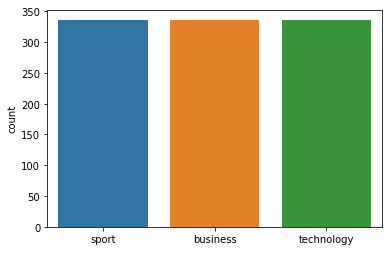



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 47
Class Distribution --> Train data (Fold 3 ):


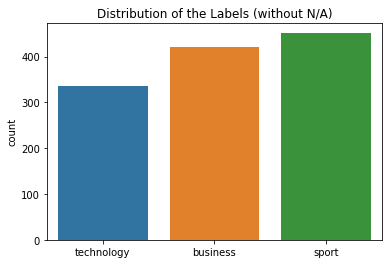

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


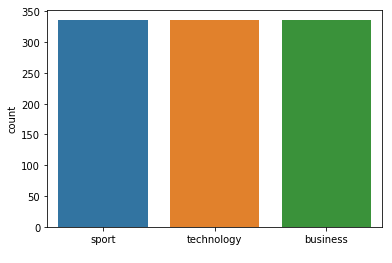



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 47
Class Distribution --> Train data (Fold 4 ):


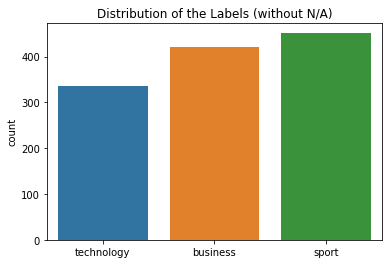

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


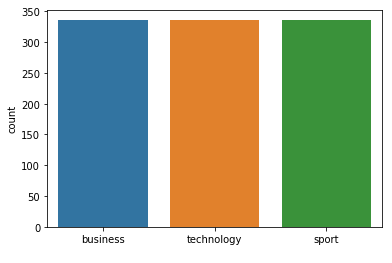



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 47
Class Distribution --> Train data (Fold 5 ):


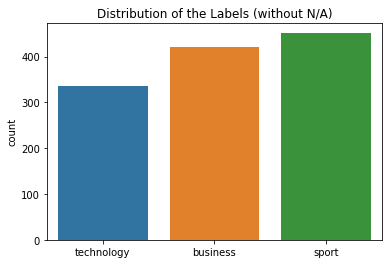

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


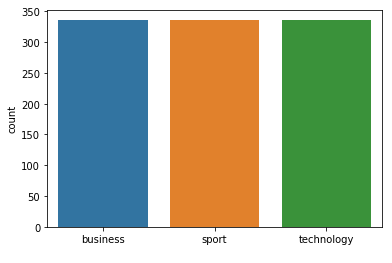



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 47
Class Distribution --> Train data (Fold 6 ):


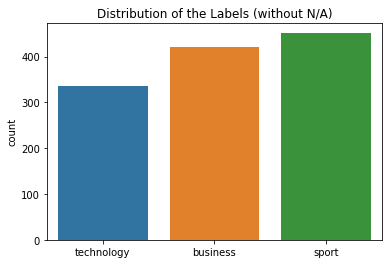

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


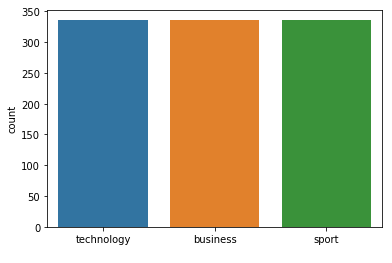



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 47
Class Distribution --> Train data (Fold 7 ):


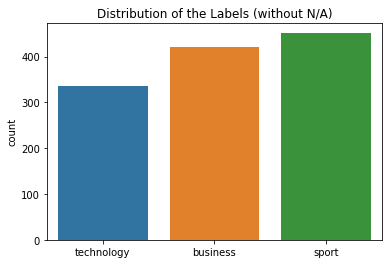

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


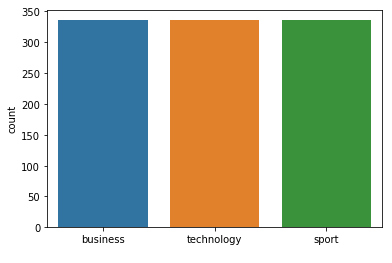



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 47  neighbours): 96.62% (+/- 1.28%)
FOLD 1 Number of neighbors 49
Class Distribution --> Train data (Fold 1 ):


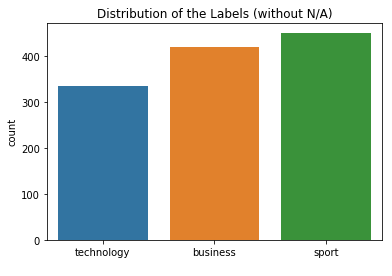

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


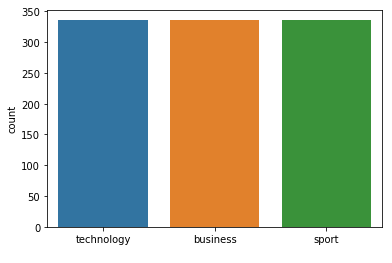



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 49
Class Distribution --> Train data (Fold 2 ):


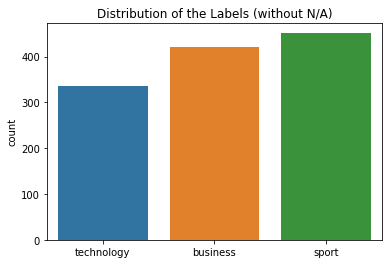

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


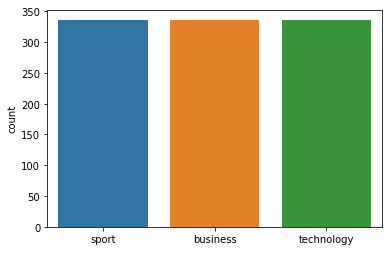



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 3 Number of neighbors 49
Class Distribution --> Train data (Fold 3 ):


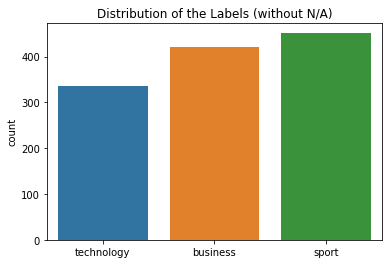

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


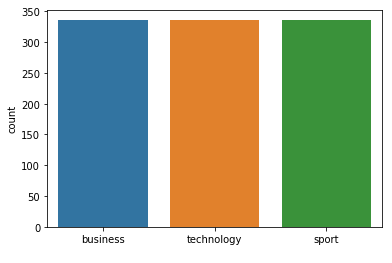



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 49
Class Distribution --> Train data (Fold 4 ):


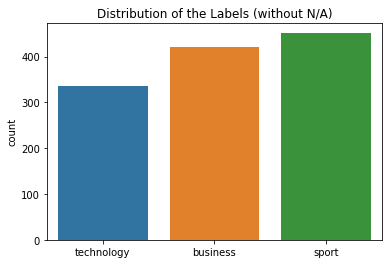

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


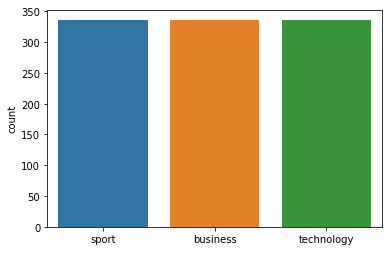



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 49
Class Distribution --> Train data (Fold 5 ):


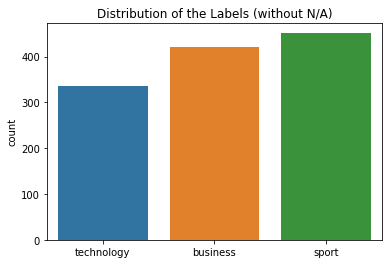

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


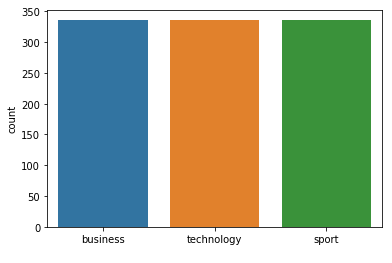



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 49
Class Distribution --> Train data (Fold 6 ):


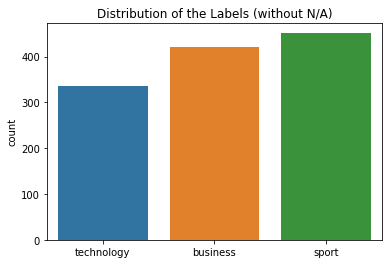

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


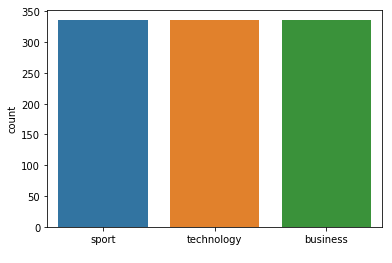



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 49
Class Distribution --> Train data (Fold 7 ):


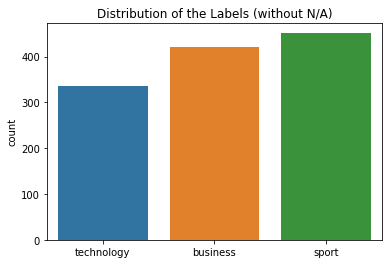

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


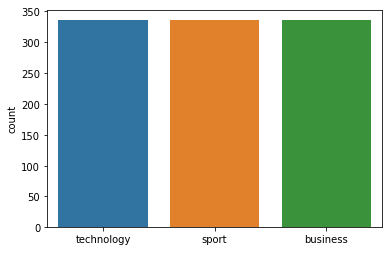



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 49  neighbours): 96.64% (+/- 1.28%)
FOLD 1 Number of neighbors 51
Class Distribution --> Train data (Fold 1 ):


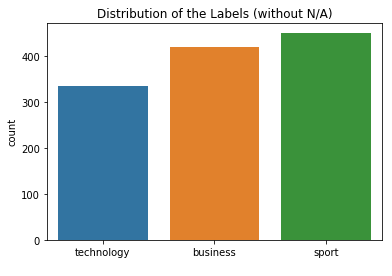

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


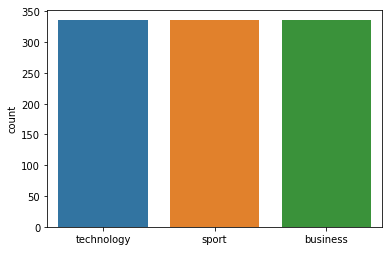



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 51
Class Distribution --> Train data (Fold 2 ):


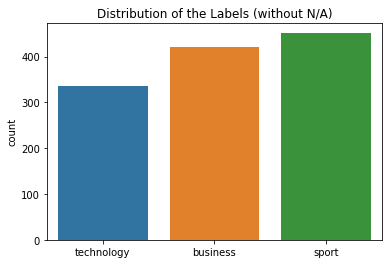

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


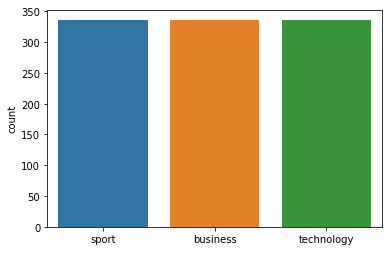



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 72  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 51
Class Distribution --> Train data (Fold 3 ):


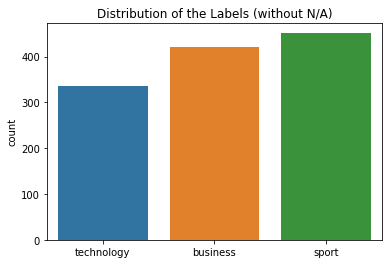

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


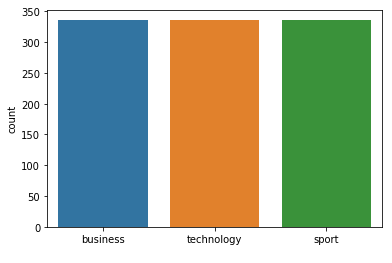



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 51
Class Distribution --> Train data (Fold 4 ):


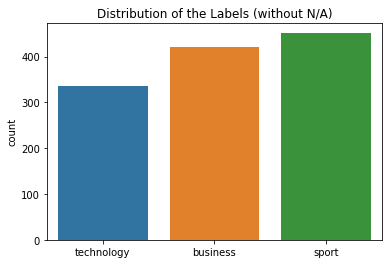

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


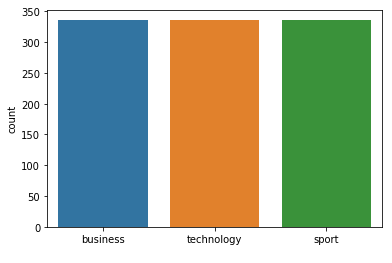



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 51
Class Distribution --> Train data (Fold 5 ):


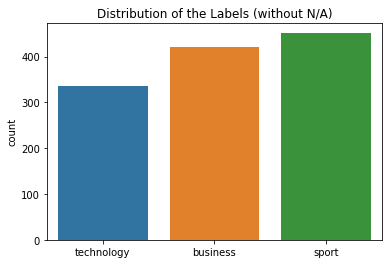

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


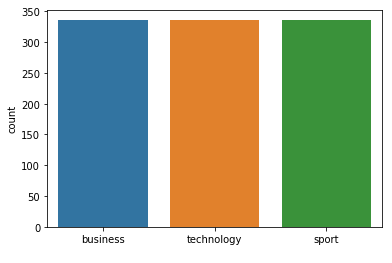



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 51
Class Distribution --> Train data (Fold 6 ):


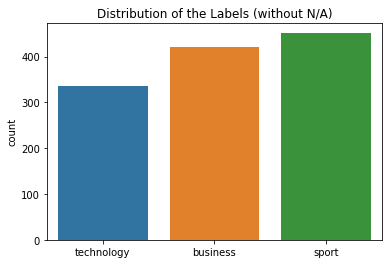

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


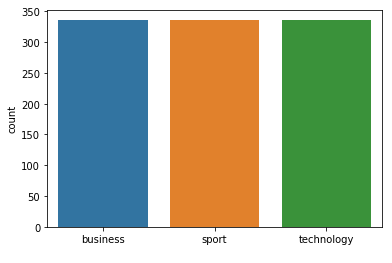



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 51
Class Distribution --> Train data (Fold 7 ):


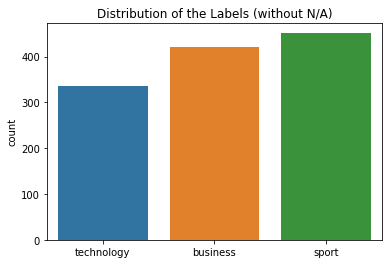

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


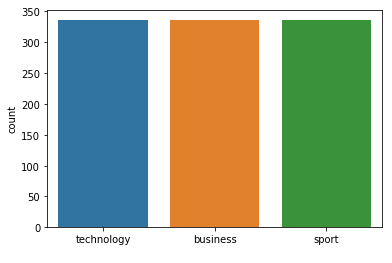



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 51  neighbours): 96.66% (+/- 1.27%)
FOLD 1 Number of neighbors 53
Class Distribution --> Train data (Fold 1 ):


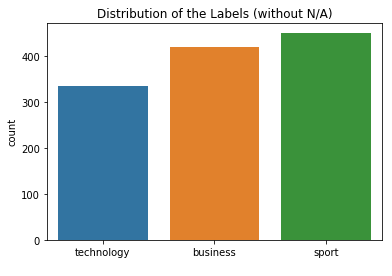

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


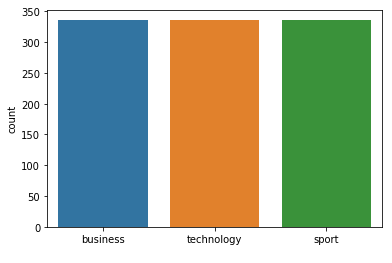



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 53
Class Distribution --> Train data (Fold 2 ):


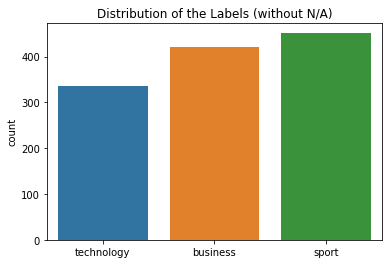

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


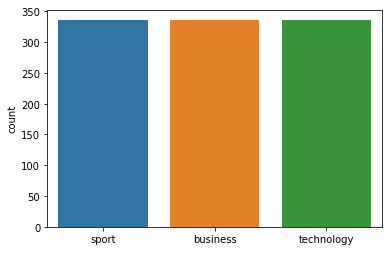



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 53
Class Distribution --> Train data (Fold 3 ):


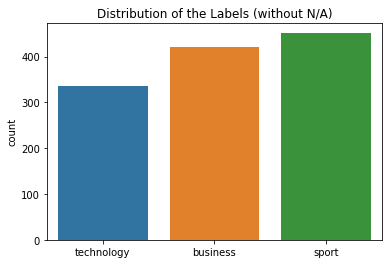

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


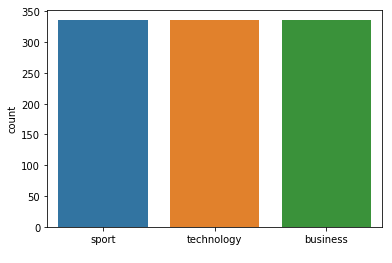



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 53
Class Distribution --> Train data (Fold 4 ):


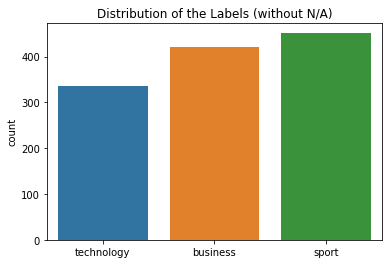

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


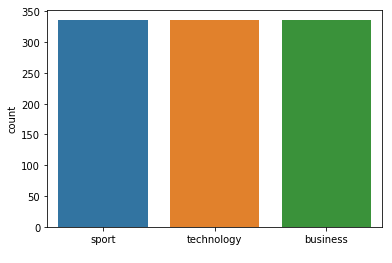



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 53
Class Distribution --> Train data (Fold 5 ):


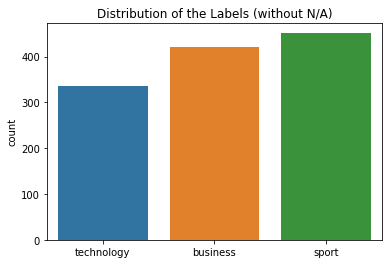

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


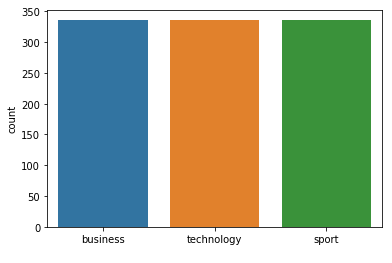



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 53
Class Distribution --> Train data (Fold 6 ):


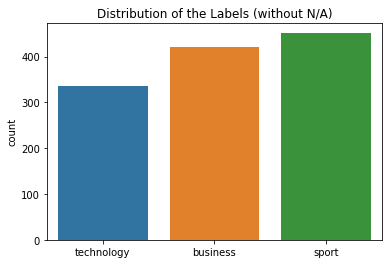

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


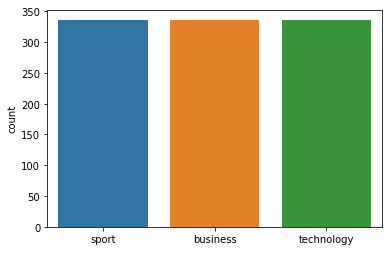



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 7 Number of neighbors 53
Class Distribution --> Train data (Fold 7 ):


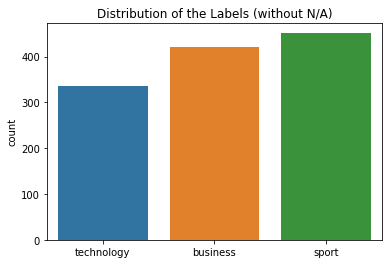

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


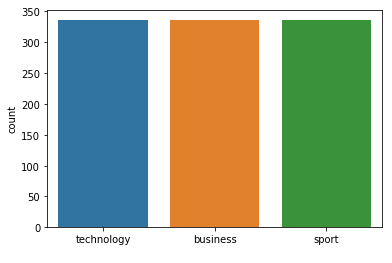



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 53  neighbours): 96.68% (+/- 1.26%)
FOLD 1 Number of neighbors 55
Class Distribution --> Train data (Fold 1 ):


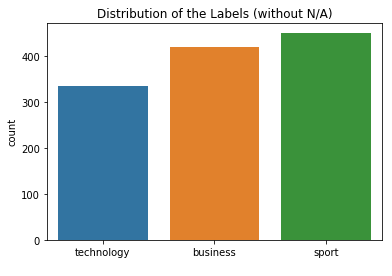

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


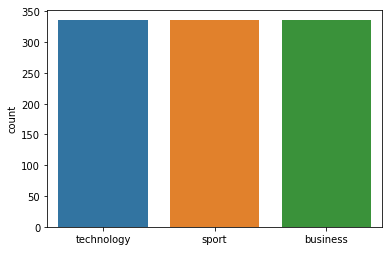



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 55
Class Distribution --> Train data (Fold 2 ):


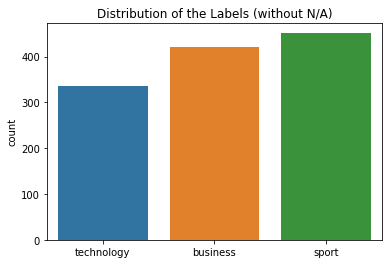

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


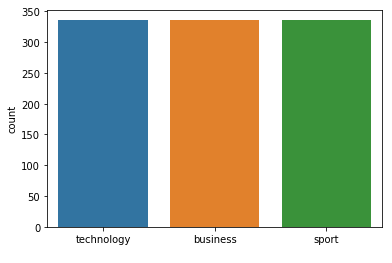



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  1  3]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 55
Class Distribution --> Train data (Fold 3 ):


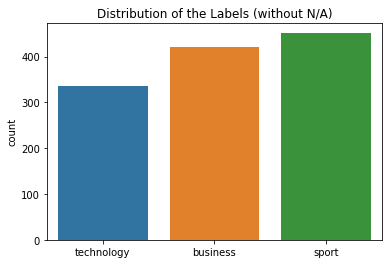

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


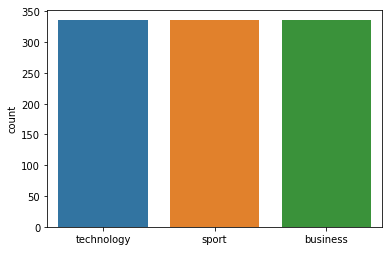



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 55
Class Distribution --> Train data (Fold 4 ):


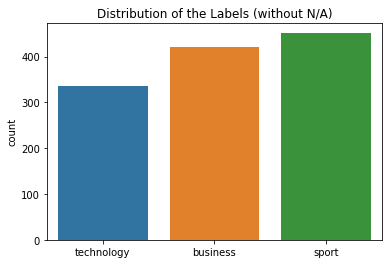

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


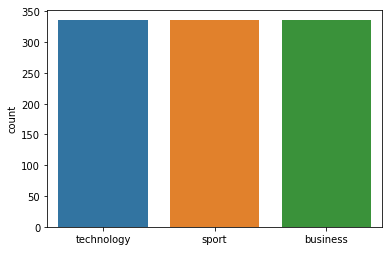



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 55
Class Distribution --> Train data (Fold 5 ):


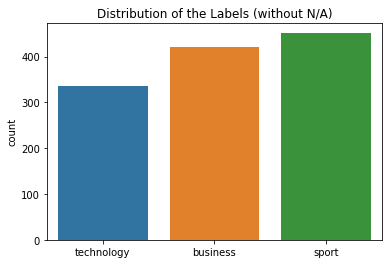

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


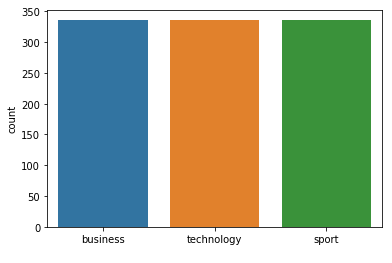



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 55
Class Distribution --> Train data (Fold 6 ):


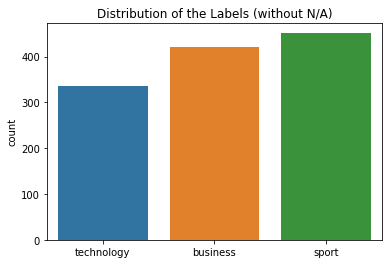

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


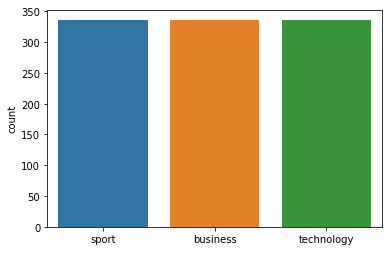



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 55
Class Distribution --> Train data (Fold 7 ):


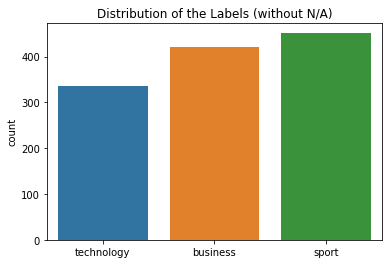

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


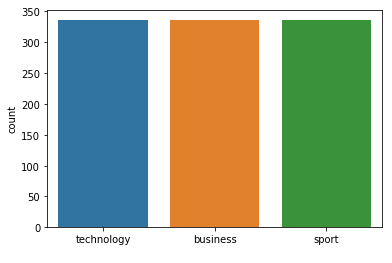



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 55  neighbours): 96.70% (+/- 1.24%)
FOLD 1 Number of neighbors 57
Class Distribution --> Train data (Fold 1 ):


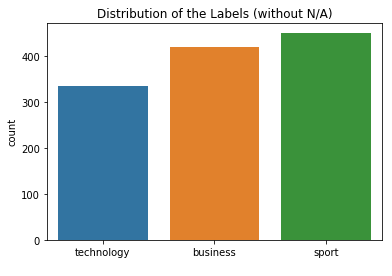

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


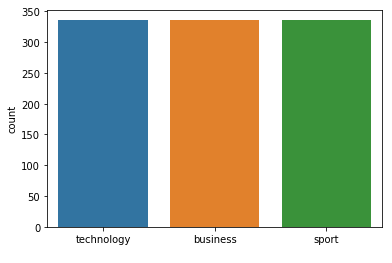



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 57
Class Distribution --> Train data (Fold 2 ):


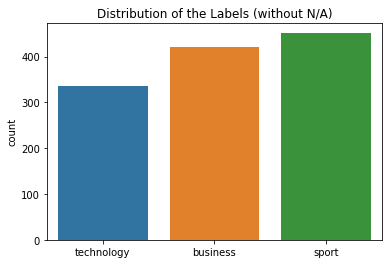

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


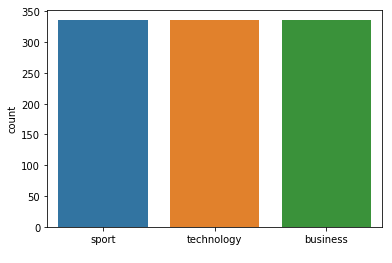



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.96      0.97        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  1  3]
 [ 2 72  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 57
Class Distribution --> Train data (Fold 3 ):


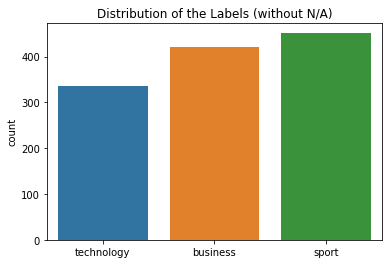

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


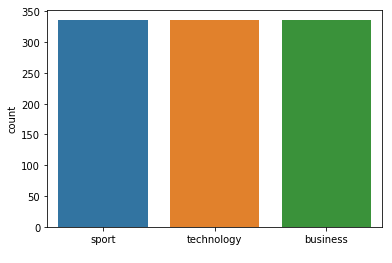



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 57
Class Distribution --> Train data (Fold 4 ):


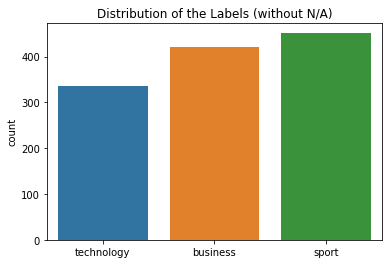

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


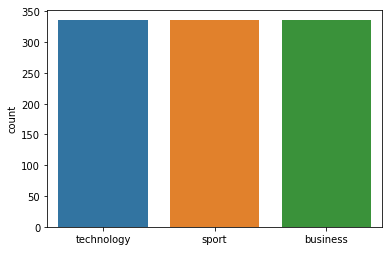



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 57
Class Distribution --> Train data (Fold 5 ):


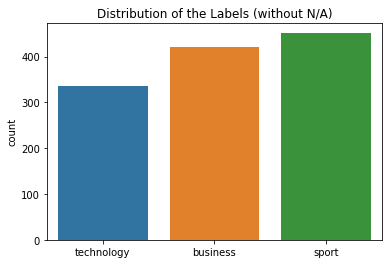

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


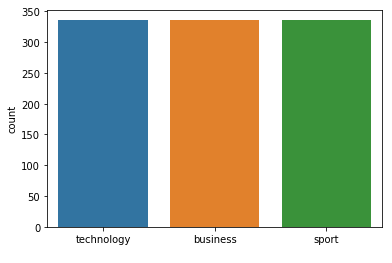



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 57
Class Distribution --> Train data (Fold 6 ):


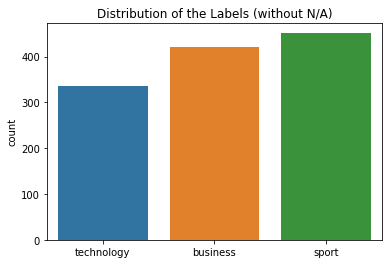

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


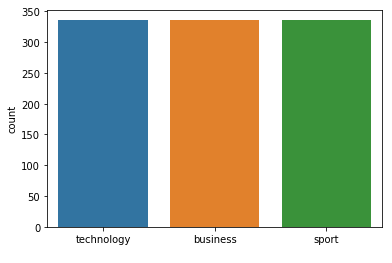



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 57
Class Distribution --> Train data (Fold 7 ):


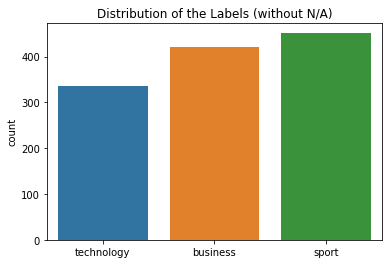

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


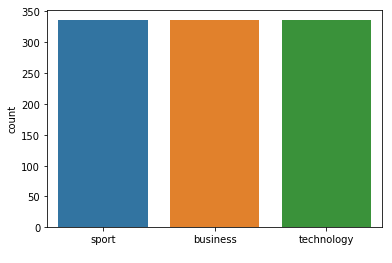



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 57  neighbours): 96.71% (+/- 1.23%)
FOLD 1 Number of neighbors 59
Class Distribution --> Train data (Fold 1 ):


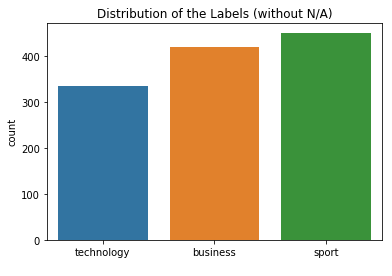

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


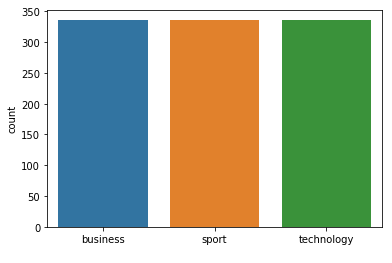



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       1.00      1.00      1.00        76
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 59
Class Distribution --> Train data (Fold 2 ):


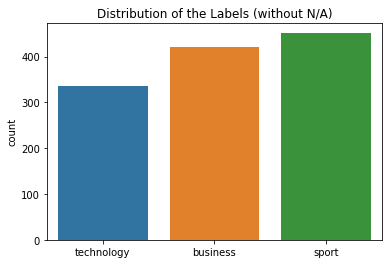

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


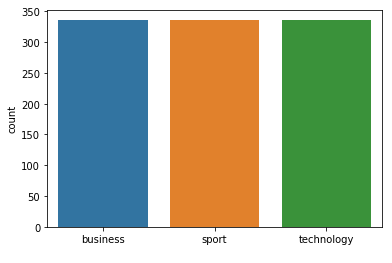



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 59
Class Distribution --> Train data (Fold 3 ):


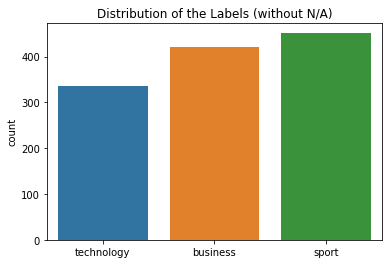

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


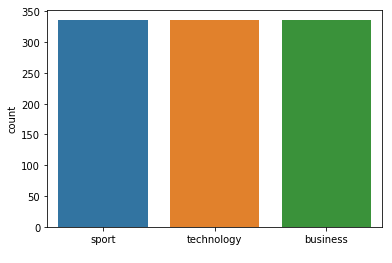



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 59
Class Distribution --> Train data (Fold 4 ):


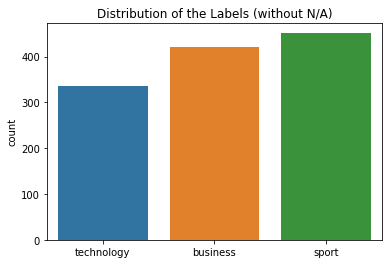

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


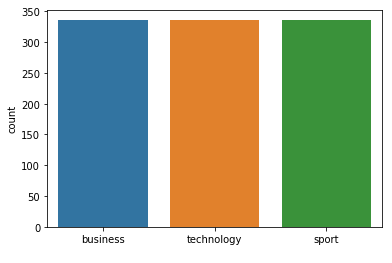



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 59
Class Distribution --> Train data (Fold 5 ):


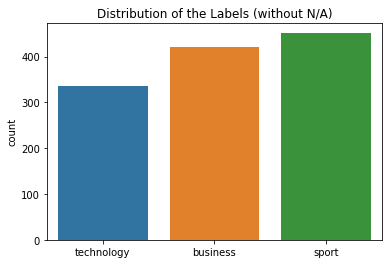

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


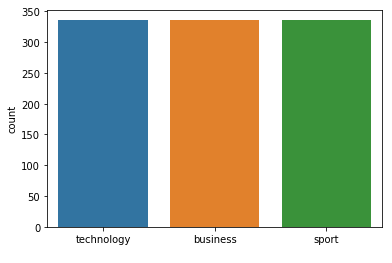



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 59
Class Distribution --> Train data (Fold 6 ):


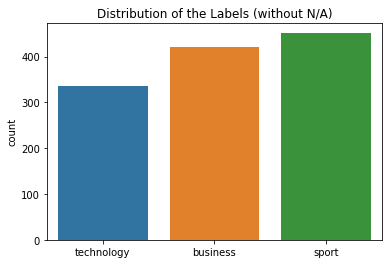

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


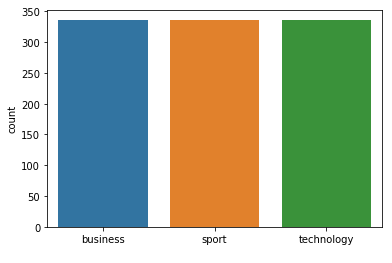



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 59
Class Distribution --> Train data (Fold 7 ):


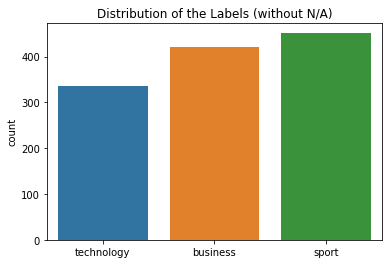

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


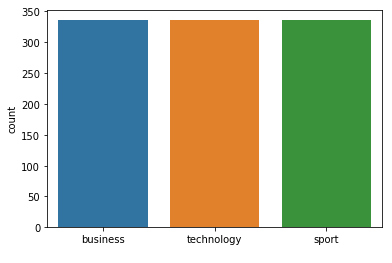



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 59  neighbours): 96.74% (+/- 1.23%)
FOLD 1 Number of neighbors 61
Class Distribution --> Train data (Fold 1 ):


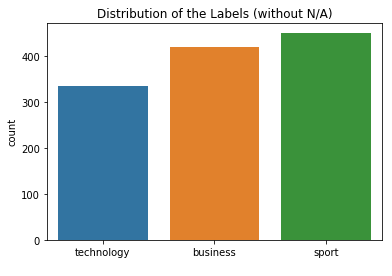

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


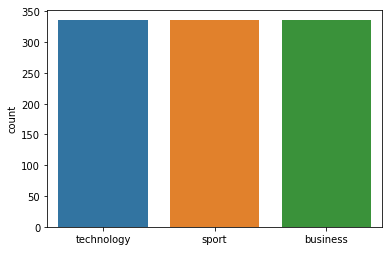



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 61
Class Distribution --> Train data (Fold 2 ):


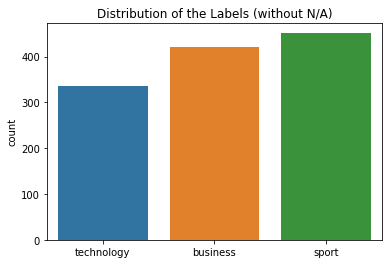

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


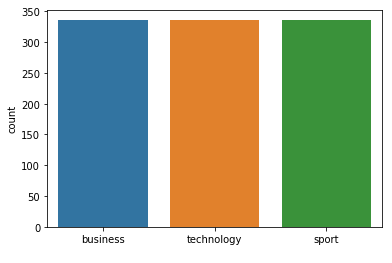



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 3 Number of neighbors 61
Class Distribution --> Train data (Fold 3 ):


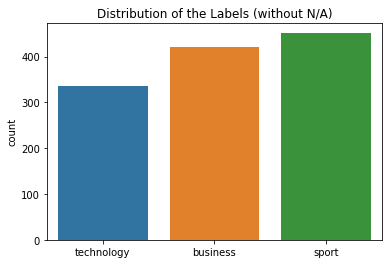

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


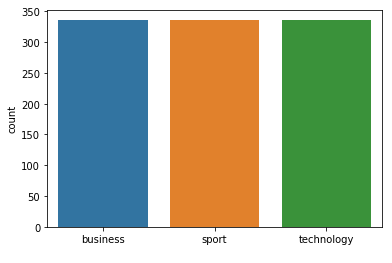



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 61
Class Distribution --> Train data (Fold 4 ):


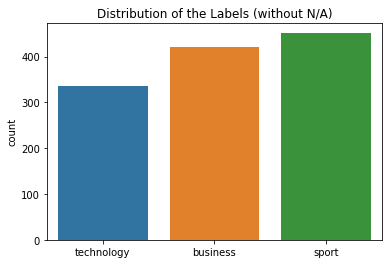

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


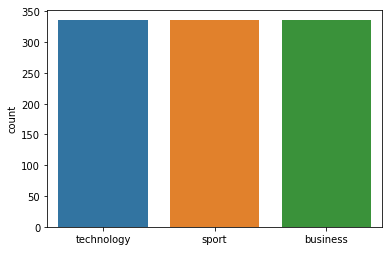



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 61
Class Distribution --> Train data (Fold 5 ):


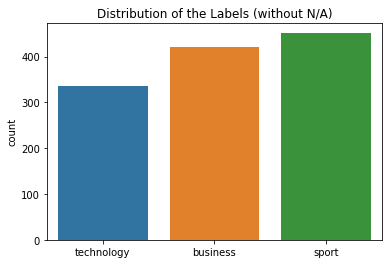

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


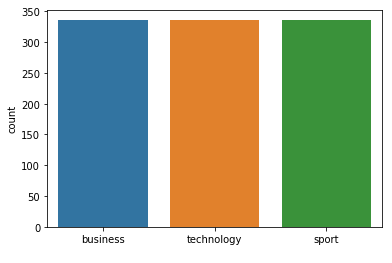



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 61
Class Distribution --> Train data (Fold 6 ):


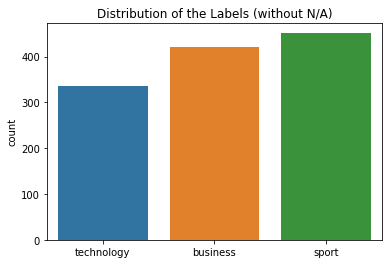

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


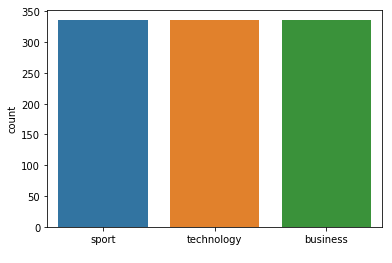



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 61
Class Distribution --> Train data (Fold 7 ):


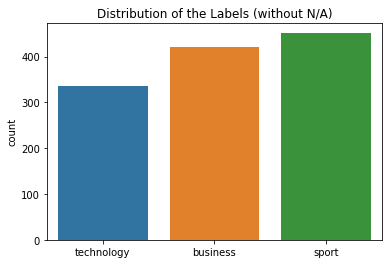

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


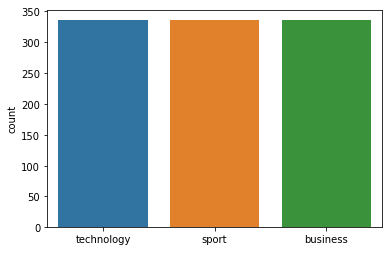



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 61  neighbours): 96.76% (+/- 1.22%)
FOLD 1 Number of neighbors 63
Class Distribution --> Train data (Fold 1 ):


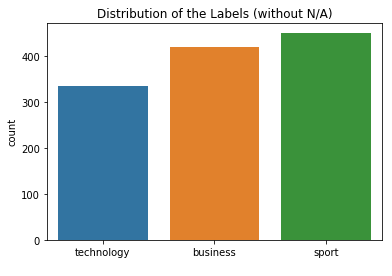

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


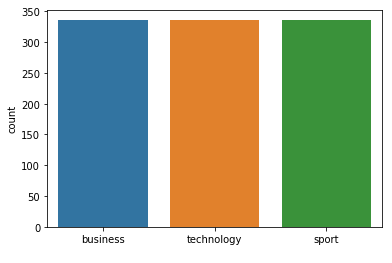



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 63
Class Distribution --> Train data (Fold 2 ):


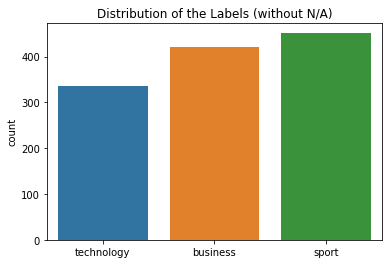

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


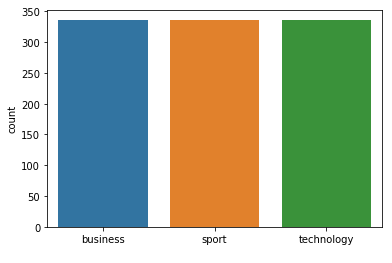



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 3 Number of neighbors 63
Class Distribution --> Train data (Fold 3 ):


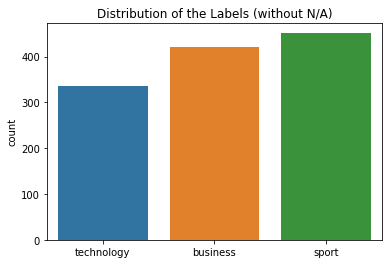

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


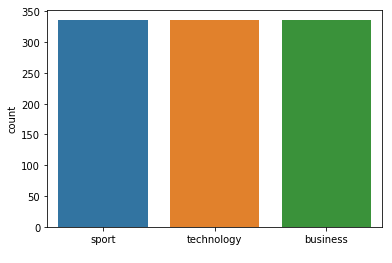



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 63
Class Distribution --> Train data (Fold 4 ):


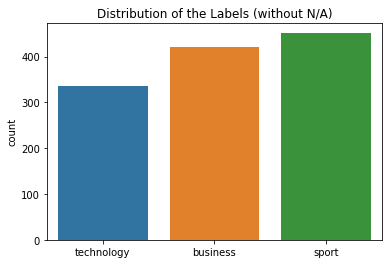

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


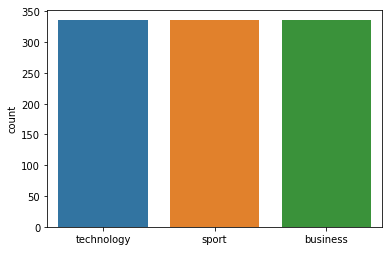



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 63
Class Distribution --> Train data (Fold 5 ):


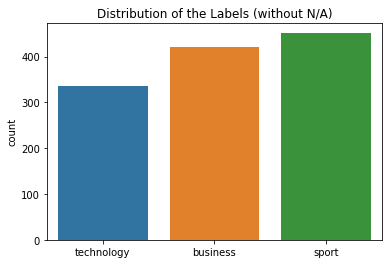

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


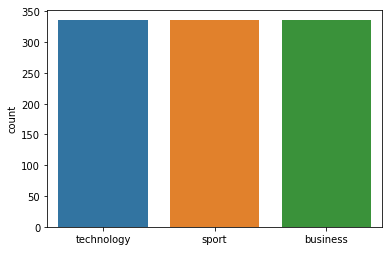



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 63
Class Distribution --> Train data (Fold 6 ):


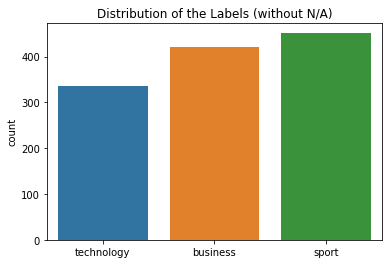

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


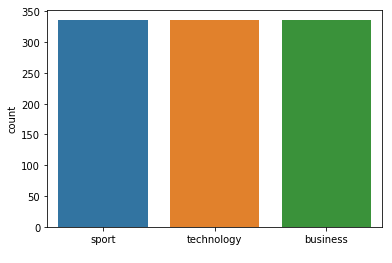



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 7 Number of neighbors 63
Class Distribution --> Train data (Fold 7 ):


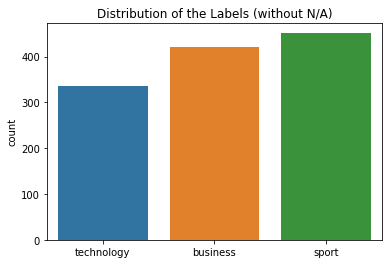

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


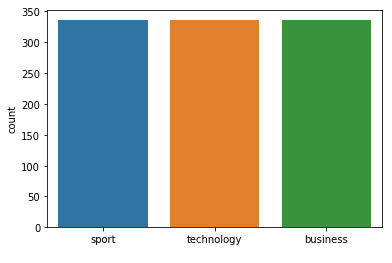



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 63  neighbours): 96.77% (+/- 1.21%)
FOLD 1 Number of neighbors 65
Class Distribution --> Train data (Fold 1 ):


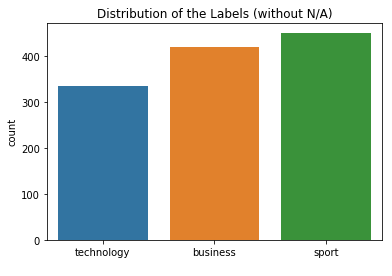

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


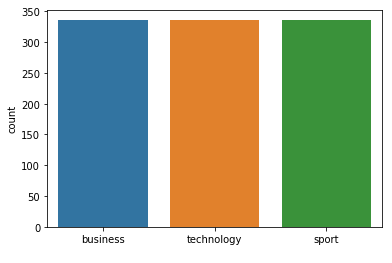



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 65
Class Distribution --> Train data (Fold 2 ):


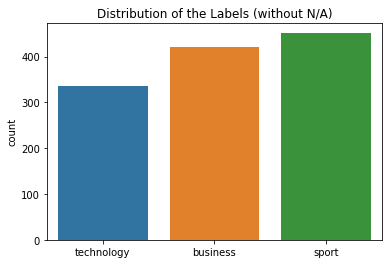

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


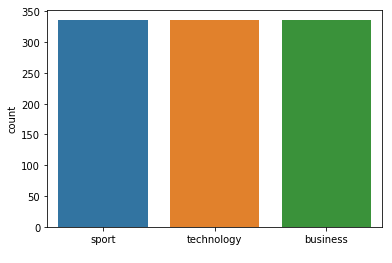



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 3 Number of neighbors 65
Class Distribution --> Train data (Fold 3 ):


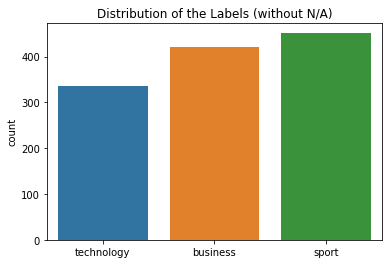

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


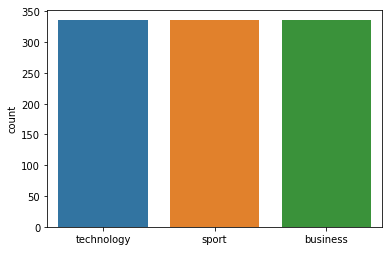



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 65
Class Distribution --> Train data (Fold 4 ):


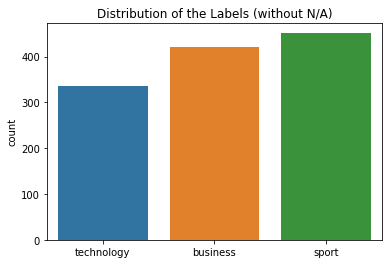

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


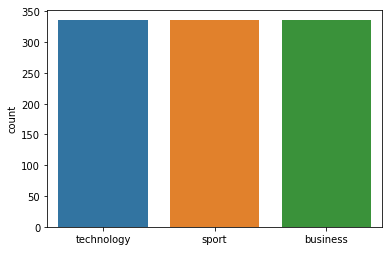



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 65
Class Distribution --> Train data (Fold 5 ):


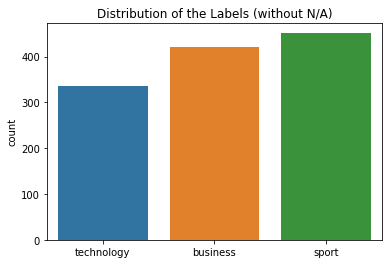

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


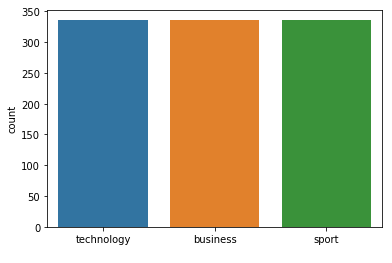



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 65
Class Distribution --> Train data (Fold 6 ):


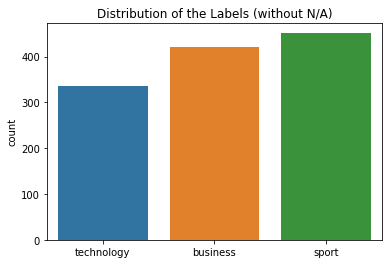

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


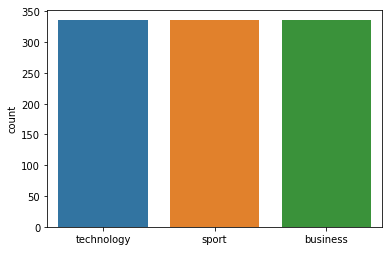



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 65
Class Distribution --> Train data (Fold 7 ):


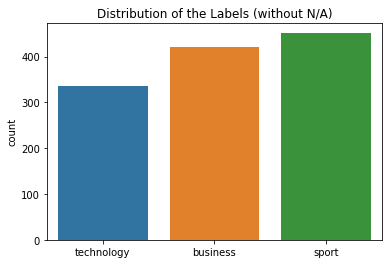

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


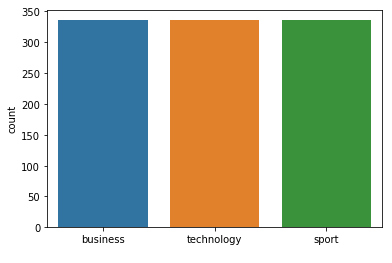



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 65  neighbours): 96.79% (+/- 1.21%)
FOLD 1 Number of neighbors 67
Class Distribution --> Train data (Fold 1 ):


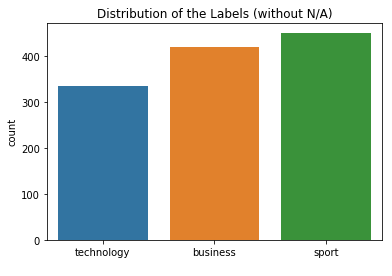

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


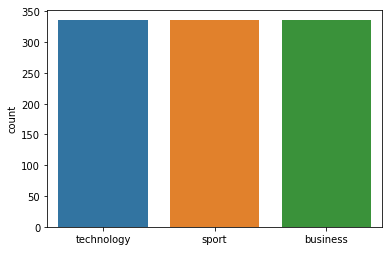



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       0.99      1.00      0.99        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 67
Class Distribution --> Train data (Fold 2 ):


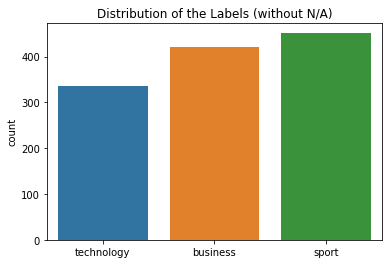

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


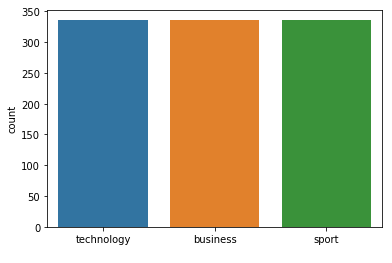



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 67
Class Distribution --> Train data (Fold 3 ):


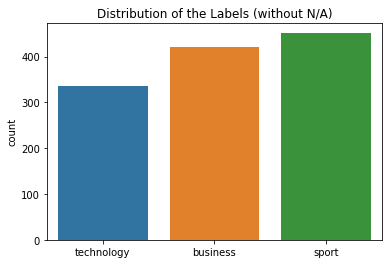

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


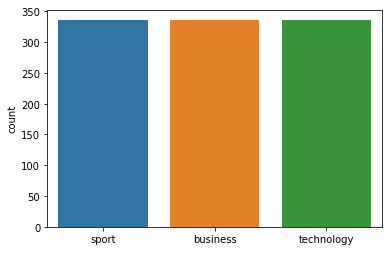



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 67
Class Distribution --> Train data (Fold 4 ):


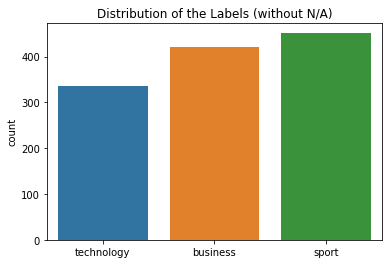

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


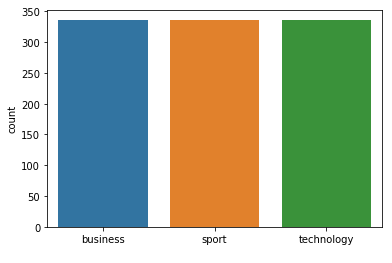



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 67
Class Distribution --> Train data (Fold 5 ):


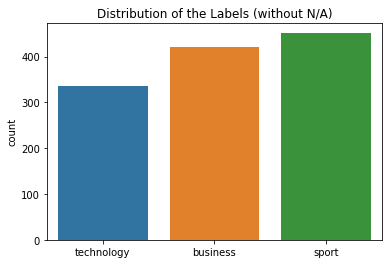

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


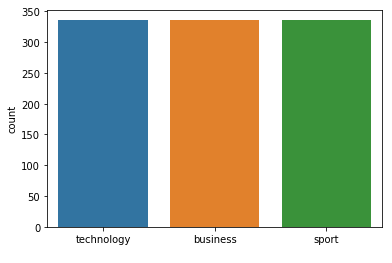



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 67
Class Distribution --> Train data (Fold 6 ):


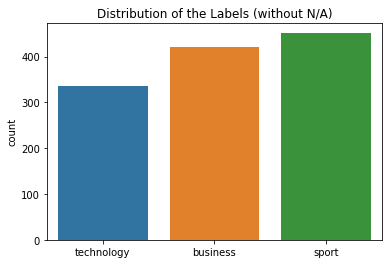

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


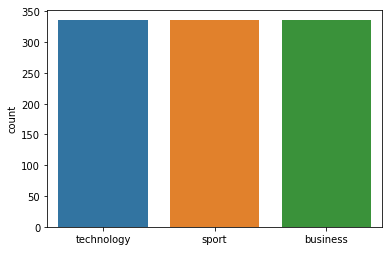



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 67
Class Distribution --> Train data (Fold 7 ):


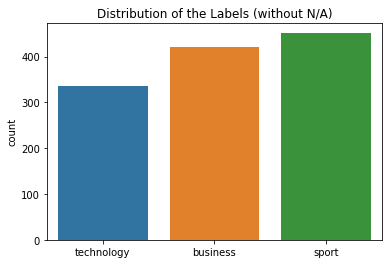

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


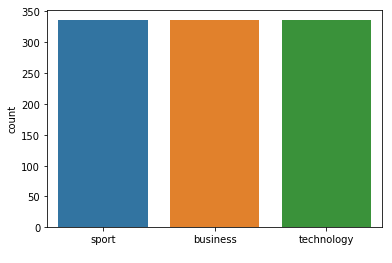



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.98      0.96        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 67  neighbours): 96.80% (+/- 1.20%)
FOLD 1 Number of neighbors 69
Class Distribution --> Train data (Fold 1 ):


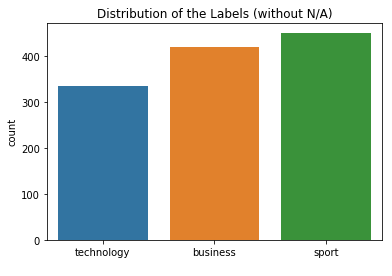

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


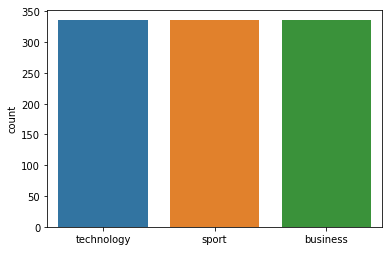



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       0.99      1.00      0.99        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 69
Class Distribution --> Train data (Fold 2 ):


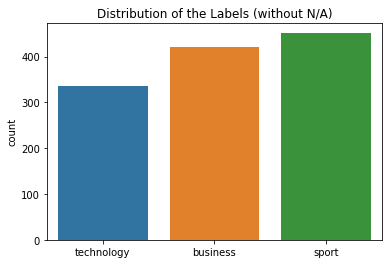

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


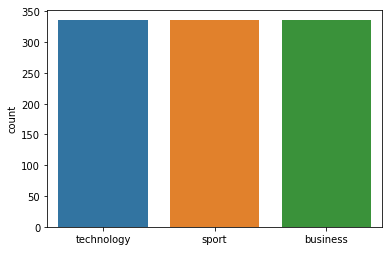



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.96      0.97        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 72  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 69
Class Distribution --> Train data (Fold 3 ):


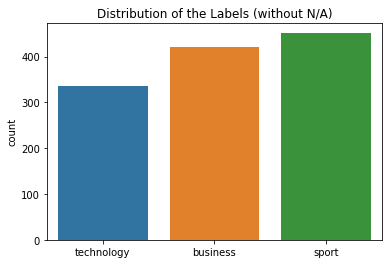

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


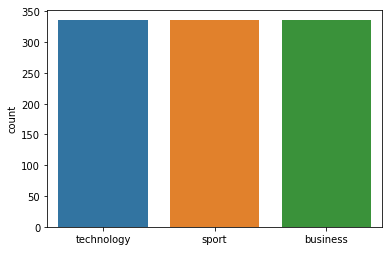



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 69
Class Distribution --> Train data (Fold 4 ):


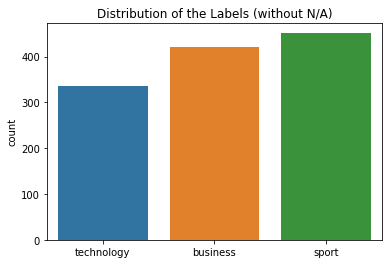

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


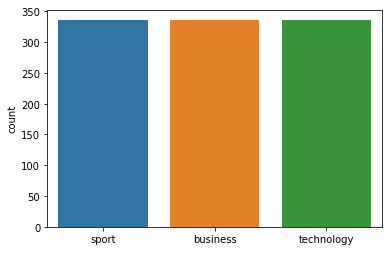



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 69
Class Distribution --> Train data (Fold 5 ):


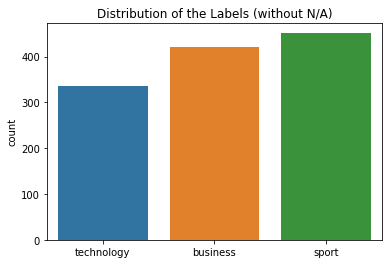

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


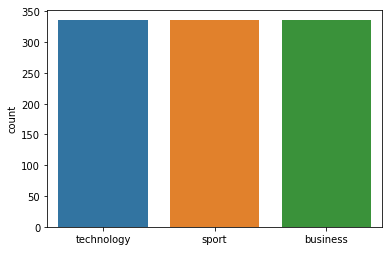



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 69
Class Distribution --> Train data (Fold 6 ):


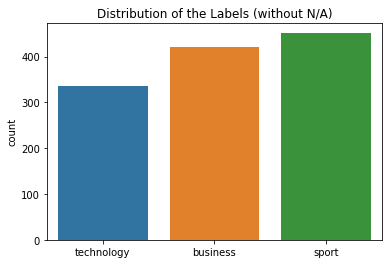

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


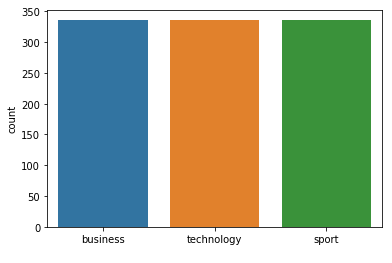



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 69
Class Distribution --> Train data (Fold 7 ):


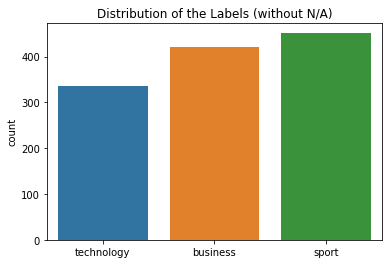

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


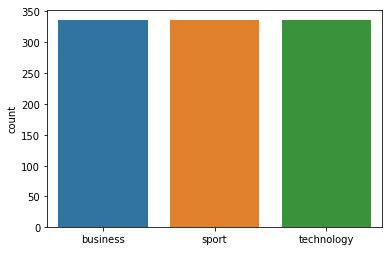



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 69  neighbours): 96.80% (+/- 1.19%)
FOLD 1 Number of neighbors 71
Class Distribution --> Train data (Fold 1 ):


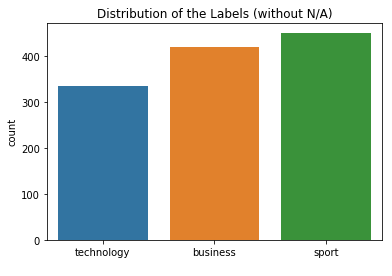

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


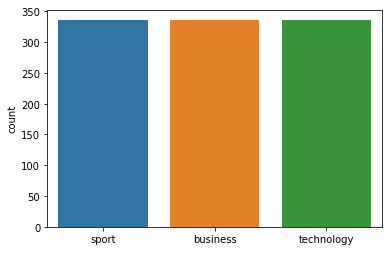



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 71
Class Distribution --> Train data (Fold 2 ):


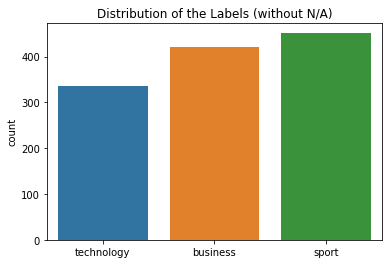

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


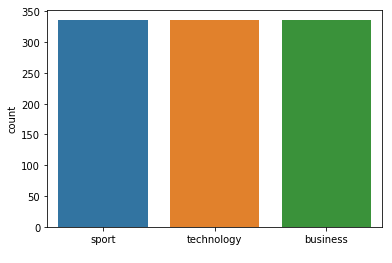



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 3 Number of neighbors 71
Class Distribution --> Train data (Fold 3 ):


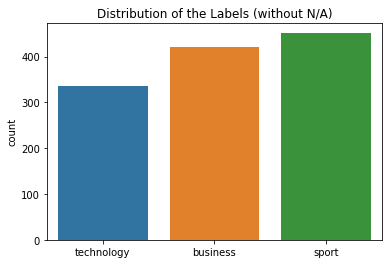

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


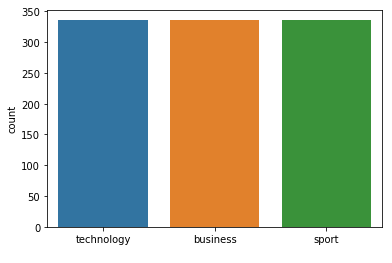



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 71
Class Distribution --> Train data (Fold 4 ):


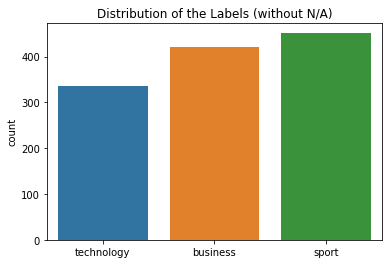

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


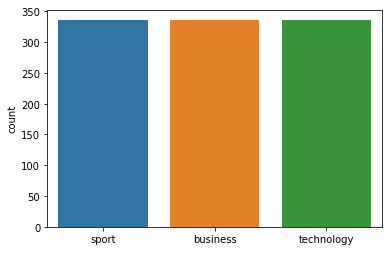



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 71
Class Distribution --> Train data (Fold 5 ):


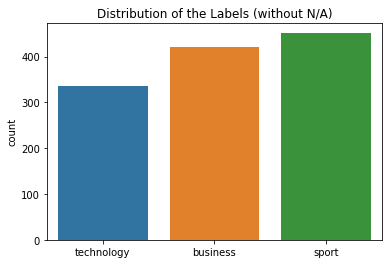

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


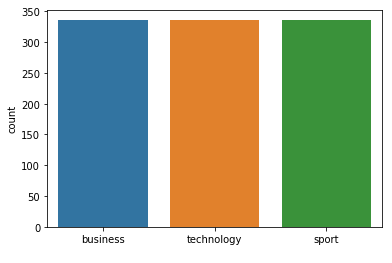



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 71
Class Distribution --> Train data (Fold 6 ):


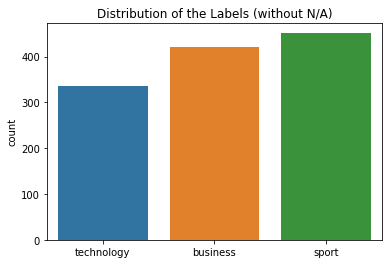

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


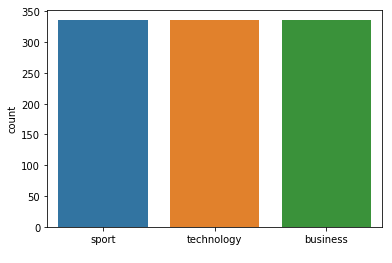



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 71
Class Distribution --> Train data (Fold 7 ):


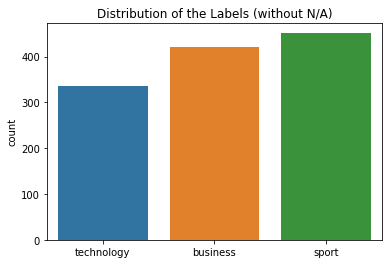

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


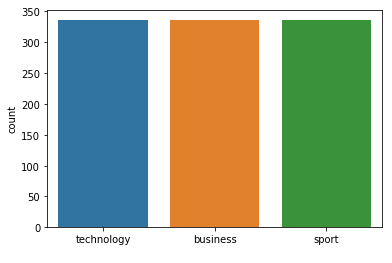



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 71  neighbours): 96.82% (+/- 1.18%)
FOLD 1 Number of neighbors 73
Class Distribution --> Train data (Fold 1 ):


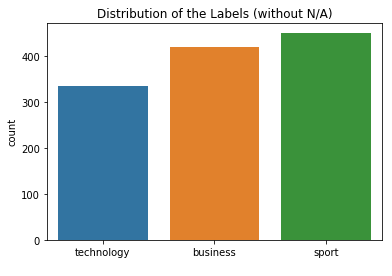

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


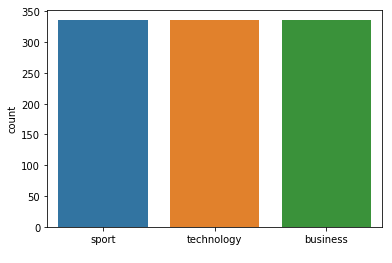



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       0.99      1.00      0.99        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 73
Class Distribution --> Train data (Fold 2 ):


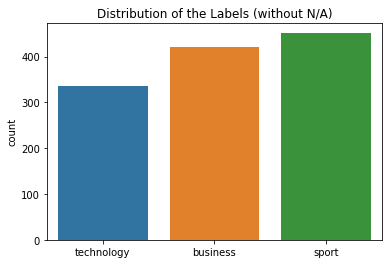

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


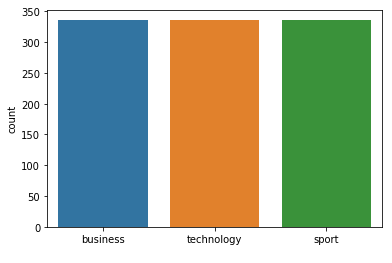



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 3 Number of neighbors 73
Class Distribution --> Train data (Fold 3 ):


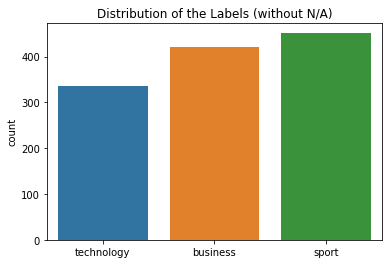

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


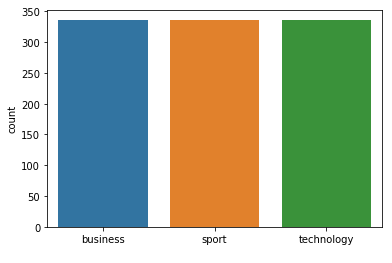



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 73
Class Distribution --> Train data (Fold 4 ):


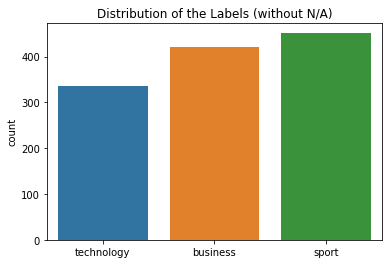

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


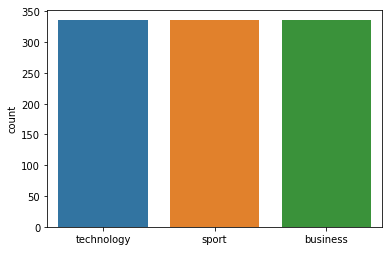



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 73
Class Distribution --> Train data (Fold 5 ):


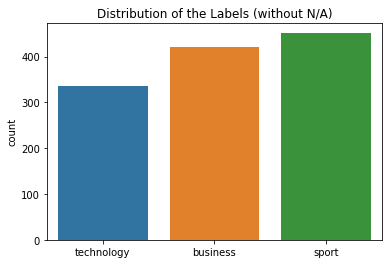

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


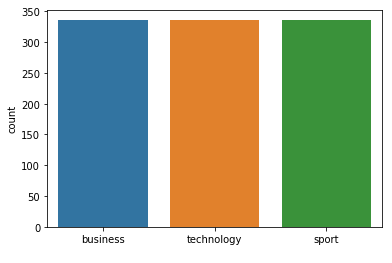



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 73
Class Distribution --> Train data (Fold 6 ):


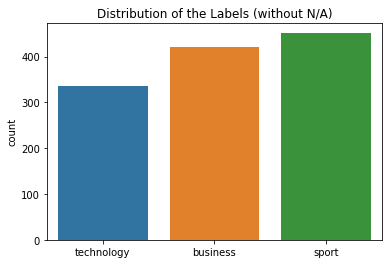

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


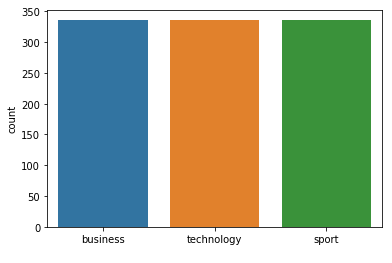



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 73
Class Distribution --> Train data (Fold 7 ):


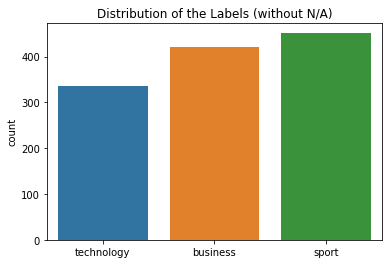

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


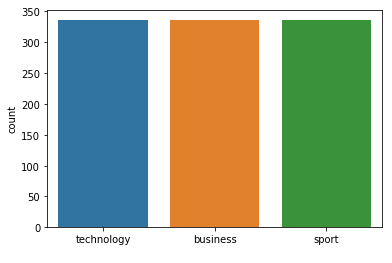



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 73  neighbours): 96.83% (+/- 1.17%)
FOLD 1 Number of neighbors 75
Class Distribution --> Train data (Fold 1 ):


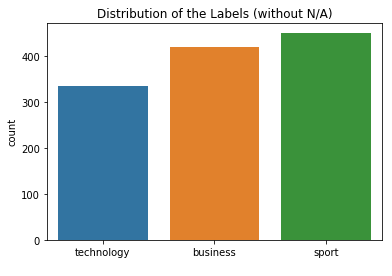

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


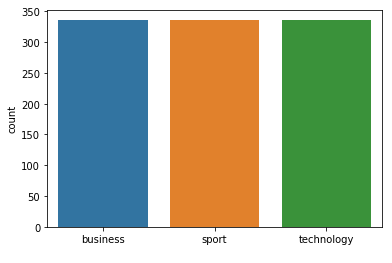



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 75
Class Distribution --> Train data (Fold 2 ):


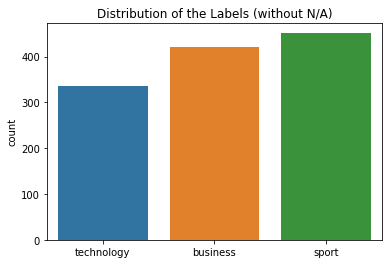

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


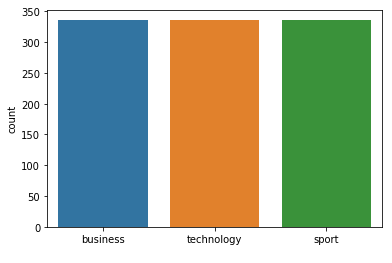



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 75
Class Distribution --> Train data (Fold 3 ):


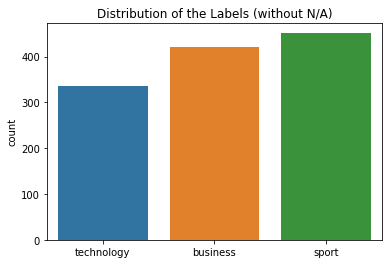

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


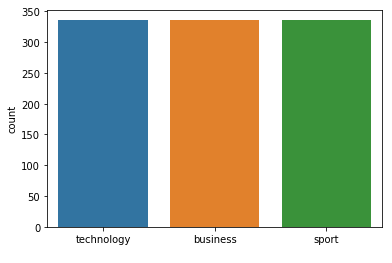



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 75
Class Distribution --> Train data (Fold 4 ):


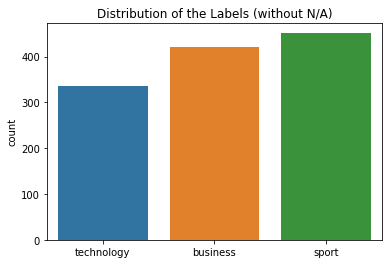

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


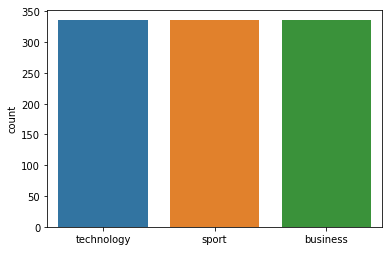



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 75
Class Distribution --> Train data (Fold 5 ):


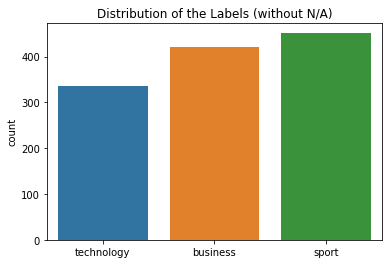

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


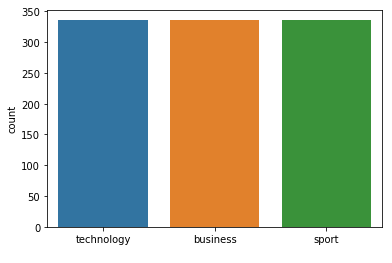



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 75
Class Distribution --> Train data (Fold 6 ):


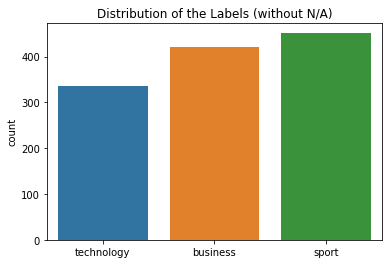

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


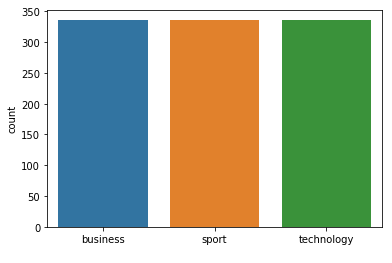



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 75
Class Distribution --> Train data (Fold 7 ):


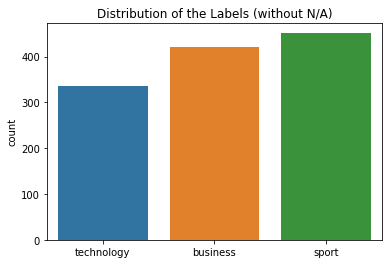

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


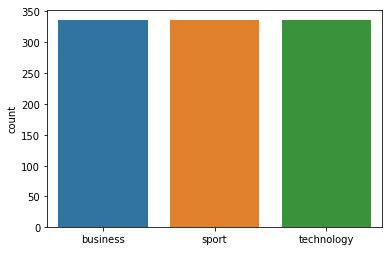



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 75  neighbours): 96.84% (+/- 1.16%)
FOLD 1 Number of neighbors 77
Class Distribution --> Train data (Fold 1 ):


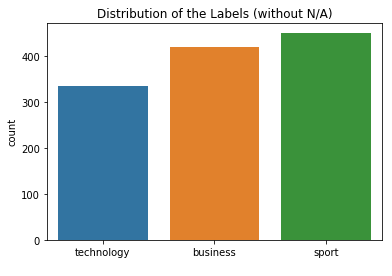

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


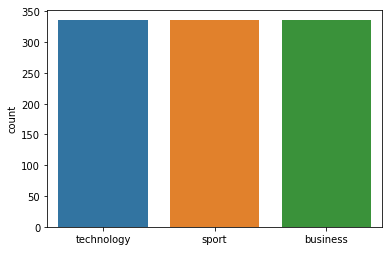



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       0.99      1.00      0.99        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 77
Class Distribution --> Train data (Fold 2 ):


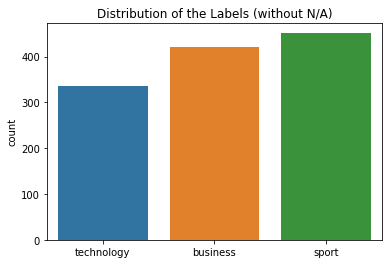

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


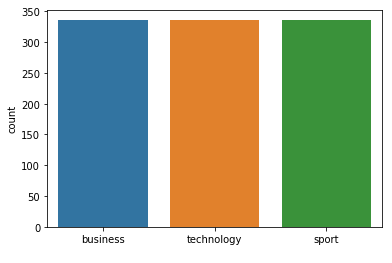



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 77
Class Distribution --> Train data (Fold 3 ):


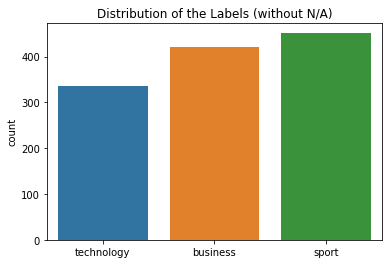

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


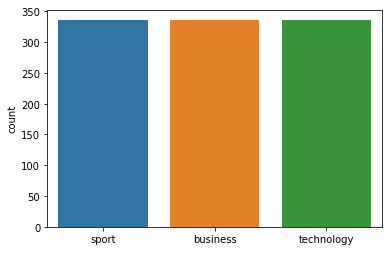



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 77
Class Distribution --> Train data (Fold 4 ):


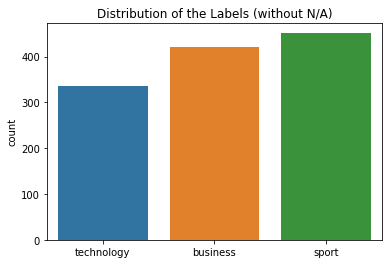

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


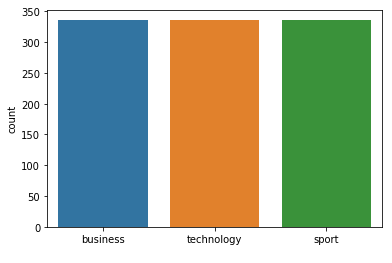



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 77
Class Distribution --> Train data (Fold 5 ):


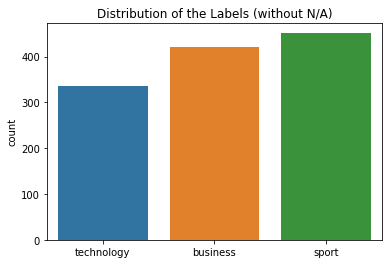

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


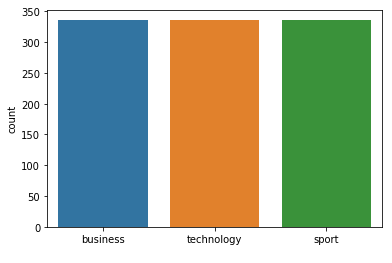



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 77
Class Distribution --> Train data (Fold 6 ):


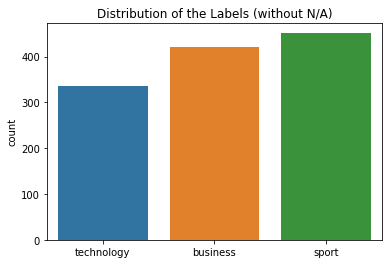

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


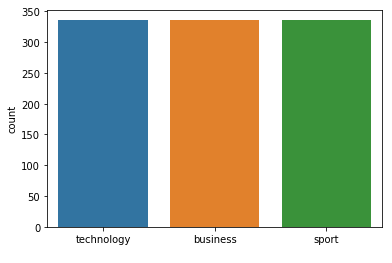



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 77
Class Distribution --> Train data (Fold 7 ):


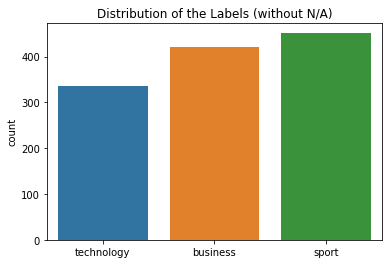

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


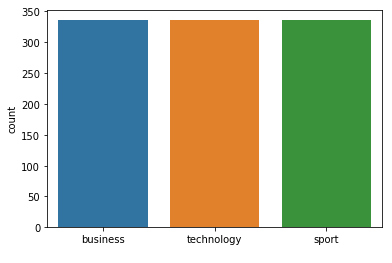



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 77  neighbours): 96.84% (+/- 1.16%)
FOLD 1 Number of neighbors 79
Class Distribution --> Train data (Fold 1 ):


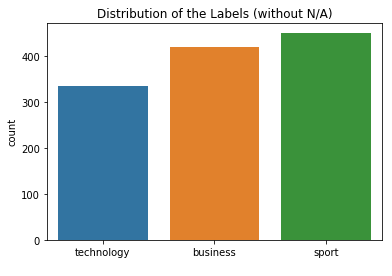

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


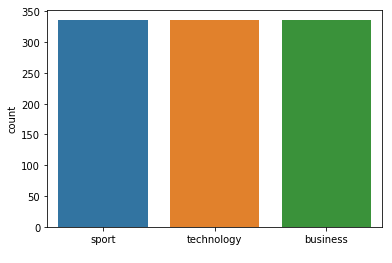



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       0.99      1.00      0.99        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 79
Class Distribution --> Train data (Fold 2 ):


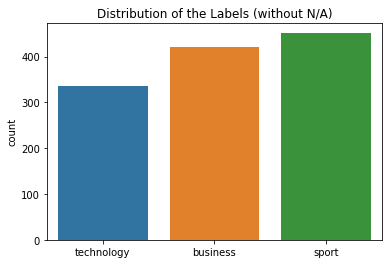

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


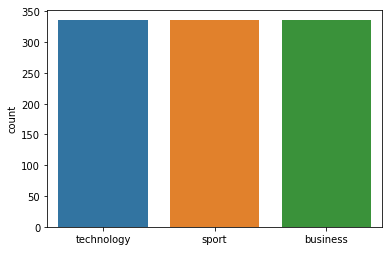



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 79
Class Distribution --> Train data (Fold 3 ):


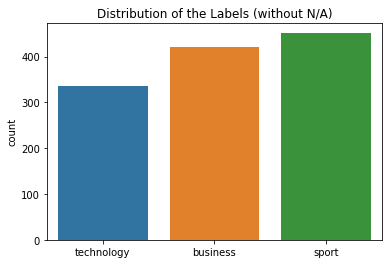

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


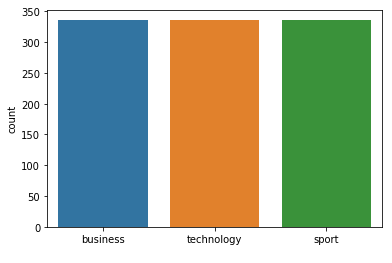



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 79
Class Distribution --> Train data (Fold 4 ):


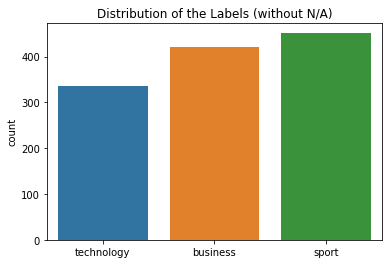

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


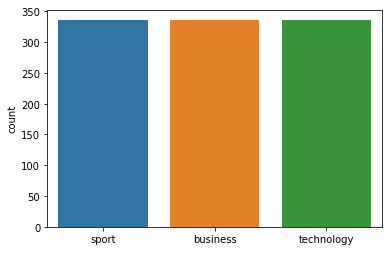



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 79
Class Distribution --> Train data (Fold 5 ):


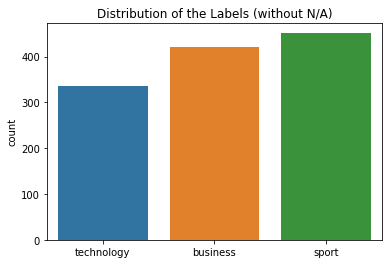

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


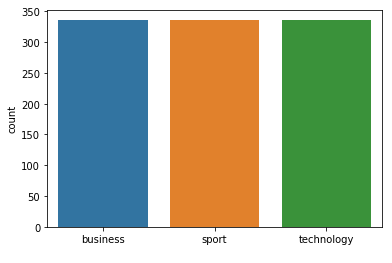



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 79
Class Distribution --> Train data (Fold 6 ):


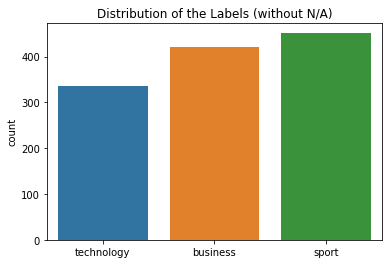

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


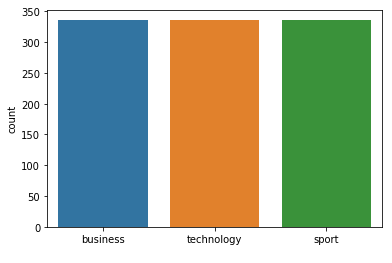



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 79
Class Distribution --> Train data (Fold 7 ):


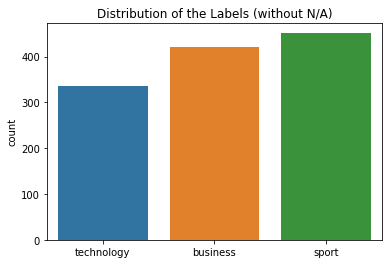

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


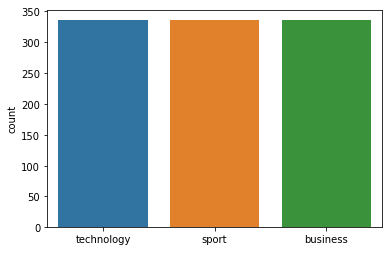



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 79  neighbours): 96.85% (+/- 1.15%)
FOLD 1 Number of neighbors 81
Class Distribution --> Train data (Fold 1 ):


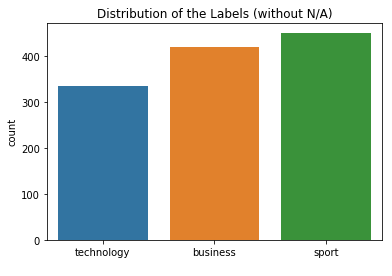

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


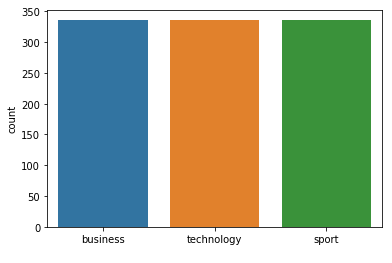



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 81
Class Distribution --> Train data (Fold 2 ):


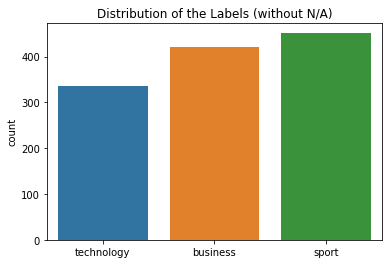

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


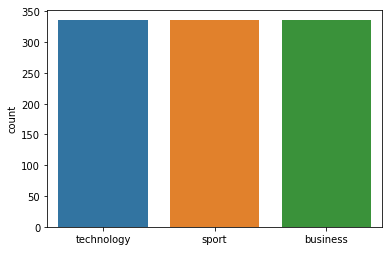



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        70
     sport
       0.95      0.95      0.95        75
technology
       0.95      0.95      0.95        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 3 71  1]
 [ 1  2 53]]
FOLD 3 Number of neighbors 81
Class Distribution --> Train data (Fold 3 ):


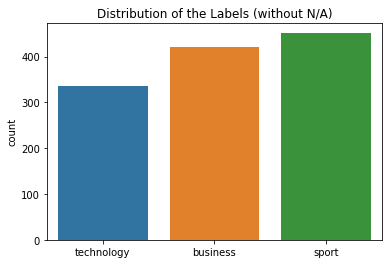

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


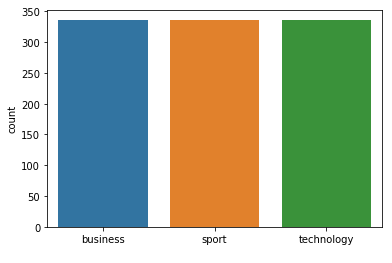



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 81
Class Distribution --> Train data (Fold 4 ):


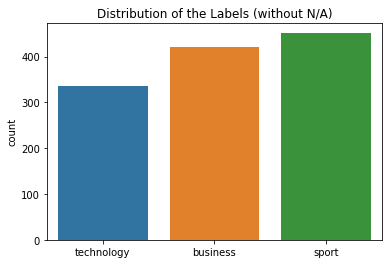

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


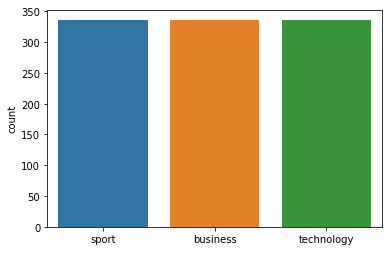



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 81
Class Distribution --> Train data (Fold 5 ):


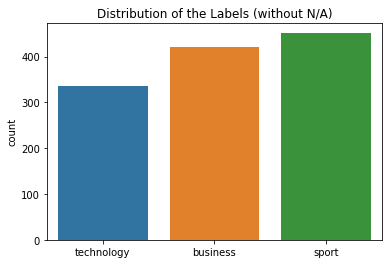

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


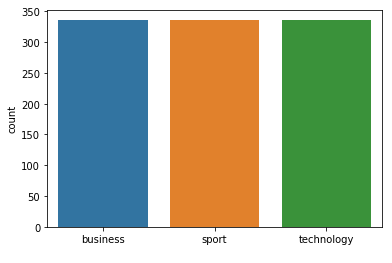



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 81
Class Distribution --> Train data (Fold 6 ):


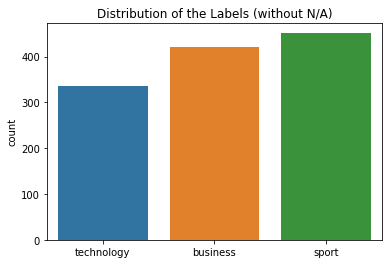

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


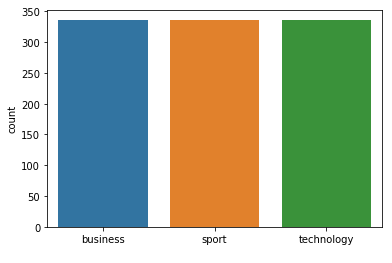



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 81
Class Distribution --> Train data (Fold 7 ):


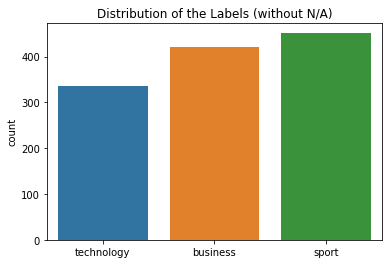

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


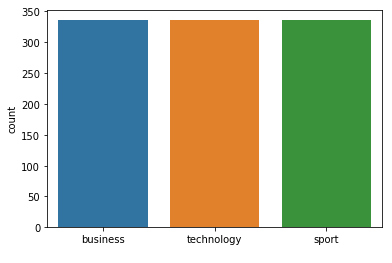



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 81  neighbours): 96.85% (+/- 1.15%)
FOLD 1 Number of neighbors 83
Class Distribution --> Train data (Fold 1 ):


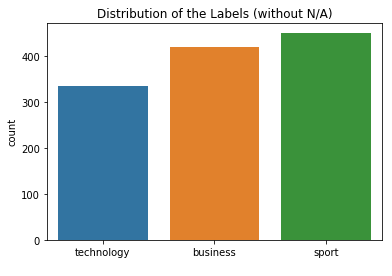

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


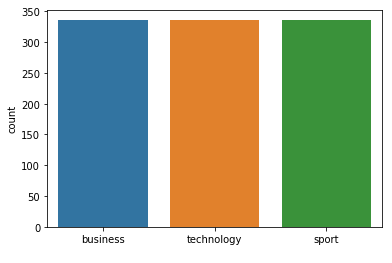



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 83
Class Distribution --> Train data (Fold 2 ):


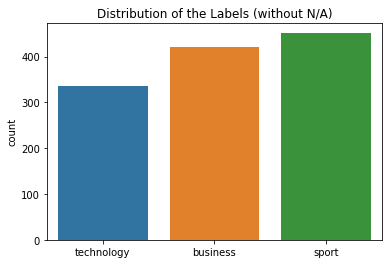

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


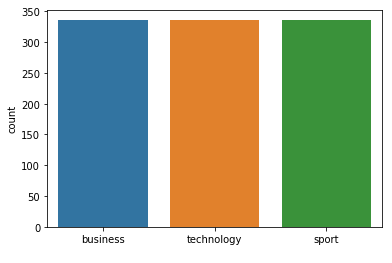



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 83
Class Distribution --> Train data (Fold 3 ):


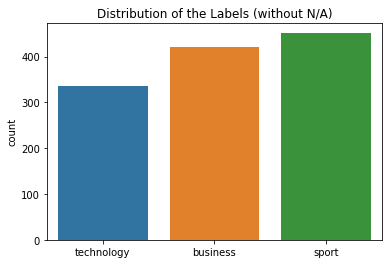

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


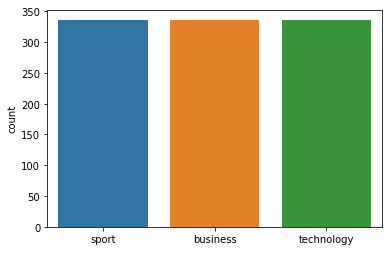



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 83
Class Distribution --> Train data (Fold 4 ):


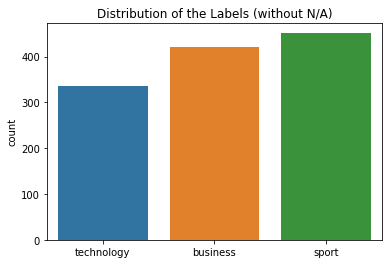

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


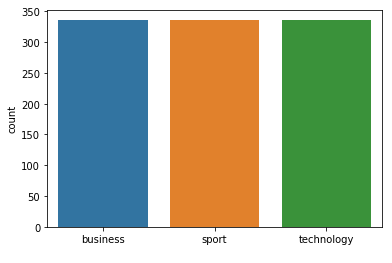



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 83
Class Distribution --> Train data (Fold 5 ):


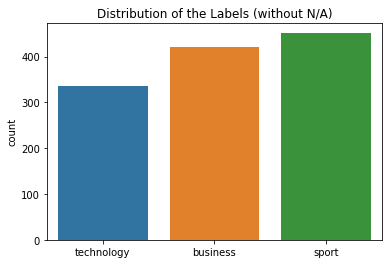

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


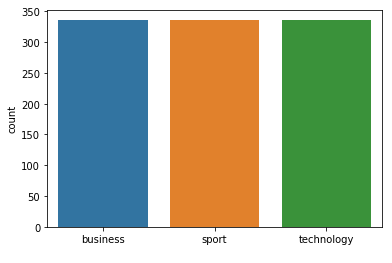



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 83
Class Distribution --> Train data (Fold 6 ):


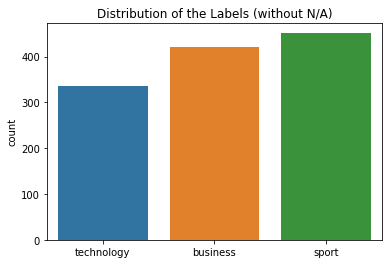

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


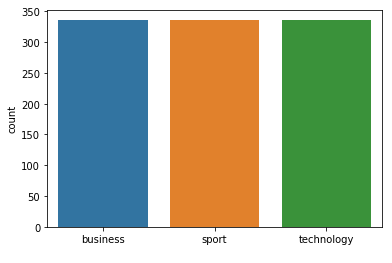



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 83
Class Distribution --> Train data (Fold 7 ):


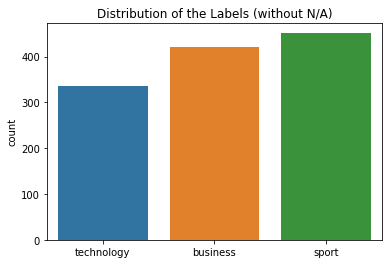

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


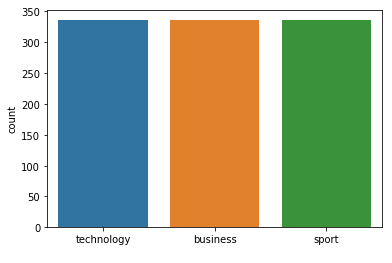



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        55

avg / total       0.98      0.97      0.98       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 83  neighbours): 96.87% (+/- 1.15%)
FOLD 1 Number of neighbors 85
Class Distribution --> Train data (Fold 1 ):


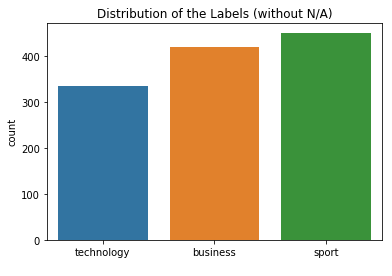

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


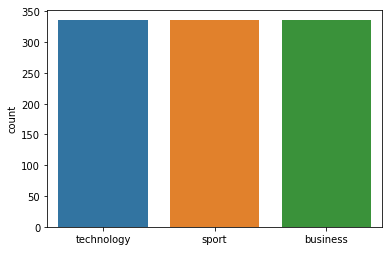



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 85
Class Distribution --> Train data (Fold 2 ):


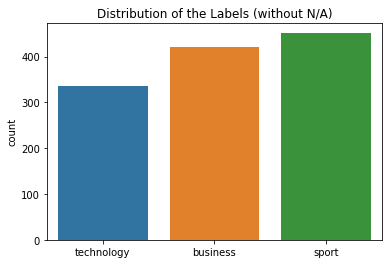

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


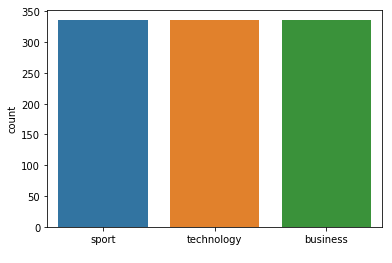



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 85
Class Distribution --> Train data (Fold 3 ):


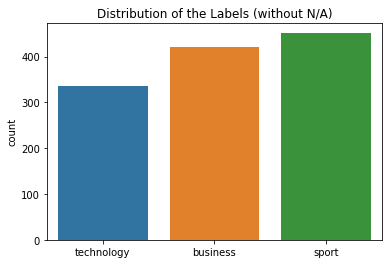

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


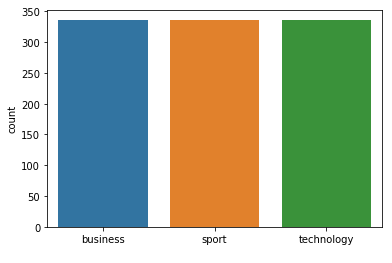



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 85
Class Distribution --> Train data (Fold 4 ):


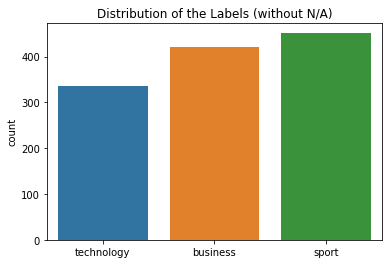

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


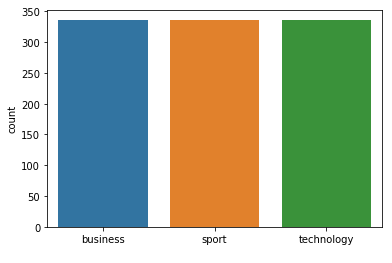



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 85
Class Distribution --> Train data (Fold 5 ):


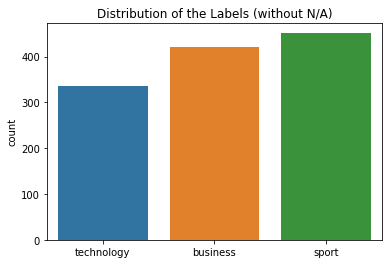

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


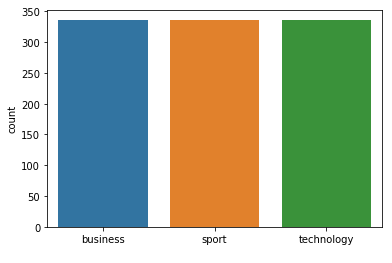



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 85
Class Distribution --> Train data (Fold 6 ):


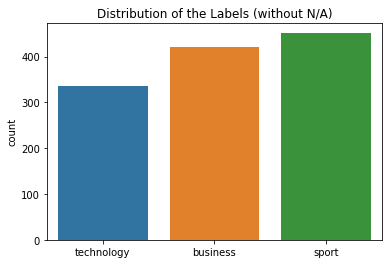

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


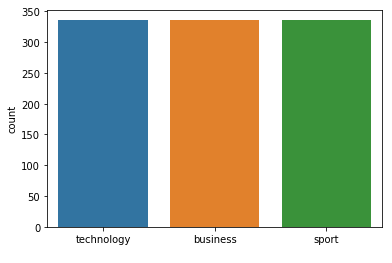



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 85
Class Distribution --> Train data (Fold 7 ):


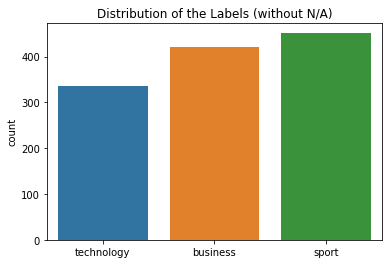

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


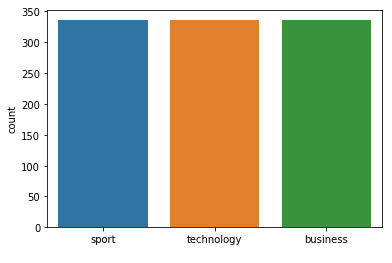



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 85  neighbours): 96.88% (+/- 1.14%)
FOLD 1 Number of neighbors 87
Class Distribution --> Train data (Fold 1 ):


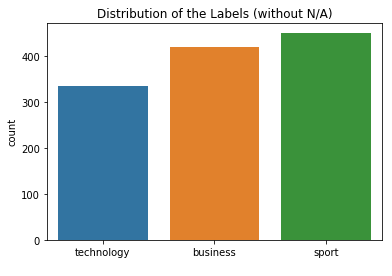

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


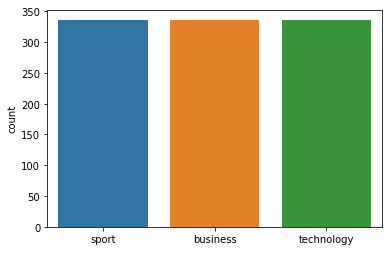



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 87
Class Distribution --> Train data (Fold 2 ):


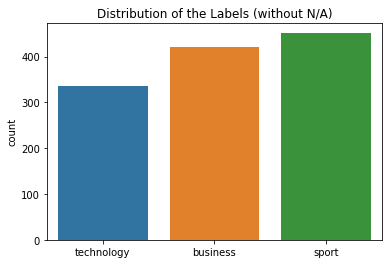

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


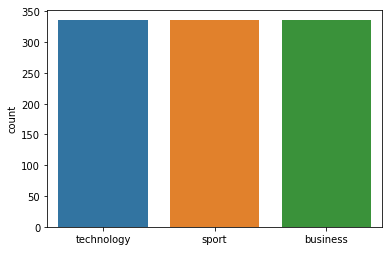



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 3 Number of neighbors 87
Class Distribution --> Train data (Fold 3 ):


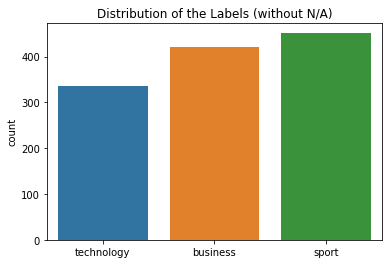

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


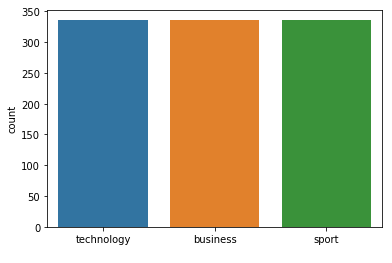



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 87
Class Distribution --> Train data (Fold 4 ):


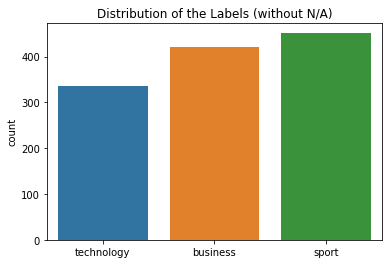

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


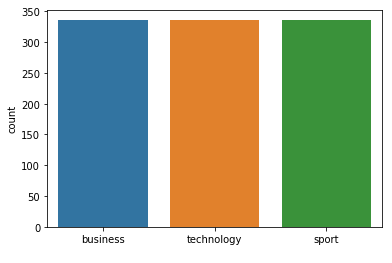



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 87
Class Distribution --> Train data (Fold 5 ):


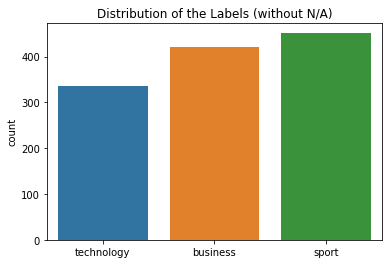

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


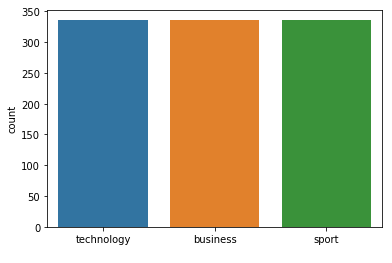



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 87
Class Distribution --> Train data (Fold 6 ):


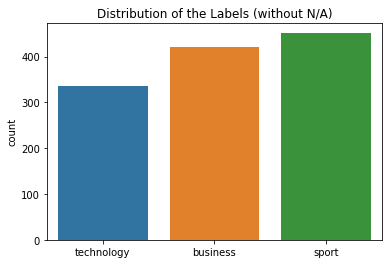

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


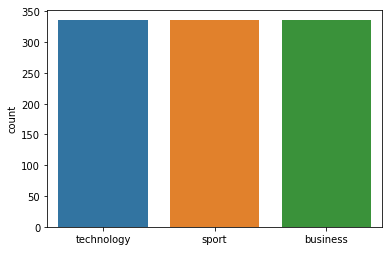



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 87
Class Distribution --> Train data (Fold 7 ):


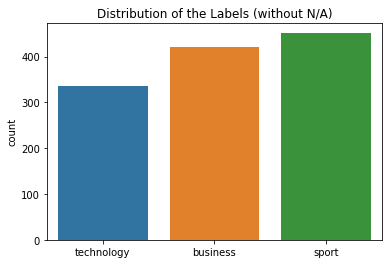

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


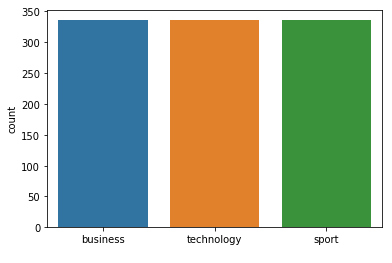



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.98      0.96        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 87  neighbours): 96.88% (+/- 1.14%)
FOLD 1 Number of neighbors 89
Class Distribution --> Train data (Fold 1 ):


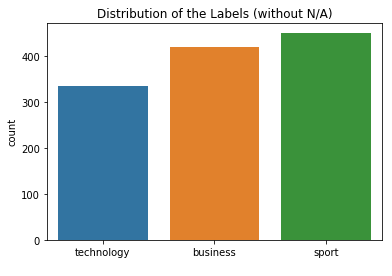

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


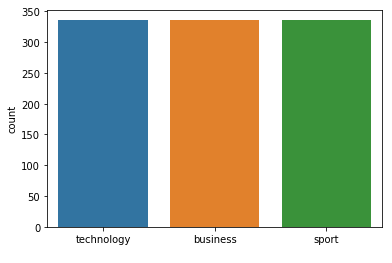



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 89
Class Distribution --> Train data (Fold 2 ):


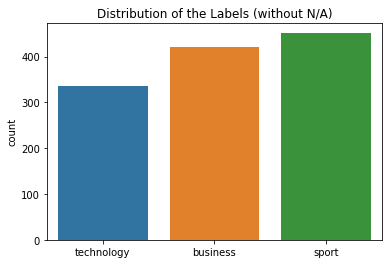

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


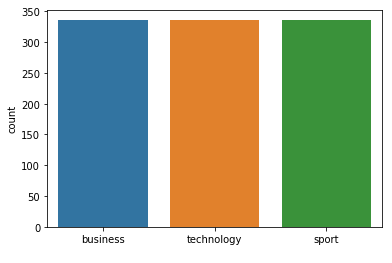



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 3 Number of neighbors 89
Class Distribution --> Train data (Fold 3 ):


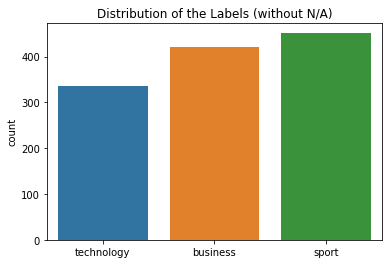

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


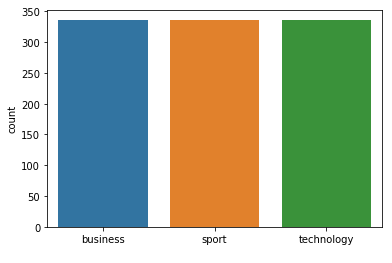



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 89
Class Distribution --> Train data (Fold 4 ):


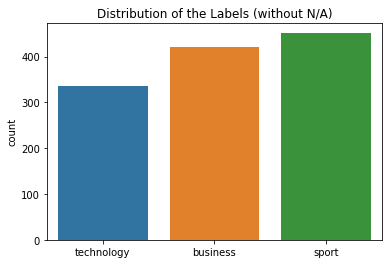

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


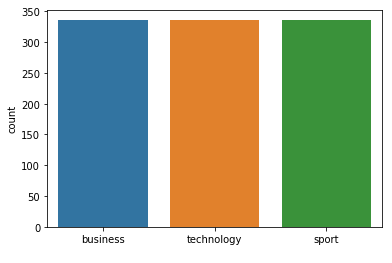



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 89
Class Distribution --> Train data (Fold 5 ):


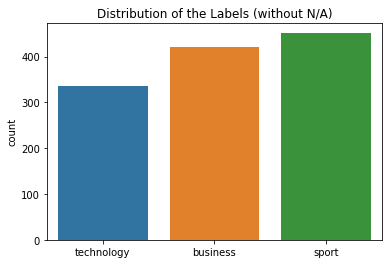

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


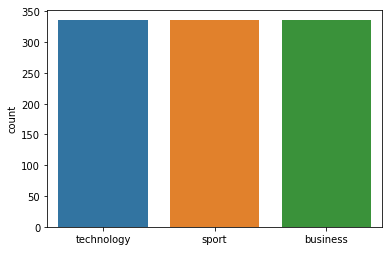



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 89
Class Distribution --> Train data (Fold 6 ):


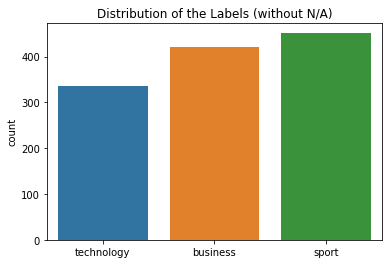

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


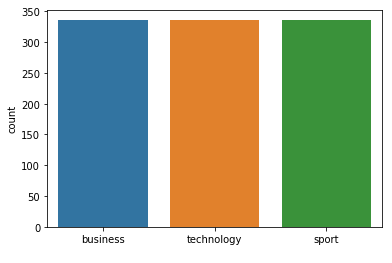



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.91      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 89
Class Distribution --> Train data (Fold 7 ):


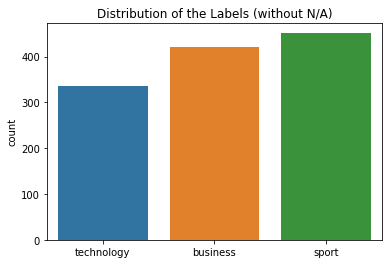

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


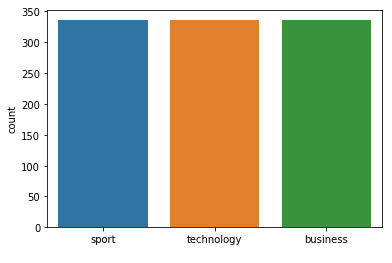



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 89  neighbours): 96.89% (+/- 1.13%)
FOLD 1 Number of neighbors 91
Class Distribution --> Train data (Fold 1 ):


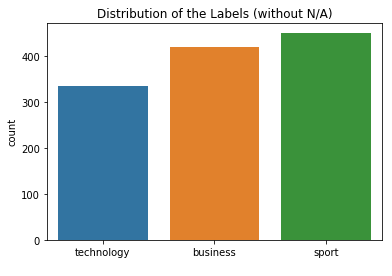

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


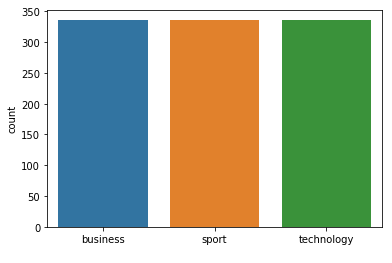



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       0.99      1.00      0.99        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 91
Class Distribution --> Train data (Fold 2 ):


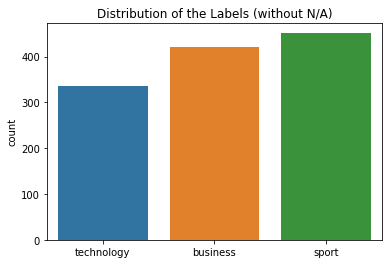

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


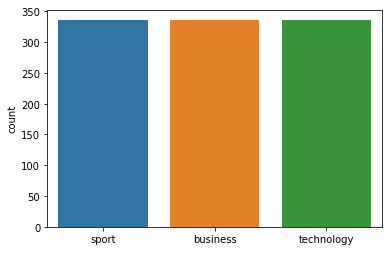



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  1 54]]
FOLD 3 Number of neighbors 91
Class Distribution --> Train data (Fold 3 ):


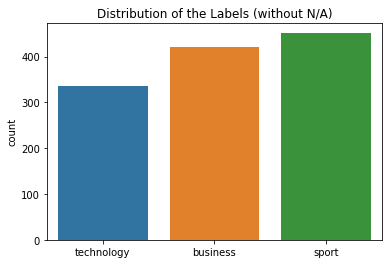

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


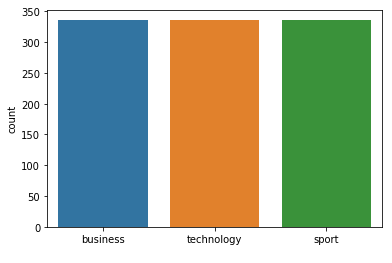



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 91
Class Distribution --> Train data (Fold 4 ):


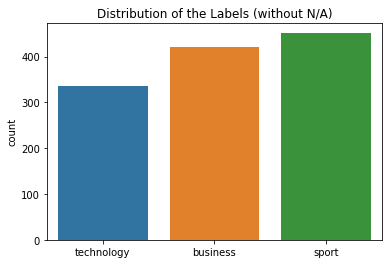

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


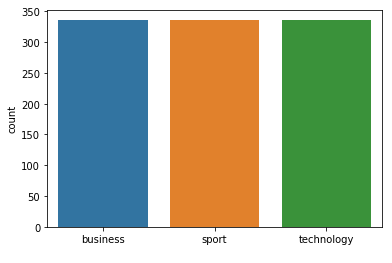



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 91
Class Distribution --> Train data (Fold 5 ):


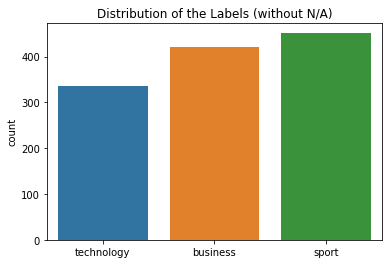

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


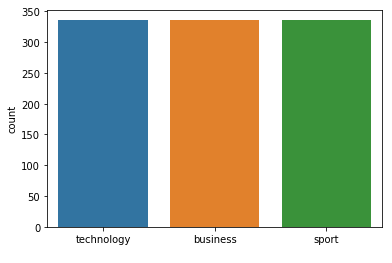



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 91
Class Distribution --> Train data (Fold 6 ):


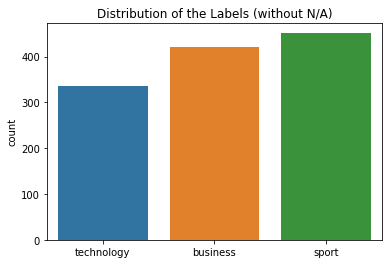

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


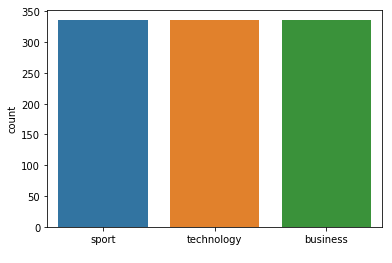



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 91
Class Distribution --> Train data (Fold 7 ):


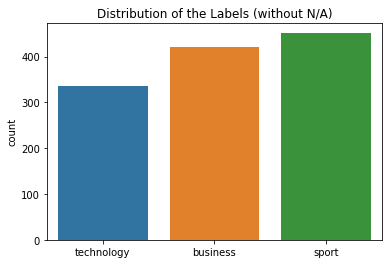

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


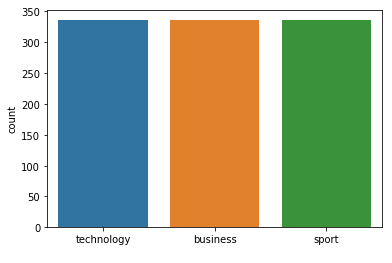



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.98      0.96        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 91  neighbours): 96.90% (+/- 1.13%)
FOLD 1 Number of neighbors 93
Class Distribution --> Train data (Fold 1 ):


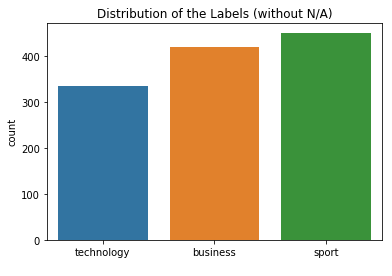

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


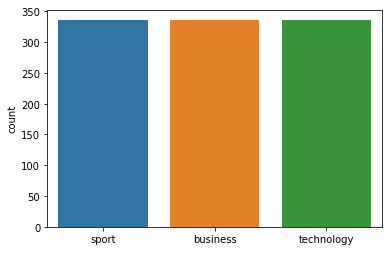



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 93
Class Distribution --> Train data (Fold 2 ):


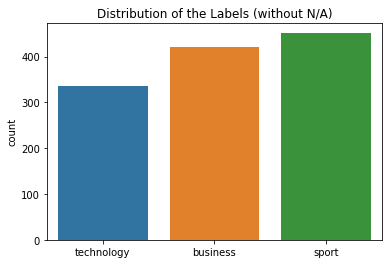

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


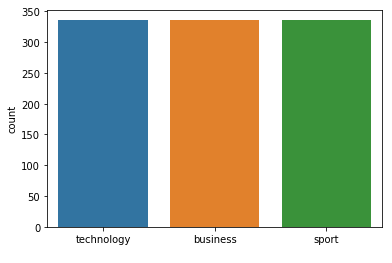



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 3 72  0]
 [ 1  1 54]]
FOLD 3 Number of neighbors 93
Class Distribution --> Train data (Fold 3 ):


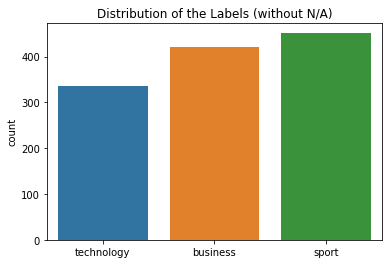

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


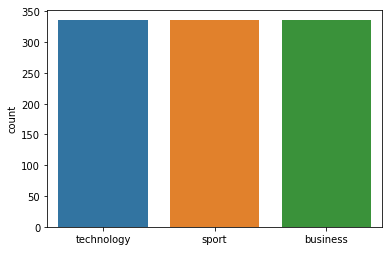



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 93
Class Distribution --> Train data (Fold 4 ):


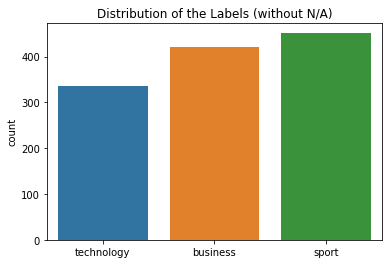

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


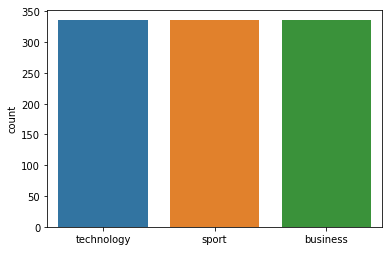



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 93
Class Distribution --> Train data (Fold 5 ):


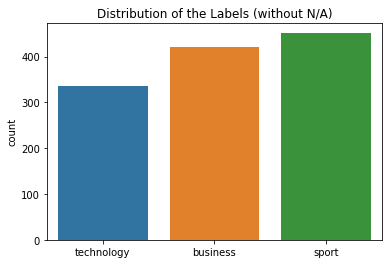

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


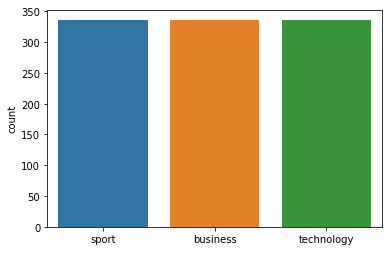



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 93
Class Distribution --> Train data (Fold 6 ):


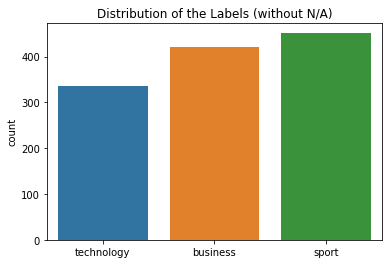

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


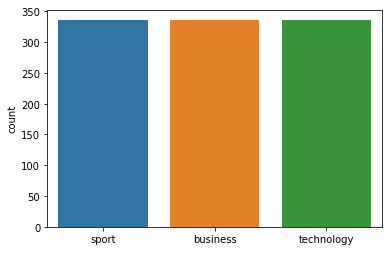



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 93
Class Distribution --> Train data (Fold 7 ):


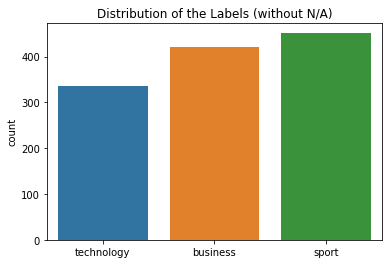

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


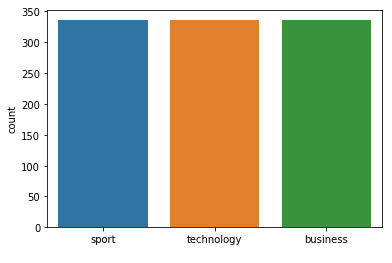



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 93  neighbours): 96.91% (+/- 1.13%)
FOLD 1 Number of neighbors 95
Class Distribution --> Train data (Fold 1 ):


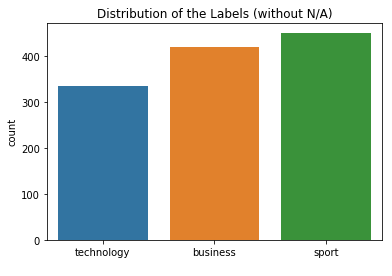

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


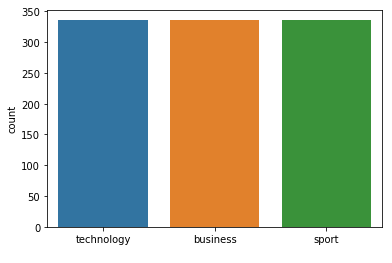



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 95
Class Distribution --> Train data (Fold 2 ):


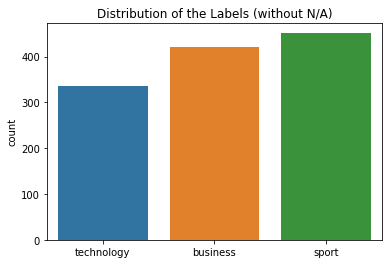

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


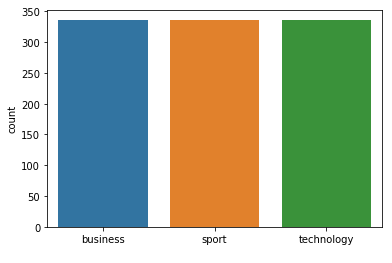



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 95
Class Distribution --> Train data (Fold 3 ):


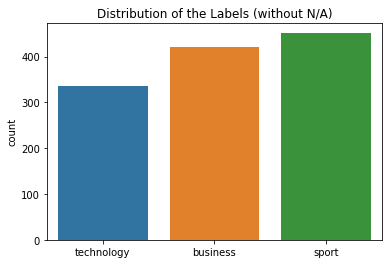

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


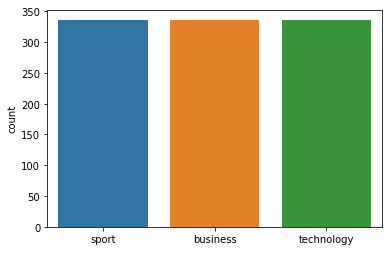



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 95
Class Distribution --> Train data (Fold 4 ):


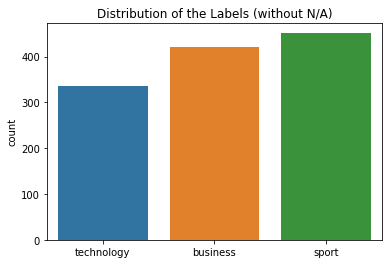

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


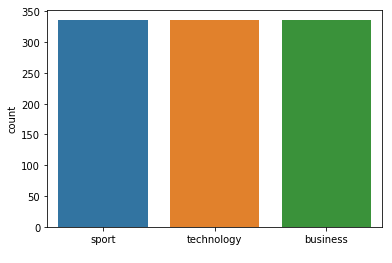



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 95
Class Distribution --> Train data (Fold 5 ):


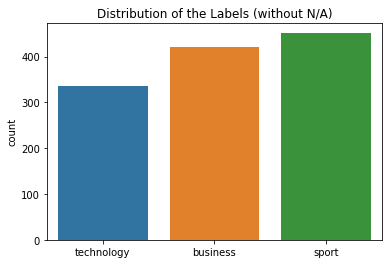

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


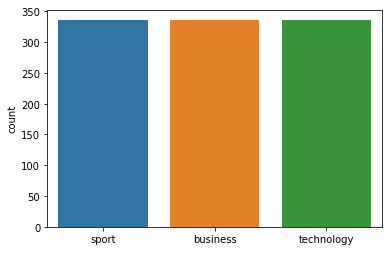



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 95
Class Distribution --> Train data (Fold 6 ):


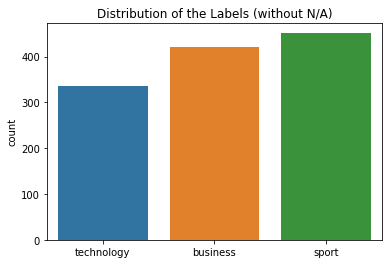

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


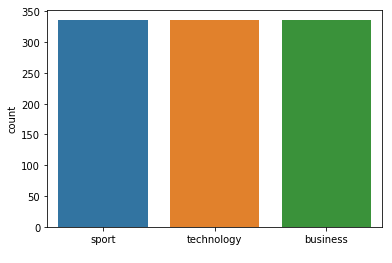



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 95
Class Distribution --> Train data (Fold 7 ):


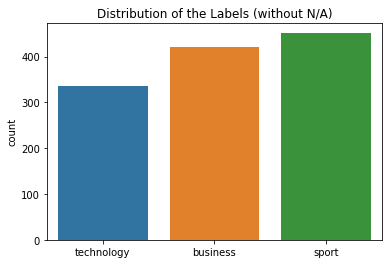

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


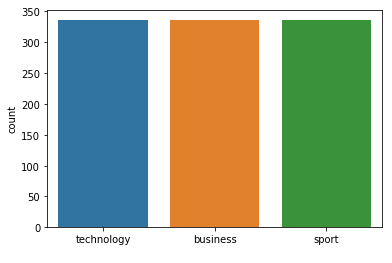



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 95  neighbours): 96.91% (+/- 1.12%)
FOLD 1 Number of neighbors 97
Class Distribution --> Train data (Fold 1 ):


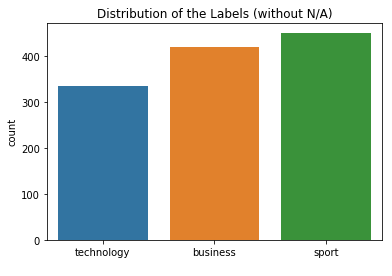

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


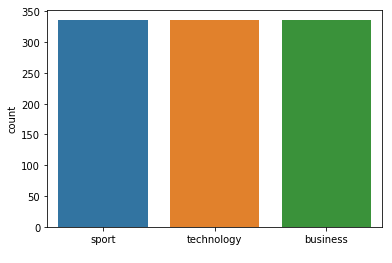



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 97
Class Distribution --> Train data (Fold 2 ):


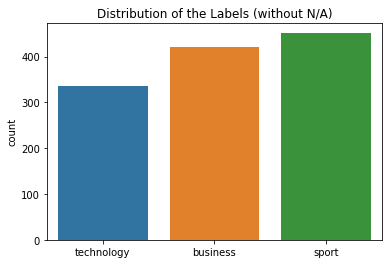

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


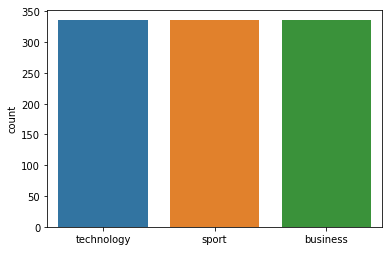



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        70
     sport
       0.95      0.96      0.95        75
technology
       0.96      0.95      0.95        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 97
Class Distribution --> Train data (Fold 3 ):


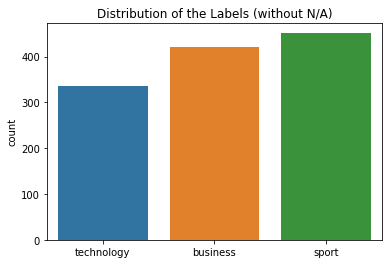

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


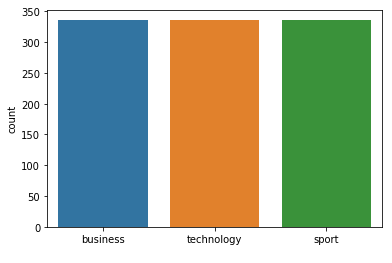



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 97
Class Distribution --> Train data (Fold 4 ):


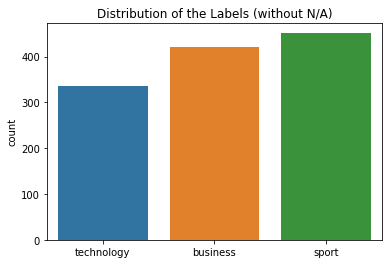

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


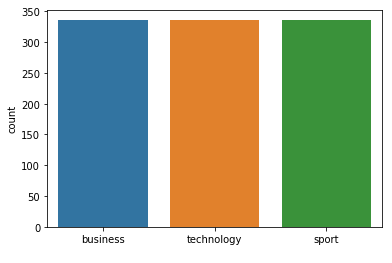



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 97
Class Distribution --> Train data (Fold 5 ):


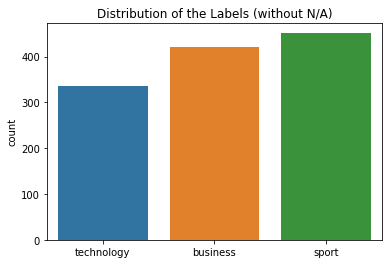

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


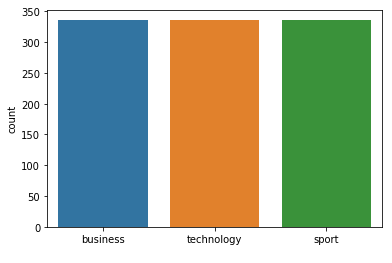



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 97
Class Distribution --> Train data (Fold 6 ):


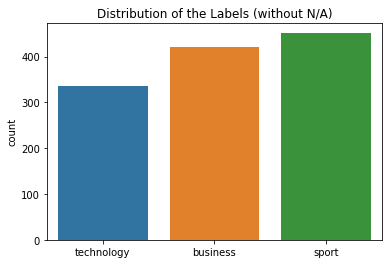

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


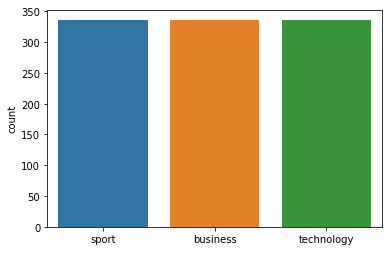



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 97
Class Distribution --> Train data (Fold 7 ):


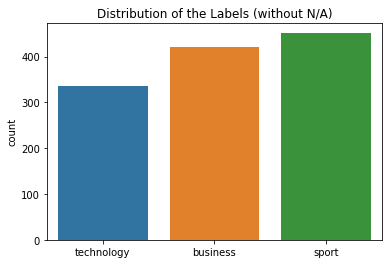

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


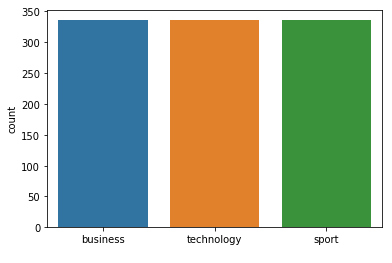



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.98      0.96        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 97  neighbours): 96.92% (+/- 1.12%)
FOLD 1 Number of neighbors 99
Class Distribution --> Train data (Fold 1 ):


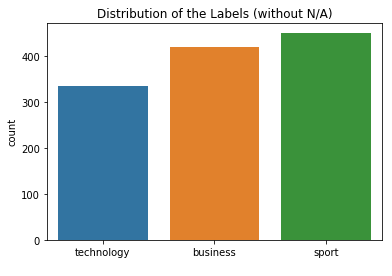

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


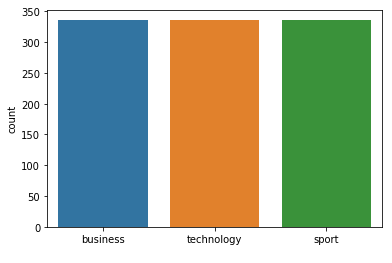



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 99
Class Distribution --> Train data (Fold 2 ):


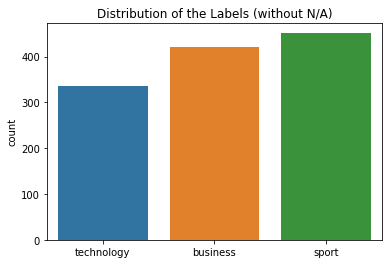

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


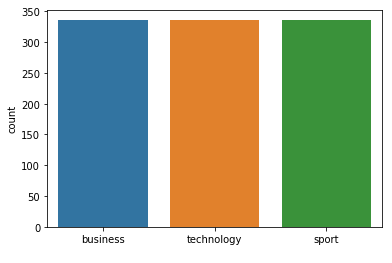



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 99
Class Distribution --> Train data (Fold 3 ):


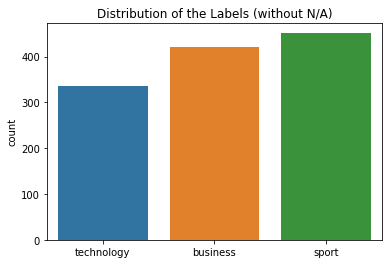

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


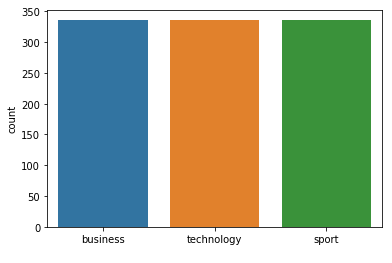



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 99
Class Distribution --> Train data (Fold 4 ):


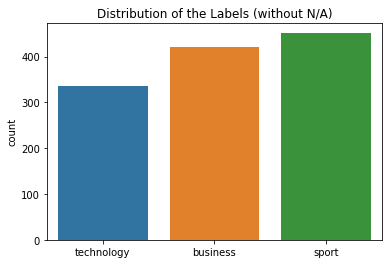

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


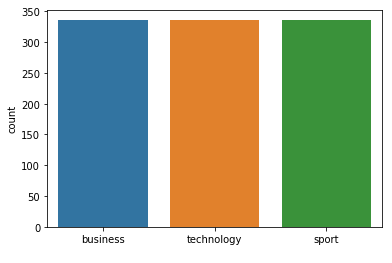



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 99
Class Distribution --> Train data (Fold 5 ):


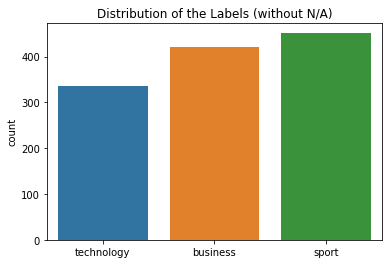

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


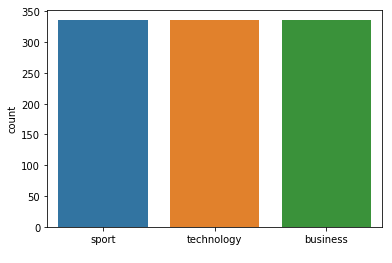



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 99
Class Distribution --> Train data (Fold 6 ):


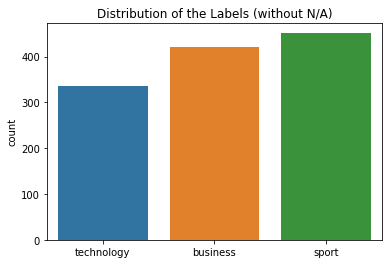

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


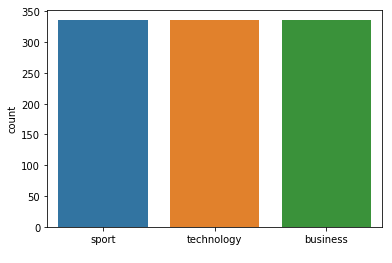



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 99
Class Distribution --> Train data (Fold 7 ):


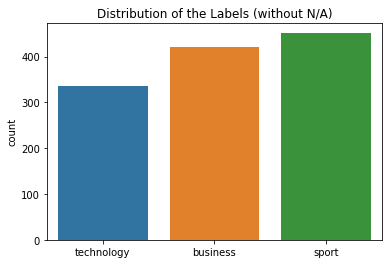

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


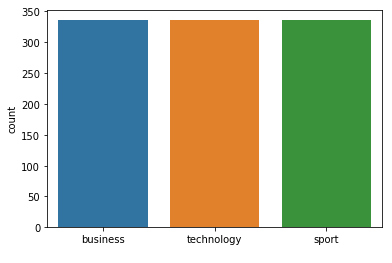



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 99  neighbours): 96.92% (+/- 1.12%)
FOLD 1 Number of neighbors 101
Class Distribution --> Train data (Fold 1 ):


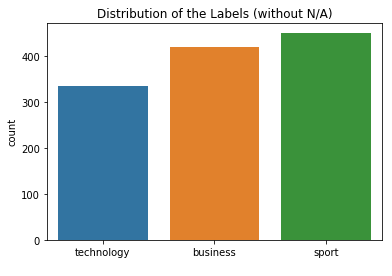

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


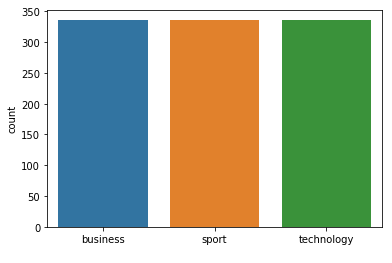



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 101
Class Distribution --> Train data (Fold 2 ):


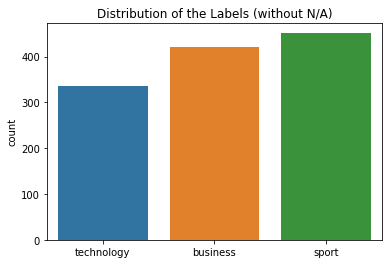

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


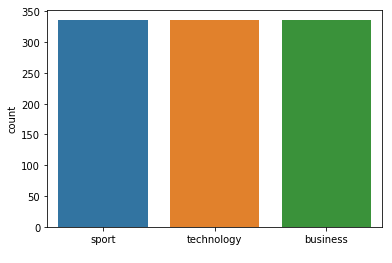



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 101
Class Distribution --> Train data (Fold 3 ):


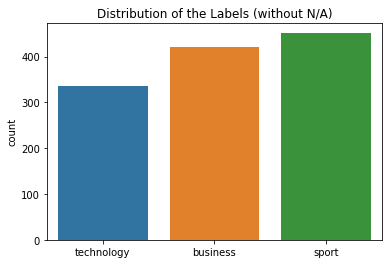

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


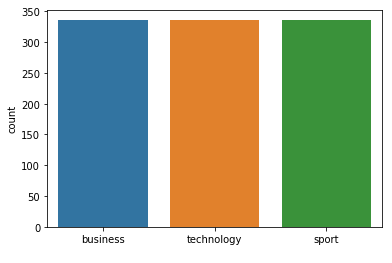



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 101
Class Distribution --> Train data (Fold 4 ):


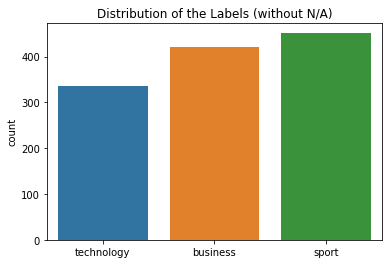

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


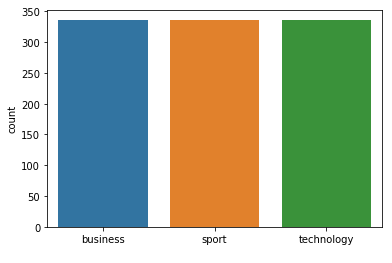



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 101
Class Distribution --> Train data (Fold 5 ):


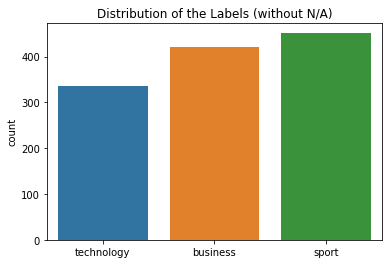

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


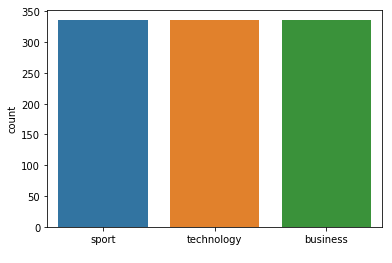



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 101
Class Distribution --> Train data (Fold 6 ):


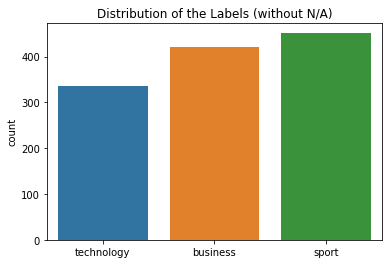

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


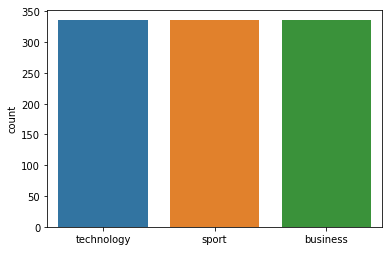



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 101
Class Distribution --> Train data (Fold 7 ):


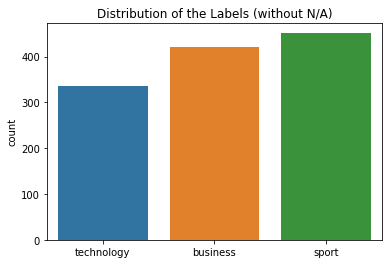

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


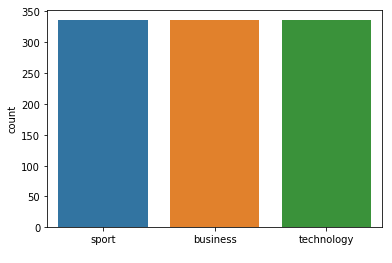



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        55

avg / total       0.98      0.97      0.98       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 101  neighbours): 96.93% (+/- 1.11%)
FOLD 1 Number of neighbors 103
Class Distribution --> Train data (Fold 1 ):


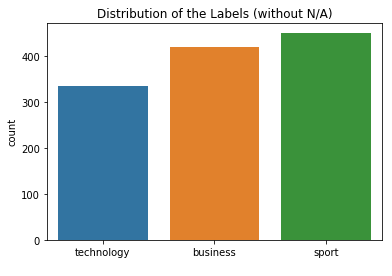

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


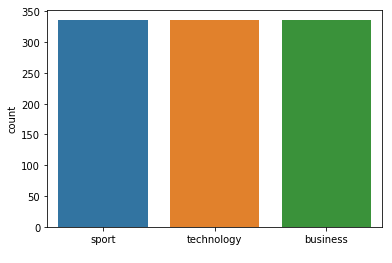



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 103
Class Distribution --> Train data (Fold 2 ):


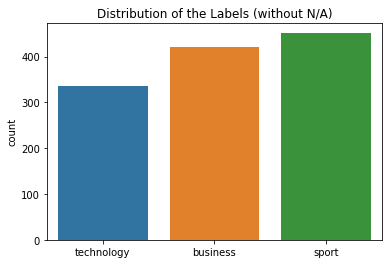

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


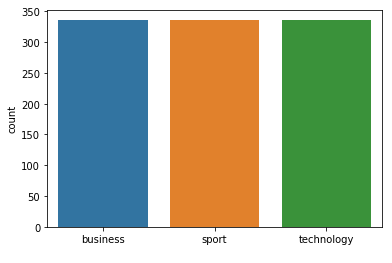



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 103
Class Distribution --> Train data (Fold 3 ):


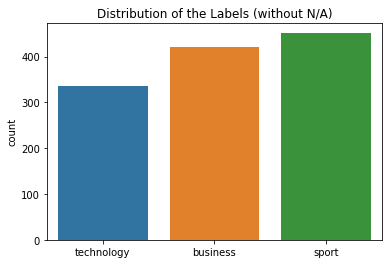

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


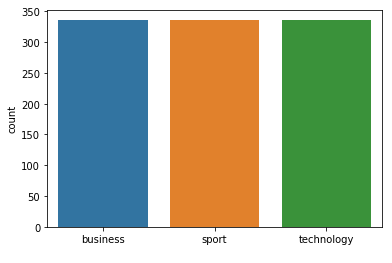



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 103
Class Distribution --> Train data (Fold 4 ):


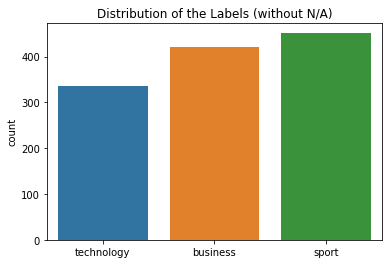

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


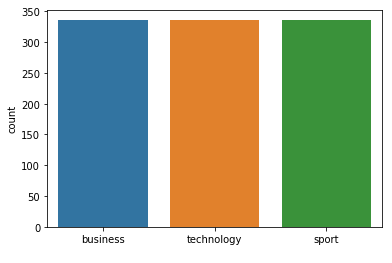



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 103
Class Distribution --> Train data (Fold 5 ):


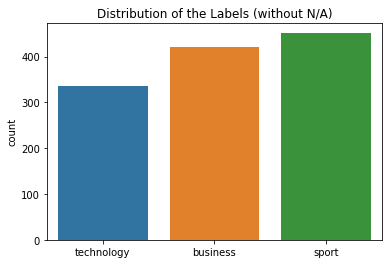

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


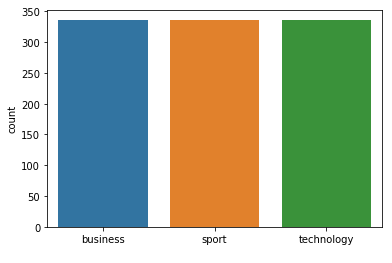



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 103
Class Distribution --> Train data (Fold 6 ):


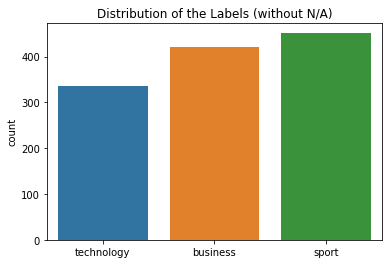

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


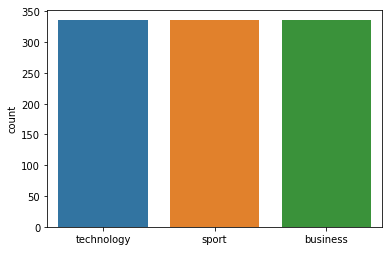



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 103
Class Distribution --> Train data (Fold 7 ):


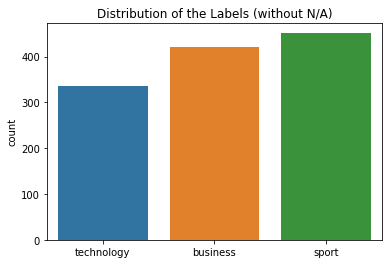

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


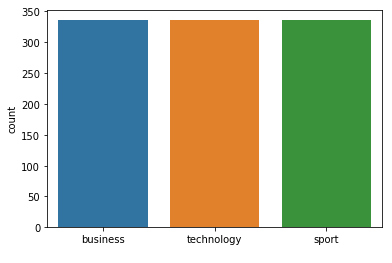



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        55

avg / total       0.98      0.97      0.98       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 103  neighbours): 96.94% (+/- 1.11%)
FOLD 1 Number of neighbors 105
Class Distribution --> Train data (Fold 1 ):


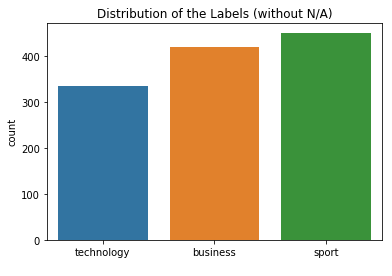

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


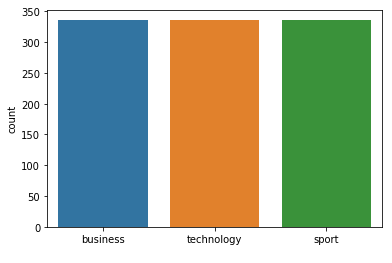



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 105
Class Distribution --> Train data (Fold 2 ):


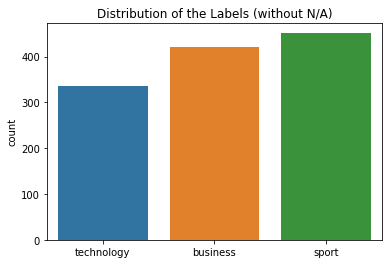

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


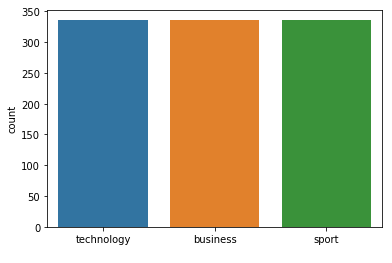



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 105
Class Distribution --> Train data (Fold 3 ):


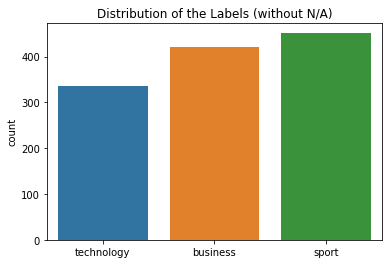

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


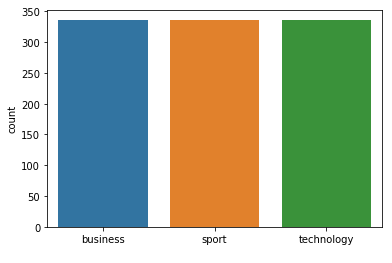



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 105
Class Distribution --> Train data (Fold 4 ):


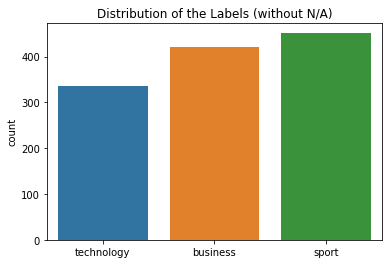

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


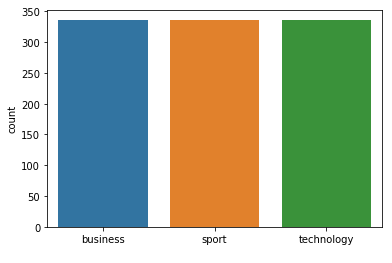



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 105
Class Distribution --> Train data (Fold 5 ):


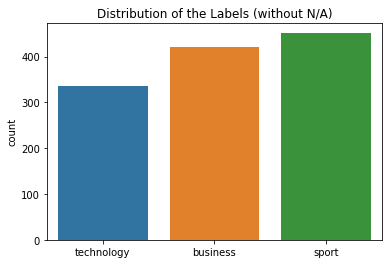

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


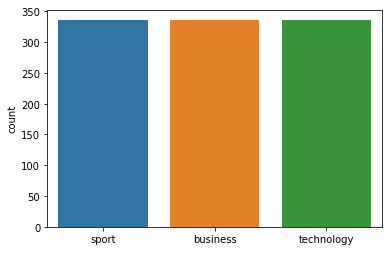



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 105
Class Distribution --> Train data (Fold 6 ):


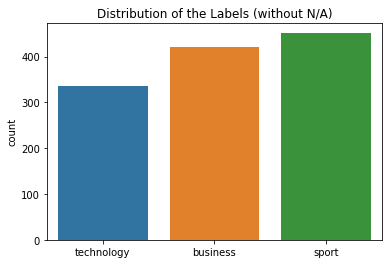

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


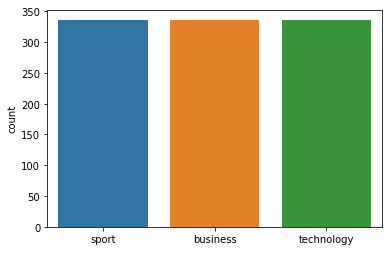



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 105
Class Distribution --> Train data (Fold 7 ):


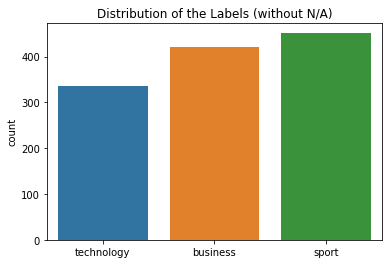

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


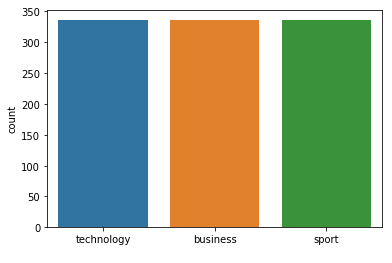



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 105  neighbours): 96.95% (+/- 1.10%)
FOLD 1 Number of neighbors 107
Class Distribution --> Train data (Fold 1 ):


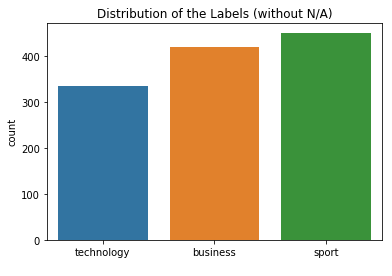

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


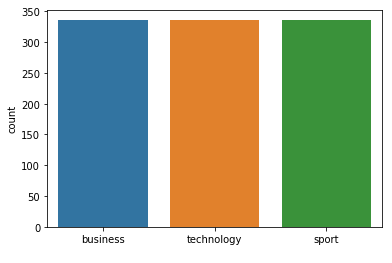



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 107
Class Distribution --> Train data (Fold 2 ):


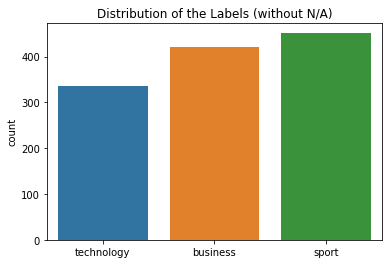

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


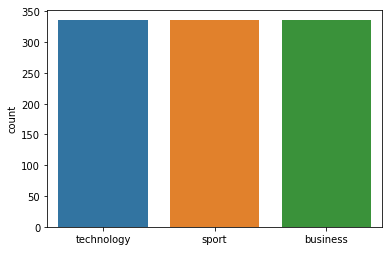



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 107
Class Distribution --> Train data (Fold 3 ):


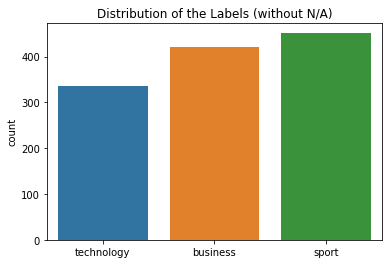

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


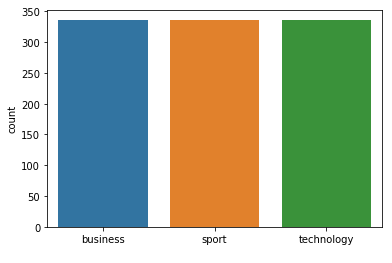



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 107
Class Distribution --> Train data (Fold 4 ):


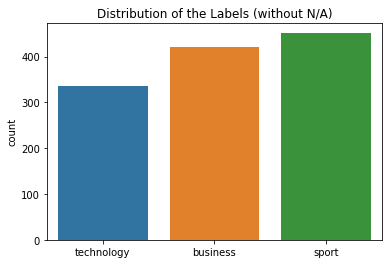

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


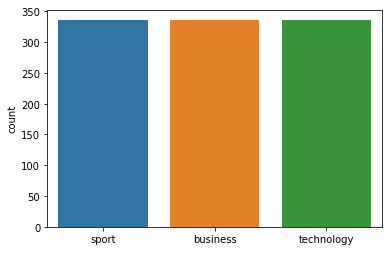



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 107
Class Distribution --> Train data (Fold 5 ):


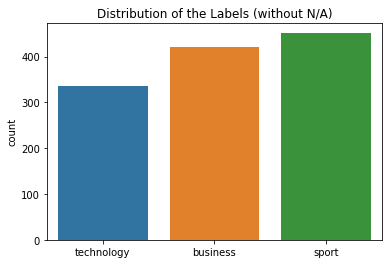

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


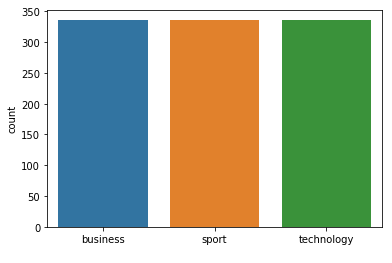



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 107
Class Distribution --> Train data (Fold 6 ):


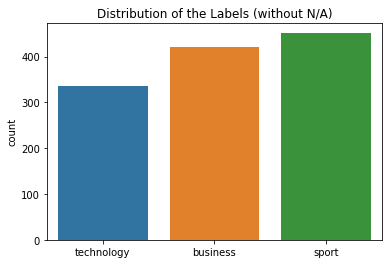

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


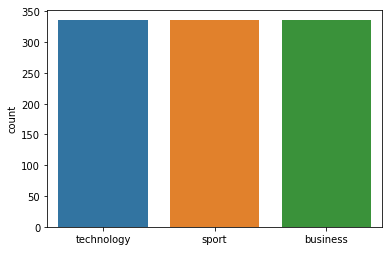



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 107
Class Distribution --> Train data (Fold 7 ):


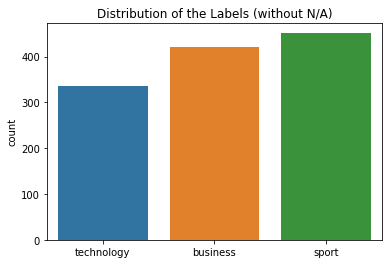

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


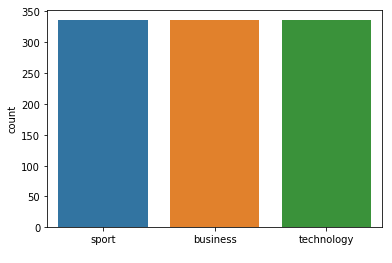



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        55

avg / total       0.98      0.97      0.98       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 107  neighbours): 96.95% (+/- 1.10%)
FOLD 1 Number of neighbors 109
Class Distribution --> Train data (Fold 1 ):


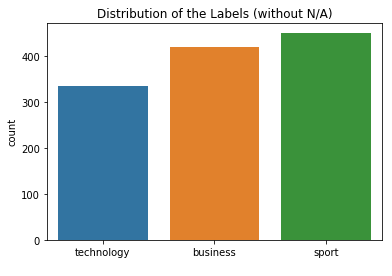

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


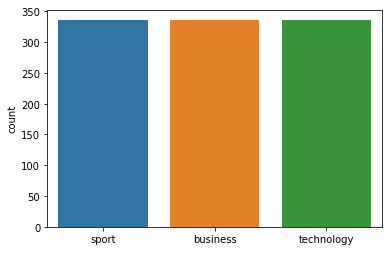



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 109
Class Distribution --> Train data (Fold 2 ):


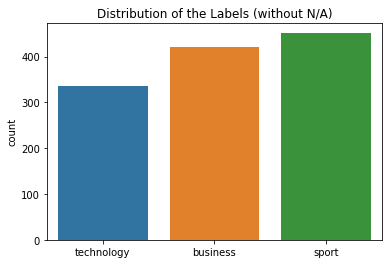

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


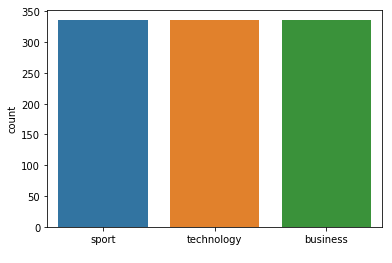



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.96      0.95        75
technology
       0.95      0.95      0.95        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 72  1]
 [ 1  2 53]]
FOLD 3 Number of neighbors 109
Class Distribution --> Train data (Fold 3 ):


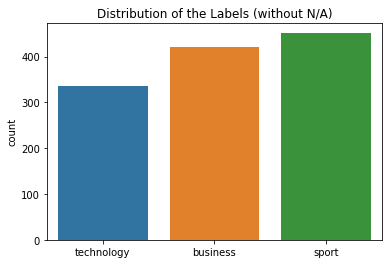

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


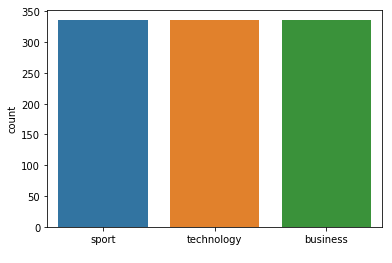



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 109
Class Distribution --> Train data (Fold 4 ):


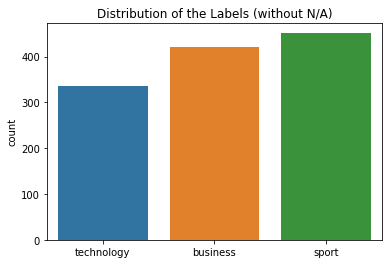

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


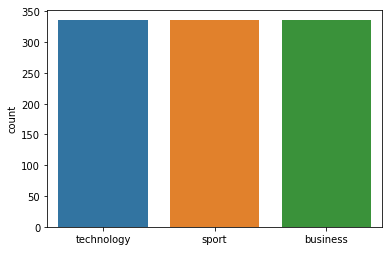



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 109
Class Distribution --> Train data (Fold 5 ):


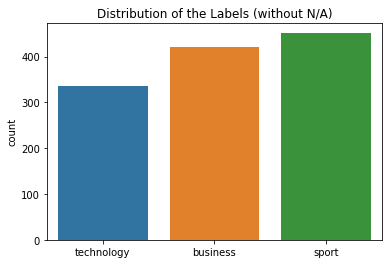

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


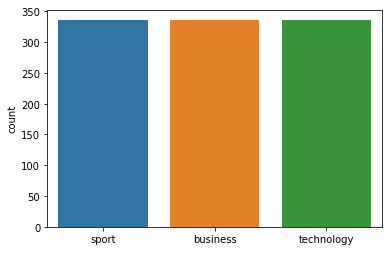



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 109
Class Distribution --> Train data (Fold 6 ):


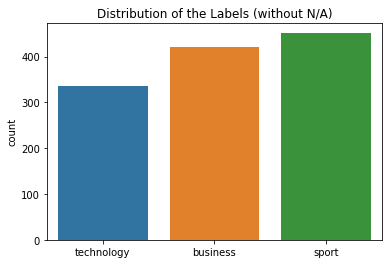

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


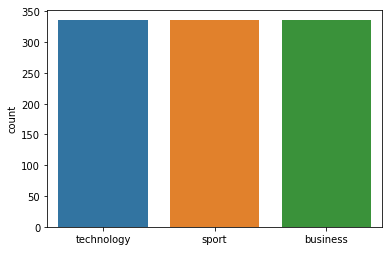



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 109
Class Distribution --> Train data (Fold 7 ):


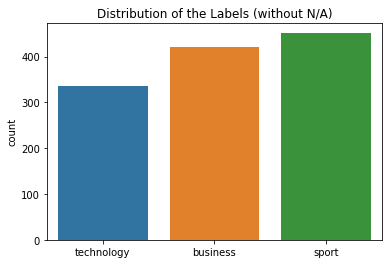

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


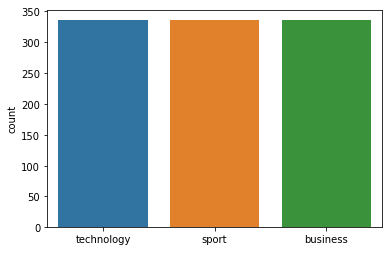



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 109  neighbours): 96.96% (+/- 1.11%)
FOLD 1 Number of neighbors 111
Class Distribution --> Train data (Fold 1 ):


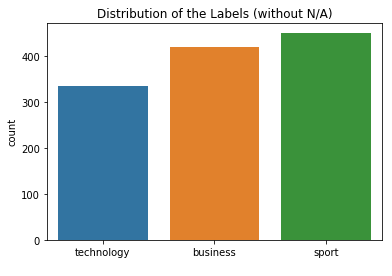

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


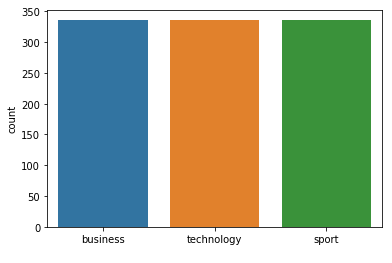



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 111
Class Distribution --> Train data (Fold 2 ):


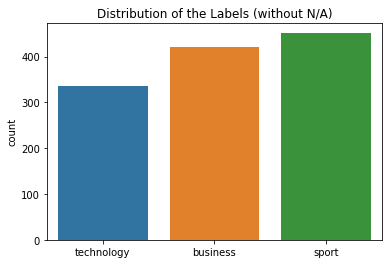

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


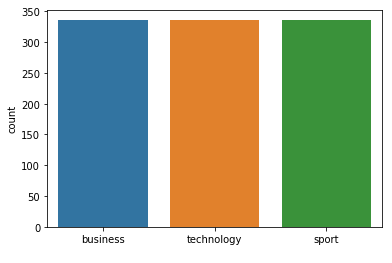



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        70
     sport
       0.95      0.96      0.95        75
technology
       0.96      0.95      0.95        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 111
Class Distribution --> Train data (Fold 3 ):


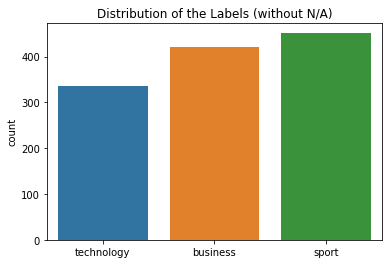

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


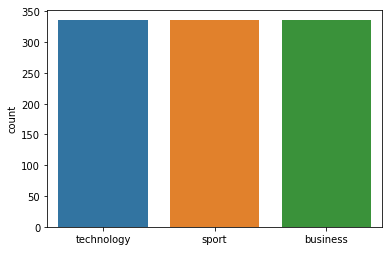



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.90      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 111
Class Distribution --> Train data (Fold 4 ):


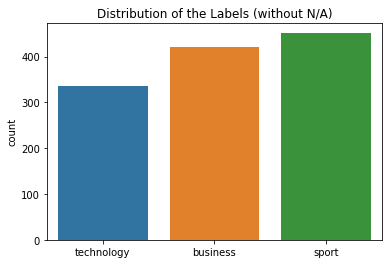

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


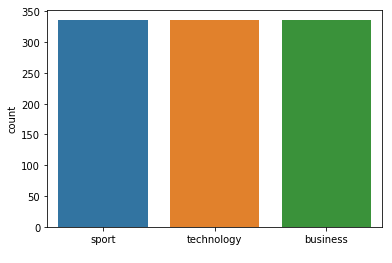



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 111
Class Distribution --> Train data (Fold 5 ):


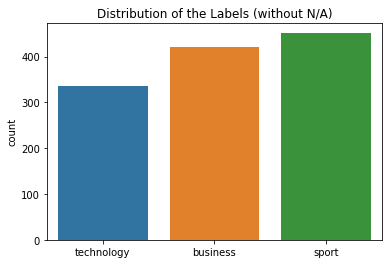

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


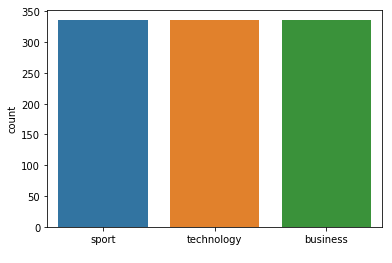



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 111
Class Distribution --> Train data (Fold 6 ):


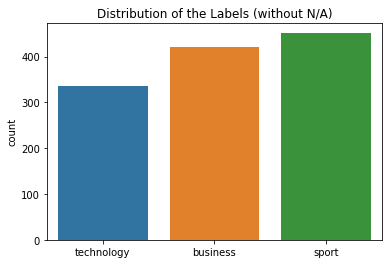

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


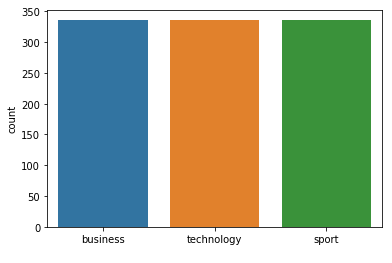



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 111
Class Distribution --> Train data (Fold 7 ):


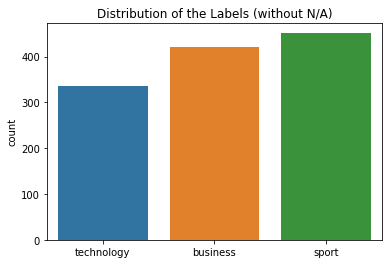

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


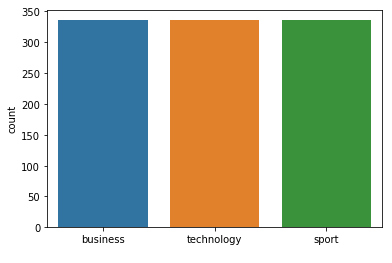



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 111  neighbours): 96.96% (+/- 1.11%)
FOLD 1 Number of neighbors 113
Class Distribution --> Train data (Fold 1 ):


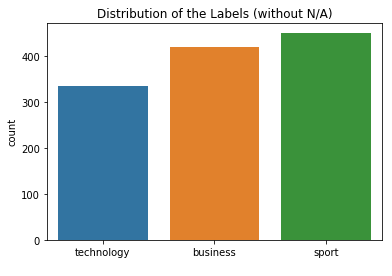

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


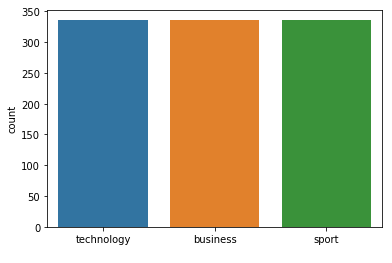



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 113
Class Distribution --> Train data (Fold 2 ):


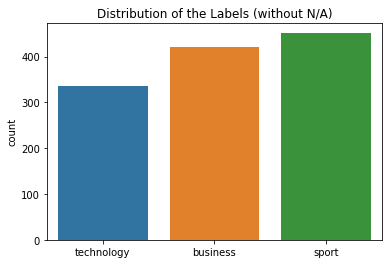

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


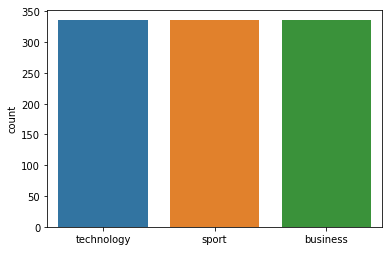



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       0.96      0.95      0.95        75
technology
       0.95      0.95      0.95        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 3 71  1]
 [ 1  2 53]]
FOLD 3 Number of neighbors 113
Class Distribution --> Train data (Fold 3 ):


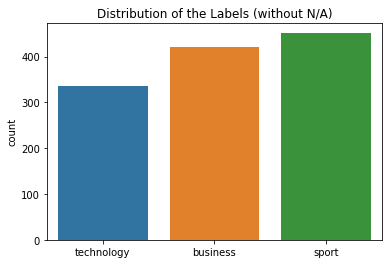

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


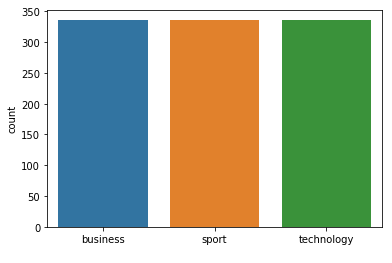



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 113
Class Distribution --> Train data (Fold 4 ):


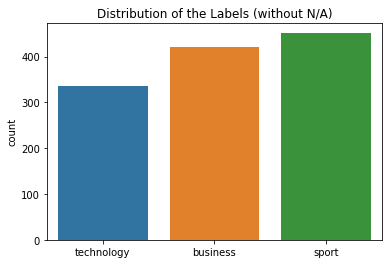

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


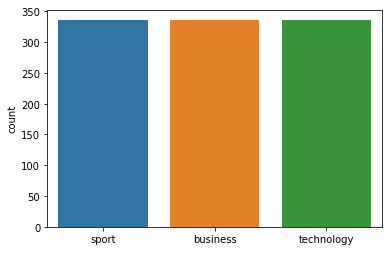



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 113
Class Distribution --> Train data (Fold 5 ):


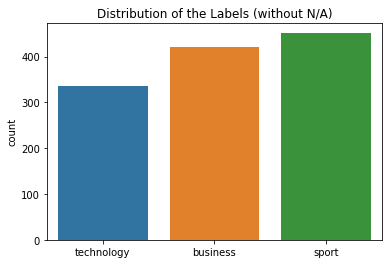

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


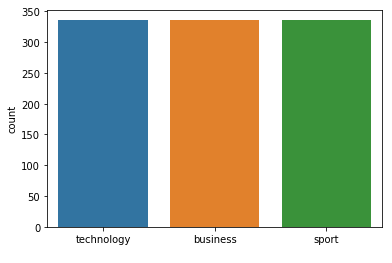



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 113
Class Distribution --> Train data (Fold 6 ):


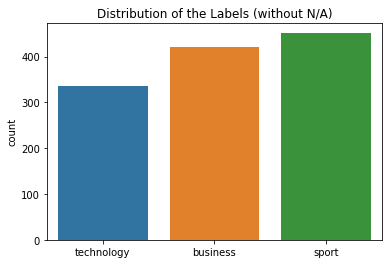

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


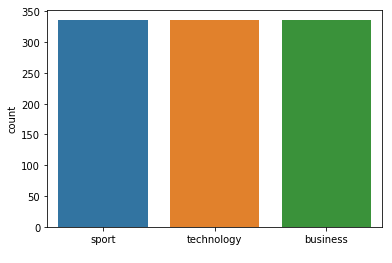



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 113
Class Distribution --> Train data (Fold 7 ):


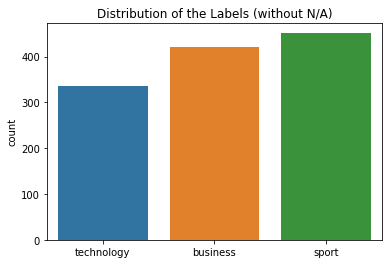

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


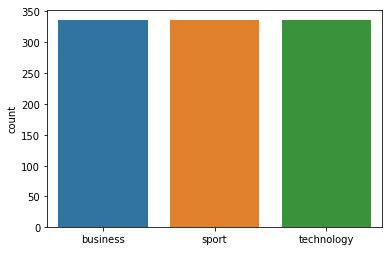



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 113  neighbours): 96.97% (+/- 1.11%)
FOLD 1 Number of neighbors 115
Class Distribution --> Train data (Fold 1 ):


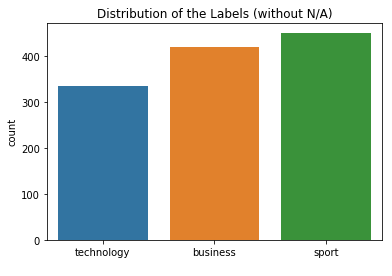

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


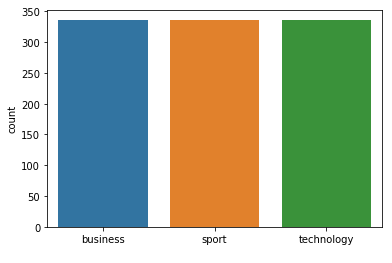



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 115
Class Distribution --> Train data (Fold 2 ):


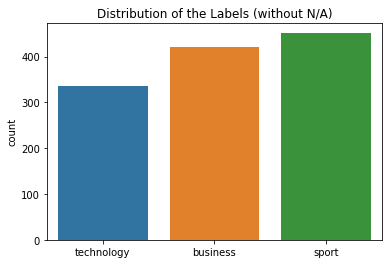

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


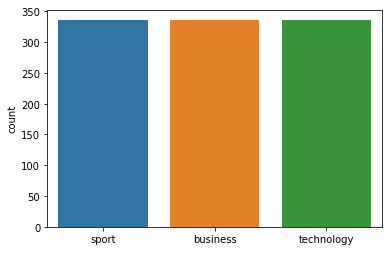



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.95      0.97      0.96        75
technology
       0.95      0.95      0.95        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[65  2  3]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 115
Class Distribution --> Train data (Fold 3 ):


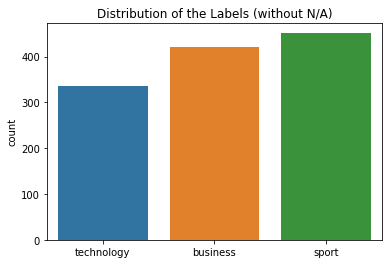

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


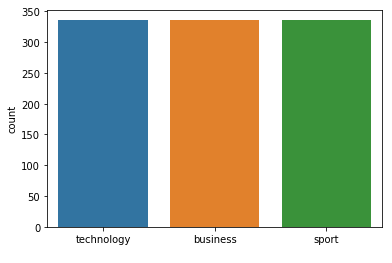



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.99      1.00      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 115
Class Distribution --> Train data (Fold 4 ):


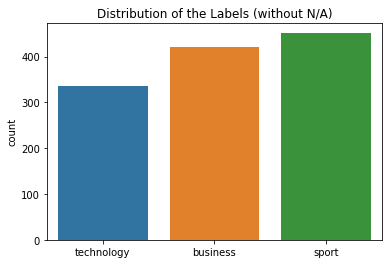

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


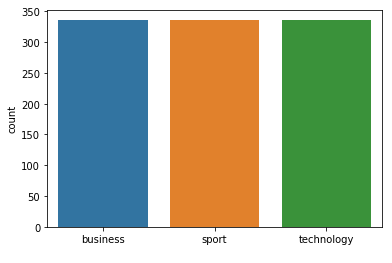



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 115
Class Distribution --> Train data (Fold 5 ):


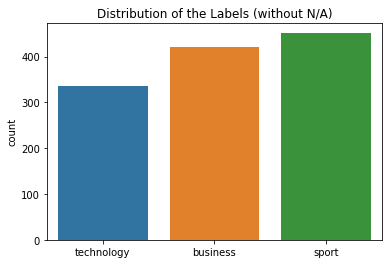

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


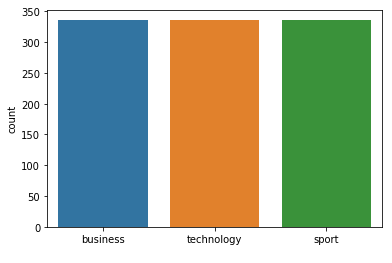



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 115
Class Distribution --> Train data (Fold 6 ):


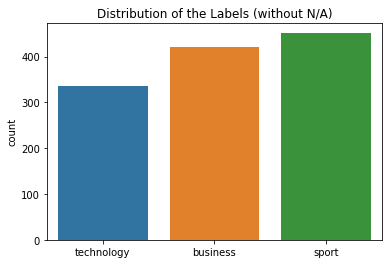

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


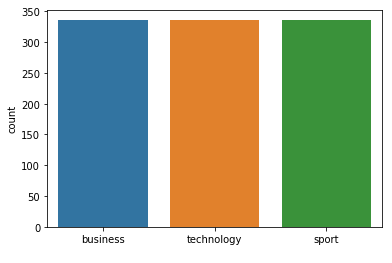



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 115
Class Distribution --> Train data (Fold 7 ):


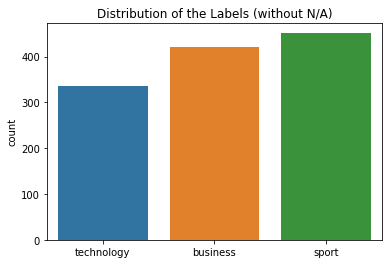

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


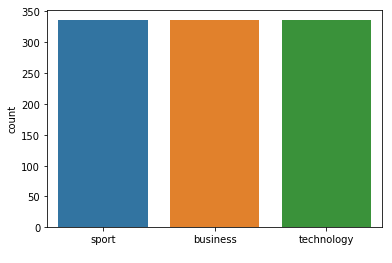



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        55

avg / total       0.98      0.97      0.98       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 115  neighbours): 96.97% (+/- 1.11%)
FOLD 1 Number of neighbors 117
Class Distribution --> Train data (Fold 1 ):


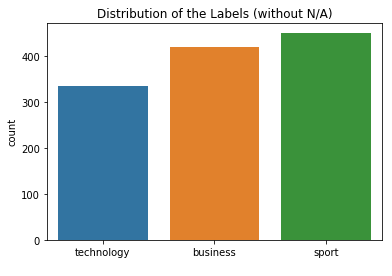

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


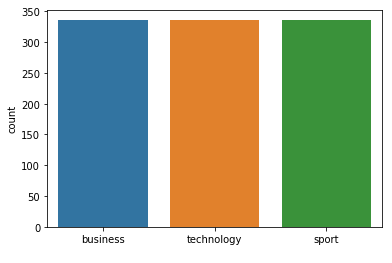



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 117
Class Distribution --> Train data (Fold 2 ):


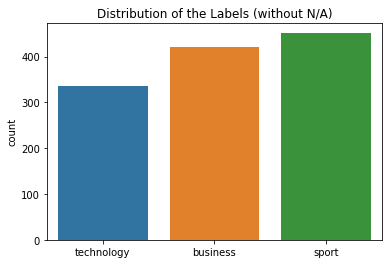

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


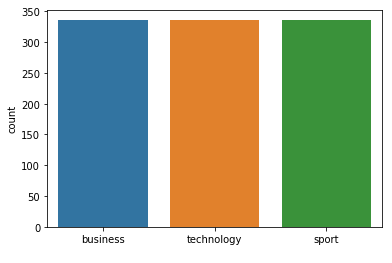



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 117
Class Distribution --> Train data (Fold 3 ):


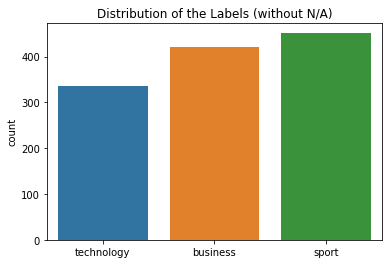

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


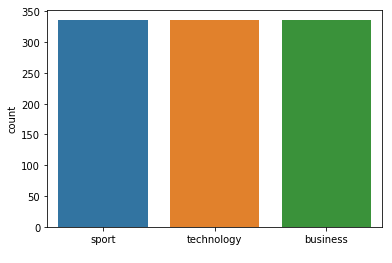



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 117
Class Distribution --> Train data (Fold 4 ):


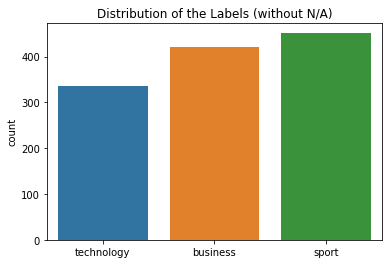

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


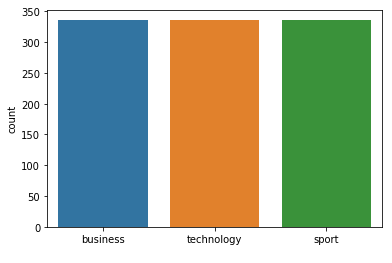



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 117
Class Distribution --> Train data (Fold 5 ):


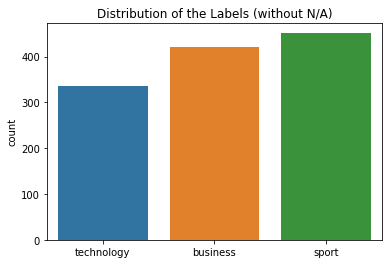

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


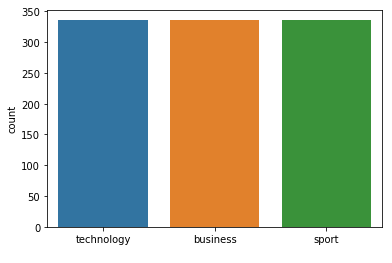



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 117
Class Distribution --> Train data (Fold 6 ):


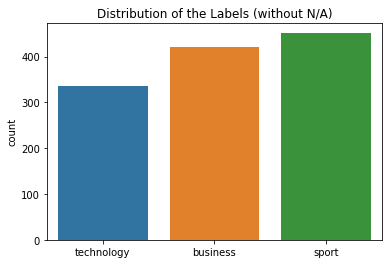

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


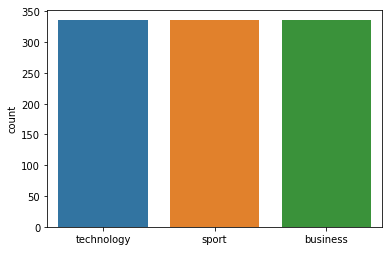



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 117
Class Distribution --> Train data (Fold 7 ):


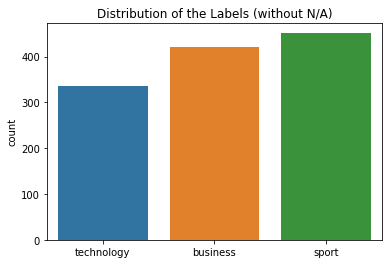

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


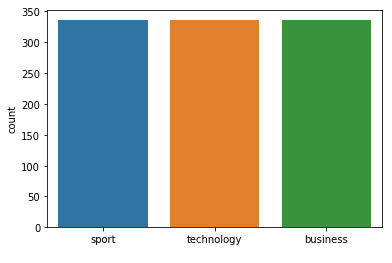



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        55

avg / total       0.98      0.97      0.98       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 117  neighbours): 96.98% (+/- 1.11%)
FOLD 1 Number of neighbors 119
Class Distribution --> Train data (Fold 1 ):


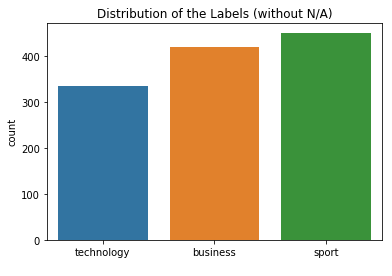

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


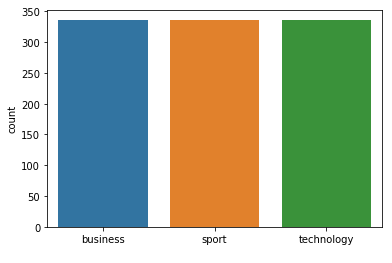



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 119
Class Distribution --> Train data (Fold 2 ):


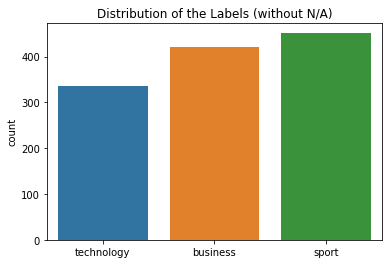

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


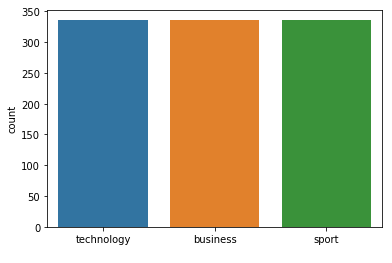



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 119
Class Distribution --> Train data (Fold 3 ):


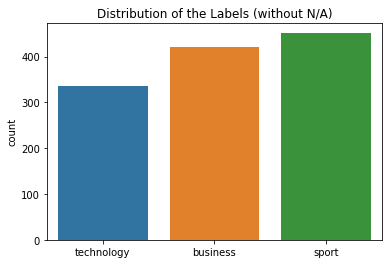

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


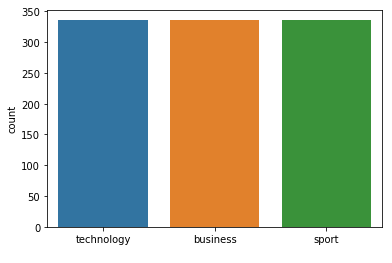



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.99      1.00      0.99        75
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 119
Class Distribution --> Train data (Fold 4 ):


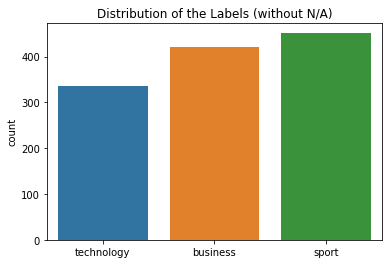

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


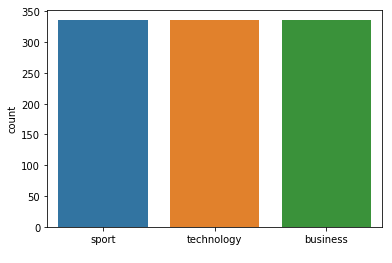



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 119
Class Distribution --> Train data (Fold 5 ):


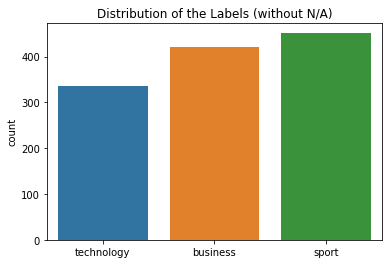

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


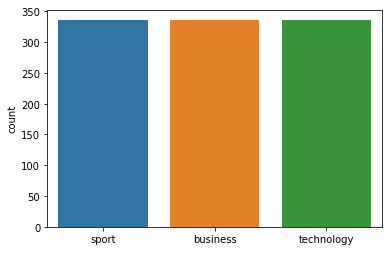



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 119
Class Distribution --> Train data (Fold 6 ):


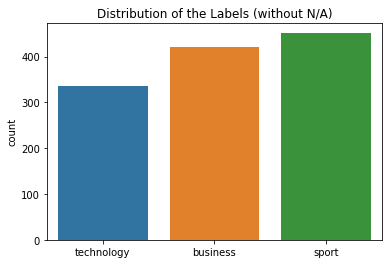

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


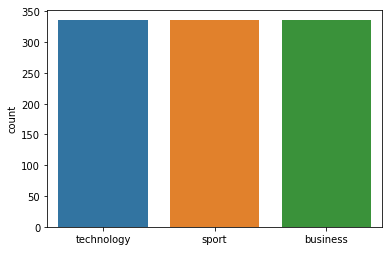



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 119
Class Distribution --> Train data (Fold 7 ):


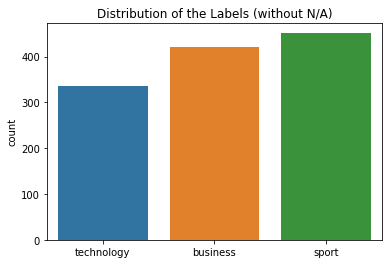

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


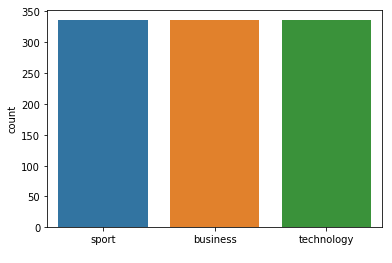



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 119  neighbours): 96.98% (+/- 1.10%)
FOLD 1 Number of neighbors 121
Class Distribution --> Train data (Fold 1 ):


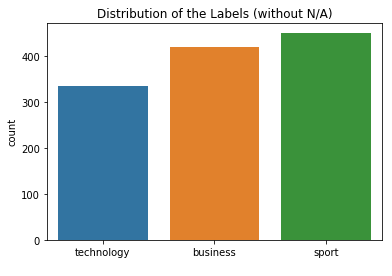

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


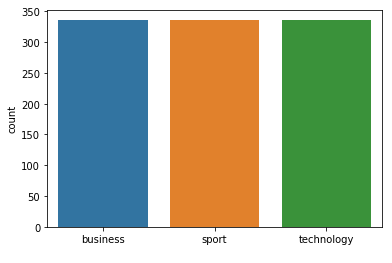



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 121
Class Distribution --> Train data (Fold 2 ):


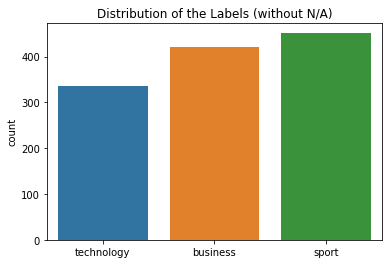

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


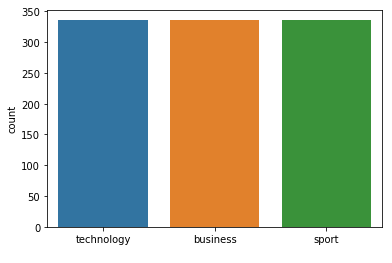



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 121
Class Distribution --> Train data (Fold 3 ):


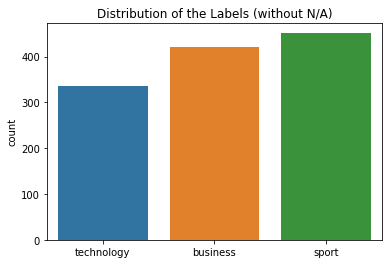

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


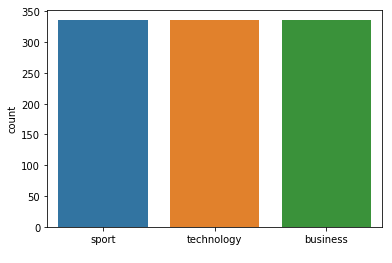



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.99      1.00      0.99        75
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 121
Class Distribution --> Train data (Fold 4 ):


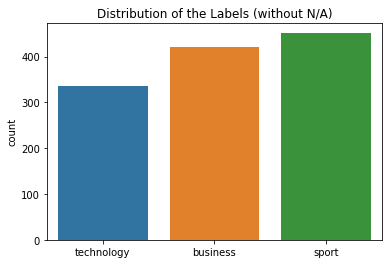

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


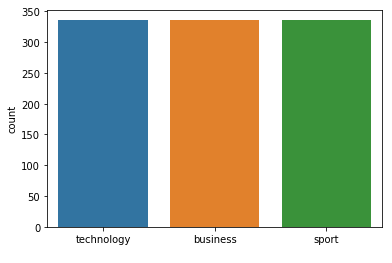



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 121
Class Distribution --> Train data (Fold 5 ):


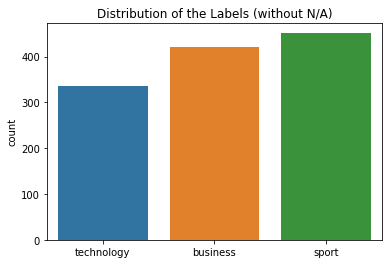

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


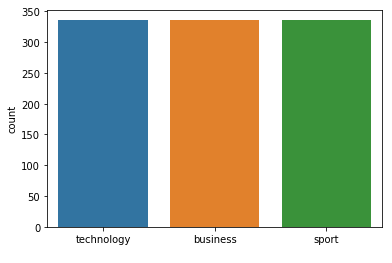



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 121
Class Distribution --> Train data (Fold 6 ):


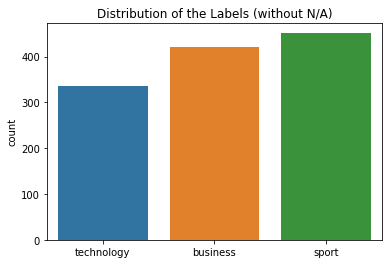

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


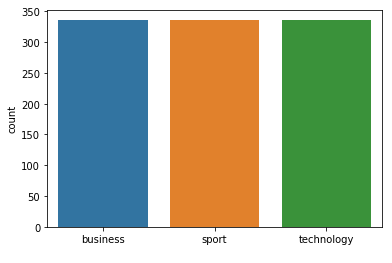



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 121
Class Distribution --> Train data (Fold 7 ):


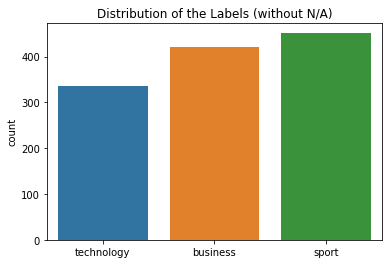

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


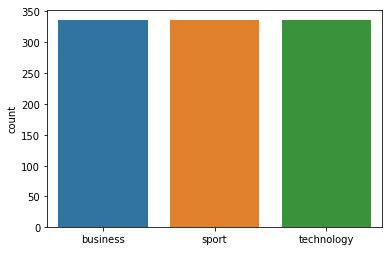



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  2 53]]


 Model accuracy (for 121  neighbours): 96.99% (+/- 1.10%)
FOLD 1 Number of neighbors 123
Class Distribution --> Train data (Fold 1 ):


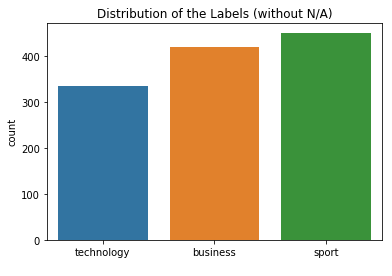

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


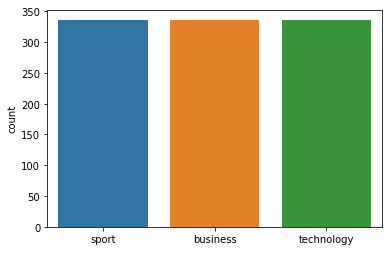



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 123
Class Distribution --> Train data (Fold 2 ):


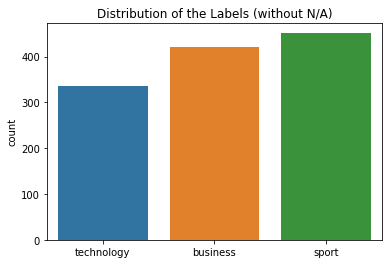

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


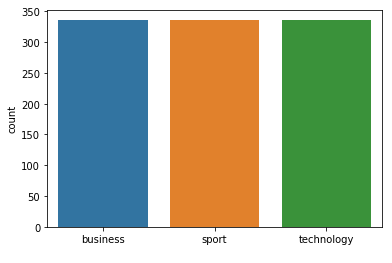



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 123
Class Distribution --> Train data (Fold 3 ):


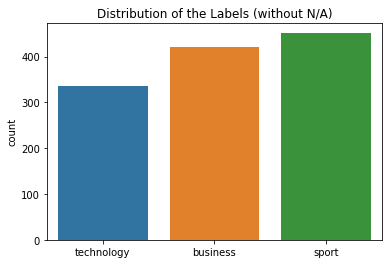

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


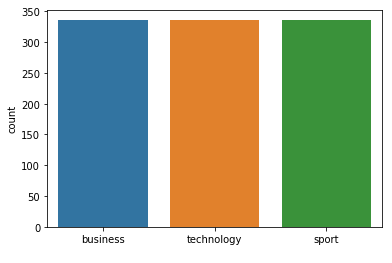



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 123
Class Distribution --> Train data (Fold 4 ):


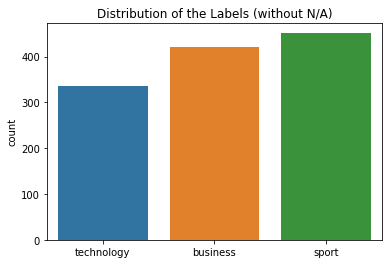

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


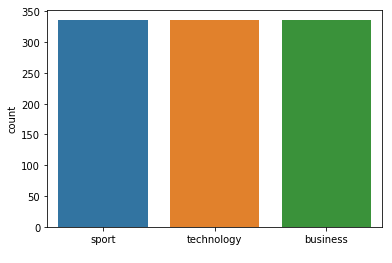



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 123
Class Distribution --> Train data (Fold 5 ):


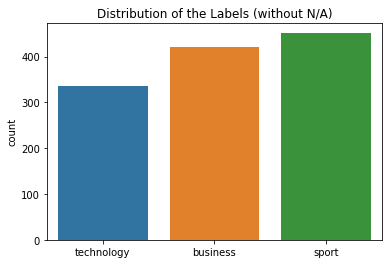

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


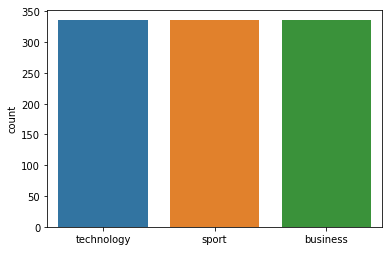



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 123
Class Distribution --> Train data (Fold 6 ):


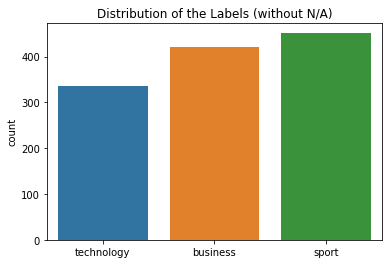

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


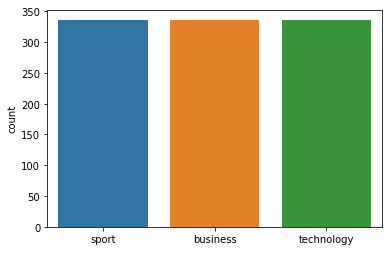



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 123
Class Distribution --> Train data (Fold 7 ):


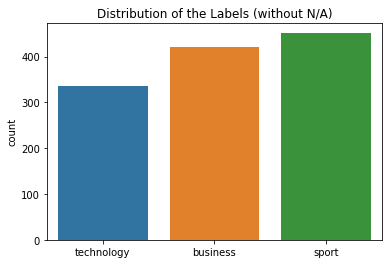

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


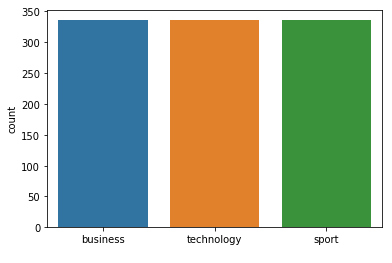



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 123  neighbours): 96.99% (+/- 1.10%)
FOLD 1 Number of neighbors 125
Class Distribution --> Train data (Fold 1 ):


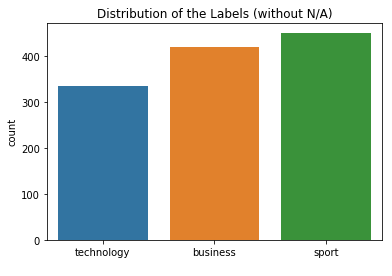

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


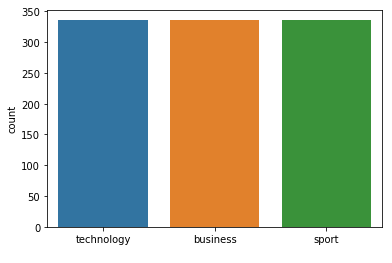



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 125
Class Distribution --> Train data (Fold 2 ):


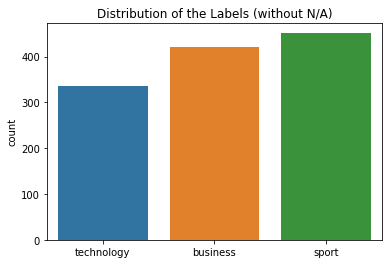

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


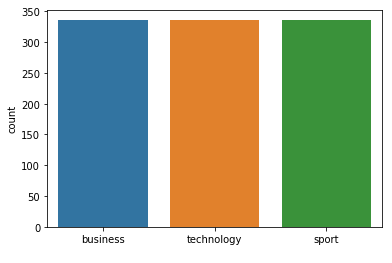



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 125
Class Distribution --> Train data (Fold 3 ):


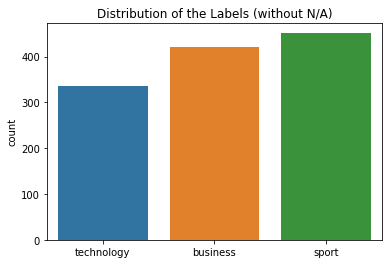

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


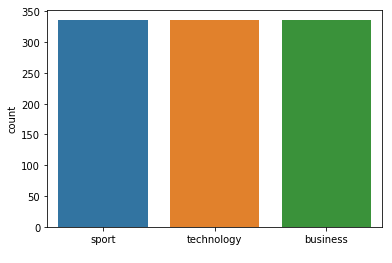



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 125
Class Distribution --> Train data (Fold 4 ):


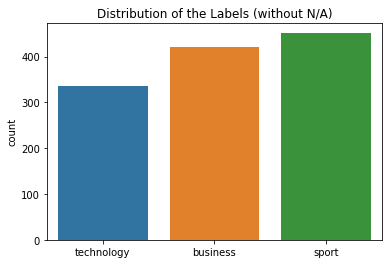

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


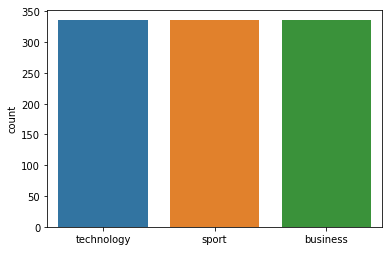



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 125
Class Distribution --> Train data (Fold 5 ):


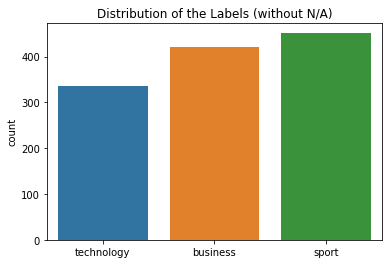

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


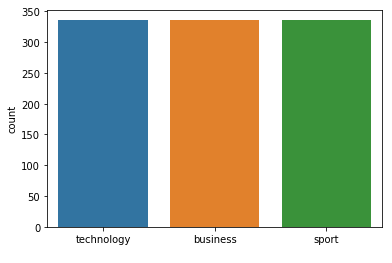



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 125
Class Distribution --> Train data (Fold 6 ):


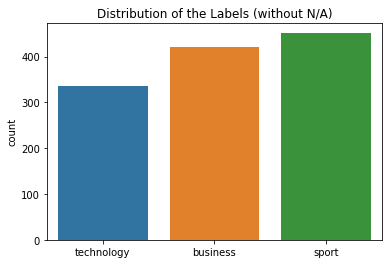

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


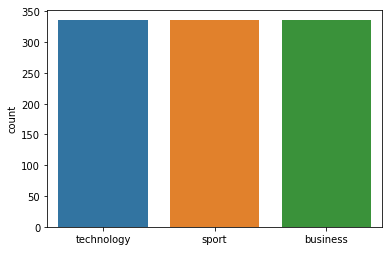



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 125
Class Distribution --> Train data (Fold 7 ):


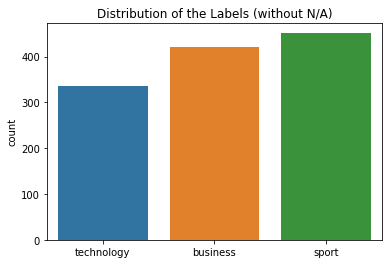

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


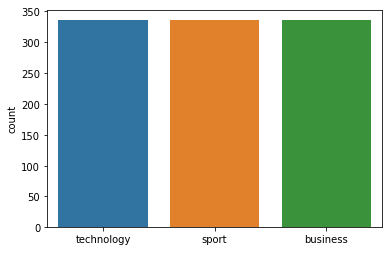



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 125  neighbours): 96.99% (+/- 1.10%)
FOLD 1 Number of neighbors 127
Class Distribution --> Train data (Fold 1 ):


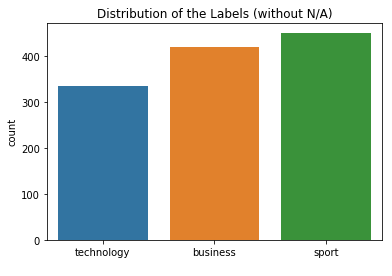

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


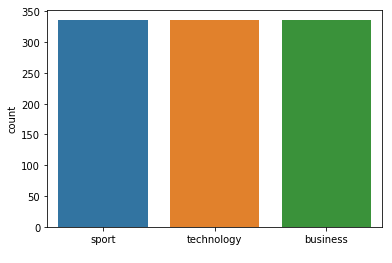



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 127
Class Distribution --> Train data (Fold 2 ):


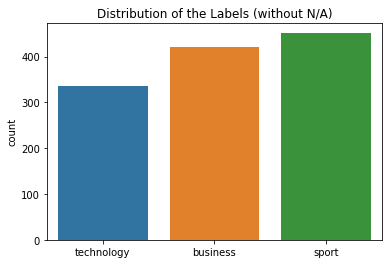

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


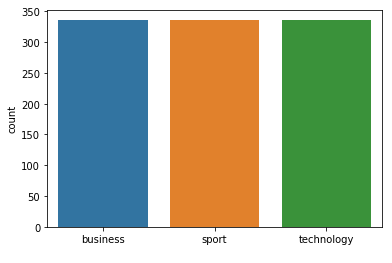



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 127
Class Distribution --> Train data (Fold 3 ):


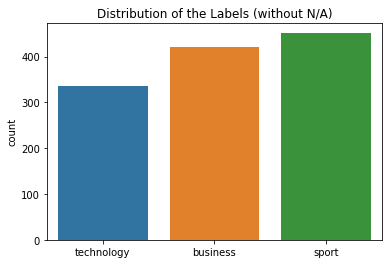

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


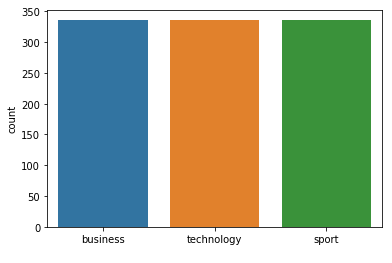



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 127
Class Distribution --> Train data (Fold 4 ):


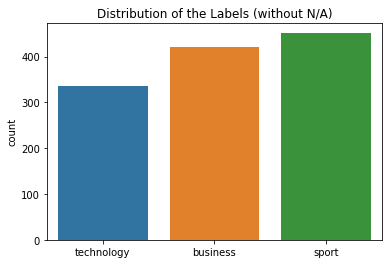

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


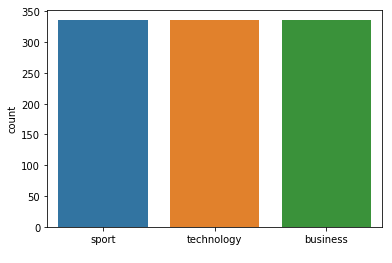



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 127
Class Distribution --> Train data (Fold 5 ):


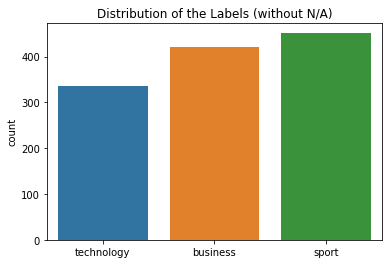

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


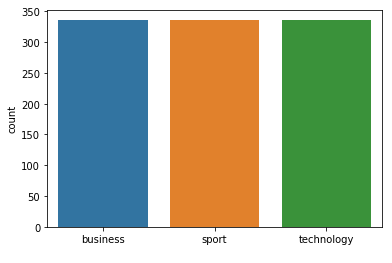



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 127
Class Distribution --> Train data (Fold 6 ):


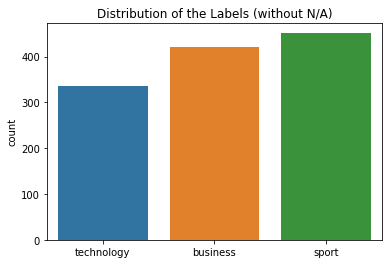

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


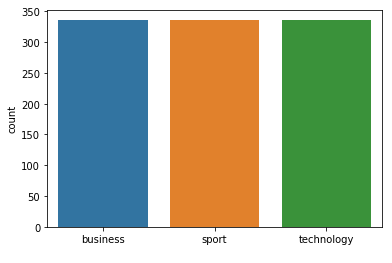



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 127
Class Distribution --> Train data (Fold 7 ):


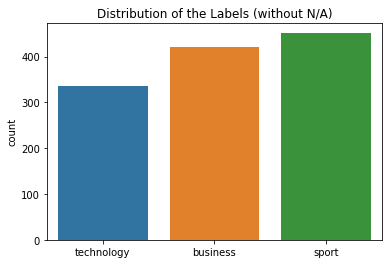

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


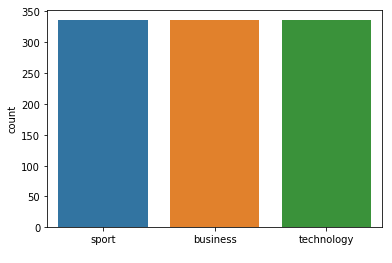



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 127  neighbours): 97.00% (+/- 1.10%)
FOLD 1 Number of neighbors 129
Class Distribution --> Train data (Fold 1 ):


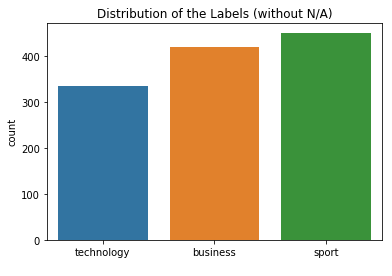

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


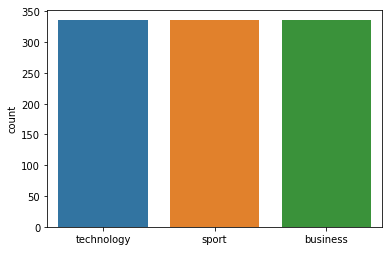



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 129
Class Distribution --> Train data (Fold 2 ):


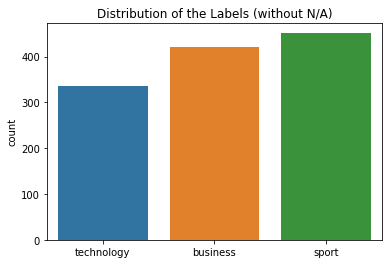

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


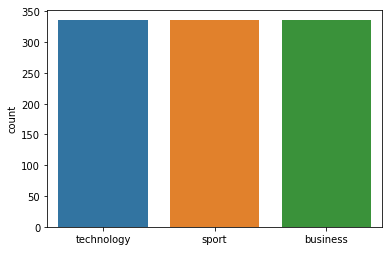



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 129
Class Distribution --> Train data (Fold 3 ):


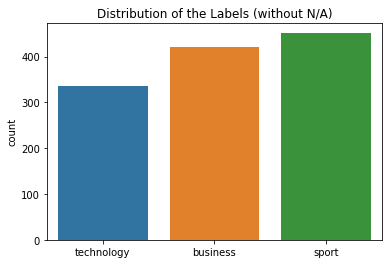

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


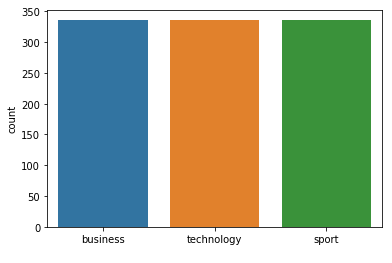



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 129
Class Distribution --> Train data (Fold 4 ):


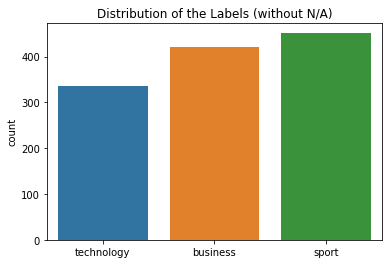

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


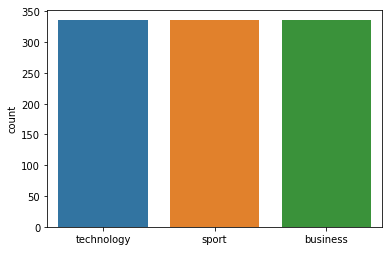



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 129
Class Distribution --> Train data (Fold 5 ):


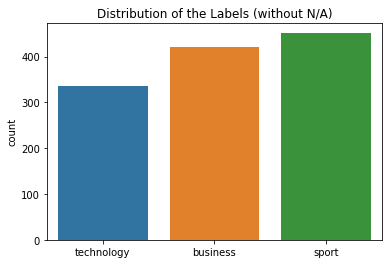

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


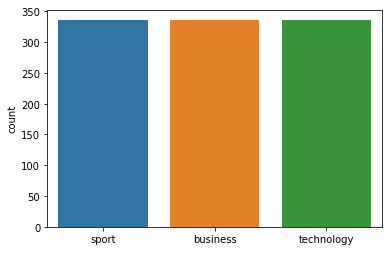



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 129
Class Distribution --> Train data (Fold 6 ):


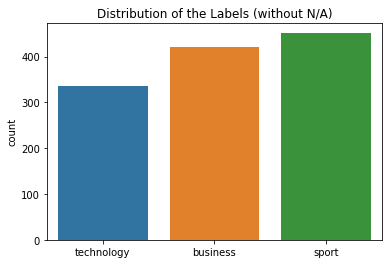

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


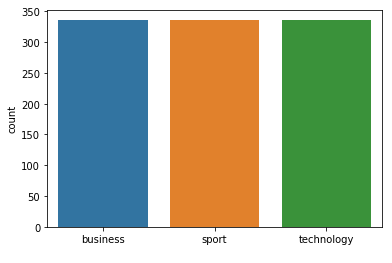



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 129
Class Distribution --> Train data (Fold 7 ):


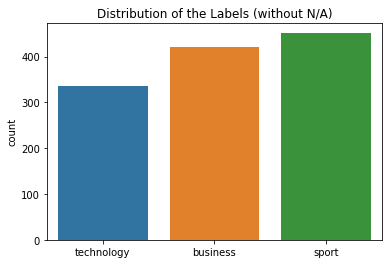

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


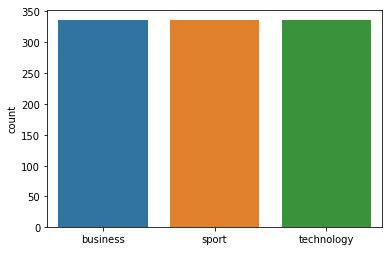



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 129  neighbours): 97.00% (+/- 1.10%)
FOLD 1 Number of neighbors 131
Class Distribution --> Train data (Fold 1 ):


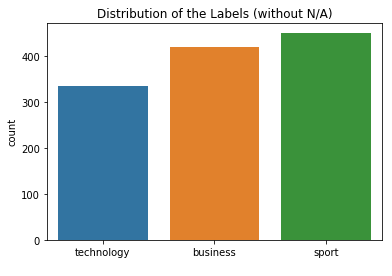

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


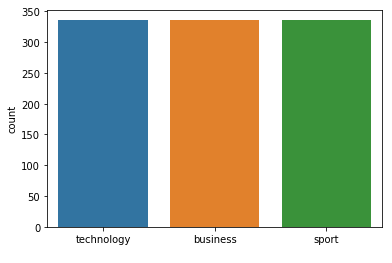



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 131
Class Distribution --> Train data (Fold 2 ):


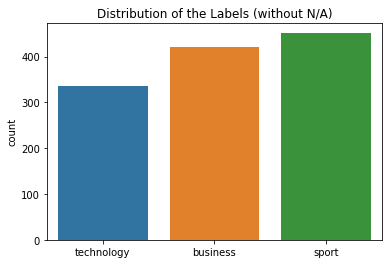

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


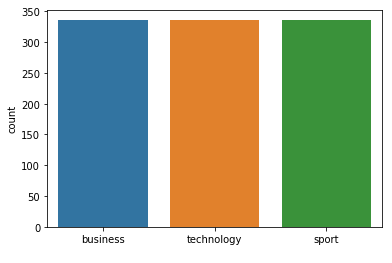



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 3 72  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 131
Class Distribution --> Train data (Fold 3 ):


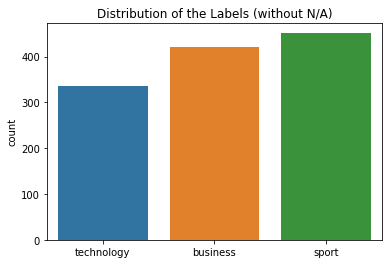

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


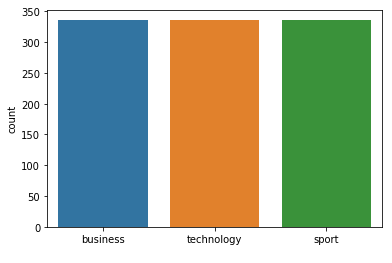



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 131
Class Distribution --> Train data (Fold 4 ):


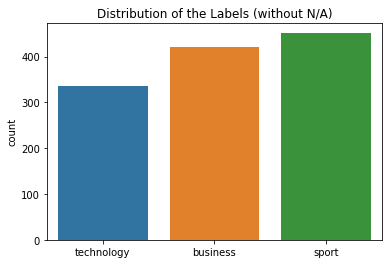

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


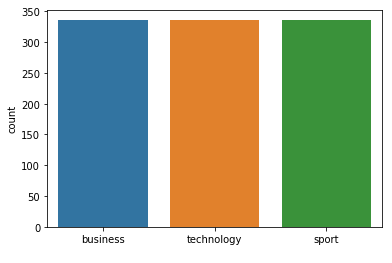



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 131
Class Distribution --> Train data (Fold 5 ):


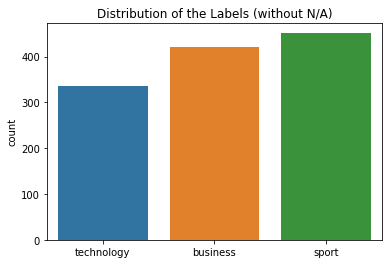

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


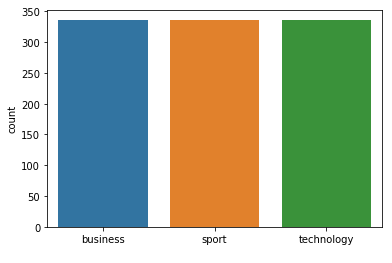



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 131
Class Distribution --> Train data (Fold 6 ):


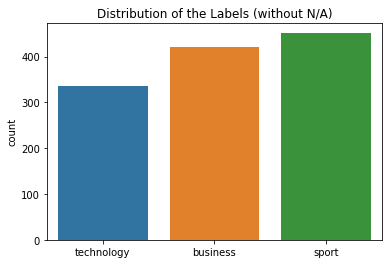

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


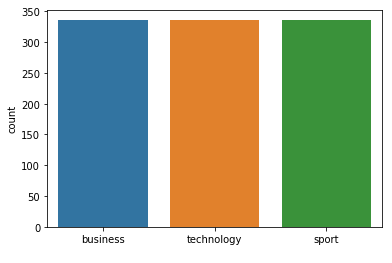



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 131
Class Distribution --> Train data (Fold 7 ):


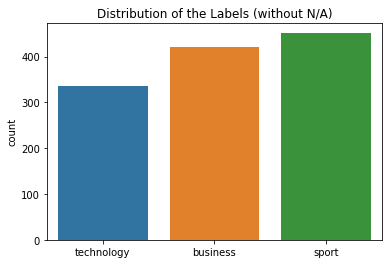

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


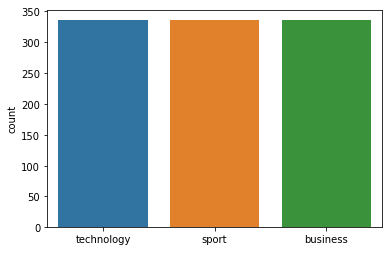



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 131  neighbours): 97.01% (+/- 1.10%)
FOLD 1 Number of neighbors 133
Class Distribution --> Train data (Fold 1 ):


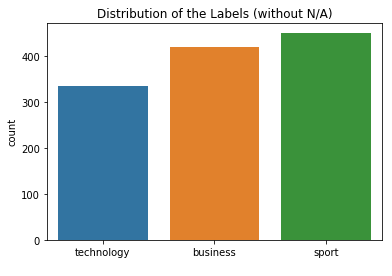

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


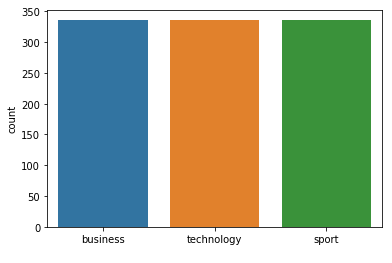



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 133
Class Distribution --> Train data (Fold 2 ):


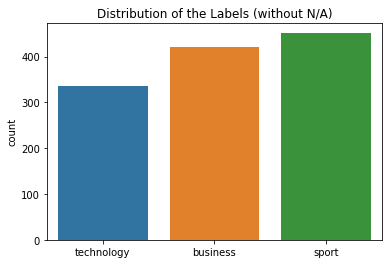

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


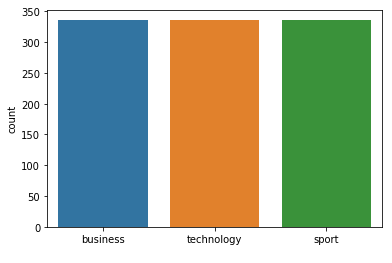



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 133
Class Distribution --> Train data (Fold 3 ):


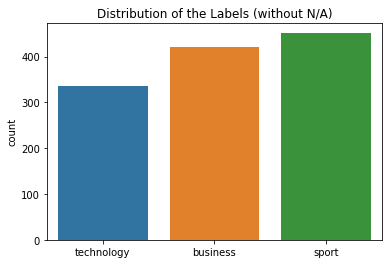

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


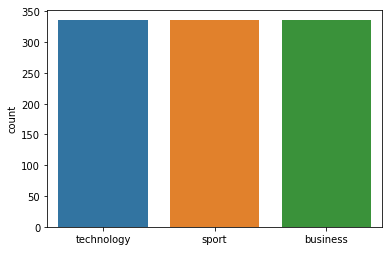



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 133
Class Distribution --> Train data (Fold 4 ):


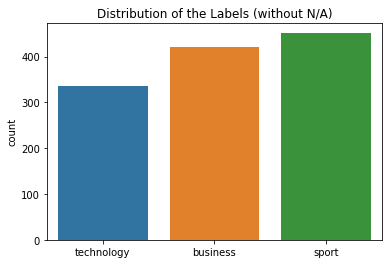

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


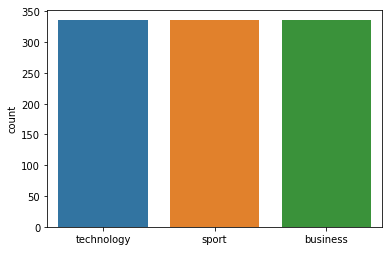



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 133
Class Distribution --> Train data (Fold 5 ):


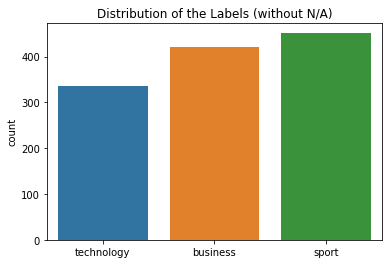

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


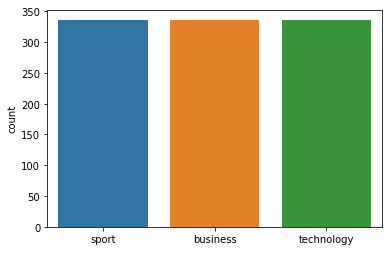



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 133
Class Distribution --> Train data (Fold 6 ):


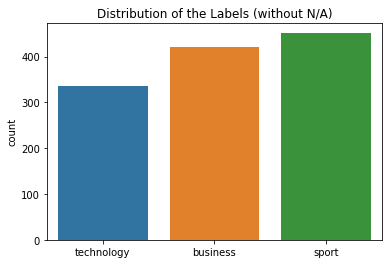

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


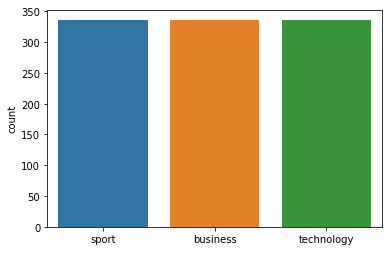



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 133
Class Distribution --> Train data (Fold 7 ):


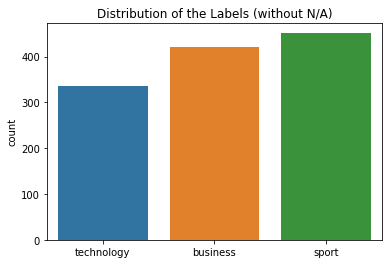

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


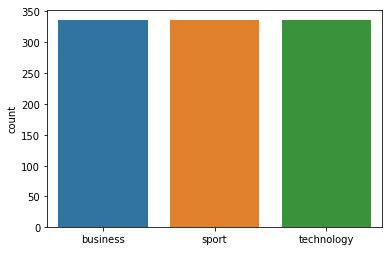



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 133  neighbours): 97.01% (+/- 1.10%)
FOLD 1 Number of neighbors 135
Class Distribution --> Train data (Fold 1 ):


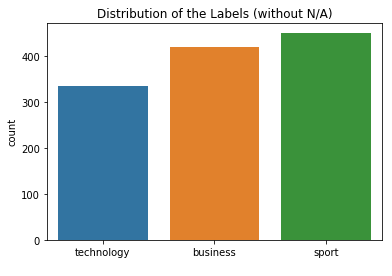

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


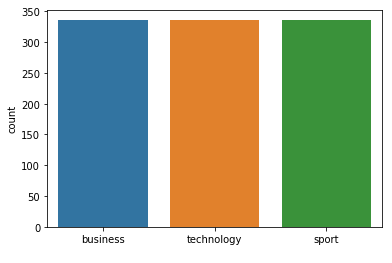



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 135
Class Distribution --> Train data (Fold 2 ):


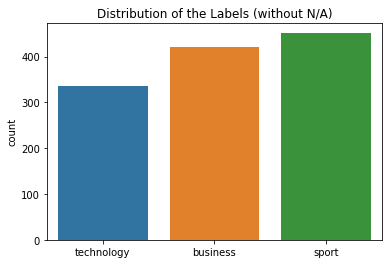

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


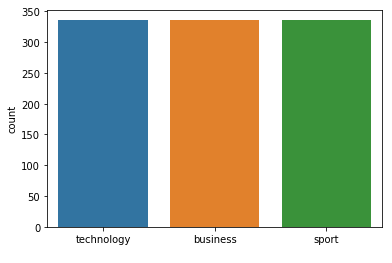



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 135
Class Distribution --> Train data (Fold 3 ):


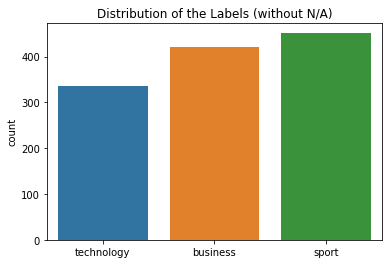

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


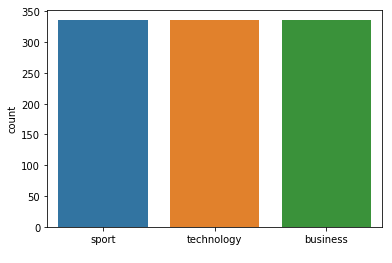



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 135
Class Distribution --> Train data (Fold 4 ):


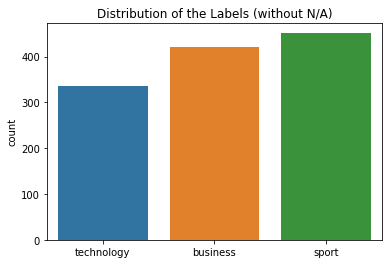

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


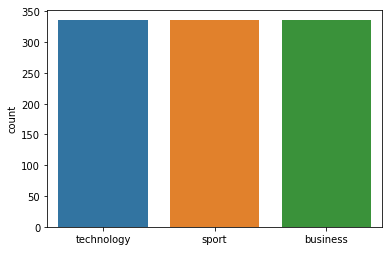



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 135
Class Distribution --> Train data (Fold 5 ):


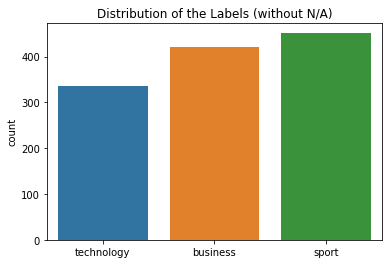

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


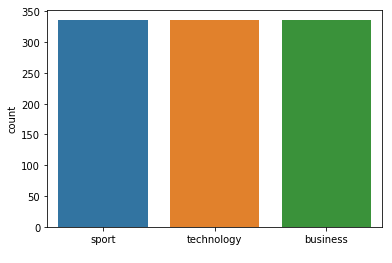



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 135
Class Distribution --> Train data (Fold 6 ):


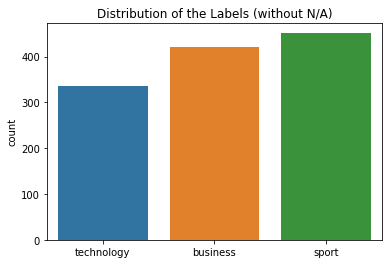

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


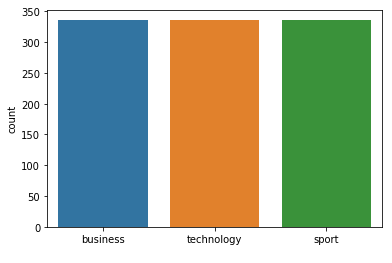



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 135
Class Distribution --> Train data (Fold 7 ):


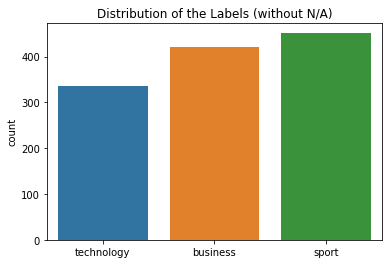

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


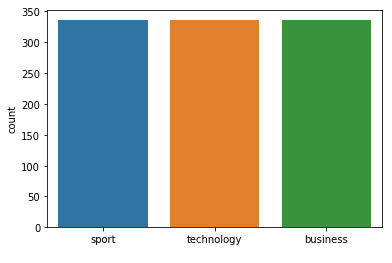



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 135  neighbours): 97.01% (+/- 1.10%)
FOLD 1 Number of neighbors 137
Class Distribution --> Train data (Fold 1 ):


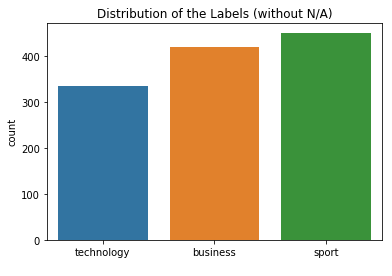

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


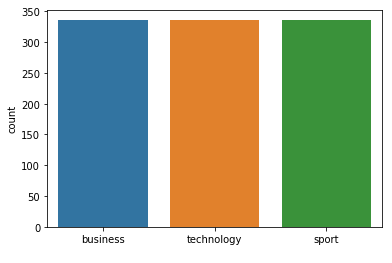



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 137
Class Distribution --> Train data (Fold 2 ):


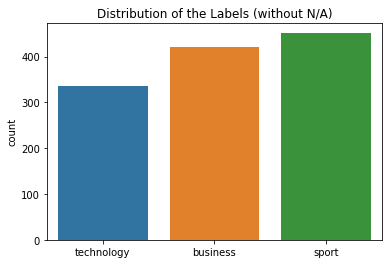

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


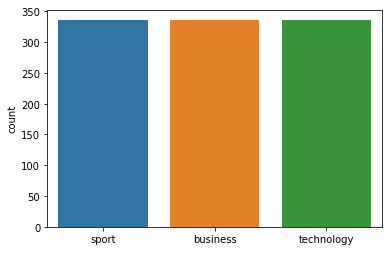



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 137
Class Distribution --> Train data (Fold 3 ):


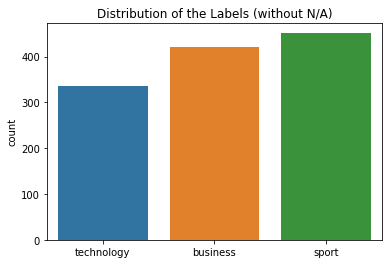

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


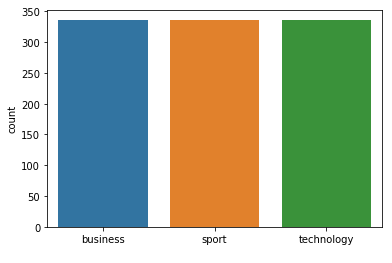



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 137
Class Distribution --> Train data (Fold 4 ):


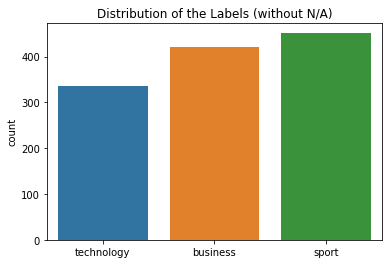

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


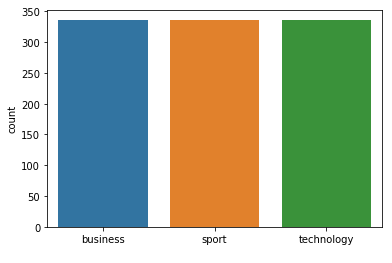



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 137
Class Distribution --> Train data (Fold 5 ):


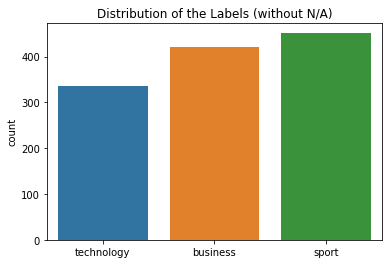

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


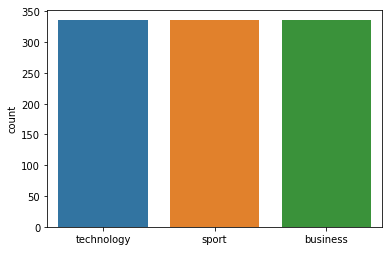



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 137
Class Distribution --> Train data (Fold 6 ):


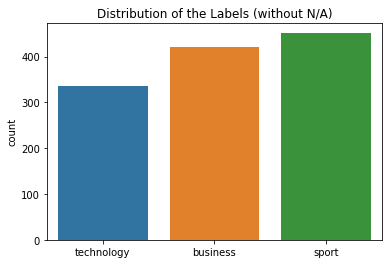

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


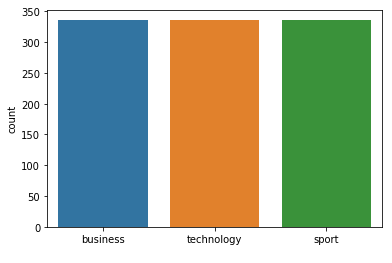



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 137
Class Distribution --> Train data (Fold 7 ):


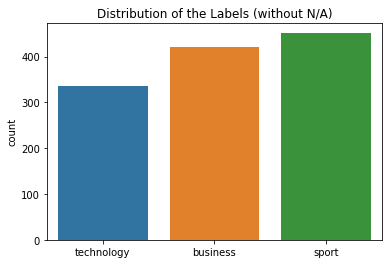

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


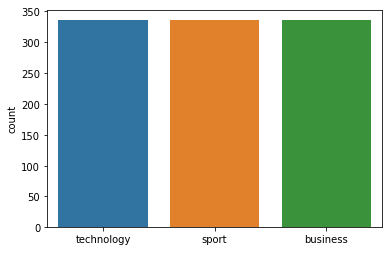



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 137  neighbours): 97.02% (+/- 1.10%)
FOLD 1 Number of neighbors 139
Class Distribution --> Train data (Fold 1 ):


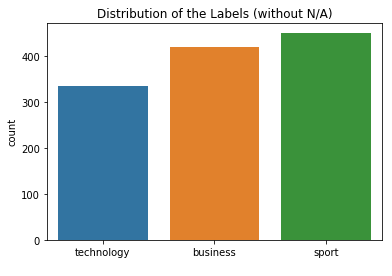

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


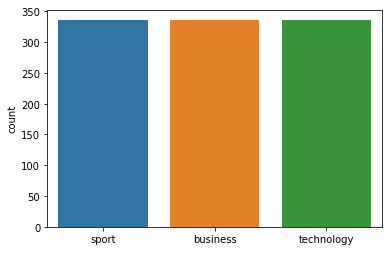



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 139
Class Distribution --> Train data (Fold 2 ):


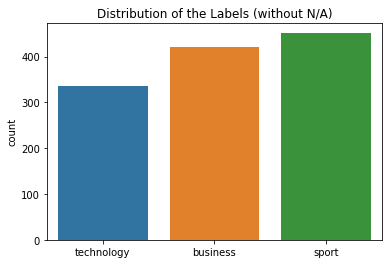

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


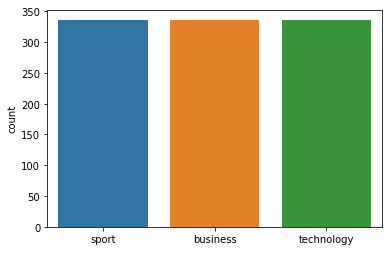



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 139
Class Distribution --> Train data (Fold 3 ):


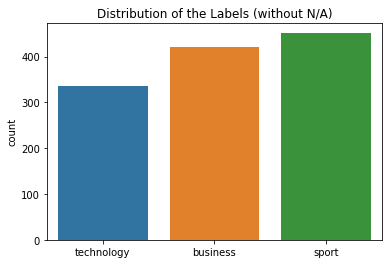

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


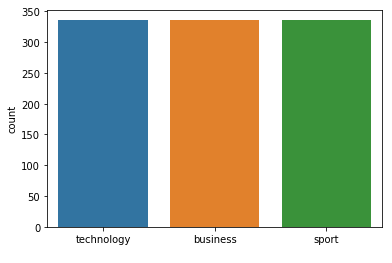



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 139
Class Distribution --> Train data (Fold 4 ):


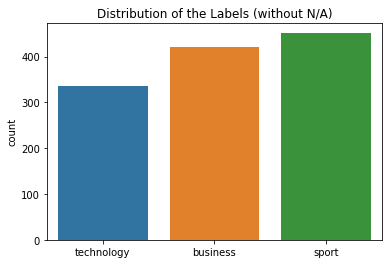

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


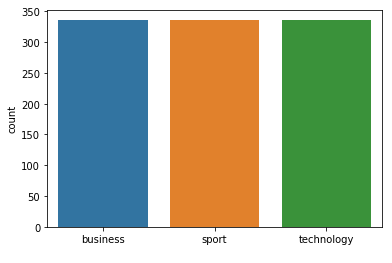



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 139
Class Distribution --> Train data (Fold 5 ):


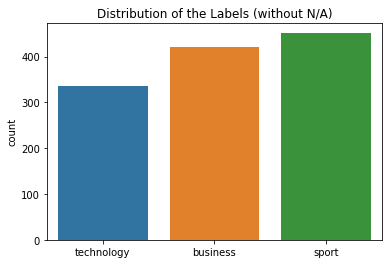

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


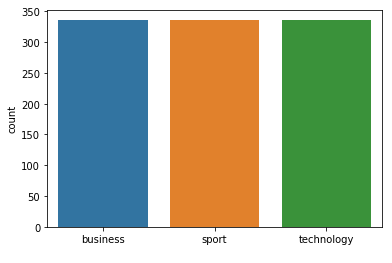



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 139
Class Distribution --> Train data (Fold 6 ):


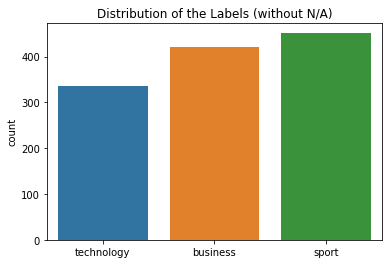

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


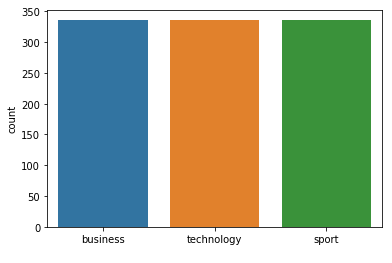



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 139
Class Distribution --> Train data (Fold 7 ):


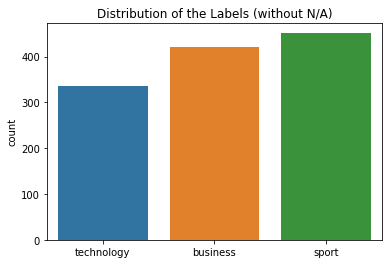

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


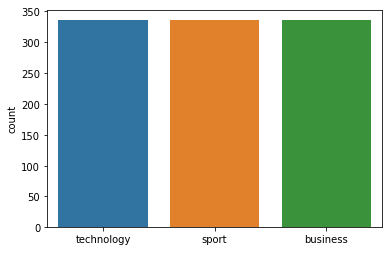



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 139  neighbours): 97.02% (+/- 1.10%)
FOLD 1 Number of neighbors 141
Class Distribution --> Train data (Fold 1 ):


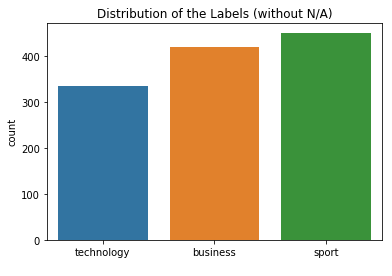

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


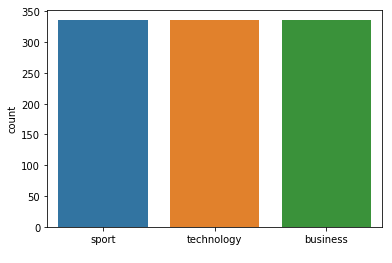



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 141
Class Distribution --> Train data (Fold 2 ):


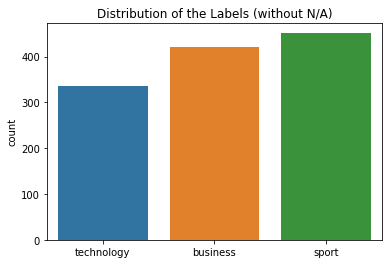

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


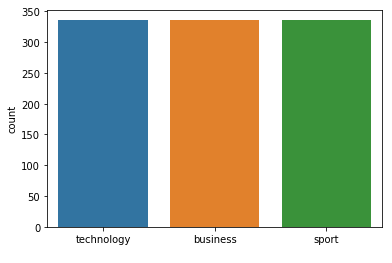



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 141
Class Distribution --> Train data (Fold 3 ):


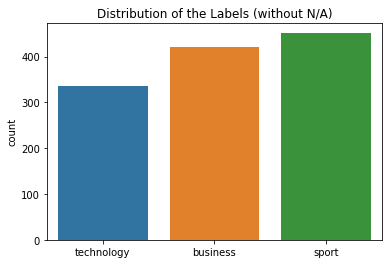

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


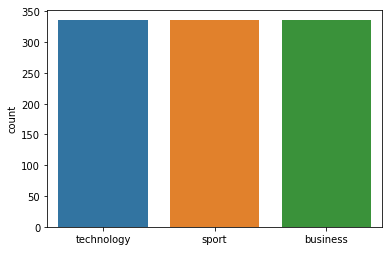



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 141
Class Distribution --> Train data (Fold 4 ):


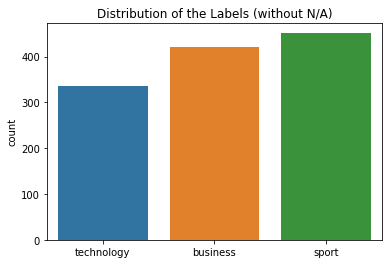

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


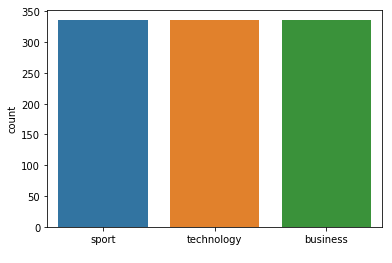



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 141
Class Distribution --> Train data (Fold 5 ):


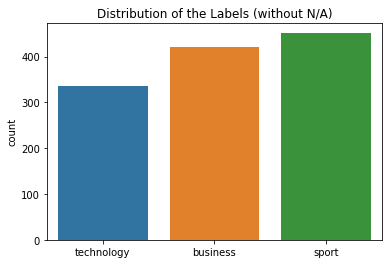

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


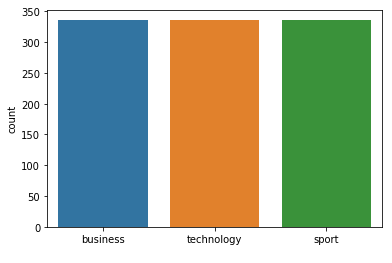



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 141
Class Distribution --> Train data (Fold 6 ):


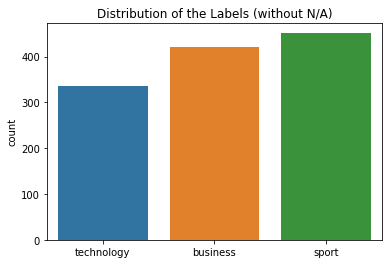

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


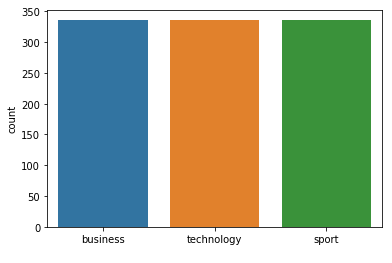



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 141
Class Distribution --> Train data (Fold 7 ):


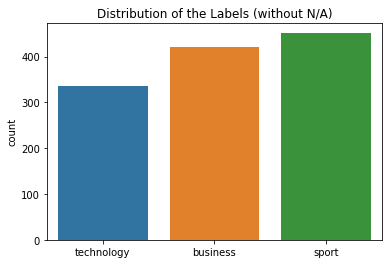

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


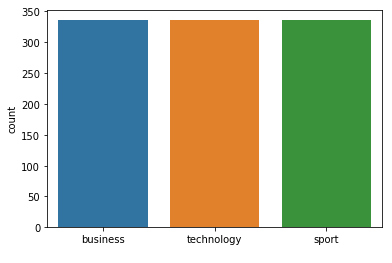



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 141  neighbours): 97.02% (+/- 1.09%)
FOLD 1 Number of neighbors 143
Class Distribution --> Train data (Fold 1 ):


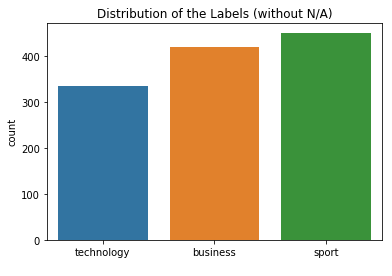

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


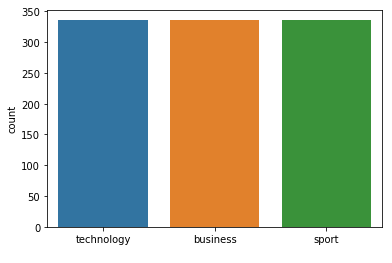



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 143
Class Distribution --> Train data (Fold 2 ):


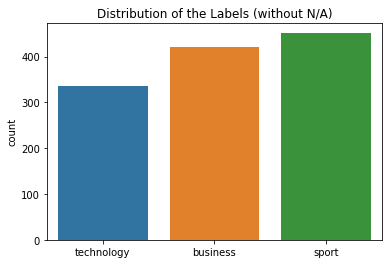

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


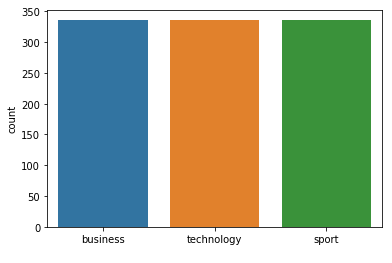



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 143
Class Distribution --> Train data (Fold 3 ):


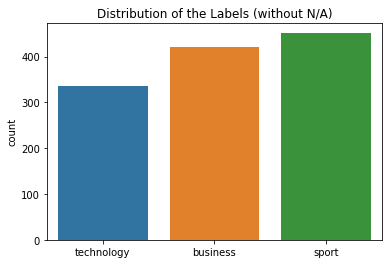

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


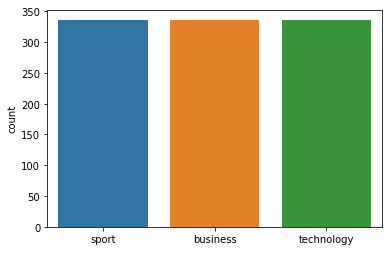



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 143
Class Distribution --> Train data (Fold 4 ):


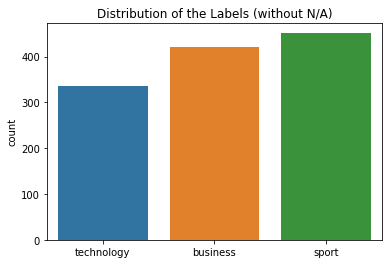

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


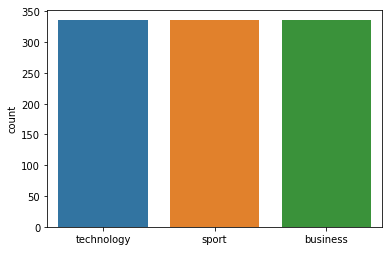



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 143
Class Distribution --> Train data (Fold 5 ):


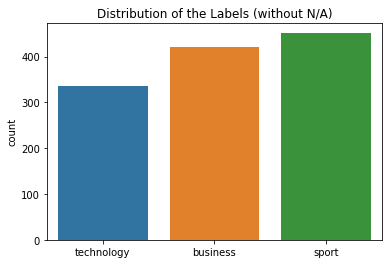

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


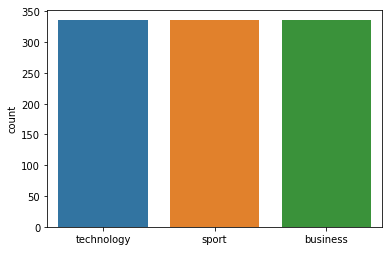



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 143
Class Distribution --> Train data (Fold 6 ):


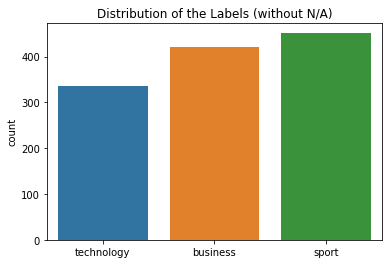

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


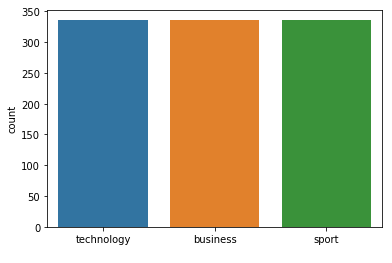



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 143
Class Distribution --> Train data (Fold 7 ):


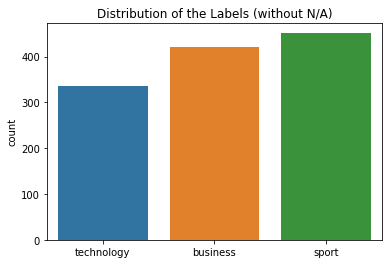

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


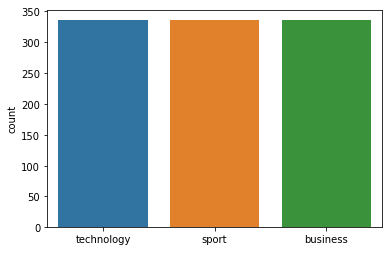



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  2 53]]


 Model accuracy (for 143  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 145
Class Distribution --> Train data (Fold 1 ):


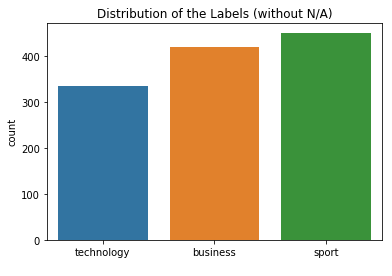

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


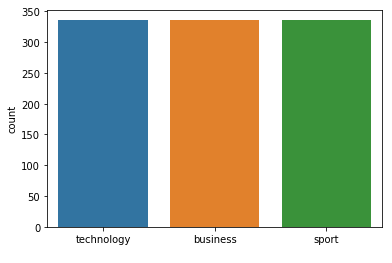



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 145
Class Distribution --> Train data (Fold 2 ):


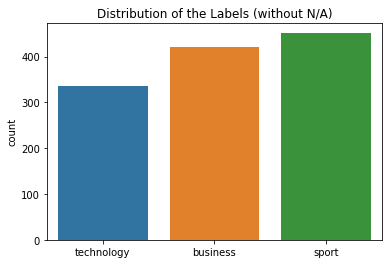

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


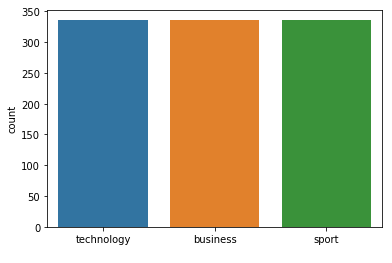



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 145
Class Distribution --> Train data (Fold 3 ):


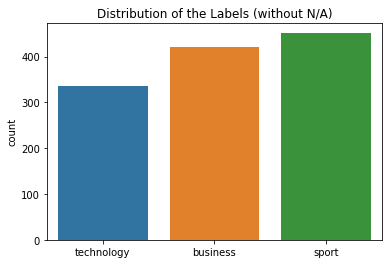

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


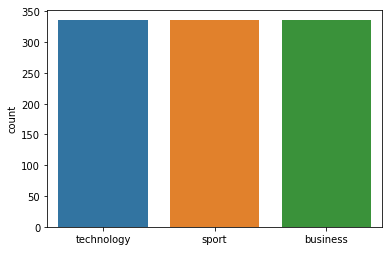



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 145
Class Distribution --> Train data (Fold 4 ):


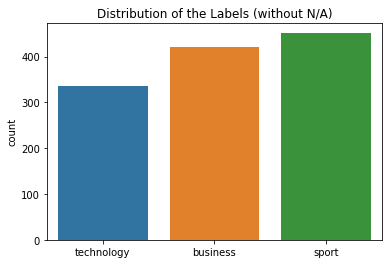

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


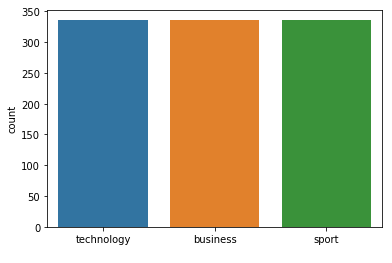



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 145
Class Distribution --> Train data (Fold 5 ):


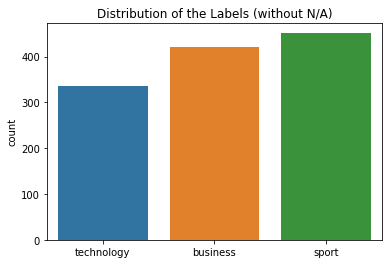

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


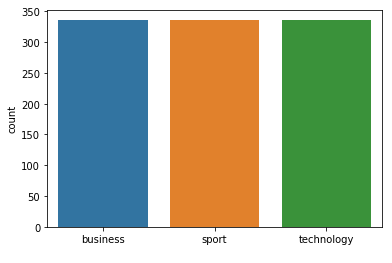



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 145
Class Distribution --> Train data (Fold 6 ):


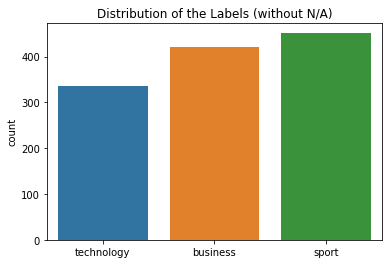

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


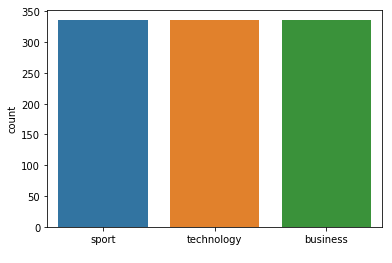



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 145
Class Distribution --> Train data (Fold 7 ):


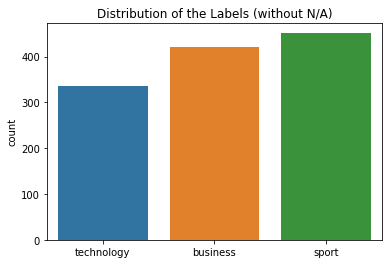

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


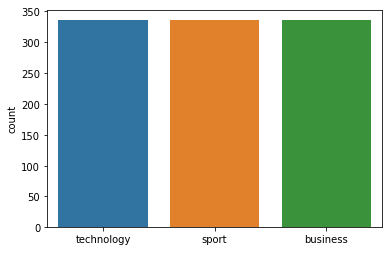



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 145  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 147
Class Distribution --> Train data (Fold 1 ):


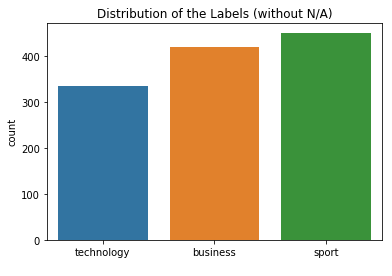

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


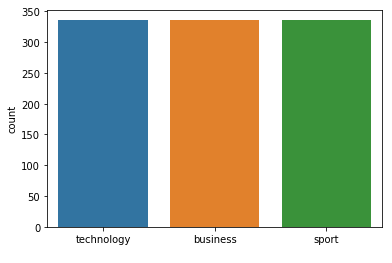



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 147
Class Distribution --> Train data (Fold 2 ):


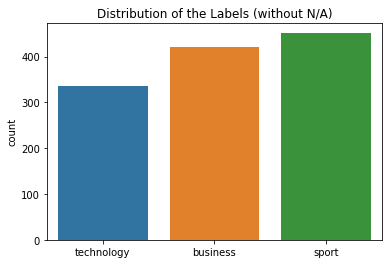

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


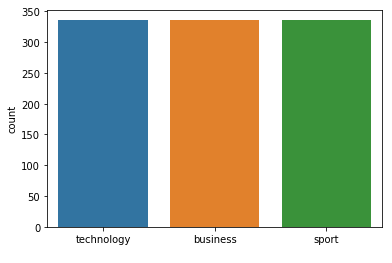



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 147
Class Distribution --> Train data (Fold 3 ):


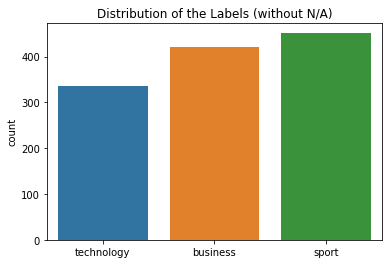

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


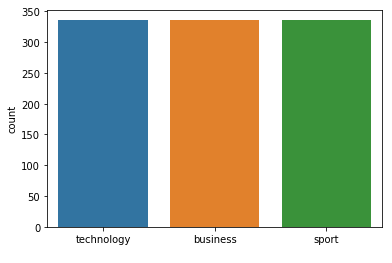



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 147
Class Distribution --> Train data (Fold 4 ):


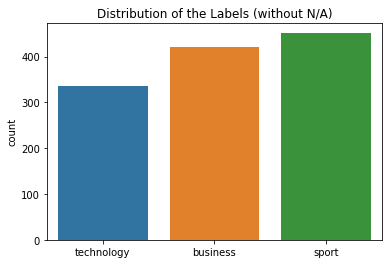

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


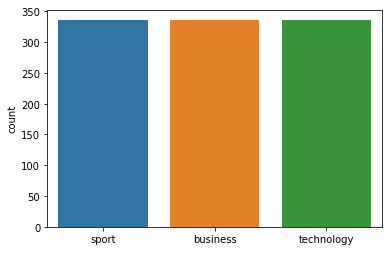



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 147
Class Distribution --> Train data (Fold 5 ):


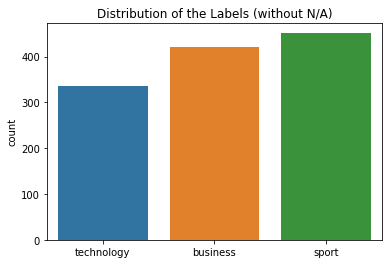

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


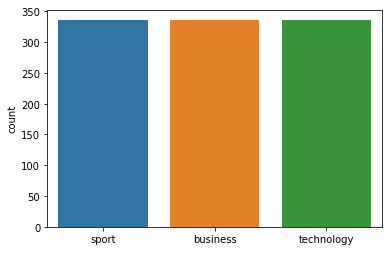



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 147
Class Distribution --> Train data (Fold 6 ):


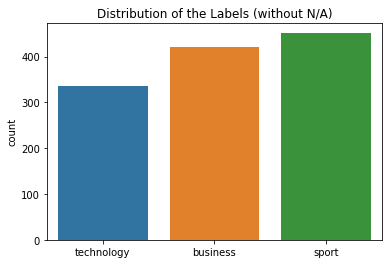

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


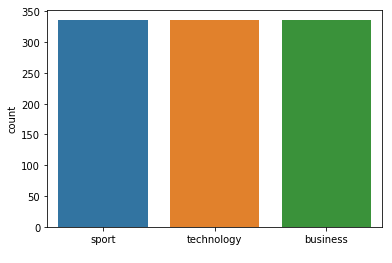



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 147
Class Distribution --> Train data (Fold 7 ):


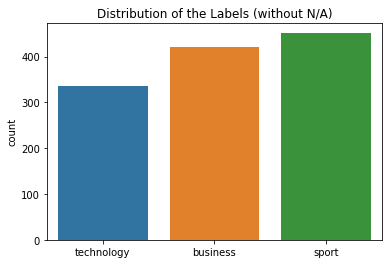

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


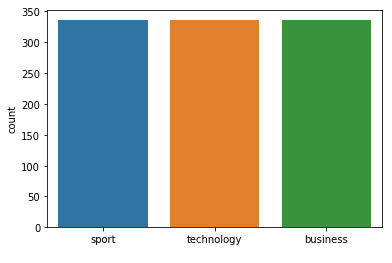



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 147  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 149
Class Distribution --> Train data (Fold 1 ):


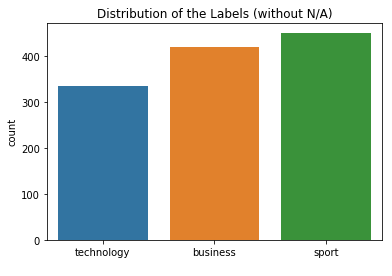

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


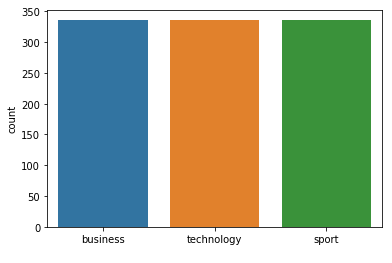



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 149
Class Distribution --> Train data (Fold 2 ):


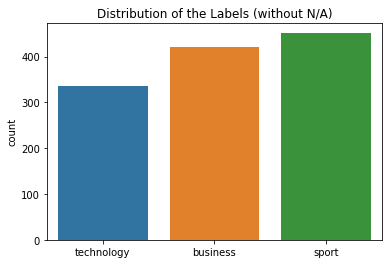

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


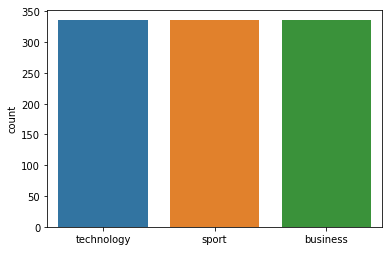



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 149
Class Distribution --> Train data (Fold 3 ):


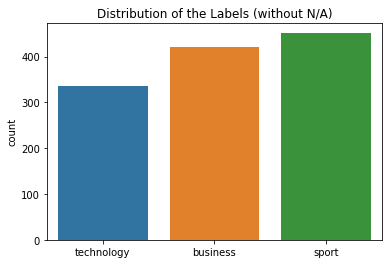

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


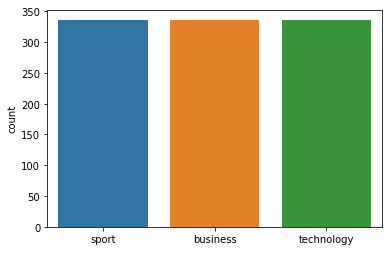



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 149
Class Distribution --> Train data (Fold 4 ):


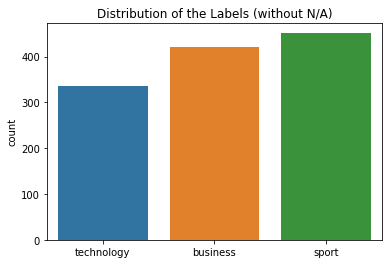

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


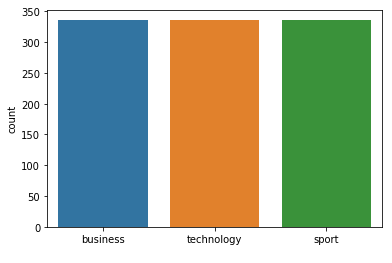



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 149
Class Distribution --> Train data (Fold 5 ):


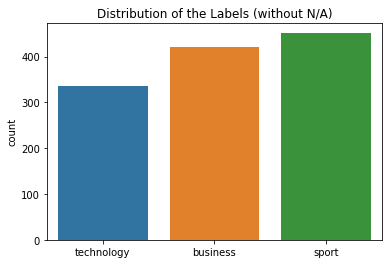

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


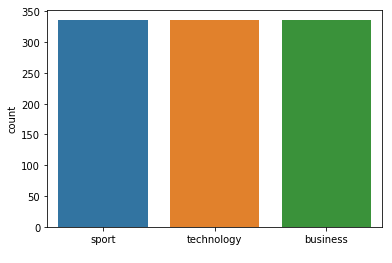



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 149
Class Distribution --> Train data (Fold 6 ):


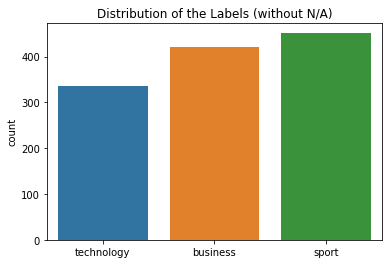

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


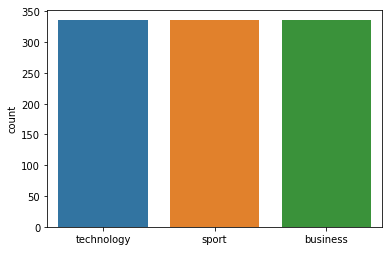



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 149
Class Distribution --> Train data (Fold 7 ):


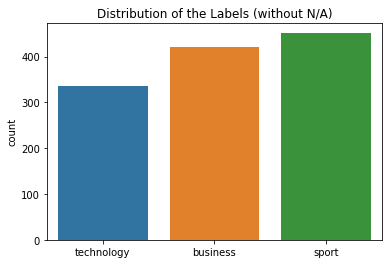

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


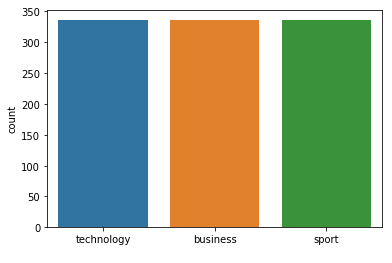



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 149  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 151
Class Distribution --> Train data (Fold 1 ):


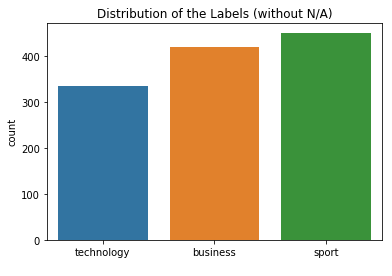

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


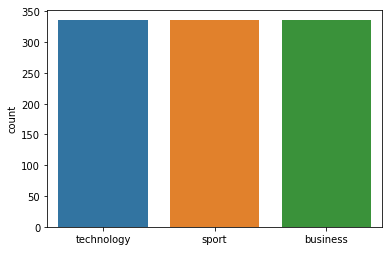



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 151
Class Distribution --> Train data (Fold 2 ):


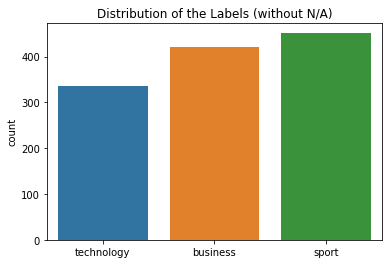

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


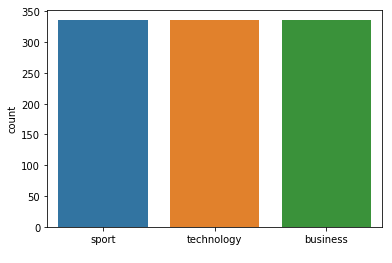



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 151
Class Distribution --> Train data (Fold 3 ):


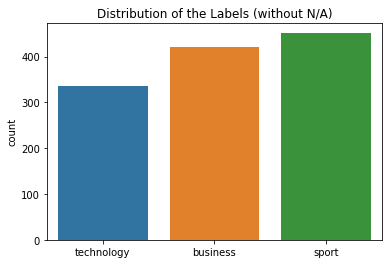

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


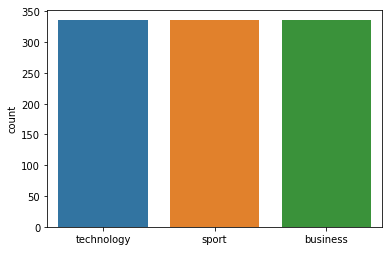



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 151
Class Distribution --> Train data (Fold 4 ):


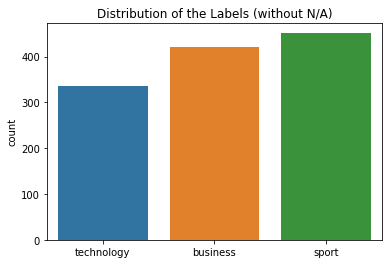

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


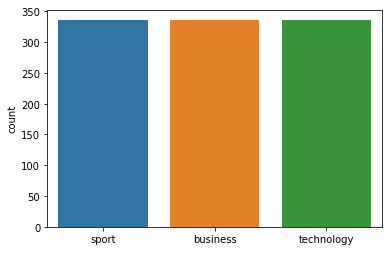



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 151
Class Distribution --> Train data (Fold 5 ):


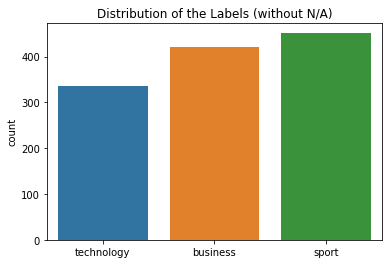

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


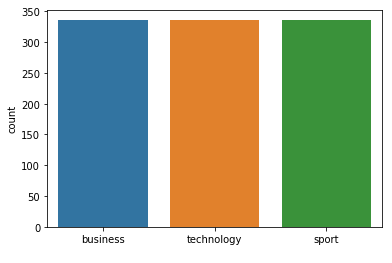



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 151
Class Distribution --> Train data (Fold 6 ):


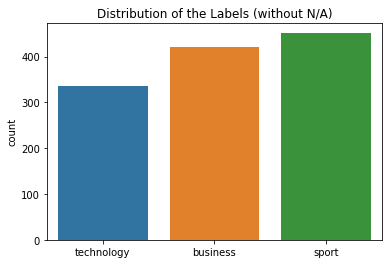

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


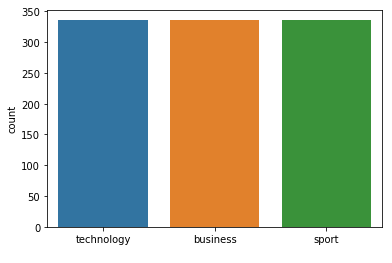



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 151
Class Distribution --> Train data (Fold 7 ):


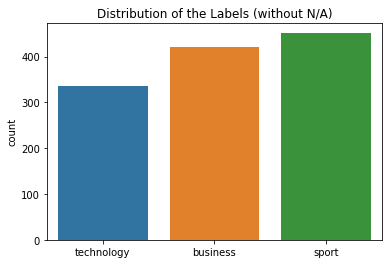

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


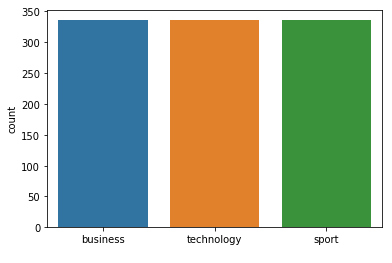



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 151  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 153
Class Distribution --> Train data (Fold 1 ):


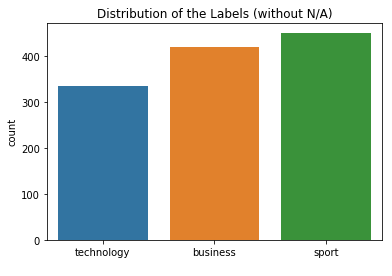

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


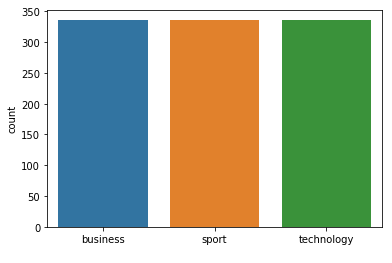



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 153
Class Distribution --> Train data (Fold 2 ):


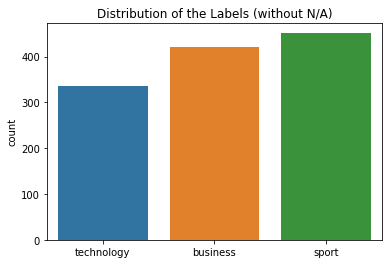

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


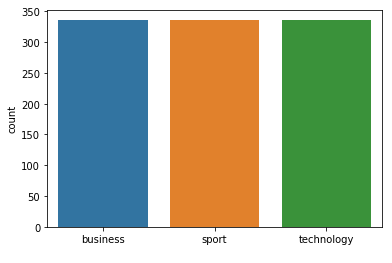



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 153
Class Distribution --> Train data (Fold 3 ):


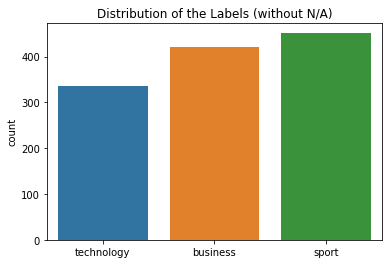

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


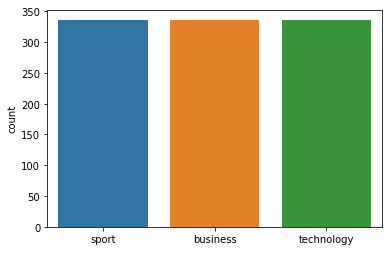



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 153
Class Distribution --> Train data (Fold 4 ):


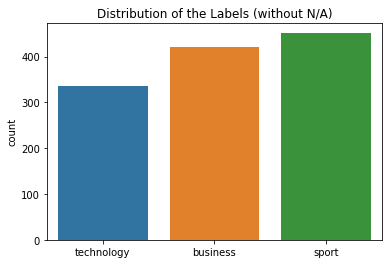

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


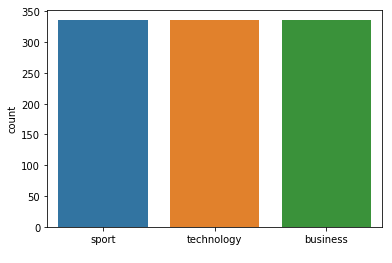



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 153
Class Distribution --> Train data (Fold 5 ):


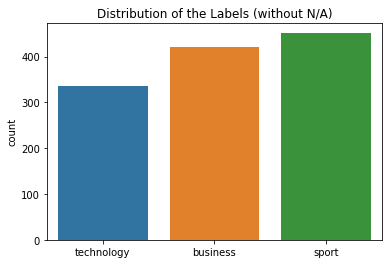

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


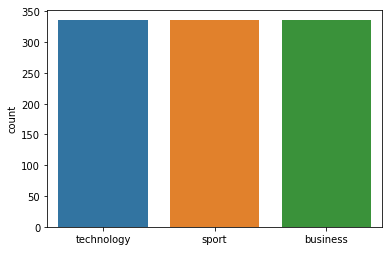



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 153
Class Distribution --> Train data (Fold 6 ):


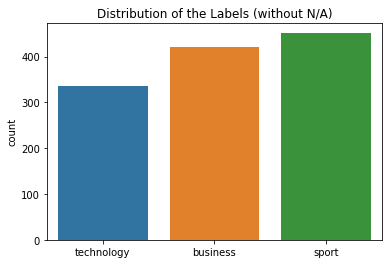

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


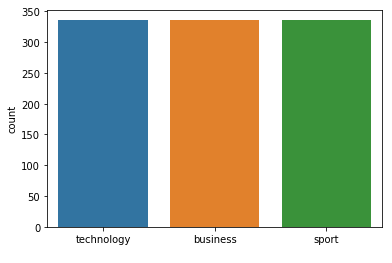



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 153
Class Distribution --> Train data (Fold 7 ):


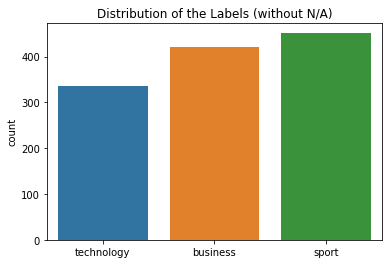

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


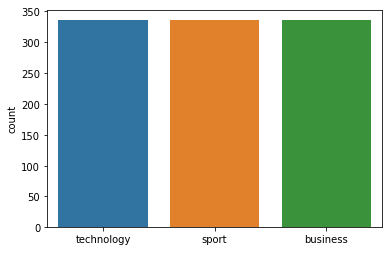



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 153  neighbours): 97.03% (+/- 1.10%)
FOLD 1 Number of neighbors 155
Class Distribution --> Train data (Fold 1 ):


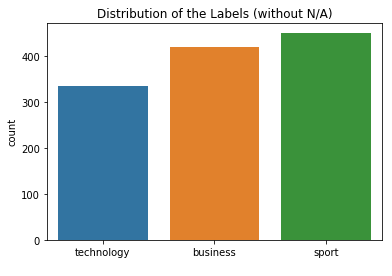

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


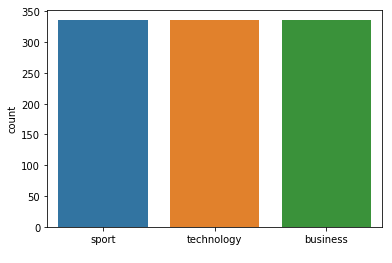



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 155
Class Distribution --> Train data (Fold 2 ):


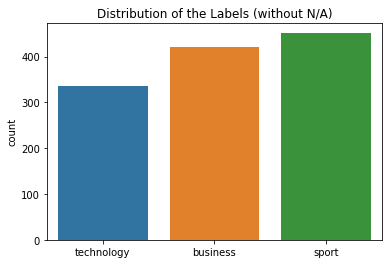

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


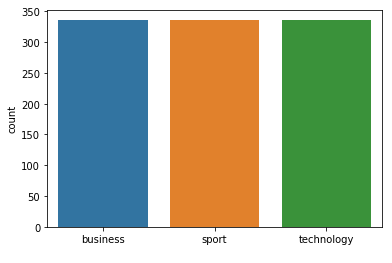



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 155
Class Distribution --> Train data (Fold 3 ):


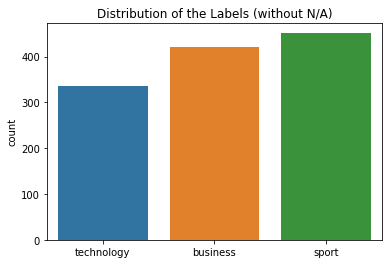

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


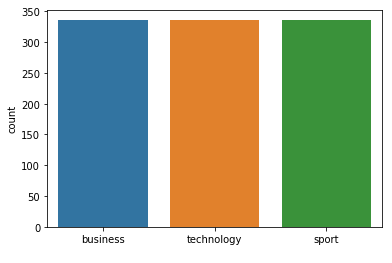



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 155
Class Distribution --> Train data (Fold 4 ):


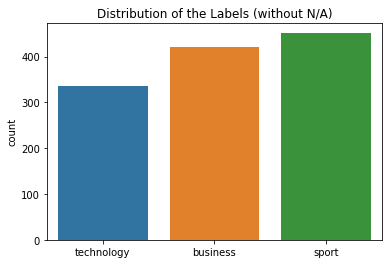

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


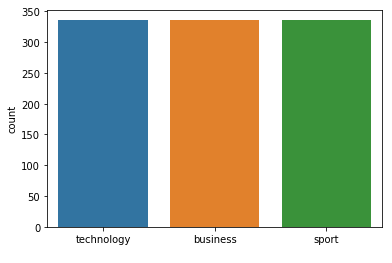



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 155
Class Distribution --> Train data (Fold 5 ):


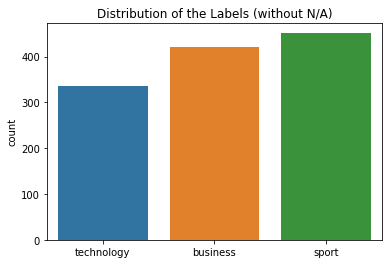

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


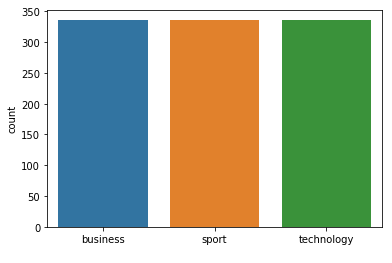



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 155
Class Distribution --> Train data (Fold 6 ):


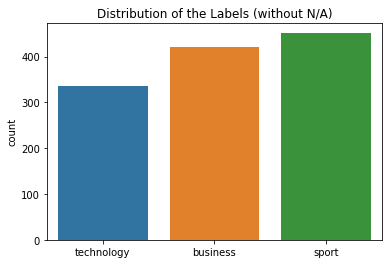

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


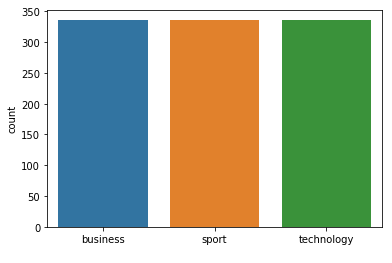



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 155
Class Distribution --> Train data (Fold 7 ):


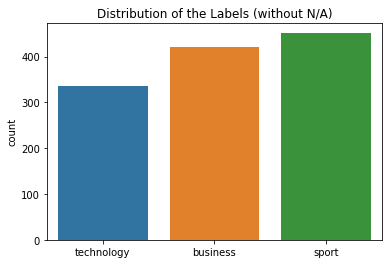

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


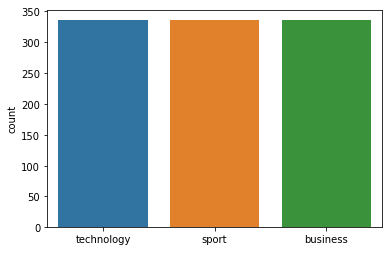



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 155  neighbours): 97.04% (+/- 1.09%)
FOLD 1 Number of neighbors 157
Class Distribution --> Train data (Fold 1 ):


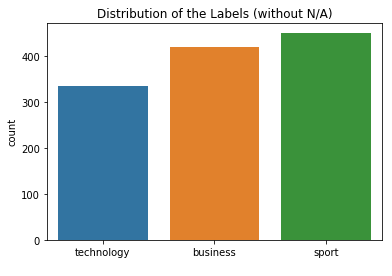

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


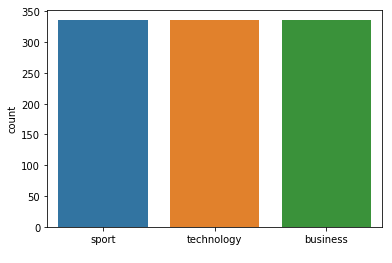



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 157
Class Distribution --> Train data (Fold 2 ):


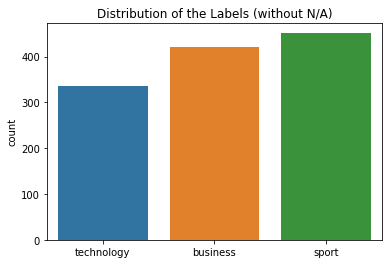

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


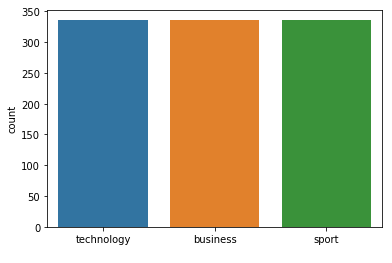



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 157
Class Distribution --> Train data (Fold 3 ):


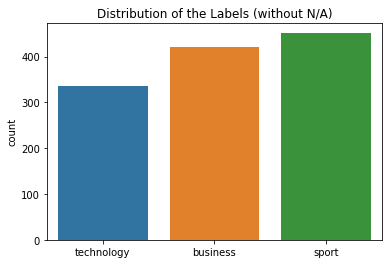

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


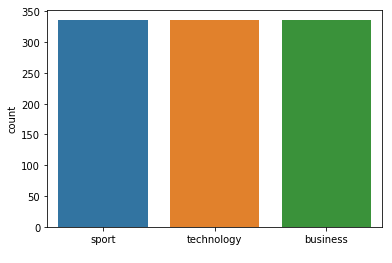



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 157
Class Distribution --> Train data (Fold 4 ):


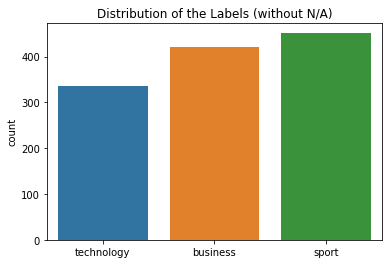

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


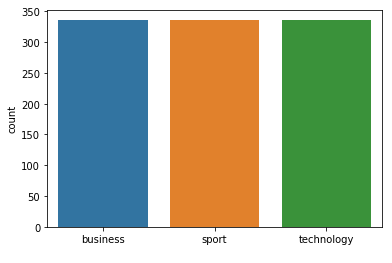



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 157
Class Distribution --> Train data (Fold 5 ):


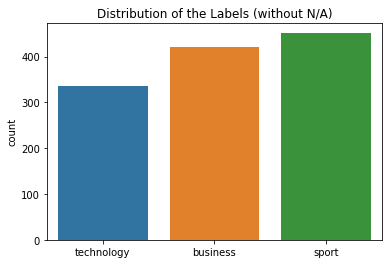

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


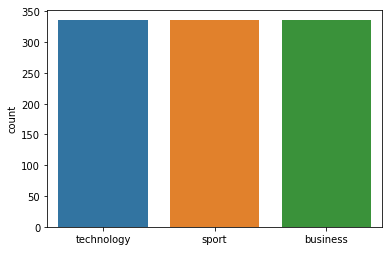



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 157
Class Distribution --> Train data (Fold 6 ):


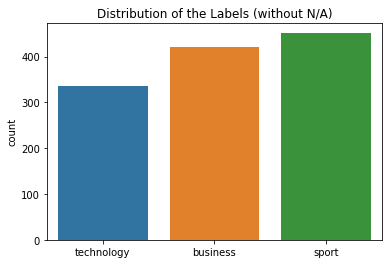

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


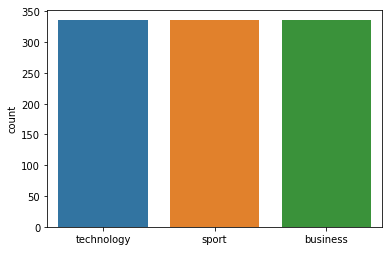



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 157
Class Distribution --> Train data (Fold 7 ):


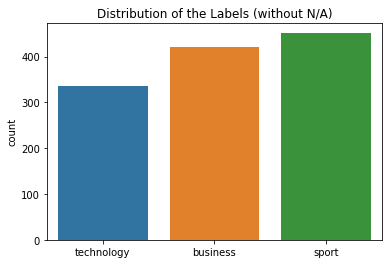

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


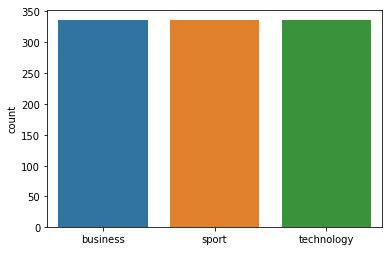



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 157  neighbours): 97.04% (+/- 1.10%)
FOLD 1 Number of neighbors 159
Class Distribution --> Train data (Fold 1 ):


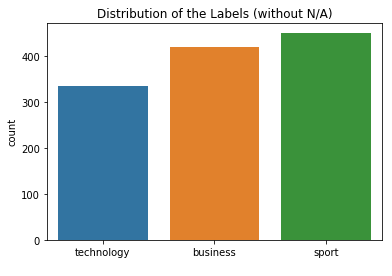

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


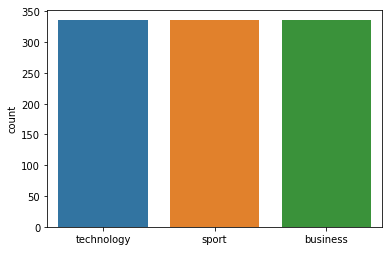



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.99      0.97      0.98        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 159
Class Distribution --> Train data (Fold 2 ):


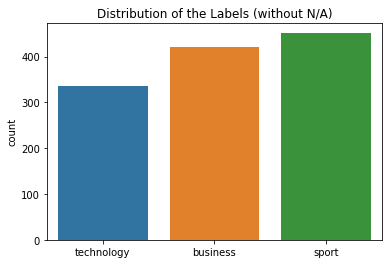

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


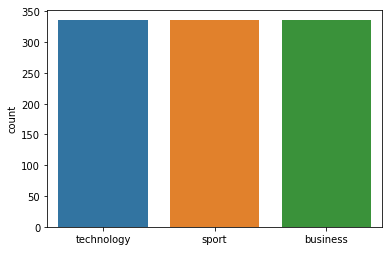



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 159
Class Distribution --> Train data (Fold 3 ):


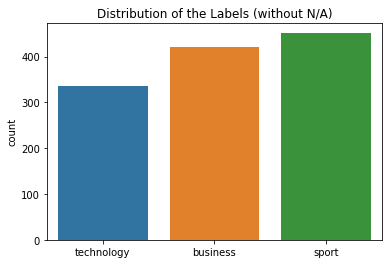

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


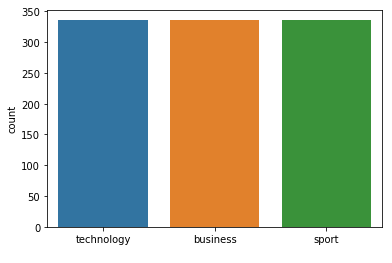



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 159
Class Distribution --> Train data (Fold 4 ):


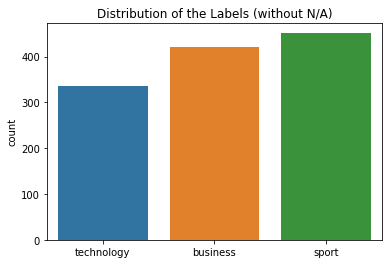

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


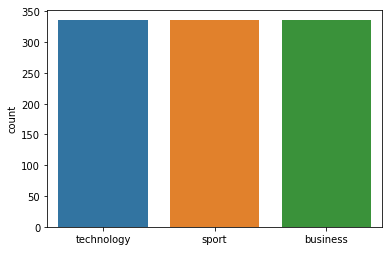



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 159
Class Distribution --> Train data (Fold 5 ):


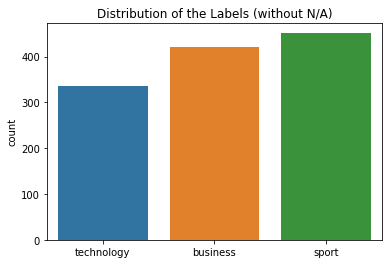

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


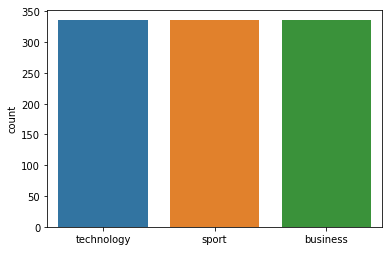



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 159
Class Distribution --> Train data (Fold 6 ):


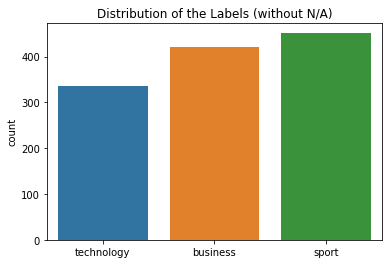

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


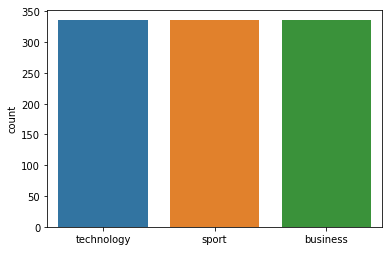



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  3 53]]
FOLD 7 Number of neighbors 159
Class Distribution --> Train data (Fold 7 ):


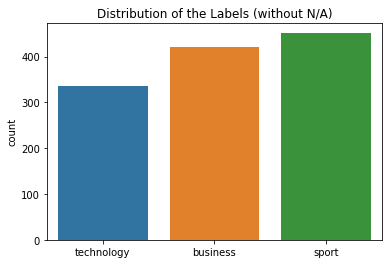

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


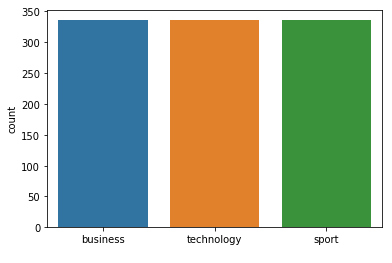



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 159  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 161
Class Distribution --> Train data (Fold 1 ):


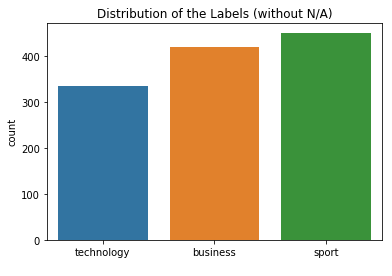

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


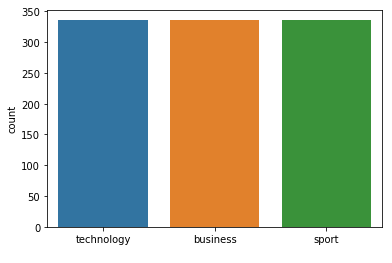



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 161
Class Distribution --> Train data (Fold 2 ):


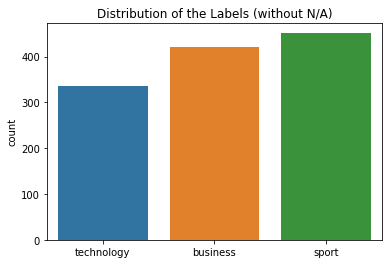

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


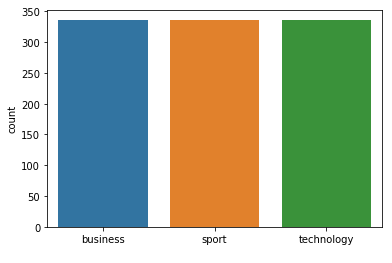



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 161
Class Distribution --> Train data (Fold 3 ):


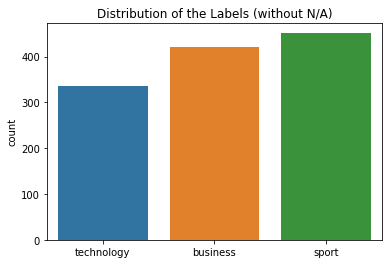

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


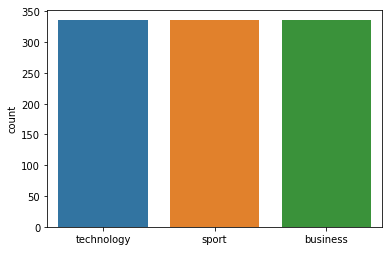



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.93      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 161
Class Distribution --> Train data (Fold 4 ):


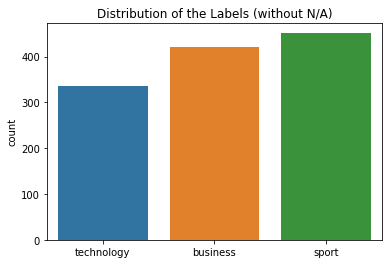

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


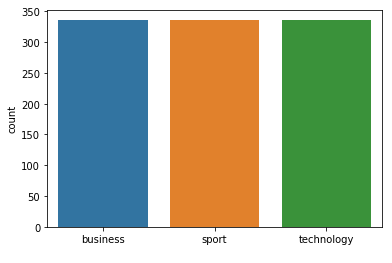



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 161
Class Distribution --> Train data (Fold 5 ):


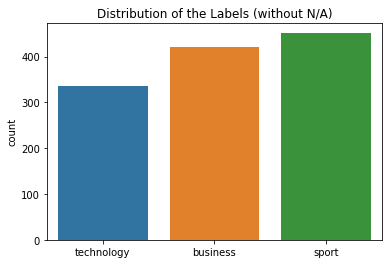

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


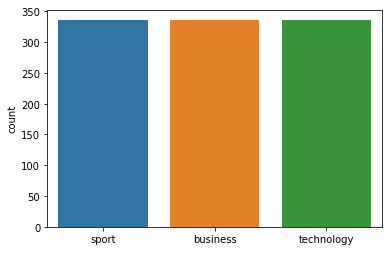



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 161
Class Distribution --> Train data (Fold 6 ):


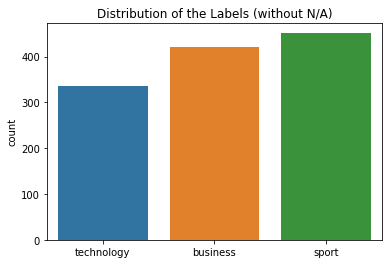

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


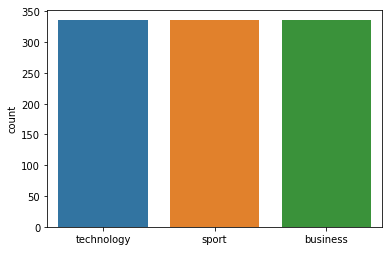



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 161
Class Distribution --> Train data (Fold 7 ):


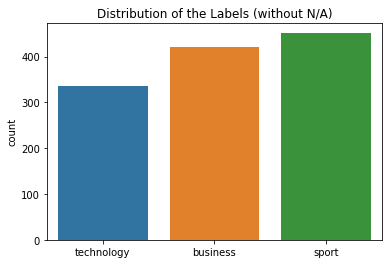

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


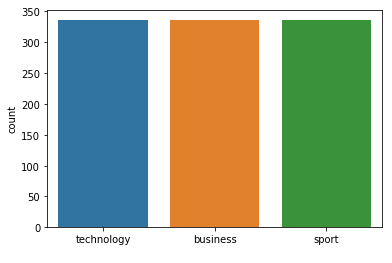



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 161  neighbours): 97.03% (+/- 1.10%)
FOLD 1 Number of neighbors 163
Class Distribution --> Train data (Fold 1 ):


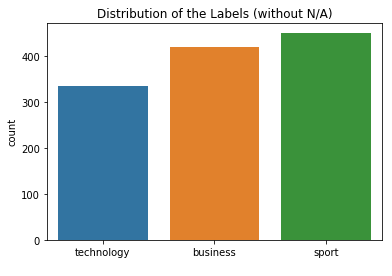

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


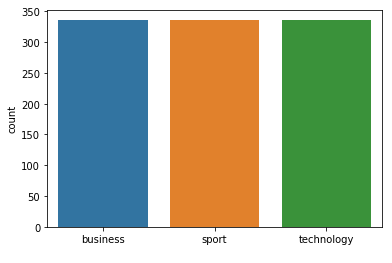



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 163
Class Distribution --> Train data (Fold 2 ):


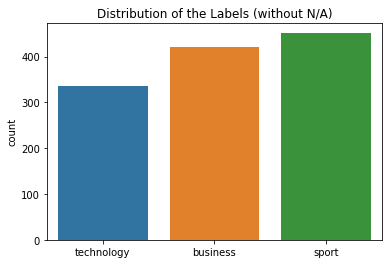

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


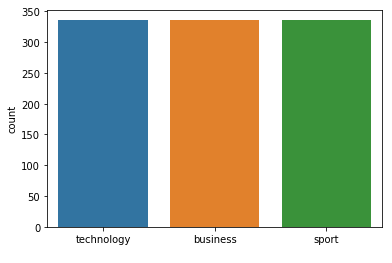



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 163
Class Distribution --> Train data (Fold 3 ):


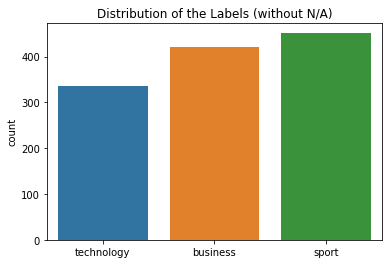

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


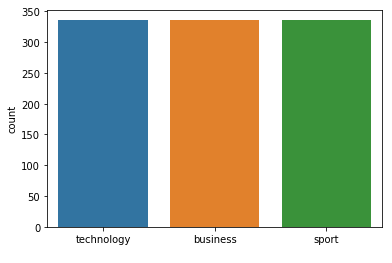



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 163
Class Distribution --> Train data (Fold 4 ):


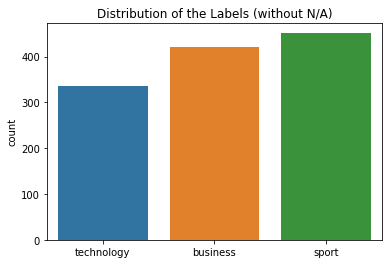

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


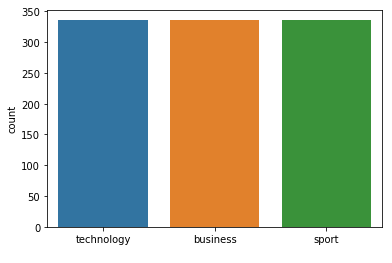



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 163
Class Distribution --> Train data (Fold 5 ):


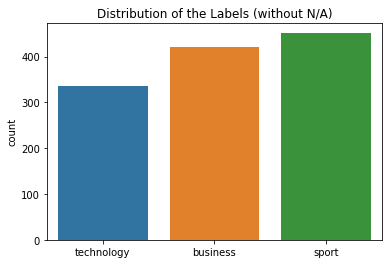

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


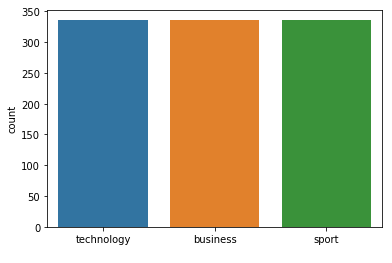



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 163
Class Distribution --> Train data (Fold 6 ):


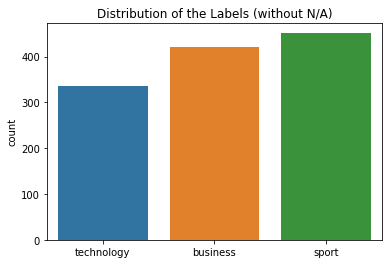

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


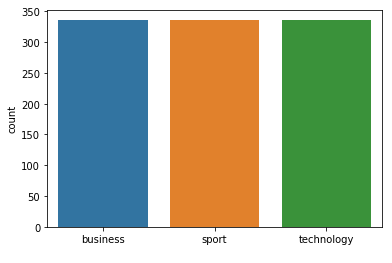



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 163
Class Distribution --> Train data (Fold 7 ):


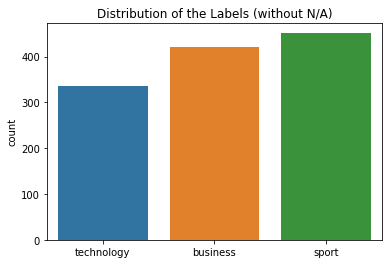

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


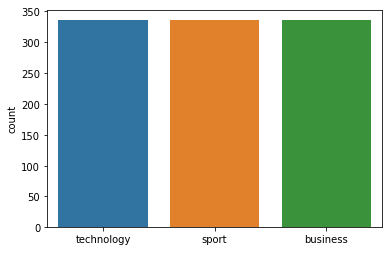



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 163  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 165
Class Distribution --> Train data (Fold 1 ):


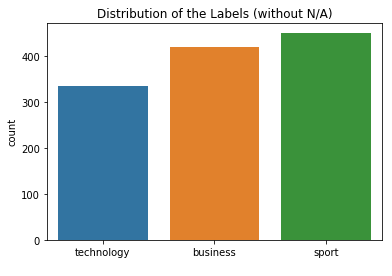

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


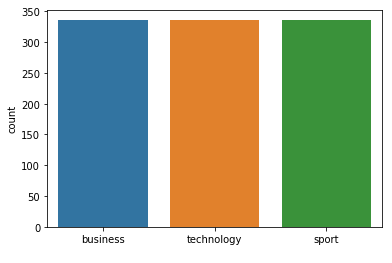



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 165
Class Distribution --> Train data (Fold 2 ):


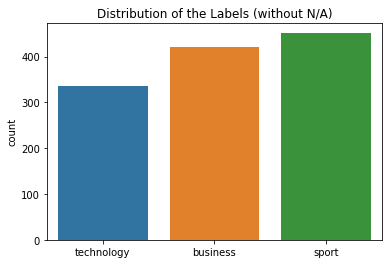

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


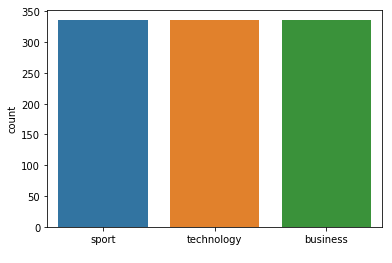



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 165
Class Distribution --> Train data (Fold 3 ):


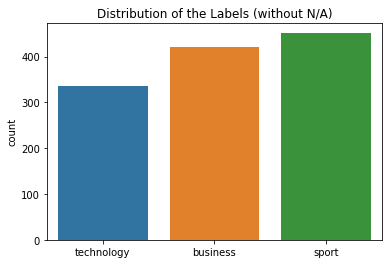

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


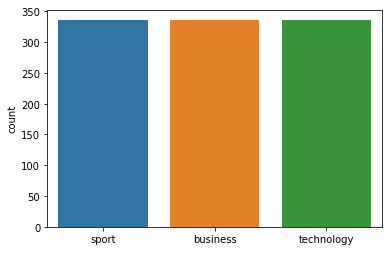



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 165
Class Distribution --> Train data (Fold 4 ):


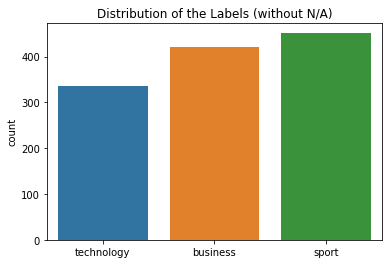

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


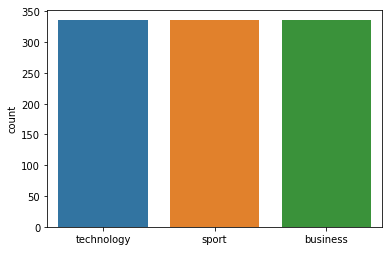



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 165
Class Distribution --> Train data (Fold 5 ):


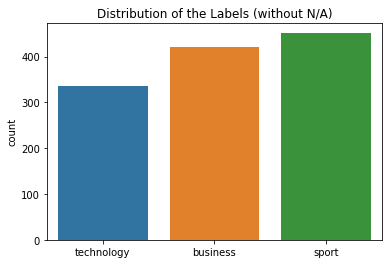

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


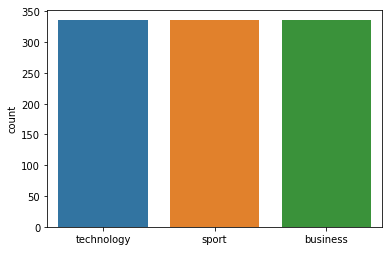



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 165
Class Distribution --> Train data (Fold 6 ):


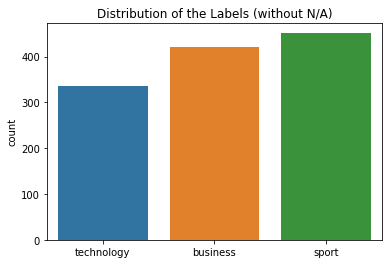

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


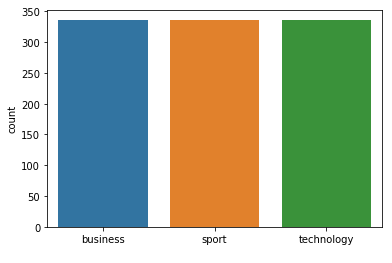



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  3 52]]
FOLD 7 Number of neighbors 165
Class Distribution --> Train data (Fold 7 ):


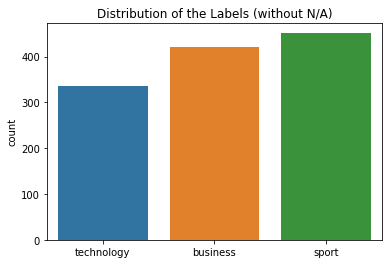

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


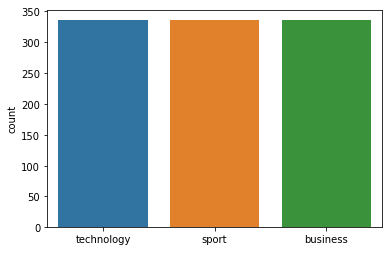



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 165  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 167
Class Distribution --> Train data (Fold 1 ):


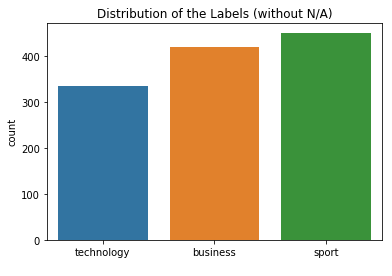

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


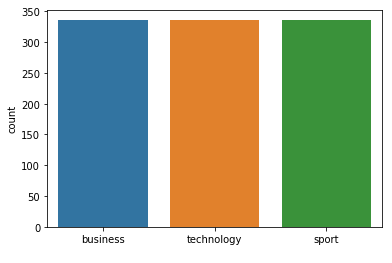



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 167
Class Distribution --> Train data (Fold 2 ):


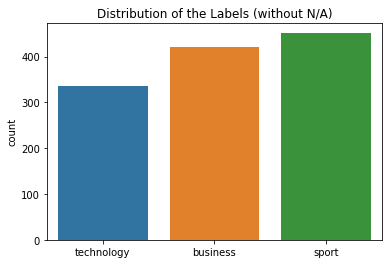

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


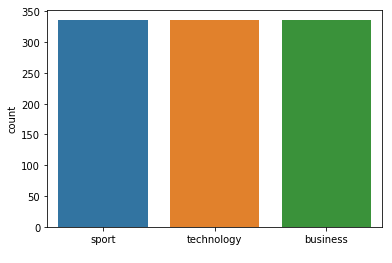



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 167
Class Distribution --> Train data (Fold 3 ):


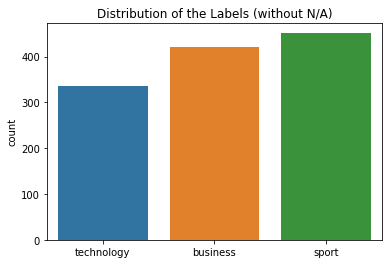

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


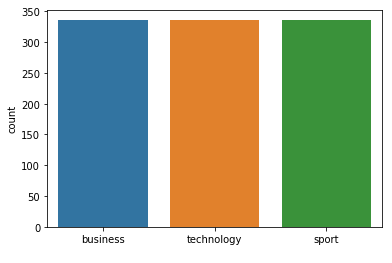



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 167
Class Distribution --> Train data (Fold 4 ):


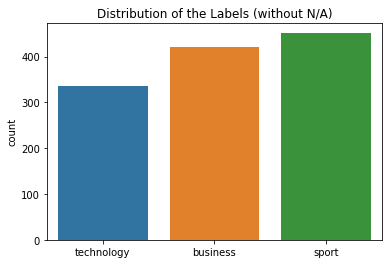

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


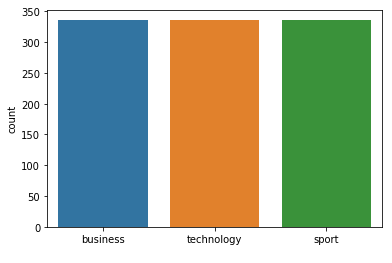



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 167
Class Distribution --> Train data (Fold 5 ):


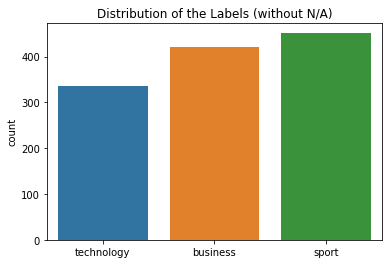

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


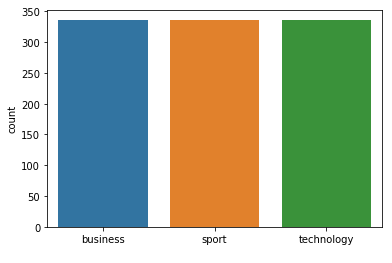



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 167
Class Distribution --> Train data (Fold 6 ):


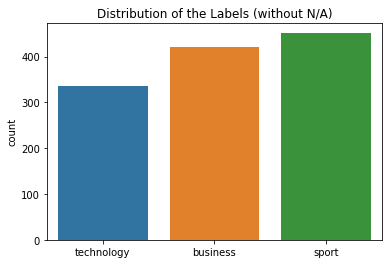

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


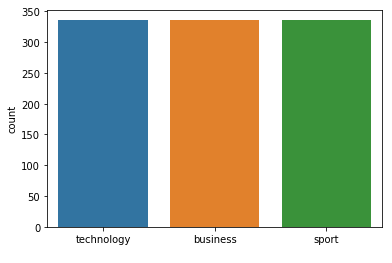



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 167
Class Distribution --> Train data (Fold 7 ):


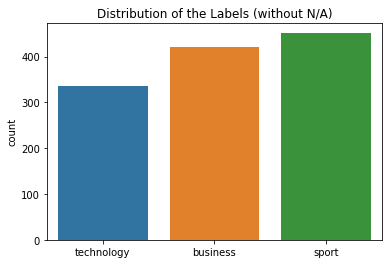

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


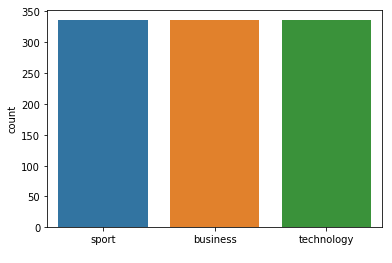



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 167  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 169
Class Distribution --> Train data (Fold 1 ):


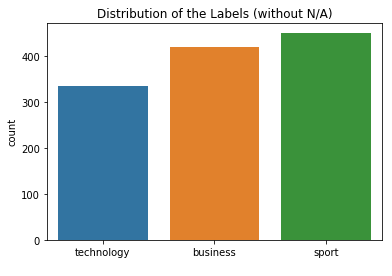

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


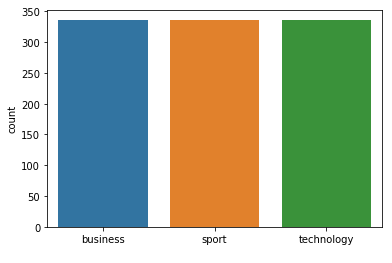



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 169
Class Distribution --> Train data (Fold 2 ):


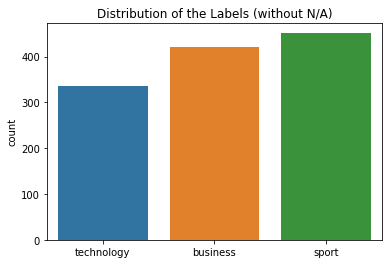

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


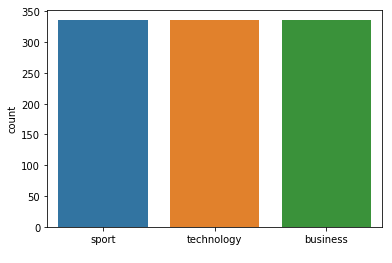



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 169
Class Distribution --> Train data (Fold 3 ):


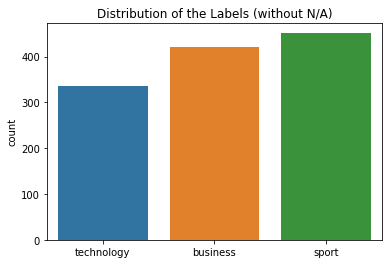

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


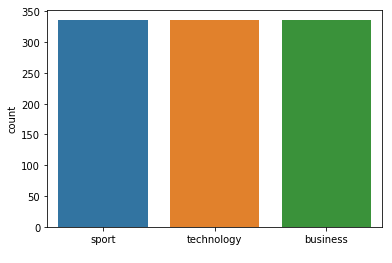



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 169
Class Distribution --> Train data (Fold 4 ):


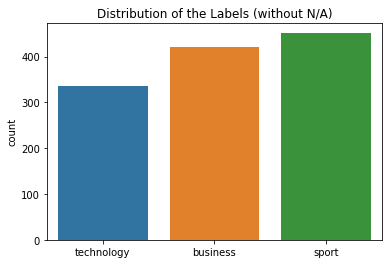

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


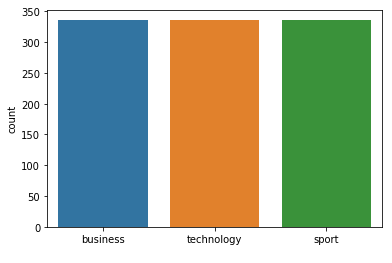



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 169
Class Distribution --> Train data (Fold 5 ):


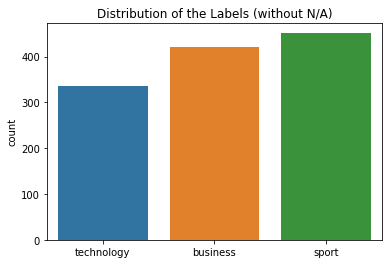

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


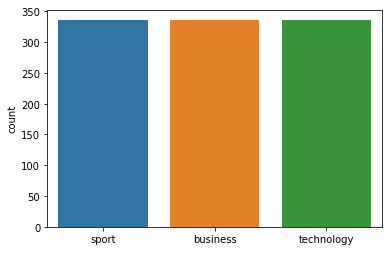



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 169
Class Distribution --> Train data (Fold 6 ):


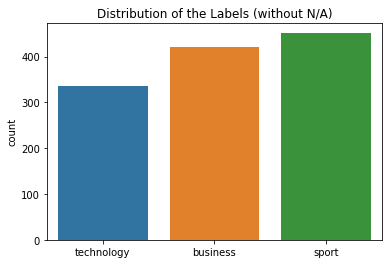

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


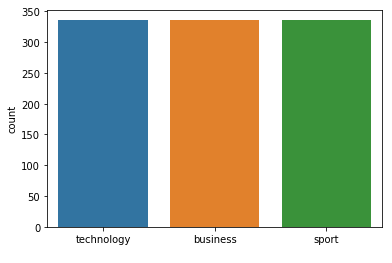



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  3 52]]
FOLD 7 Number of neighbors 169
Class Distribution --> Train data (Fold 7 ):


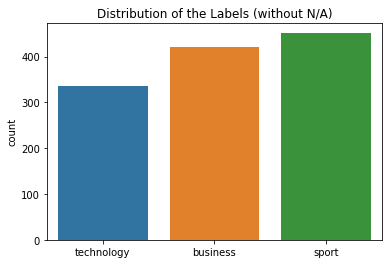

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


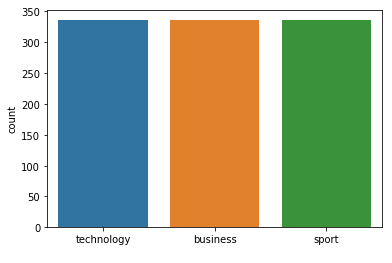



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 169  neighbours): 97.04% (+/- 1.09%)
FOLD 1 Number of neighbors 171
Class Distribution --> Train data (Fold 1 ):


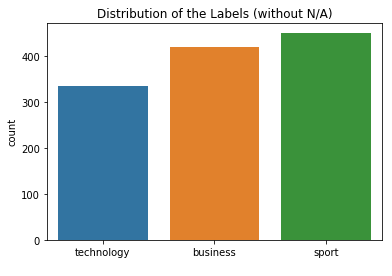

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


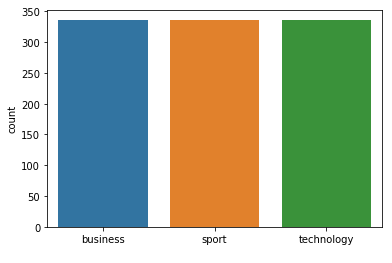



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 171
Class Distribution --> Train data (Fold 2 ):


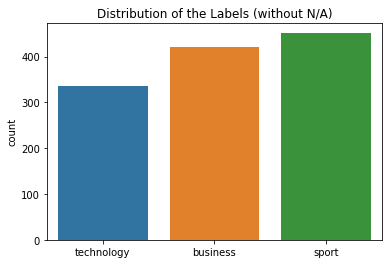

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


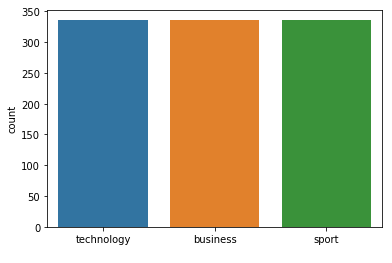



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        70
     sport
       0.95      0.96      0.95        75
technology
       0.96      0.95      0.95        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 171
Class Distribution --> Train data (Fold 3 ):


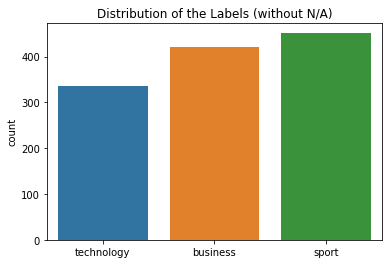

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


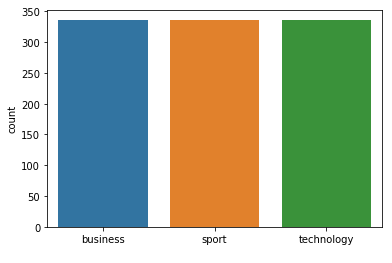



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 171
Class Distribution --> Train data (Fold 4 ):


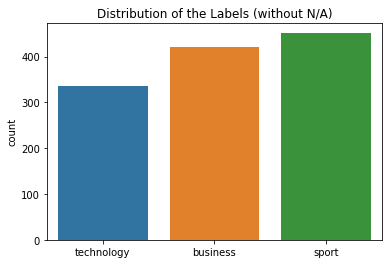

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


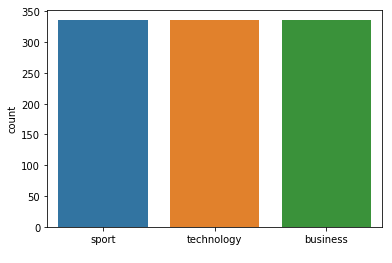



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 171
Class Distribution --> Train data (Fold 5 ):


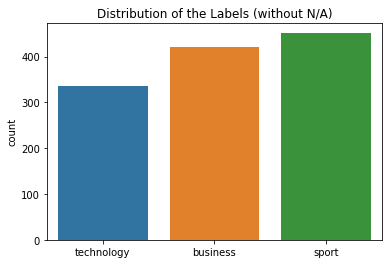

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


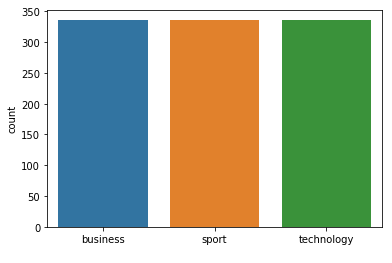



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 171
Class Distribution --> Train data (Fold 6 ):


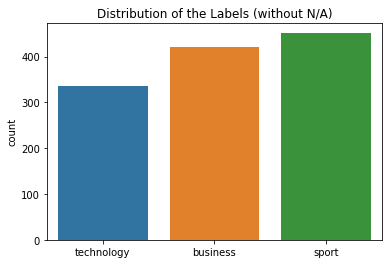

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


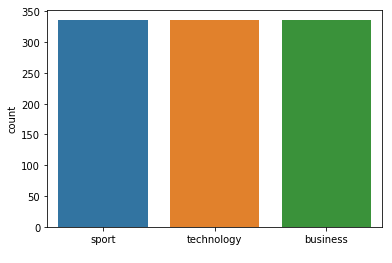



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 171
Class Distribution --> Train data (Fold 7 ):


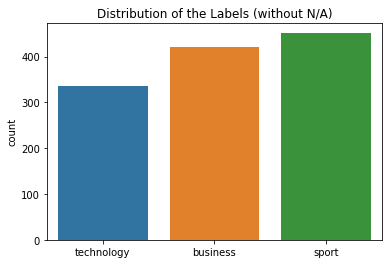

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


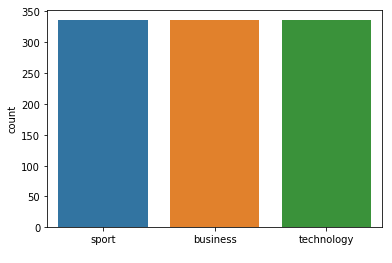



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 171  neighbours): 97.04% (+/- 1.09%)
FOLD 1 Number of neighbors 173
Class Distribution --> Train data (Fold 1 ):


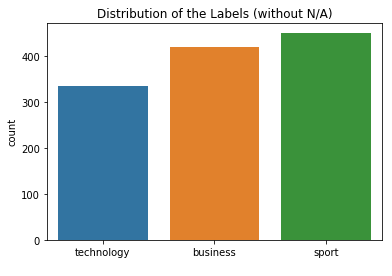

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


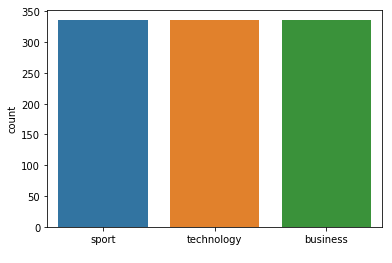



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 173
Class Distribution --> Train data (Fold 2 ):


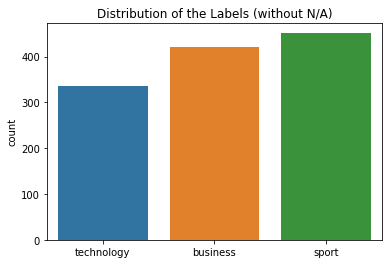

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


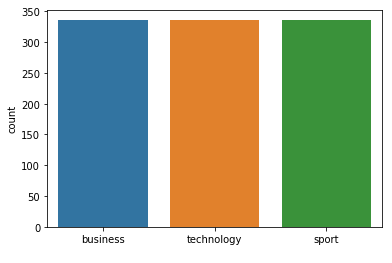



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 173
Class Distribution --> Train data (Fold 3 ):


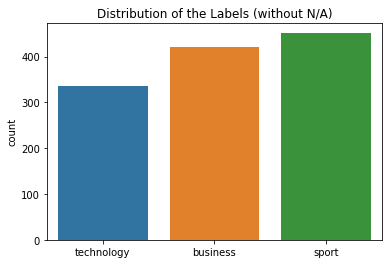

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


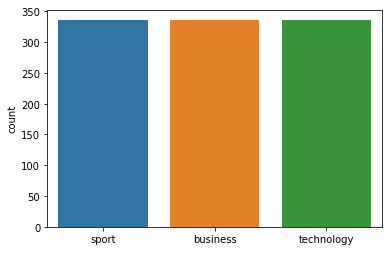



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 173
Class Distribution --> Train data (Fold 4 ):


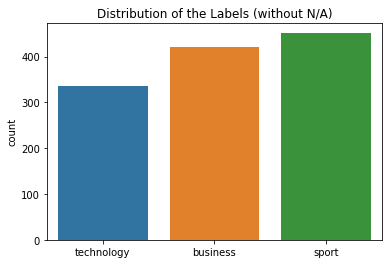

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


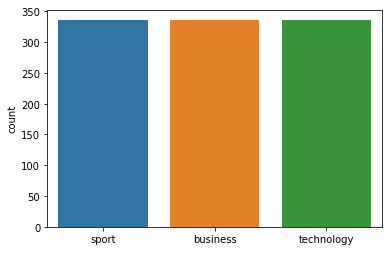



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 173
Class Distribution --> Train data (Fold 5 ):


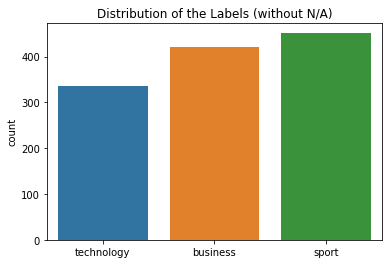

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


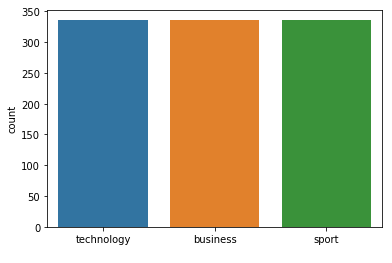



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 173
Class Distribution --> Train data (Fold 6 ):


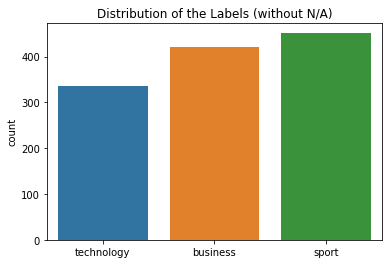

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


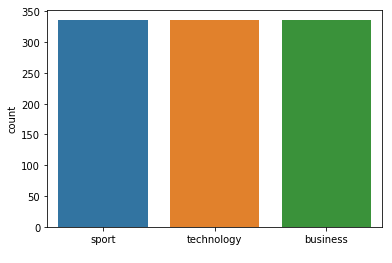



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 173
Class Distribution --> Train data (Fold 7 ):


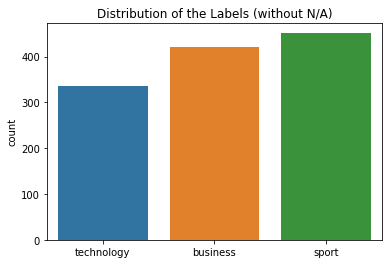

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


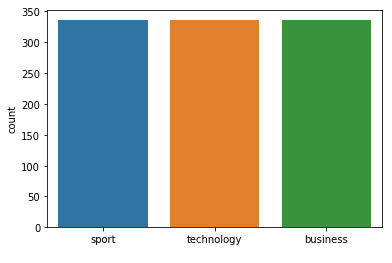



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 173  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 175
Class Distribution --> Train data (Fold 1 ):


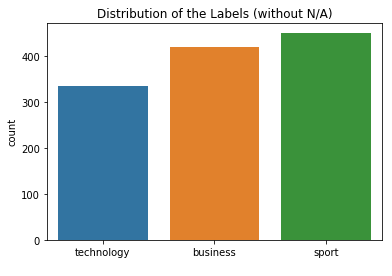

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


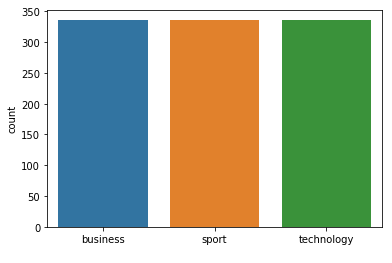



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 175
Class Distribution --> Train data (Fold 2 ):


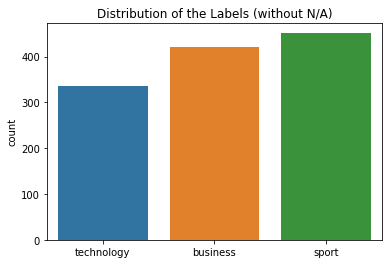

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


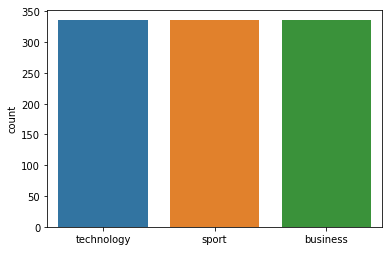



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 175
Class Distribution --> Train data (Fold 3 ):


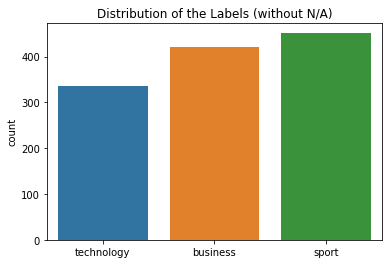

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


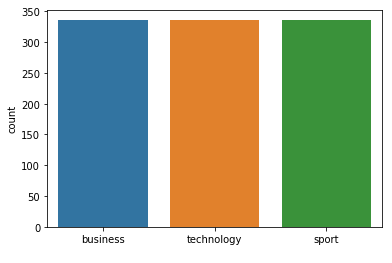



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 175
Class Distribution --> Train data (Fold 4 ):


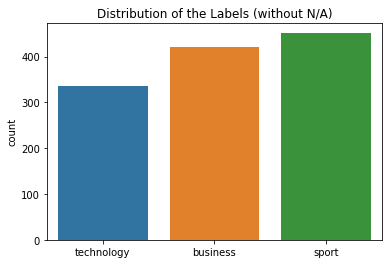

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


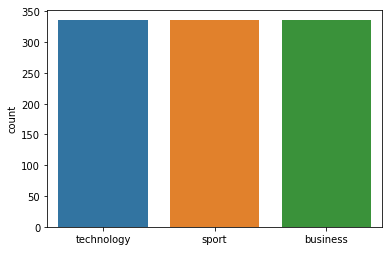



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 175
Class Distribution --> Train data (Fold 5 ):


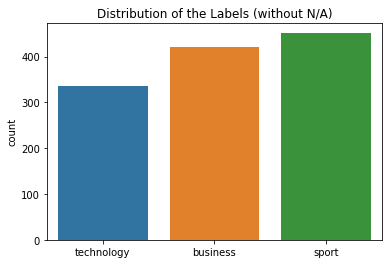

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


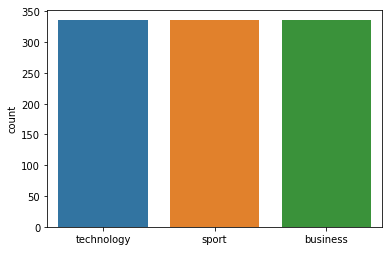



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 175
Class Distribution --> Train data (Fold 6 ):


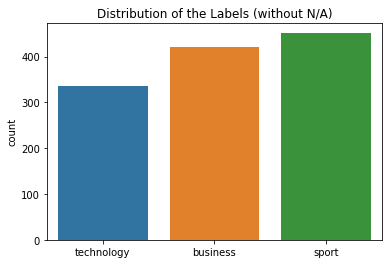

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


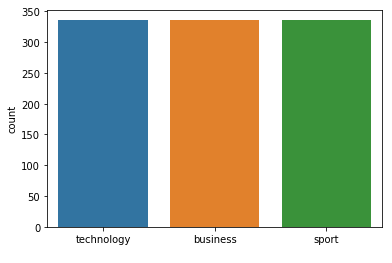



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 175
Class Distribution --> Train data (Fold 7 ):


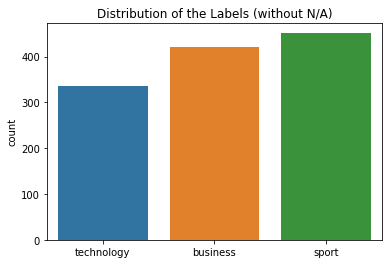

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


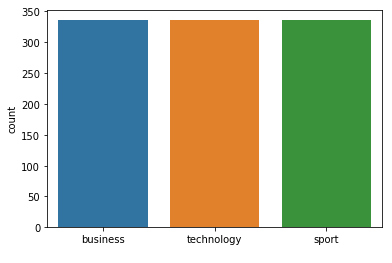



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 175  neighbours): 97.04% (+/- 1.09%)
FOLD 1 Number of neighbors 177
Class Distribution --> Train data (Fold 1 ):


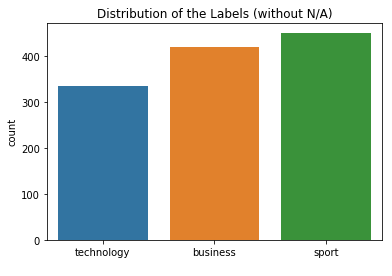

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


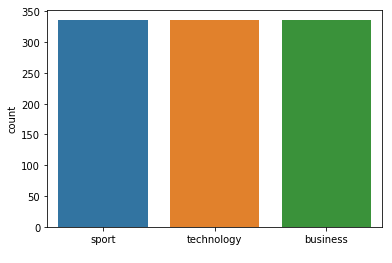



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 177
Class Distribution --> Train data (Fold 2 ):


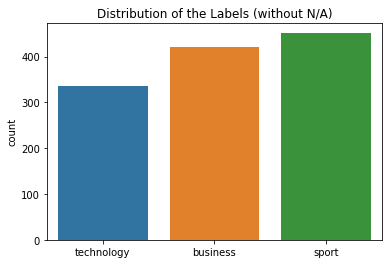

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


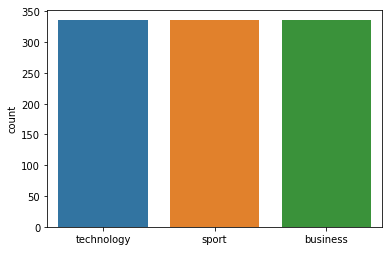



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 177
Class Distribution --> Train data (Fold 3 ):


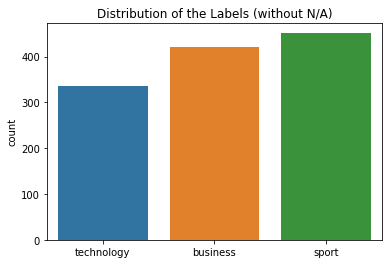

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


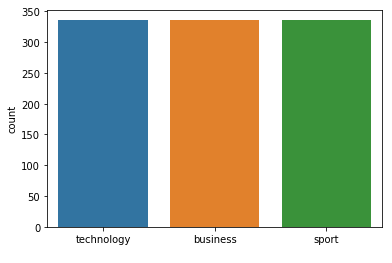



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 177
Class Distribution --> Train data (Fold 4 ):


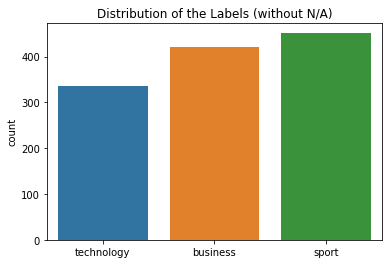

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


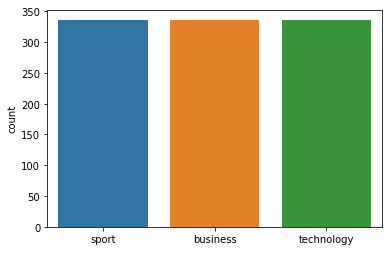



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 177
Class Distribution --> Train data (Fold 5 ):


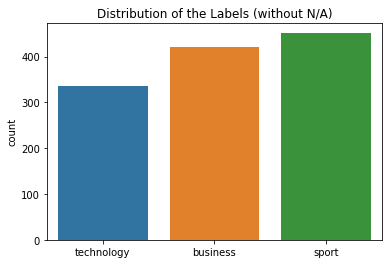

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


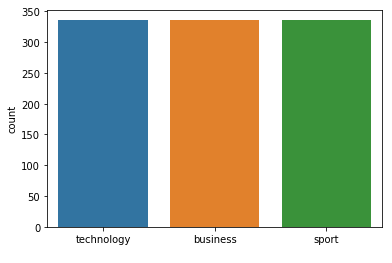



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 177
Class Distribution --> Train data (Fold 6 ):


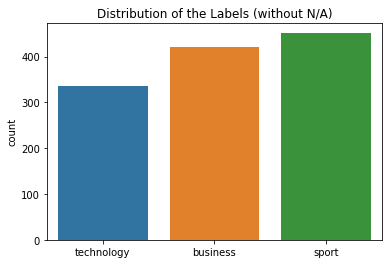

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


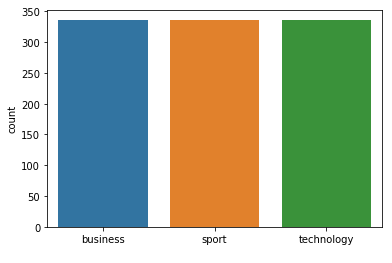



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 177
Class Distribution --> Train data (Fold 7 ):


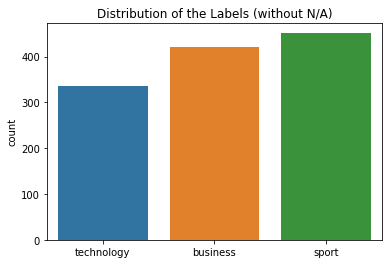

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


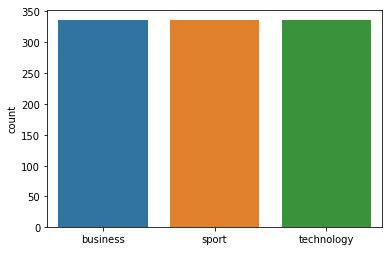



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 177  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 179
Class Distribution --> Train data (Fold 1 ):


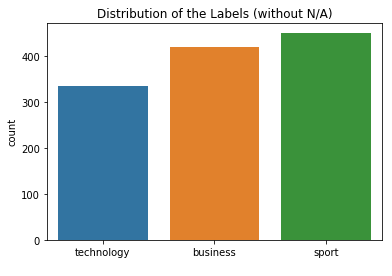

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


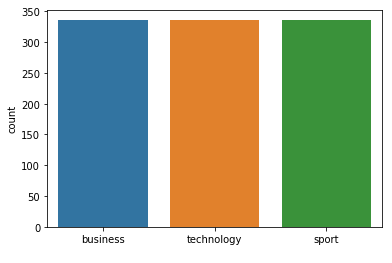



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 179
Class Distribution --> Train data (Fold 2 ):


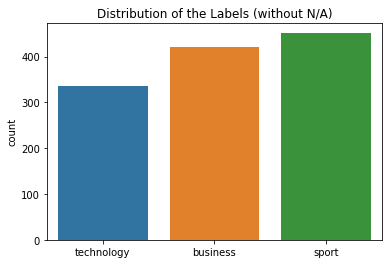

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


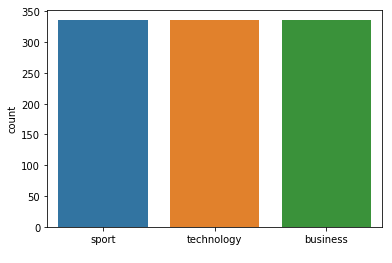



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 179
Class Distribution --> Train data (Fold 3 ):


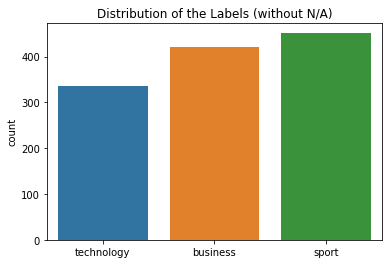

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


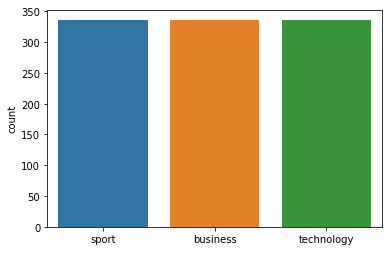



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 179
Class Distribution --> Train data (Fold 4 ):


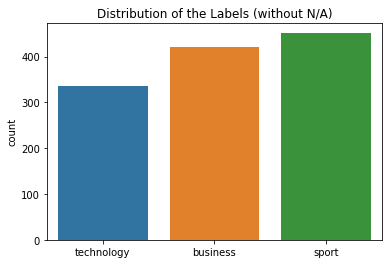

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


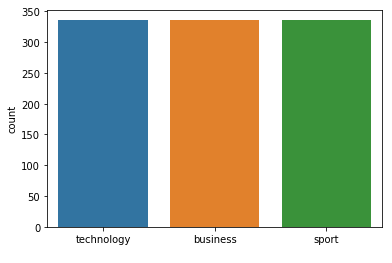



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 179
Class Distribution --> Train data (Fold 5 ):


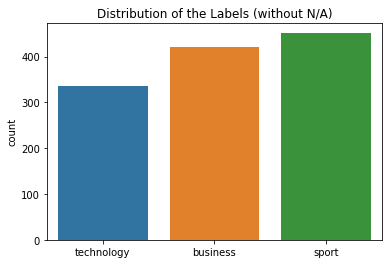

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


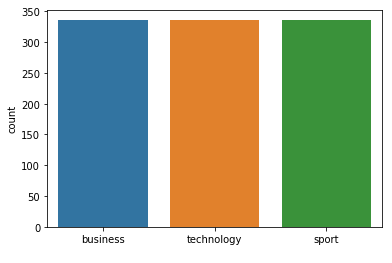



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 179
Class Distribution --> Train data (Fold 6 ):


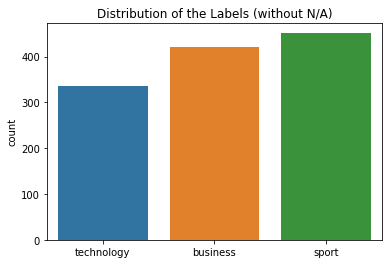

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


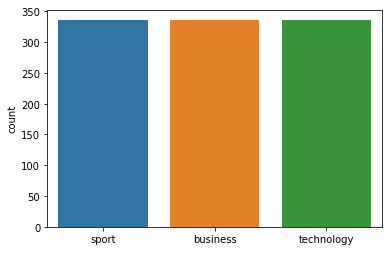



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 179
Class Distribution --> Train data (Fold 7 ):


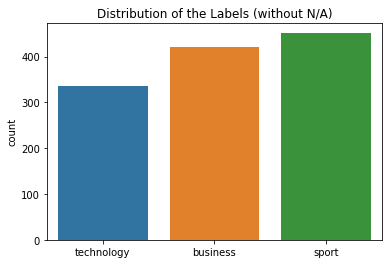

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


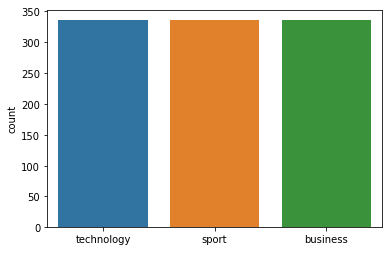



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 179  neighbours): 97.03% (+/- 1.09%)
FOLD 1 Number of neighbors 181
Class Distribution --> Train data (Fold 1 ):


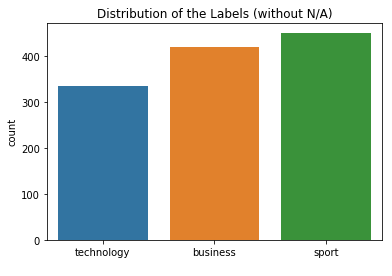

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


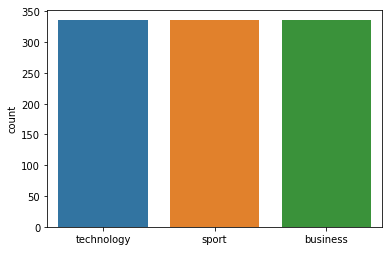



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 181
Class Distribution --> Train data (Fold 2 ):


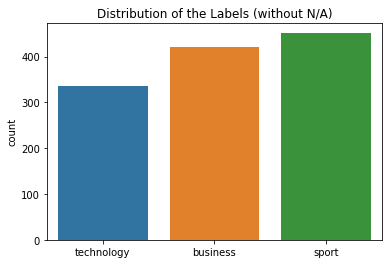

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


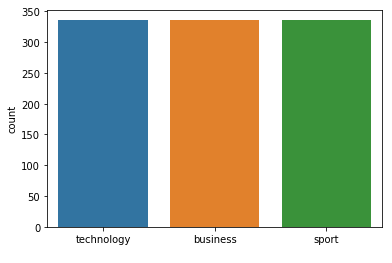



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 181
Class Distribution --> Train data (Fold 3 ):


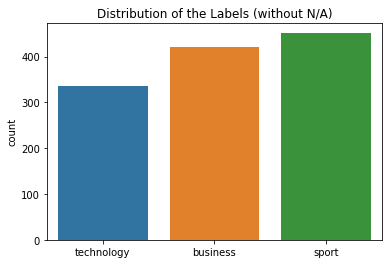

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


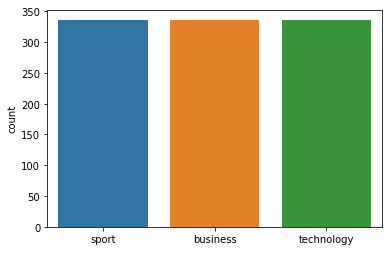



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 181
Class Distribution --> Train data (Fold 4 ):


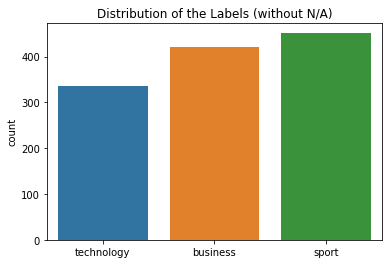

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


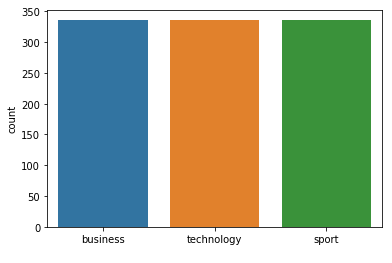



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 181
Class Distribution --> Train data (Fold 5 ):


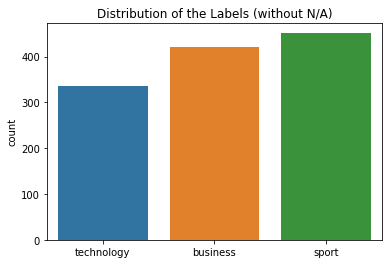

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


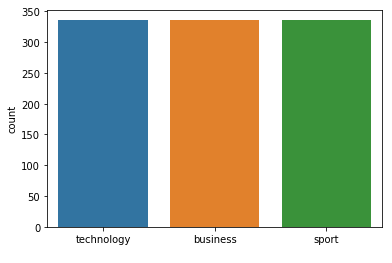



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 181
Class Distribution --> Train data (Fold 6 ):


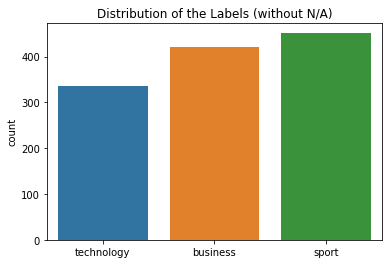

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


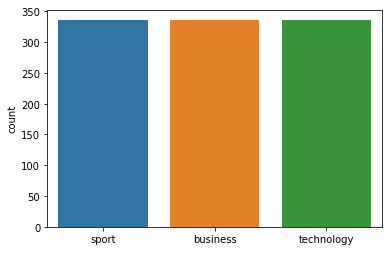



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 181
Class Distribution --> Train data (Fold 7 ):


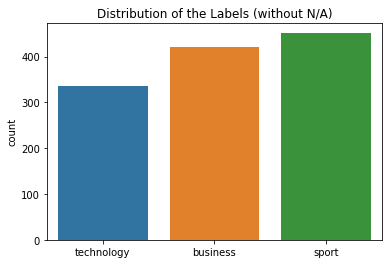

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


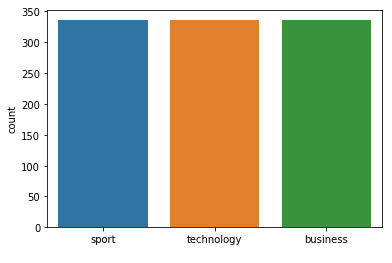



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 181  neighbours): 97.04% (+/- 1.08%)
FOLD 1 Number of neighbors 183
Class Distribution --> Train data (Fold 1 ):


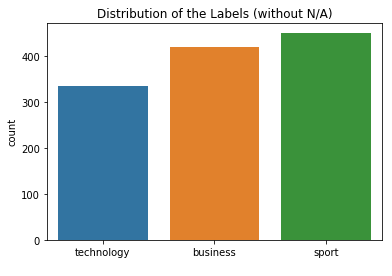

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


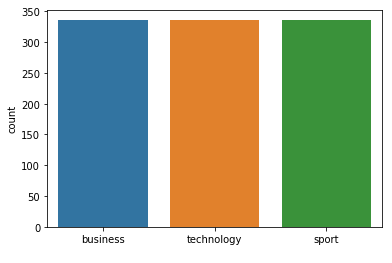



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 183
Class Distribution --> Train data (Fold 2 ):


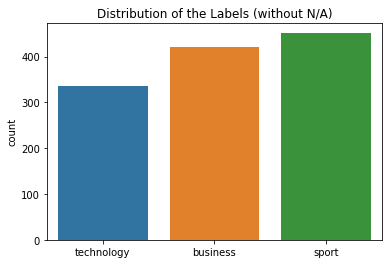

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


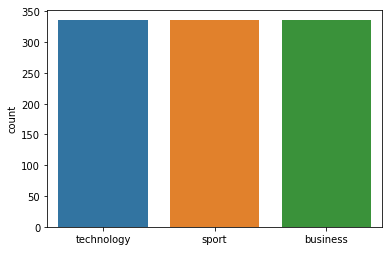



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 183
Class Distribution --> Train data (Fold 3 ):


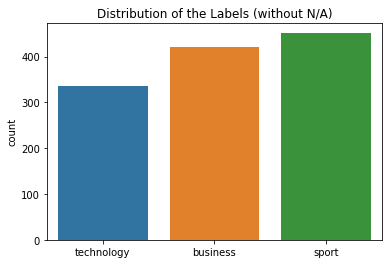

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


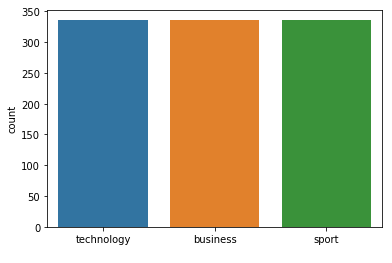



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 183
Class Distribution --> Train data (Fold 4 ):


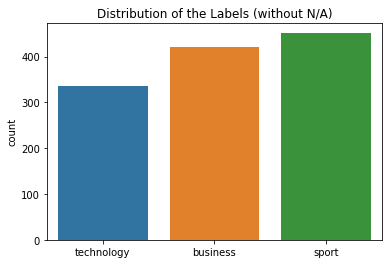

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


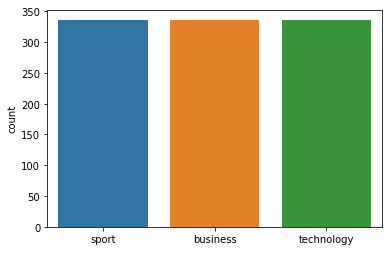



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 183
Class Distribution --> Train data (Fold 5 ):


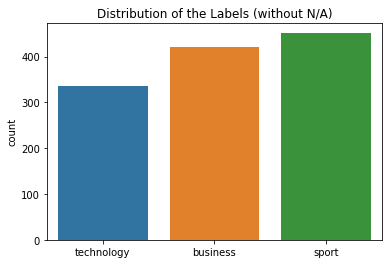

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


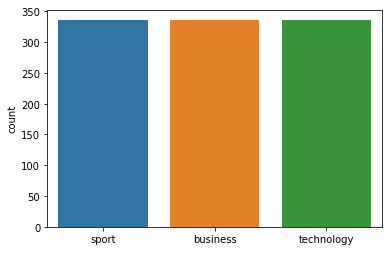



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 183
Class Distribution --> Train data (Fold 6 ):


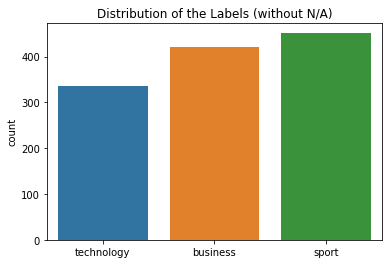

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


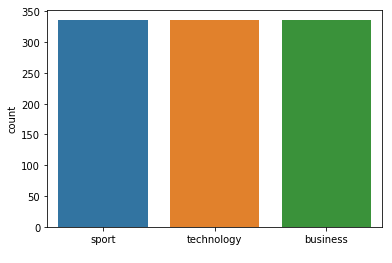



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 183
Class Distribution --> Train data (Fold 7 ):


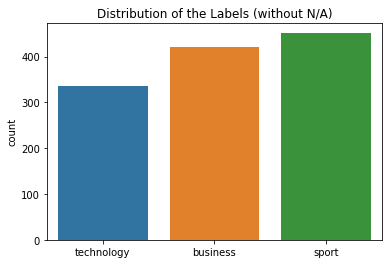

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


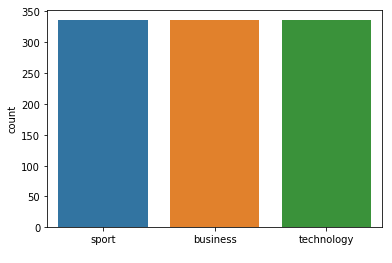



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 183  neighbours): 97.04% (+/- 1.08%)
FOLD 1 Number of neighbors 185
Class Distribution --> Train data (Fold 1 ):


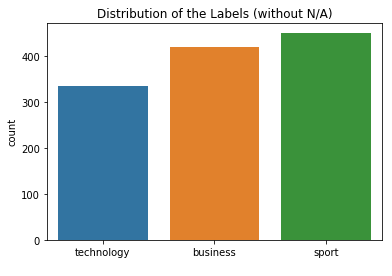

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


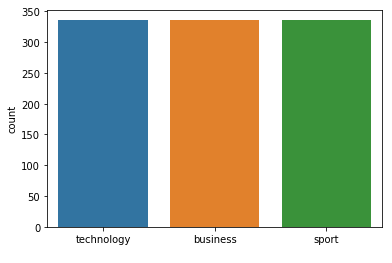



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 185
Class Distribution --> Train data (Fold 2 ):


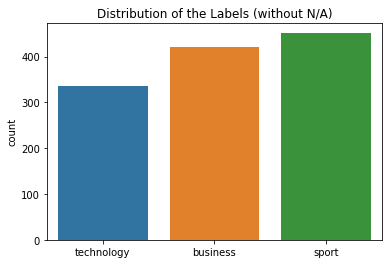

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


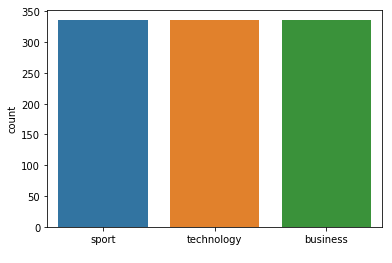



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 185
Class Distribution --> Train data (Fold 3 ):


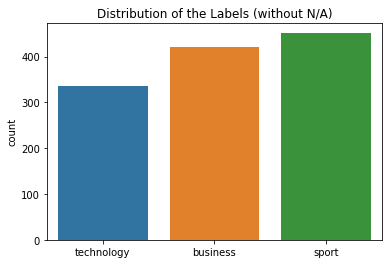

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


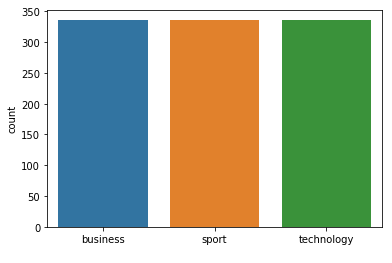



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 185
Class Distribution --> Train data (Fold 4 ):


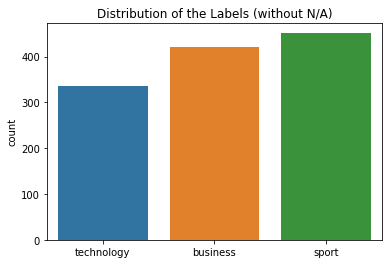

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


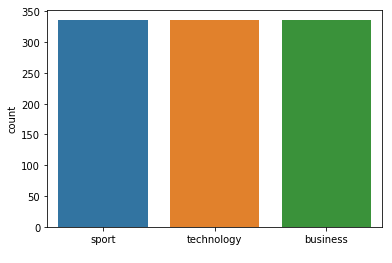



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 185
Class Distribution --> Train data (Fold 5 ):


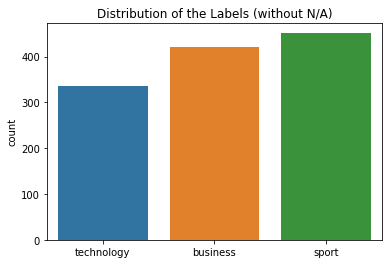

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


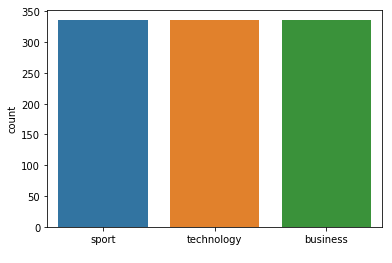



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 185
Class Distribution --> Train data (Fold 6 ):


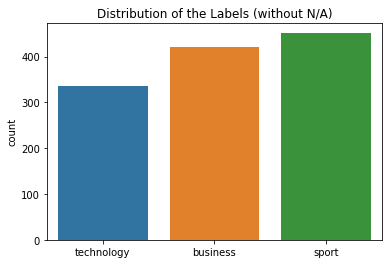

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


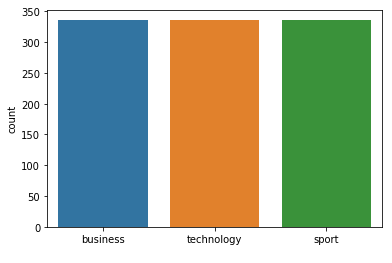



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 185
Class Distribution --> Train data (Fold 7 ):


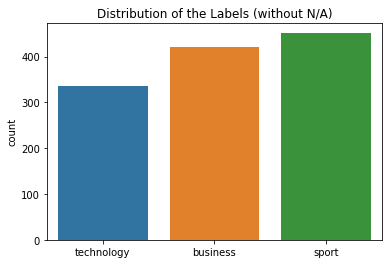

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


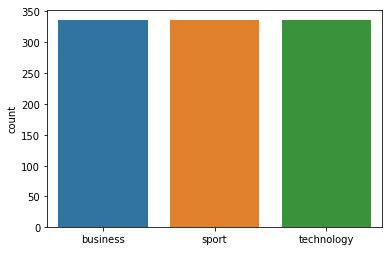



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 185  neighbours): 97.04% (+/- 1.08%)
FOLD 1 Number of neighbors 187
Class Distribution --> Train data (Fold 1 ):


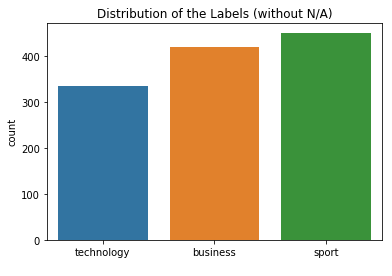

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


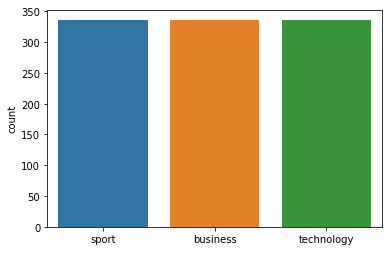



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 187
Class Distribution --> Train data (Fold 2 ):


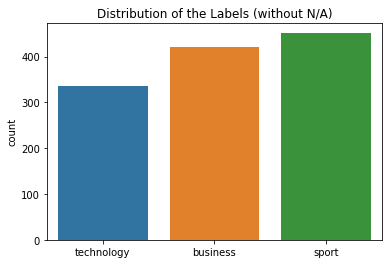

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


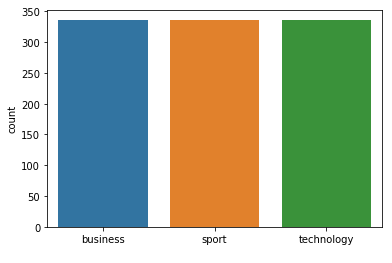



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 187
Class Distribution --> Train data (Fold 3 ):


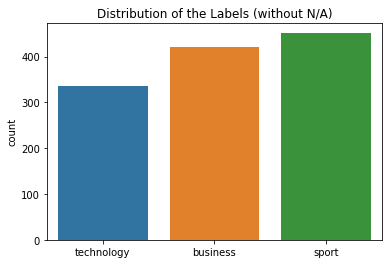

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


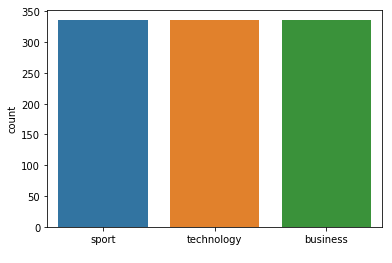



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 187
Class Distribution --> Train data (Fold 4 ):


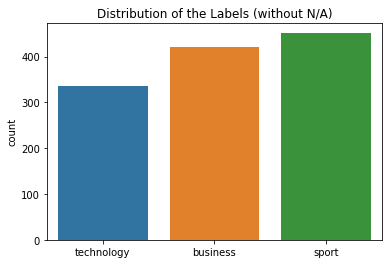

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


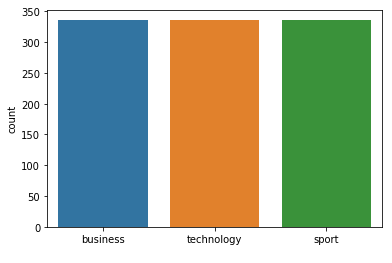



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 187
Class Distribution --> Train data (Fold 5 ):


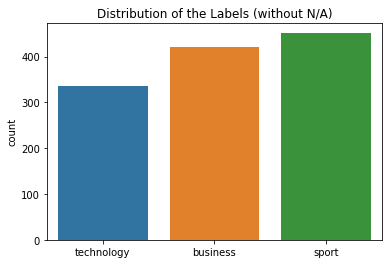

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


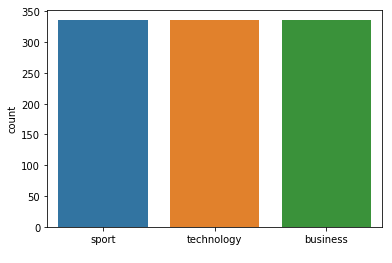



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 187
Class Distribution --> Train data (Fold 6 ):


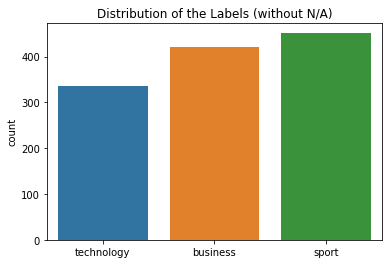

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


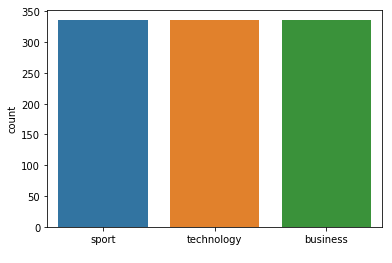



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 187
Class Distribution --> Train data (Fold 7 ):


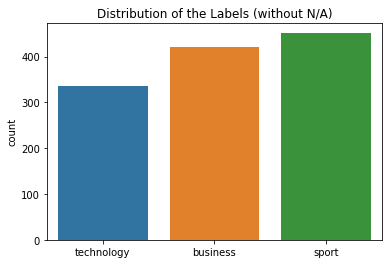

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


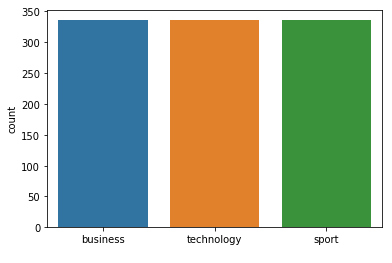



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 187  neighbours): 97.04% (+/- 1.08%)
FOLD 1 Number of neighbors 189
Class Distribution --> Train data (Fold 1 ):


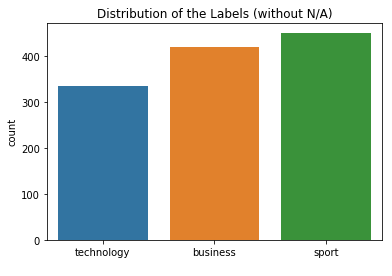

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


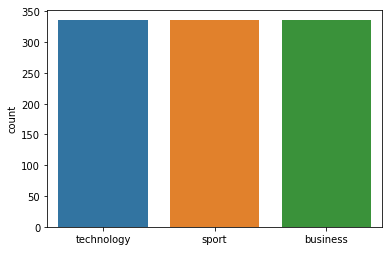



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 189
Class Distribution --> Train data (Fold 2 ):


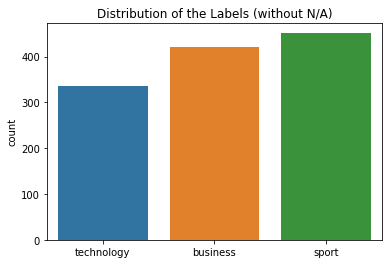

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


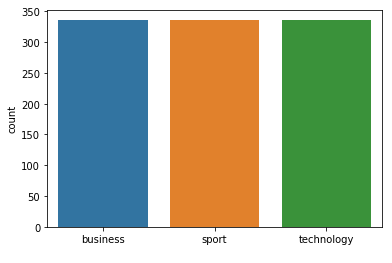



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 189
Class Distribution --> Train data (Fold 3 ):


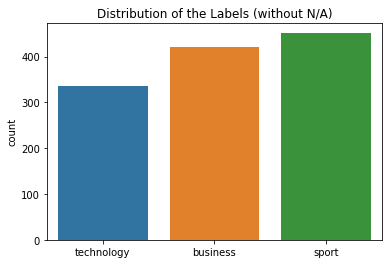

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


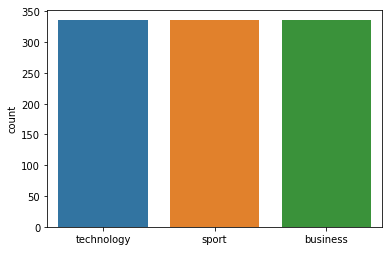



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 189
Class Distribution --> Train data (Fold 4 ):


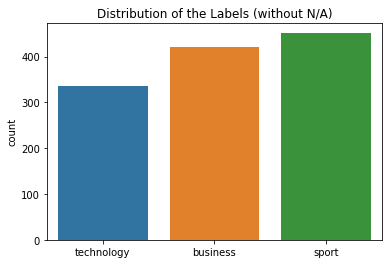

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


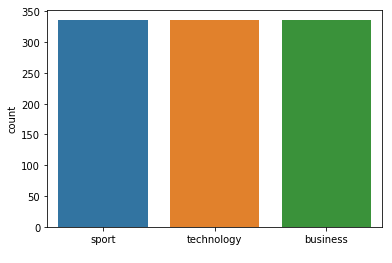



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 189
Class Distribution --> Train data (Fold 5 ):


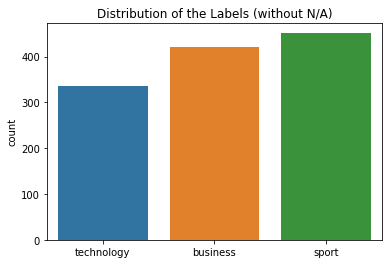

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


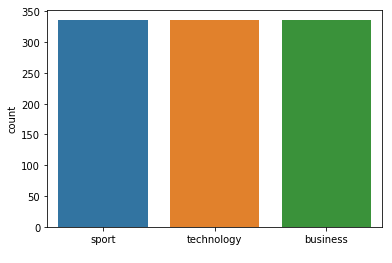



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 189
Class Distribution --> Train data (Fold 6 ):


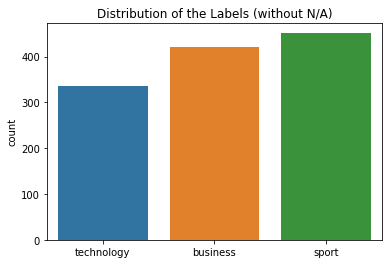

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


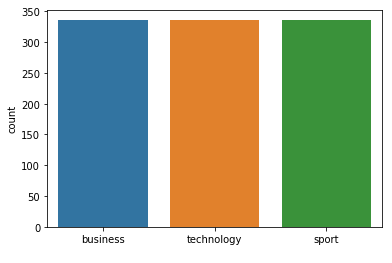



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 189
Class Distribution --> Train data (Fold 7 ):


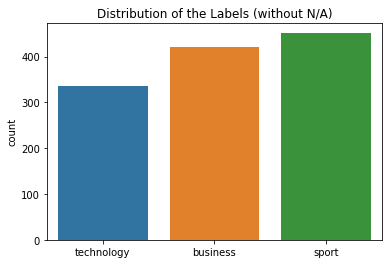

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


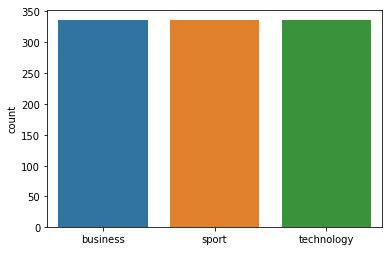



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 189  neighbours): 97.04% (+/- 1.08%)
FOLD 1 Number of neighbors 191
Class Distribution --> Train data (Fold 1 ):


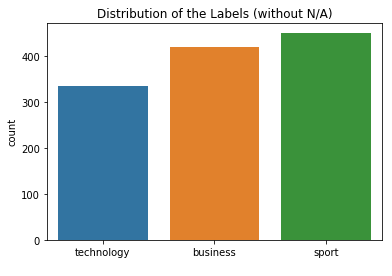

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


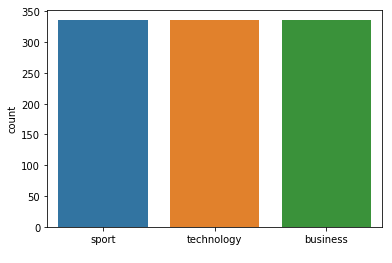



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 191
Class Distribution --> Train data (Fold 2 ):


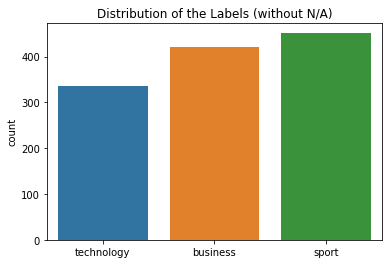

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


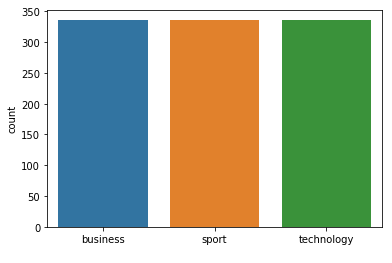



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 191
Class Distribution --> Train data (Fold 3 ):


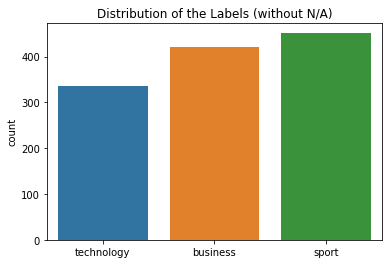

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


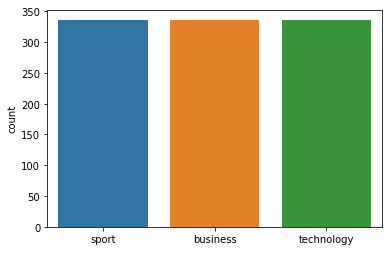



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 191
Class Distribution --> Train data (Fold 4 ):


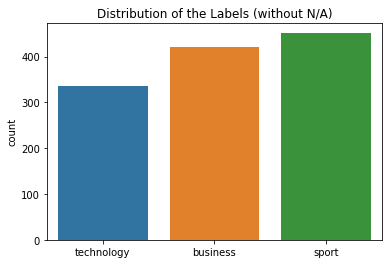

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


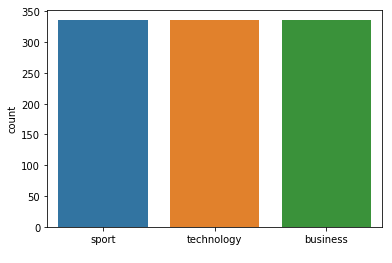



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 191
Class Distribution --> Train data (Fold 5 ):


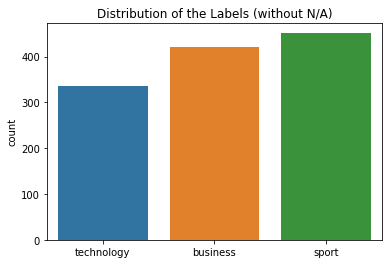

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


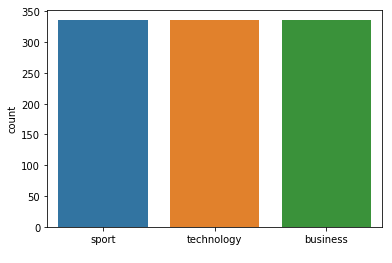



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 191
Class Distribution --> Train data (Fold 6 ):


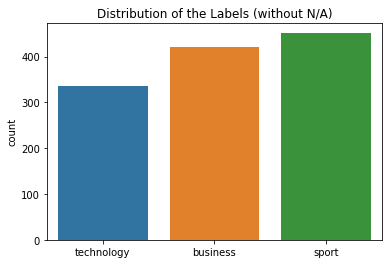

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


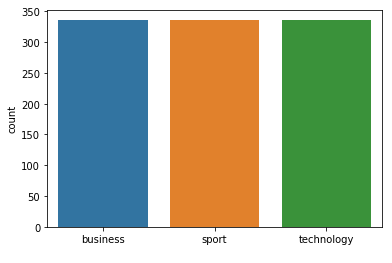



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 191
Class Distribution --> Train data (Fold 7 ):


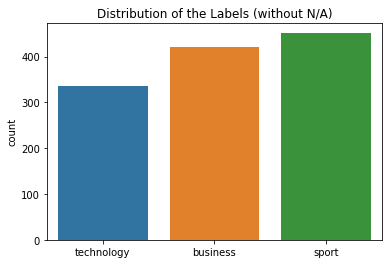

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


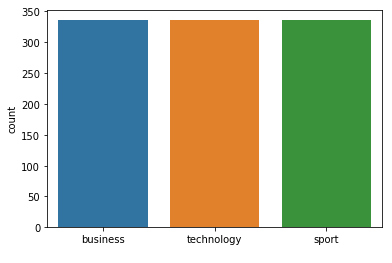



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 191  neighbours): 97.05% (+/- 1.08%)
FOLD 1 Number of neighbors 193
Class Distribution --> Train data (Fold 1 ):


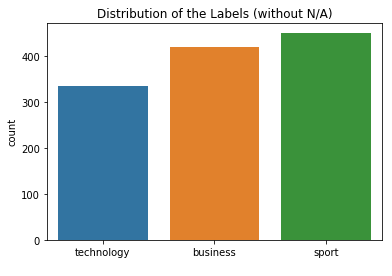

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


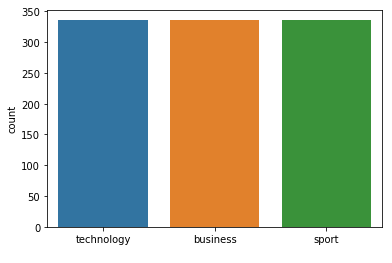



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 193
Class Distribution --> Train data (Fold 2 ):


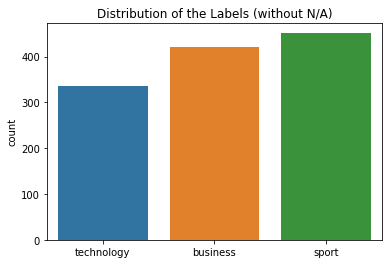

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


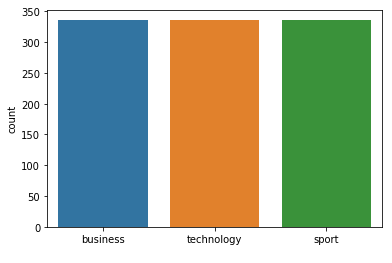



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 193
Class Distribution --> Train data (Fold 3 ):


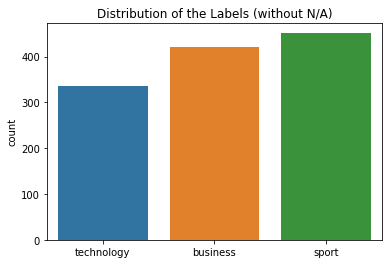

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


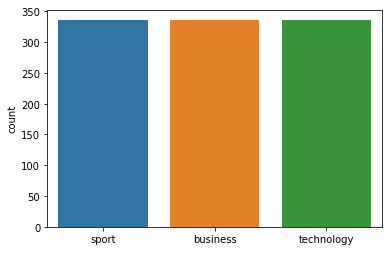



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 193
Class Distribution --> Train data (Fold 4 ):


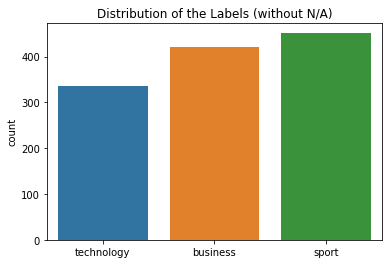

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


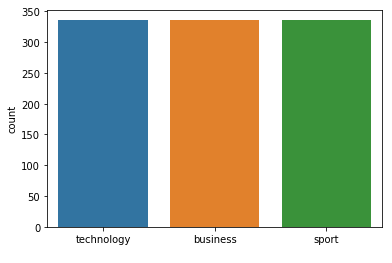



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 193
Class Distribution --> Train data (Fold 5 ):


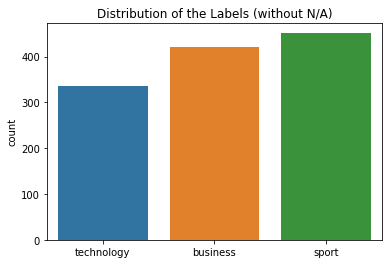

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


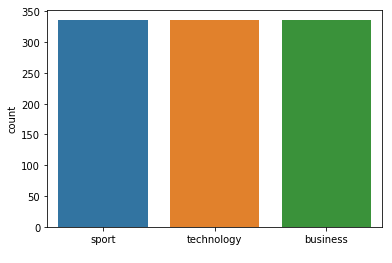



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 193
Class Distribution --> Train data (Fold 6 ):


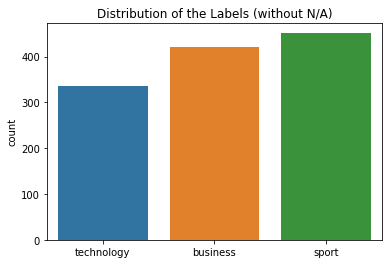

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


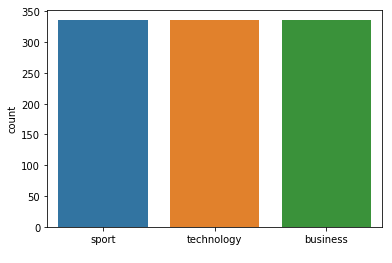



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 193
Class Distribution --> Train data (Fold 7 ):


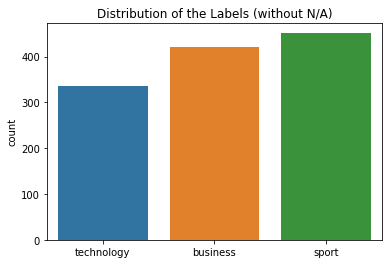

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


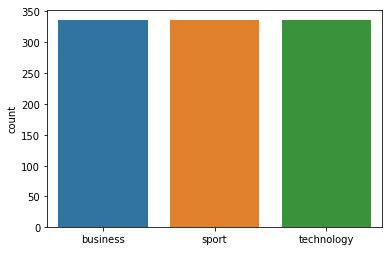



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 193  neighbours): 97.05% (+/- 1.08%)
FOLD 1 Number of neighbors 195
Class Distribution --> Train data (Fold 1 ):


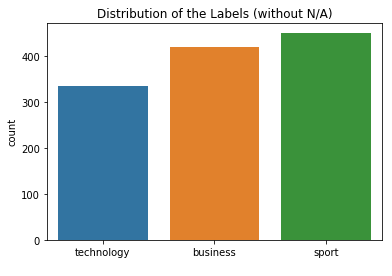

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


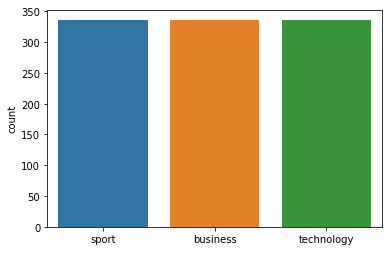



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 195
Class Distribution --> Train data (Fold 2 ):


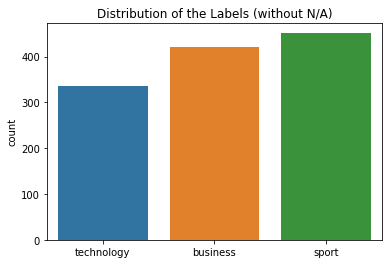

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


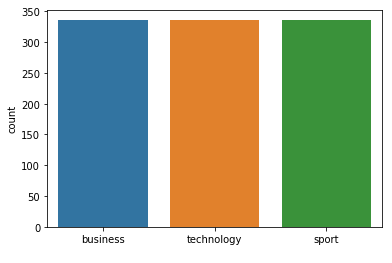



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 195
Class Distribution --> Train data (Fold 3 ):


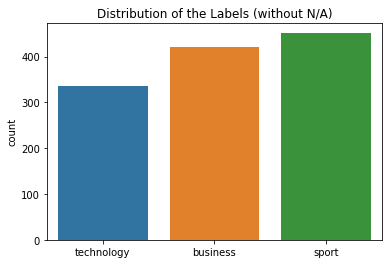

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


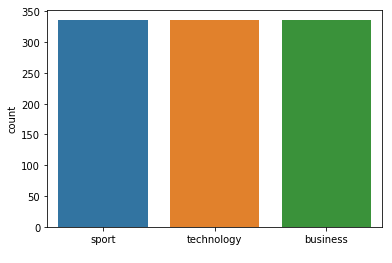



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 195
Class Distribution --> Train data (Fold 4 ):


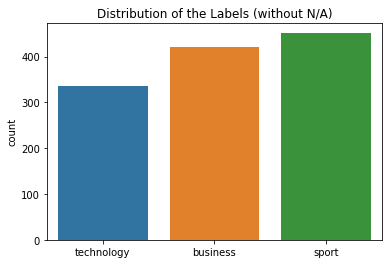

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


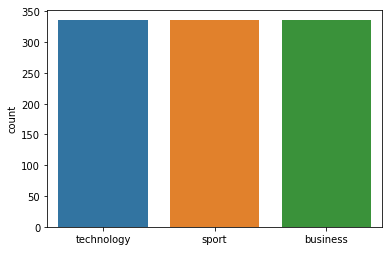



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 195
Class Distribution --> Train data (Fold 5 ):


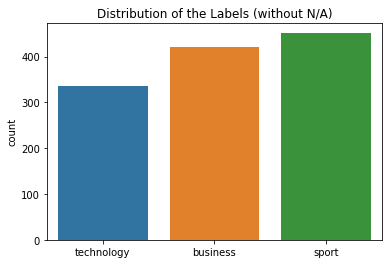

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


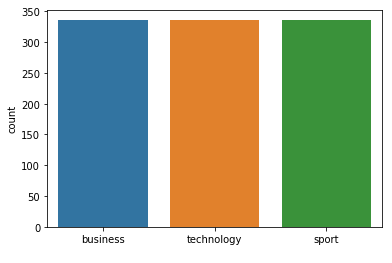



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 195
Class Distribution --> Train data (Fold 6 ):


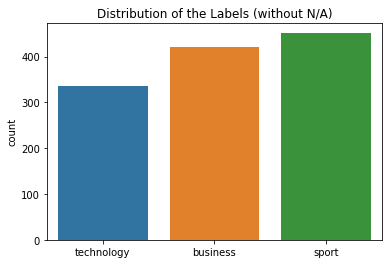

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


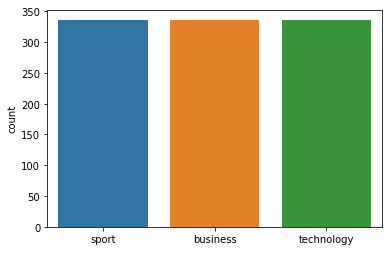



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 195
Class Distribution --> Train data (Fold 7 ):


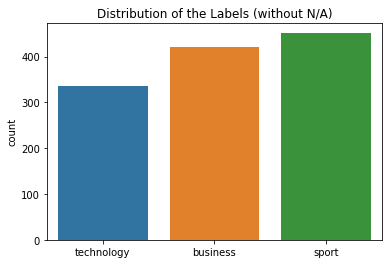

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


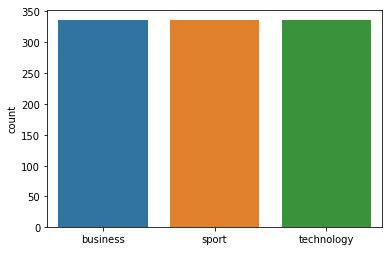



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 195  neighbours): 97.05% (+/- 1.08%)
FOLD 1 Number of neighbors 197
Class Distribution --> Train data (Fold 1 ):


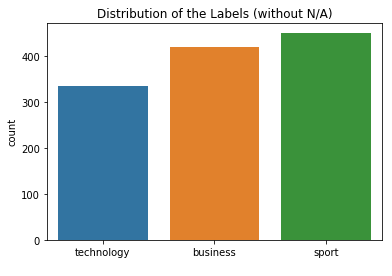

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


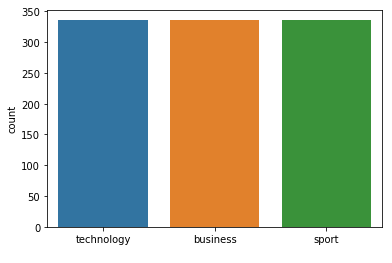



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 197
Class Distribution --> Train data (Fold 2 ):


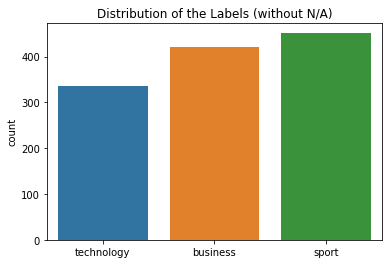

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


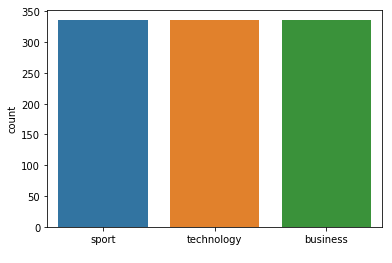



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 197
Class Distribution --> Train data (Fold 3 ):


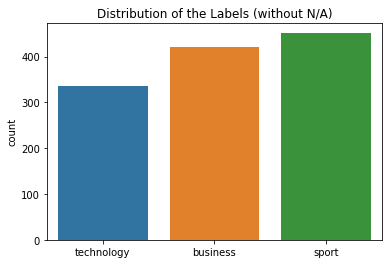

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


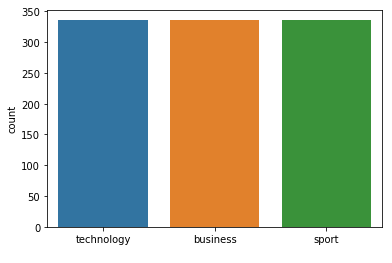



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 197
Class Distribution --> Train data (Fold 4 ):


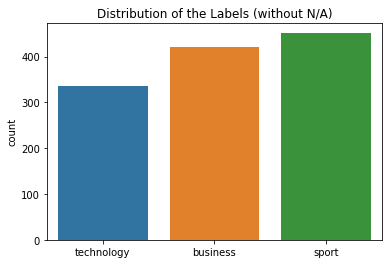

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


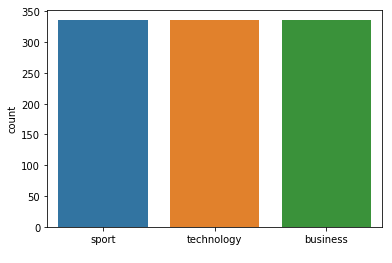



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 197
Class Distribution --> Train data (Fold 5 ):


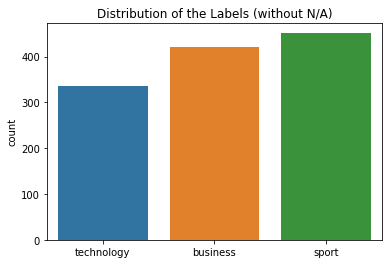

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


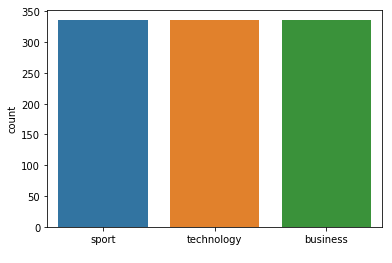



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 197
Class Distribution --> Train data (Fold 6 ):


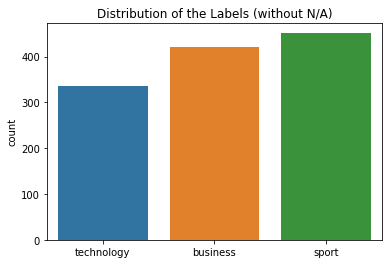

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


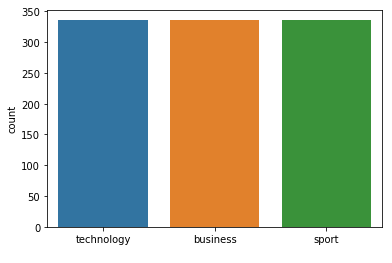



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 197
Class Distribution --> Train data (Fold 7 ):


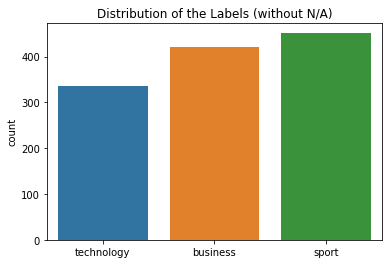

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


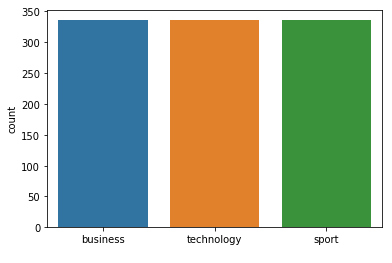



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 197  neighbours): 97.05% (+/- 1.08%)
FOLD 1 Number of neighbors 199
Class Distribution --> Train data (Fold 1 ):


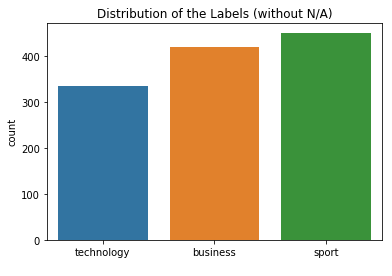

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


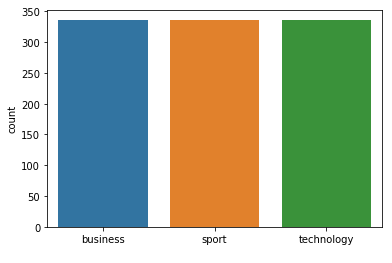



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 199
Class Distribution --> Train data (Fold 2 ):


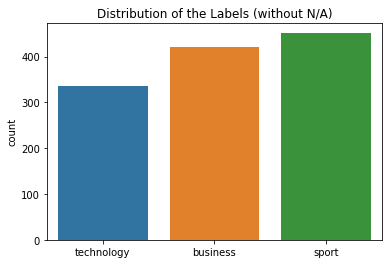

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


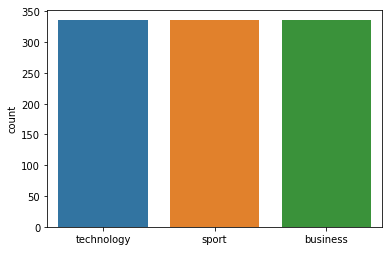



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 199
Class Distribution --> Train data (Fold 3 ):


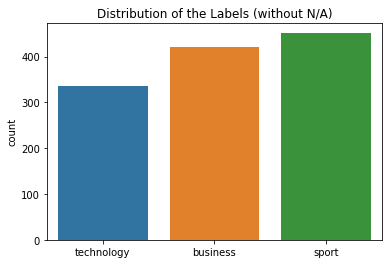

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


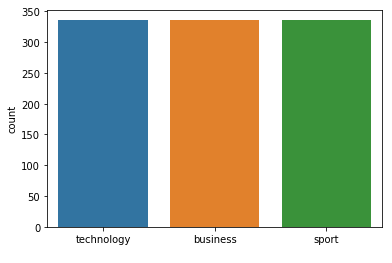



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 199
Class Distribution --> Train data (Fold 4 ):


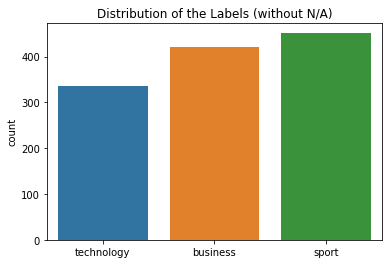

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


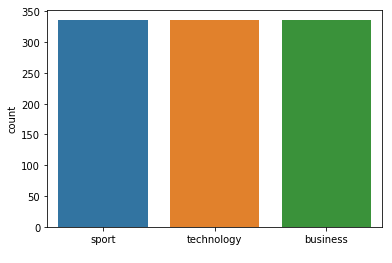



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 199
Class Distribution --> Train data (Fold 5 ):


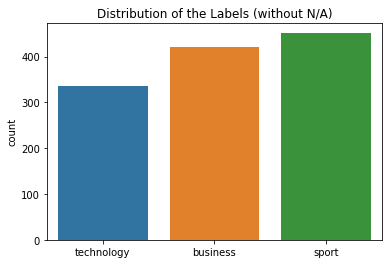

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


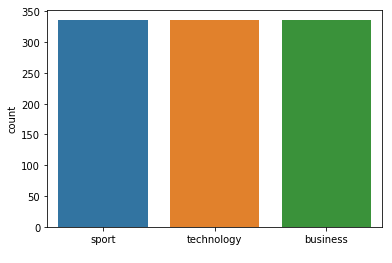



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 199
Class Distribution --> Train data (Fold 6 ):


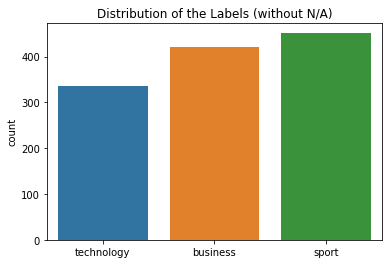

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


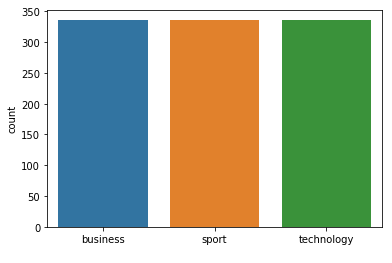



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 199
Class Distribution --> Train data (Fold 7 ):


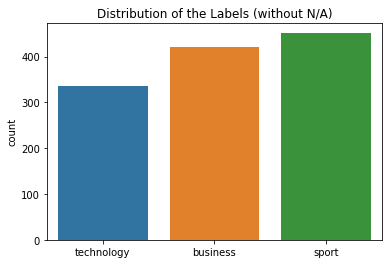

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


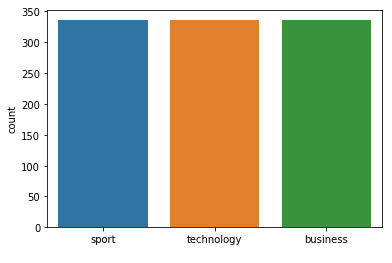



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 199  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 201
Class Distribution --> Train data (Fold 1 ):


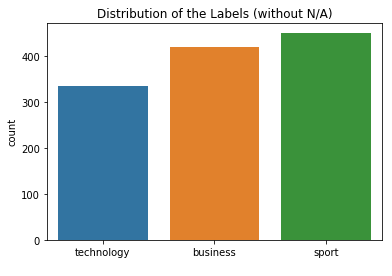

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


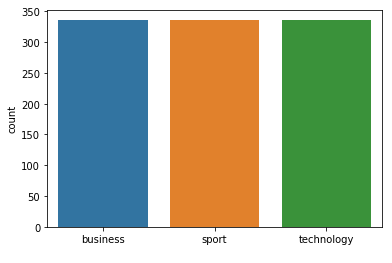



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 201
Class Distribution --> Train data (Fold 2 ):


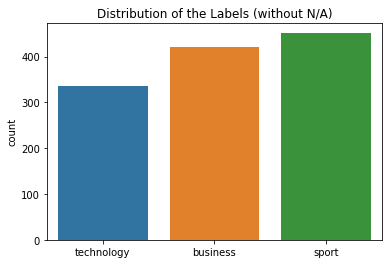

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


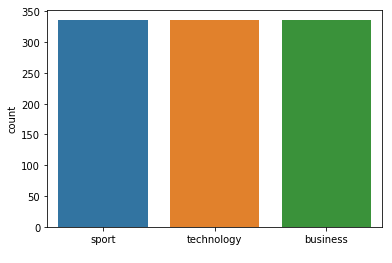



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 201
Class Distribution --> Train data (Fold 3 ):


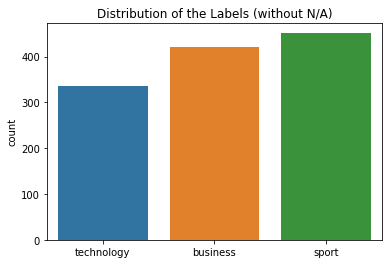

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


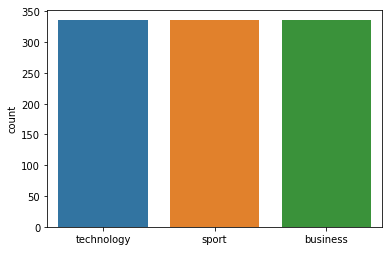



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 201
Class Distribution --> Train data (Fold 4 ):


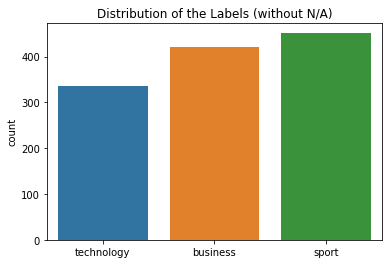

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


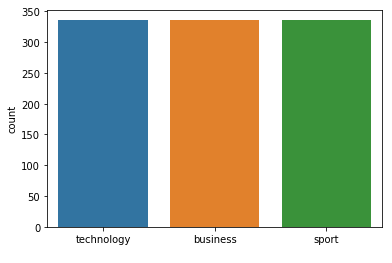



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 201
Class Distribution --> Train data (Fold 5 ):


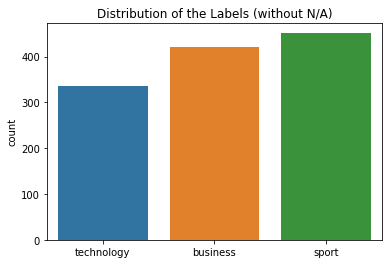

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


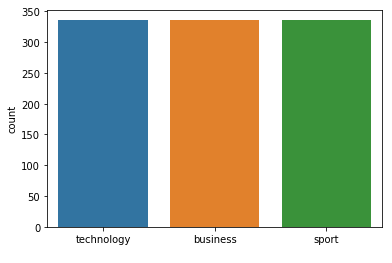



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 201
Class Distribution --> Train data (Fold 6 ):


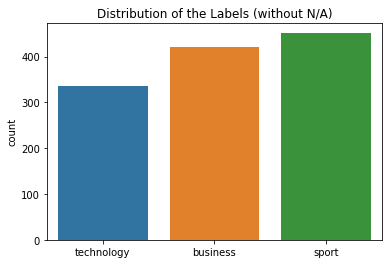

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


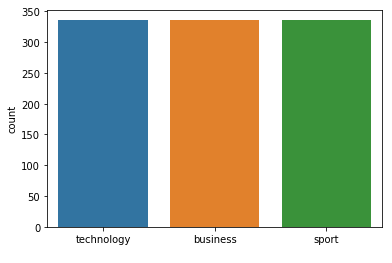



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 201
Class Distribution --> Train data (Fold 7 ):


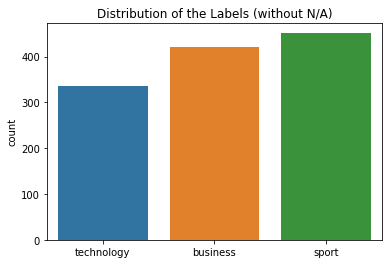

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


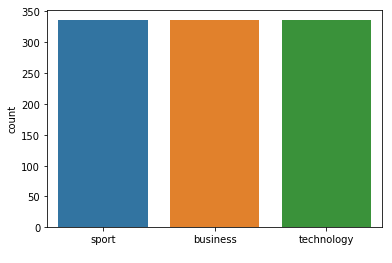



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 201  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 203
Class Distribution --> Train data (Fold 1 ):


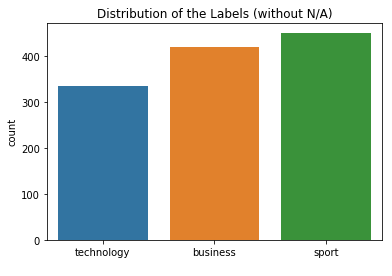

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


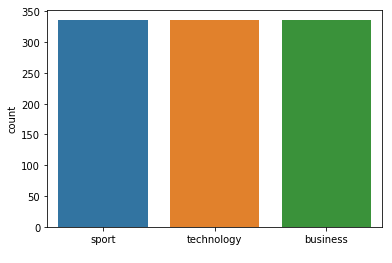



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 203
Class Distribution --> Train data (Fold 2 ):


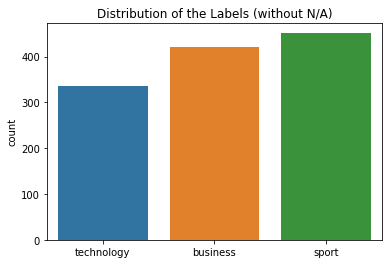

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


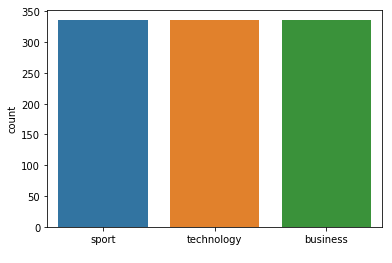



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 203
Class Distribution --> Train data (Fold 3 ):


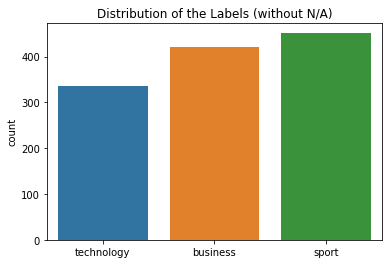

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


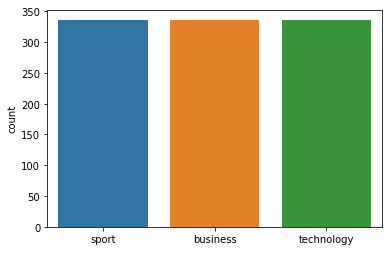



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 203
Class Distribution --> Train data (Fold 4 ):


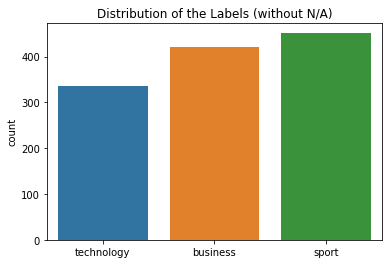

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


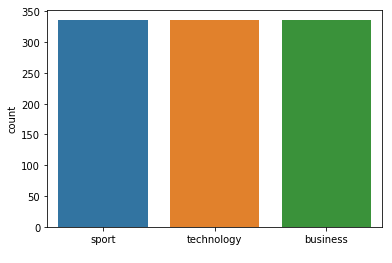



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 203
Class Distribution --> Train data (Fold 5 ):


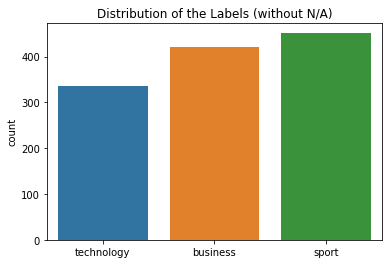

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


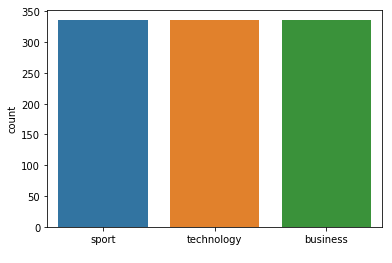



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 203
Class Distribution --> Train data (Fold 6 ):


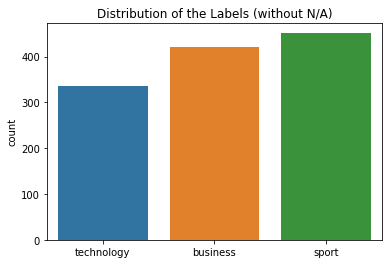

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


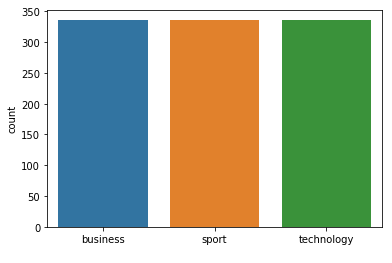



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 203
Class Distribution --> Train data (Fold 7 ):


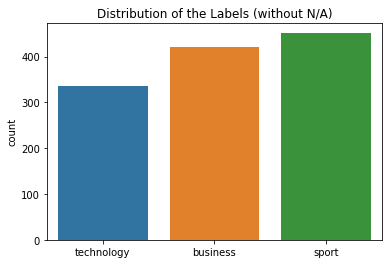

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


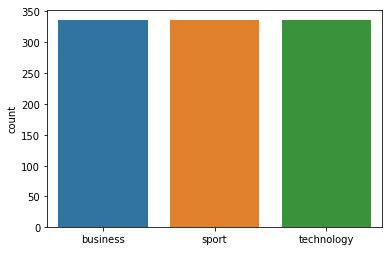



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 203  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 205
Class Distribution --> Train data (Fold 1 ):


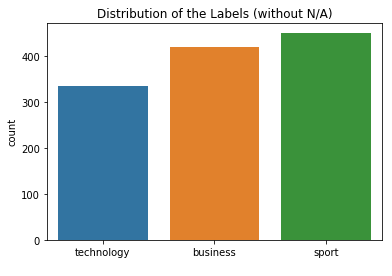

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


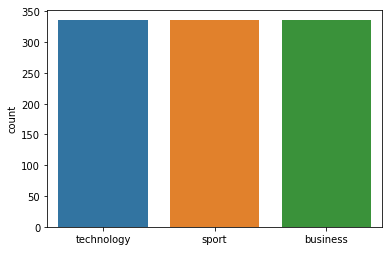



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 205
Class Distribution --> Train data (Fold 2 ):


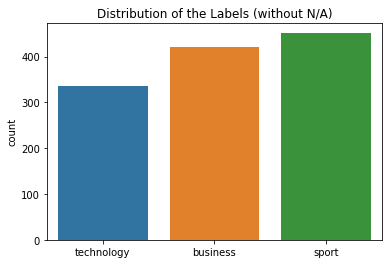

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


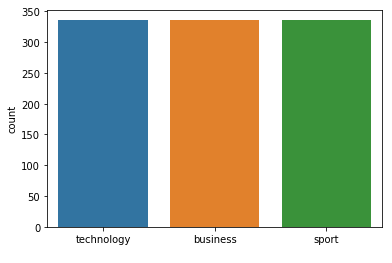



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 205
Class Distribution --> Train data (Fold 3 ):


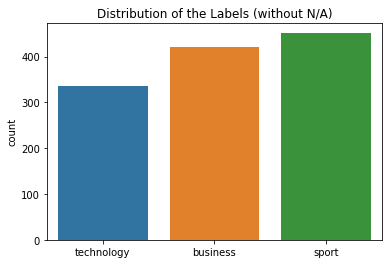

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


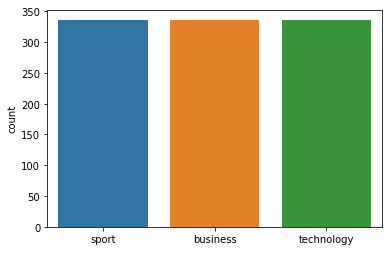



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 205
Class Distribution --> Train data (Fold 4 ):


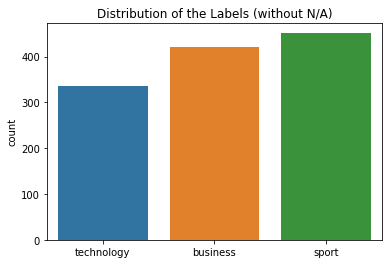

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


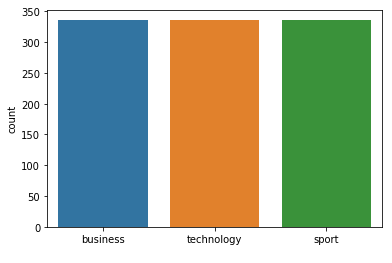



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 205
Class Distribution --> Train data (Fold 5 ):


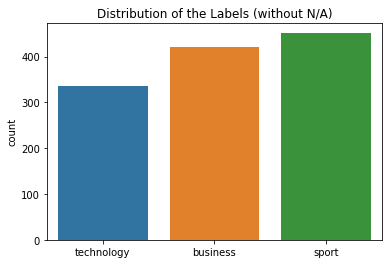

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


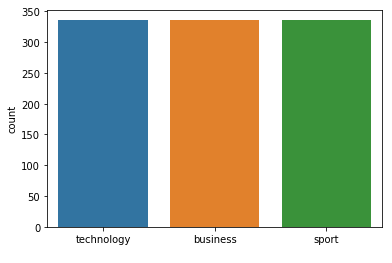



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 205
Class Distribution --> Train data (Fold 6 ):


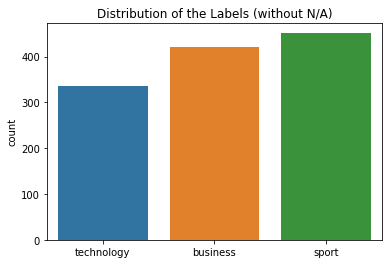

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


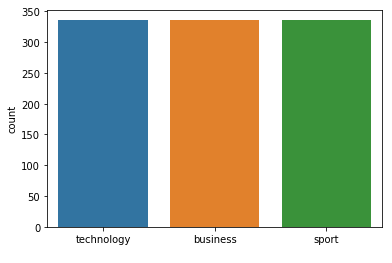



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 205
Class Distribution --> Train data (Fold 7 ):


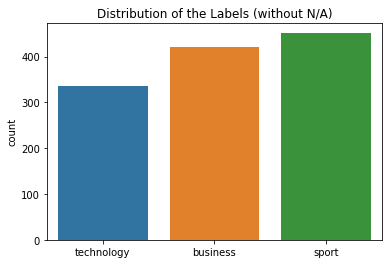

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


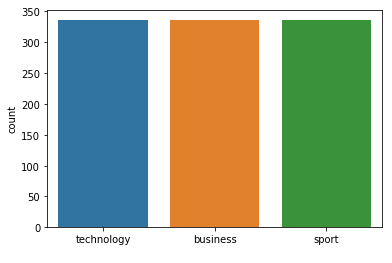



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 205  neighbours): 97.06% (+/- 1.07%)
FOLD 1 Number of neighbors 207
Class Distribution --> Train data (Fold 1 ):


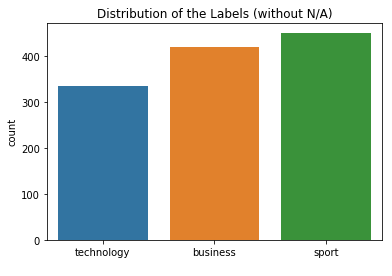

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


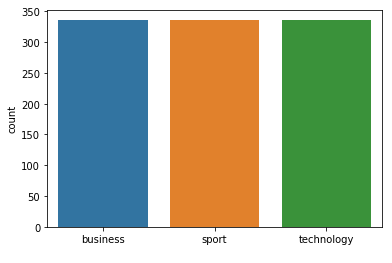



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 207
Class Distribution --> Train data (Fold 2 ):


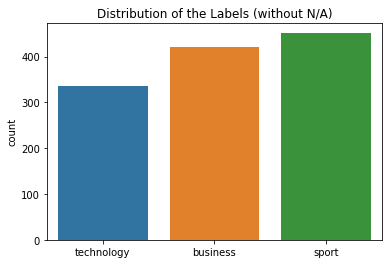

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


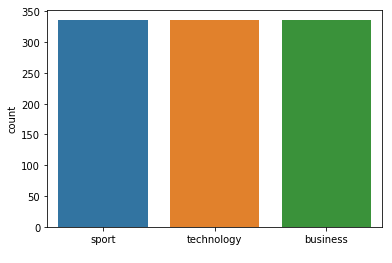



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 207
Class Distribution --> Train data (Fold 3 ):


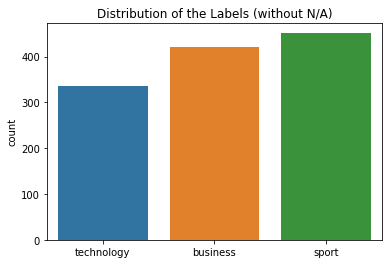

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


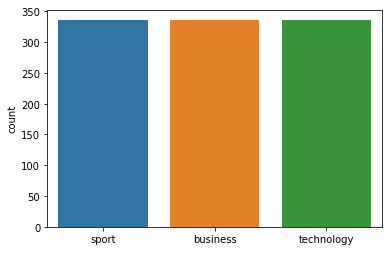



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 207
Class Distribution --> Train data (Fold 4 ):


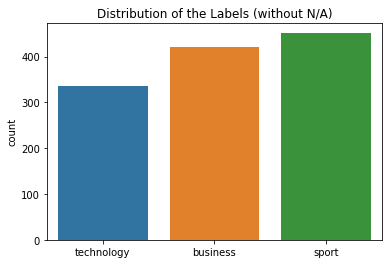

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


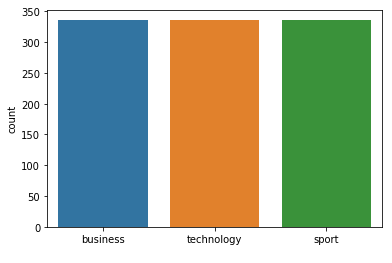



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 207
Class Distribution --> Train data (Fold 5 ):


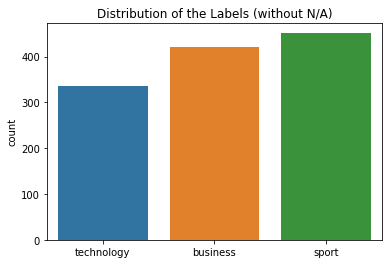

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


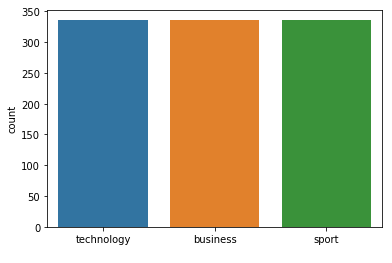



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 207
Class Distribution --> Train data (Fold 6 ):


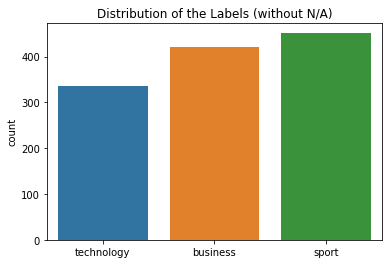

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


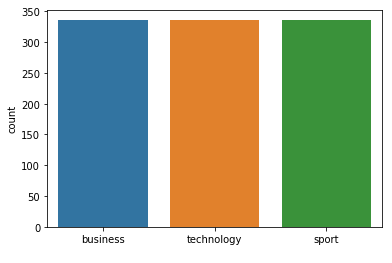



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 207
Class Distribution --> Train data (Fold 7 ):


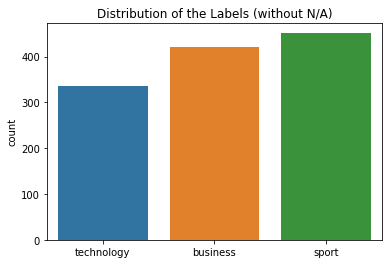

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


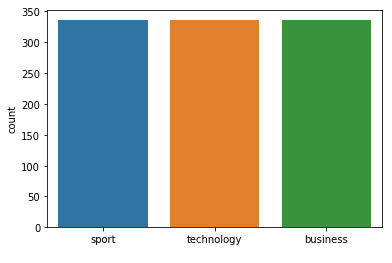



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 207  neighbours): 97.06% (+/- 1.07%)
FOLD 1 Number of neighbors 209
Class Distribution --> Train data (Fold 1 ):


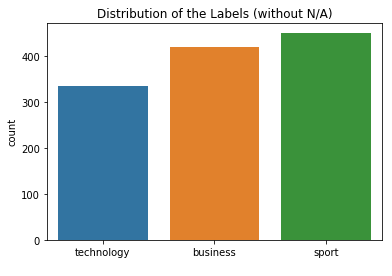

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


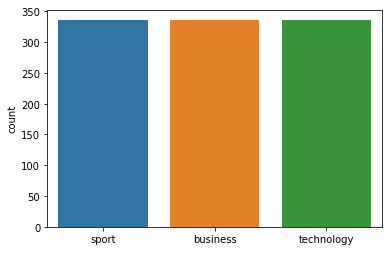



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 209
Class Distribution --> Train data (Fold 2 ):


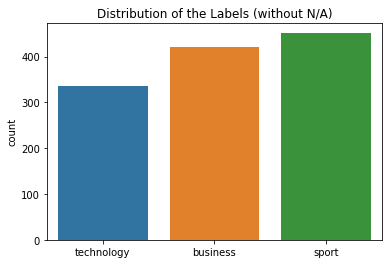

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


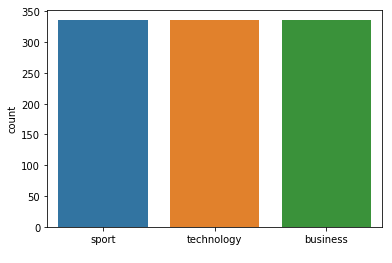



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 209
Class Distribution --> Train data (Fold 3 ):


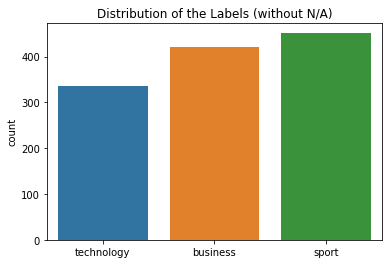

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


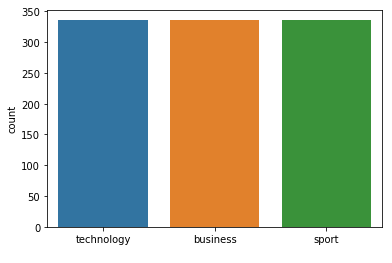



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 209
Class Distribution --> Train data (Fold 4 ):


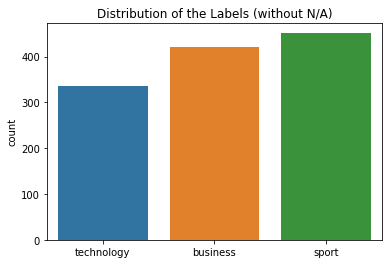

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


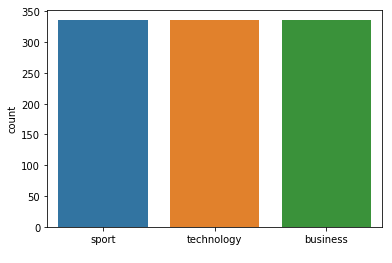



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 209
Class Distribution --> Train data (Fold 5 ):


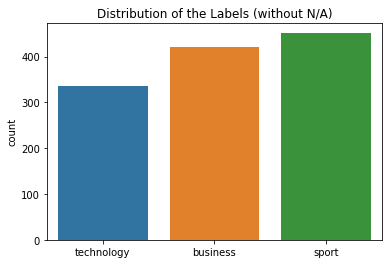

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


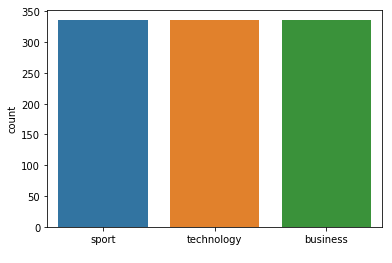



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 209
Class Distribution --> Train data (Fold 6 ):


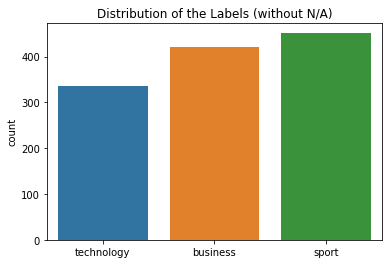

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


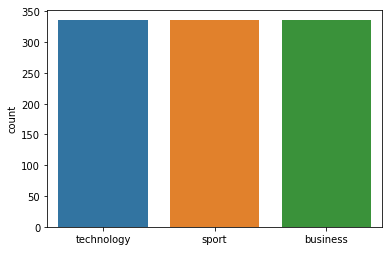



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 209
Class Distribution --> Train data (Fold 7 ):


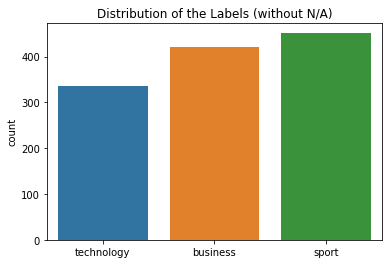

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


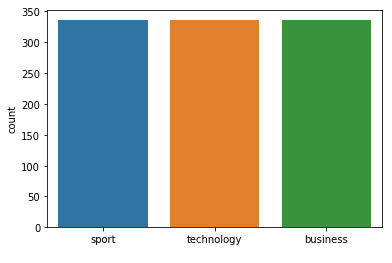



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 209  neighbours): 97.06% (+/- 1.07%)
FOLD 1 Number of neighbors 211
Class Distribution --> Train data (Fold 1 ):


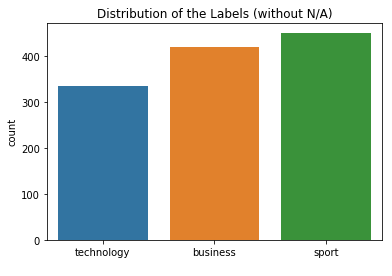

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


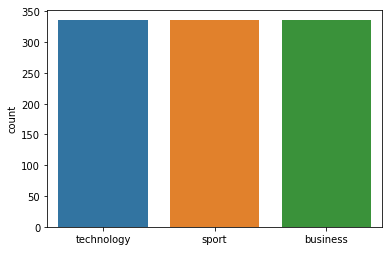



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 211
Class Distribution --> Train data (Fold 2 ):


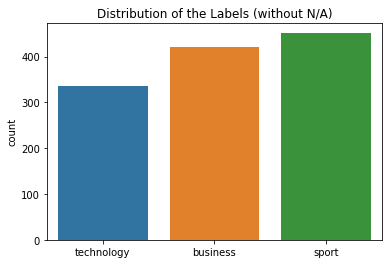

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


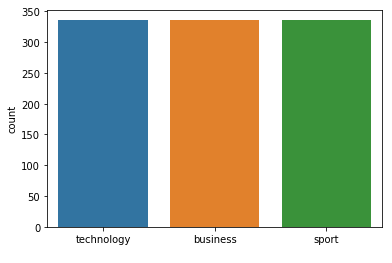



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 211
Class Distribution --> Train data (Fold 3 ):


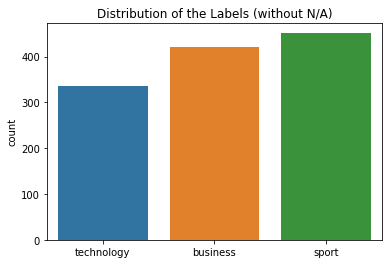

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


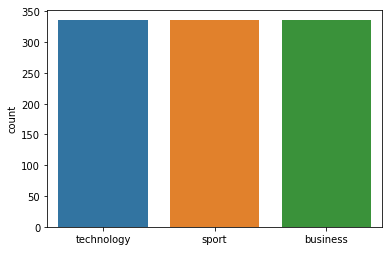



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 211
Class Distribution --> Train data (Fold 4 ):


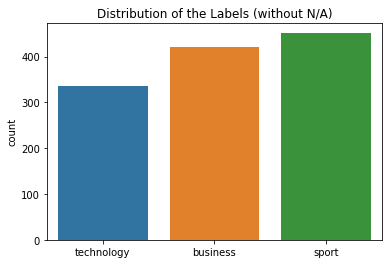

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


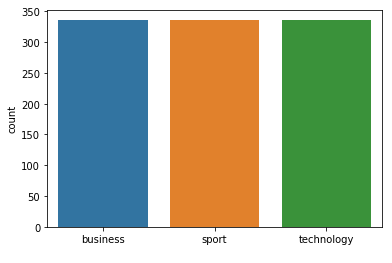



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 211
Class Distribution --> Train data (Fold 5 ):


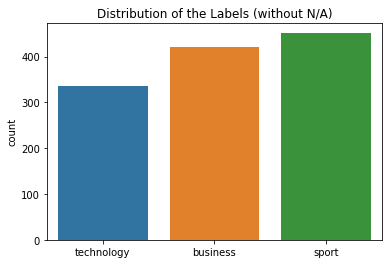

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


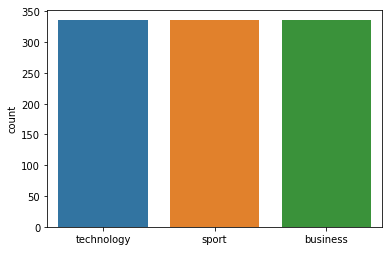



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 211
Class Distribution --> Train data (Fold 6 ):


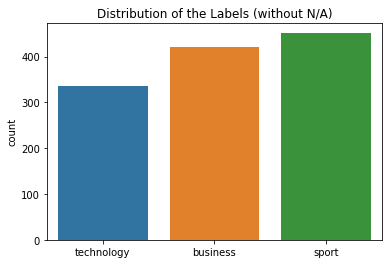

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


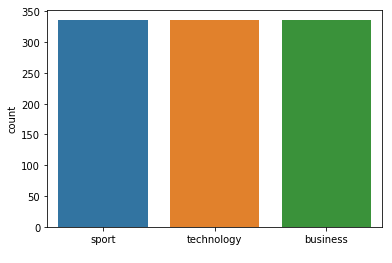



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 211
Class Distribution --> Train data (Fold 7 ):


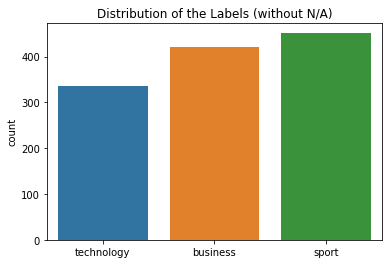

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


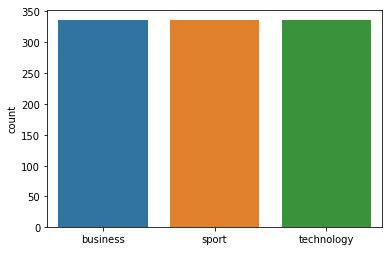



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 211  neighbours): 97.06% (+/- 1.07%)
FOLD 1 Number of neighbors 213
Class Distribution --> Train data (Fold 1 ):


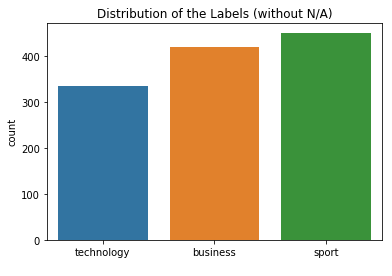

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


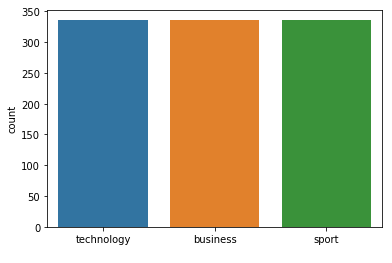



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 213
Class Distribution --> Train data (Fold 2 ):


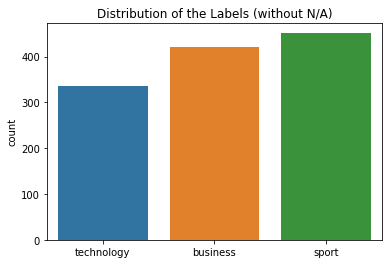

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


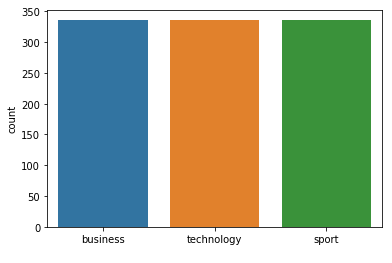



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 213
Class Distribution --> Train data (Fold 3 ):


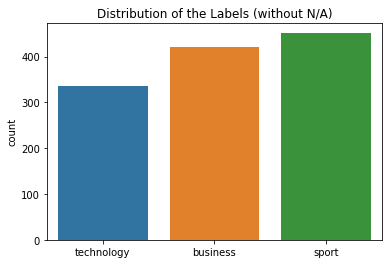

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


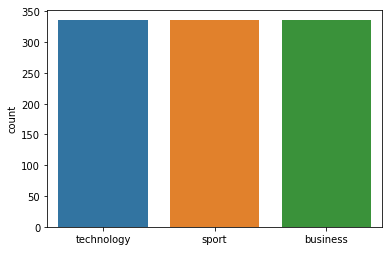



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 213
Class Distribution --> Train data (Fold 4 ):


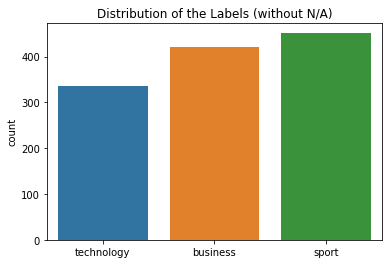

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


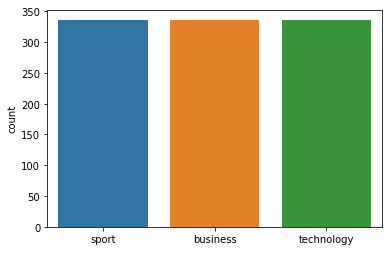



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 213
Class Distribution --> Train data (Fold 5 ):


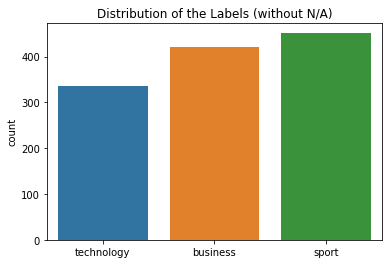

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


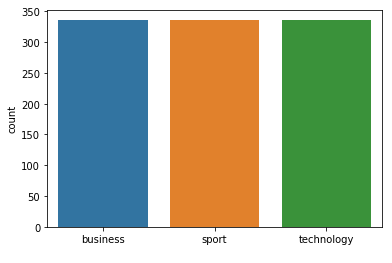



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 213
Class Distribution --> Train data (Fold 6 ):


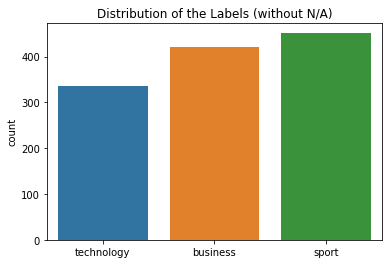

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


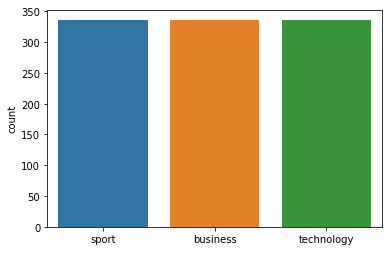



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 213
Class Distribution --> Train data (Fold 7 ):


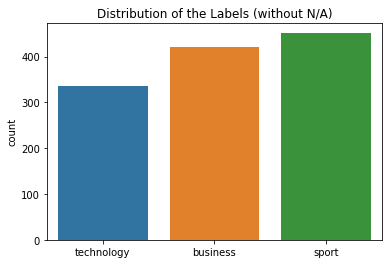

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


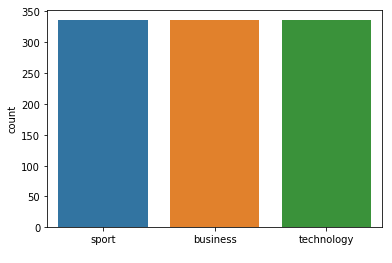



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 213  neighbours): 97.06% (+/- 1.07%)
FOLD 1 Number of neighbors 215
Class Distribution --> Train data (Fold 1 ):


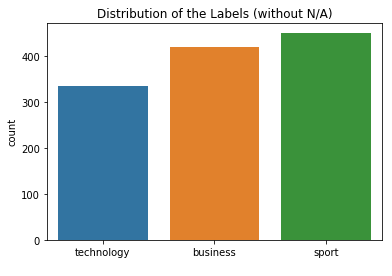

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


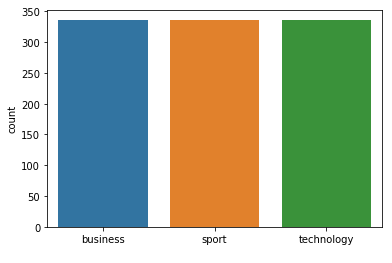



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 215
Class Distribution --> Train data (Fold 2 ):


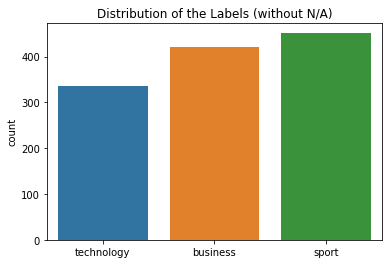

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


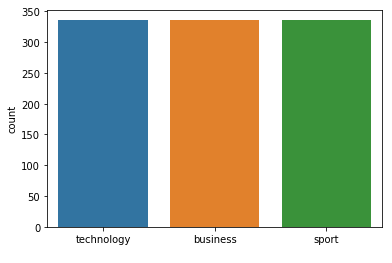



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 215
Class Distribution --> Train data (Fold 3 ):


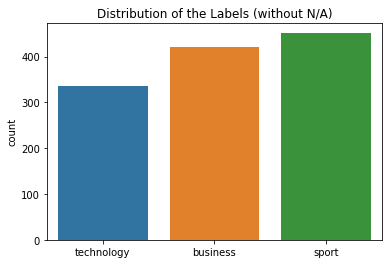

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


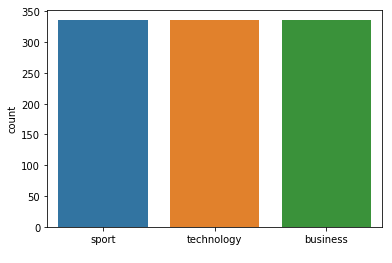



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 215
Class Distribution --> Train data (Fold 4 ):


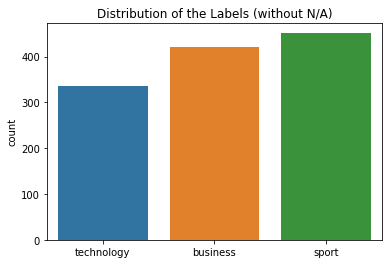

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


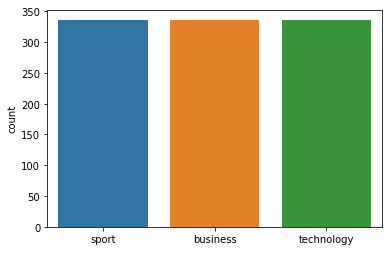



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 215
Class Distribution --> Train data (Fold 5 ):


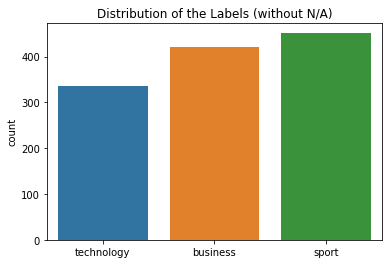

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


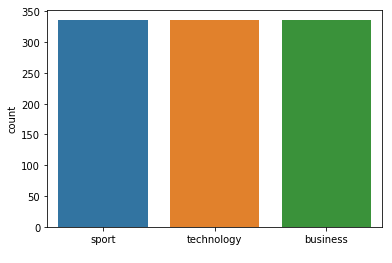



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 215
Class Distribution --> Train data (Fold 6 ):


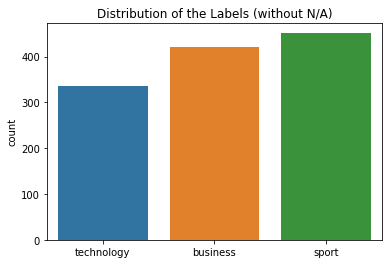

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


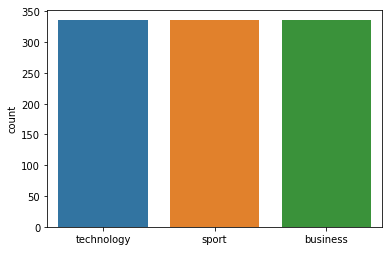



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 215
Class Distribution --> Train data (Fold 7 ):


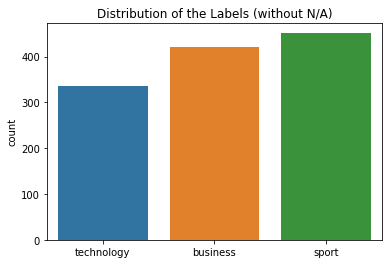

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


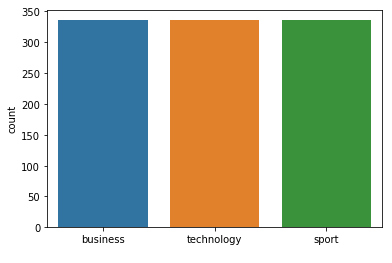



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 215  neighbours): 97.06% (+/- 1.07%)
FOLD 1 Number of neighbors 217
Class Distribution --> Train data (Fold 1 ):


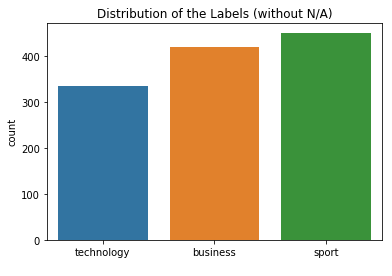

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


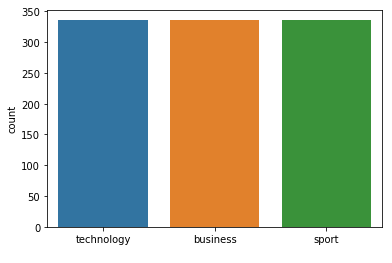



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 217
Class Distribution --> Train data (Fold 2 ):


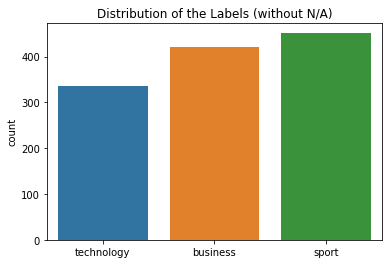

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


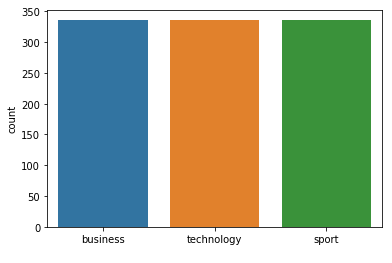



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 217
Class Distribution --> Train data (Fold 3 ):


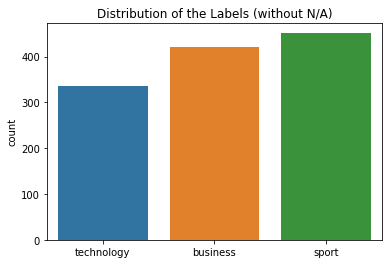

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


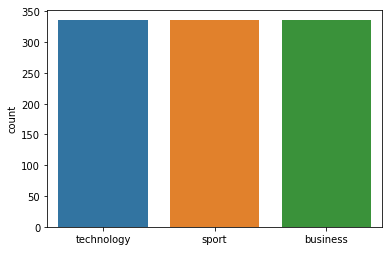



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 217
Class Distribution --> Train data (Fold 4 ):


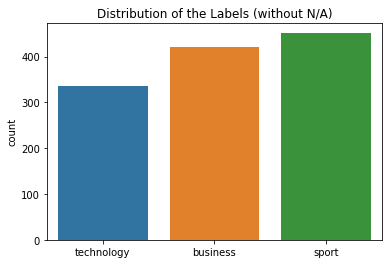

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


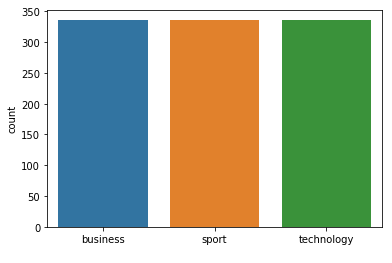



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 217
Class Distribution --> Train data (Fold 5 ):


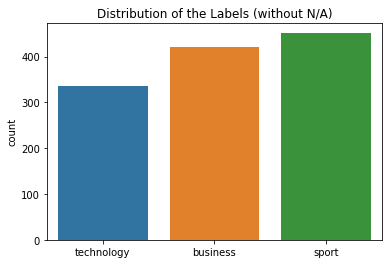

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


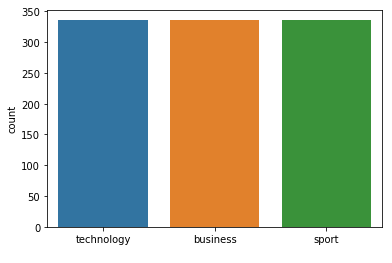



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 217
Class Distribution --> Train data (Fold 6 ):


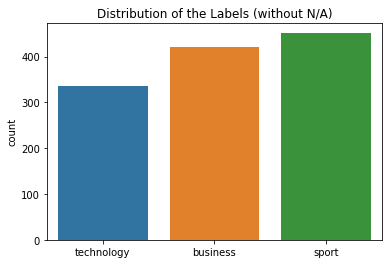

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


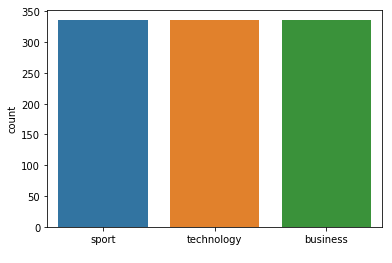



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 217
Class Distribution --> Train data (Fold 7 ):


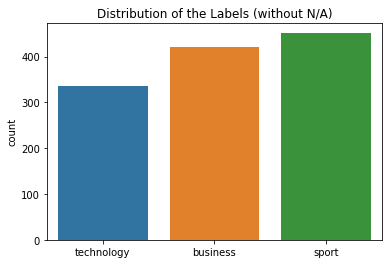

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


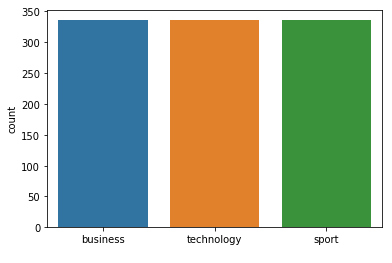



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 217  neighbours): 97.06% (+/- 1.07%)
FOLD 1 Number of neighbors 219
Class Distribution --> Train data (Fold 1 ):


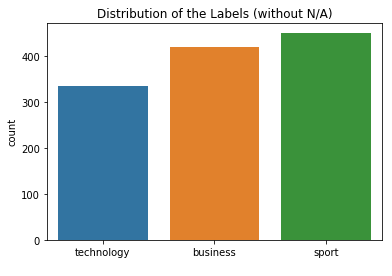

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


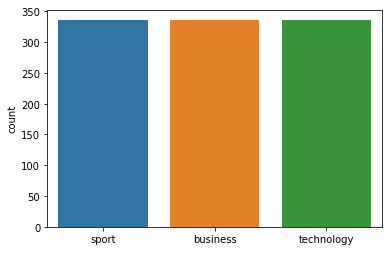



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 219
Class Distribution --> Train data (Fold 2 ):


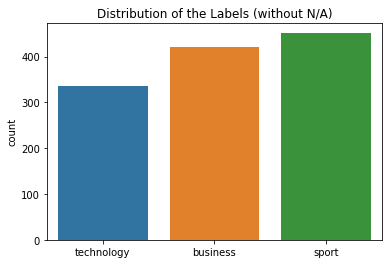

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


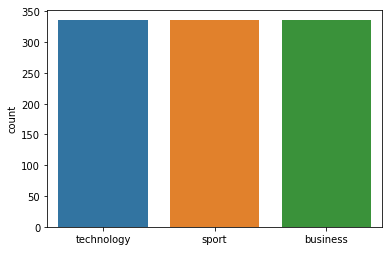



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 219
Class Distribution --> Train data (Fold 3 ):


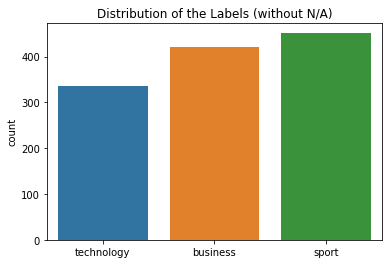

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


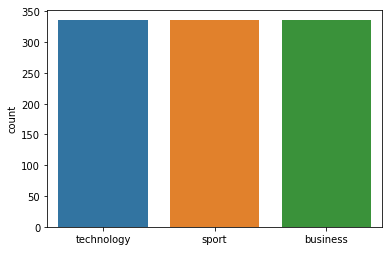



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 219
Class Distribution --> Train data (Fold 4 ):


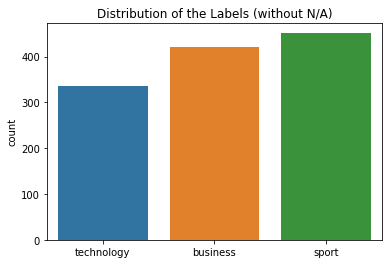

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


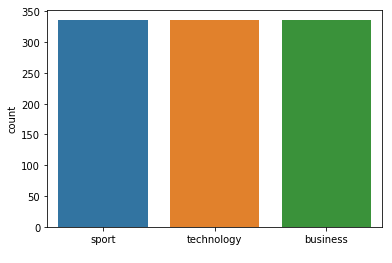



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 219
Class Distribution --> Train data (Fold 5 ):


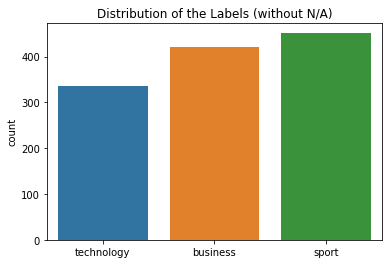

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


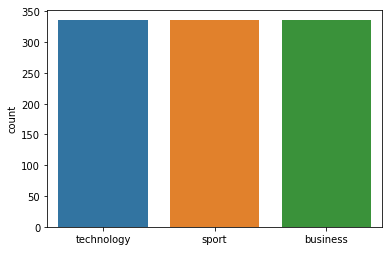



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 219
Class Distribution --> Train data (Fold 6 ):


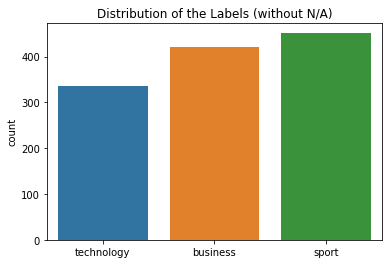

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


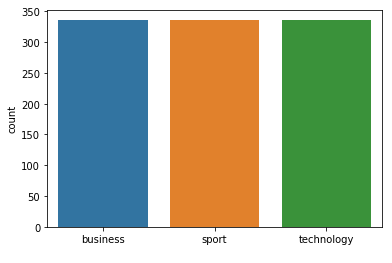



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 219
Class Distribution --> Train data (Fold 7 ):


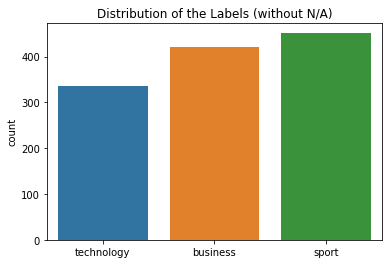

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


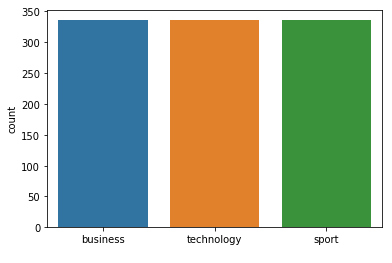



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 219  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 221
Class Distribution --> Train data (Fold 1 ):


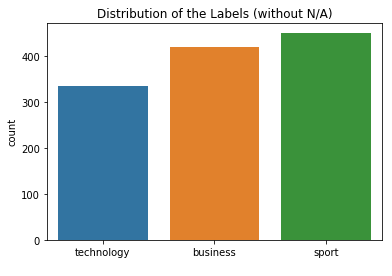

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


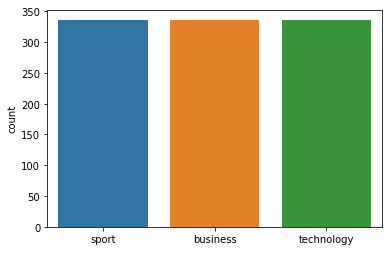



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 221
Class Distribution --> Train data (Fold 2 ):


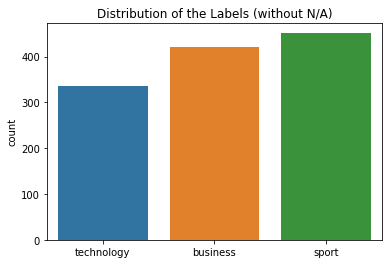

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


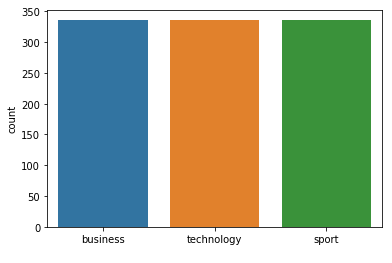



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 221
Class Distribution --> Train data (Fold 3 ):


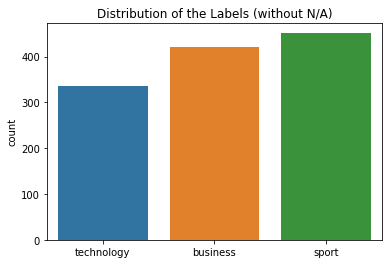

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


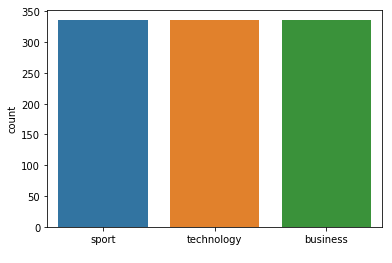



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 221
Class Distribution --> Train data (Fold 4 ):


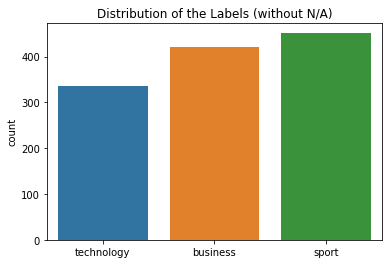

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


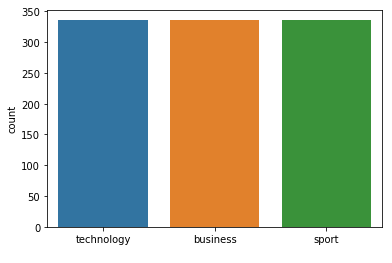



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 221
Class Distribution --> Train data (Fold 5 ):


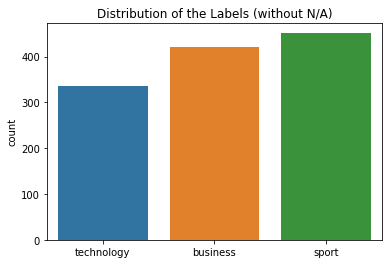

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


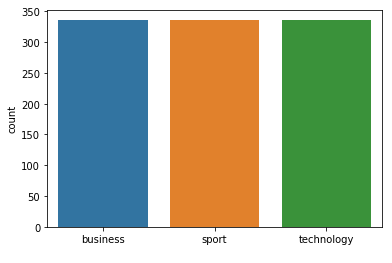



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 221
Class Distribution --> Train data (Fold 6 ):


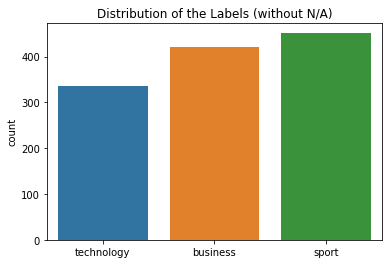

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


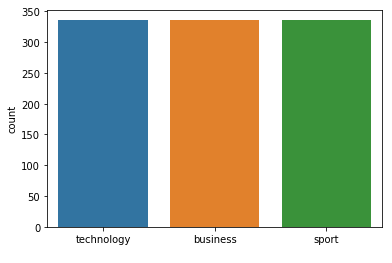



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 221
Class Distribution --> Train data (Fold 7 ):


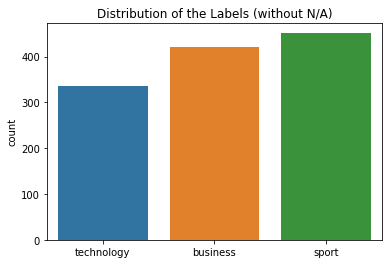

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


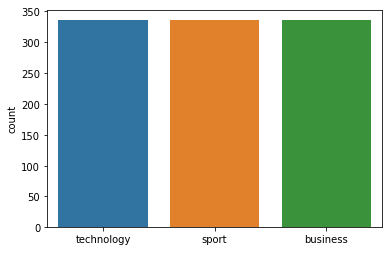



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 221  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 223
Class Distribution --> Train data (Fold 1 ):


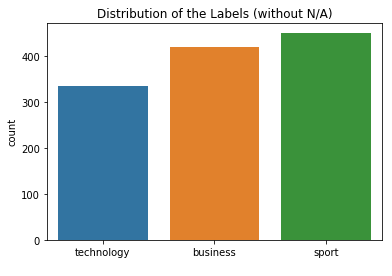

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


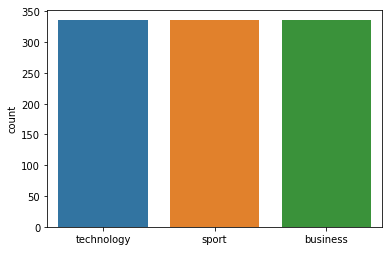



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 223
Class Distribution --> Train data (Fold 2 ):


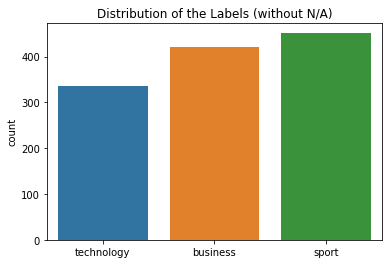

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


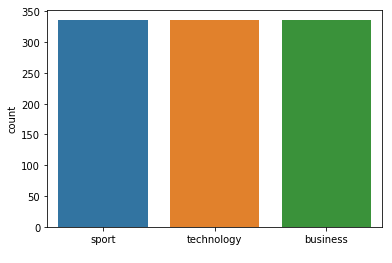



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 223
Class Distribution --> Train data (Fold 3 ):


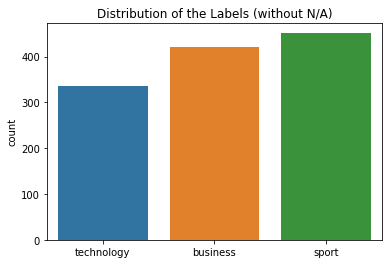

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


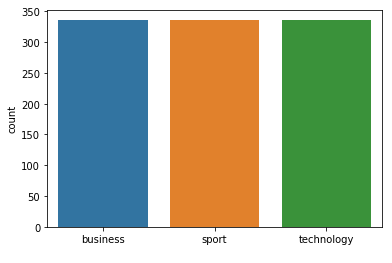



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 223
Class Distribution --> Train data (Fold 4 ):


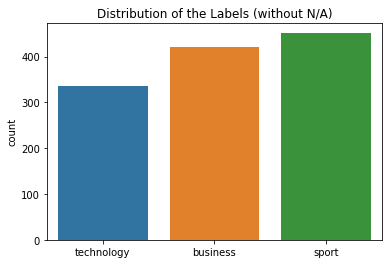

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


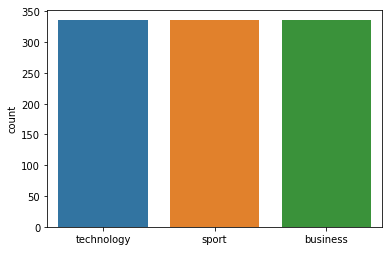



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       1.00      0.97      0.99        75
technology
       1.00      1.00      1.00        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 223
Class Distribution --> Train data (Fold 5 ):


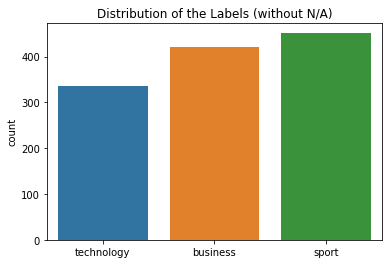

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


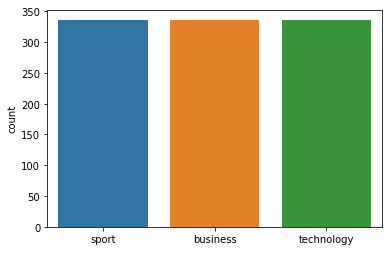



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 223
Class Distribution --> Train data (Fold 6 ):


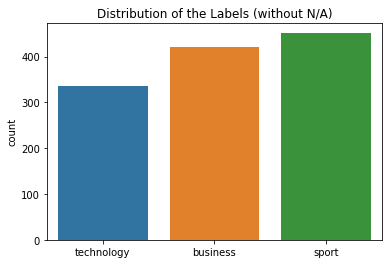

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


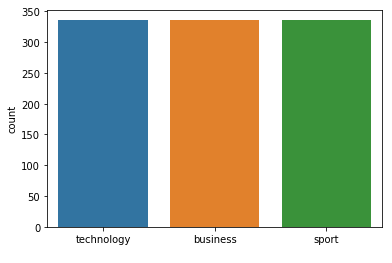



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 223
Class Distribution --> Train data (Fold 7 ):


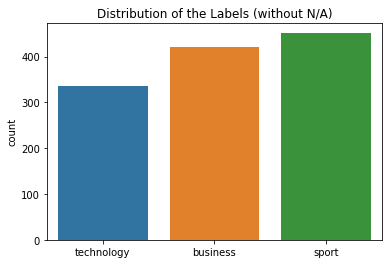

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


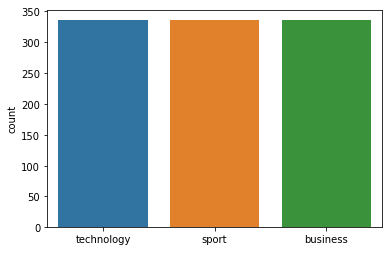



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 223  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 225
Class Distribution --> Train data (Fold 1 ):


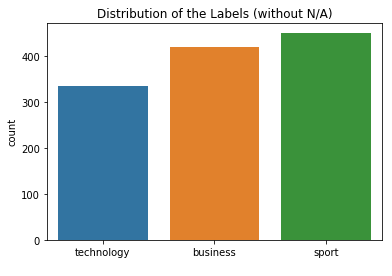

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


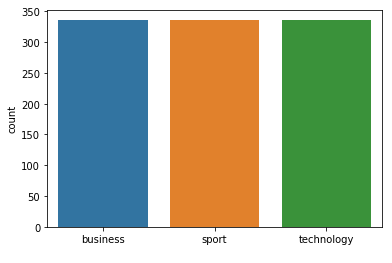



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.96      0.93      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 225
Class Distribution --> Train data (Fold 2 ):


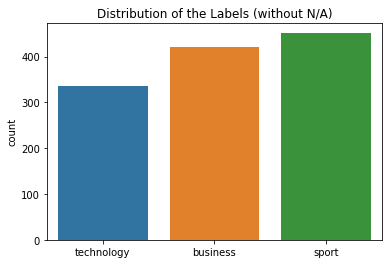

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


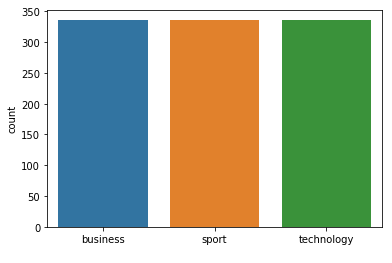



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 225
Class Distribution --> Train data (Fold 3 ):


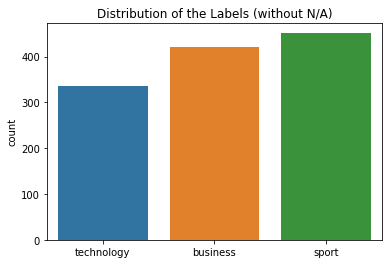

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


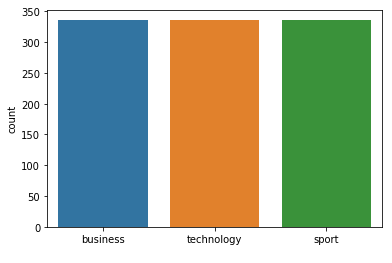



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 225
Class Distribution --> Train data (Fold 4 ):


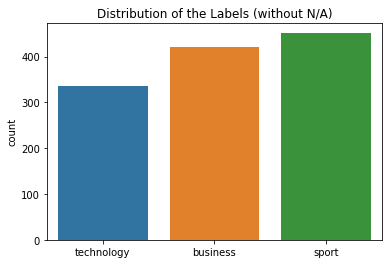

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


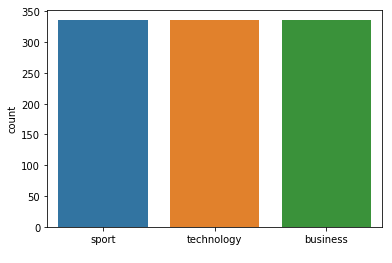



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 225
Class Distribution --> Train data (Fold 5 ):


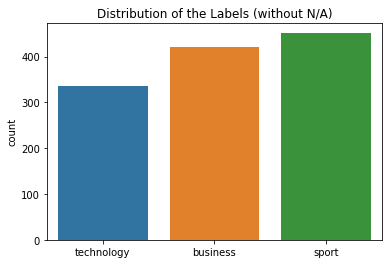

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


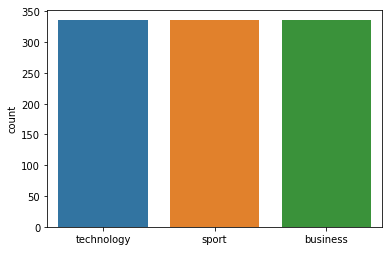



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 225
Class Distribution --> Train data (Fold 6 ):


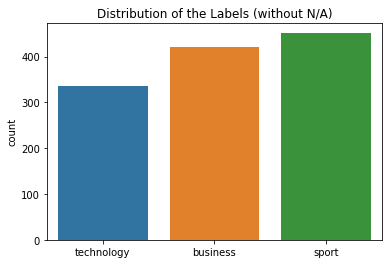

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


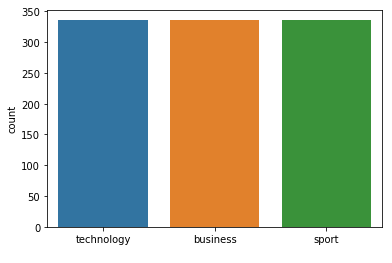



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 225
Class Distribution --> Train data (Fold 7 ):


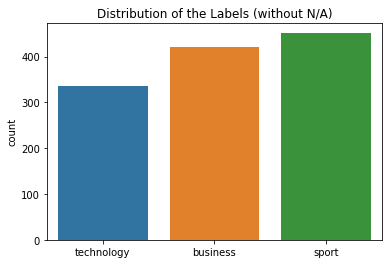

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


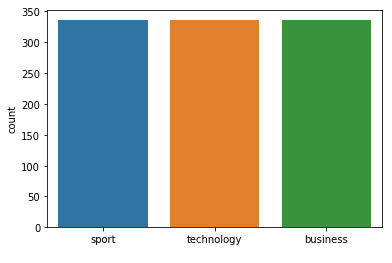



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 225  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 227
Class Distribution --> Train data (Fold 1 ):


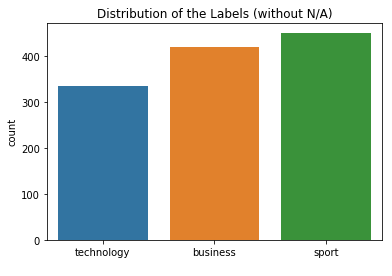

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


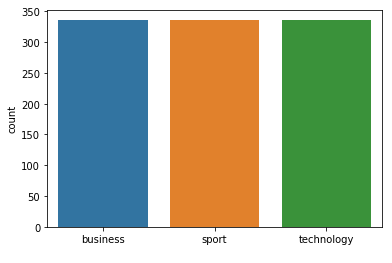



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.95      0.99      0.97        76
technology
       0.96      0.93      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 227
Class Distribution --> Train data (Fold 2 ):


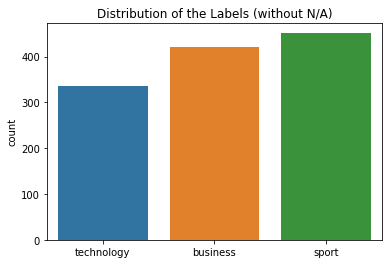

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


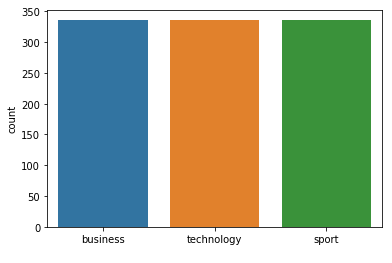



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 227
Class Distribution --> Train data (Fold 3 ):


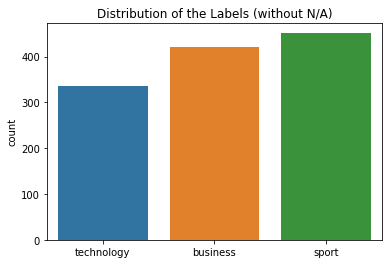

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


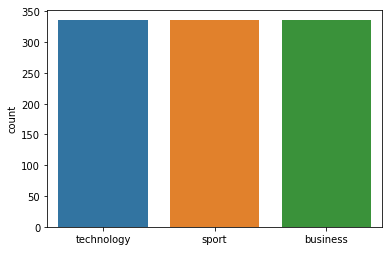



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 227
Class Distribution --> Train data (Fold 4 ):


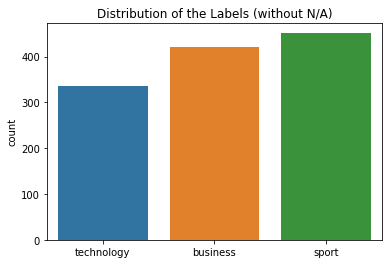

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


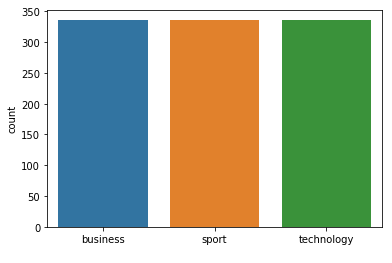



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 227
Class Distribution --> Train data (Fold 5 ):


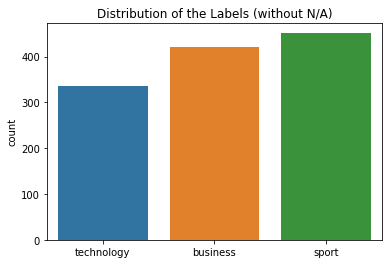

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


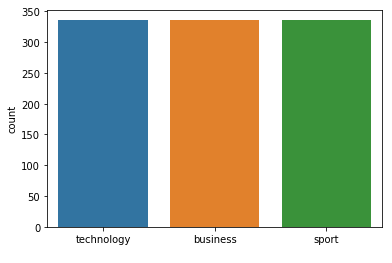



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 227
Class Distribution --> Train data (Fold 6 ):


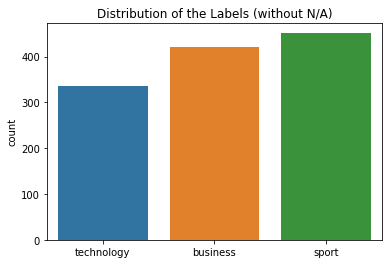

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


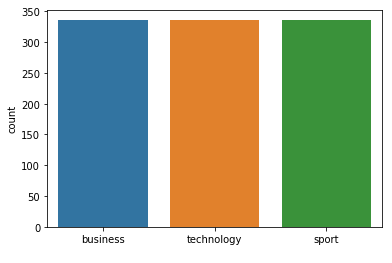



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 227
Class Distribution --> Train data (Fold 7 ):


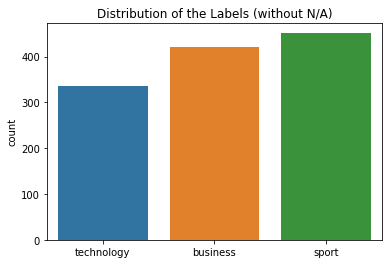

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


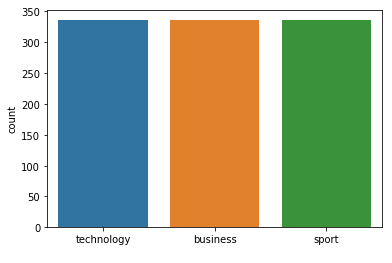



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  3 51]]


 Model accuracy (for 227  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 229
Class Distribution --> Train data (Fold 1 ):


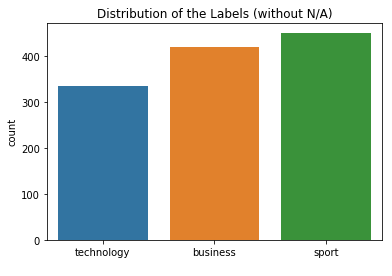

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


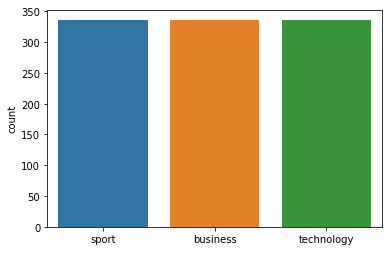



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 229
Class Distribution --> Train data (Fold 2 ):


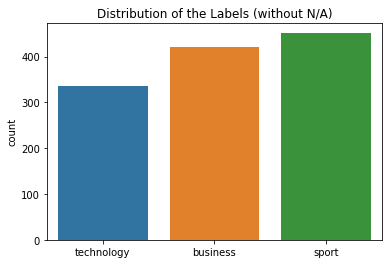

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


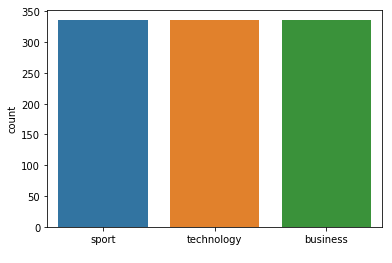



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 229
Class Distribution --> Train data (Fold 3 ):


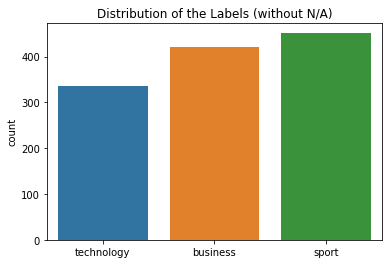

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


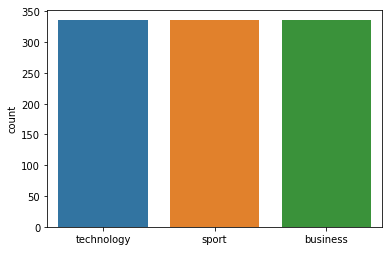



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 229
Class Distribution --> Train data (Fold 4 ):


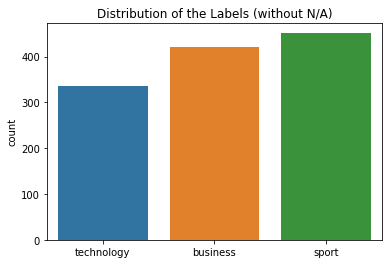

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


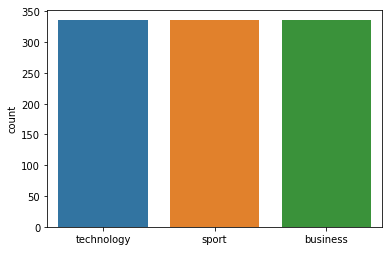



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 229
Class Distribution --> Train data (Fold 5 ):


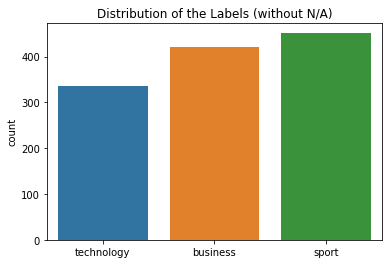

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


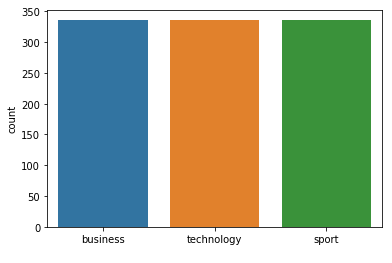



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 229
Class Distribution --> Train data (Fold 6 ):


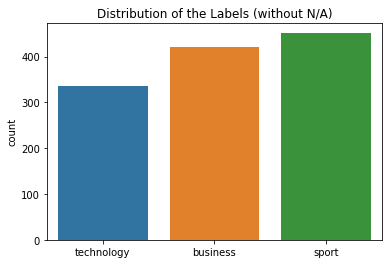

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


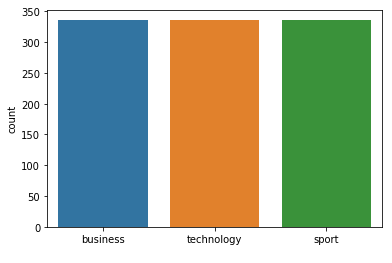



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 229
Class Distribution --> Train data (Fold 7 ):


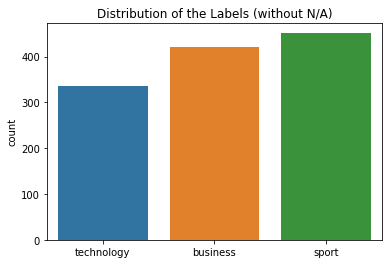

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


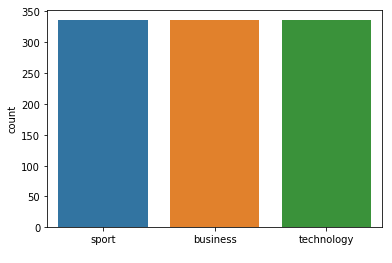



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 229  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 231
Class Distribution --> Train data (Fold 1 ):


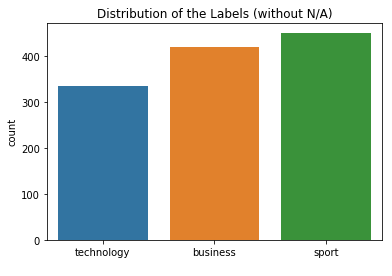

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


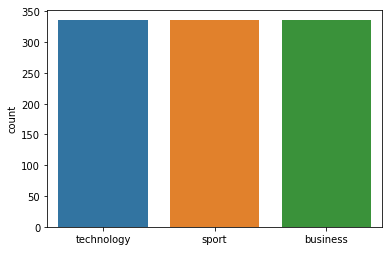



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.95      0.97      0.96        76
technology
       0.96      0.93      0.95        56

avg / total       0.96      0.96      0.96       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 231
Class Distribution --> Train data (Fold 2 ):


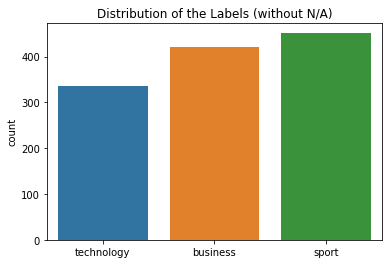

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


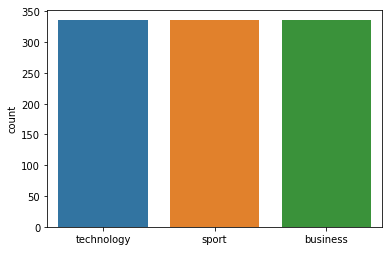



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 231
Class Distribution --> Train data (Fold 3 ):


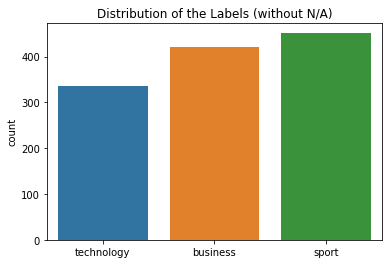

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


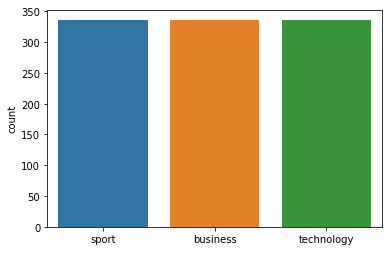



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 231
Class Distribution --> Train data (Fold 4 ):


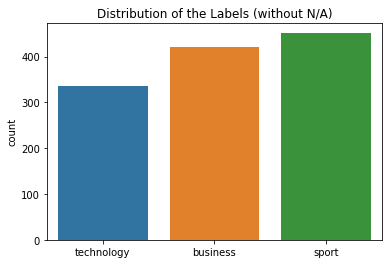

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


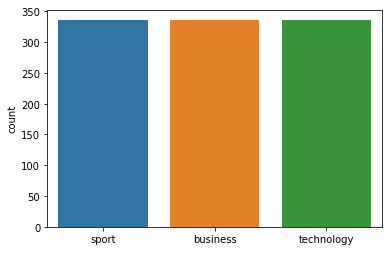



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 231
Class Distribution --> Train data (Fold 5 ):


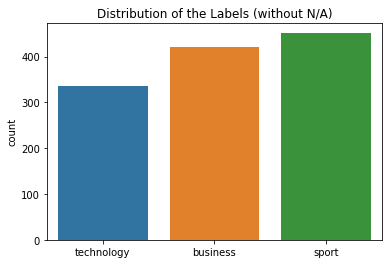

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


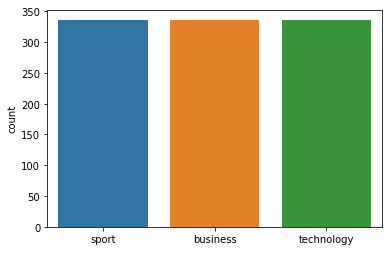



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 231
Class Distribution --> Train data (Fold 6 ):


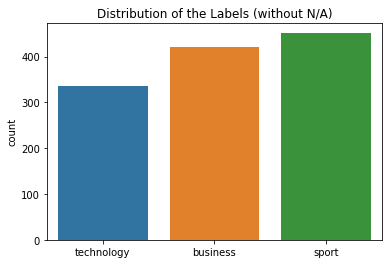

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


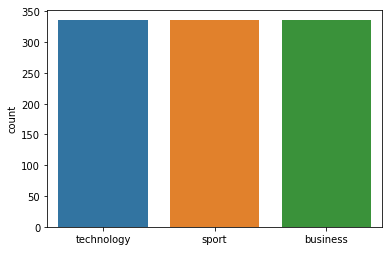



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 231
Class Distribution --> Train data (Fold 7 ):


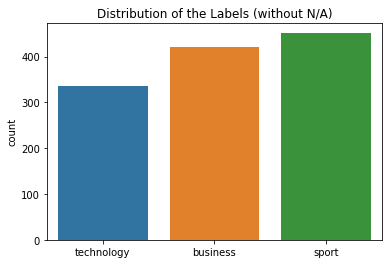

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


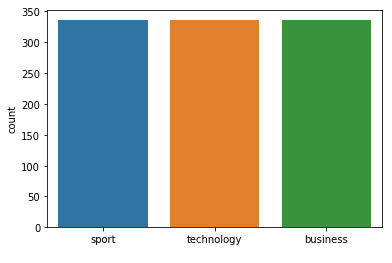



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 231  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 233
Class Distribution --> Train data (Fold 1 ):


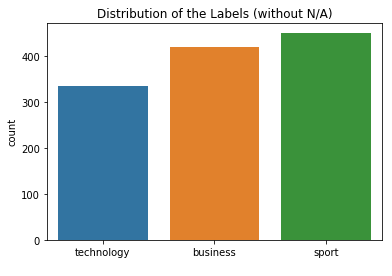

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


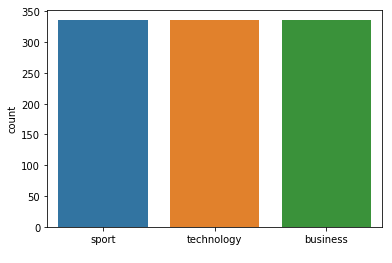



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.95      0.97      0.96        76
technology
       0.96      0.93      0.95        56

avg / total       0.96      0.96      0.96       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 233
Class Distribution --> Train data (Fold 2 ):


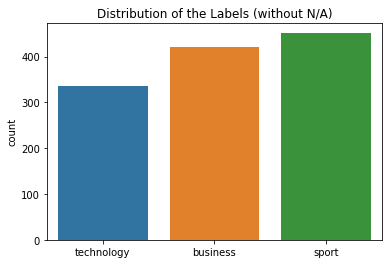

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


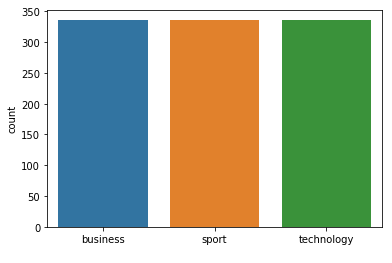



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 233
Class Distribution --> Train data (Fold 3 ):


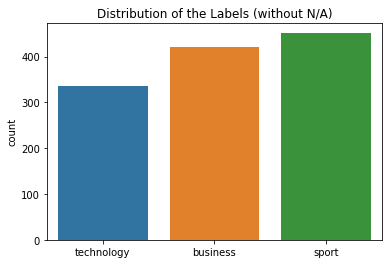

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


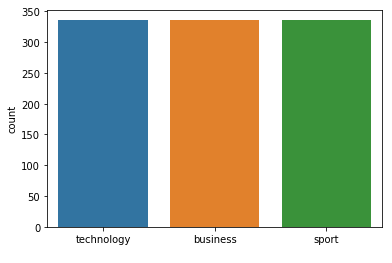



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.93      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 233
Class Distribution --> Train data (Fold 4 ):


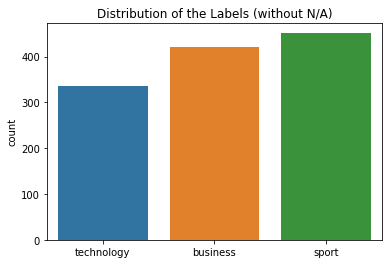

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


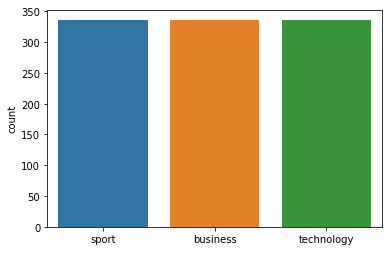



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 233
Class Distribution --> Train data (Fold 5 ):


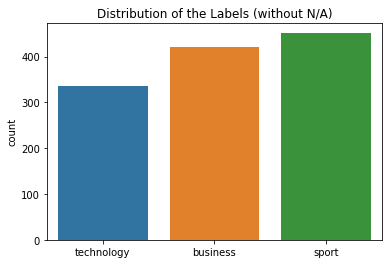

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


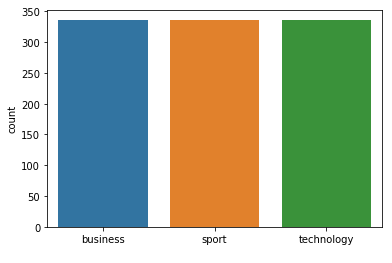



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 233
Class Distribution --> Train data (Fold 6 ):


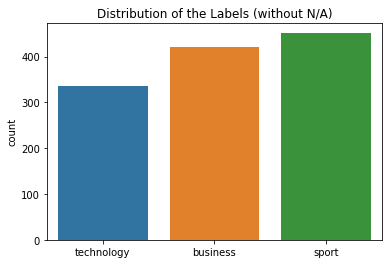

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


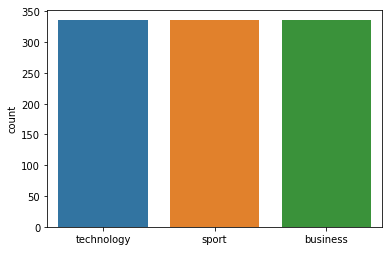



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 233
Class Distribution --> Train data (Fold 7 ):


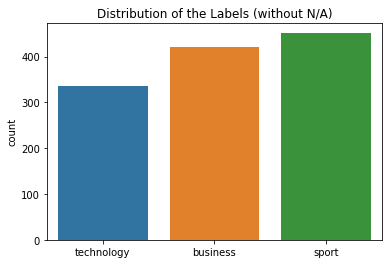

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


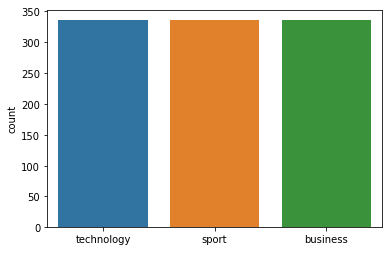



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 233  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 235
Class Distribution --> Train data (Fold 1 ):


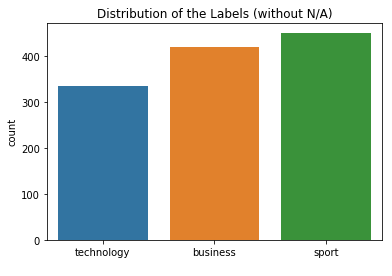

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


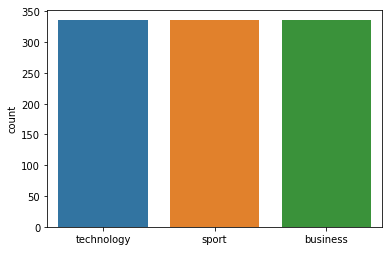



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 235
Class Distribution --> Train data (Fold 2 ):


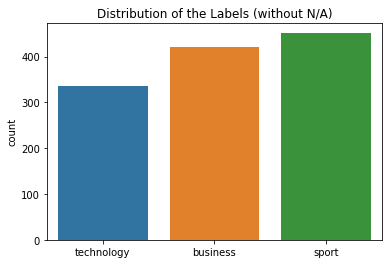

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


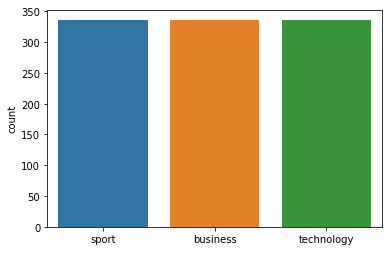



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 235
Class Distribution --> Train data (Fold 3 ):


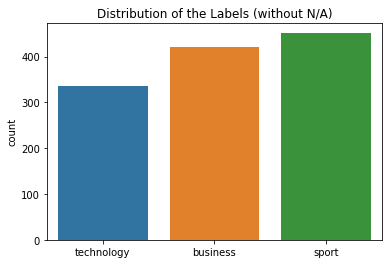

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


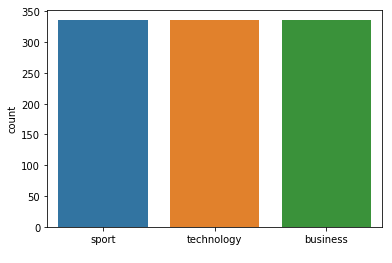



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 235
Class Distribution --> Train data (Fold 4 ):


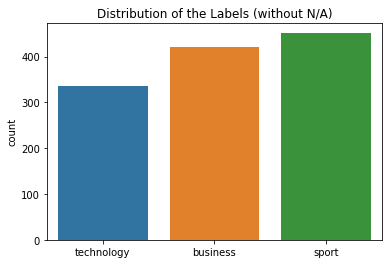

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


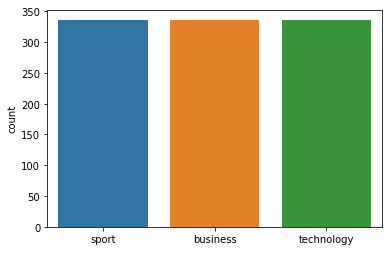



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 235
Class Distribution --> Train data (Fold 5 ):


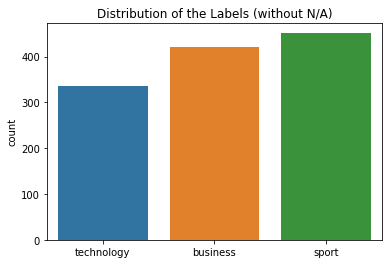

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


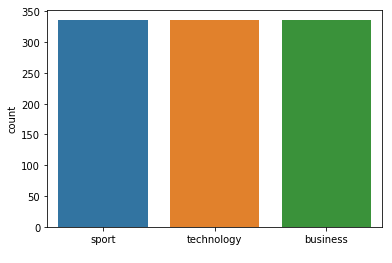



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 235
Class Distribution --> Train data (Fold 6 ):


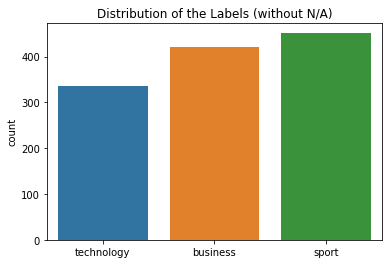

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


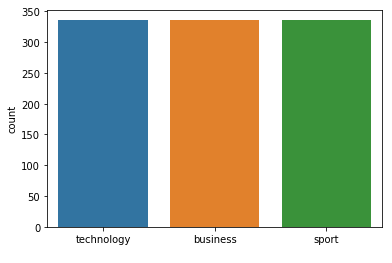



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 235
Class Distribution --> Train data (Fold 7 ):


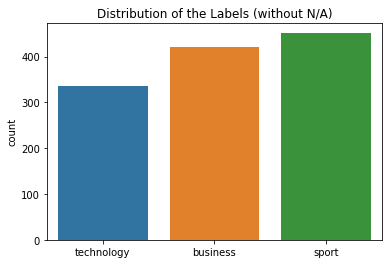

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


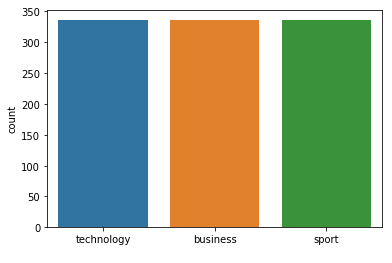



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  3 51]]


 Model accuracy (for 235  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 237
Class Distribution --> Train data (Fold 1 ):


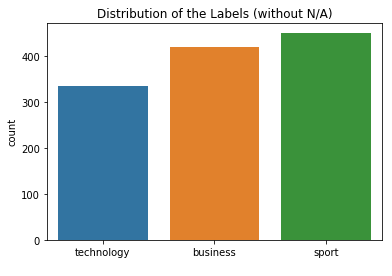

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


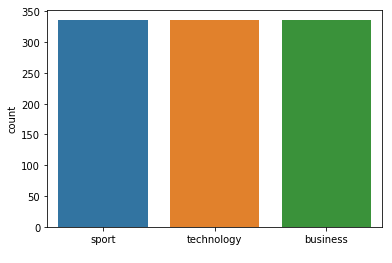



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 237
Class Distribution --> Train data (Fold 2 ):


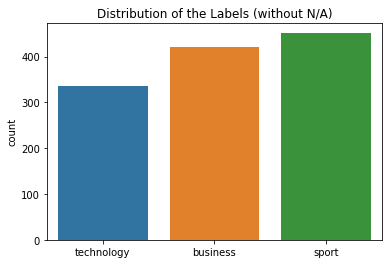

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


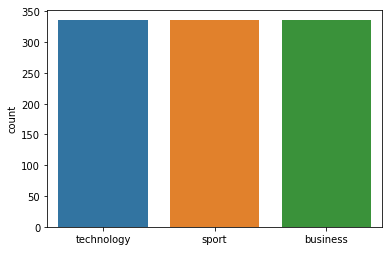



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 237
Class Distribution --> Train data (Fold 3 ):


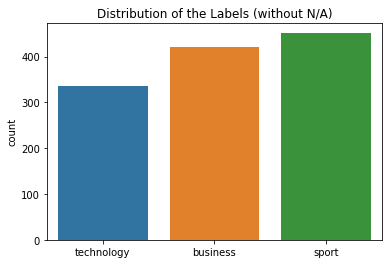

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


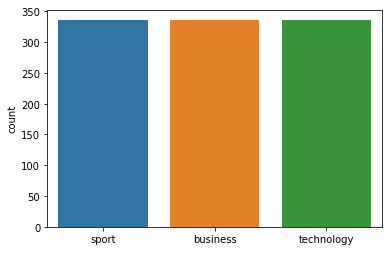



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 237
Class Distribution --> Train data (Fold 4 ):


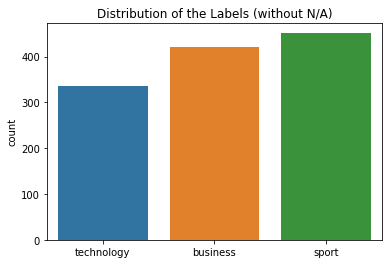

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


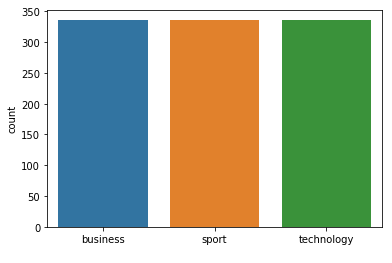



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 237
Class Distribution --> Train data (Fold 5 ):


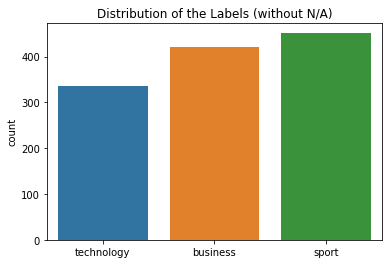

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


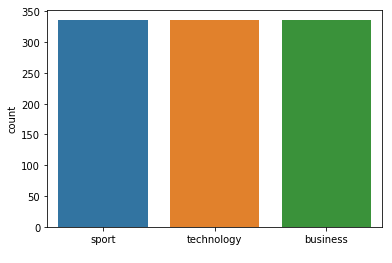



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 237
Class Distribution --> Train data (Fold 6 ):


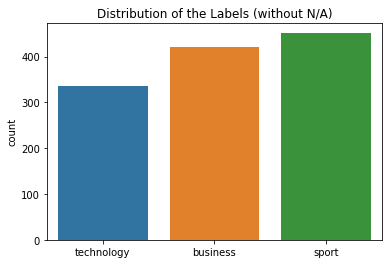

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


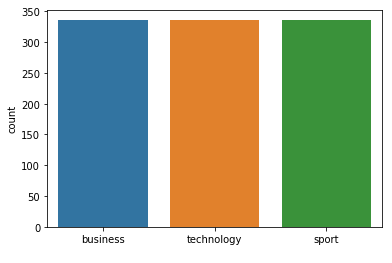



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 237
Class Distribution --> Train data (Fold 7 ):


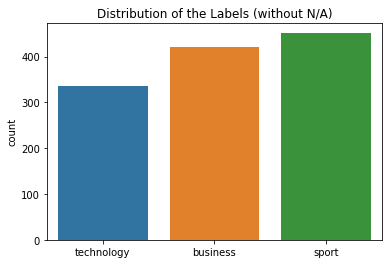

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


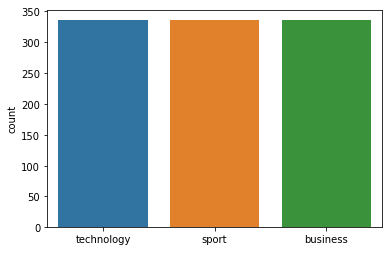



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 237  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 239
Class Distribution --> Train data (Fold 1 ):


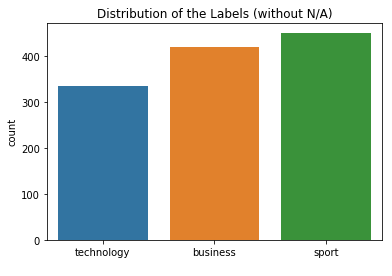

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


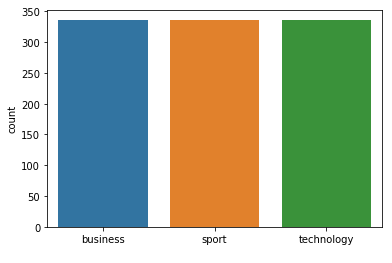



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 239
Class Distribution --> Train data (Fold 2 ):


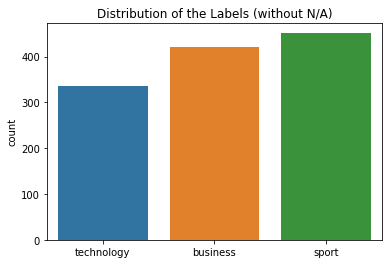

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


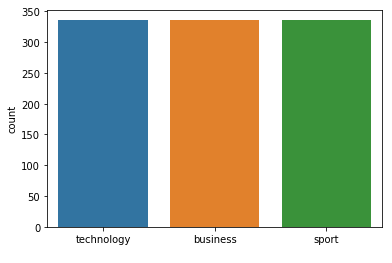



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 239
Class Distribution --> Train data (Fold 3 ):


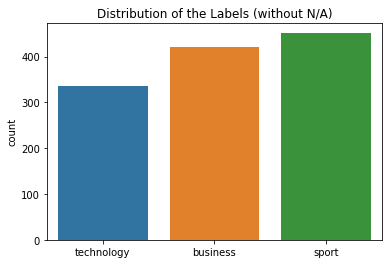

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


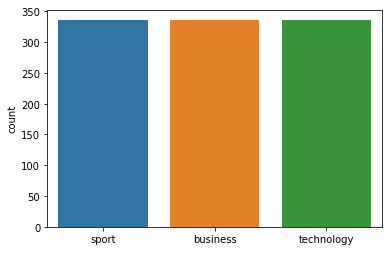



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 239
Class Distribution --> Train data (Fold 4 ):


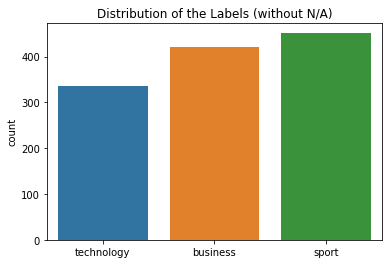

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


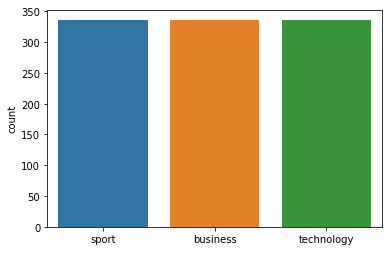



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 239
Class Distribution --> Train data (Fold 5 ):


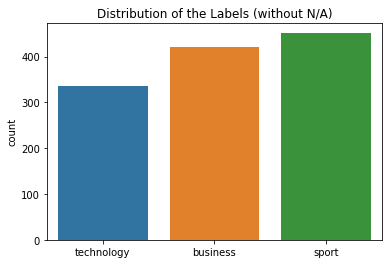

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


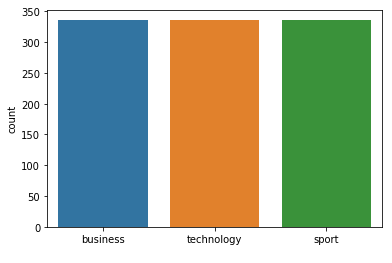



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 239
Class Distribution --> Train data (Fold 6 ):


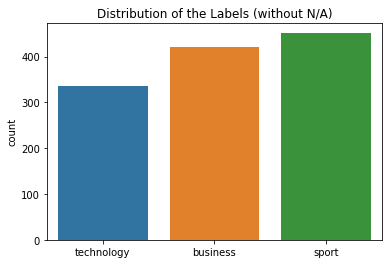

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


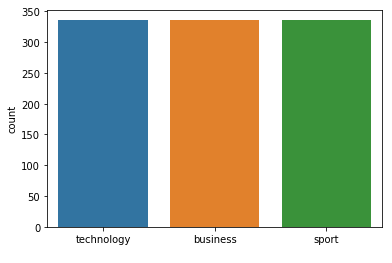



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 239
Class Distribution --> Train data (Fold 7 ):


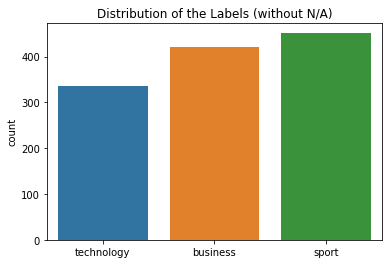

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


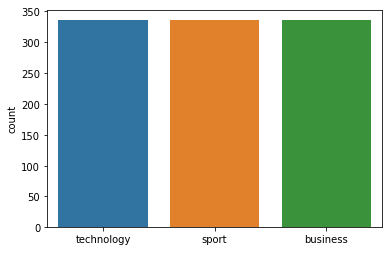



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 239  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 241
Class Distribution --> Train data (Fold 1 ):


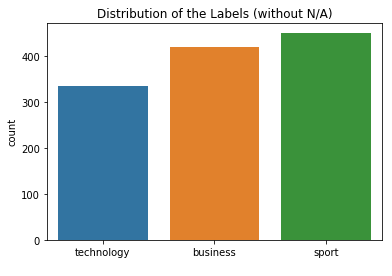

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


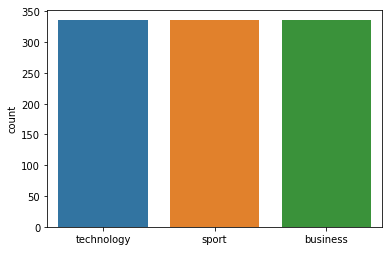



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 241
Class Distribution --> Train data (Fold 2 ):


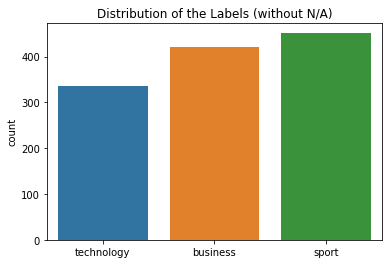

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


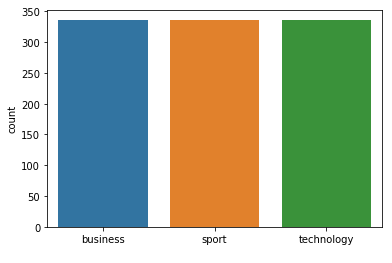



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 241
Class Distribution --> Train data (Fold 3 ):


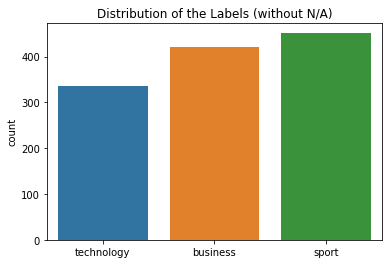

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


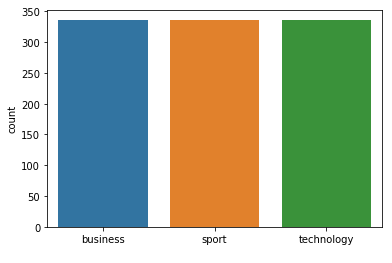



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 241
Class Distribution --> Train data (Fold 4 ):


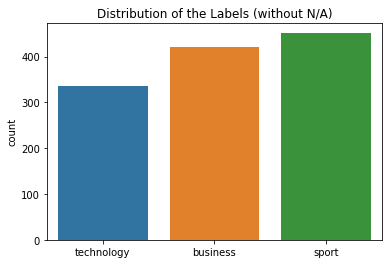

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


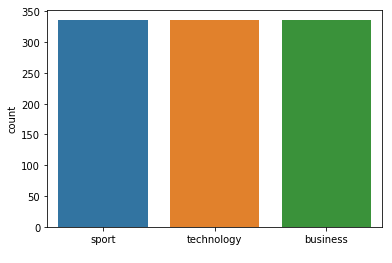



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 241
Class Distribution --> Train data (Fold 5 ):


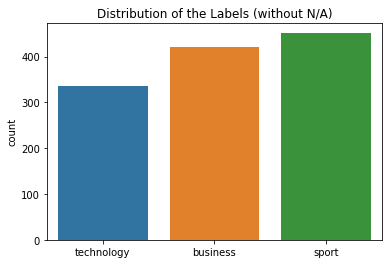

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


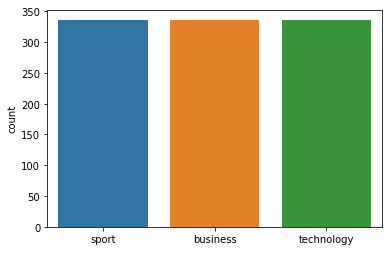



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 241
Class Distribution --> Train data (Fold 6 ):


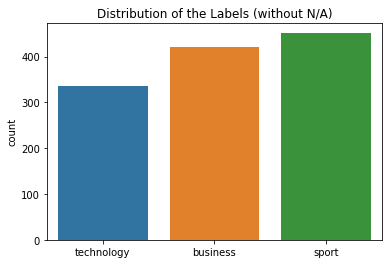

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


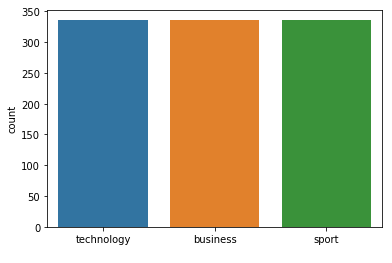



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 241
Class Distribution --> Train data (Fold 7 ):


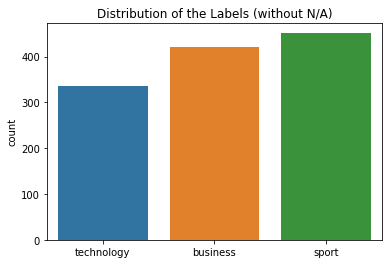

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


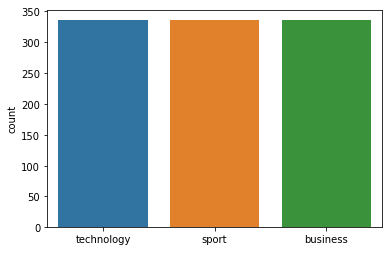



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 241  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 243
Class Distribution --> Train data (Fold 1 ):


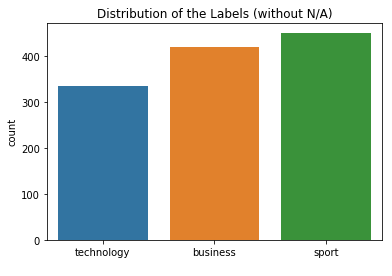

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


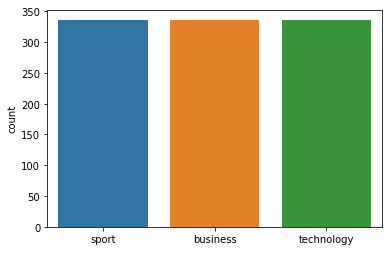



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 243
Class Distribution --> Train data (Fold 2 ):


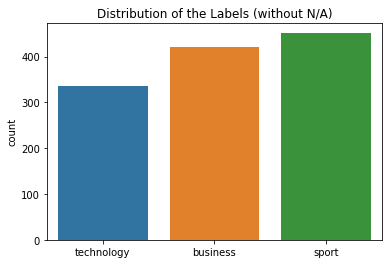

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


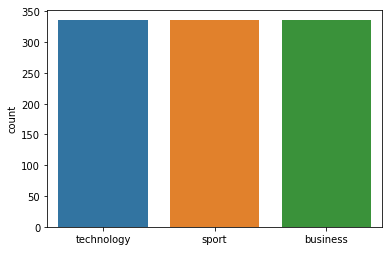



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 243
Class Distribution --> Train data (Fold 3 ):


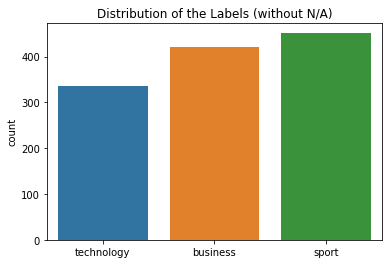

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


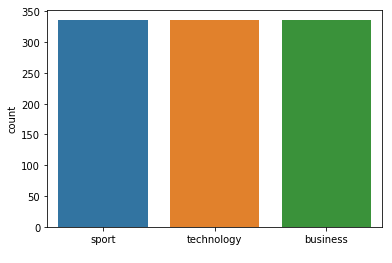



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 243
Class Distribution --> Train data (Fold 4 ):


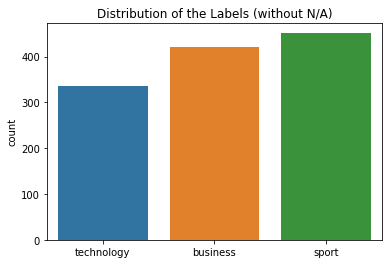

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


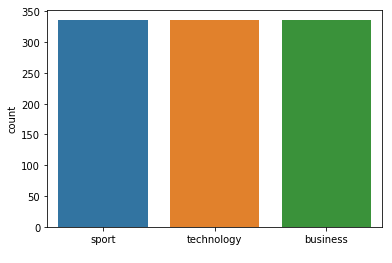



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 243
Class Distribution --> Train data (Fold 5 ):


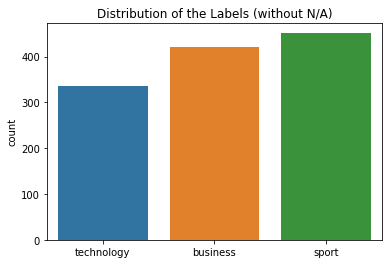

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


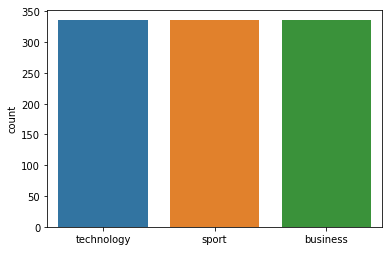



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 243
Class Distribution --> Train data (Fold 6 ):


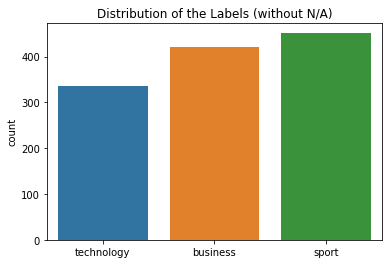

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


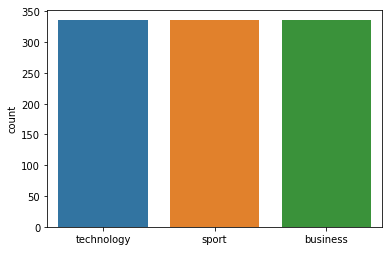



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 243
Class Distribution --> Train data (Fold 7 ):


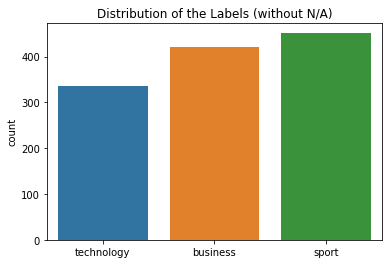

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


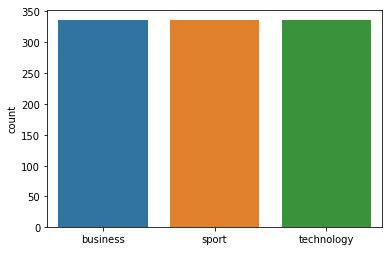



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 243  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 245
Class Distribution --> Train data (Fold 1 ):


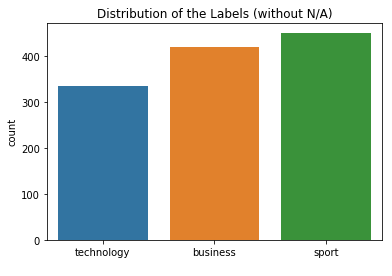

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


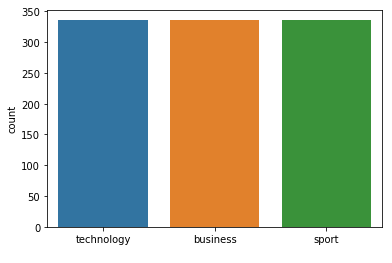



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 245
Class Distribution --> Train data (Fold 2 ):


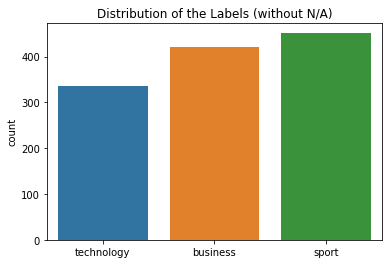

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


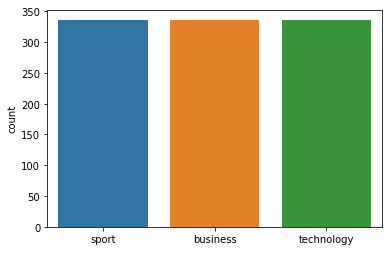



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 245
Class Distribution --> Train data (Fold 3 ):


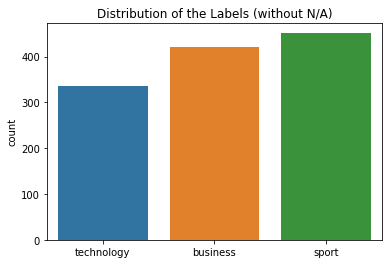

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


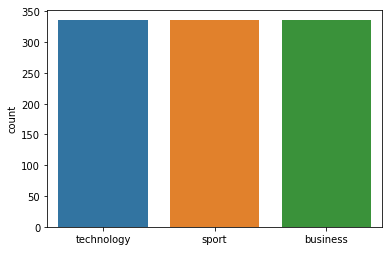



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 245
Class Distribution --> Train data (Fold 4 ):


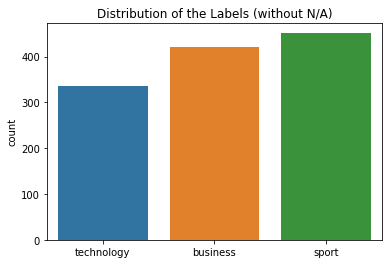

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


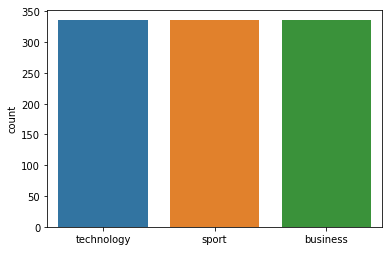



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 245
Class Distribution --> Train data (Fold 5 ):


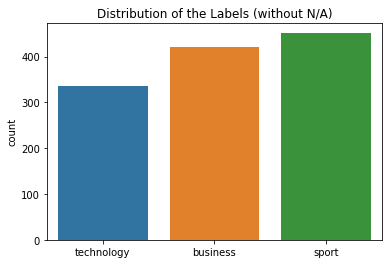

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


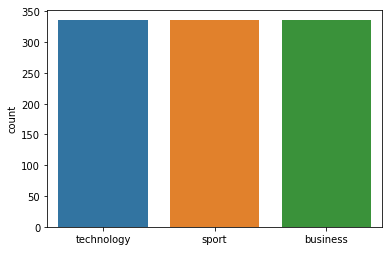



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 245
Class Distribution --> Train data (Fold 6 ):


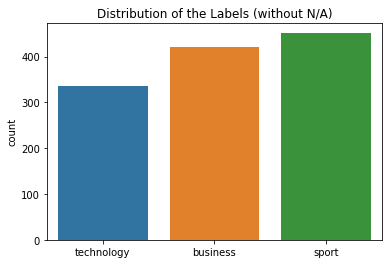

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


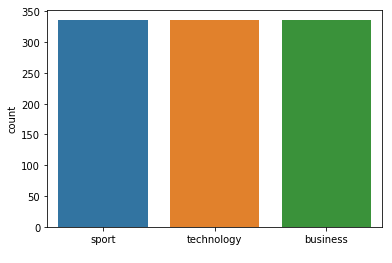



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 245
Class Distribution --> Train data (Fold 7 ):


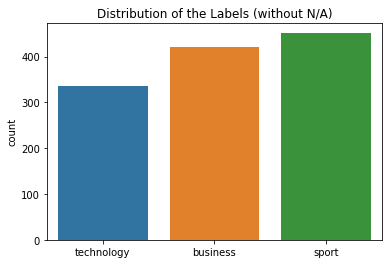

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


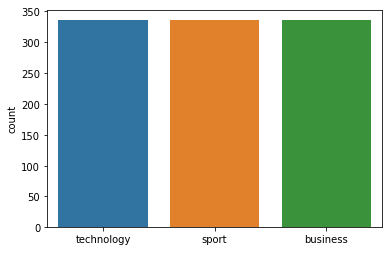



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 245  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 247
Class Distribution --> Train data (Fold 1 ):


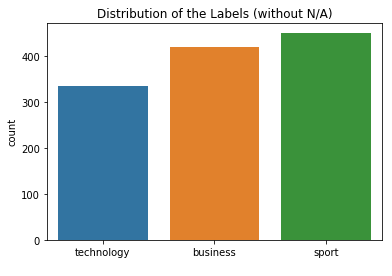

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


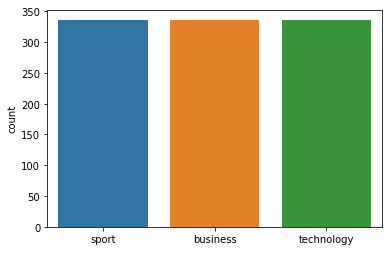



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 247
Class Distribution --> Train data (Fold 2 ):


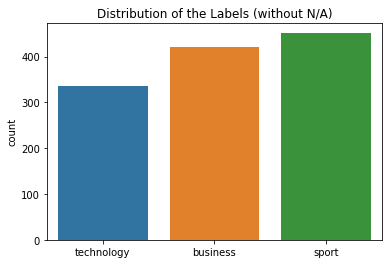

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


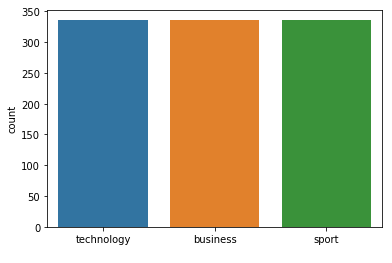



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 247
Class Distribution --> Train data (Fold 3 ):


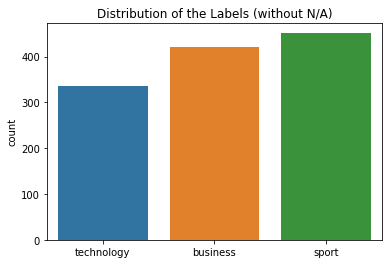

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


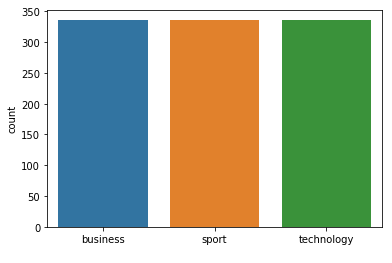



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 247
Class Distribution --> Train data (Fold 4 ):


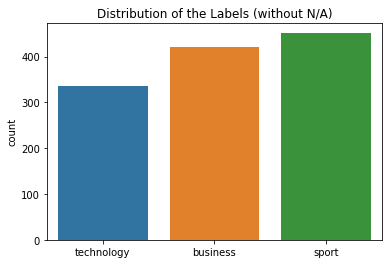

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


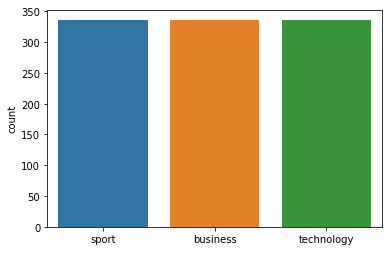



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 247
Class Distribution --> Train data (Fold 5 ):


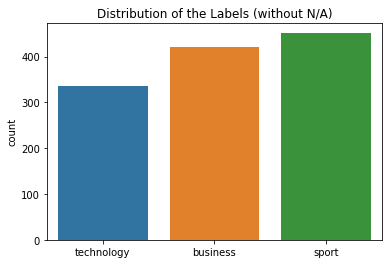

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


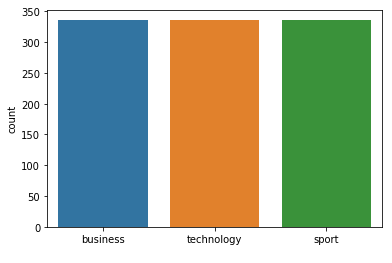



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 247
Class Distribution --> Train data (Fold 6 ):


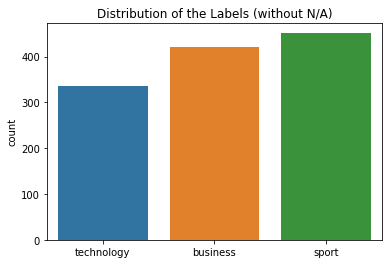

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


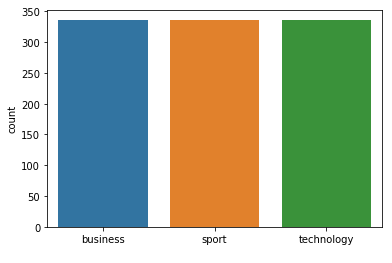



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 247
Class Distribution --> Train data (Fold 7 ):


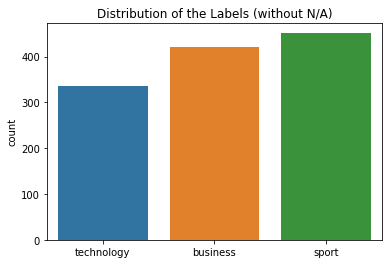

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


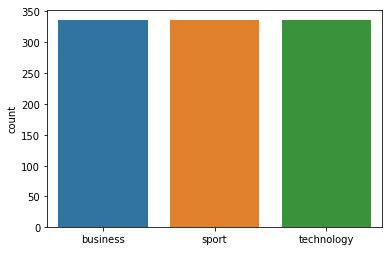



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 247  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 249
Class Distribution --> Train data (Fold 1 ):


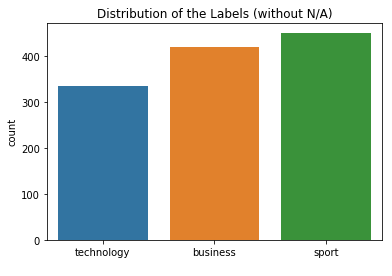

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


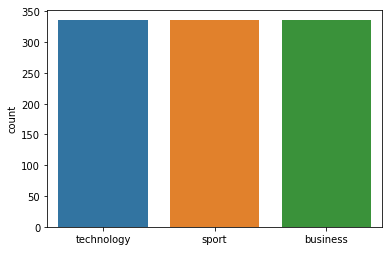



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 249
Class Distribution --> Train data (Fold 2 ):


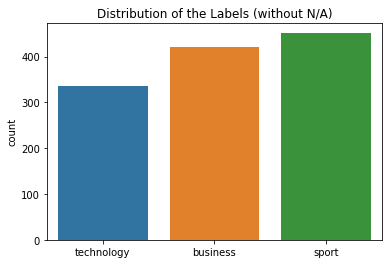

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


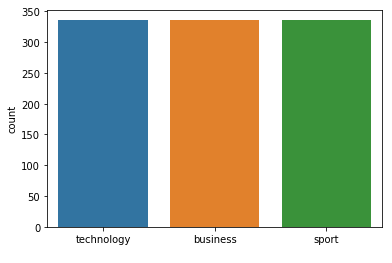



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 249
Class Distribution --> Train data (Fold 3 ):


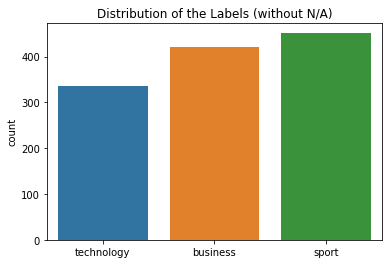

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


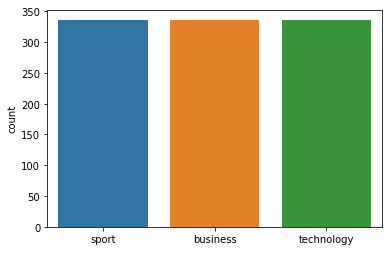



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 249
Class Distribution --> Train data (Fold 4 ):


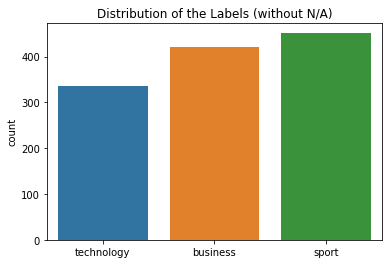

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


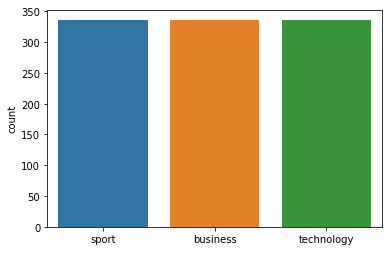



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 249
Class Distribution --> Train data (Fold 5 ):


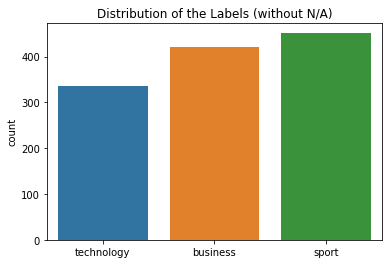

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


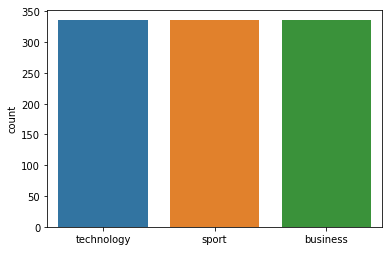



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 249
Class Distribution --> Train data (Fold 6 ):


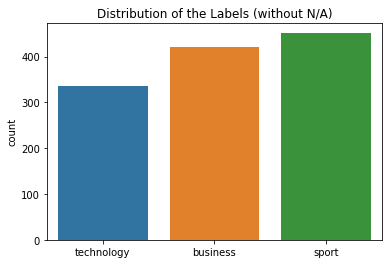

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


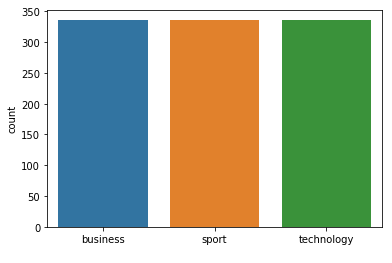



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 249
Class Distribution --> Train data (Fold 7 ):


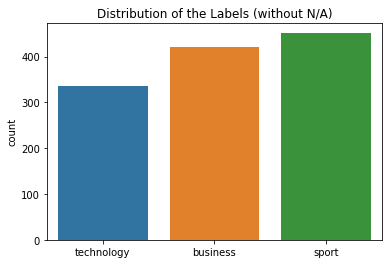

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


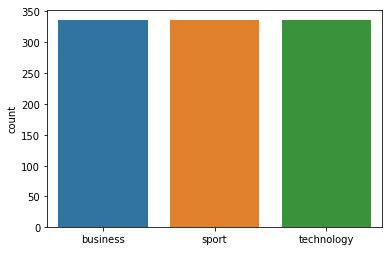



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  3 51]]


 Model accuracy (for 249  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 251
Class Distribution --> Train data (Fold 1 ):


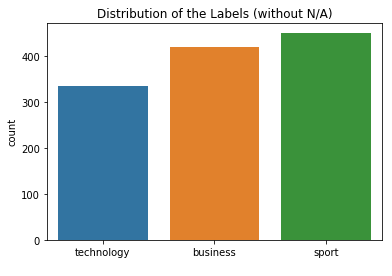

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


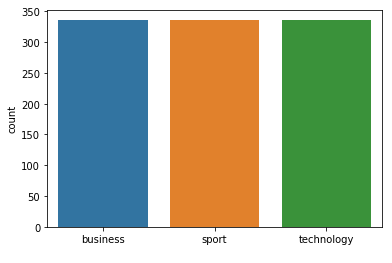



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.96      1.00      0.98        76
technology
       0.96      0.95      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 251
Class Distribution --> Train data (Fold 2 ):


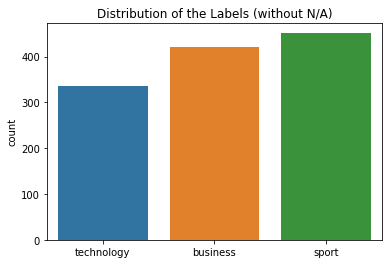

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


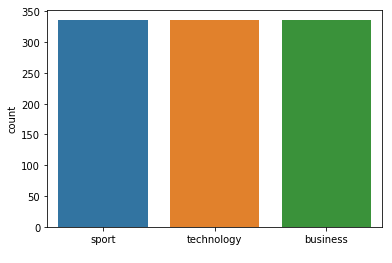



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 251
Class Distribution --> Train data (Fold 3 ):


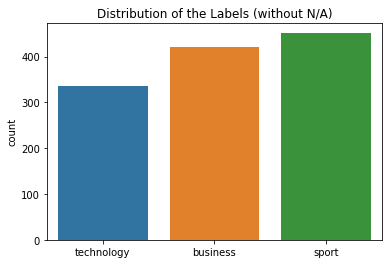

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


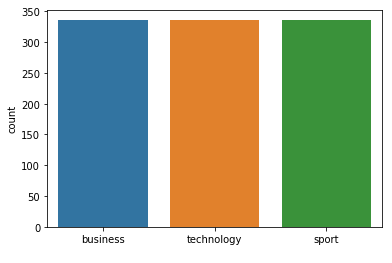



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 251
Class Distribution --> Train data (Fold 4 ):


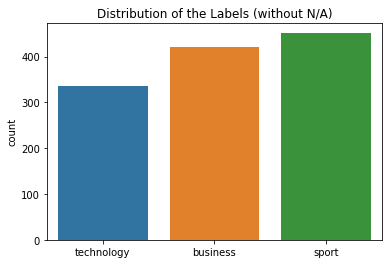

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


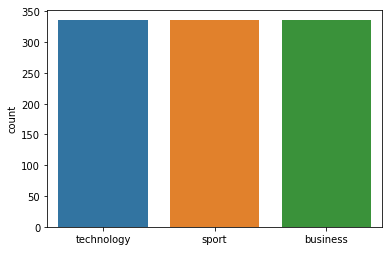



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 251
Class Distribution --> Train data (Fold 5 ):


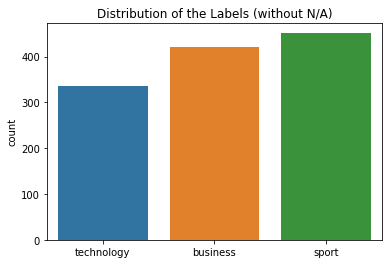

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


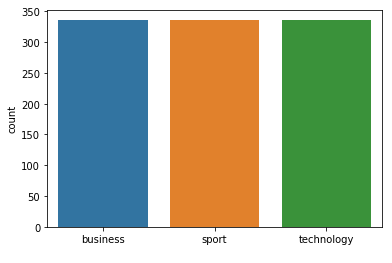



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 251
Class Distribution --> Train data (Fold 6 ):


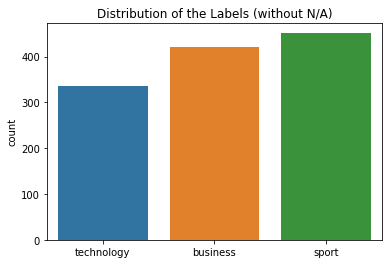

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


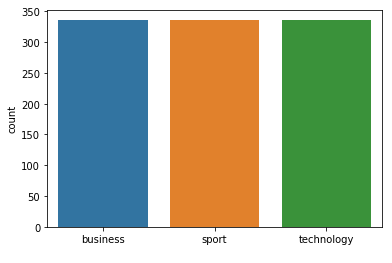



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.94      0.91      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 7 Number of neighbors 251
Class Distribution --> Train data (Fold 7 ):


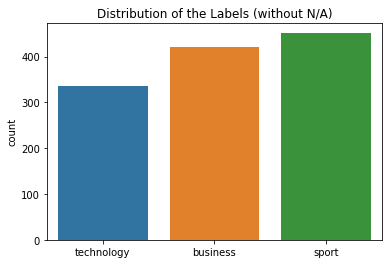

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


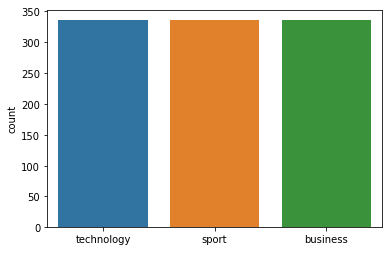



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 251  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 253
Class Distribution --> Train data (Fold 1 ):


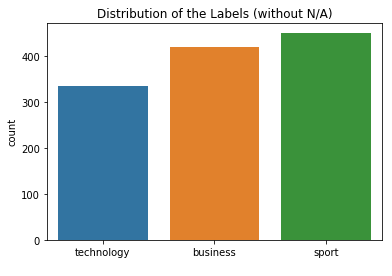

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


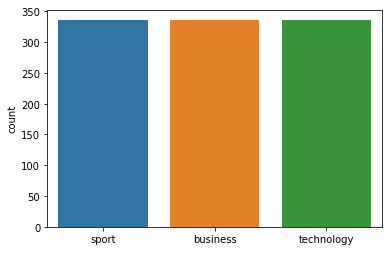



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 253
Class Distribution --> Train data (Fold 2 ):


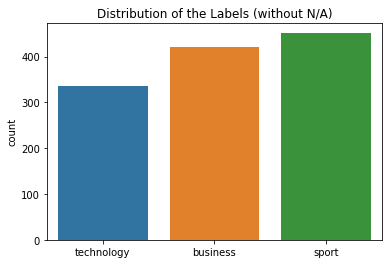

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


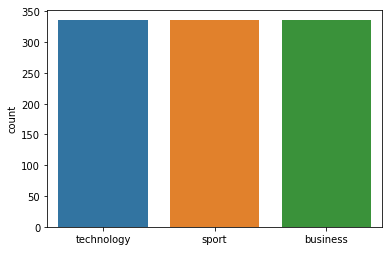



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 253
Class Distribution --> Train data (Fold 3 ):


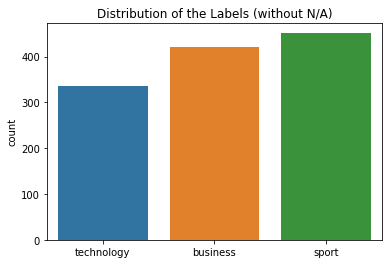

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


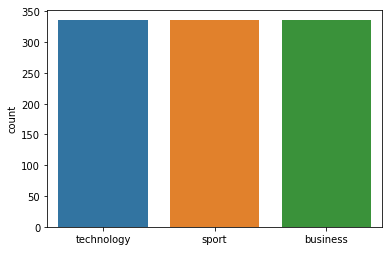



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.94      0.91      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 4 Number of neighbors 253
Class Distribution --> Train data (Fold 4 ):


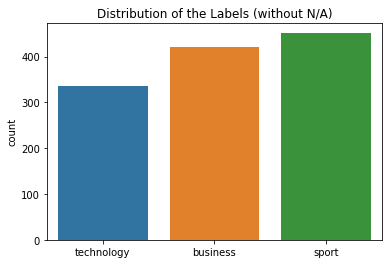

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


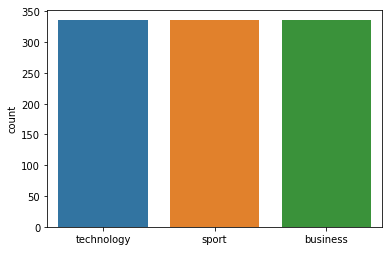



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 253
Class Distribution --> Train data (Fold 5 ):


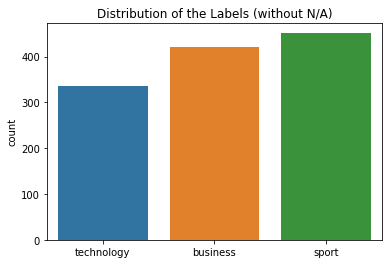

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


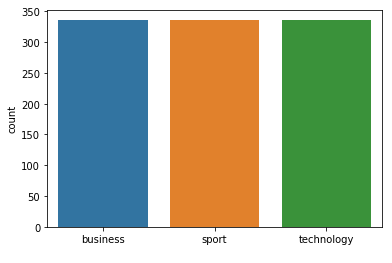



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 253
Class Distribution --> Train data (Fold 6 ):


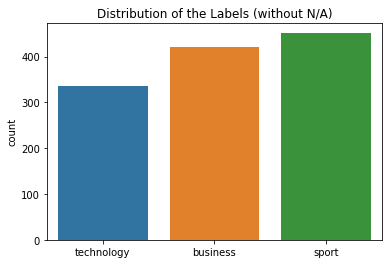

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


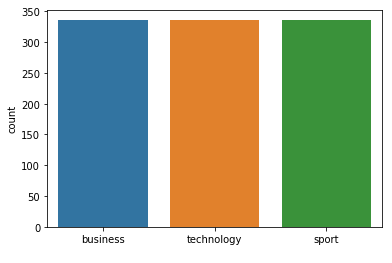



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 253
Class Distribution --> Train data (Fold 7 ):


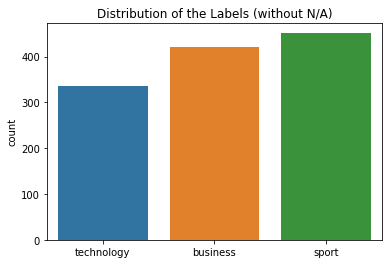

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


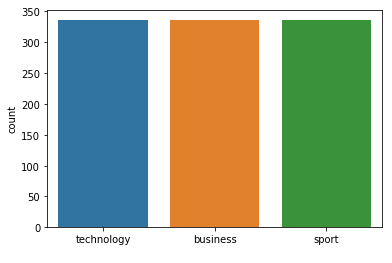



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 253  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 255
Class Distribution --> Train data (Fold 1 ):


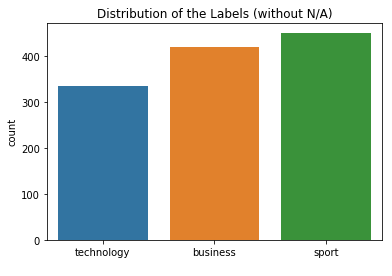

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


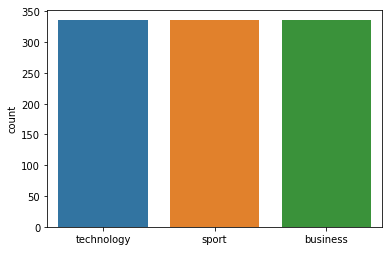



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 255
Class Distribution --> Train data (Fold 2 ):


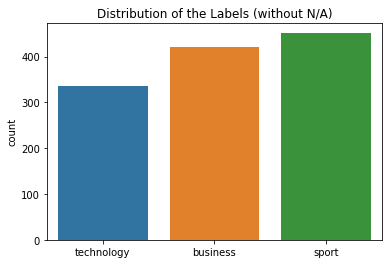

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


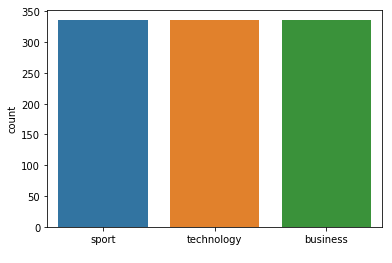



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 255
Class Distribution --> Train data (Fold 3 ):


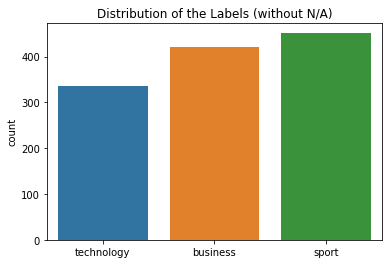

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


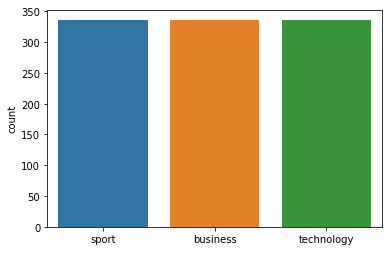



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 255
Class Distribution --> Train data (Fold 4 ):


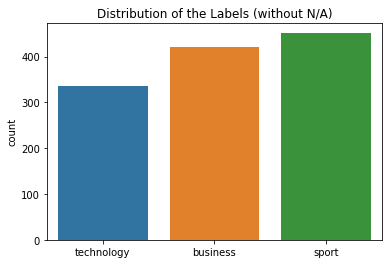

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


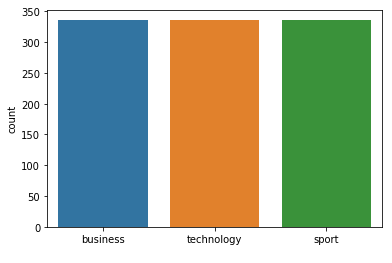



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 255
Class Distribution --> Train data (Fold 5 ):


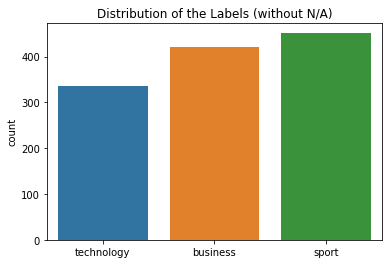

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


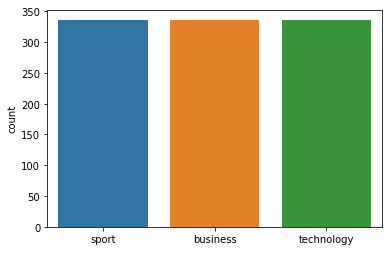



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 255
Class Distribution --> Train data (Fold 6 ):


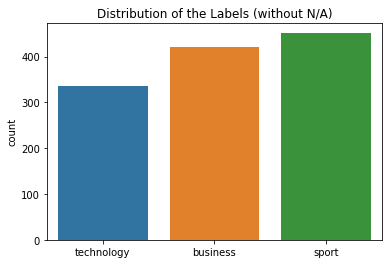

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


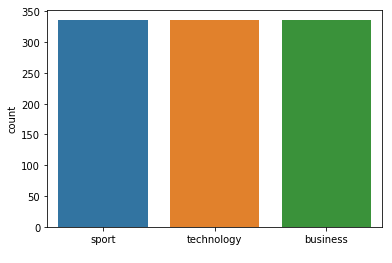



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 255
Class Distribution --> Train data (Fold 7 ):


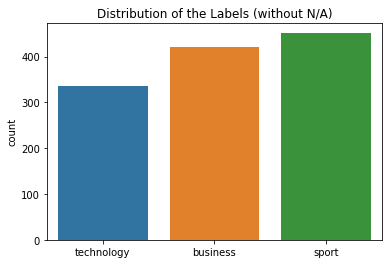

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


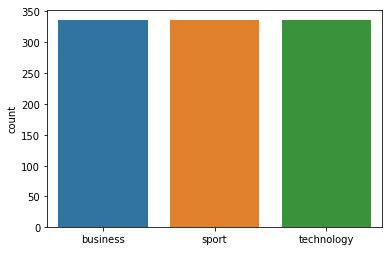



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 255  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 257
Class Distribution --> Train data (Fold 1 ):


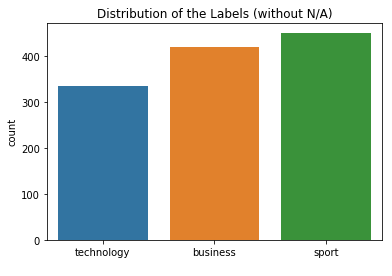

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


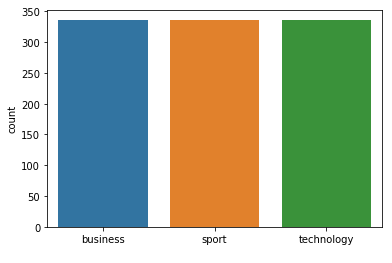



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 257
Class Distribution --> Train data (Fold 2 ):


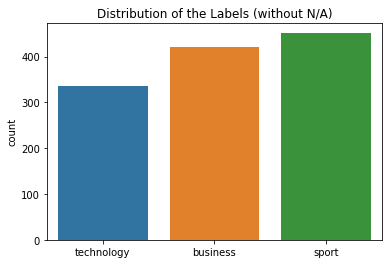

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


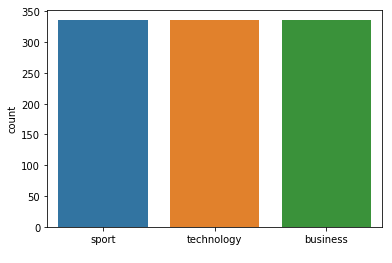



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 257
Class Distribution --> Train data (Fold 3 ):


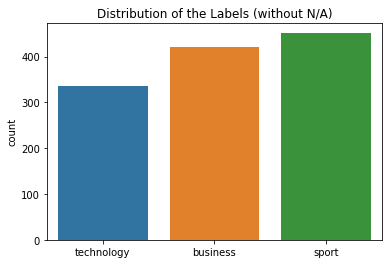

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


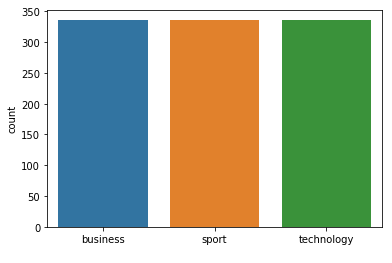



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 257
Class Distribution --> Train data (Fold 4 ):


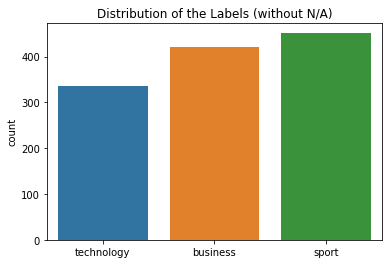

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


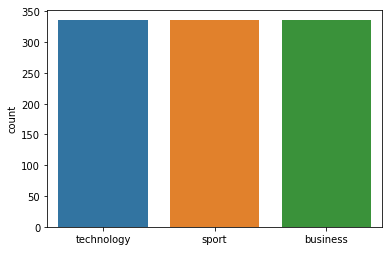



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 257
Class Distribution --> Train data (Fold 5 ):


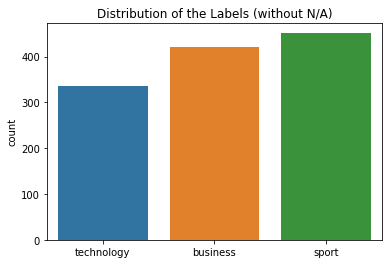

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


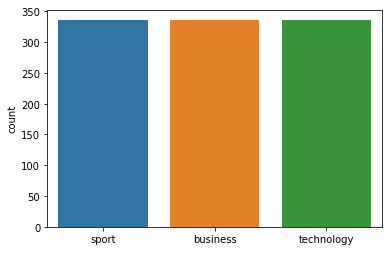



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 257
Class Distribution --> Train data (Fold 6 ):


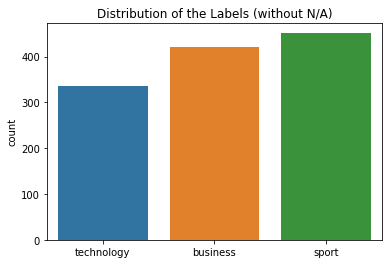

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


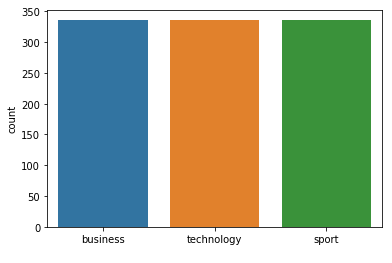



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 257
Class Distribution --> Train data (Fold 7 ):


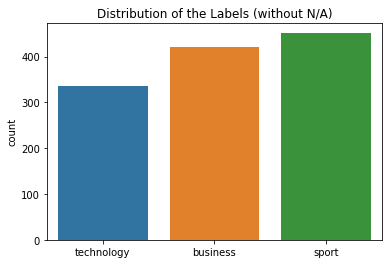

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


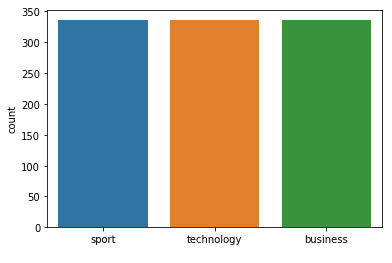



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 257  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 259
Class Distribution --> Train data (Fold 1 ):


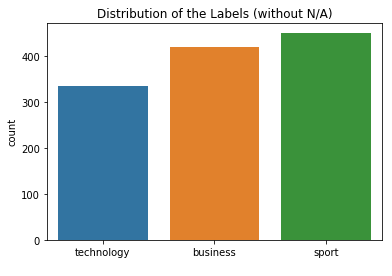

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


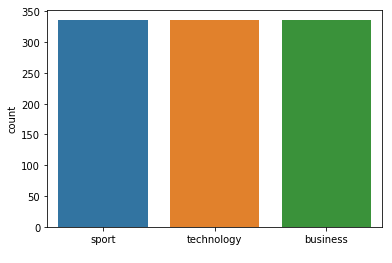



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 259
Class Distribution --> Train data (Fold 2 ):


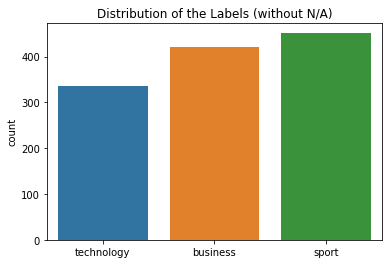

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


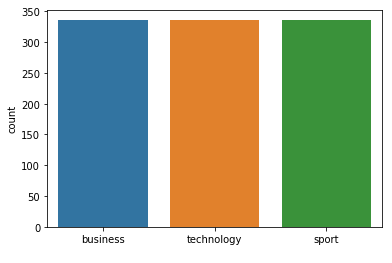



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 259
Class Distribution --> Train data (Fold 3 ):


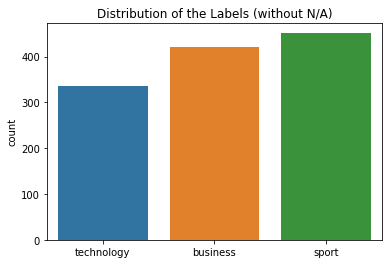

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


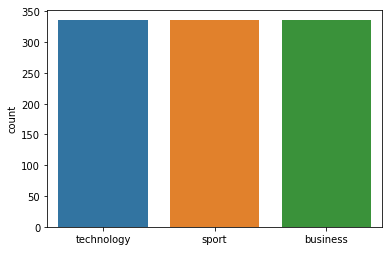



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 259
Class Distribution --> Train data (Fold 4 ):


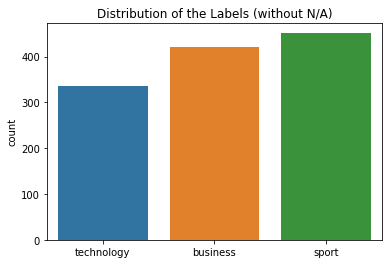

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


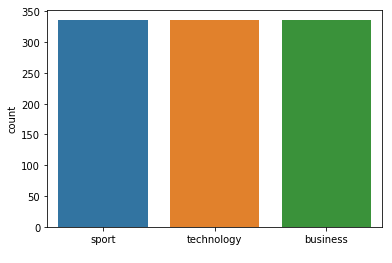



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 259
Class Distribution --> Train data (Fold 5 ):


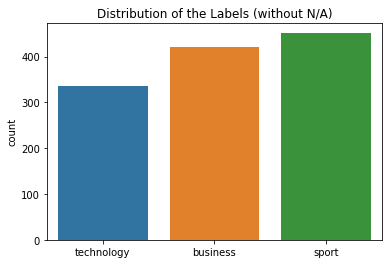

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


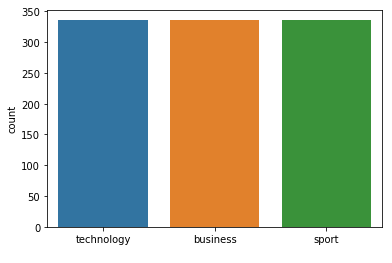



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 259
Class Distribution --> Train data (Fold 6 ):


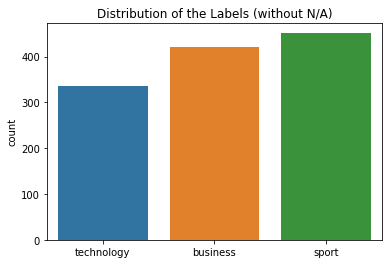

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


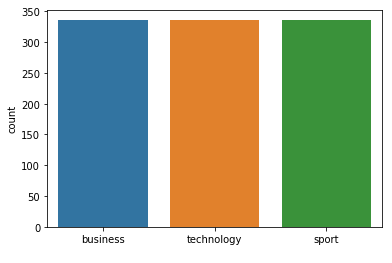



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 259
Class Distribution --> Train data (Fold 7 ):


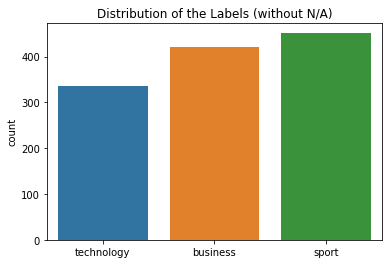

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


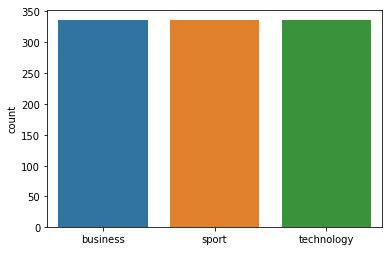



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 259  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 261
Class Distribution --> Train data (Fold 1 ):


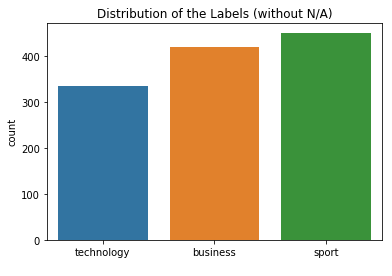

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


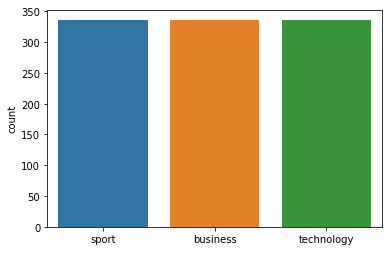



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.95      1.00      0.97        76
technology
       0.96      0.93      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 261
Class Distribution --> Train data (Fold 2 ):


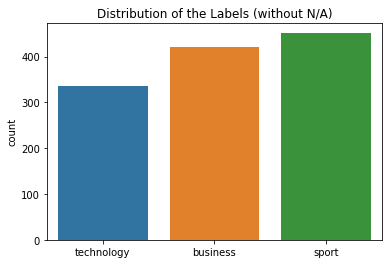

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


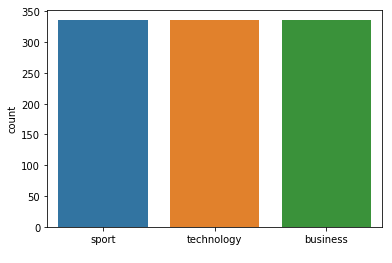



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 261
Class Distribution --> Train data (Fold 3 ):


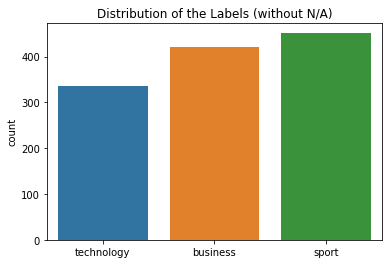

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


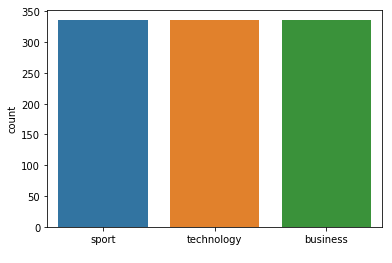



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 261
Class Distribution --> Train data (Fold 4 ):


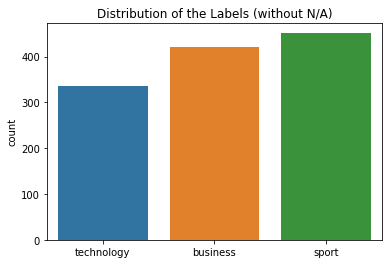

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


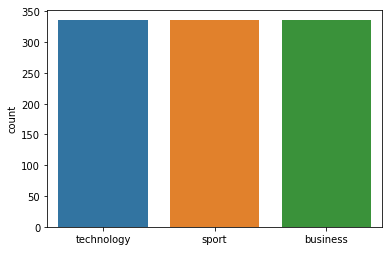



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 261
Class Distribution --> Train data (Fold 5 ):


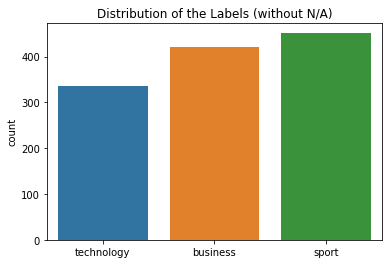

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


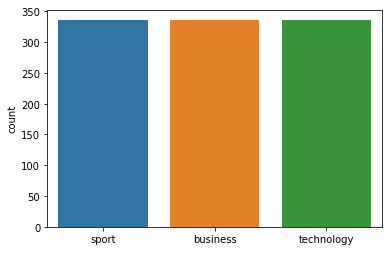



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 261
Class Distribution --> Train data (Fold 6 ):


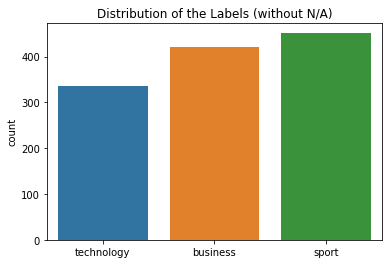

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


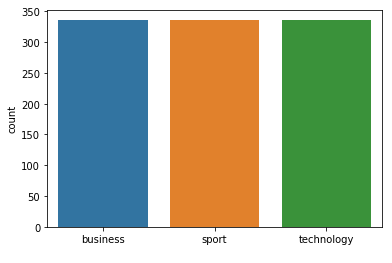



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 261
Class Distribution --> Train data (Fold 7 ):


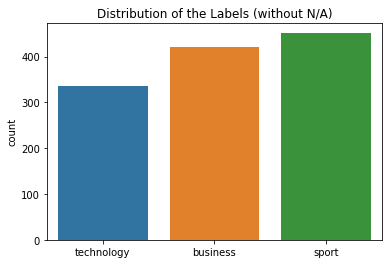

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


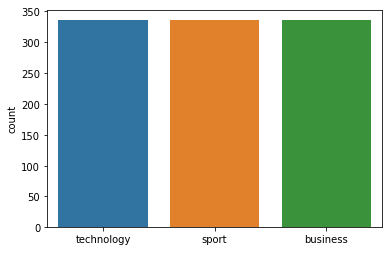



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 261  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 263
Class Distribution --> Train data (Fold 1 ):


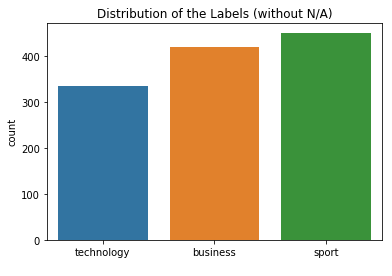

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


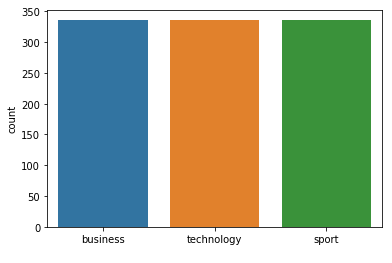



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.96      1.00      0.98        76
technology
       0.96      0.95      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 263
Class Distribution --> Train data (Fold 2 ):


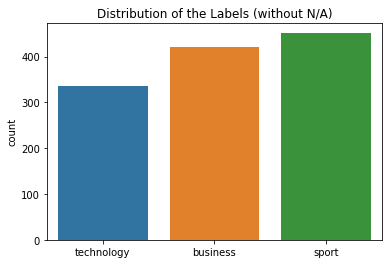

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


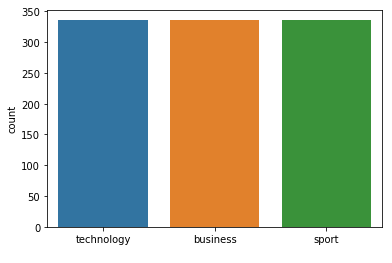



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 263
Class Distribution --> Train data (Fold 3 ):


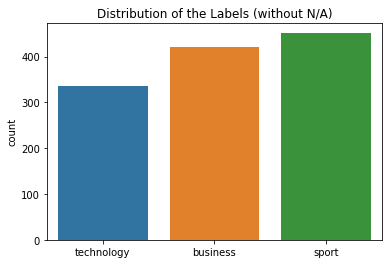

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


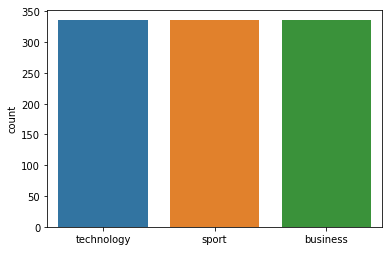



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 263
Class Distribution --> Train data (Fold 4 ):


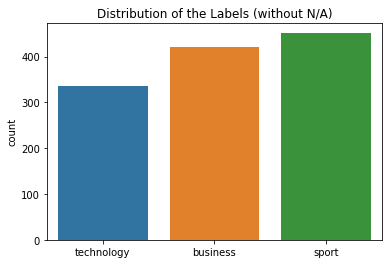

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


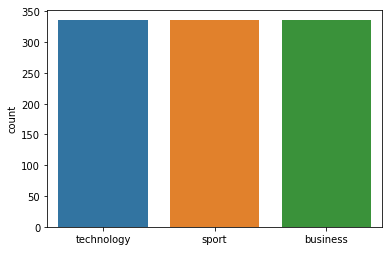



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 263
Class Distribution --> Train data (Fold 5 ):


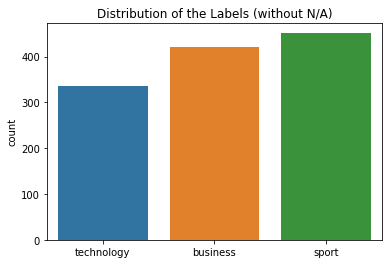

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


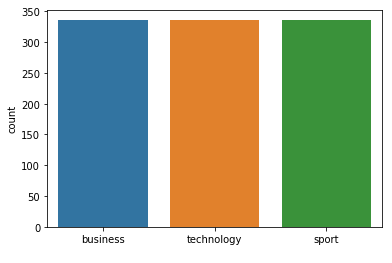



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 263
Class Distribution --> Train data (Fold 6 ):


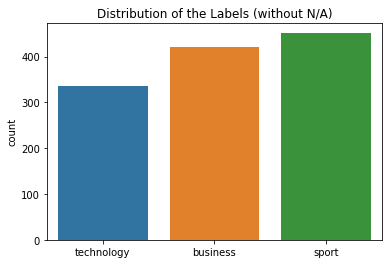

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


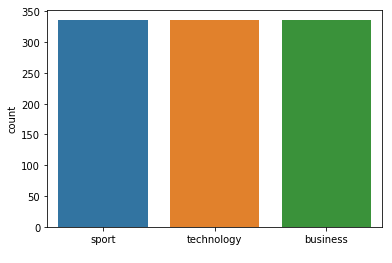



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 263
Class Distribution --> Train data (Fold 7 ):


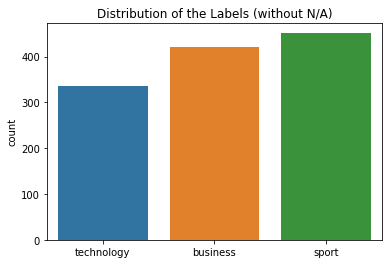

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


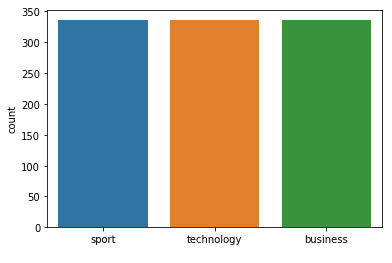



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.91      0.95      0.93        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[65  0  5]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 263  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 265
Class Distribution --> Train data (Fold 1 ):


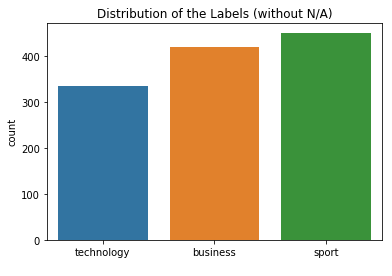

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


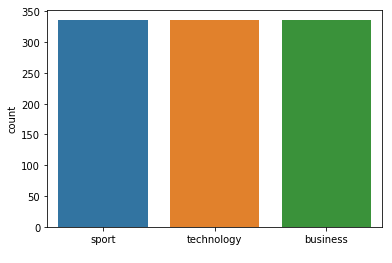



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 265
Class Distribution --> Train data (Fold 2 ):


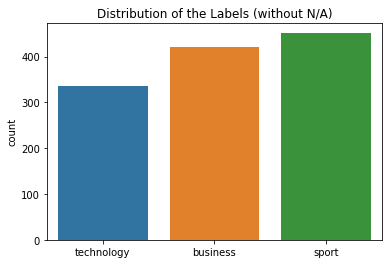

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


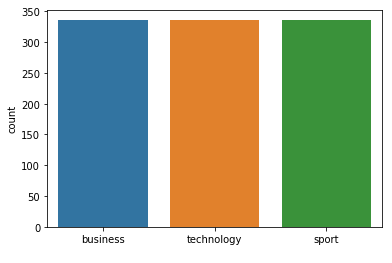



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 265
Class Distribution --> Train data (Fold 3 ):


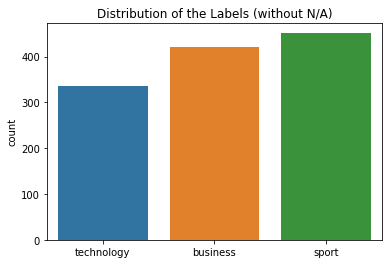

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


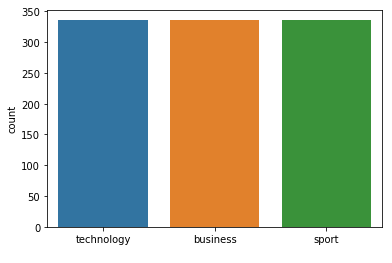



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.94      0.91      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 4 Number of neighbors 265
Class Distribution --> Train data (Fold 4 ):


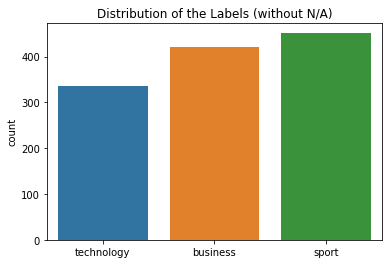

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


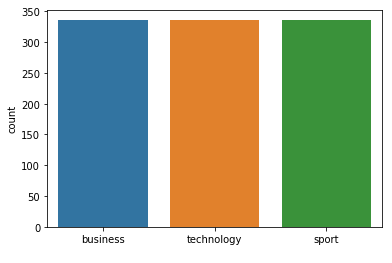



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 265
Class Distribution --> Train data (Fold 5 ):


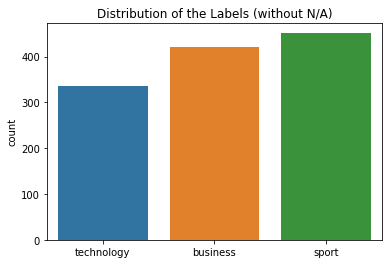

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


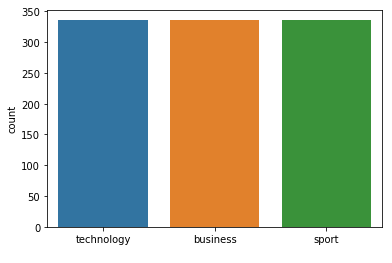



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 265
Class Distribution --> Train data (Fold 6 ):


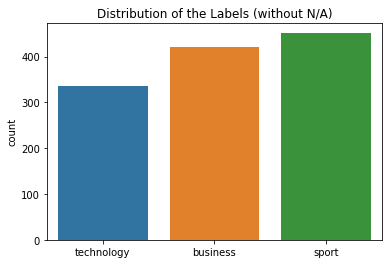

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


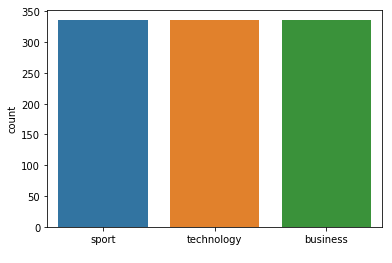



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 265
Class Distribution --> Train data (Fold 7 ):


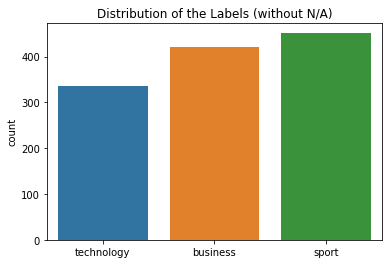

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


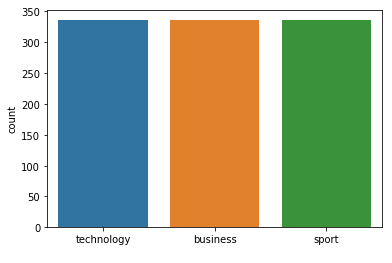



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 265  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 267
Class Distribution --> Train data (Fold 1 ):


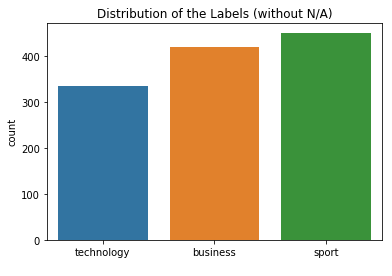

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


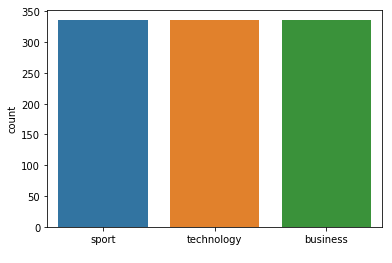



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 267
Class Distribution --> Train data (Fold 2 ):


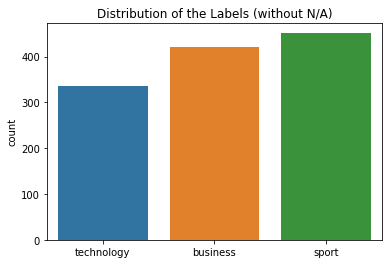

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


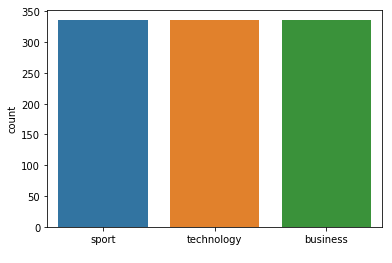



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 267
Class Distribution --> Train data (Fold 3 ):


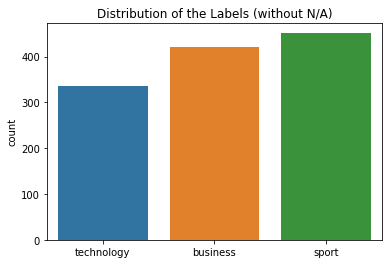

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


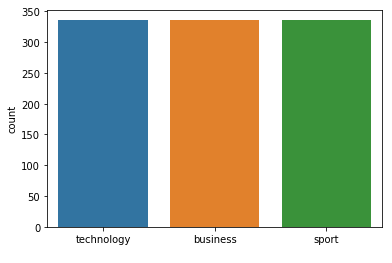



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 267
Class Distribution --> Train data (Fold 4 ):


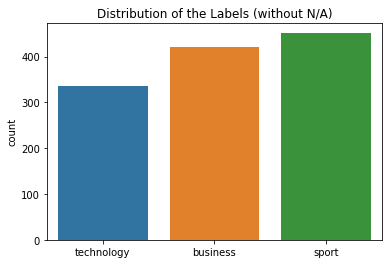

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


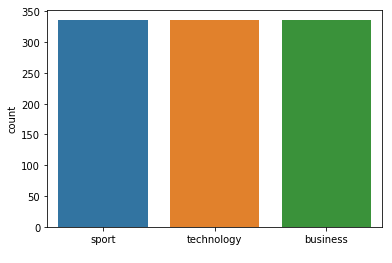



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 267
Class Distribution --> Train data (Fold 5 ):


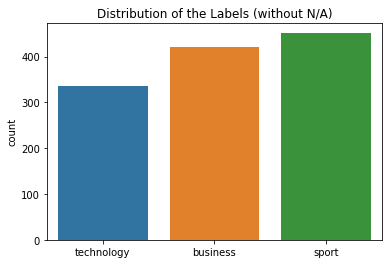

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


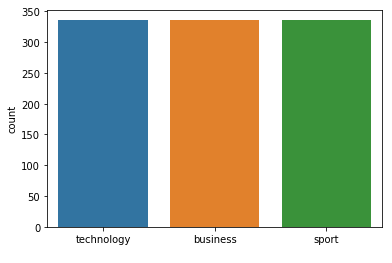



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 267
Class Distribution --> Train data (Fold 6 ):


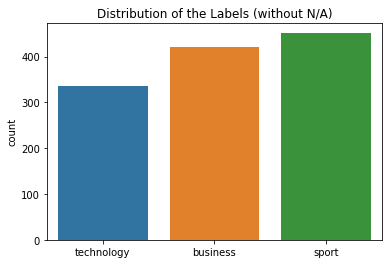

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


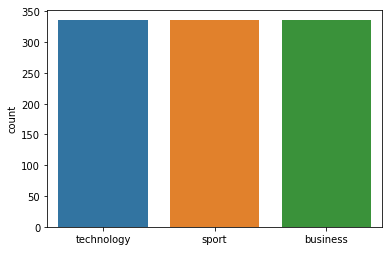



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 267
Class Distribution --> Train data (Fold 7 ):


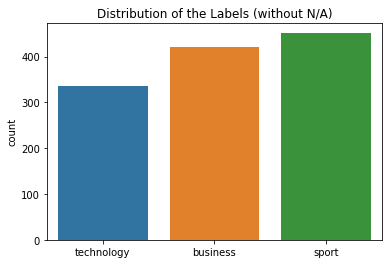

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


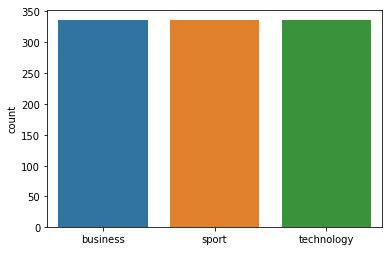



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 267  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 269
Class Distribution --> Train data (Fold 1 ):


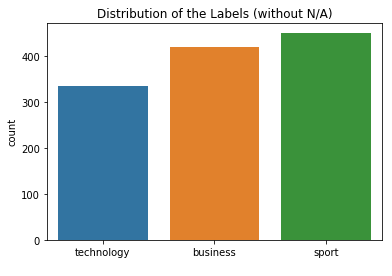

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


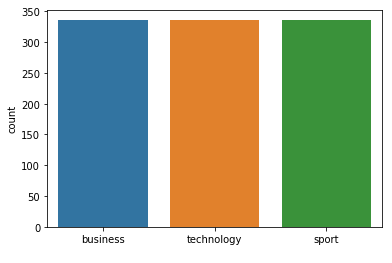



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 269
Class Distribution --> Train data (Fold 2 ):


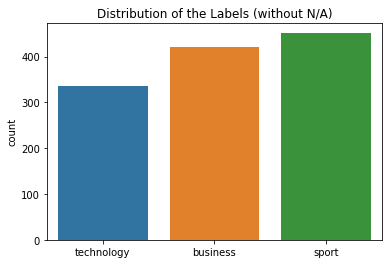

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


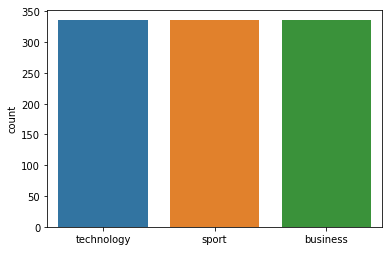



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 269
Class Distribution --> Train data (Fold 3 ):


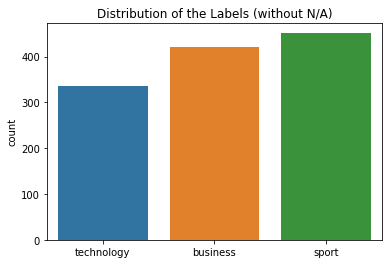

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


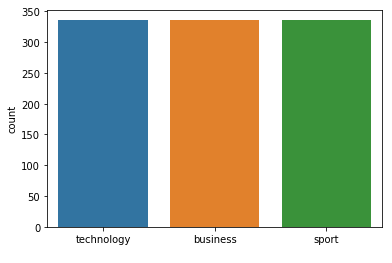



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 269
Class Distribution --> Train data (Fold 4 ):


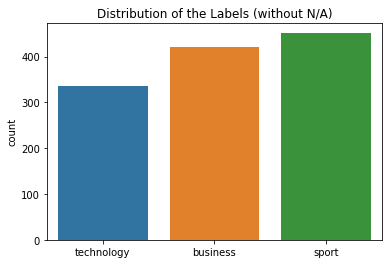

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


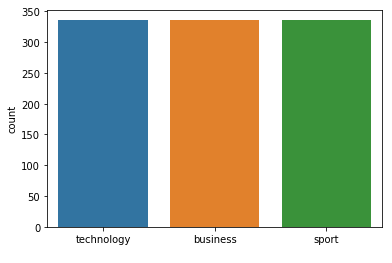



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 269
Class Distribution --> Train data (Fold 5 ):


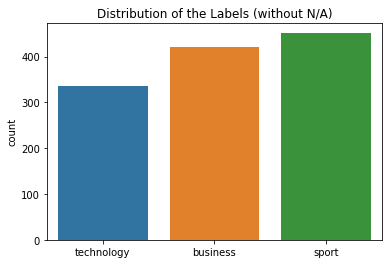

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


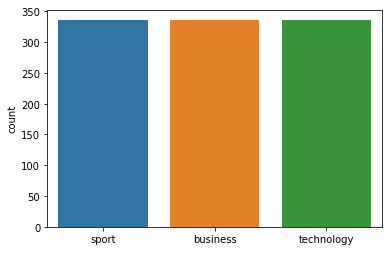



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 269
Class Distribution --> Train data (Fold 6 ):


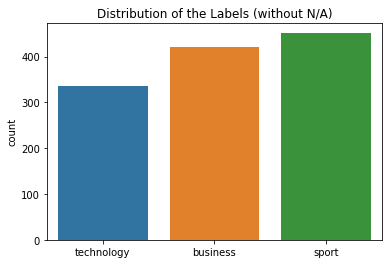

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


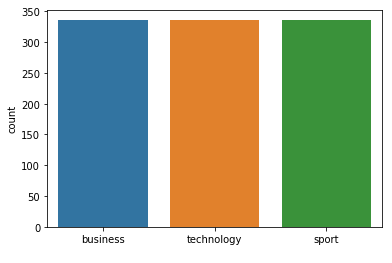



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 269
Class Distribution --> Train data (Fold 7 ):


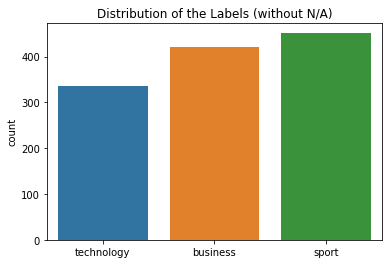

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


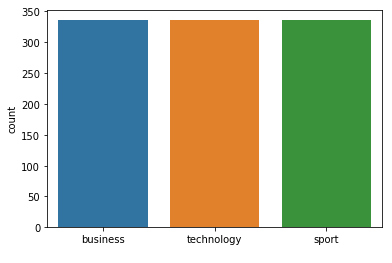



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 269  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 271
Class Distribution --> Train data (Fold 1 ):


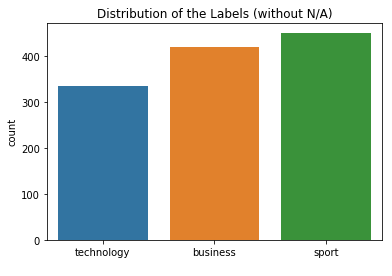

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


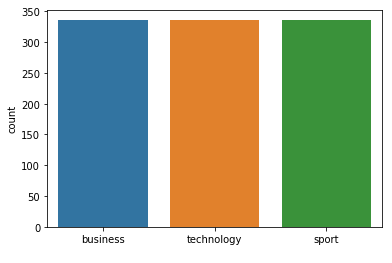



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 271
Class Distribution --> Train data (Fold 2 ):


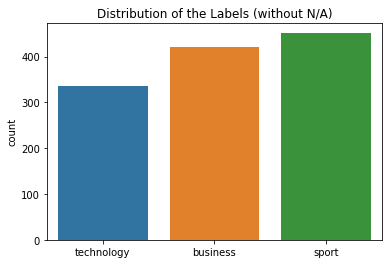

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


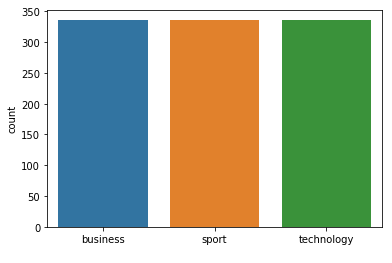



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 271
Class Distribution --> Train data (Fold 3 ):


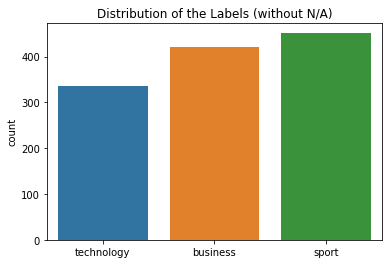

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


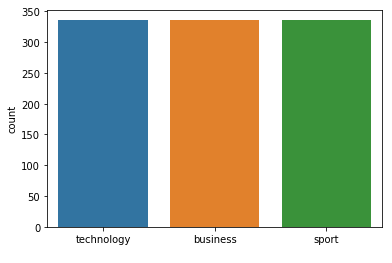



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 271
Class Distribution --> Train data (Fold 4 ):


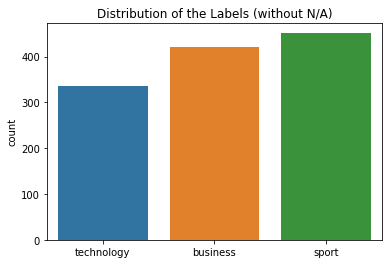

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


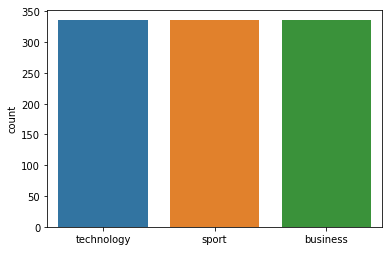



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 271
Class Distribution --> Train data (Fold 5 ):


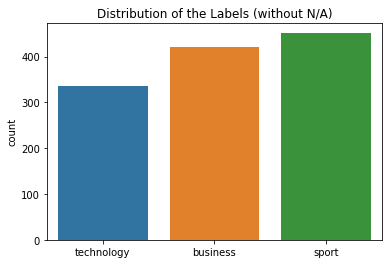

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


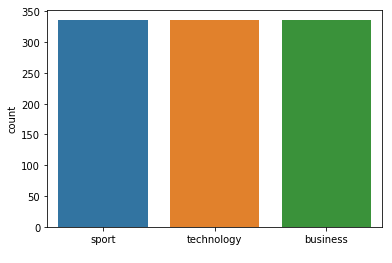



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 271
Class Distribution --> Train data (Fold 6 ):


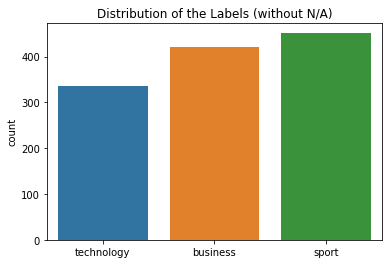

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


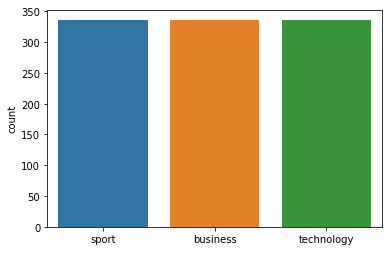



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 271
Class Distribution --> Train data (Fold 7 ):


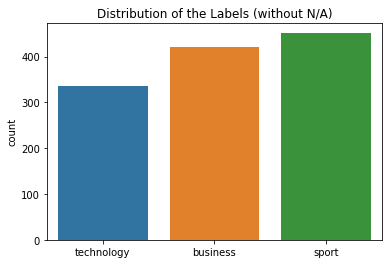

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


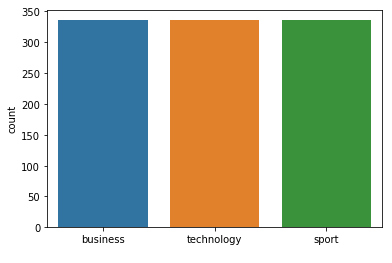



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 271  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 273
Class Distribution --> Train data (Fold 1 ):


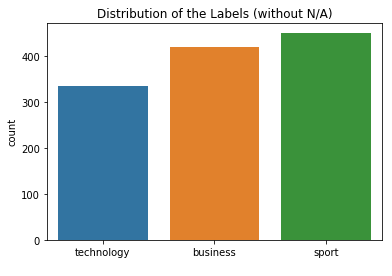

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


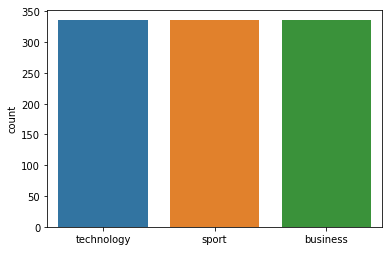



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 273
Class Distribution --> Train data (Fold 2 ):


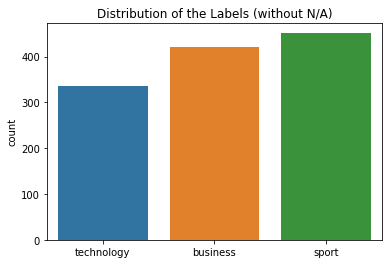

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


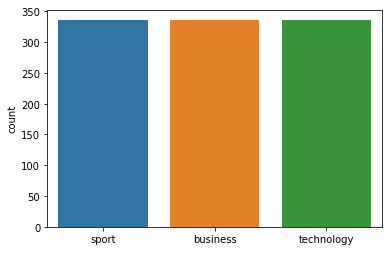



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       0.97      0.96      0.97        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  0  3]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 273
Class Distribution --> Train data (Fold 3 ):


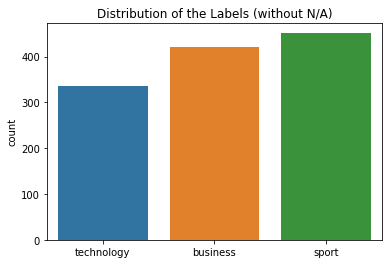

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


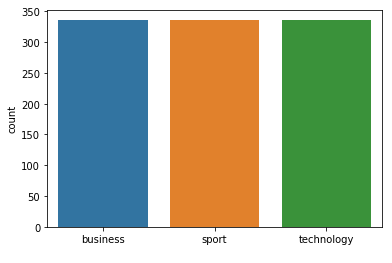



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 273
Class Distribution --> Train data (Fold 4 ):


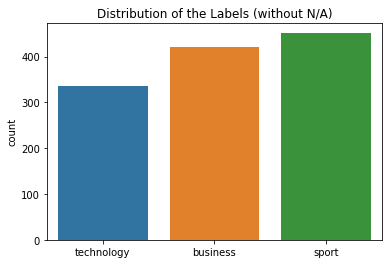

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


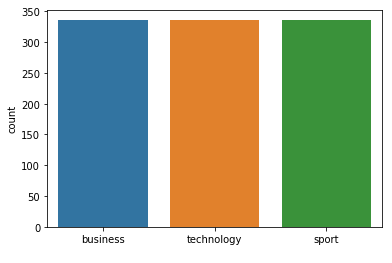



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 273
Class Distribution --> Train data (Fold 5 ):


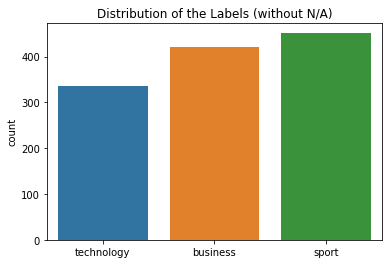

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


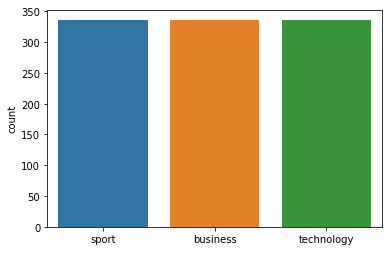



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 273
Class Distribution --> Train data (Fold 6 ):


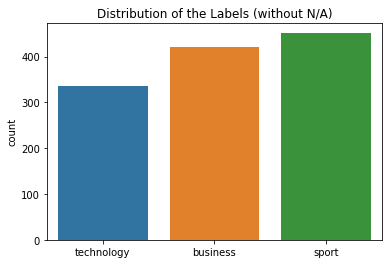

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


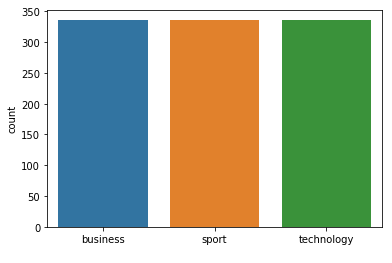



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.93      0.94        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 7 Number of neighbors 273
Class Distribution --> Train data (Fold 7 ):


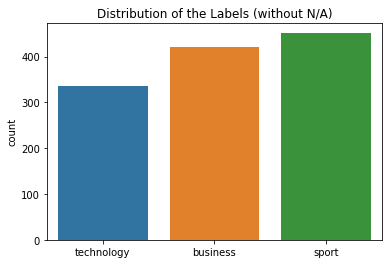

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


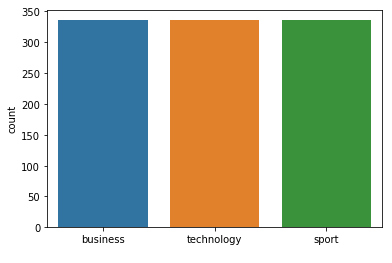



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 273  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 275
Class Distribution --> Train data (Fold 1 ):


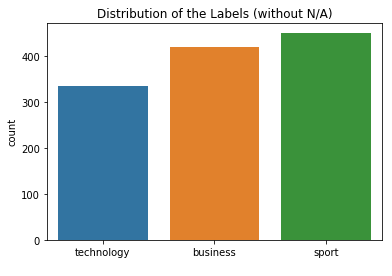

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


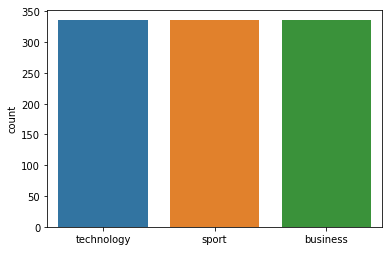



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 275
Class Distribution --> Train data (Fold 2 ):


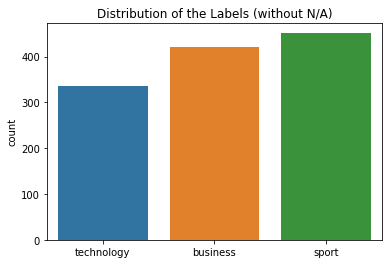

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


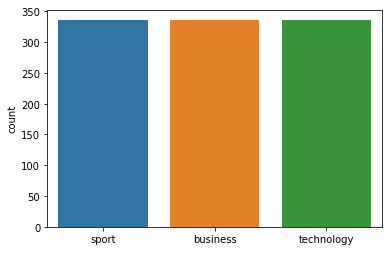



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 275
Class Distribution --> Train data (Fold 3 ):


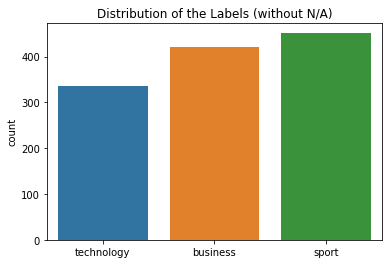

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


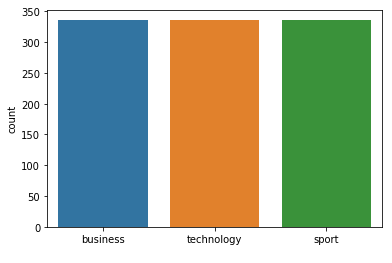



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 275
Class Distribution --> Train data (Fold 4 ):


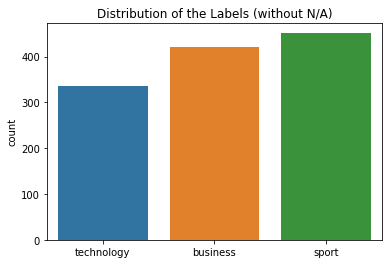

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


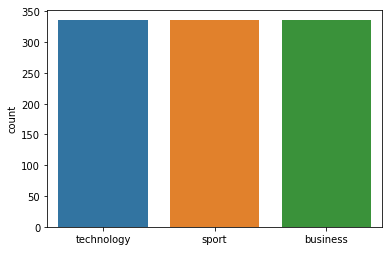



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 275
Class Distribution --> Train data (Fold 5 ):


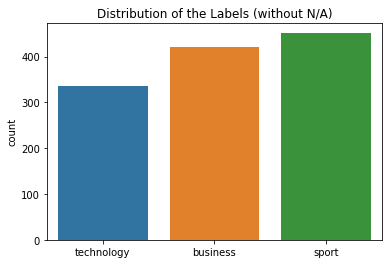

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


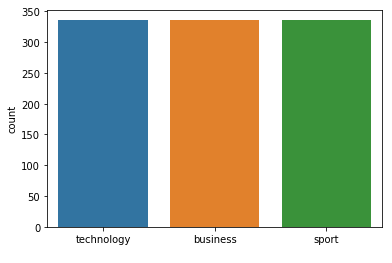



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 275
Class Distribution --> Train data (Fold 6 ):


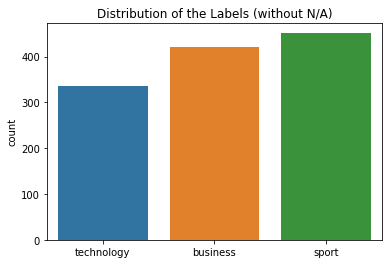

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


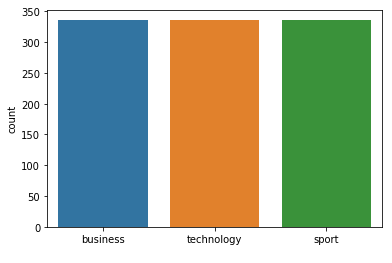



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 275
Class Distribution --> Train data (Fold 7 ):


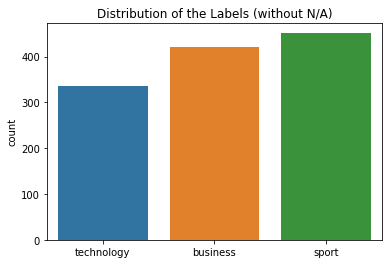

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


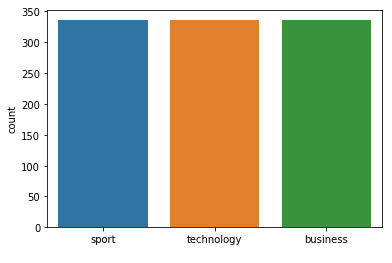



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 275  neighbours): 97.05% (+/- 1.06%)
FOLD 1 Number of neighbors 277
Class Distribution --> Train data (Fold 1 ):


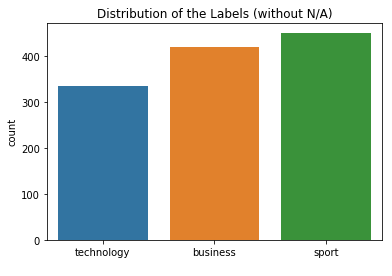

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


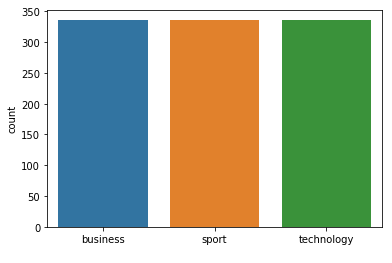



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.95      0.99      0.97        76
technology
       0.96      0.93      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 277
Class Distribution --> Train data (Fold 2 ):


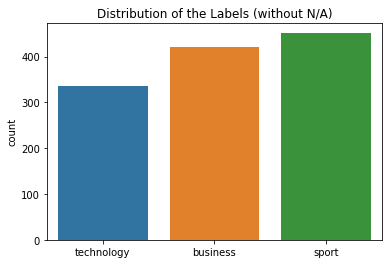

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


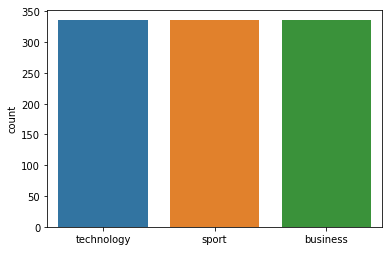



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 277
Class Distribution --> Train data (Fold 3 ):


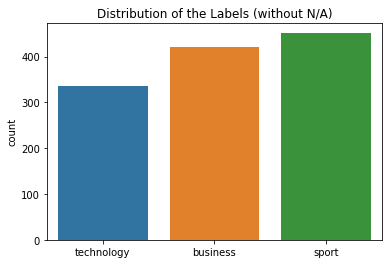

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


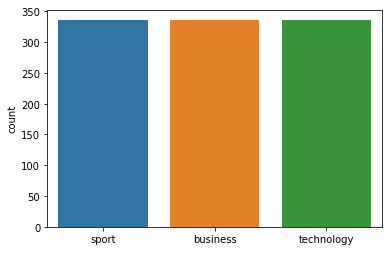



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.93      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 1 74  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 277
Class Distribution --> Train data (Fold 4 ):


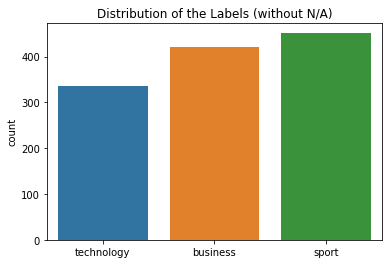

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


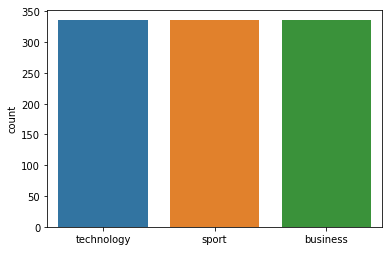



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 277
Class Distribution --> Train data (Fold 5 ):


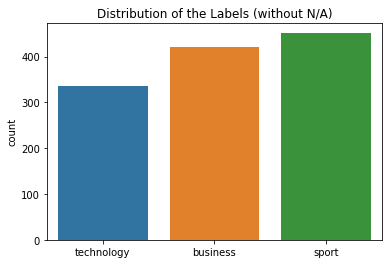

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


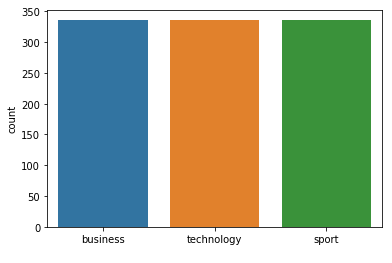



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 277
Class Distribution --> Train data (Fold 6 ):


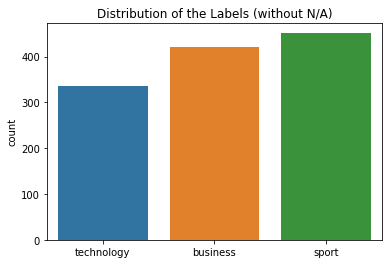

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


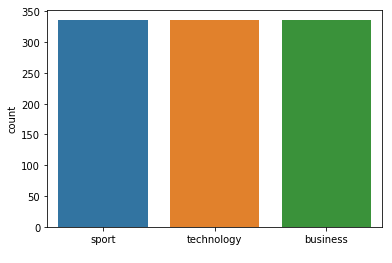



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 277
Class Distribution --> Train data (Fold 7 ):


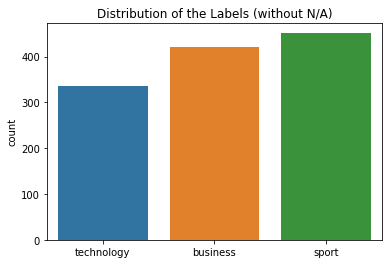

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


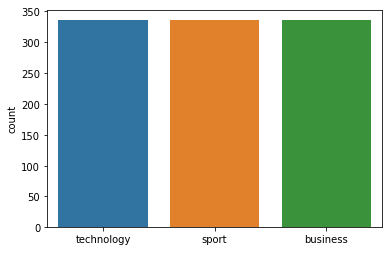



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.91      0.95      0.93        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[65  0  5]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 277  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 279
Class Distribution --> Train data (Fold 1 ):


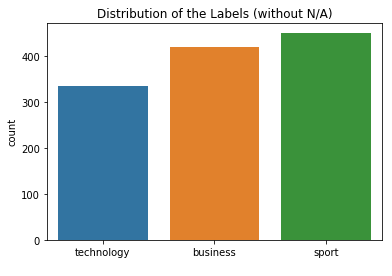

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


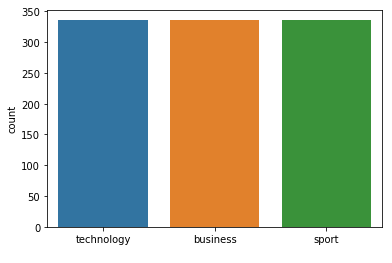



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 279
Class Distribution --> Train data (Fold 2 ):


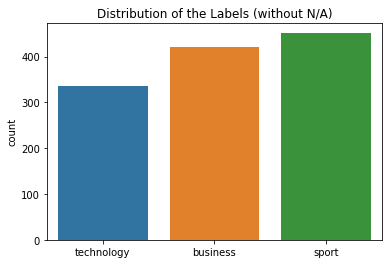

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


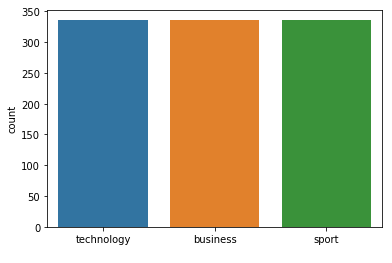



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 279
Class Distribution --> Train data (Fold 3 ):


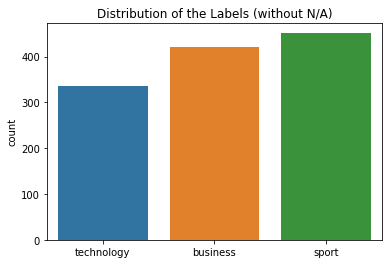

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


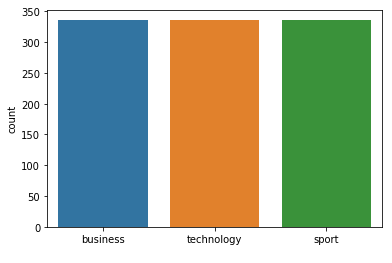



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 279
Class Distribution --> Train data (Fold 4 ):


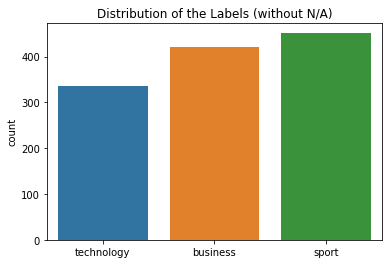

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


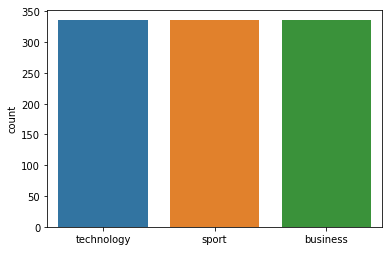



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 279
Class Distribution --> Train data (Fold 5 ):


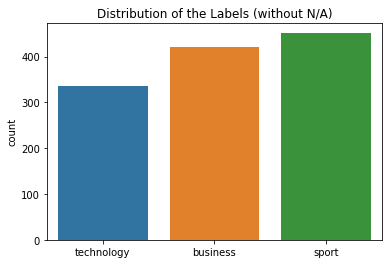

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


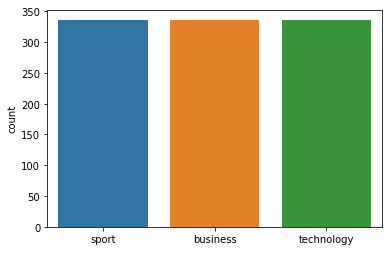



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 279
Class Distribution --> Train data (Fold 6 ):


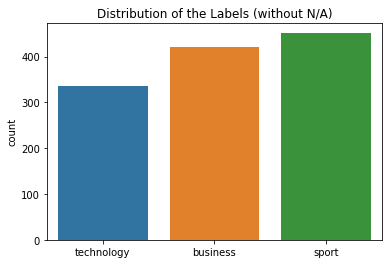

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


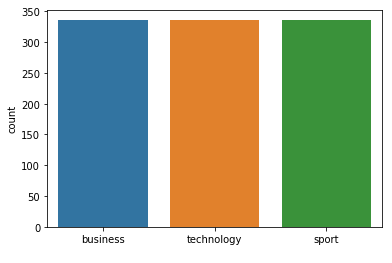



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 279
Class Distribution --> Train data (Fold 7 ):


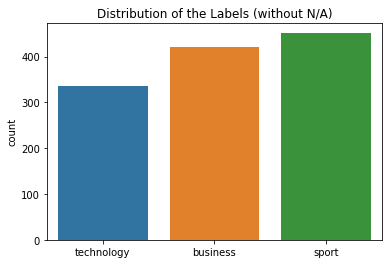

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


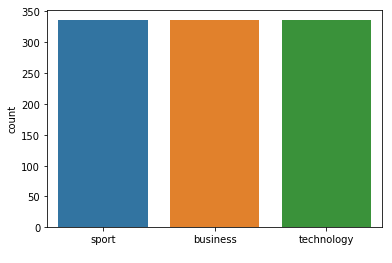



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.97      0.97        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 279  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 281
Class Distribution --> Train data (Fold 1 ):


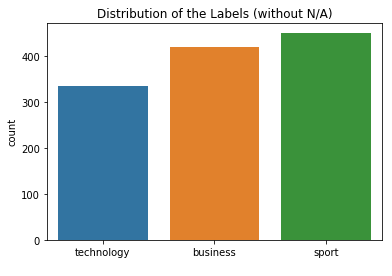

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


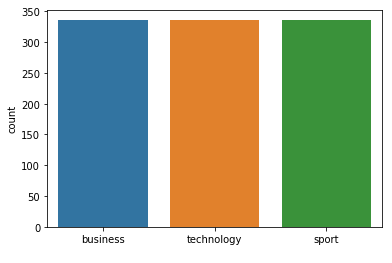



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 281
Class Distribution --> Train data (Fold 2 ):


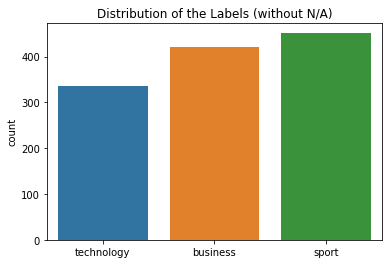

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


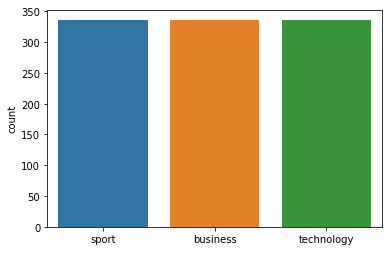



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 281
Class Distribution --> Train data (Fold 3 ):


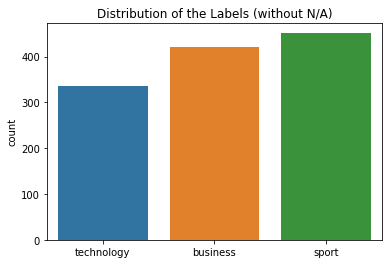

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


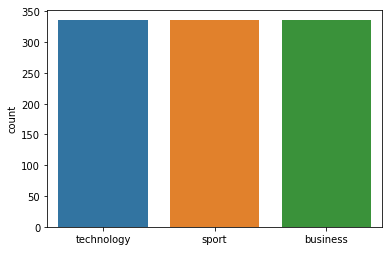



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 281
Class Distribution --> Train data (Fold 4 ):


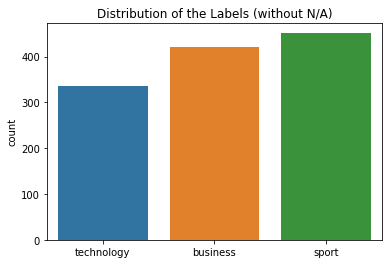

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


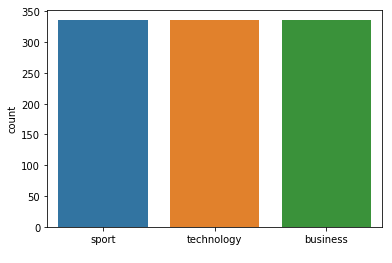



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 281
Class Distribution --> Train data (Fold 5 ):


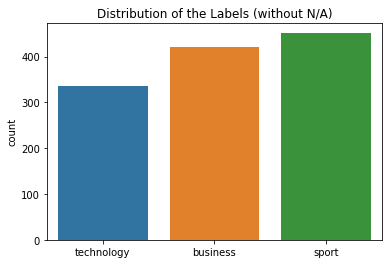

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


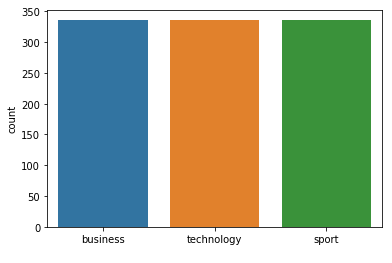



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 281
Class Distribution --> Train data (Fold 6 ):


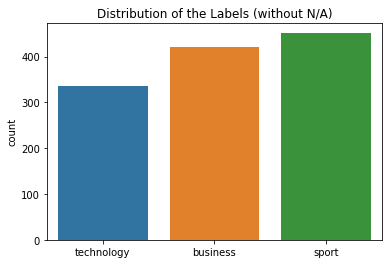

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


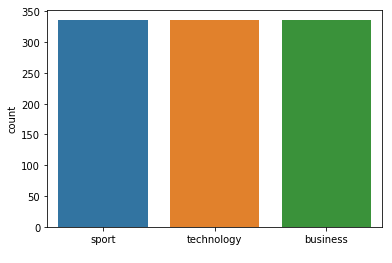



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 281
Class Distribution --> Train data (Fold 7 ):


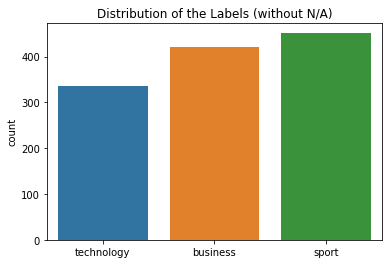

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


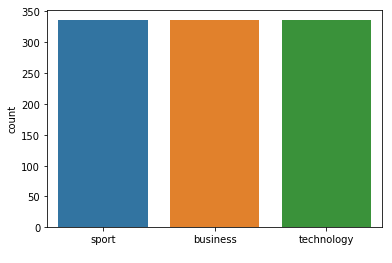



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 281  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 283
Class Distribution --> Train data (Fold 1 ):


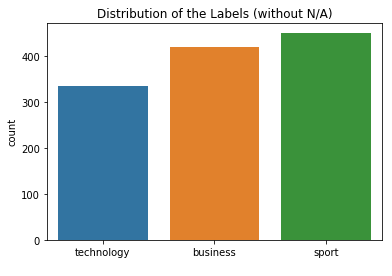

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


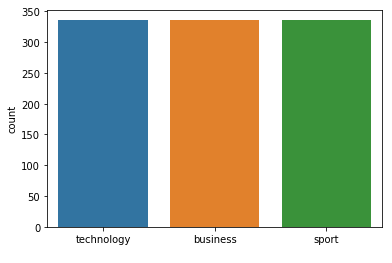



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 283
Class Distribution --> Train data (Fold 2 ):


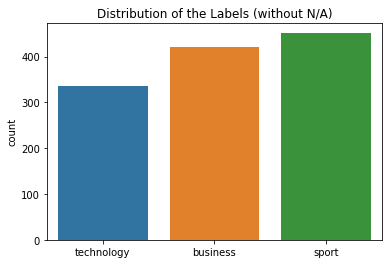

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


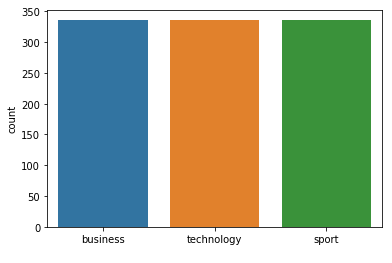



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 283
Class Distribution --> Train data (Fold 3 ):


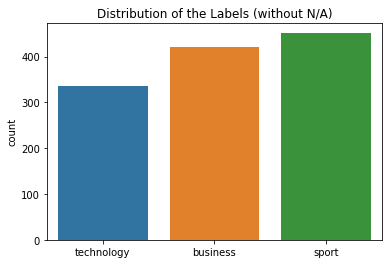

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


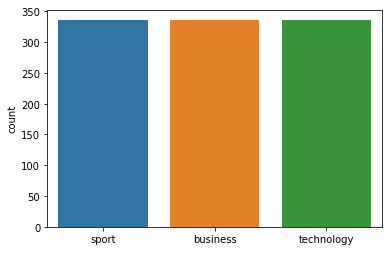



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 283
Class Distribution --> Train data (Fold 4 ):


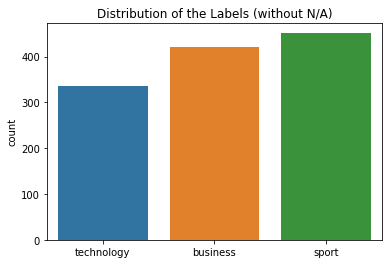

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


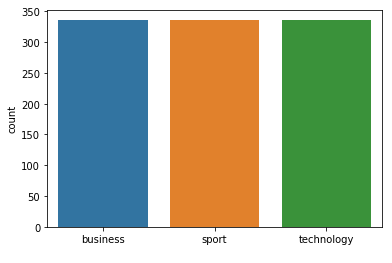



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 283
Class Distribution --> Train data (Fold 5 ):


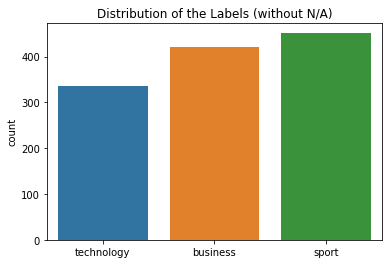

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


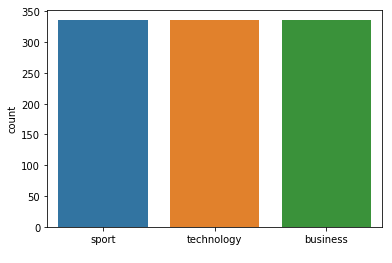



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 283
Class Distribution --> Train data (Fold 6 ):


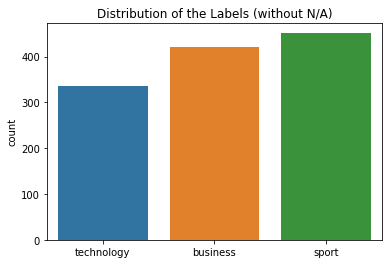

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


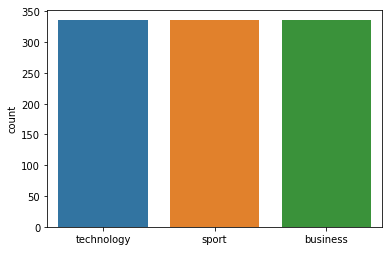



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 283
Class Distribution --> Train data (Fold 7 ):


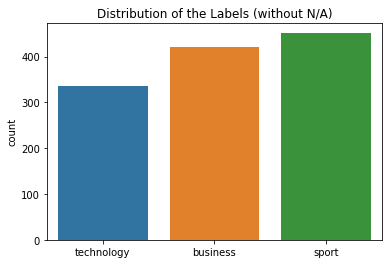

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


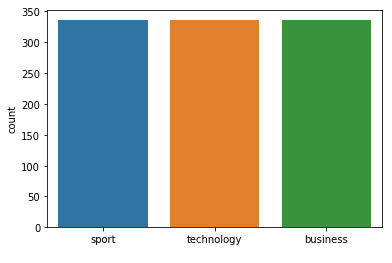



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.91      0.95      0.93        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[65  0  5]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 283  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 285
Class Distribution --> Train data (Fold 1 ):


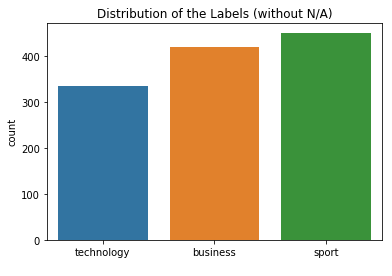

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


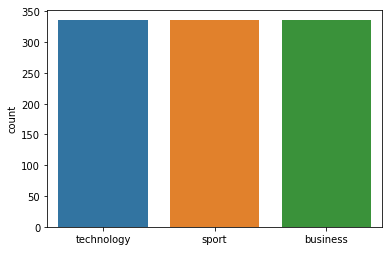



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 285
Class Distribution --> Train data (Fold 2 ):


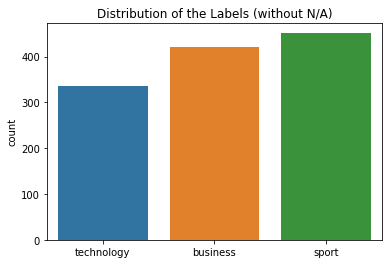

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


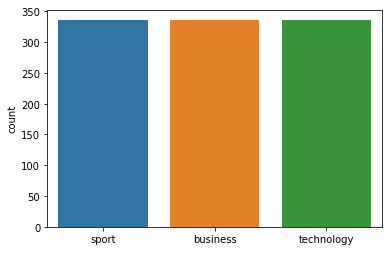



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 285
Class Distribution --> Train data (Fold 3 ):


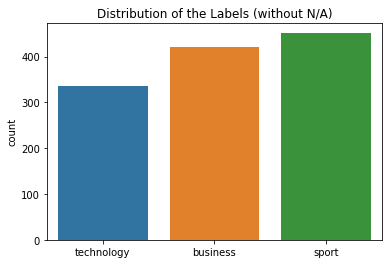

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


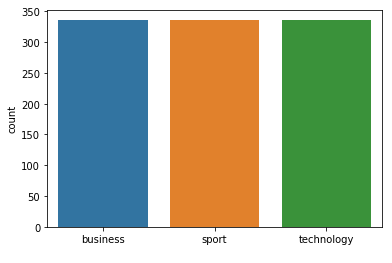



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 285
Class Distribution --> Train data (Fold 4 ):


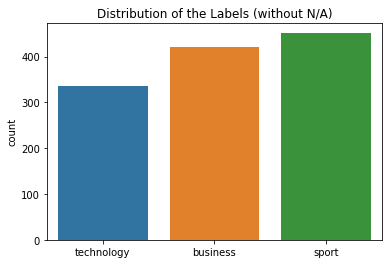

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


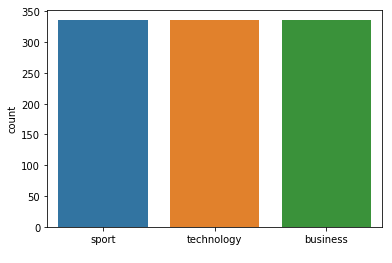



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 285
Class Distribution --> Train data (Fold 5 ):


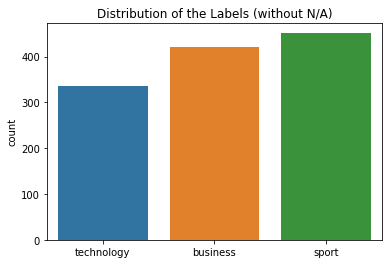

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


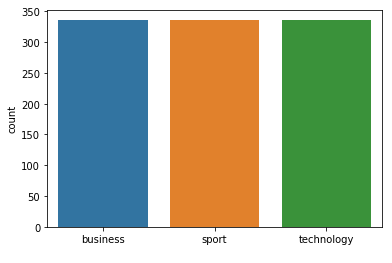



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 285
Class Distribution --> Train data (Fold 6 ):


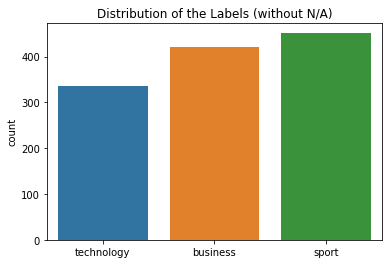

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


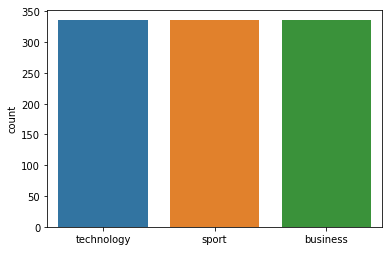



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.94      0.91      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 7 Number of neighbors 285
Class Distribution --> Train data (Fold 7 ):


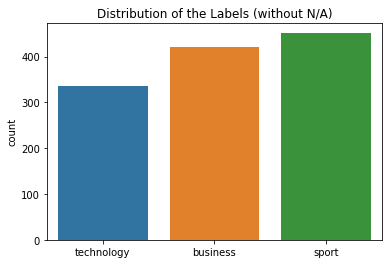

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


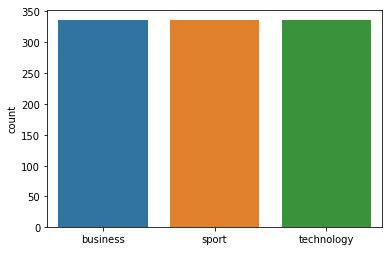



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 285  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 287
Class Distribution --> Train data (Fold 1 ):


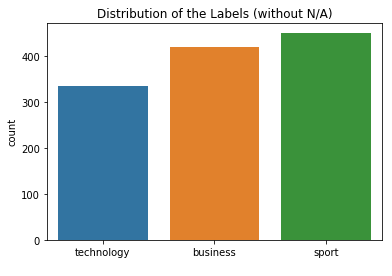

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


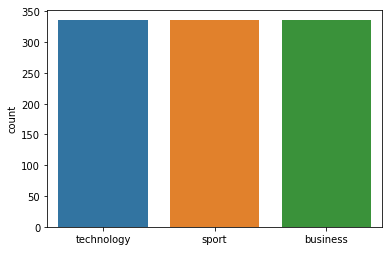



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 287
Class Distribution --> Train data (Fold 2 ):


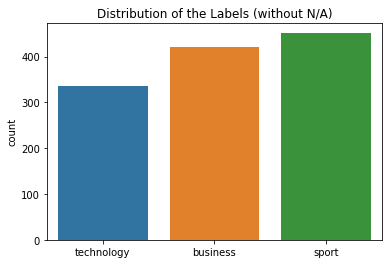

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


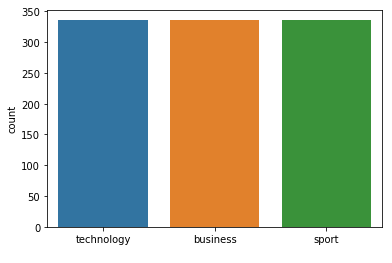



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 287
Class Distribution --> Train data (Fold 3 ):


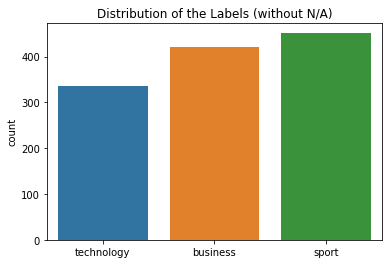

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


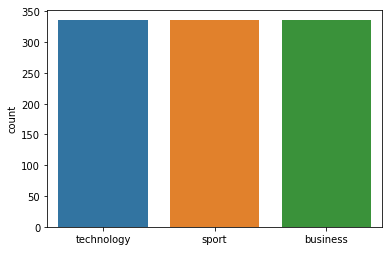



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 287
Class Distribution --> Train data (Fold 4 ):


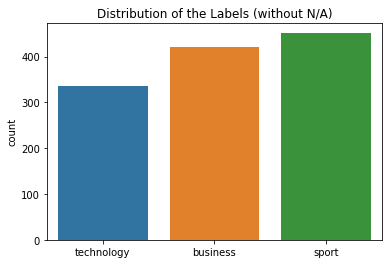

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


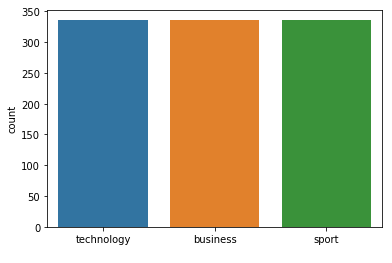



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       1.00      1.00      1.00        56

avg / total       1.00      1.00      1.00       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 287
Class Distribution --> Train data (Fold 5 ):


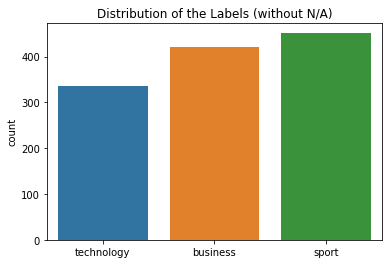

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


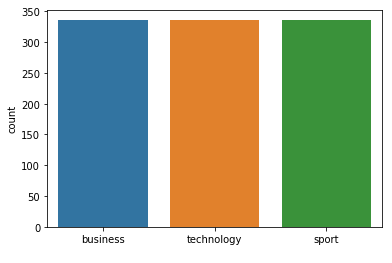



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 287
Class Distribution --> Train data (Fold 6 ):


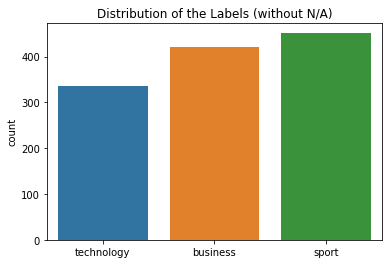

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


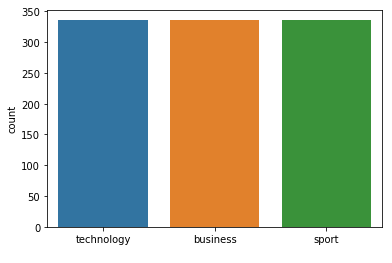



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 287
Class Distribution --> Train data (Fold 7 ):


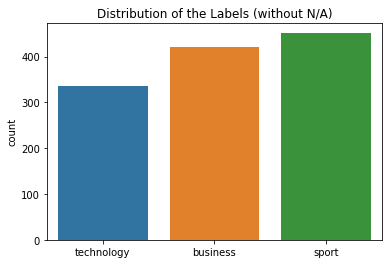

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


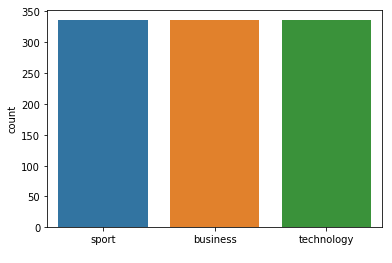



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.97      0.97      0.97        75
technology
       0.91      0.95      0.93        55

avg / total       0.95      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  0  5]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 287  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 289
Class Distribution --> Train data (Fold 1 ):


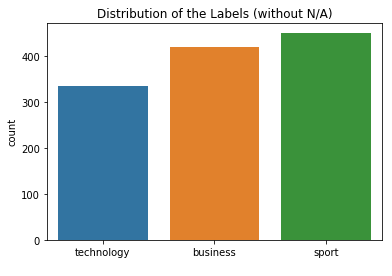

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


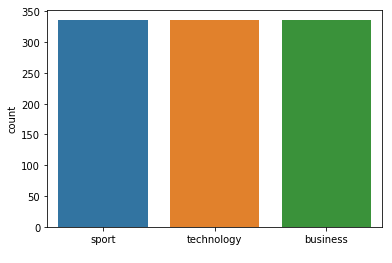



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 289
Class Distribution --> Train data (Fold 2 ):


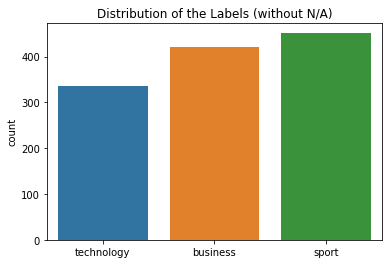

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


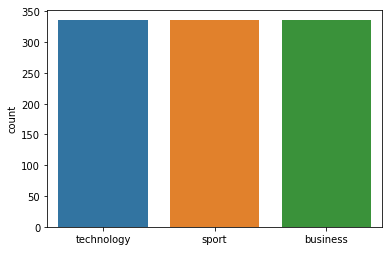



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 289
Class Distribution --> Train data (Fold 3 ):


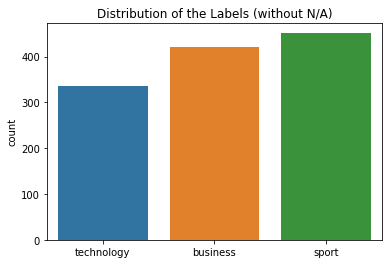

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


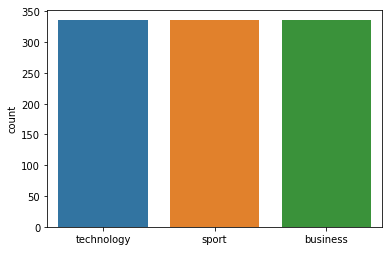



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.94      0.91      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 4 Number of neighbors 289
Class Distribution --> Train data (Fold 4 ):


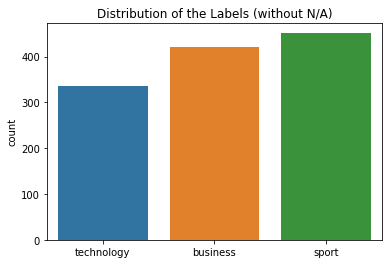

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


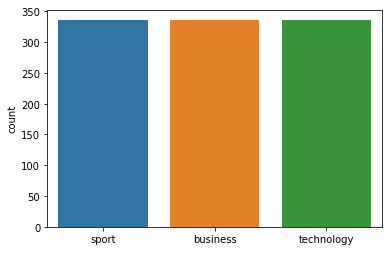



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 289
Class Distribution --> Train data (Fold 5 ):


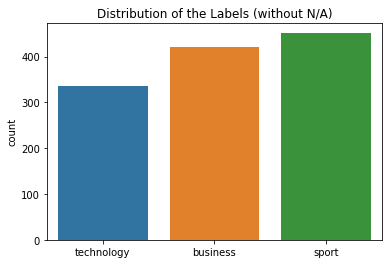

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


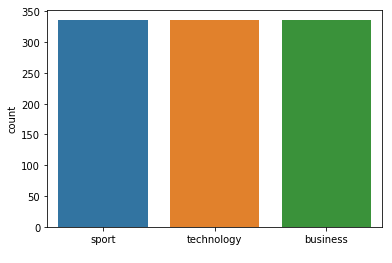



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 289
Class Distribution --> Train data (Fold 6 ):


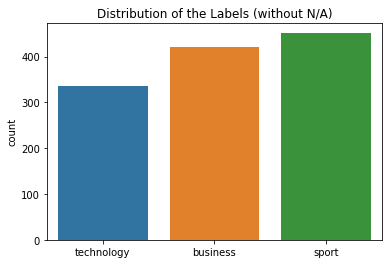

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


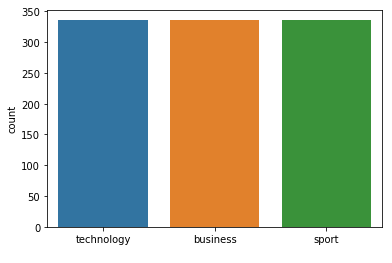



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 289
Class Distribution --> Train data (Fold 7 ):


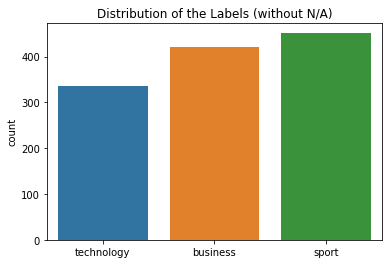

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


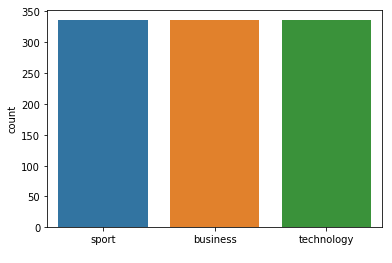



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 289  neighbours): 97.05% (+/- 1.07%)
FOLD 1 Number of neighbors 291
Class Distribution --> Train data (Fold 1 ):


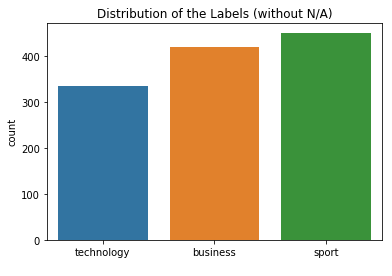

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


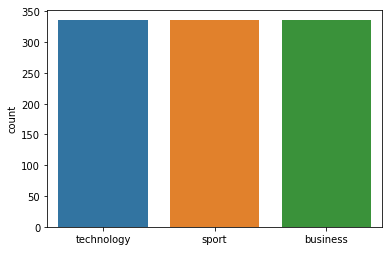



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 291
Class Distribution --> Train data (Fold 2 ):


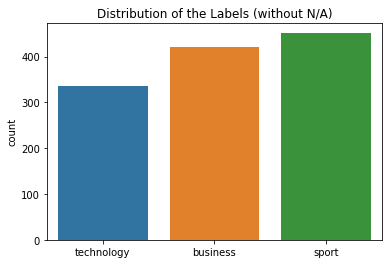

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


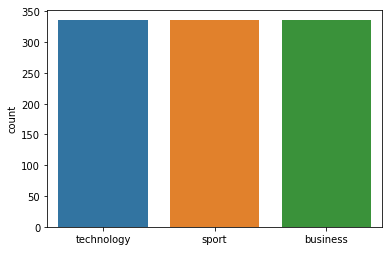



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 291
Class Distribution --> Train data (Fold 3 ):


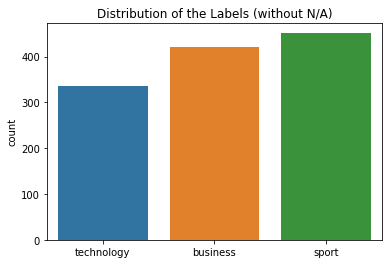

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


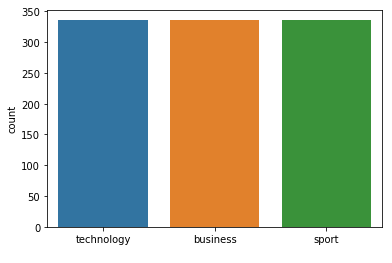



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.95      1.00      0.97        75
technology
       0.93      0.91      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 4 Number of neighbors 291
Class Distribution --> Train data (Fold 4 ):


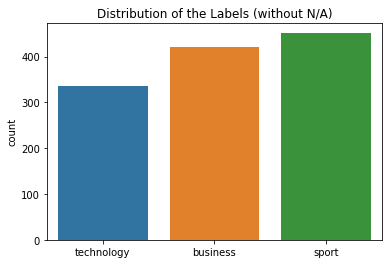

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


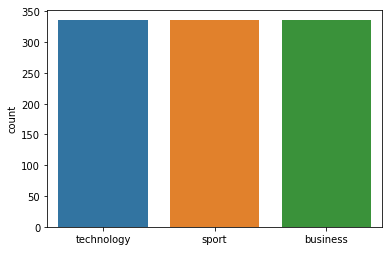



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 291
Class Distribution --> Train data (Fold 5 ):


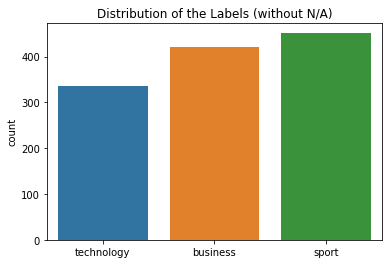

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


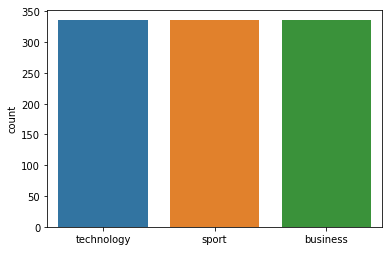



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 291
Class Distribution --> Train data (Fold 6 ):


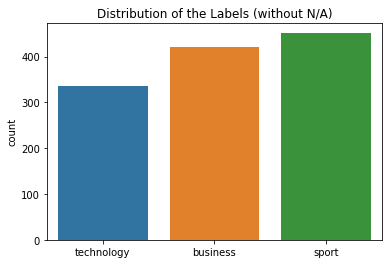

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


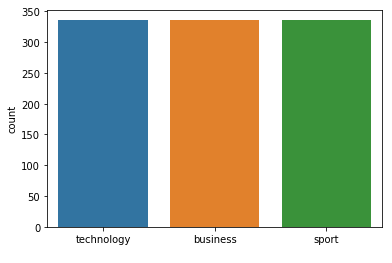



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  3 52]]
FOLD 7 Number of neighbors 291
Class Distribution --> Train data (Fold 7 ):


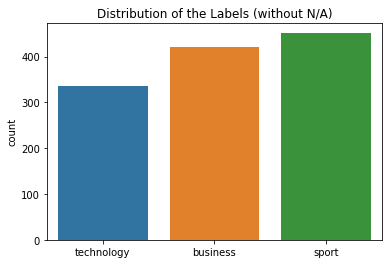

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


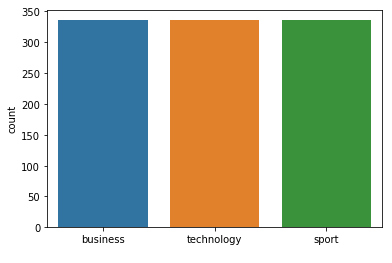



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 291  neighbours): 97.04% (+/- 1.08%)
FOLD 1 Number of neighbors 293
Class Distribution --> Train data (Fold 1 ):


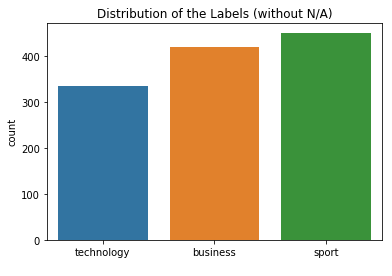

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


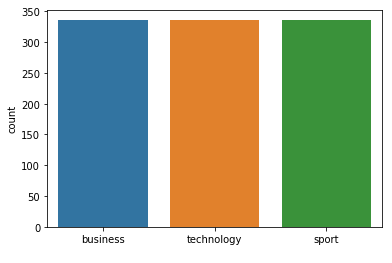



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 293
Class Distribution --> Train data (Fold 2 ):


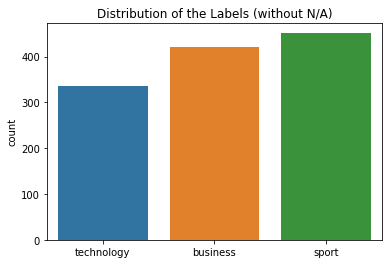

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


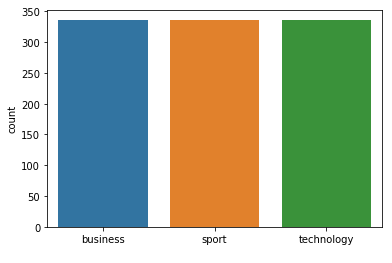



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 293
Class Distribution --> Train data (Fold 3 ):


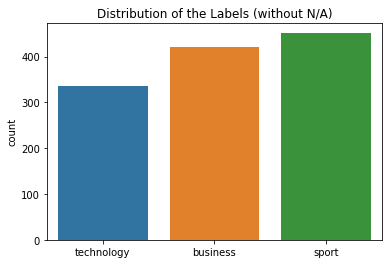

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


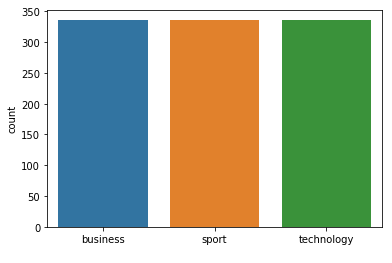



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 293
Class Distribution --> Train data (Fold 4 ):


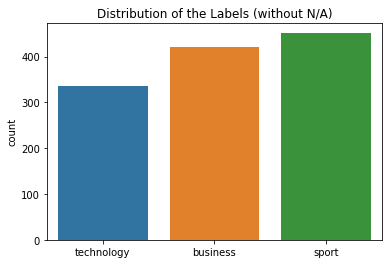

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


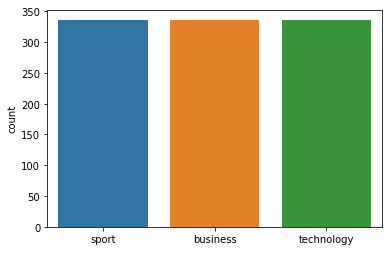



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 293
Class Distribution --> Train data (Fold 5 ):


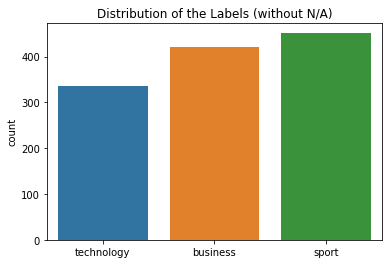

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


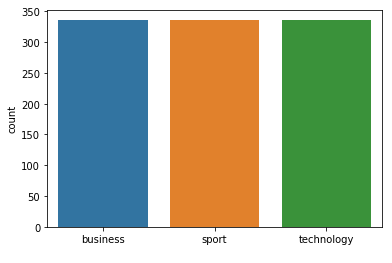



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 293
Class Distribution --> Train data (Fold 6 ):


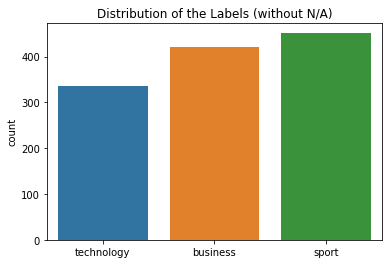

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


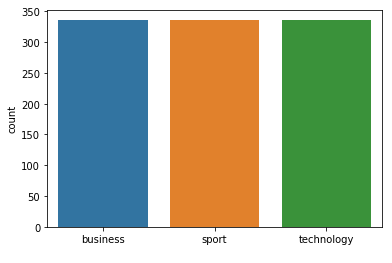



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.93      0.93      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  3 52]]
FOLD 7 Number of neighbors 293
Class Distribution --> Train data (Fold 7 ):


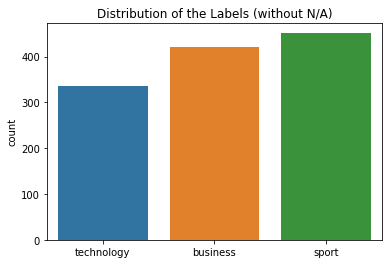

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


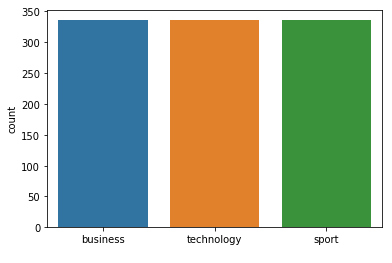



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 293  neighbours): 97.04% (+/- 1.08%)
FOLD 1 Number of neighbors 295
Class Distribution --> Train data (Fold 1 ):


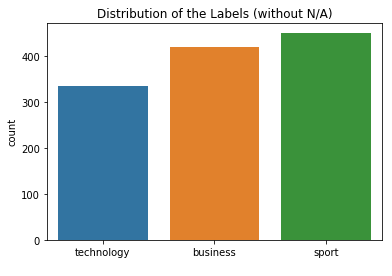

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


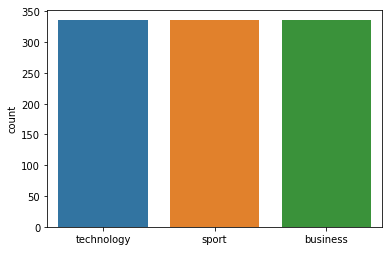



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.97      0.97        76
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 74  1]
 [ 0  2 54]]
FOLD 2 Number of neighbors 295
Class Distribution --> Train data (Fold 2 ):


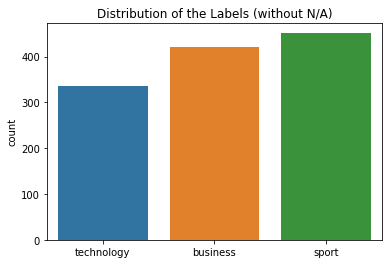

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


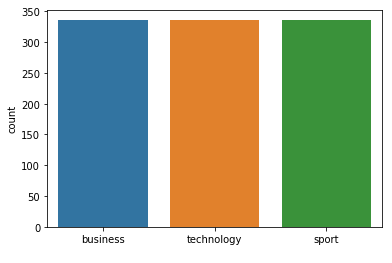



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 295
Class Distribution --> Train data (Fold 3 ):


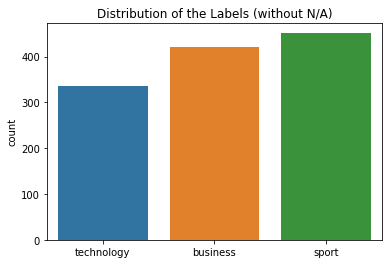

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


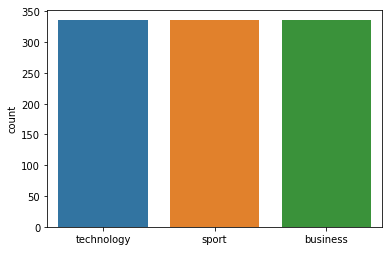



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 295
Class Distribution --> Train data (Fold 4 ):


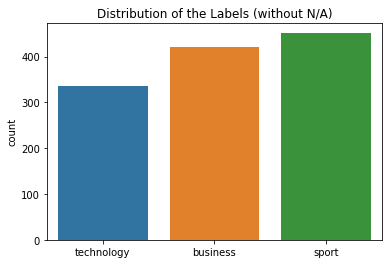

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


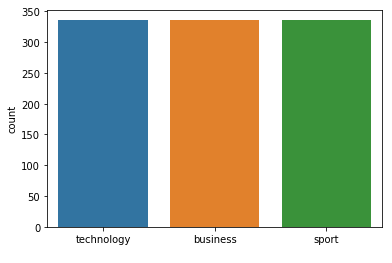



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 295
Class Distribution --> Train data (Fold 5 ):


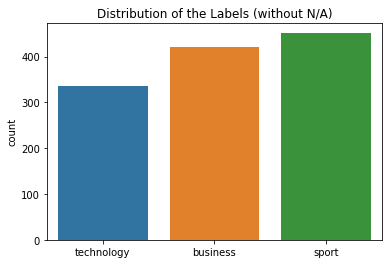

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


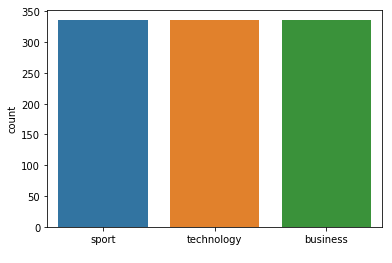



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 295
Class Distribution --> Train data (Fold 6 ):


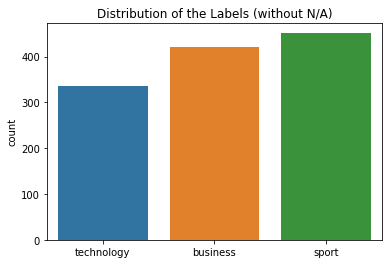

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


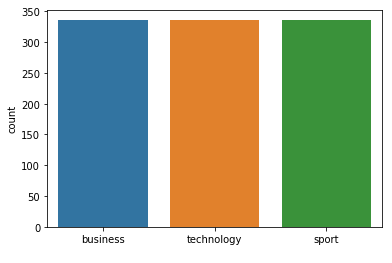



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 295
Class Distribution --> Train data (Fold 7 ):


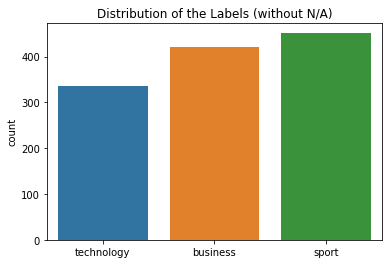

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


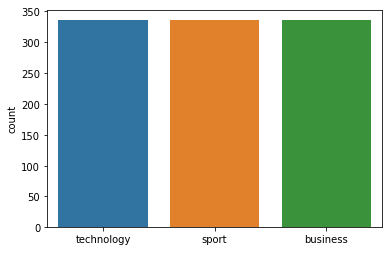



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.97      0.97      0.97        75
technology
       0.91      0.95      0.93        55

avg / total       0.95      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  0  5]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 295  neighbours): 97.04% (+/- 1.08%)
FOLD 1 Number of neighbors 297
Class Distribution --> Train data (Fold 1 ):


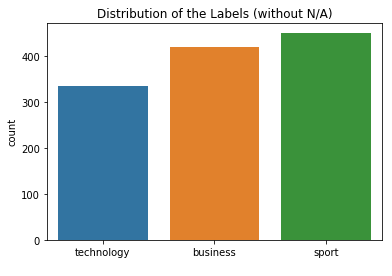

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


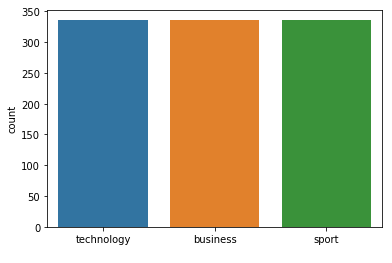



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 297
Class Distribution --> Train data (Fold 2 ):


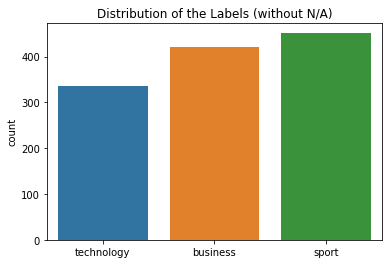

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


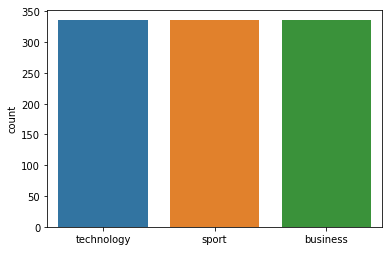



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 297
Class Distribution --> Train data (Fold 3 ):


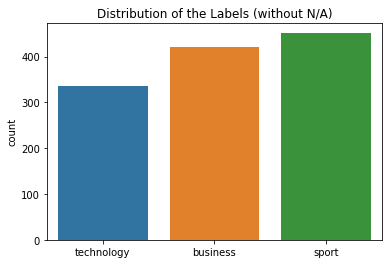

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


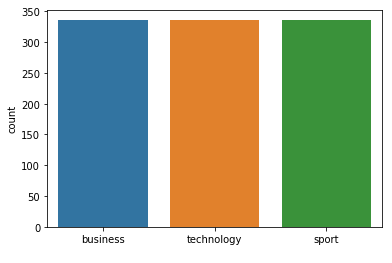



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 297
Class Distribution --> Train data (Fold 4 ):


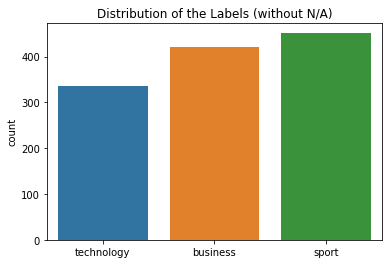

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


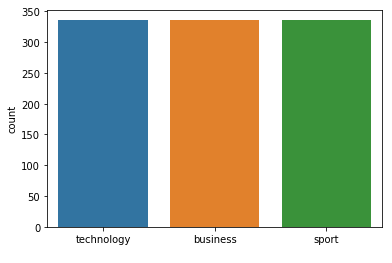



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 297
Class Distribution --> Train data (Fold 5 ):


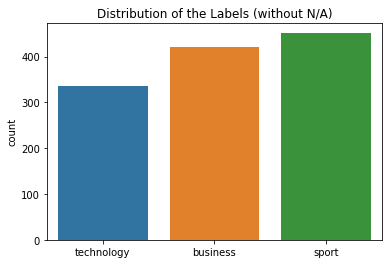

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


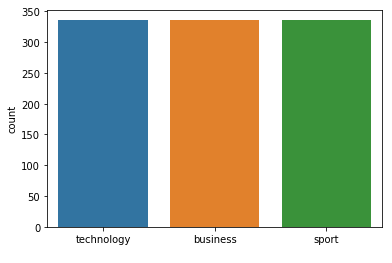



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 297
Class Distribution --> Train data (Fold 6 ):


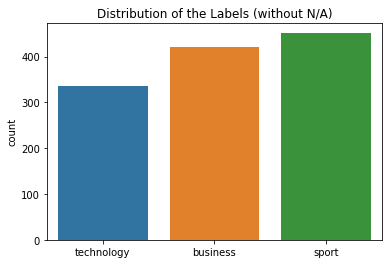

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


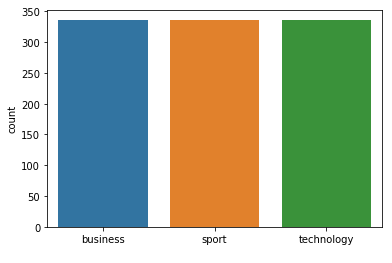



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  3 52]]
FOLD 7 Number of neighbors 297
Class Distribution --> Train data (Fold 7 ):


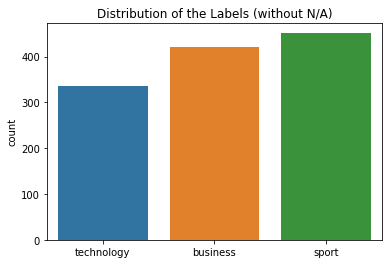

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


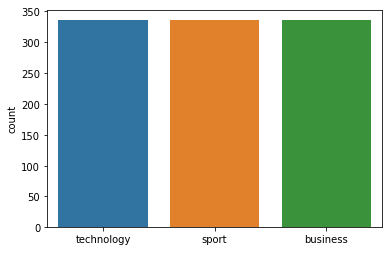



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.97      0.97        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 297  neighbours): 97.04% (+/- 1.08%)
FOLD 1 Number of neighbors 299
Class Distribution --> Train data (Fold 1 ):


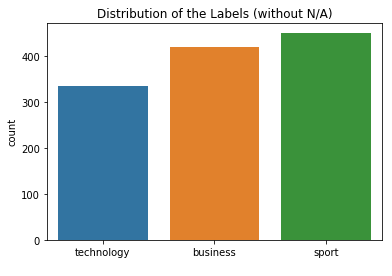

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


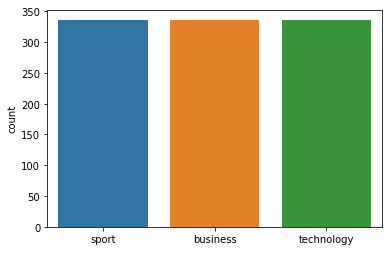



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 299
Class Distribution --> Train data (Fold 2 ):


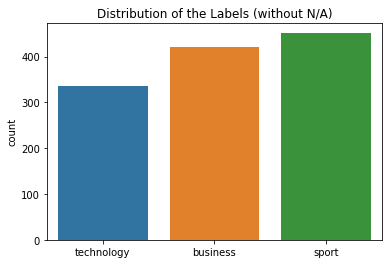

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


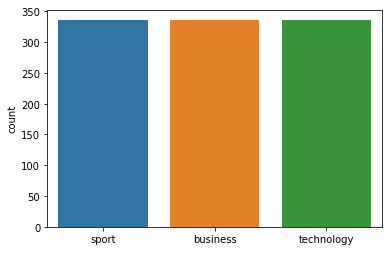



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 299
Class Distribution --> Train data (Fold 3 ):


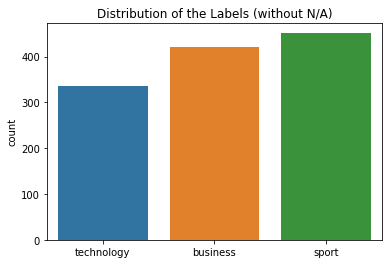

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


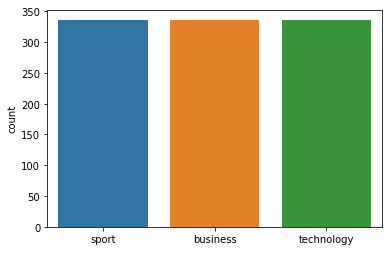



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.96      0.93      0.95        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 299
Class Distribution --> Train data (Fold 4 ):


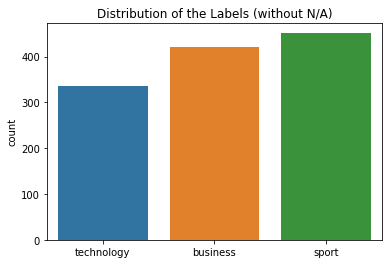

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


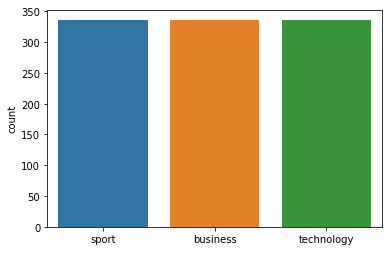



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 299
Class Distribution --> Train data (Fold 5 ):


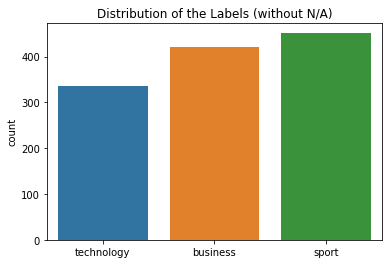

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


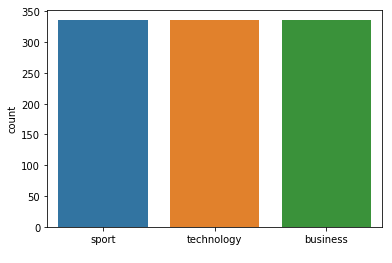



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 299
Class Distribution --> Train data (Fold 6 ):


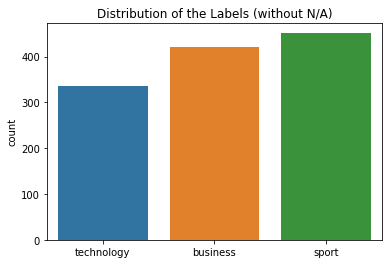

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


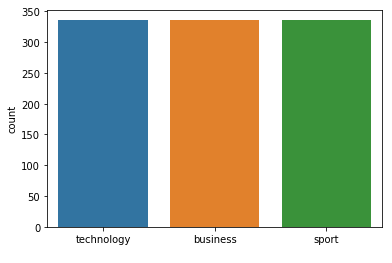



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  3 52]]
FOLD 7 Number of neighbors 299
Class Distribution --> Train data (Fold 7 ):


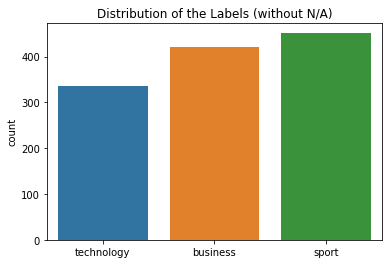

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


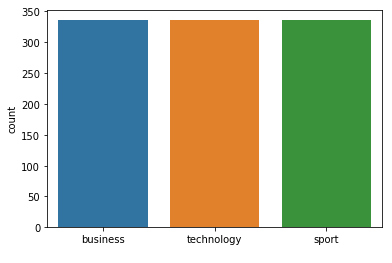



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 299  neighbours): 97.04% (+/- 1.08%)


In [379]:
cvscores = []
k_model_accuracy=[]

kfold = StratifiedKFold(n_splits=7, shuffle=True, random_state=seed)

for k in neighbors:
    fold=0
    model = KNeighborsClassifier(n_neighbors=k, metric='cosine')
    for train, test in kfold.split(X_term_weighting, class_labels):
        fold+=1
        print('FOLD',fold, 'Number of neighbors', k)
        labels_train=[]
        for i in range(len(train)):
            labels_train.append(class_labels[train[i]])
        labels_test=[]
        for i in range(len(test)):
            labels_test.append(class_labels[test[i]])
        
        # Plot a bar plot of the labels: class distribution is adjusted
        #seaborn.countplot - Show value counts for a single categorical variable:
        print('Class Distribution --> Train data (Fold',fold,'):')
        ax = sns.countplot(labels_train)
        ax.set_title("Distribution of the Labels (without N/A)")
        plt.show()

        # Apply the random under-sampling
        #Oversampling and undersampling in data analysis are techniques used to adjust the class distribution of a data set 
        #(i.e. the ratio between the different classes/categories represented).
        rus = RandomUnderSampler(return_indices=True)
        train_rus, train_labels_rus, idx_resampled = rus.fit_sample(X_term_weighting[train], labels_train)
        train_rus, train_labels_rus = shuffle(train_rus, train_labels_rus)

        # Plot a bar plot of the labels
        #seaborn.countplot - Show value counts for a single categorical variable:
        print('Class Distribution after performing under-sampling --> Train data (Fold',fold,'):')
        ax = sns.countplot(train_labels_rus)
        sns.countplot(train_labels_rus) #--> class distribution is adjusted
        plt.show()

        # Fit/Train the model
        model.fit(train_rus, train_labels_rus)

        #Evaluate the Model; Use the test dataset to evaluate the model
        print('\n\n ****** Test Data ******** (Fold',fold,'):')
        predicted = model.predict(X_term_weighting[test])

        # Print performance details
        print(metrics.classification_report(labels_test, predicted))

        # Print confusion matrix
        print('Confusion Matrix (Fold',fold,'):')
        print(metrics.confusion_matrix(labels_test, predicted))

        cvscores.append(accuracy_score(labels_test, predicted) * 100)
    print("\n\n Model accuracy (for",k," neighbours): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores), numpy.std(cvscores)))
    k_model_accuracy.append(numpy.mean(cvscores))

The highest model accuracy 97.0565916786394 is achieved by using optimal number of neighbors 205


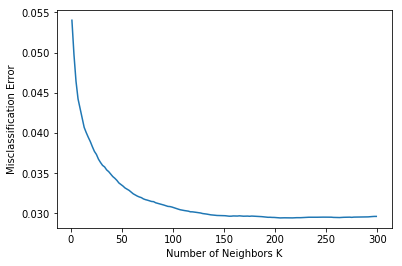

In [380]:
# changing to misclassification error
MSE = [1-x/100 for x in k_model_accuracy]
index=MSE.index(min(MSE))
optimal_k = neighbors[index]
print ("The highest model accuracy",k_model_accuracy[index],"is achieved by using optimal number of neighbors %d" % optimal_k)
# plot misclassification error vs k
plt.plot(neighbors, MSE)
plt.xlabel('Number of Neighbors K')
plt.ylabel('Misclassification Error')
plt.show()

FOLD 1 Number of neighbors 1
Class Distribution --> Train data (Fold 1 ):


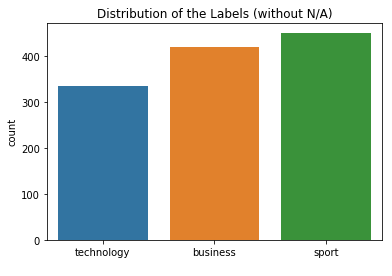

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


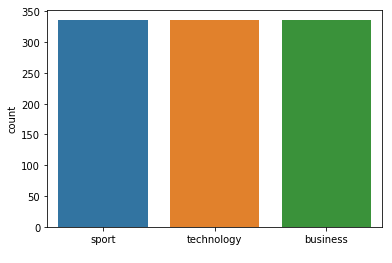



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.96      0.92      0.94        71
     sport
       1.00      0.96      0.98        76
technology
       0.89      0.98      0.93        56

avg / total       0.95      0.95      0.95       203

Confusion Matrix (Fold 1 ):
[[65  0  6]
 [ 2 73  1]
 [ 1  0 55]]
FOLD 2 Number of neighbors 1
Class Distribution --> Train data (Fold 2 ):


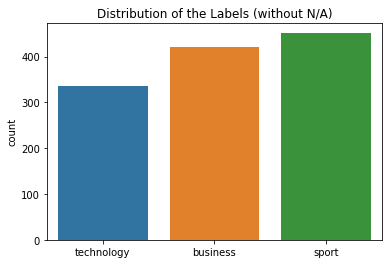

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


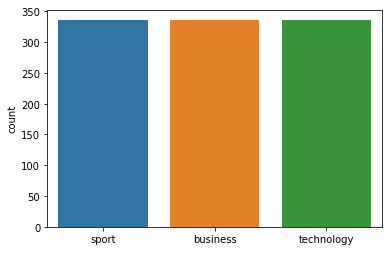



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.87      0.92        70
     sport
       0.96      0.97      0.97        75
technology
       0.87      0.98      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 2 ):
[[61  2  7]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 1
Class Distribution --> Train data (Fold 3 ):


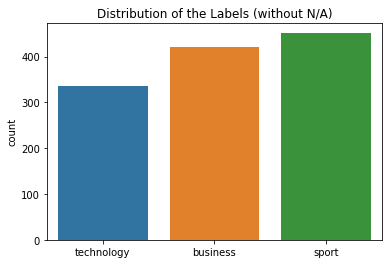

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


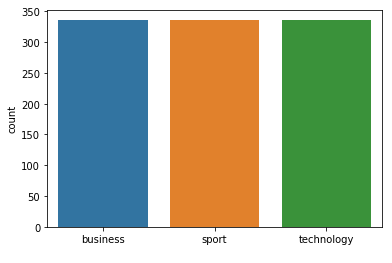



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        70
     sport
       0.99      0.95      0.97        75
technology
       0.93      0.98      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 3 71  1]
 [ 1  0 55]]
FOLD 4 Number of neighbors 1
Class Distribution --> Train data (Fold 4 ):


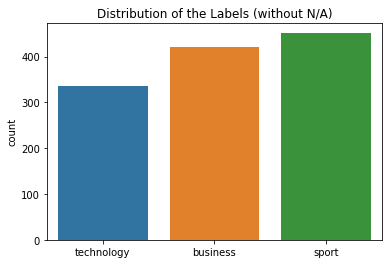

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


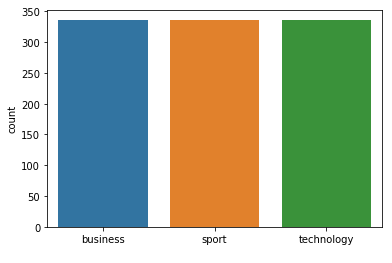



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.99      0.92      0.95        75
technology
       0.93      0.96      0.95        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 4 ):
[[68  1  1]
 [ 3 69  3]
 [ 2  0 54]]
FOLD 5 Number of neighbors 1
Class Distribution --> Train data (Fold 5 ):


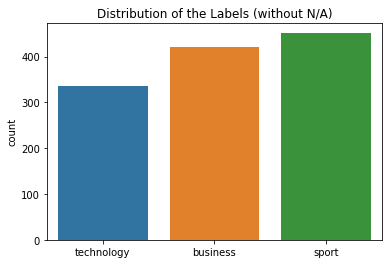

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


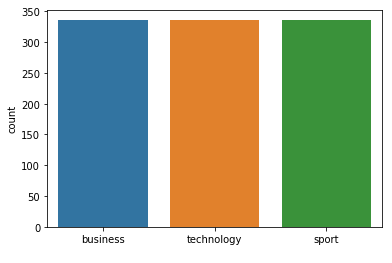



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.95      0.90      0.93        70
     sport
       0.97      0.95      0.96        75
technology
       0.87      0.96      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 5 ):
[[63  1  6]
 [ 2 71  2]
 [ 1  1 54]]
FOLD 6 Number of neighbors 1
Class Distribution --> Train data (Fold 6 ):


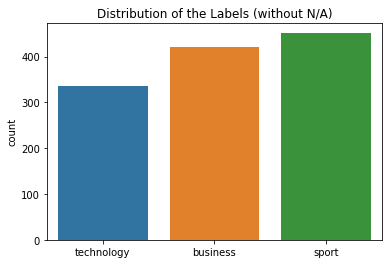

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


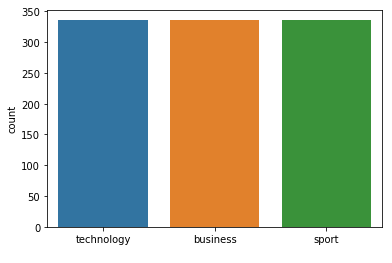



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.93      0.91      0.92        70
     sport
       0.95      0.97      0.96        75
technology
       0.93      0.91      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[64  3  3]
 [ 1 73  1]
 [ 4  1 51]]
FOLD 7 Number of neighbors 1
Class Distribution --> Train data (Fold 7 ):


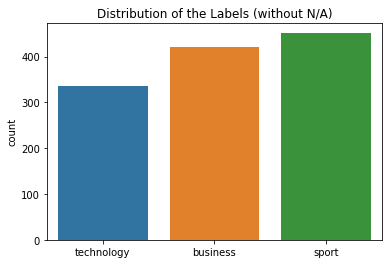

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


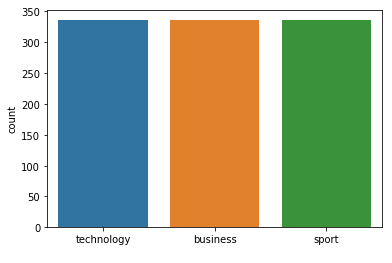



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.90      0.91      0.91        70
     sport
       0.95      0.96      0.95        75
technology
       0.91      0.87      0.89        55

avg / total       0.92      0.92      0.92       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 2 72  1]
 [ 5  2 48]]


 Model accuracy (for 1  neighbours): 94.10% (+/- 1.13%)
FOLD 1 Number of neighbors 3
Class Distribution --> Train data (Fold 1 ):


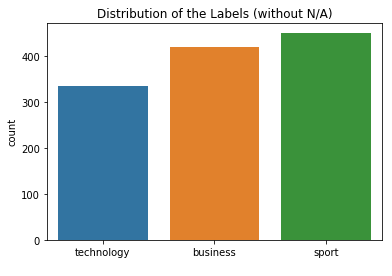

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


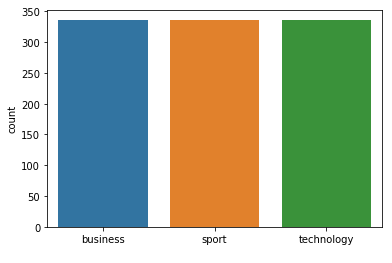



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        71
     sport
       0.99      0.97      0.98        76
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 1 74  1]
 [ 1  1 54]]
FOLD 2 Number of neighbors 3
Class Distribution --> Train data (Fold 2 ):


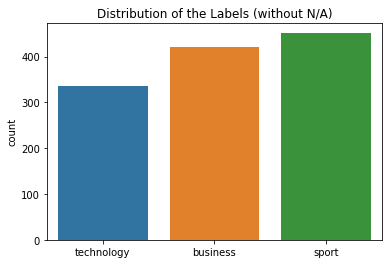

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


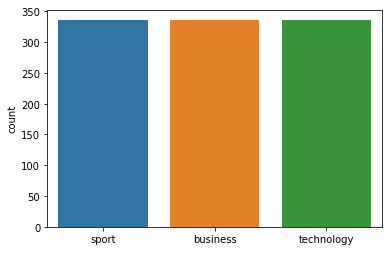



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.89      0.93        70
     sport
       0.97      0.96      0.97        75
technology
       0.87      0.98      0.92        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 2 ):
[[62  1  7]
 [ 2 72  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 3
Class Distribution --> Train data (Fold 3 ):


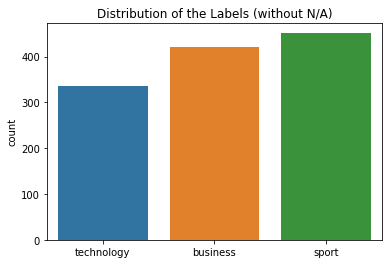

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


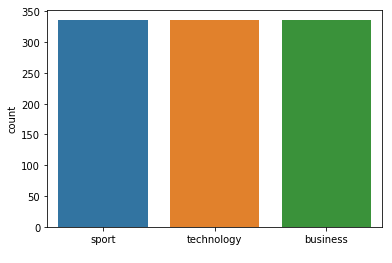



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 3
Class Distribution --> Train data (Fold 4 ):


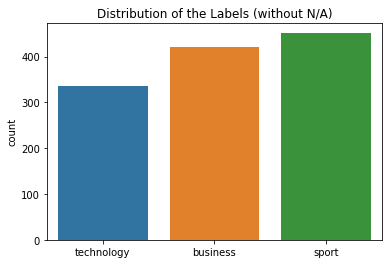

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


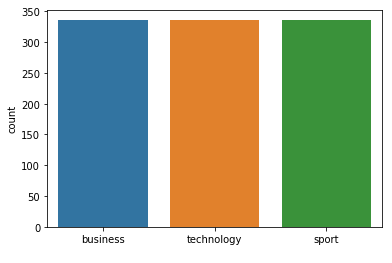



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       1.00      0.95      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 3 71  1]
 [ 1  0 55]]
FOLD 5 Number of neighbors 3
Class Distribution --> Train data (Fold 5 ):


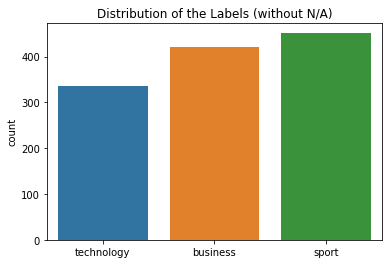

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


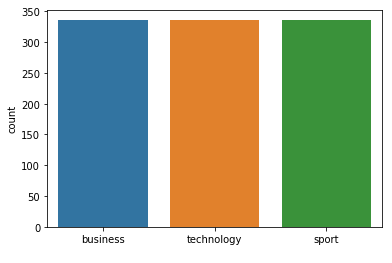



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       1.00      0.99      0.99        75
technology
       0.90      1.00      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[64  0  6]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 3
Class Distribution --> Train data (Fold 6 ):


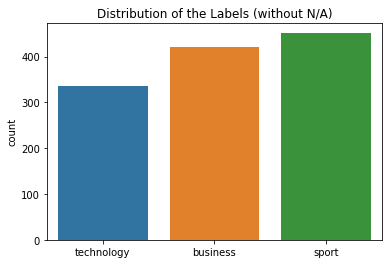

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


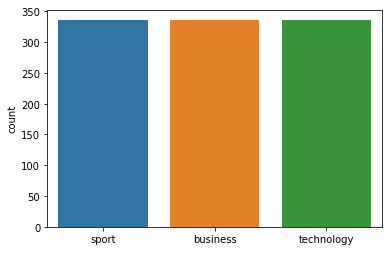



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.97      0.97      0.97        75
technology
       0.90      0.93      0.91        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[65  0  5]
 [ 1 73  1]
 [ 2  2 52]]
FOLD 7 Number of neighbors 3
Class Distribution --> Train data (Fold 7 ):


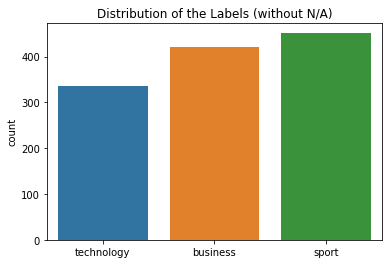

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


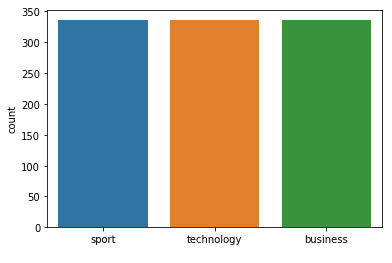



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.94      0.91      0.93        70
     sport
       0.95      0.97      0.96        75
technology
       0.93      0.93      0.93        55

avg / total       0.94      0.94      0.94       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 2 73  0]
 [ 2  2 51]]


 Model accuracy (for 3  neighbours): 94.85% (+/- 1.40%)
FOLD 1 Number of neighbors 5
Class Distribution --> Train data (Fold 1 ):


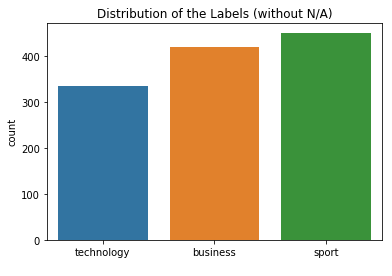

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


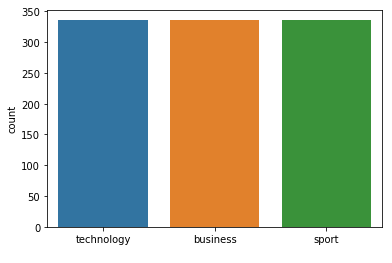



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        71
     sport
       0.99      0.96      0.97        76
technology
       0.90      0.96      0.93        56

avg / total       0.95      0.95      0.95       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 2 73  1]
 [ 1  1 54]]
FOLD 2 Number of neighbors 5
Class Distribution --> Train data (Fold 2 ):


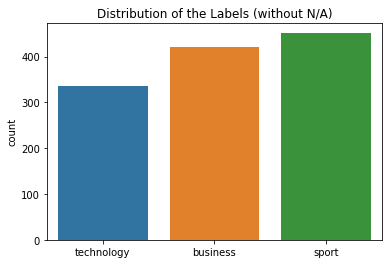

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


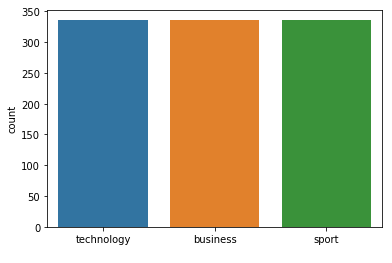



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.92      0.98      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  0  4]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 5
Class Distribution --> Train data (Fold 3 ):


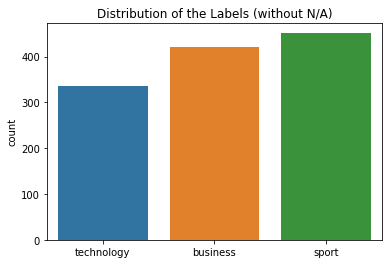

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


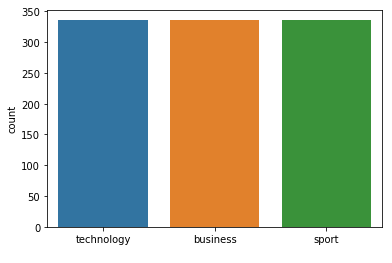



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 4 Number of neighbors 5
Class Distribution --> Train data (Fold 4 ):


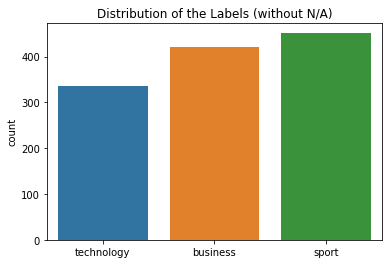

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


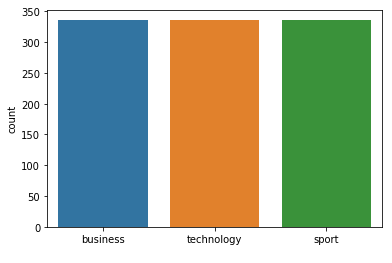



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       1.00      0.95      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 3 71  1]
 [ 1  0 55]]
FOLD 5 Number of neighbors 5
Class Distribution --> Train data (Fold 5 ):


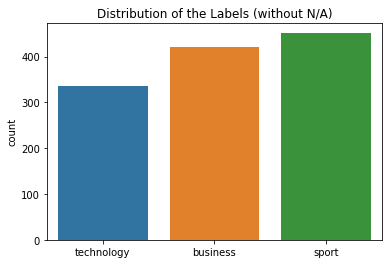

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


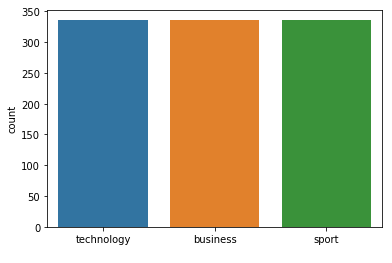



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 5
Class Distribution --> Train data (Fold 6 ):


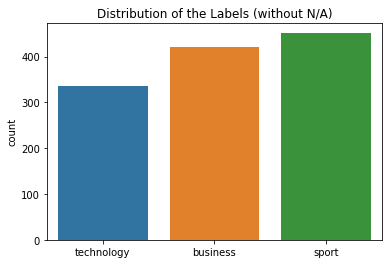

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


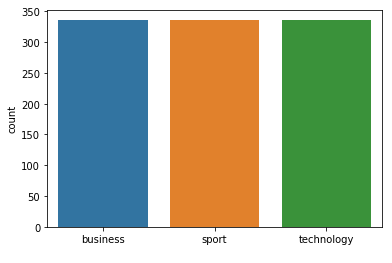



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.91      0.93        70
     sport
       0.97      0.99      0.98        75
technology
       0.89      0.91      0.90        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[64  0  6]
 [ 1 74  0]
 [ 3  2 51]]
FOLD 7 Number of neighbors 5
Class Distribution --> Train data (Fold 7 ):


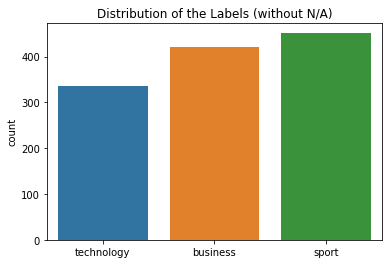

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


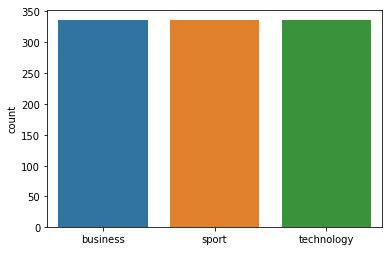



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.96      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  1 53]]


 Model accuracy (for 5  neighbours): 95.26% (+/- 1.42%)
FOLD 1 Number of neighbors 7
Class Distribution --> Train data (Fold 1 ):


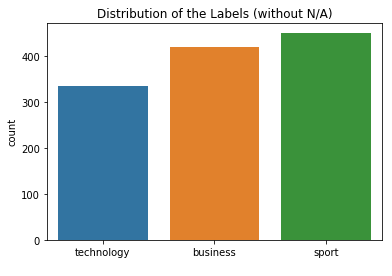

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


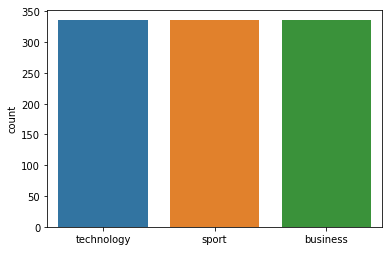



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.93      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.92      0.98      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 76  0]
 [ 1  0 55]]
FOLD 2 Number of neighbors 7
Class Distribution --> Train data (Fold 2 ):


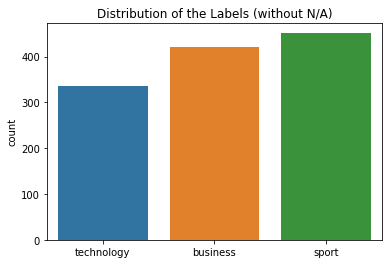

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


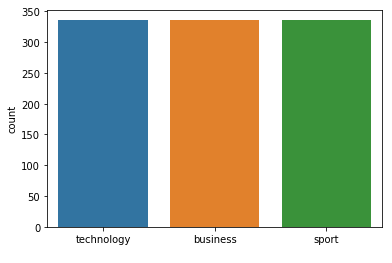



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[65  1  4]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 7
Class Distribution --> Train data (Fold 3 ):


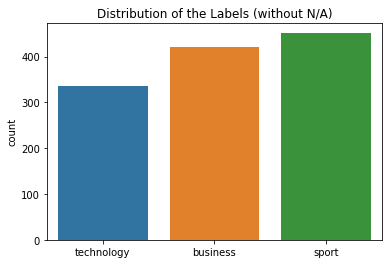

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


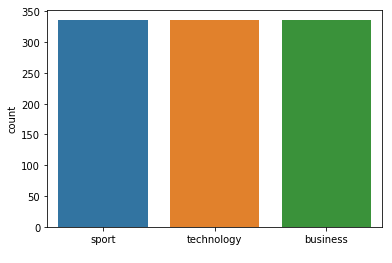



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 4 Number of neighbors 7
Class Distribution --> Train data (Fold 4 ):


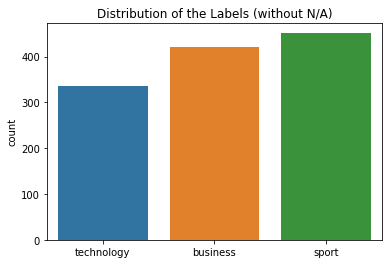

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


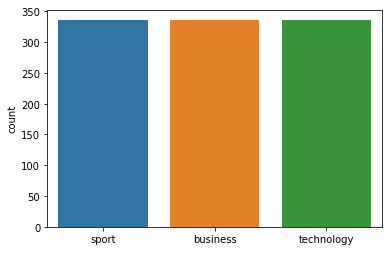



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       1.00      0.95      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 3 71  1]
 [ 1  0 55]]
FOLD 5 Number of neighbors 7
Class Distribution --> Train data (Fold 5 ):


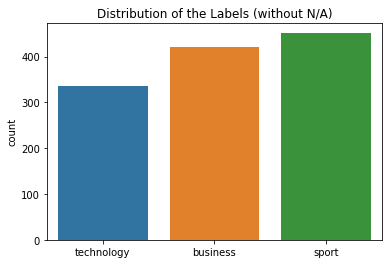

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


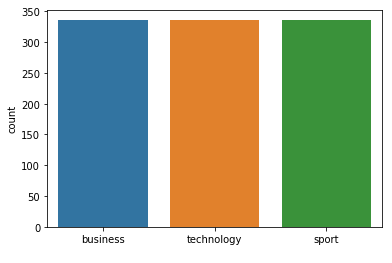



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 7
Class Distribution --> Train data (Fold 6 ):


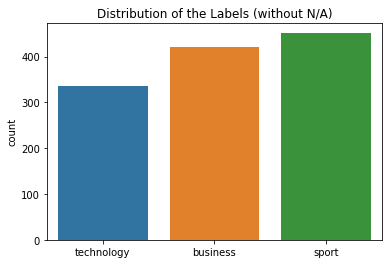

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


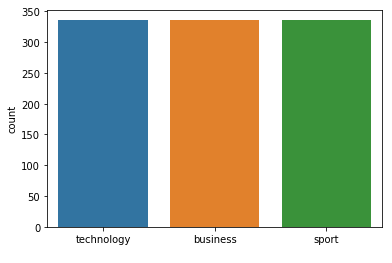



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.91      0.93        70
     sport
       0.97      0.99      0.98        75
technology
       0.89      0.91      0.90        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[64  0  6]
 [ 1 74  0]
 [ 3  2 51]]
FOLD 7 Number of neighbors 7
Class Distribution --> Train data (Fold 7 ):


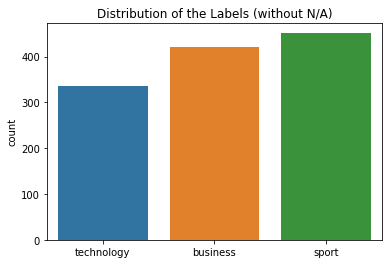

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


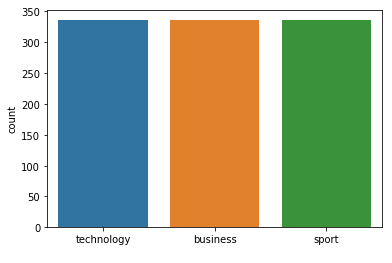



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.97      0.97        75
technology
       0.93      0.98      0.96        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 2 73  0]
 [ 0  1 54]]


 Model accuracy (for 7  neighbours): 95.54% (+/- 1.43%)
FOLD 1 Number of neighbors 9
Class Distribution --> Train data (Fold 1 ):


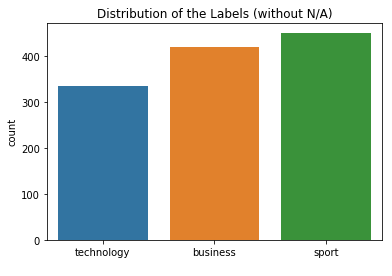

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


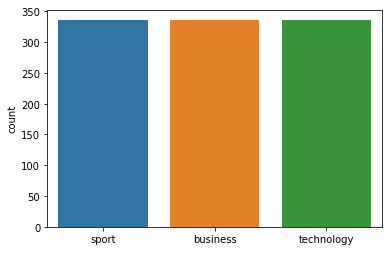



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 1  0 55]]
FOLD 2 Number of neighbors 9
Class Distribution --> Train data (Fold 2 ):


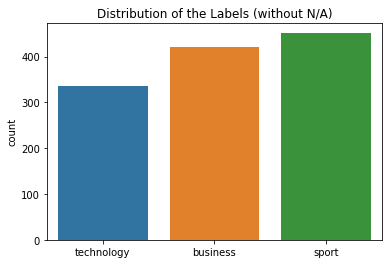

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


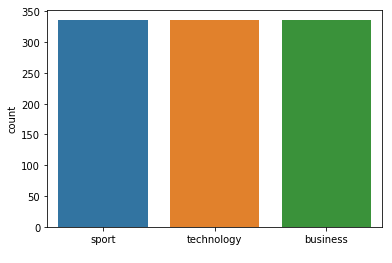



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.90      1.00      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[65  0  5]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 9
Class Distribution --> Train data (Fold 3 ):


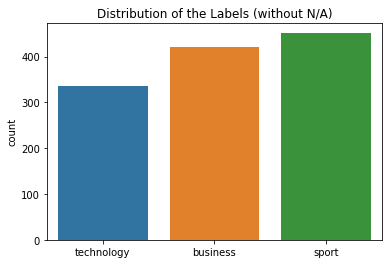

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


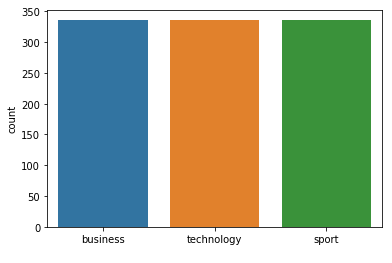



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 74  1]
 [ 0  0 56]]
FOLD 4 Number of neighbors 9
Class Distribution --> Train data (Fold 4 ):


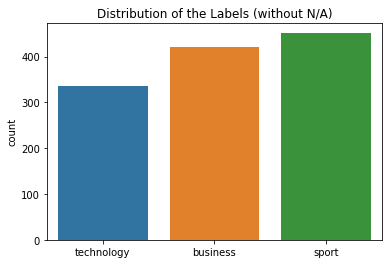

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


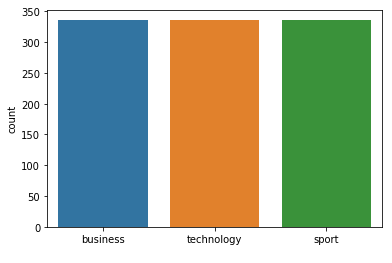



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.99      0.96      0.97        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 72  1]
 [ 1  0 55]]
FOLD 5 Number of neighbors 9
Class Distribution --> Train data (Fold 5 ):


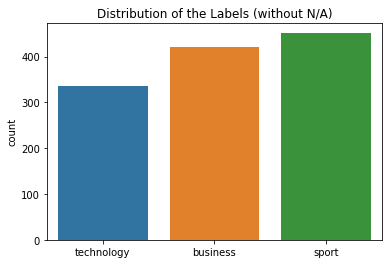

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


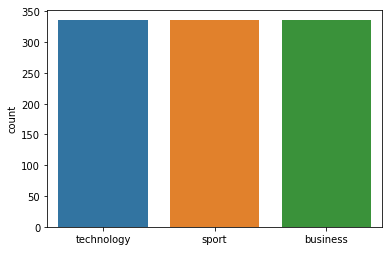



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 9
Class Distribution --> Train data (Fold 6 ):


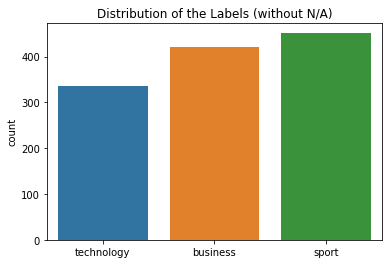

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


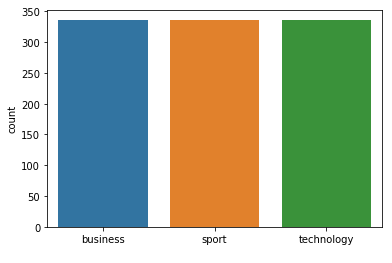



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.96      0.91      0.93        70
     sport
       0.96      0.99      0.97        75
technology
       0.91      0.93      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 1 74  0]
 [ 2  2 52]]
FOLD 7 Number of neighbors 9
Class Distribution --> Train data (Fold 7 ):


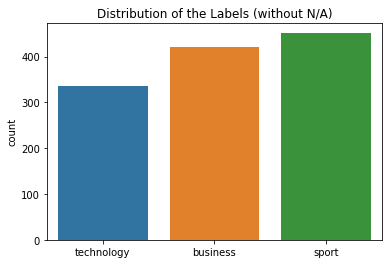

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


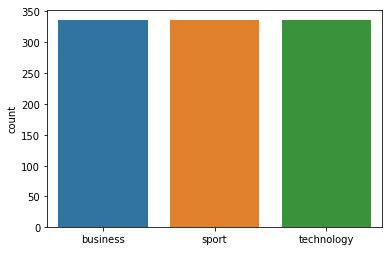



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.96      0.95        55

avg / total       0.97      0.96      0.97       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 9  neighbours): 95.77% (+/- 1.42%)
FOLD 1 Number of neighbors 11
Class Distribution --> Train data (Fold 1 ):


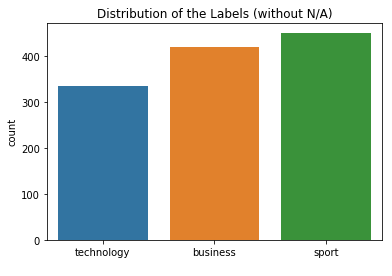

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


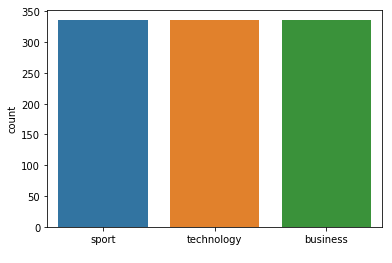



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.93      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.92      0.98      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 76  0]
 [ 1  0 55]]
FOLD 2 Number of neighbors 11
Class Distribution --> Train data (Fold 2 ):


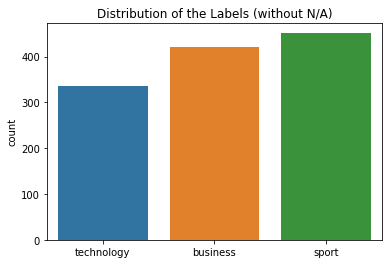

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


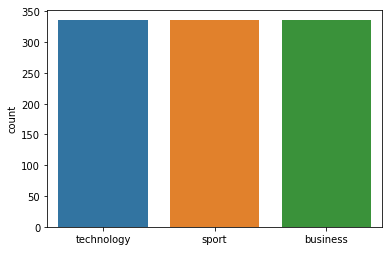



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[65  1  4]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 11
Class Distribution --> Train data (Fold 3 ):


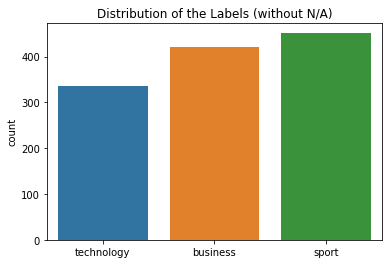

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


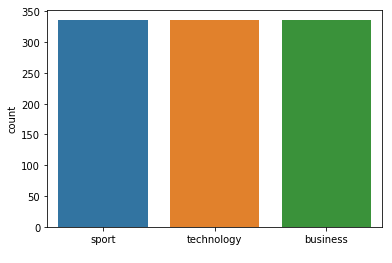



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 11
Class Distribution --> Train data (Fold 4 ):


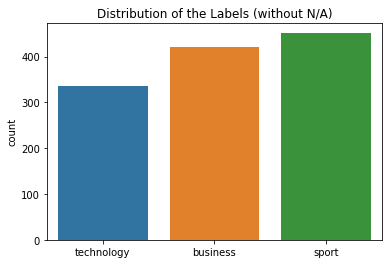

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


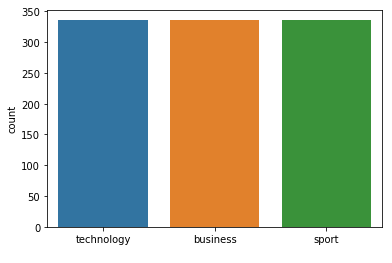



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 2  0 54]]
FOLD 5 Number of neighbors 11
Class Distribution --> Train data (Fold 5 ):


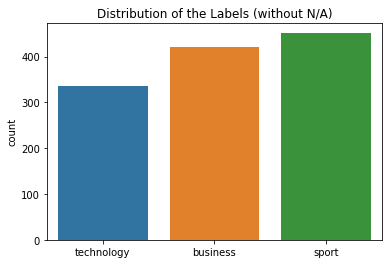

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


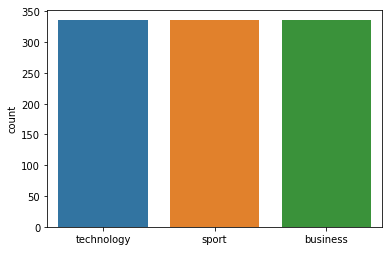



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 11
Class Distribution --> Train data (Fold 6 ):


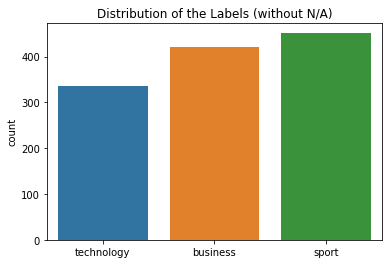

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


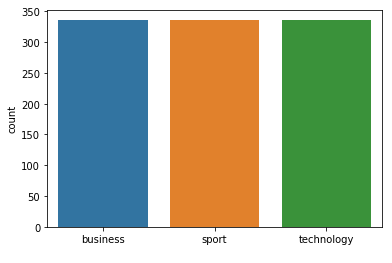



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.91      0.93        70
     sport
       0.96      0.99      0.97        75
technology
       0.91      0.91      0.91        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 1 74  0]
 [ 3  2 51]]
FOLD 7 Number of neighbors 11
Class Distribution --> Train data (Fold 7 ):


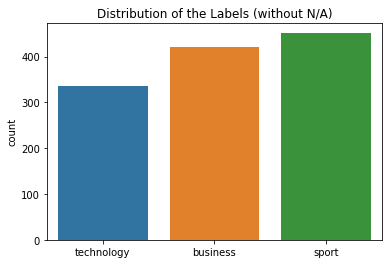

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


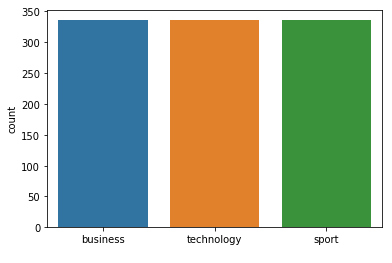



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 11  neighbours): 95.92% (+/- 1.42%)
FOLD 1 Number of neighbors 13
Class Distribution --> Train data (Fold 1 ):


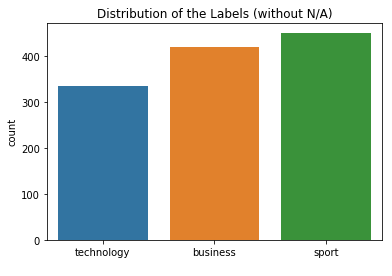

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


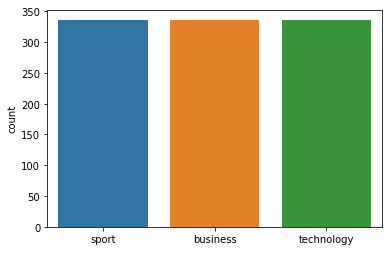



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.92      1.00      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 13
Class Distribution --> Train data (Fold 2 ):


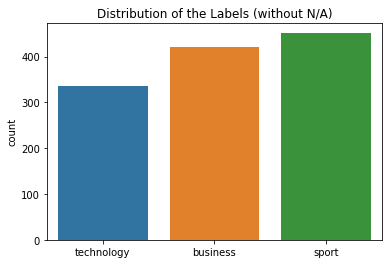

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


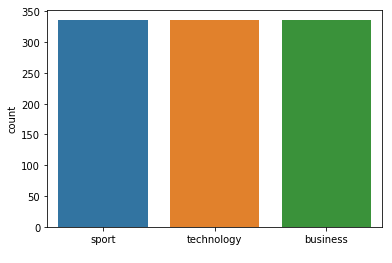



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  0  4]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 13
Class Distribution --> Train data (Fold 3 ):


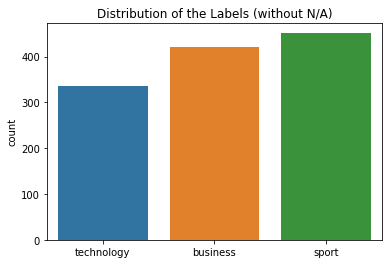

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


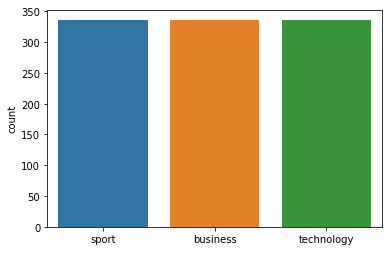



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 13
Class Distribution --> Train data (Fold 4 ):


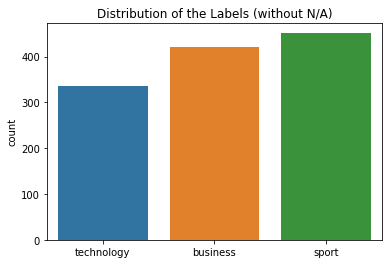

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


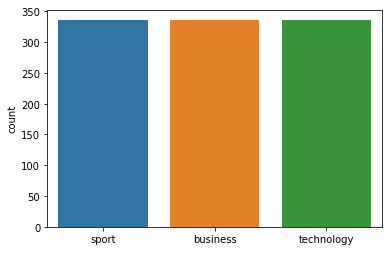



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       1.00      0.96      0.98        75
technology
       0.98      1.00      0.99        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 3 72  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 13
Class Distribution --> Train data (Fold 5 ):


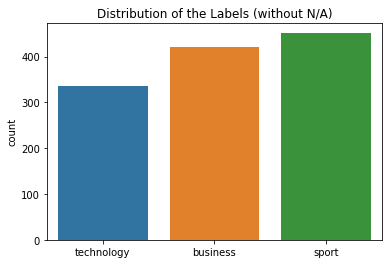

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


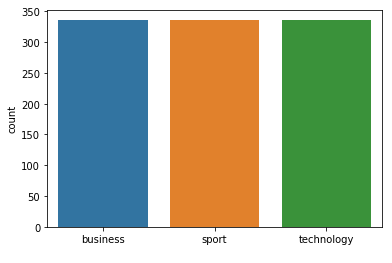



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 13
Class Distribution --> Train data (Fold 6 ):


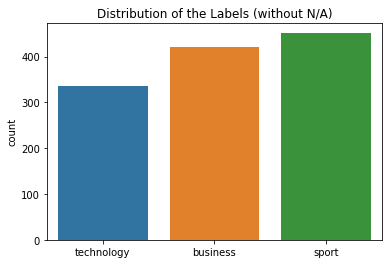

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


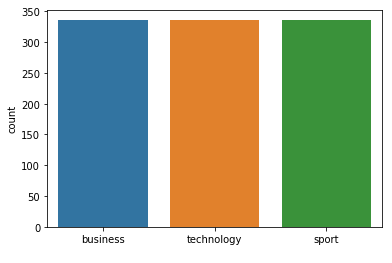



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.94      0.91      0.93        70
     sport
       0.96      0.99      0.97        75
technology
       0.91      0.91      0.91        56

avg / total       0.94      0.94      0.94       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 1 74  0]
 [ 3  2 51]]
FOLD 7 Number of neighbors 13
Class Distribution --> Train data (Fold 7 ):


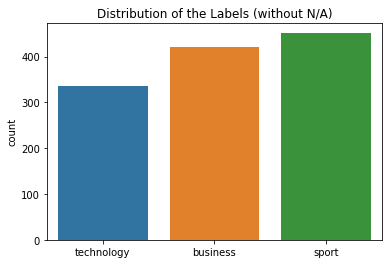

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


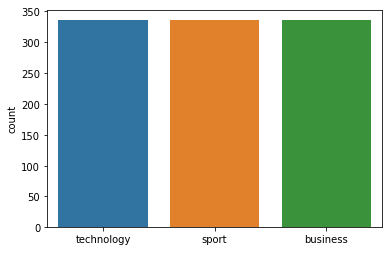



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 13  neighbours): 96.02% (+/- 1.41%)
FOLD 1 Number of neighbors 15
Class Distribution --> Train data (Fold 1 ):


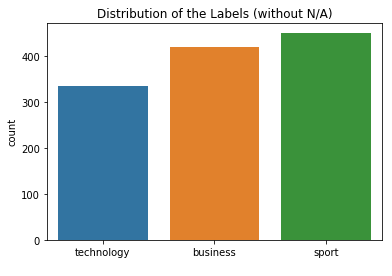

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


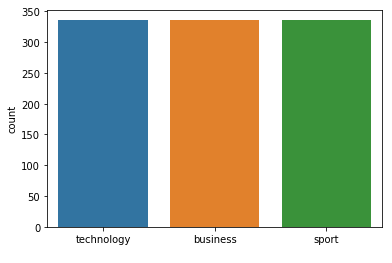



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 75  1]
 [ 0  1 55]]
FOLD 2 Number of neighbors 15
Class Distribution --> Train data (Fold 2 ):


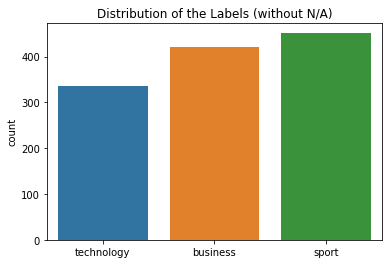

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


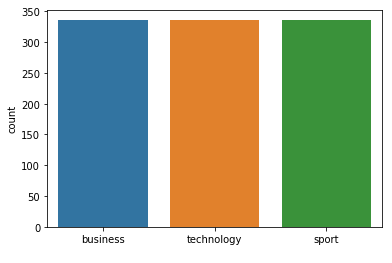



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.90      0.94        70
     sport
       0.96      0.97      0.97        75
technology
       0.90      0.98      0.94        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[63  2  5]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 15
Class Distribution --> Train data (Fold 3 ):


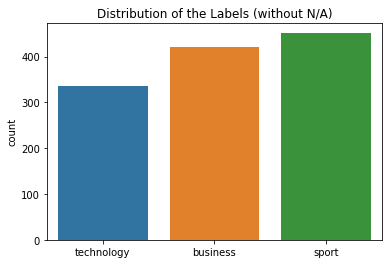

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


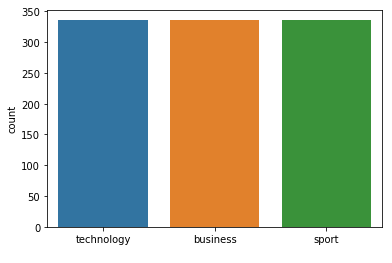



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 15
Class Distribution --> Train data (Fold 4 ):


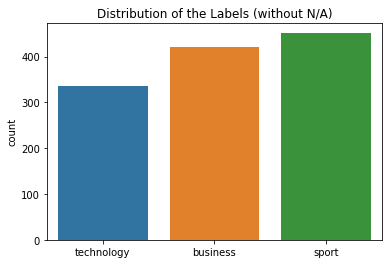

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


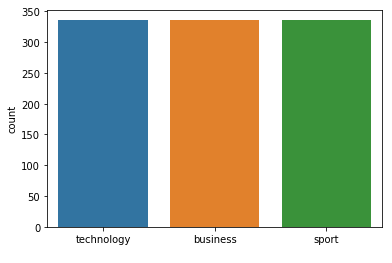



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       1.00      0.96      0.98        75
technology
       0.98      1.00      0.99        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 3 72  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 15
Class Distribution --> Train data (Fold 5 ):


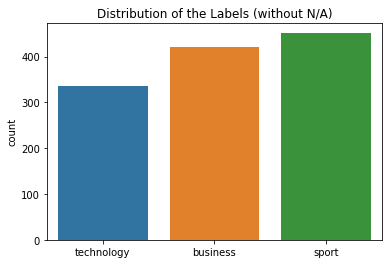

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


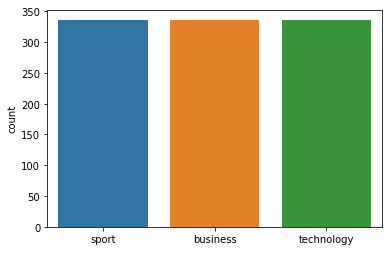



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 5 ):
[[64  1  5]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 6 Number of neighbors 15
Class Distribution --> Train data (Fold 6 ):


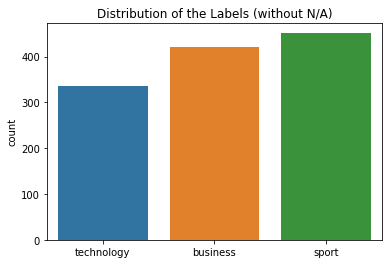

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


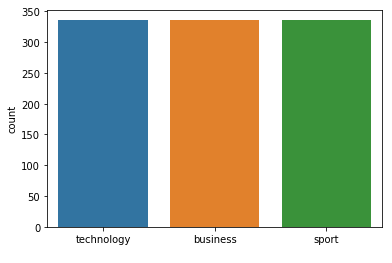



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.93      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 7 Number of neighbors 15
Class Distribution --> Train data (Fold 7 ):


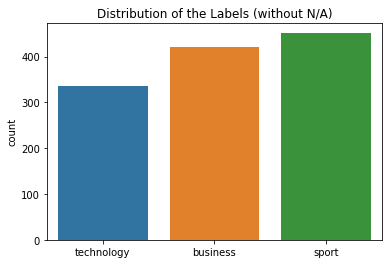

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


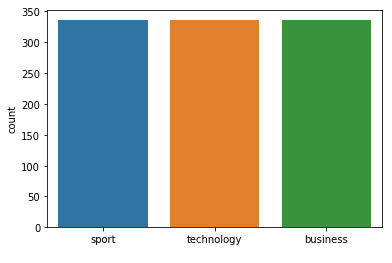



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.96      0.95        55

avg / total       0.97      0.96      0.97       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 15  neighbours): 96.07% (+/- 1.38%)
FOLD 1 Number of neighbors 17
Class Distribution --> Train data (Fold 1 ):


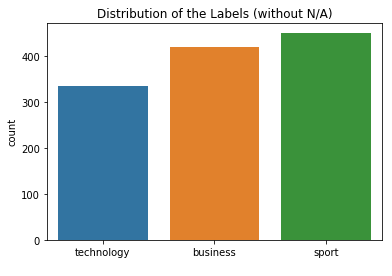

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


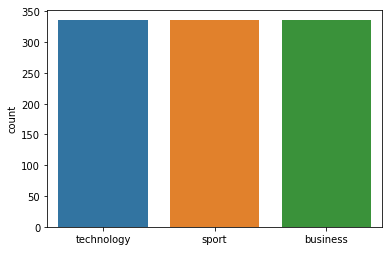



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.92      1.00      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 17
Class Distribution --> Train data (Fold 2 ):


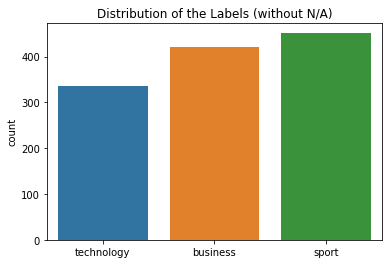

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


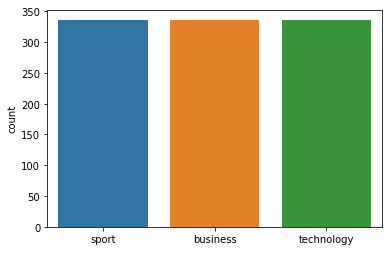



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      0.97      0.97        75
technology
       0.90      0.98      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[64  1  5]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 17
Class Distribution --> Train data (Fold 3 ):


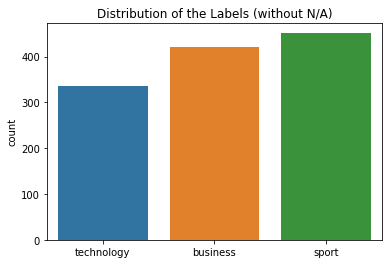

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


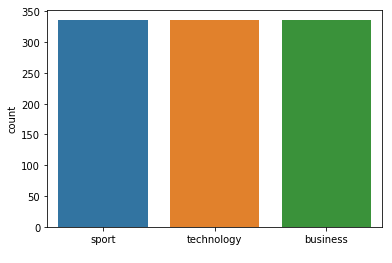



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 17
Class Distribution --> Train data (Fold 4 ):


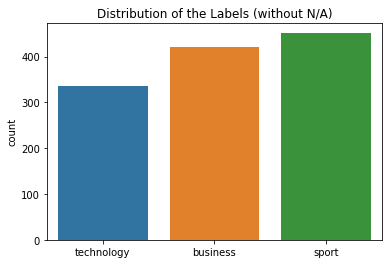

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


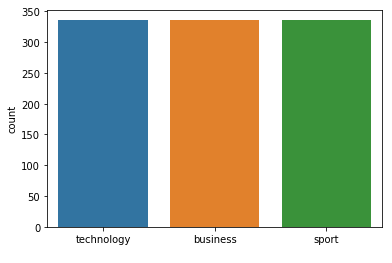



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       1.00      0.96      0.98        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 3 72  0]
 [ 2  0 54]]
FOLD 5 Number of neighbors 17
Class Distribution --> Train data (Fold 5 ):


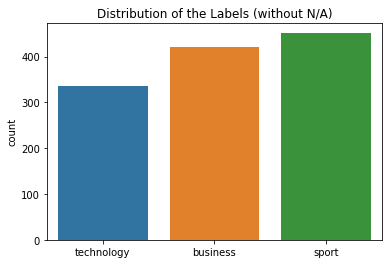

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


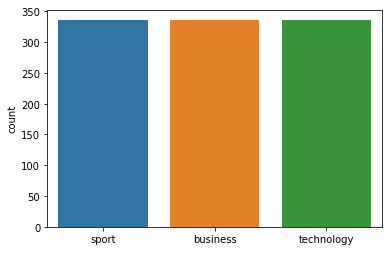



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.99      0.99      0.99        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[64  1  5]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 17
Class Distribution --> Train data (Fold 6 ):


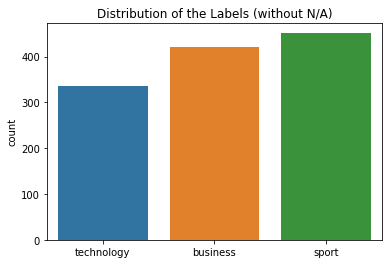

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


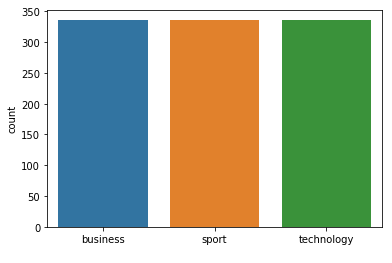



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.89      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.90      0.95      0.92        56

avg / total       0.95      0.95      0.94       201

Confusion Matrix (Fold 6 ):
[[62  2  6]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 17
Class Distribution --> Train data (Fold 7 ):


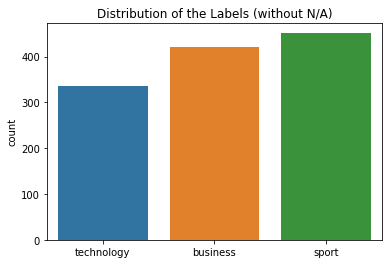

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


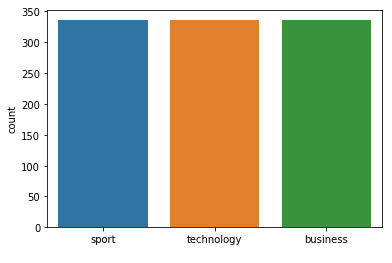



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 17  neighbours): 96.09% (+/- 1.34%)
FOLD 1 Number of neighbors 19
Class Distribution --> Train data (Fold 1 ):


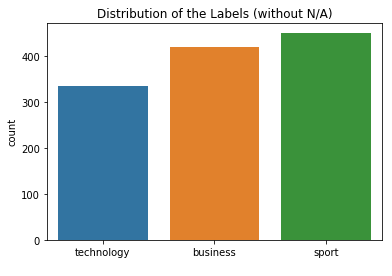

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


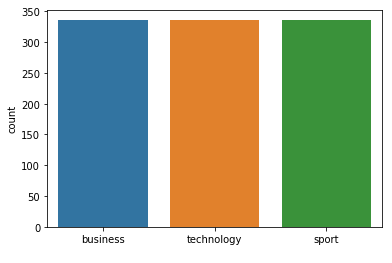



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.92      1.00      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 19
Class Distribution --> Train data (Fold 2 ):


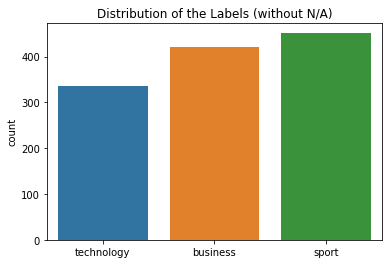

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


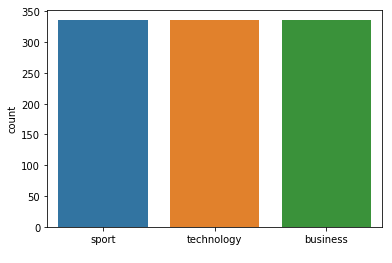



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[65  1  4]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 19
Class Distribution --> Train data (Fold 3 ):


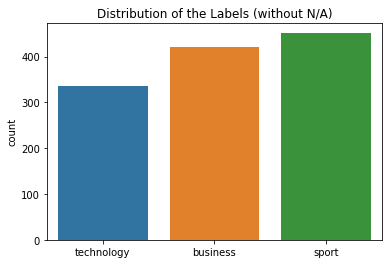

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


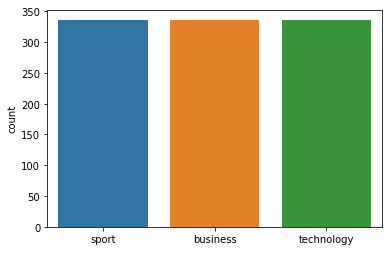



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 19
Class Distribution --> Train data (Fold 4 ):


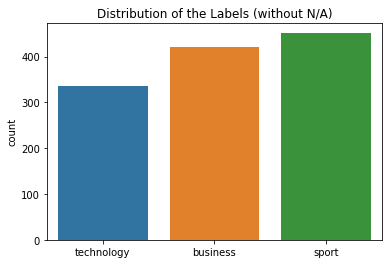

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


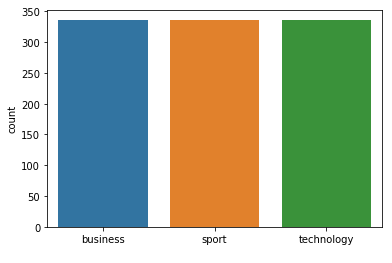



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 19
Class Distribution --> Train data (Fold 5 ):


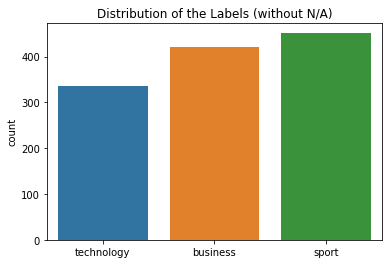

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


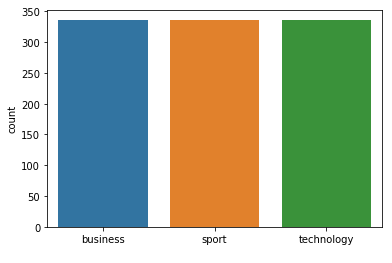



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.99      0.99      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 5 ):
[[64  1  5]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 19
Class Distribution --> Train data (Fold 6 ):


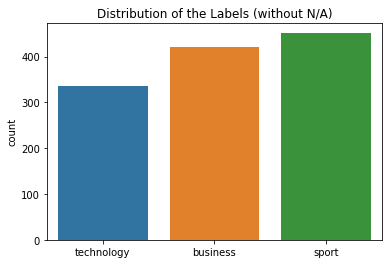

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


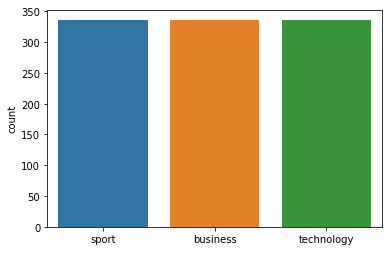



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.93      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 7 Number of neighbors 19
Class Distribution --> Train data (Fold 7 ):


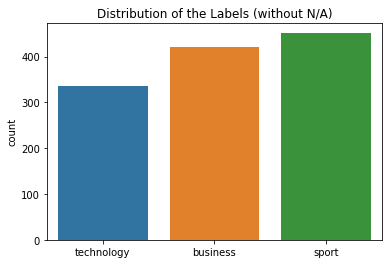

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


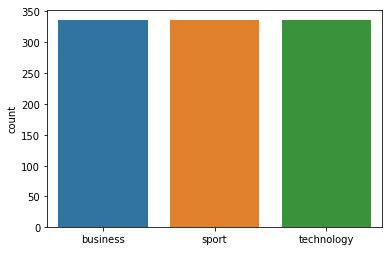



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 19  neighbours): 96.15% (+/- 1.31%)
FOLD 1 Number of neighbors 21
Class Distribution --> Train data (Fold 1 ):


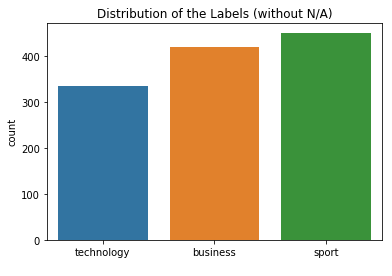

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


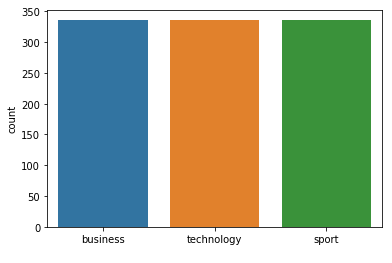



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       1.00      1.00      1.00        76
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 21
Class Distribution --> Train data (Fold 2 ):


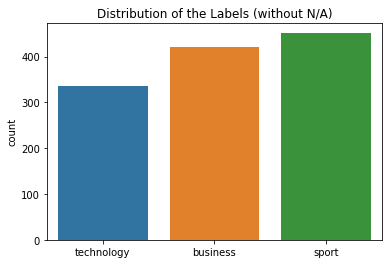

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


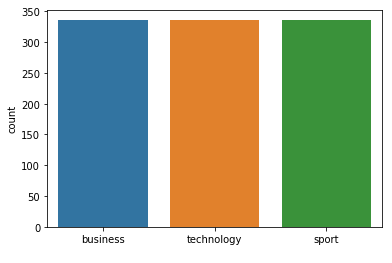



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[65  1  4]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 21
Class Distribution --> Train data (Fold 3 ):


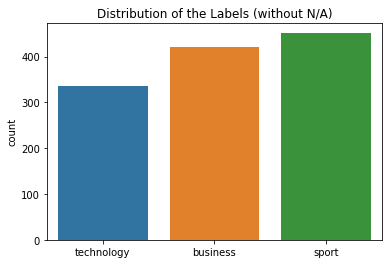

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


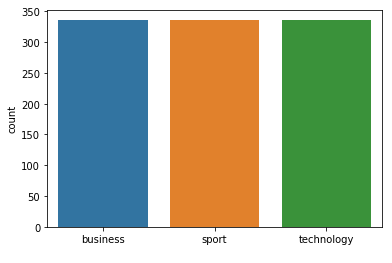



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 21
Class Distribution --> Train data (Fold 4 ):


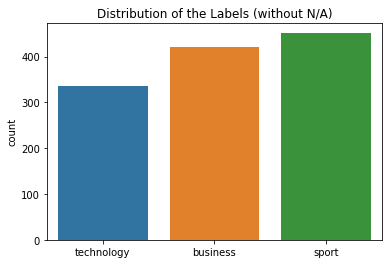

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


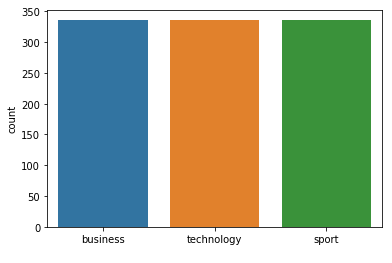



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 21
Class Distribution --> Train data (Fold 5 ):


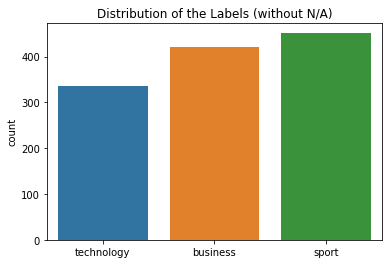

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


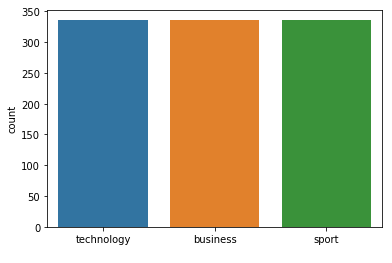



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 21
Class Distribution --> Train data (Fold 6 ):


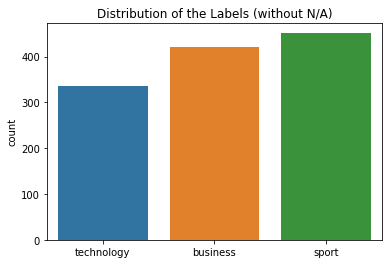

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


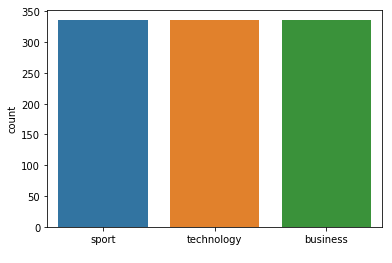



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.93      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 7 Number of neighbors 21
Class Distribution --> Train data (Fold 7 ):


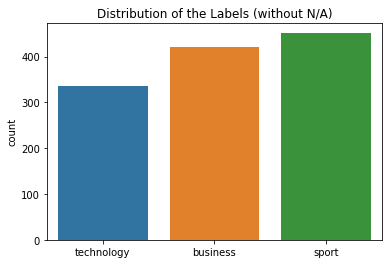

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


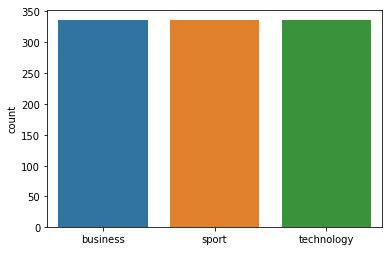



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 21  neighbours): 96.21% (+/- 1.32%)
FOLD 1 Number of neighbors 23
Class Distribution --> Train data (Fold 1 ):


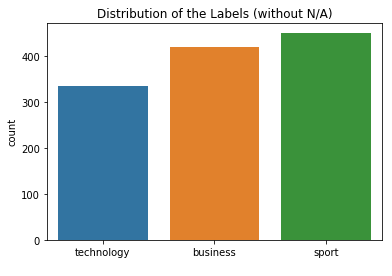

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


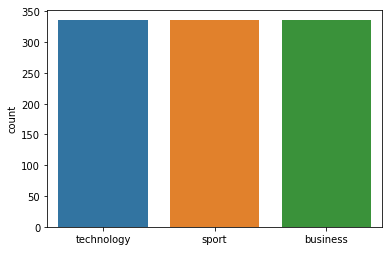



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        71
     sport
       1.00      0.99      0.99        76
technology
       0.90      1.00      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 75  1]
 [ 0  0 56]]
FOLD 2 Number of neighbors 23
Class Distribution --> Train data (Fold 2 ):


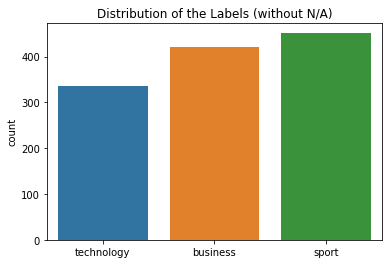

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


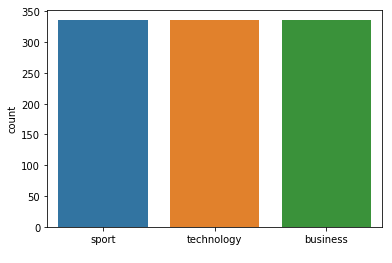



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[65  1  4]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 23
Class Distribution --> Train data (Fold 3 ):


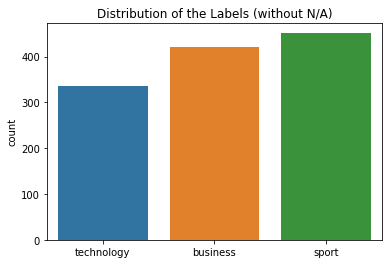

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


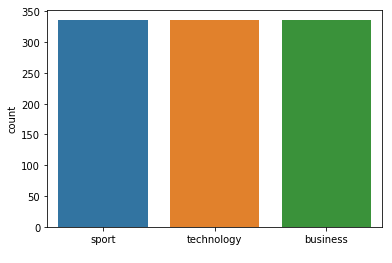



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 23
Class Distribution --> Train data (Fold 4 ):


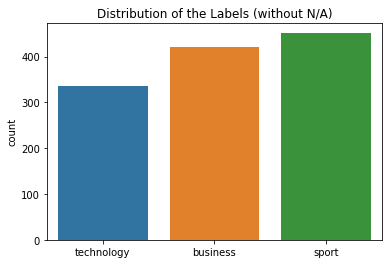

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


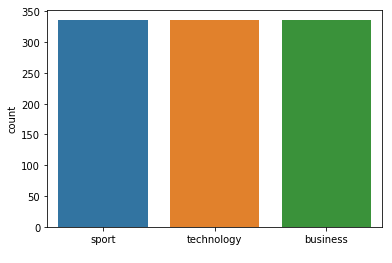



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 23
Class Distribution --> Train data (Fold 5 ):


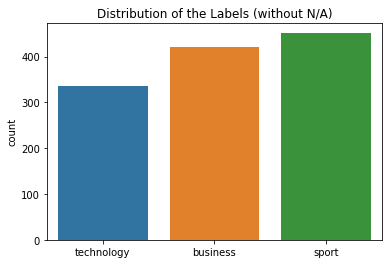

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


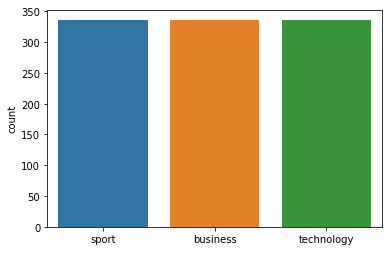



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.94      0.93      0.94        70
     sport
       0.99      0.97      0.98        75
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 2 73  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 23
Class Distribution --> Train data (Fold 6 ):


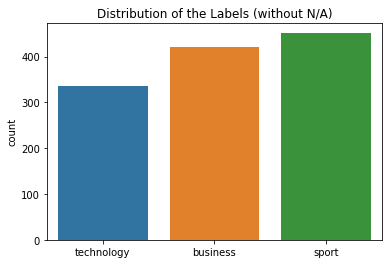

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


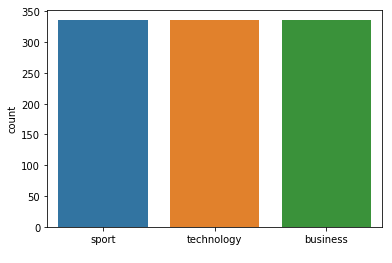



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.96      0.91      0.93        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.93      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 3  1 52]]
FOLD 7 Number of neighbors 23
Class Distribution --> Train data (Fold 7 ):


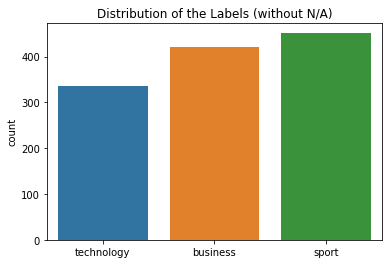

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


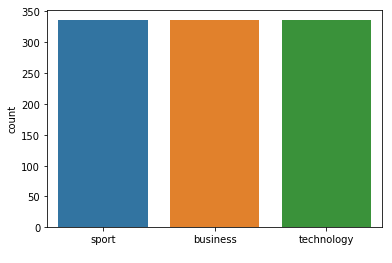



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.93      0.96      0.95        55

avg / total       0.97      0.96      0.97       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 23  neighbours): 96.24% (+/- 1.29%)
FOLD 1 Number of neighbors 25
Class Distribution --> Train data (Fold 1 ):


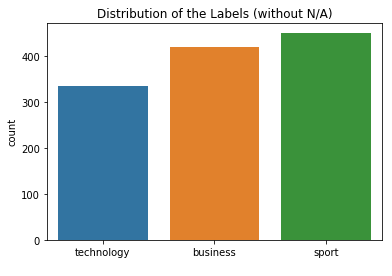

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


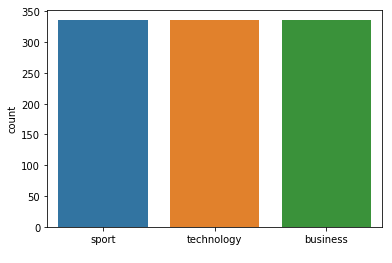



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.92      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.90      1.00      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[65  0  6]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 25
Class Distribution --> Train data (Fold 2 ):


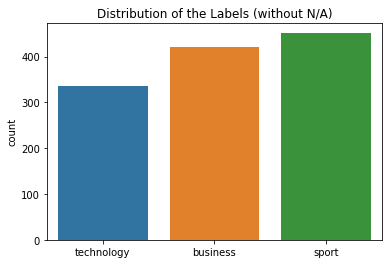

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


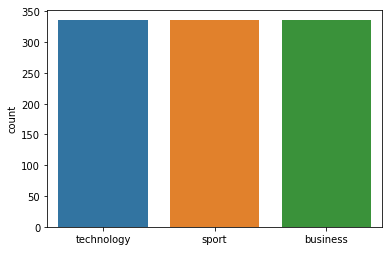



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  1  3]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 25
Class Distribution --> Train data (Fold 3 ):


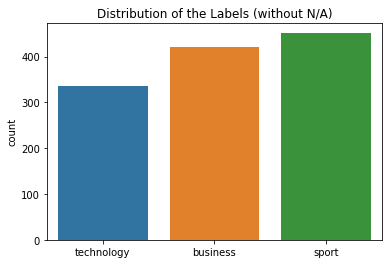

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


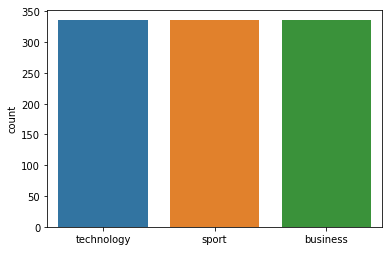



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 25
Class Distribution --> Train data (Fold 4 ):


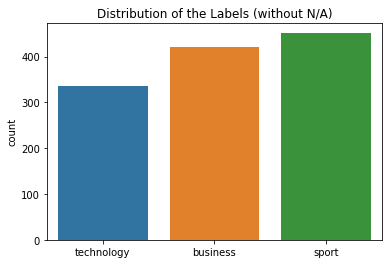

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


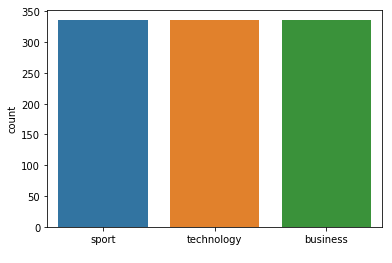



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 25
Class Distribution --> Train data (Fold 5 ):


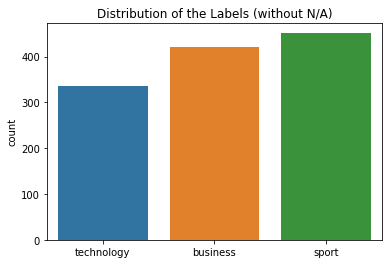

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


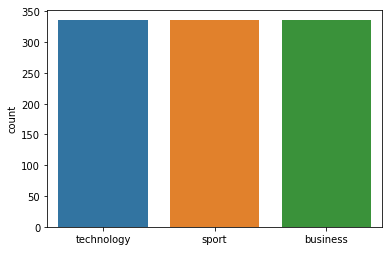



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      0.97      0.98        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 25
Class Distribution --> Train data (Fold 6 ):


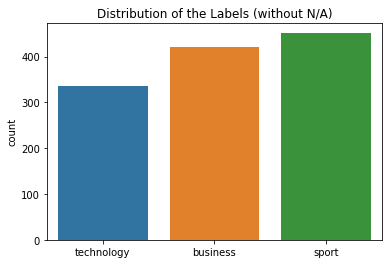

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


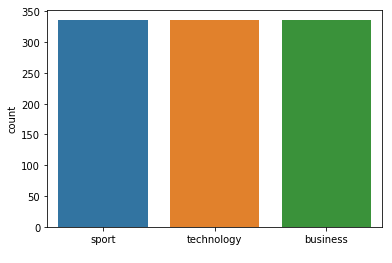



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.96      0.91      0.93        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.93      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 3  1 52]]
FOLD 7 Number of neighbors 25
Class Distribution --> Train data (Fold 7 ):


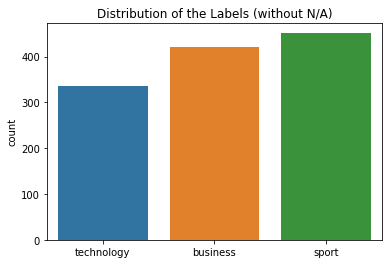

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


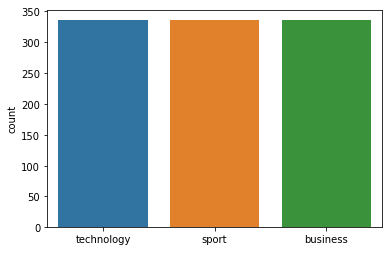



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.98      0.96        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 25  neighbours): 96.26% (+/- 1.26%)
FOLD 1 Number of neighbors 27
Class Distribution --> Train data (Fold 1 ):


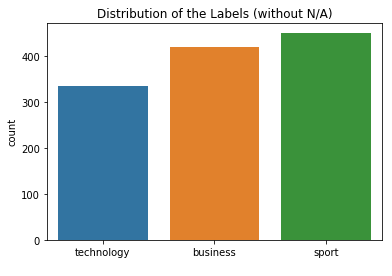

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


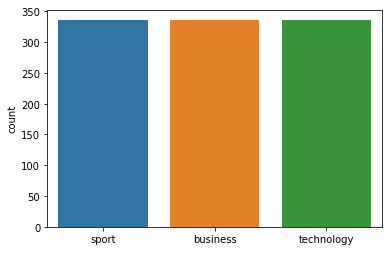



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.92      1.00      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 27
Class Distribution --> Train data (Fold 2 ):


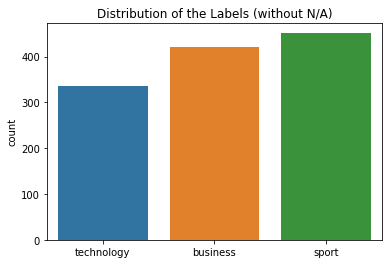

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


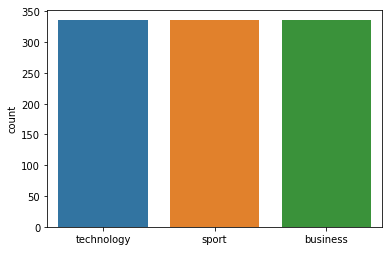



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  1  3]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 27
Class Distribution --> Train data (Fold 3 ):


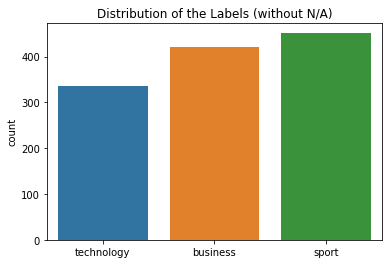

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


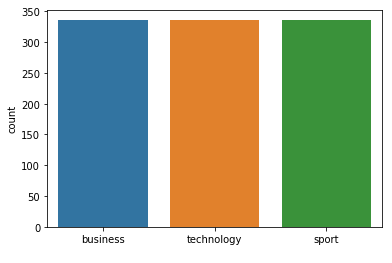



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 27
Class Distribution --> Train data (Fold 4 ):


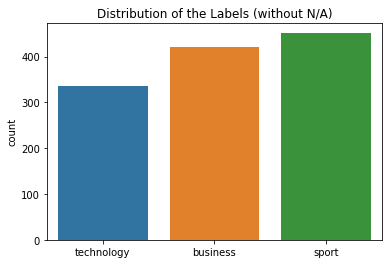

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


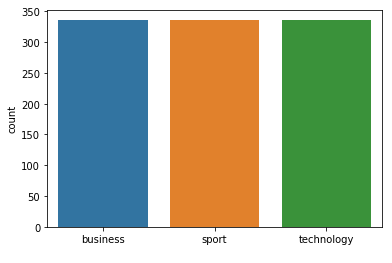



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 27
Class Distribution --> Train data (Fold 5 ):


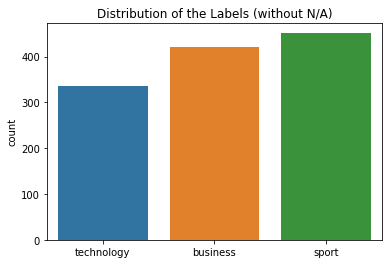

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


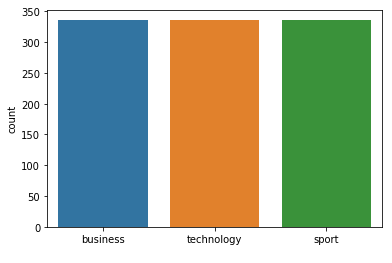



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 27
Class Distribution --> Train data (Fold 6 ):


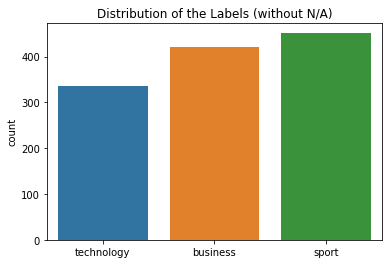

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


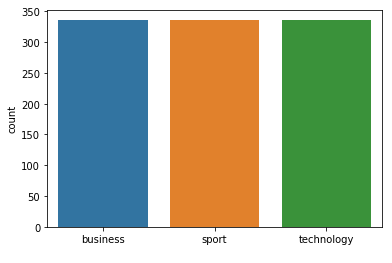



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.95      1.00      0.97        75
technology
       0.91      0.93      0.92        56

avg / total       0.95      0.95      0.94       201

Confusion Matrix (Fold 6 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 7 Number of neighbors 27
Class Distribution --> Train data (Fold 7 ):


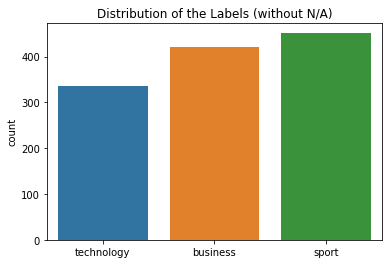

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


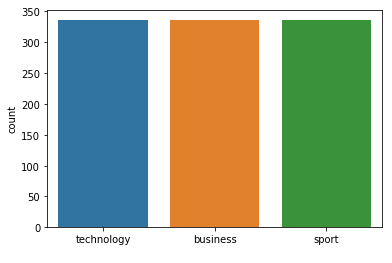



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 27  neighbours): 96.29% (+/- 1.24%)
FOLD 1 Number of neighbors 29
Class Distribution --> Train data (Fold 1 ):


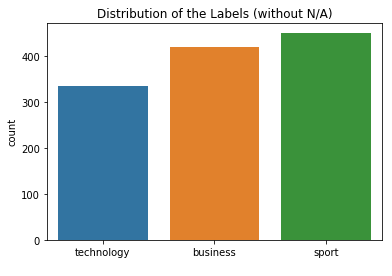

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


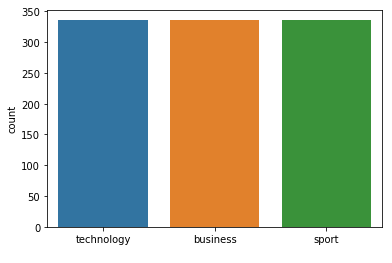



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.92      1.00      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 29
Class Distribution --> Train data (Fold 2 ):


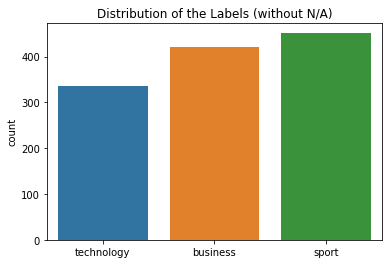

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


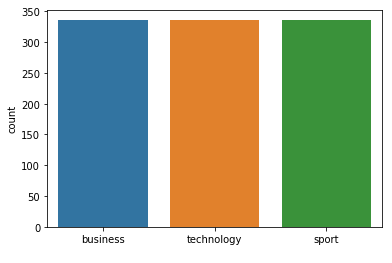



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  1  3]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 29
Class Distribution --> Train data (Fold 3 ):


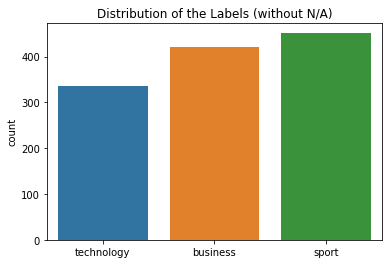

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


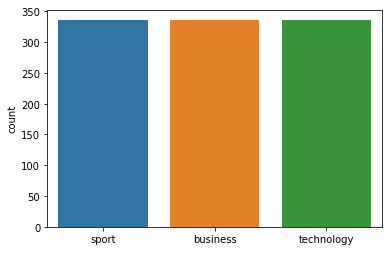



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 29
Class Distribution --> Train data (Fold 4 ):


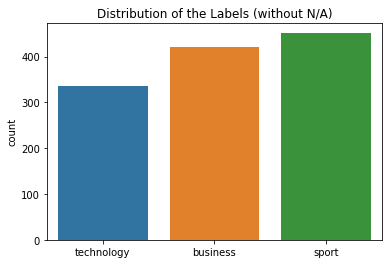

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


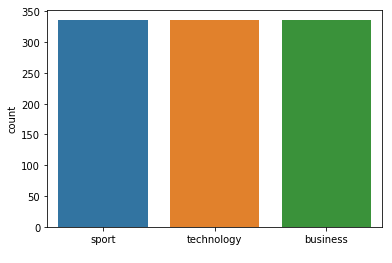



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 29
Class Distribution --> Train data (Fold 5 ):


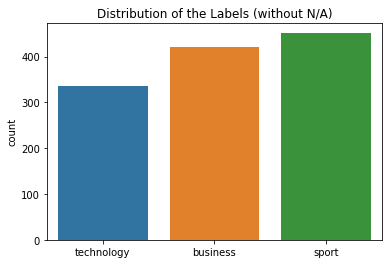

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


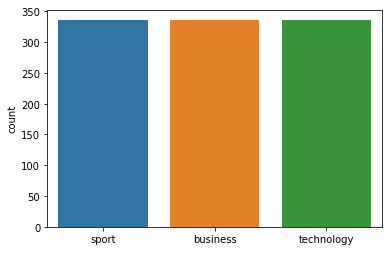



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 2 73  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 29
Class Distribution --> Train data (Fold 6 ):


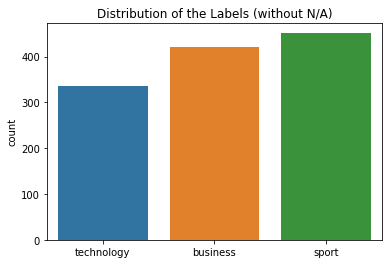

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


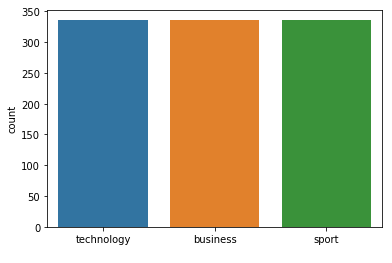



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 6 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 29
Class Distribution --> Train data (Fold 7 ):


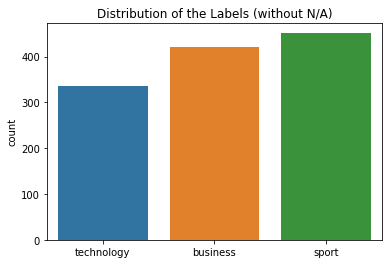

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


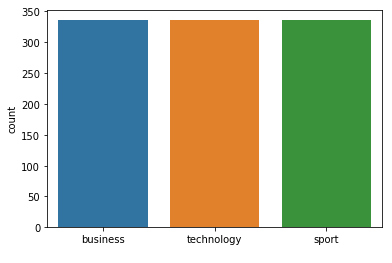



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 29  neighbours): 96.32% (+/- 1.23%)
FOLD 1 Number of neighbors 31
Class Distribution --> Train data (Fold 1 ):


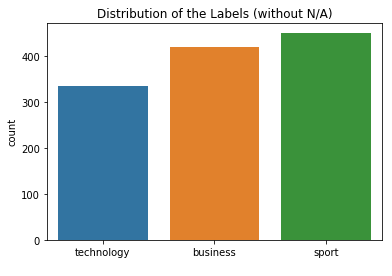

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


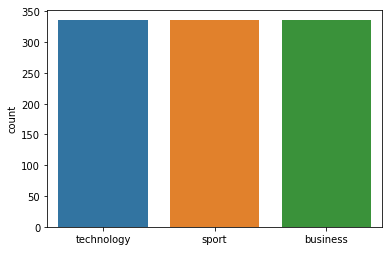



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.92      1.00      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 31
Class Distribution --> Train data (Fold 2 ):


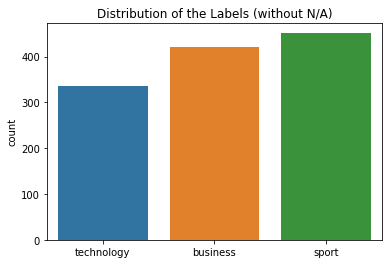

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


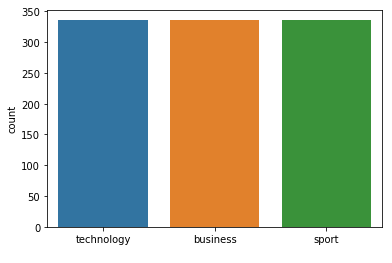



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 31
Class Distribution --> Train data (Fold 3 ):


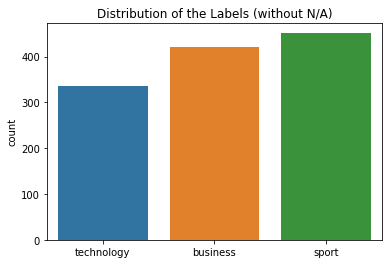

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


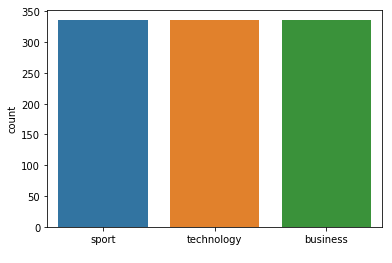



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 31
Class Distribution --> Train data (Fold 4 ):


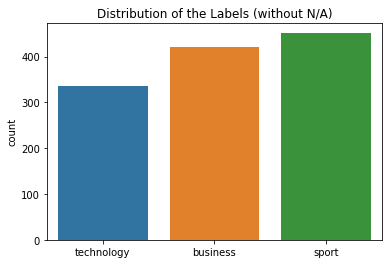

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


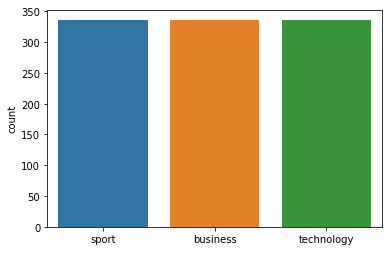



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 5 Number of neighbors 31
Class Distribution --> Train data (Fold 5 ):


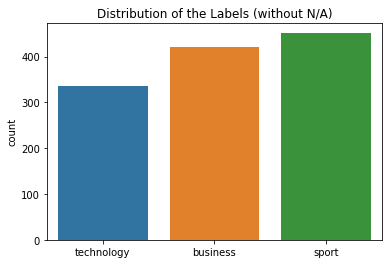

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


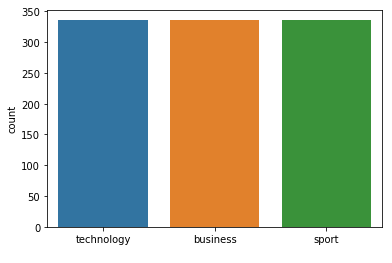



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 31
Class Distribution --> Train data (Fold 6 ):


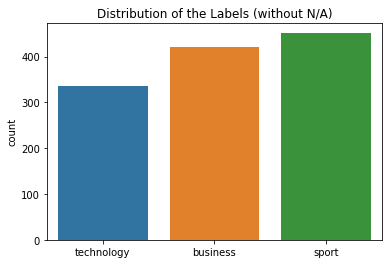

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


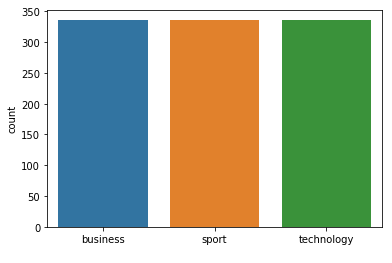



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.89      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 6 ):
[[62  3  5]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 31
Class Distribution --> Train data (Fold 7 ):


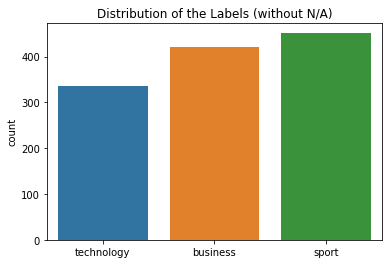

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


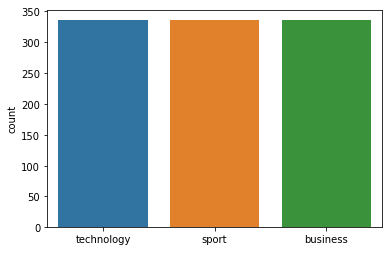



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 31  neighbours): 96.35% (+/- 1.21%)
FOLD 1 Number of neighbors 33
Class Distribution --> Train data (Fold 1 ):


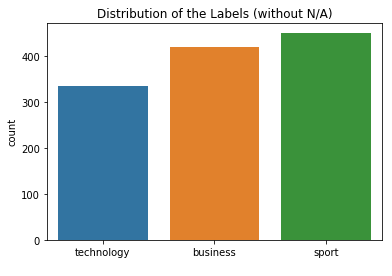

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


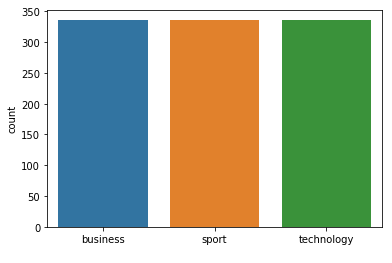



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        71
     sport
       1.00      1.00      1.00        76
technology
       0.92      1.00      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[66  0  5]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 33
Class Distribution --> Train data (Fold 2 ):


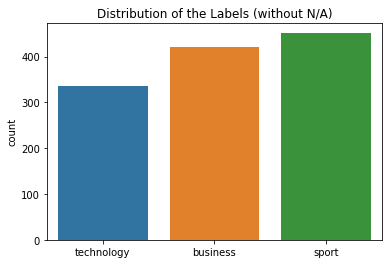

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


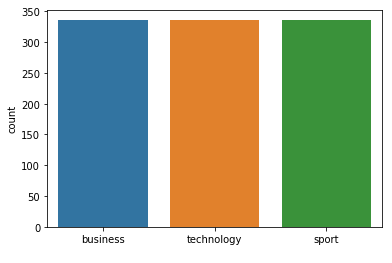



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 33
Class Distribution --> Train data (Fold 3 ):


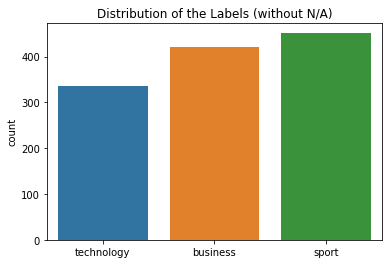

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


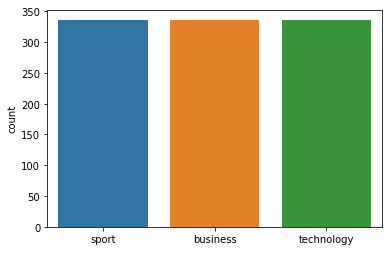



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 33
Class Distribution --> Train data (Fold 4 ):


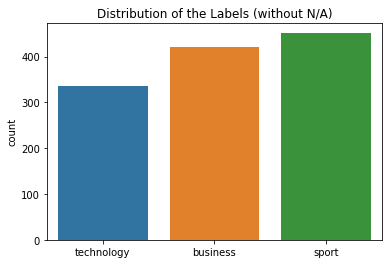

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


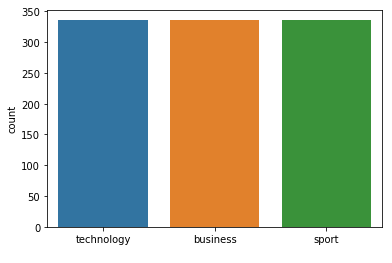



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 33
Class Distribution --> Train data (Fold 5 ):


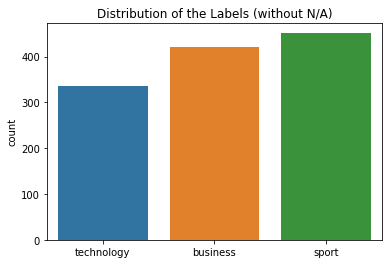

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


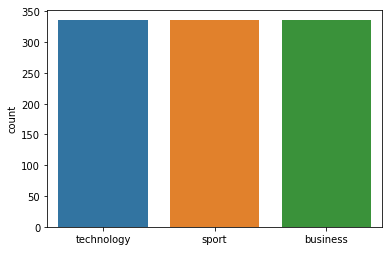



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 33
Class Distribution --> Train data (Fold 6 ):


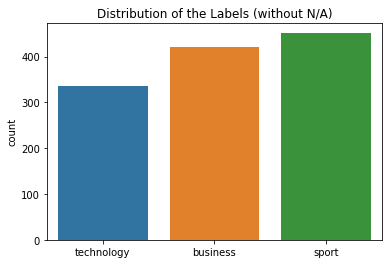

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


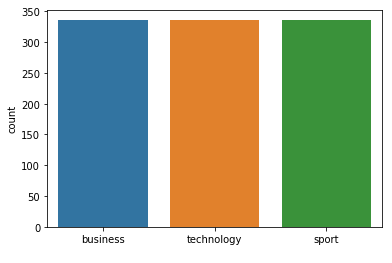



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.89      0.93        70
     sport
       0.95      1.00      0.97        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.94       201

Confusion Matrix (Fold 6 ):
[[62  3  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 33
Class Distribution --> Train data (Fold 7 ):


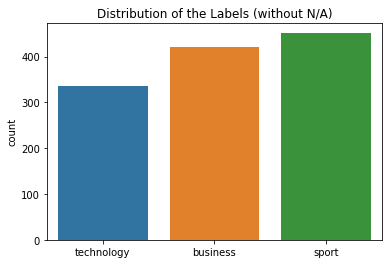

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


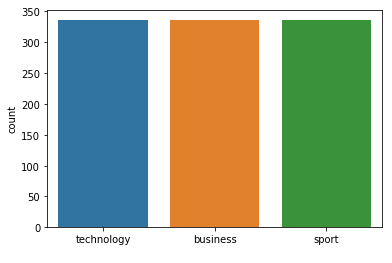



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 33  neighbours): 96.39% (+/- 1.21%)
FOLD 1 Number of neighbors 35
Class Distribution --> Train data (Fold 1 ):


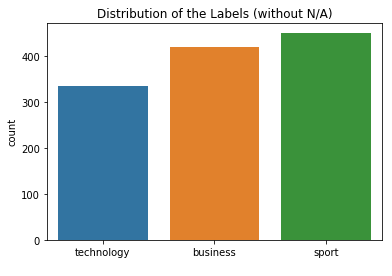

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


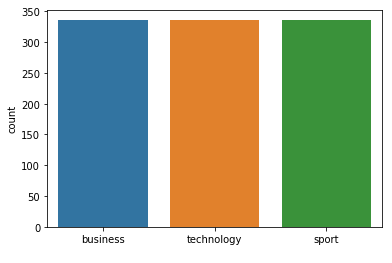



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 35
Class Distribution --> Train data (Fold 2 ):


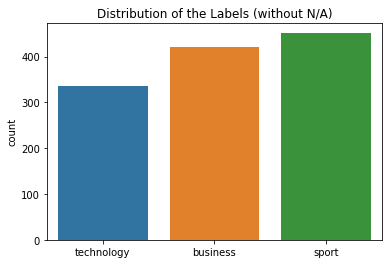

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


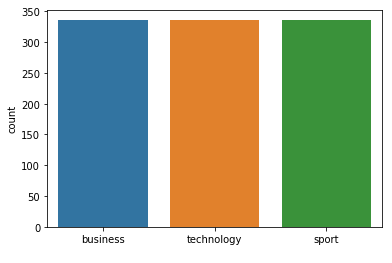



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.96      0.97        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 72  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 35
Class Distribution --> Train data (Fold 3 ):


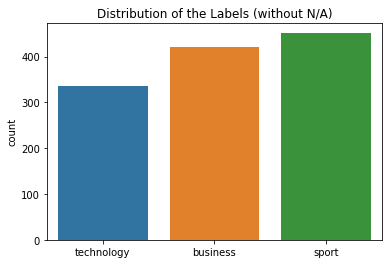

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


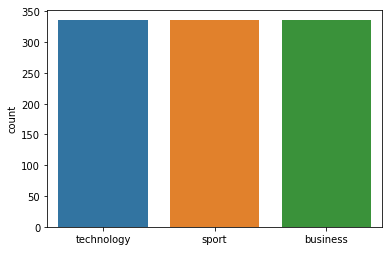



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 35
Class Distribution --> Train data (Fold 4 ):


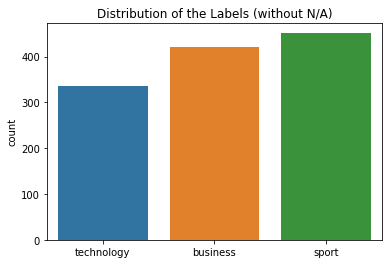

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


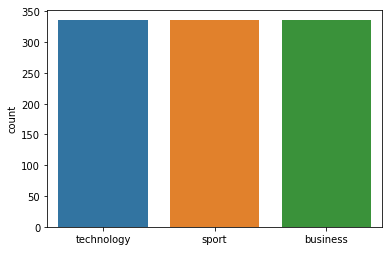



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 35
Class Distribution --> Train data (Fold 5 ):


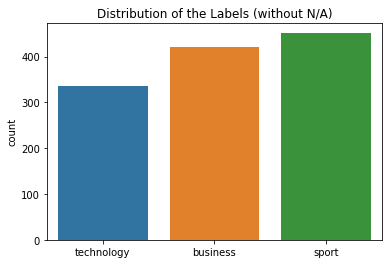

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


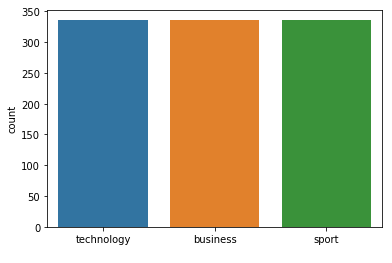



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 35
Class Distribution --> Train data (Fold 6 ):


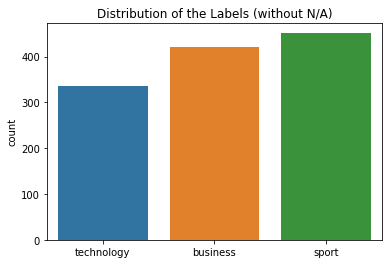

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


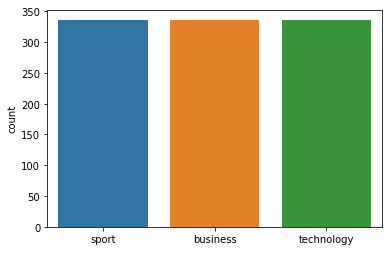



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 35
Class Distribution --> Train data (Fold 7 ):


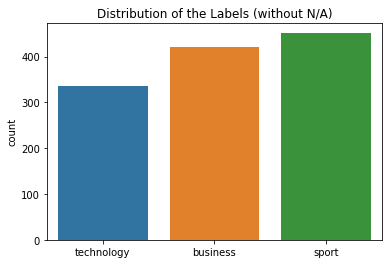

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


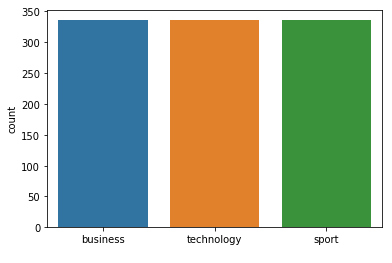



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 35  neighbours): 96.43% (+/- 1.20%)
FOLD 1 Number of neighbors 37
Class Distribution --> Train data (Fold 1 ):


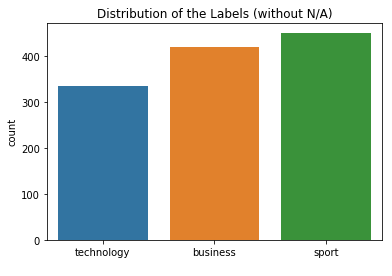

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


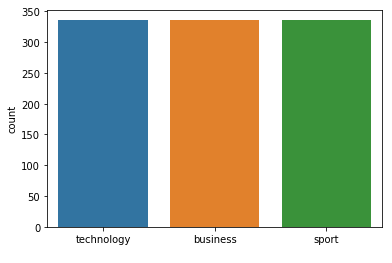



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 37
Class Distribution --> Train data (Fold 2 ):


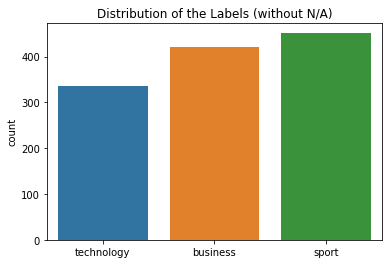

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


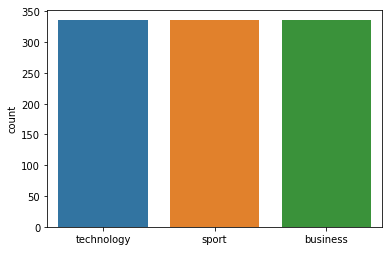



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 37
Class Distribution --> Train data (Fold 3 ):


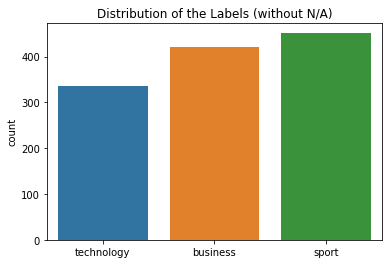

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


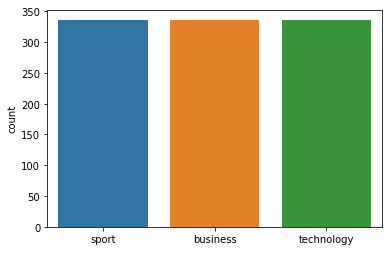



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 37
Class Distribution --> Train data (Fold 4 ):


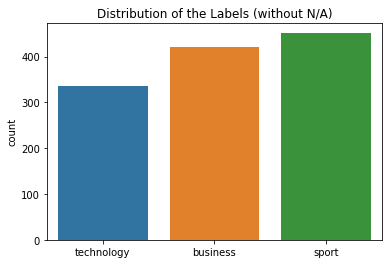

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


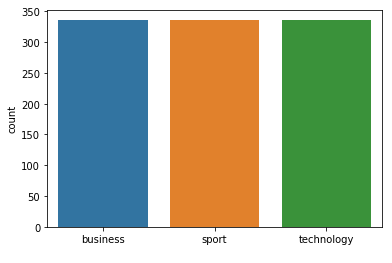



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 37
Class Distribution --> Train data (Fold 5 ):


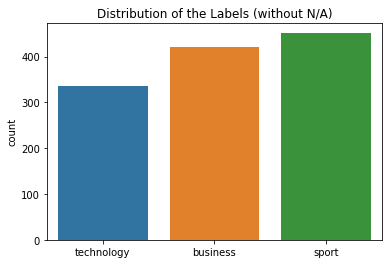

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


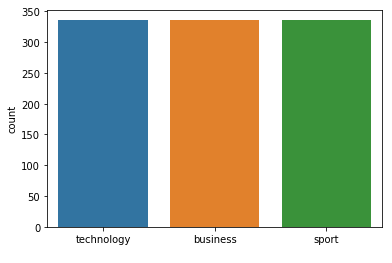



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 37
Class Distribution --> Train data (Fold 6 ):


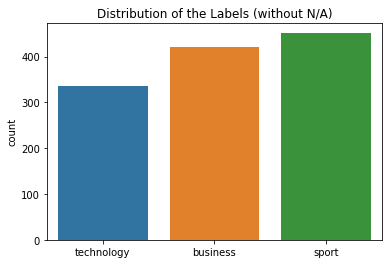

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


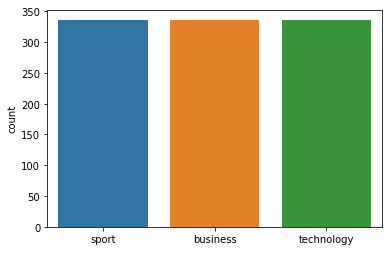



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 37
Class Distribution --> Train data (Fold 7 ):


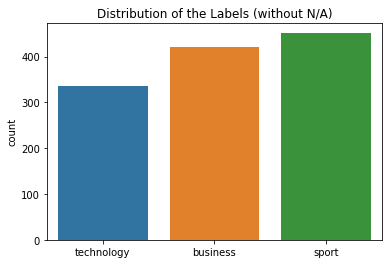

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


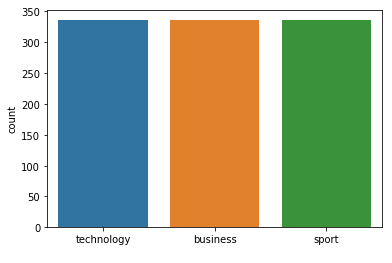



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.95      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 37  neighbours): 96.45% (+/- 1.19%)
FOLD 1 Number of neighbors 39
Class Distribution --> Train data (Fold 1 ):


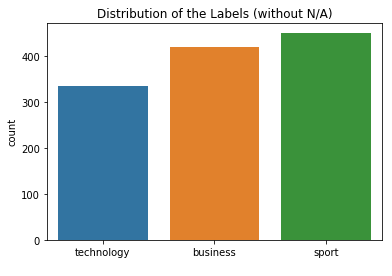

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


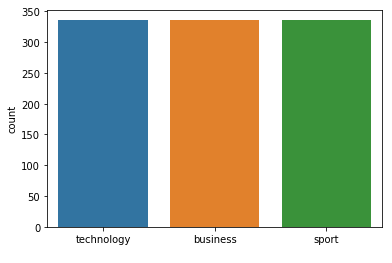



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 39
Class Distribution --> Train data (Fold 2 ):


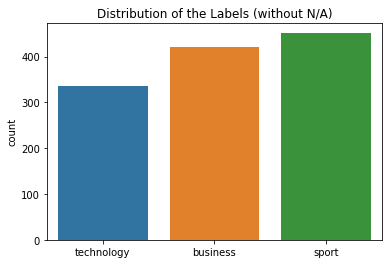

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


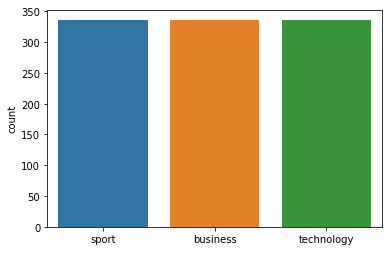



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 39
Class Distribution --> Train data (Fold 3 ):


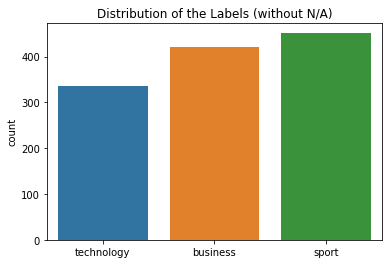

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


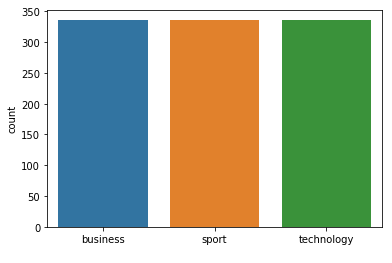



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 39
Class Distribution --> Train data (Fold 4 ):


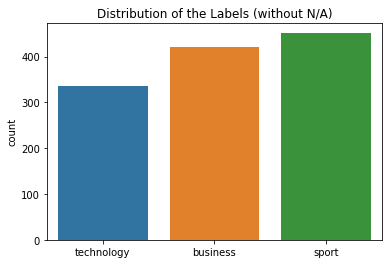

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


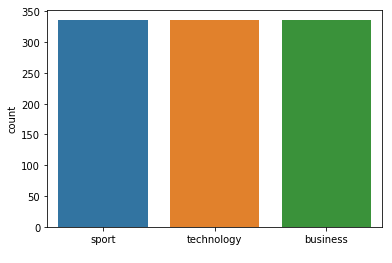



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 39
Class Distribution --> Train data (Fold 5 ):


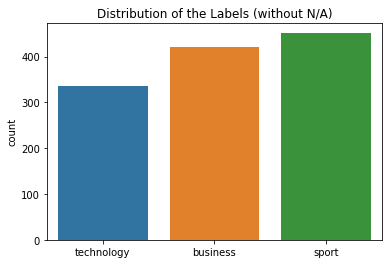

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


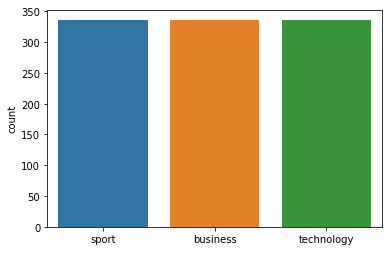



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 39
Class Distribution --> Train data (Fold 6 ):


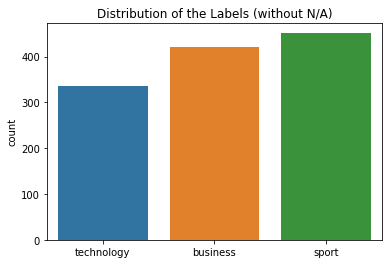

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


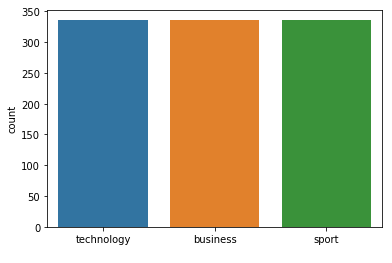



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[64  1  5]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 39
Class Distribution --> Train data (Fold 7 ):


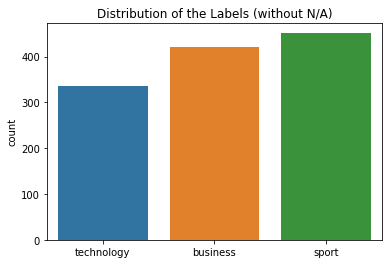

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


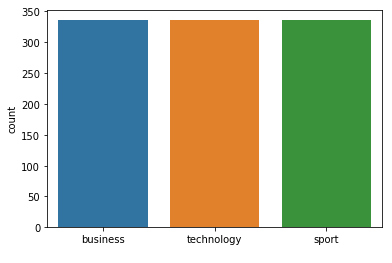



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 39  neighbours): 96.49% (+/- 1.19%)
FOLD 1 Number of neighbors 41
Class Distribution --> Train data (Fold 1 ):


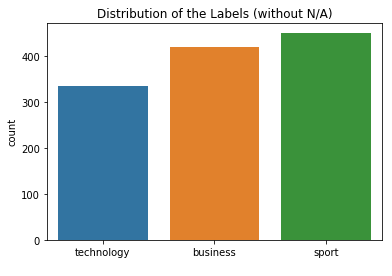

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


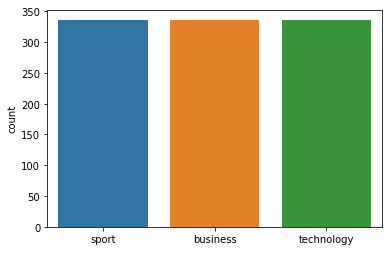



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 41
Class Distribution --> Train data (Fold 2 ):


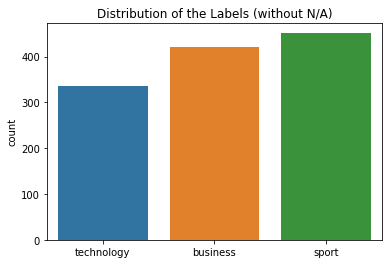

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


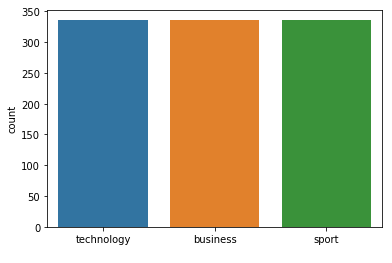



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 41
Class Distribution --> Train data (Fold 3 ):


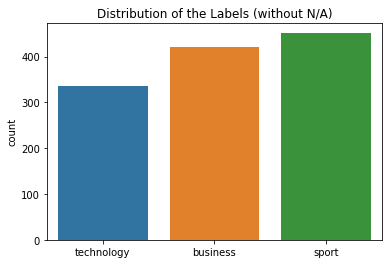

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


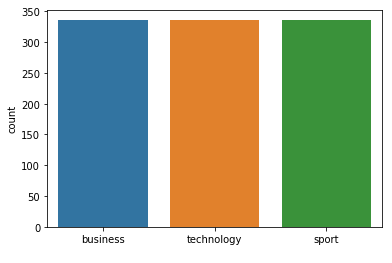



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 41
Class Distribution --> Train data (Fold 4 ):


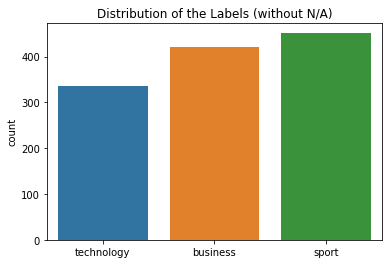

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


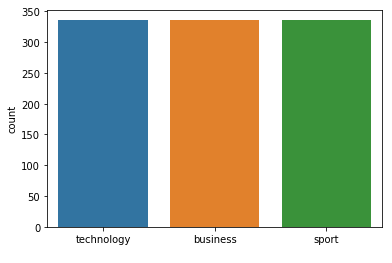



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 41
Class Distribution --> Train data (Fold 5 ):


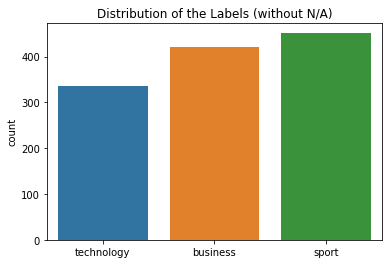

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


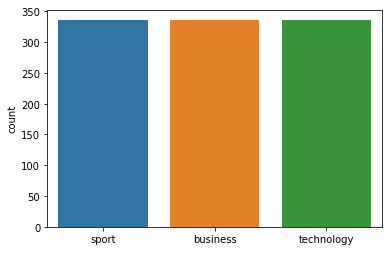



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 41
Class Distribution --> Train data (Fold 6 ):


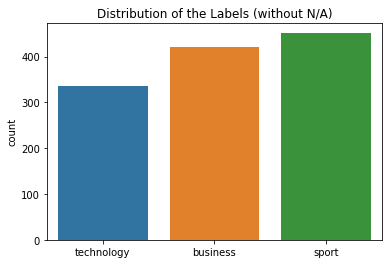

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


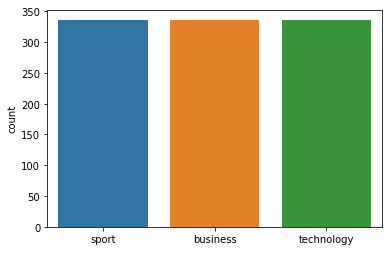



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 6 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 41
Class Distribution --> Train data (Fold 7 ):


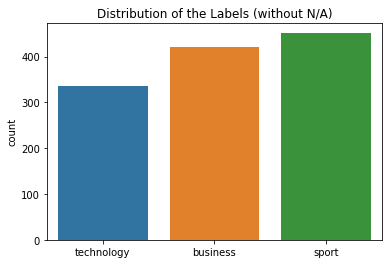

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


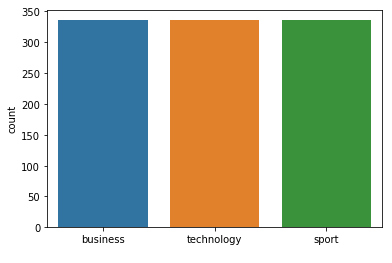



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 41  neighbours): 96.52% (+/- 1.19%)
FOLD 1 Number of neighbors 43
Class Distribution --> Train data (Fold 1 ):


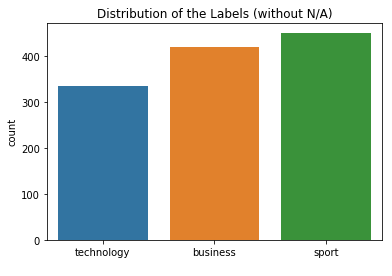

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


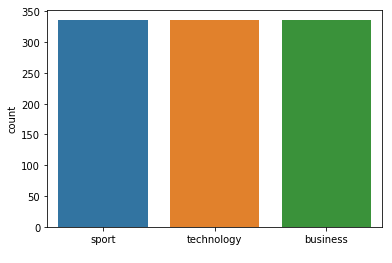



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 43
Class Distribution --> Train data (Fold 2 ):


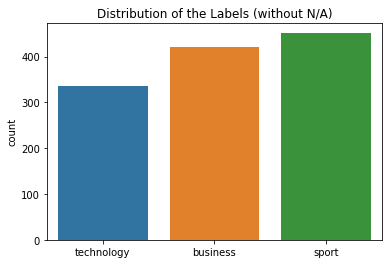

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


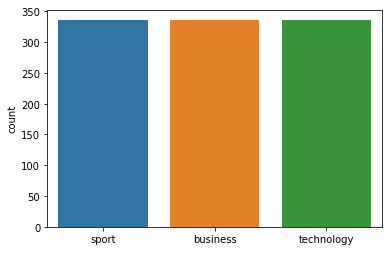



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 43
Class Distribution --> Train data (Fold 3 ):


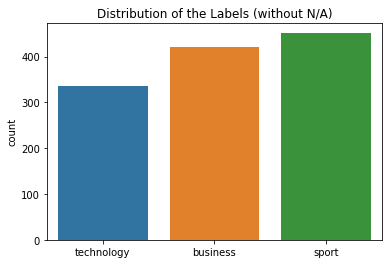

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


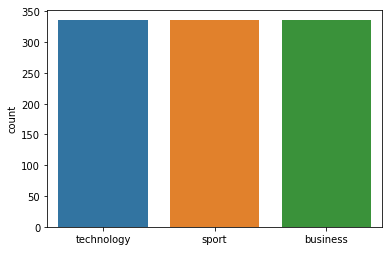



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 43
Class Distribution --> Train data (Fold 4 ):


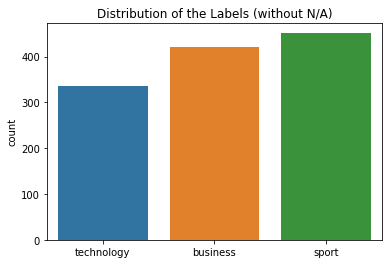

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


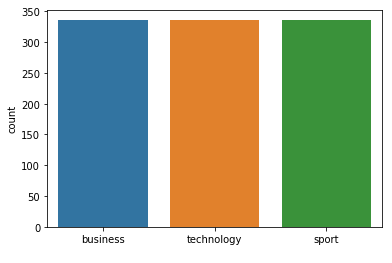



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 43
Class Distribution --> Train data (Fold 5 ):


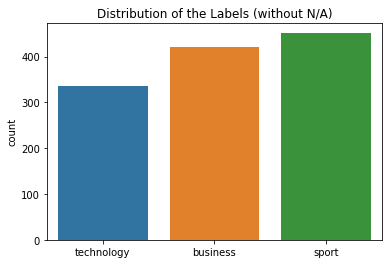

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


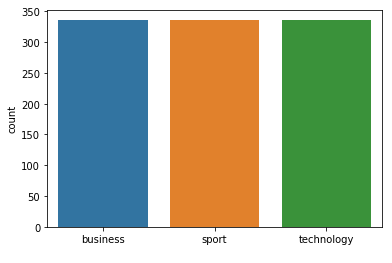



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 43
Class Distribution --> Train data (Fold 6 ):


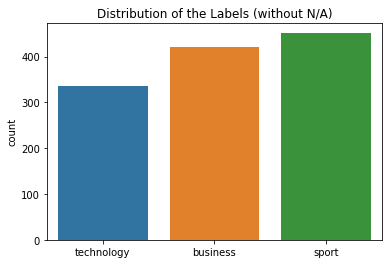

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


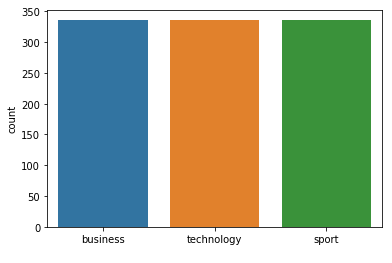



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 43
Class Distribution --> Train data (Fold 7 ):


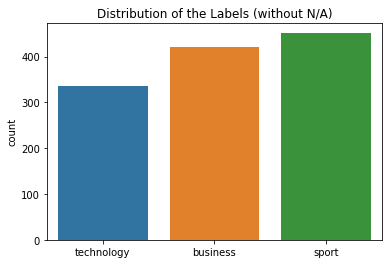

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


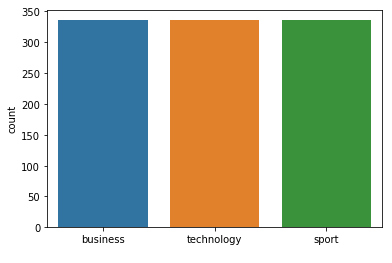



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 43  neighbours): 96.55% (+/- 1.18%)
FOLD 1 Number of neighbors 45
Class Distribution --> Train data (Fold 1 ):


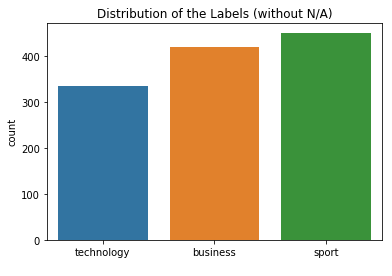

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


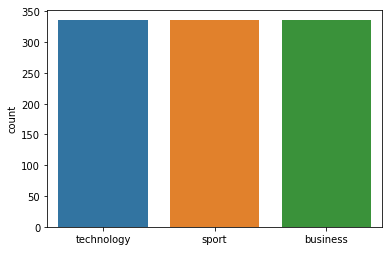



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 45
Class Distribution --> Train data (Fold 2 ):


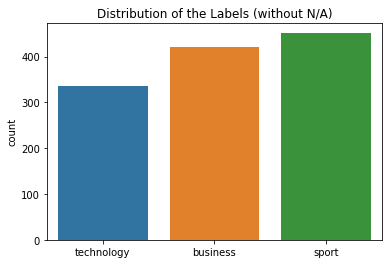

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


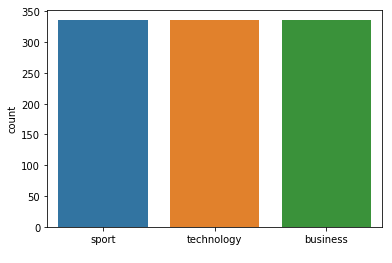



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 45
Class Distribution --> Train data (Fold 3 ):


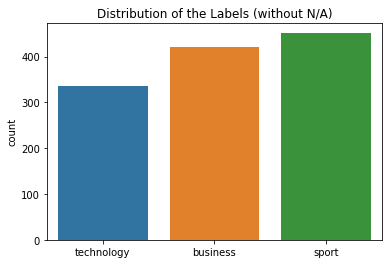

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


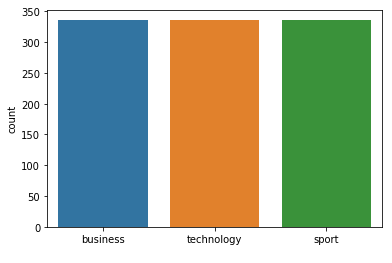



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 45
Class Distribution --> Train data (Fold 4 ):


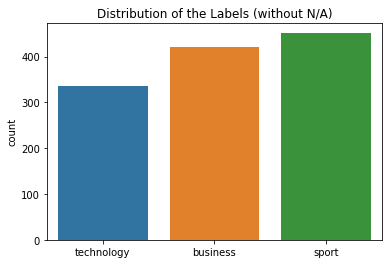

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


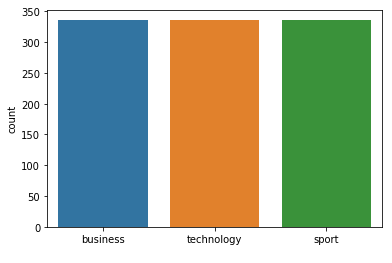



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 45
Class Distribution --> Train data (Fold 5 ):


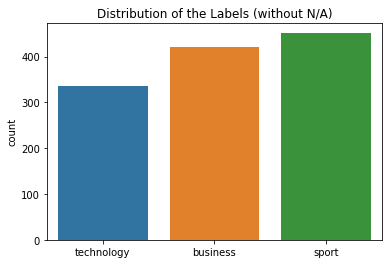

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


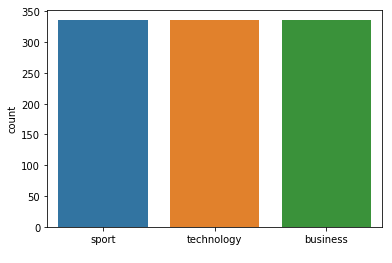



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 45
Class Distribution --> Train data (Fold 6 ):


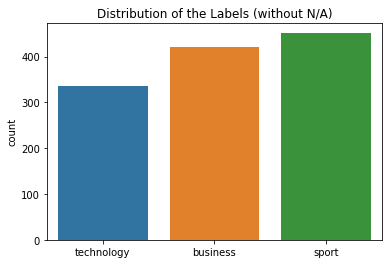

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


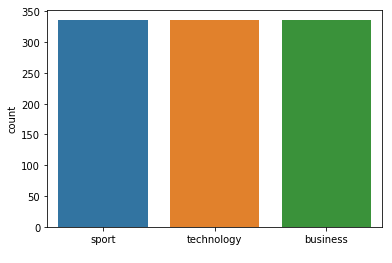



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 45
Class Distribution --> Train data (Fold 7 ):


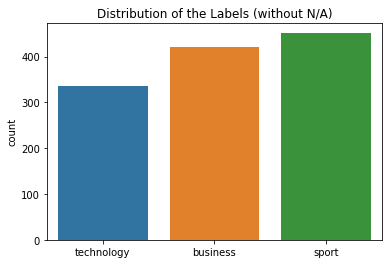

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


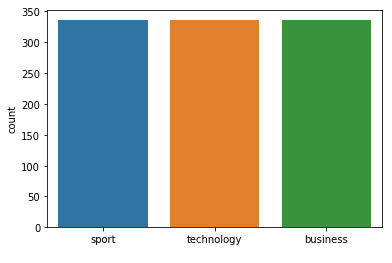



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 45  neighbours): 96.58% (+/- 1.18%)
FOLD 1 Number of neighbors 47
Class Distribution --> Train data (Fold 1 ):


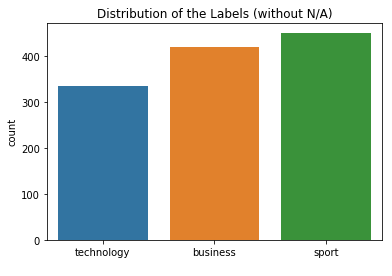

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


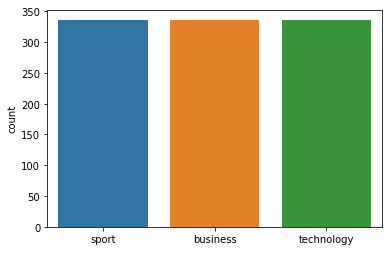



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 47
Class Distribution --> Train data (Fold 2 ):


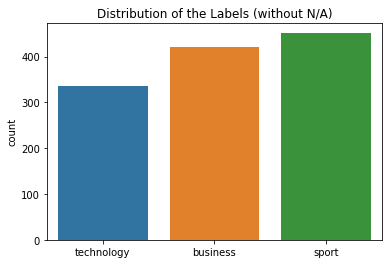

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


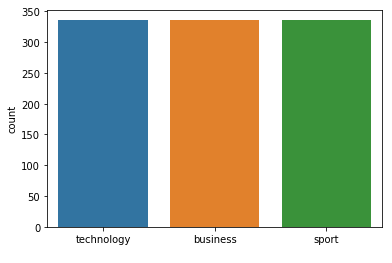



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 47
Class Distribution --> Train data (Fold 3 ):


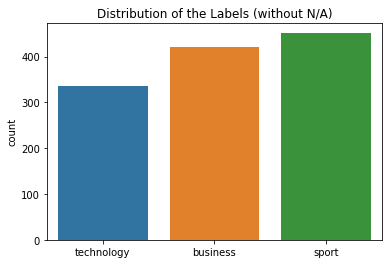

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


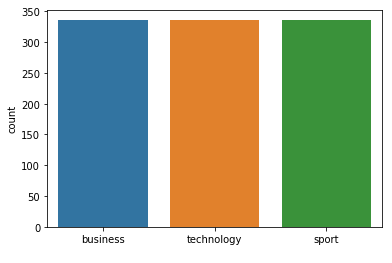



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 47
Class Distribution --> Train data (Fold 4 ):


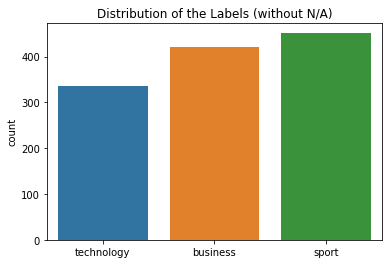

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


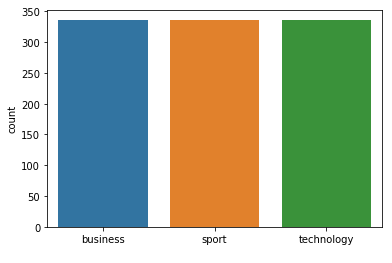



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 47
Class Distribution --> Train data (Fold 5 ):


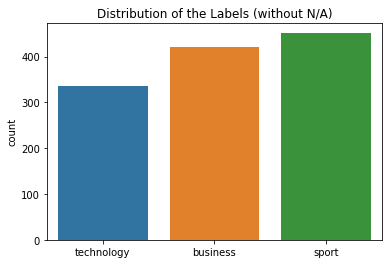

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


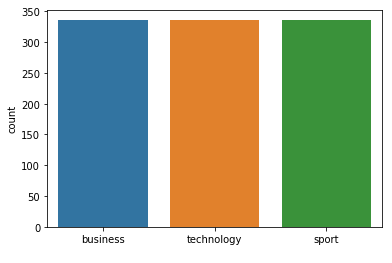



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 47
Class Distribution --> Train data (Fold 6 ):


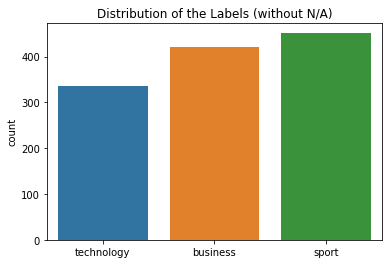

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


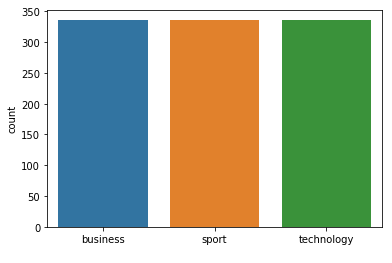



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 47
Class Distribution --> Train data (Fold 7 ):


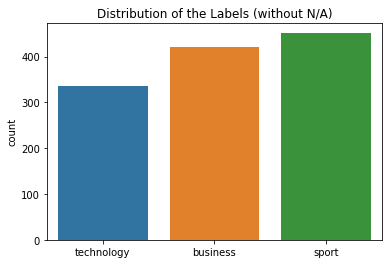

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


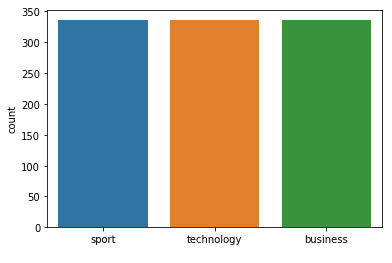



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 47  neighbours): 96.60% (+/- 1.17%)
FOLD 1 Number of neighbors 49
Class Distribution --> Train data (Fold 1 ):


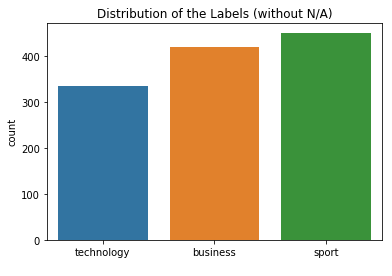

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


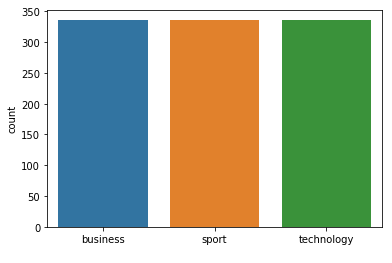



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 49
Class Distribution --> Train data (Fold 2 ):


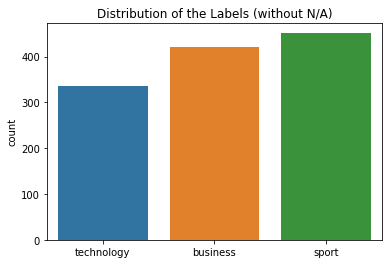

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


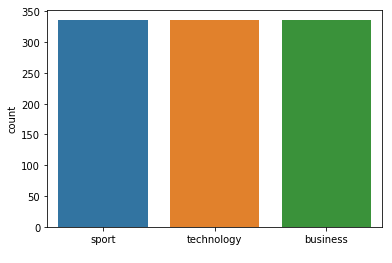



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 49
Class Distribution --> Train data (Fold 3 ):


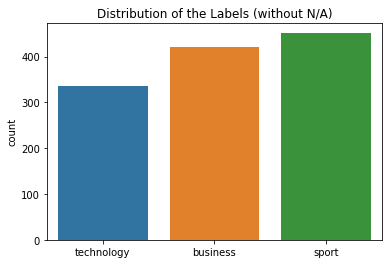

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


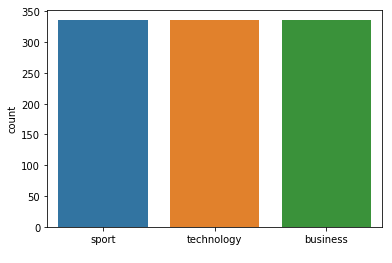



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 49
Class Distribution --> Train data (Fold 4 ):


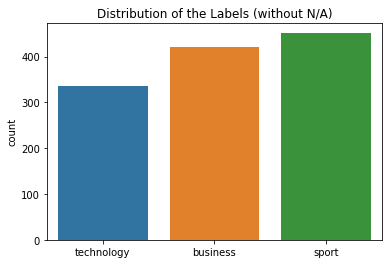

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


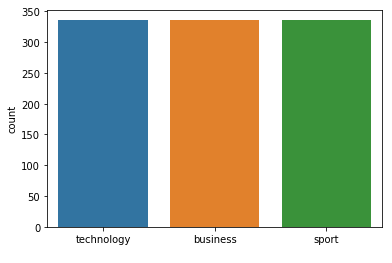



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 49
Class Distribution --> Train data (Fold 5 ):


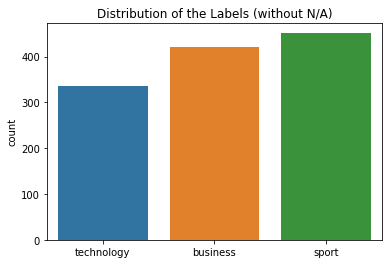

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


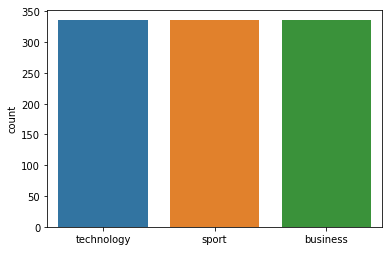



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 49
Class Distribution --> Train data (Fold 6 ):


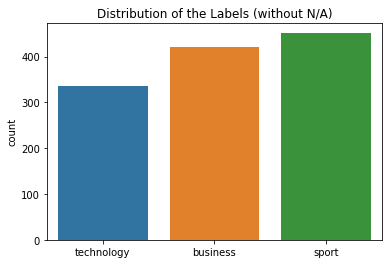

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


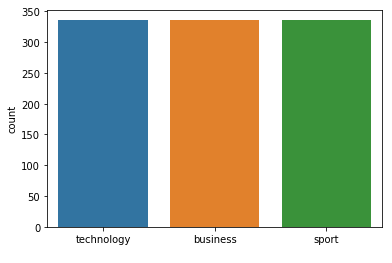



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 49
Class Distribution --> Train data (Fold 7 ):


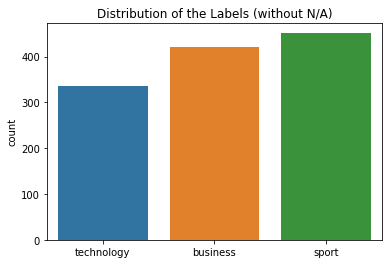

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


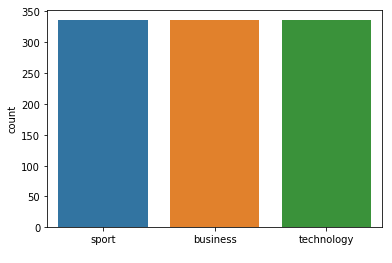



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 49  neighbours): 96.62% (+/- 1.16%)
FOLD 1 Number of neighbors 51
Class Distribution --> Train data (Fold 1 ):


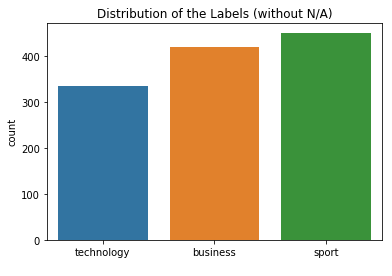

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


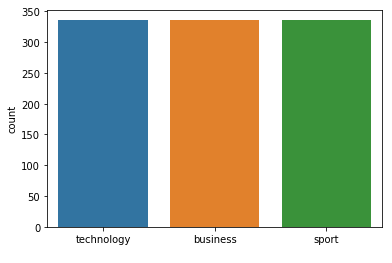



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       1.00      1.00      1.00        76
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 51
Class Distribution --> Train data (Fold 2 ):


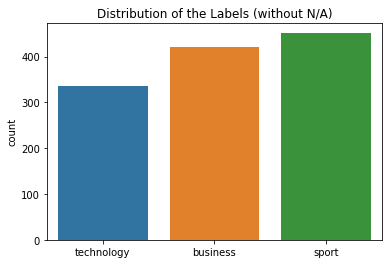

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


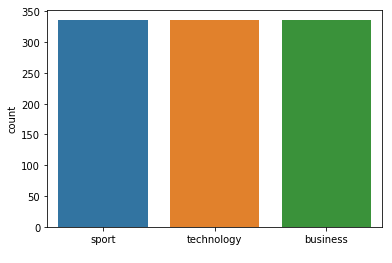



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 3 Number of neighbors 51
Class Distribution --> Train data (Fold 3 ):


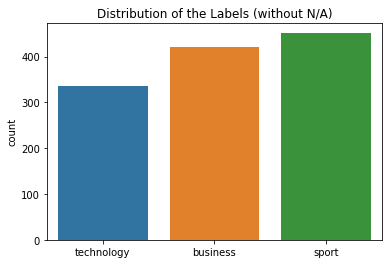

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


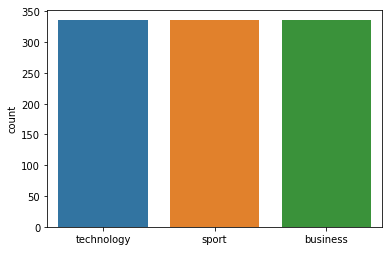



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 51
Class Distribution --> Train data (Fold 4 ):


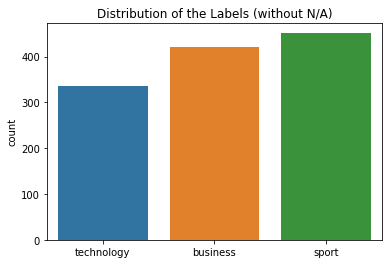

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


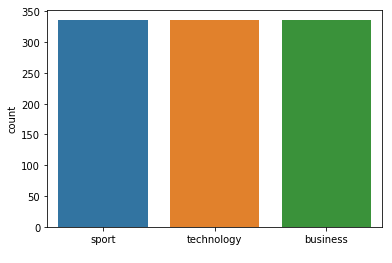



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 51
Class Distribution --> Train data (Fold 5 ):


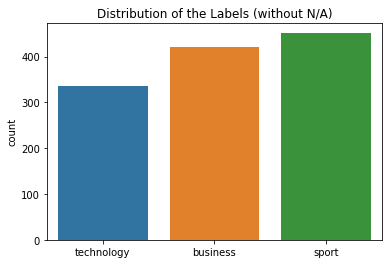

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


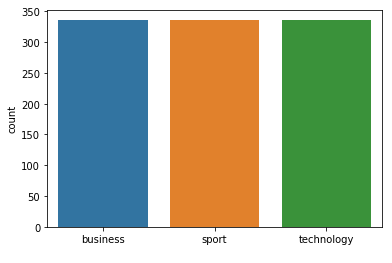



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 51
Class Distribution --> Train data (Fold 6 ):


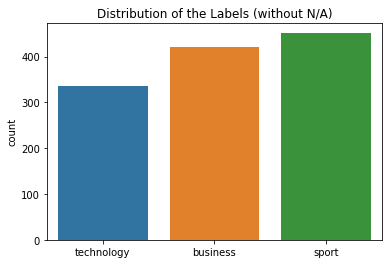

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


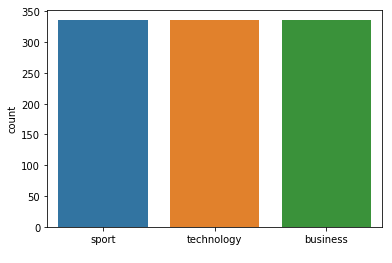



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 51
Class Distribution --> Train data (Fold 7 ):


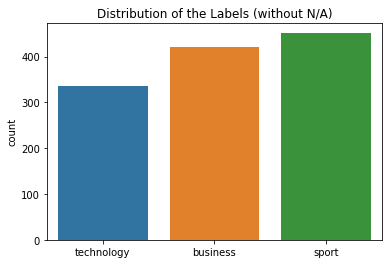

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


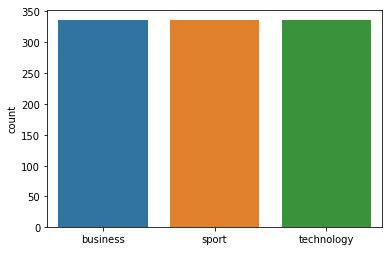



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 51  neighbours): 96.65% (+/- 1.16%)
FOLD 1 Number of neighbors 53
Class Distribution --> Train data (Fold 1 ):


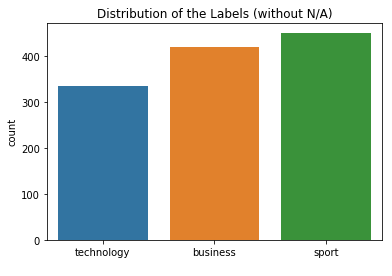

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


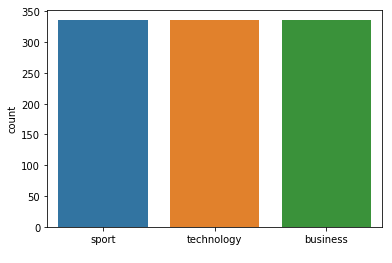



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 53
Class Distribution --> Train data (Fold 2 ):


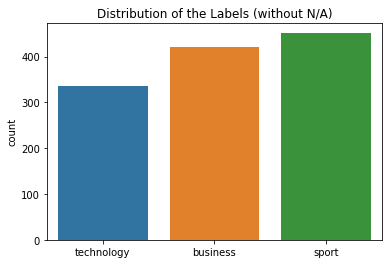

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


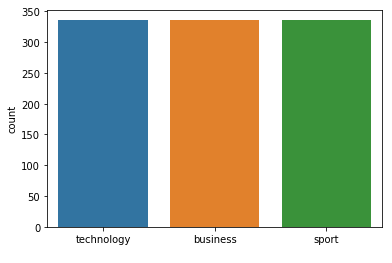



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 3 Number of neighbors 53
Class Distribution --> Train data (Fold 3 ):


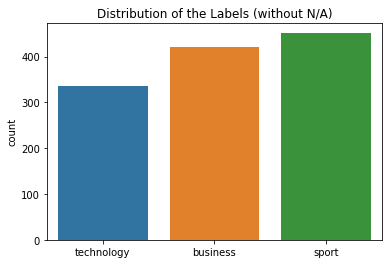

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


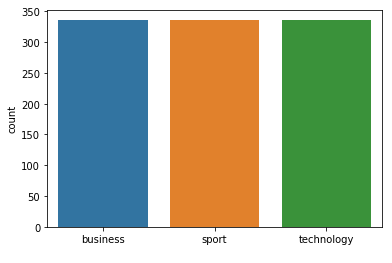



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 53
Class Distribution --> Train data (Fold 4 ):


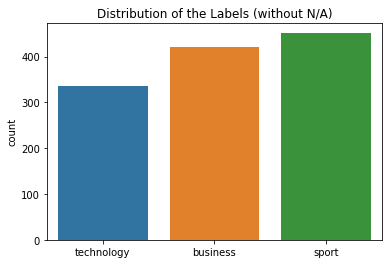

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


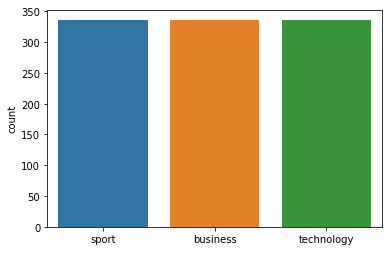



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 53
Class Distribution --> Train data (Fold 5 ):


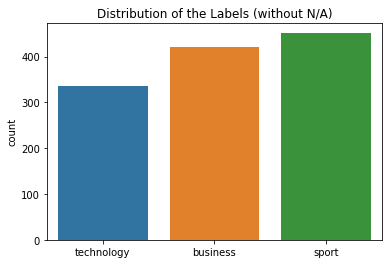

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


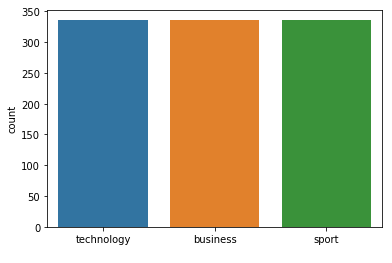



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 53
Class Distribution --> Train data (Fold 6 ):


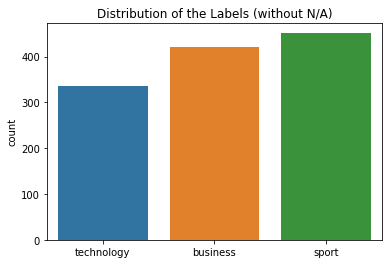

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


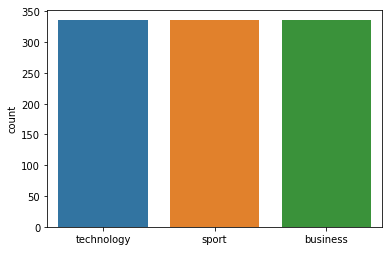



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 53
Class Distribution --> Train data (Fold 7 ):


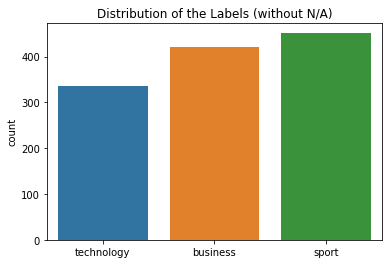

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


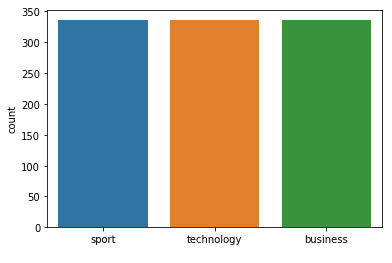



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 53  neighbours): 96.67% (+/- 1.16%)
FOLD 1 Number of neighbors 55
Class Distribution --> Train data (Fold 1 ):


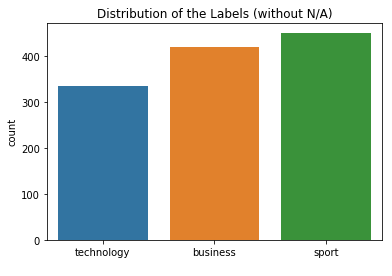

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


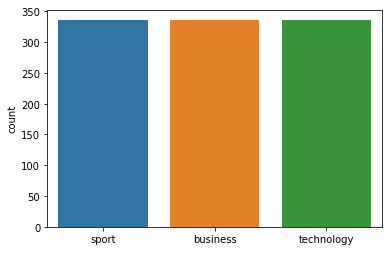



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       1.00      1.00      1.00        76
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 55
Class Distribution --> Train data (Fold 2 ):


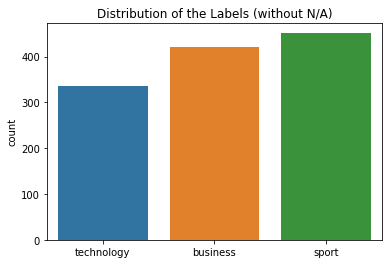

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


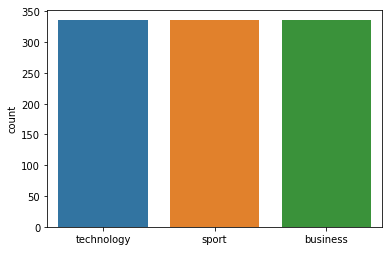



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 55
Class Distribution --> Train data (Fold 3 ):


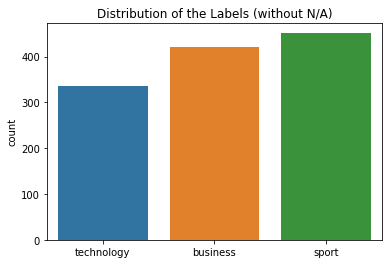

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


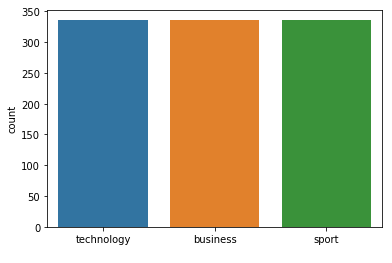



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 55
Class Distribution --> Train data (Fold 4 ):


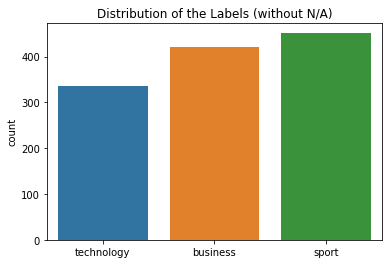

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


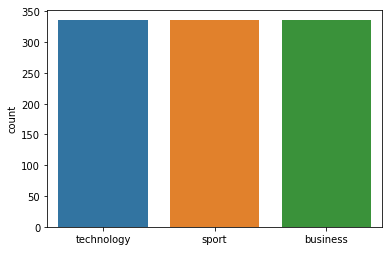



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 55
Class Distribution --> Train data (Fold 5 ):


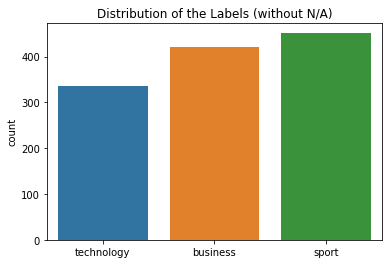

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


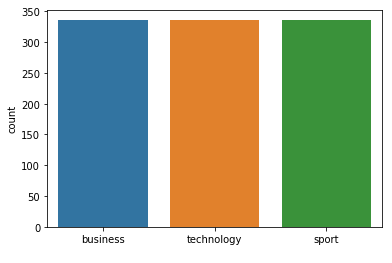



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 55
Class Distribution --> Train data (Fold 6 ):


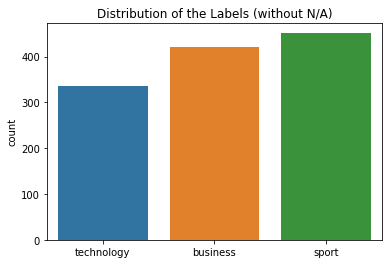

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


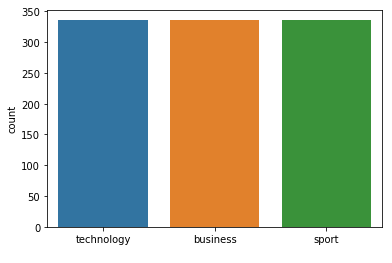



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 7 Number of neighbors 55
Class Distribution --> Train data (Fold 7 ):


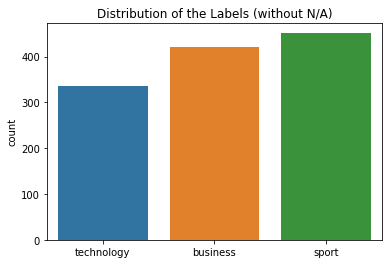

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


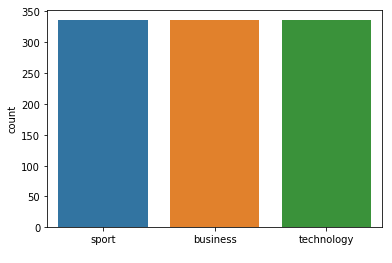



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 55  neighbours): 96.69% (+/- 1.15%)
FOLD 1 Number of neighbors 57
Class Distribution --> Train data (Fold 1 ):


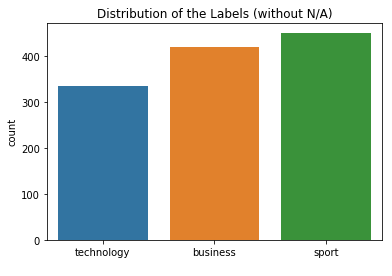

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


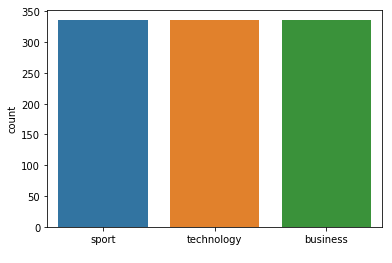



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       1.00      1.00      1.00        76
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 57
Class Distribution --> Train data (Fold 2 ):


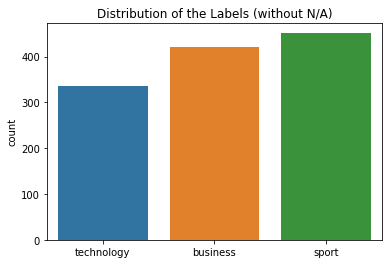

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


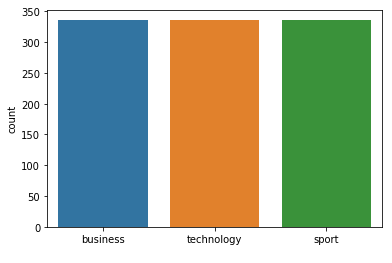



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 3 Number of neighbors 57
Class Distribution --> Train data (Fold 3 ):


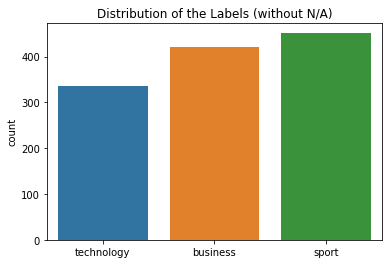

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


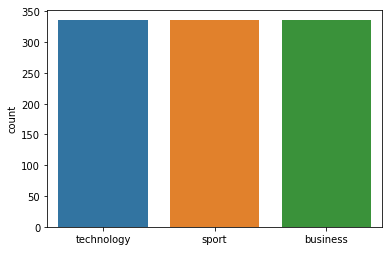



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 57
Class Distribution --> Train data (Fold 4 ):


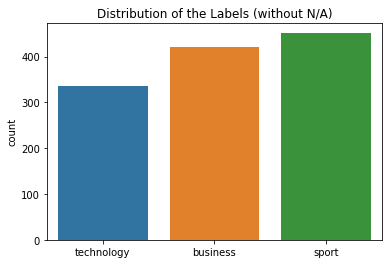

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


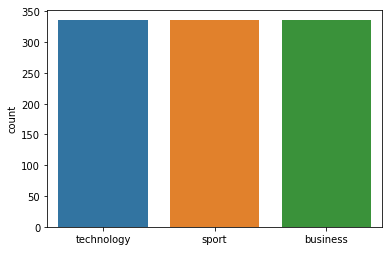



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 57
Class Distribution --> Train data (Fold 5 ):


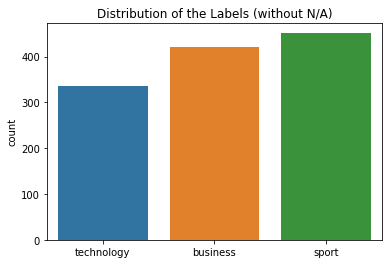

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


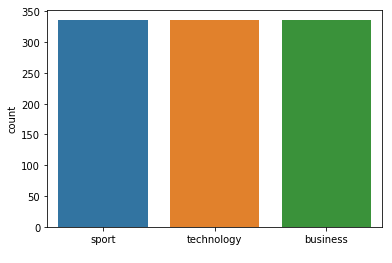



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 57
Class Distribution --> Train data (Fold 6 ):


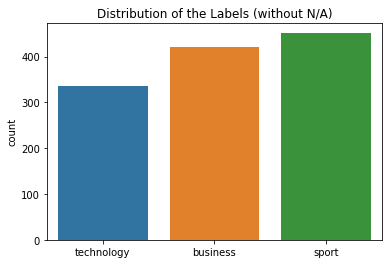

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


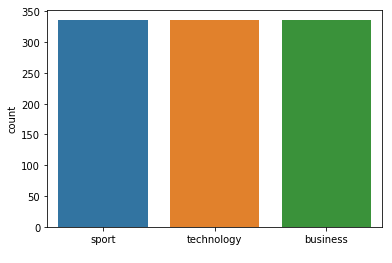



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 57
Class Distribution --> Train data (Fold 7 ):


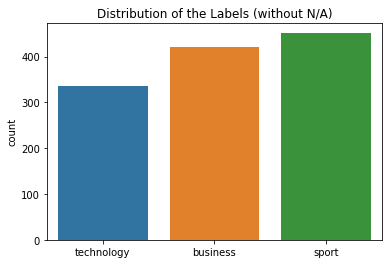

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


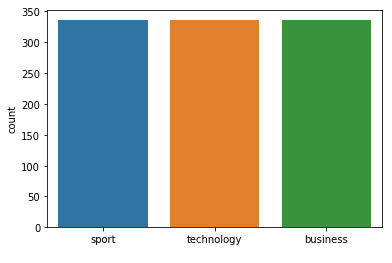



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.95      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 57  neighbours): 96.71% (+/- 1.15%)
FOLD 1 Number of neighbors 59
Class Distribution --> Train data (Fold 1 ):


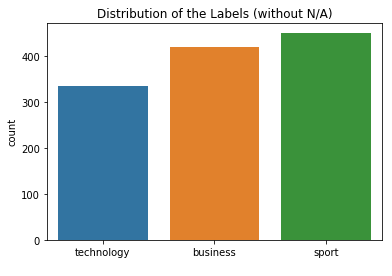

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


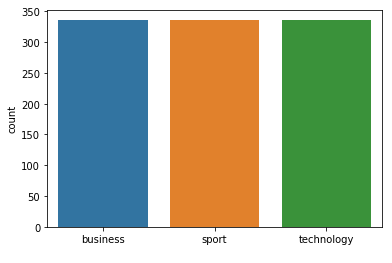



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 59
Class Distribution --> Train data (Fold 2 ):


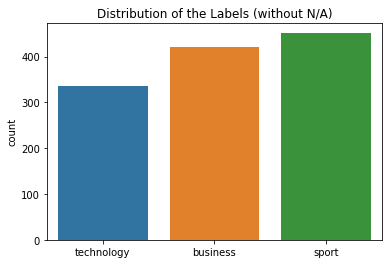

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


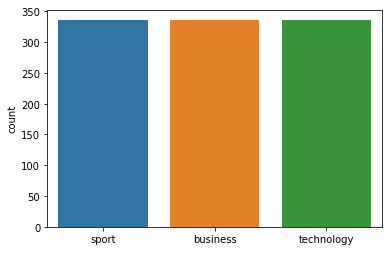



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 3 Number of neighbors 59
Class Distribution --> Train data (Fold 3 ):


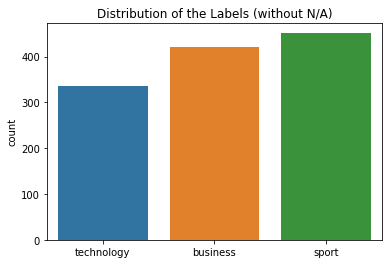

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


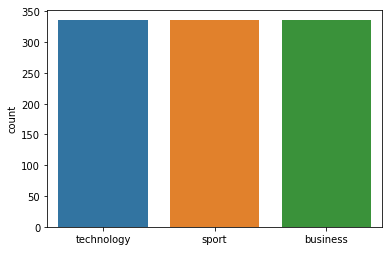



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 59
Class Distribution --> Train data (Fold 4 ):


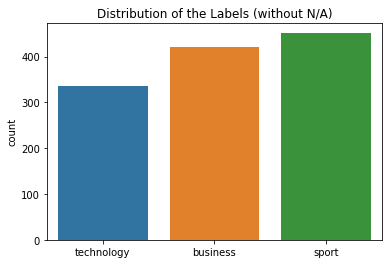

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


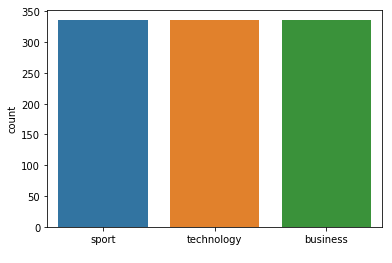



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 59
Class Distribution --> Train data (Fold 5 ):


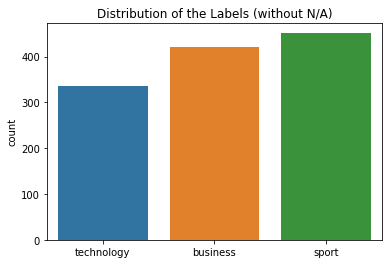

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


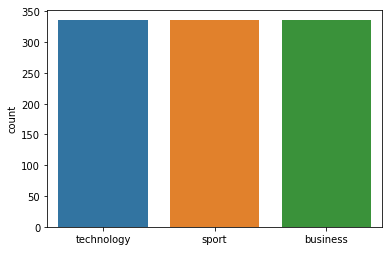



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 59
Class Distribution --> Train data (Fold 6 ):


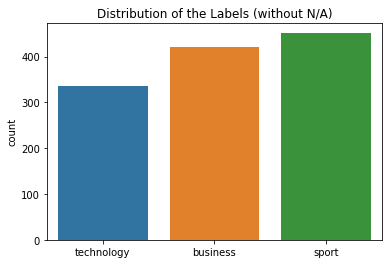

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


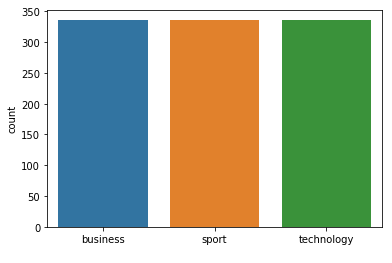



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 59
Class Distribution --> Train data (Fold 7 ):


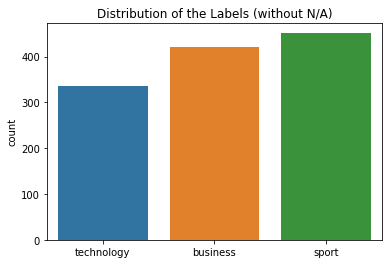

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


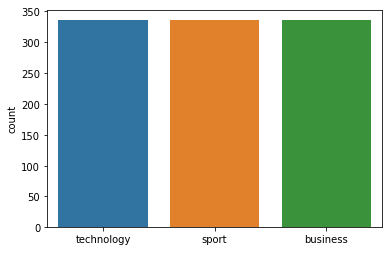



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.95      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 59  neighbours): 96.72% (+/- 1.15%)
FOLD 1 Number of neighbors 61
Class Distribution --> Train data (Fold 1 ):


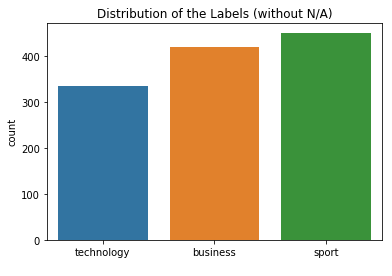

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


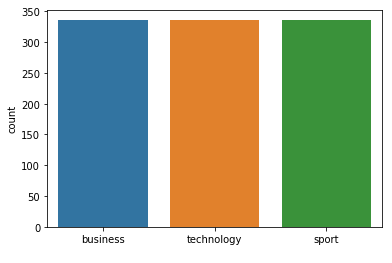



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 61
Class Distribution --> Train data (Fold 2 ):


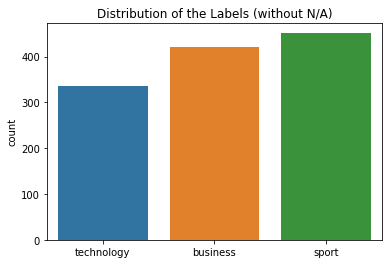

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


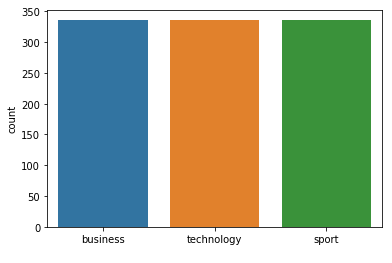



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3 Number of neighbors 61
Class Distribution --> Train data (Fold 3 ):


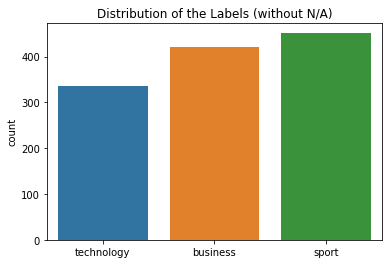

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


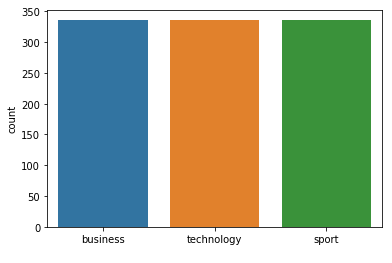



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 61
Class Distribution --> Train data (Fold 4 ):


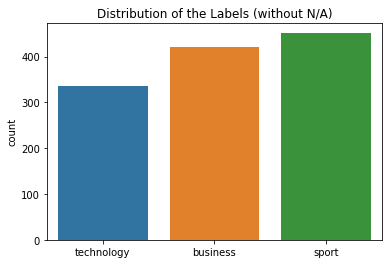

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


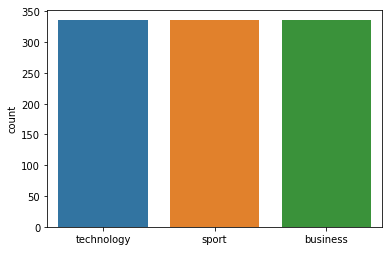



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 61
Class Distribution --> Train data (Fold 5 ):


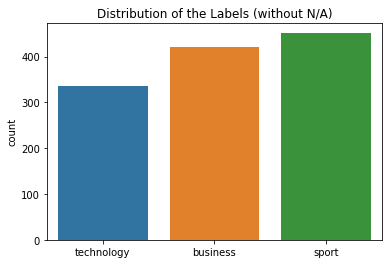

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


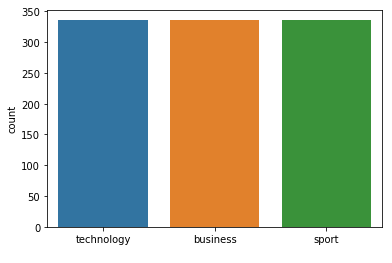



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 61
Class Distribution --> Train data (Fold 6 ):


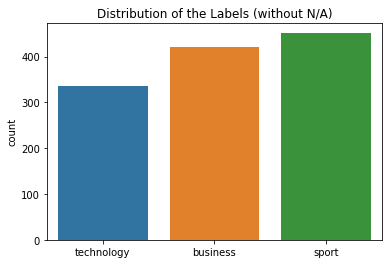

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


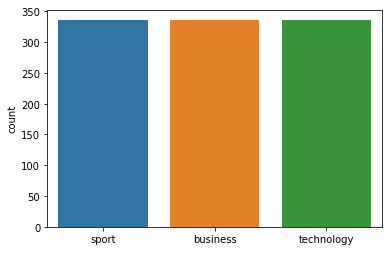



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7 Number of neighbors 61
Class Distribution --> Train data (Fold 7 ):


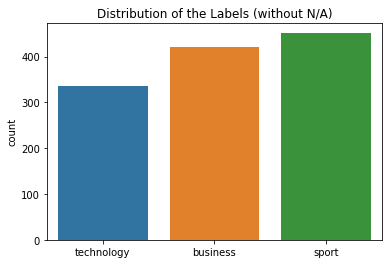

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


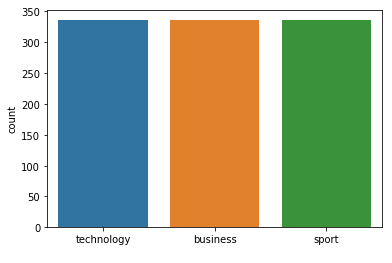



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 61  neighbours): 96.73% (+/- 1.14%)
FOLD 1 Number of neighbors 63
Class Distribution --> Train data (Fold 1 ):


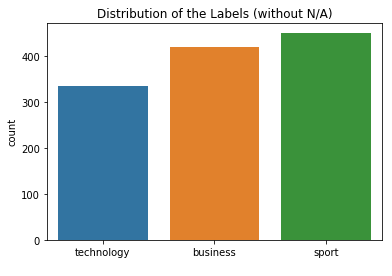

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


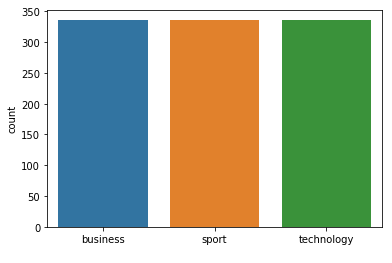



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 63
Class Distribution --> Train data (Fold 2 ):


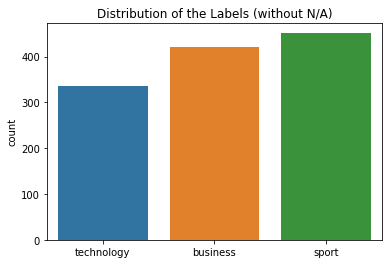

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


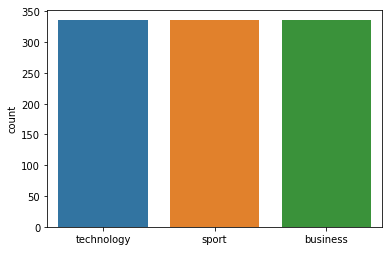



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 63
Class Distribution --> Train data (Fold 3 ):


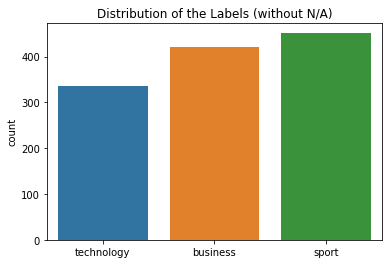

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


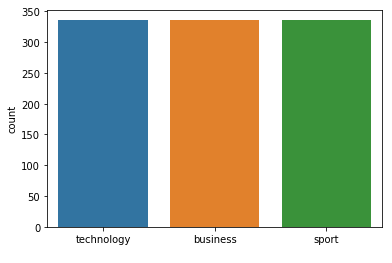



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 63
Class Distribution --> Train data (Fold 4 ):


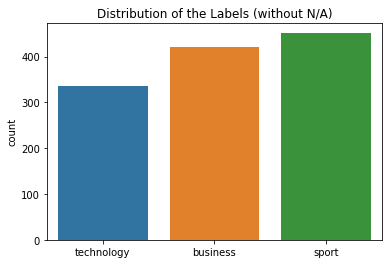

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


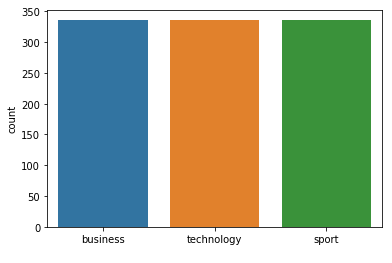



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 63
Class Distribution --> Train data (Fold 5 ):


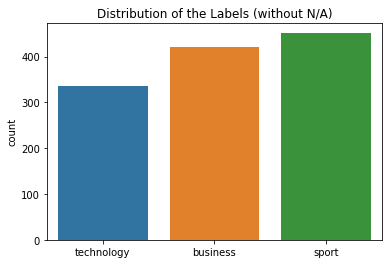

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


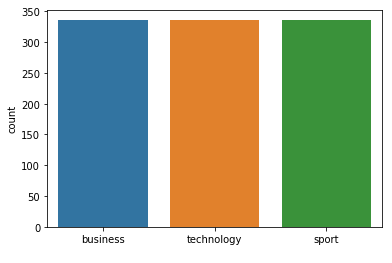



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 63
Class Distribution --> Train data (Fold 6 ):


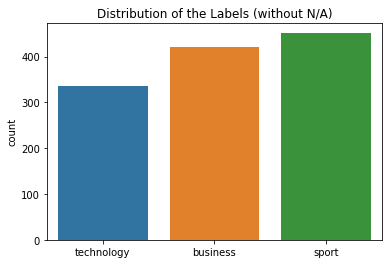

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


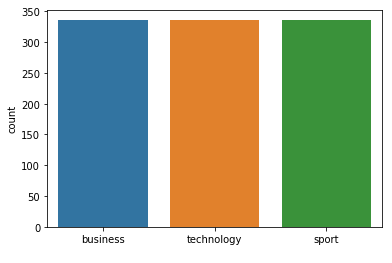



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 63
Class Distribution --> Train data (Fold 7 ):


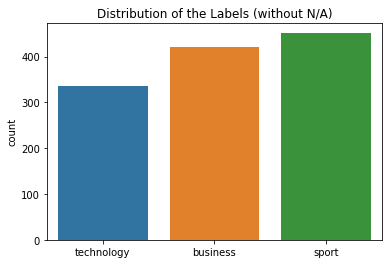

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


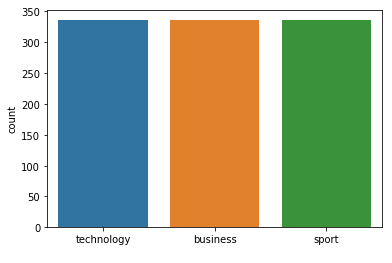



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 63  neighbours): 96.74% (+/- 1.13%)
FOLD 1 Number of neighbors 65
Class Distribution --> Train data (Fold 1 ):


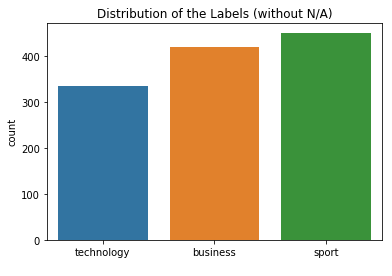

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


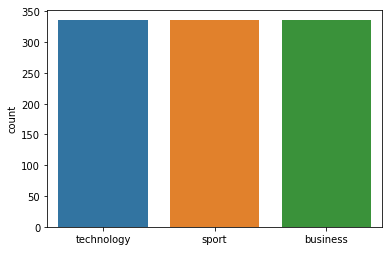



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 65
Class Distribution --> Train data (Fold 2 ):


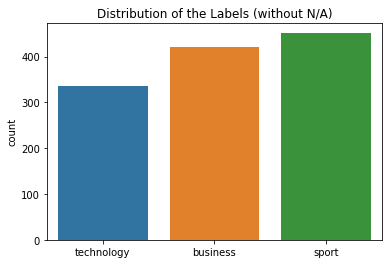

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


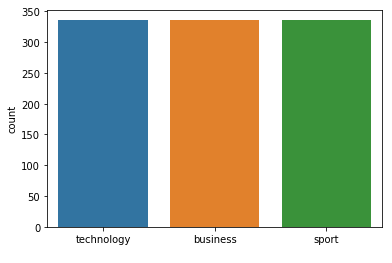



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 65
Class Distribution --> Train data (Fold 3 ):


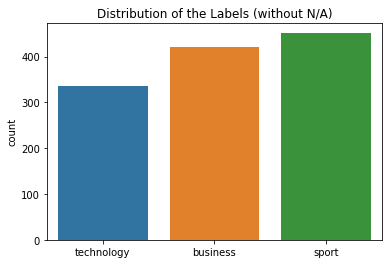

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


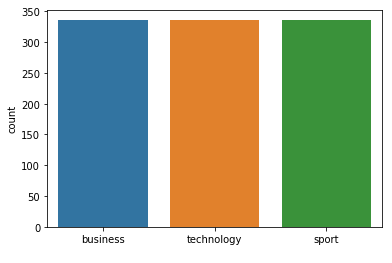



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.90      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 65
Class Distribution --> Train data (Fold 4 ):


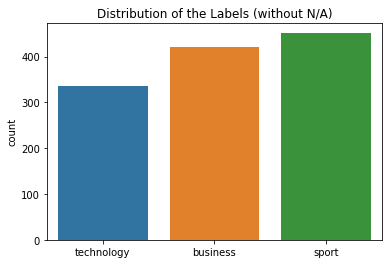

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


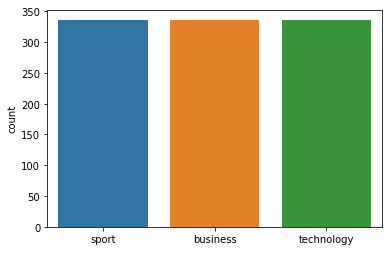



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 65
Class Distribution --> Train data (Fold 5 ):


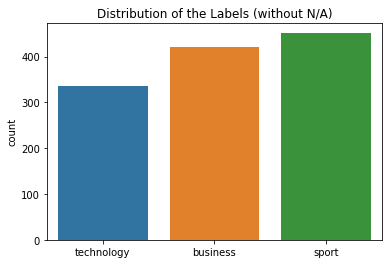

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


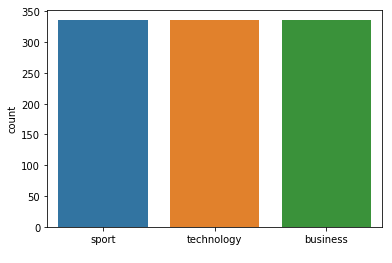



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 65
Class Distribution --> Train data (Fold 6 ):


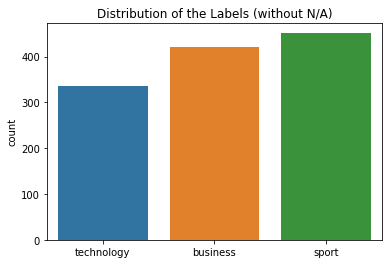

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


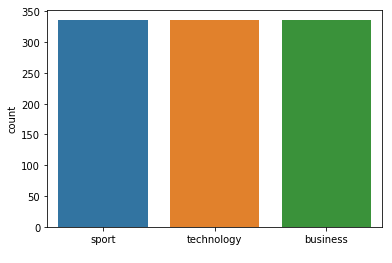



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 65
Class Distribution --> Train data (Fold 7 ):


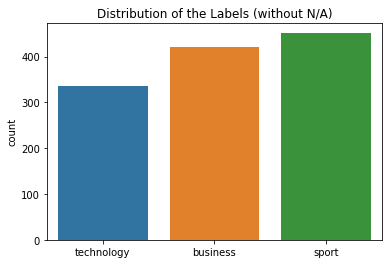

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


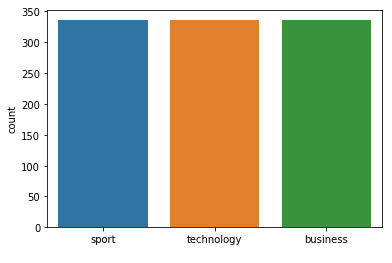



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 65  neighbours): 96.75% (+/- 1.12%)
FOLD 1 Number of neighbors 67
Class Distribution --> Train data (Fold 1 ):


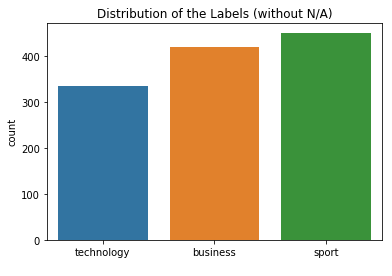

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


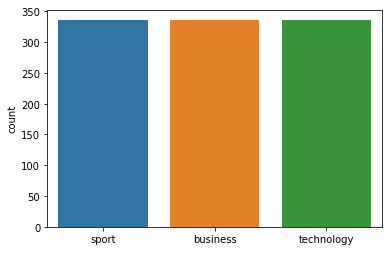



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 67
Class Distribution --> Train data (Fold 2 ):


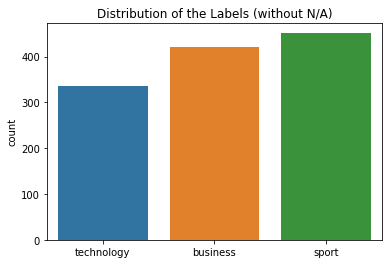

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


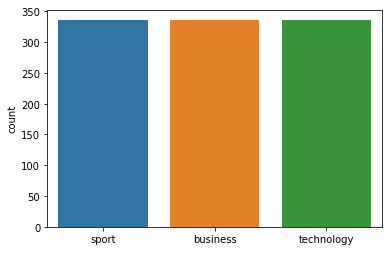



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 73  1]
 [ 0  0 56]]
FOLD 3 Number of neighbors 67
Class Distribution --> Train data (Fold 3 ):


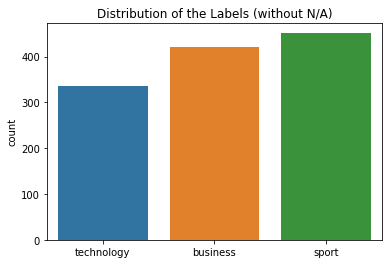

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


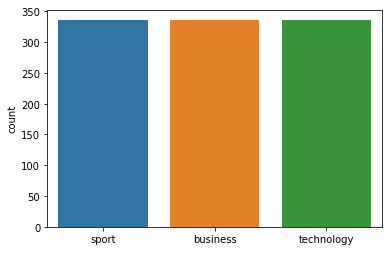



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 67
Class Distribution --> Train data (Fold 4 ):


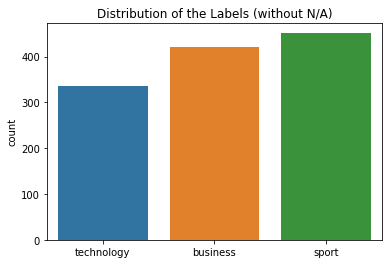

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


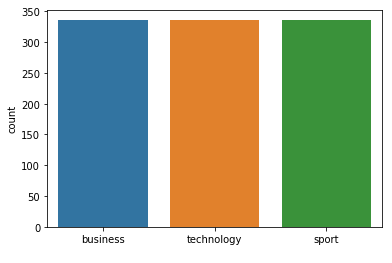



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 67
Class Distribution --> Train data (Fold 5 ):


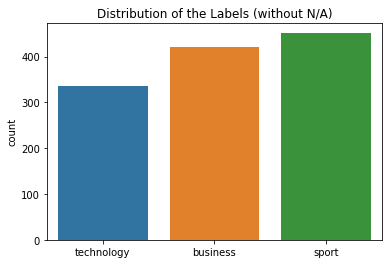

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


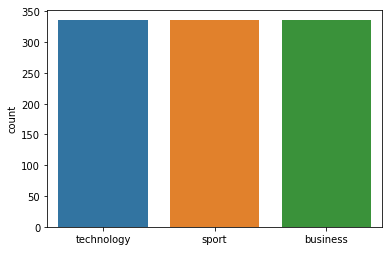



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 67
Class Distribution --> Train data (Fold 6 ):


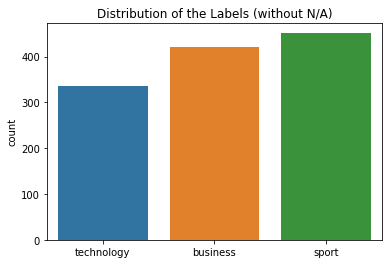

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


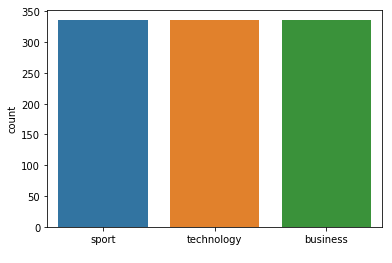



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 67
Class Distribution --> Train data (Fold 7 ):


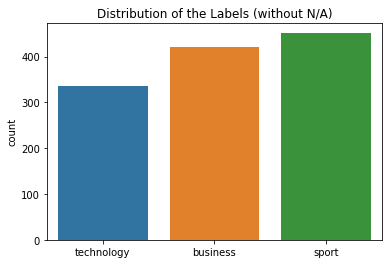

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


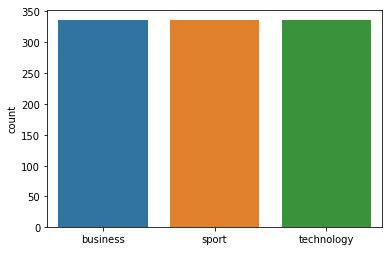



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 67  neighbours): 96.76% (+/- 1.11%)
FOLD 1 Number of neighbors 69
Class Distribution --> Train data (Fold 1 ):


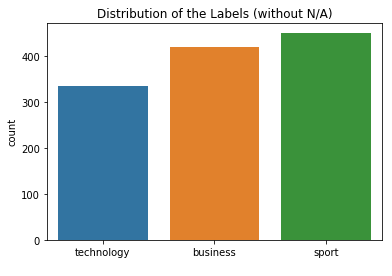

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


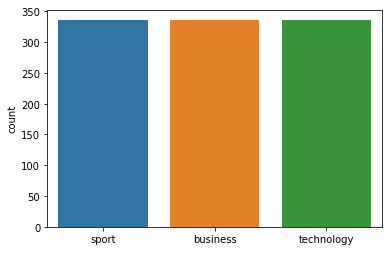



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       1.00      1.00      1.00        76
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 69
Class Distribution --> Train data (Fold 2 ):


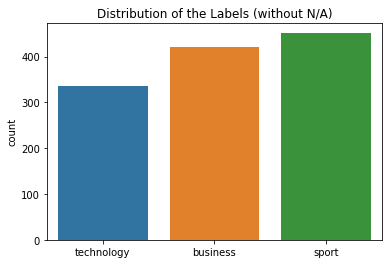

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


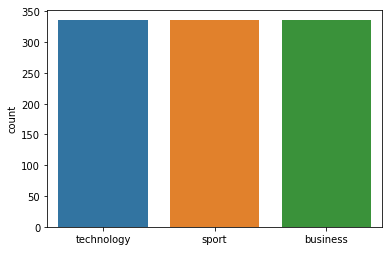



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 3 Number of neighbors 69
Class Distribution --> Train data (Fold 3 ):


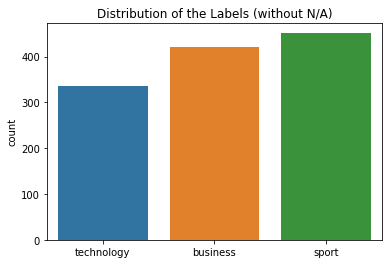

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


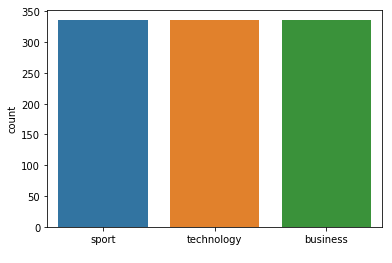



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 69
Class Distribution --> Train data (Fold 4 ):


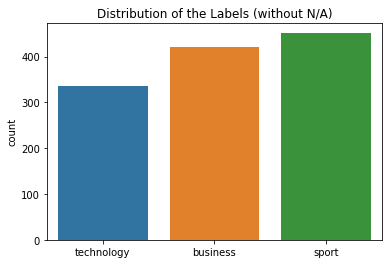

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


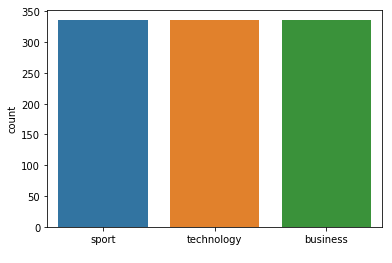



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 69
Class Distribution --> Train data (Fold 5 ):


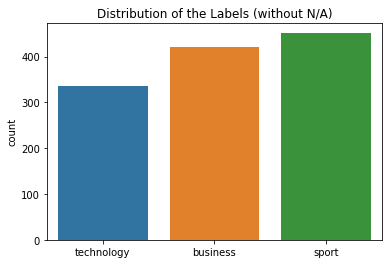

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


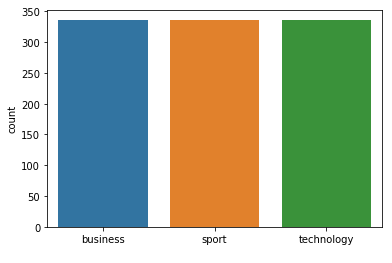



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 69
Class Distribution --> Train data (Fold 6 ):


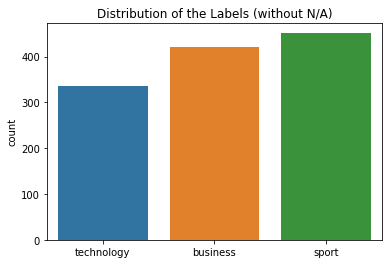

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


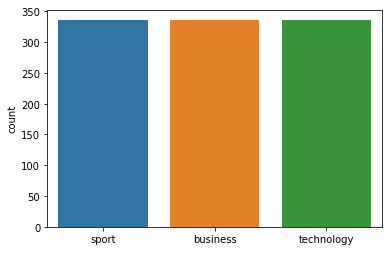



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 69
Class Distribution --> Train data (Fold 7 ):


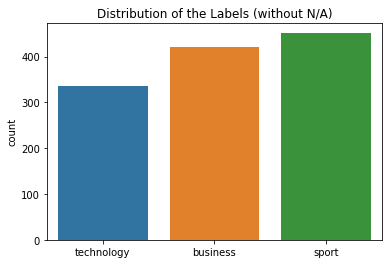

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


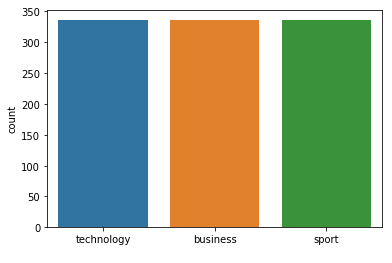



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 69  neighbours): 96.78% (+/- 1.11%)
FOLD 1 Number of neighbors 71
Class Distribution --> Train data (Fold 1 ):


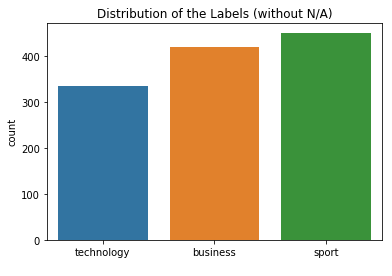

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


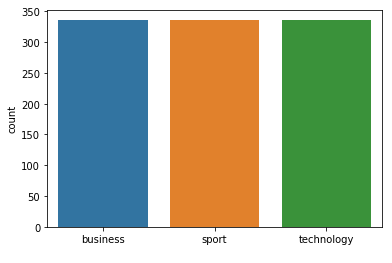



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 71
Class Distribution --> Train data (Fold 2 ):


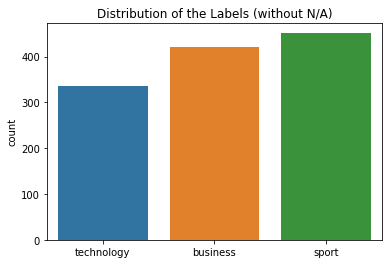

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


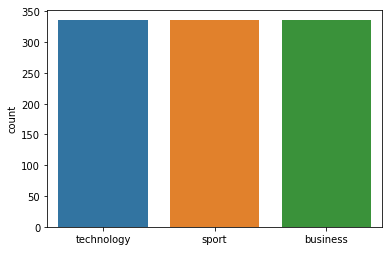



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 3 Number of neighbors 71
Class Distribution --> Train data (Fold 3 ):


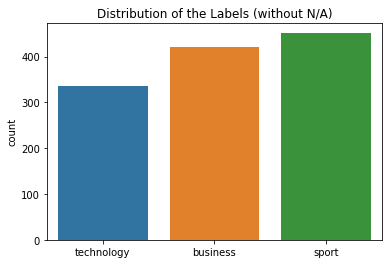

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


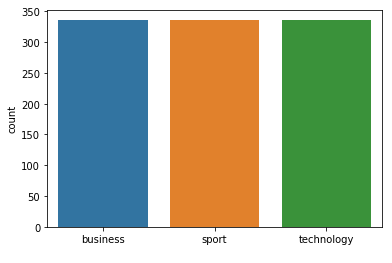



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 71
Class Distribution --> Train data (Fold 4 ):


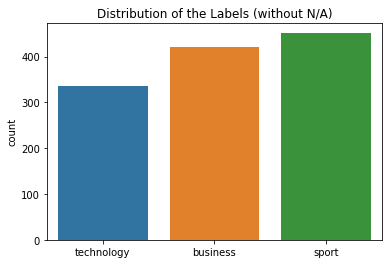

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


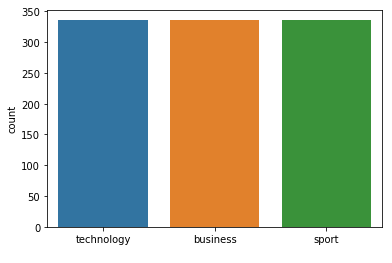



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 71
Class Distribution --> Train data (Fold 5 ):


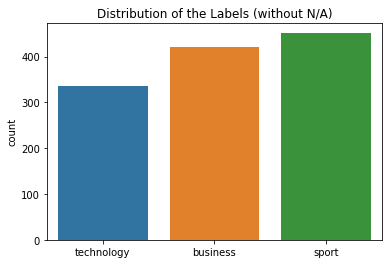

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


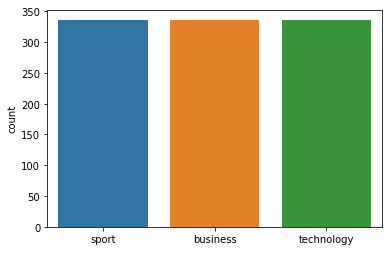



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 71
Class Distribution --> Train data (Fold 6 ):


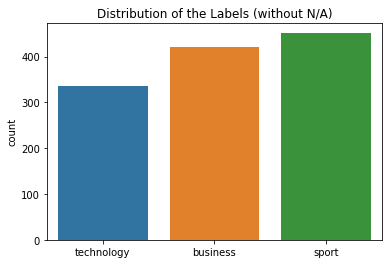

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


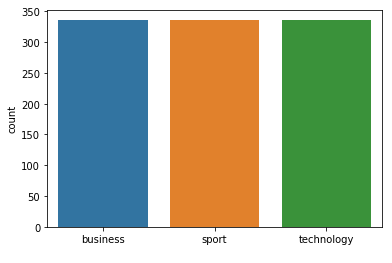



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 71
Class Distribution --> Train data (Fold 7 ):


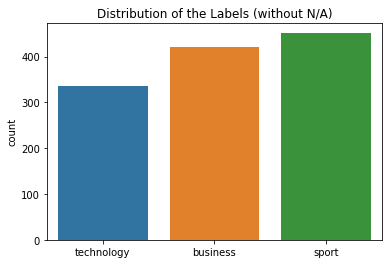

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


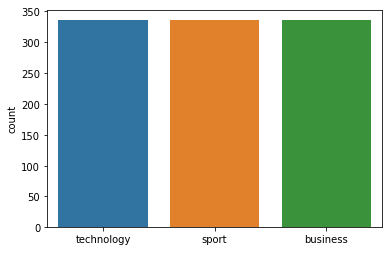



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 71  neighbours): 96.79% (+/- 1.11%)
FOLD 1 Number of neighbors 73
Class Distribution --> Train data (Fold 1 ):


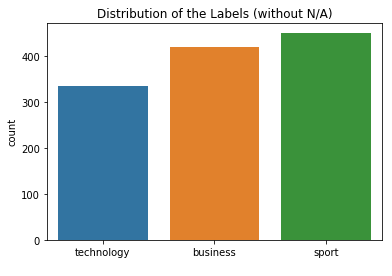

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


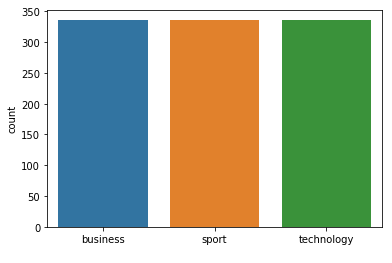



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 73
Class Distribution --> Train data (Fold 2 ):


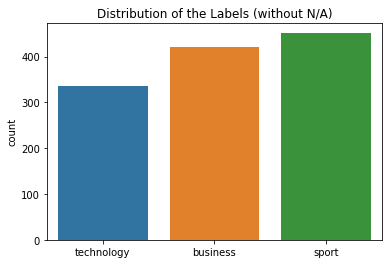

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


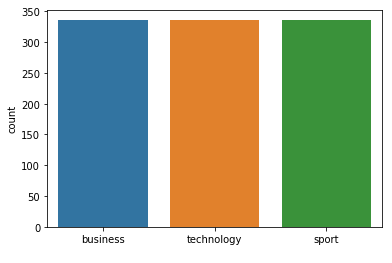



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 73
Class Distribution --> Train data (Fold 3 ):


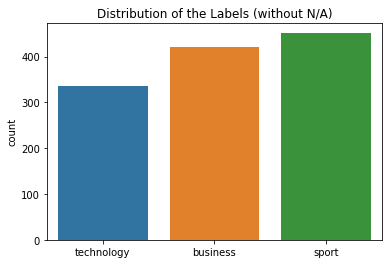

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


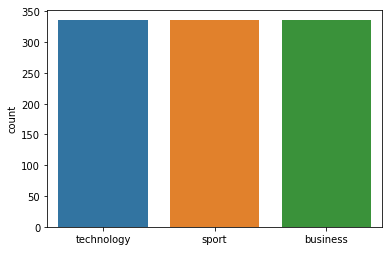



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 73
Class Distribution --> Train data (Fold 4 ):


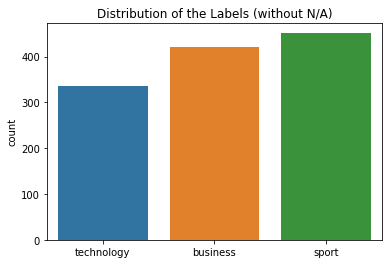

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


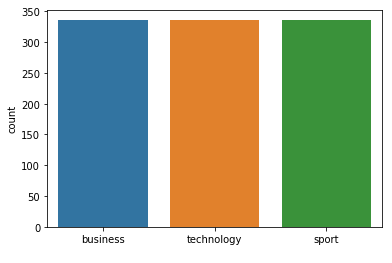



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 73
Class Distribution --> Train data (Fold 5 ):


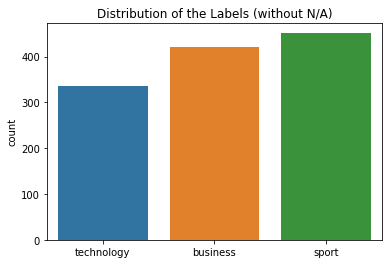

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


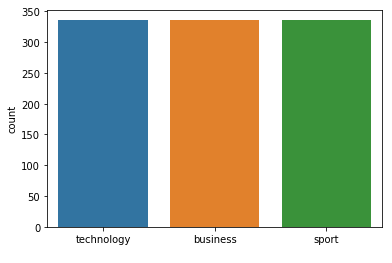



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 73
Class Distribution --> Train data (Fold 6 ):


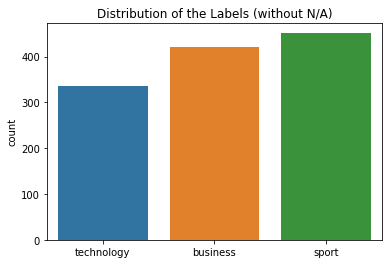

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


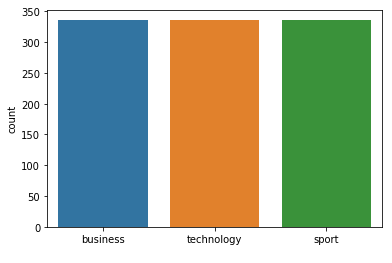



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 73
Class Distribution --> Train data (Fold 7 ):


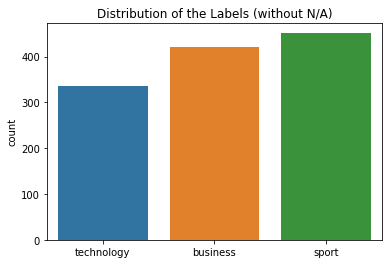

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


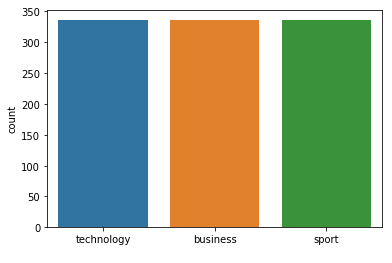



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 73  neighbours): 96.80% (+/- 1.10%)
FOLD 1 Number of neighbors 75
Class Distribution --> Train data (Fold 1 ):


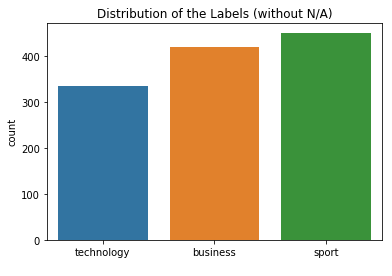

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


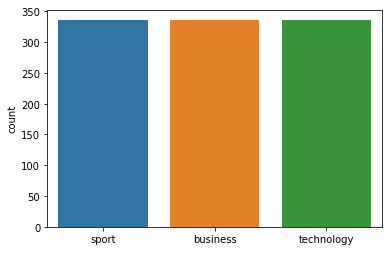



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       0.99      1.00      0.99        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 75
Class Distribution --> Train data (Fold 2 ):


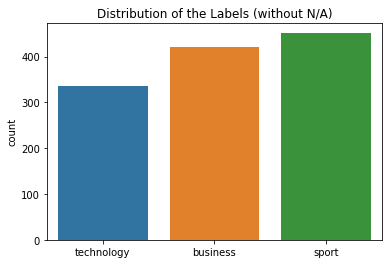

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


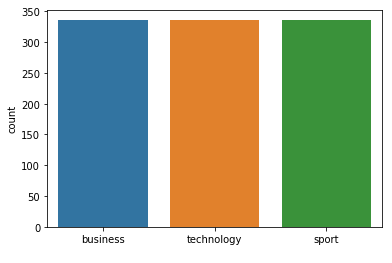



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 75
Class Distribution --> Train data (Fold 3 ):


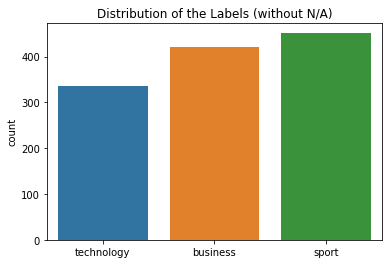

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


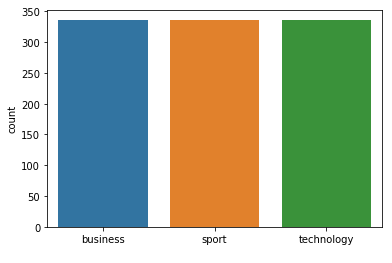



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.90      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 75
Class Distribution --> Train data (Fold 4 ):


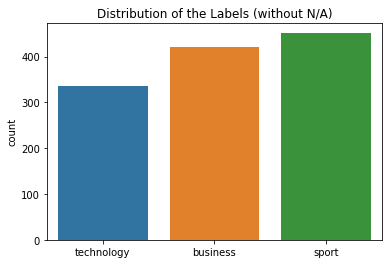

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


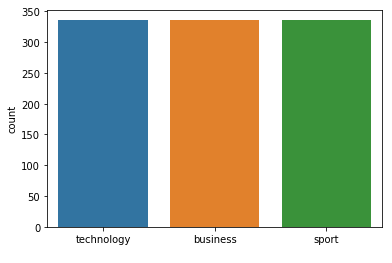



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 75
Class Distribution --> Train data (Fold 5 ):


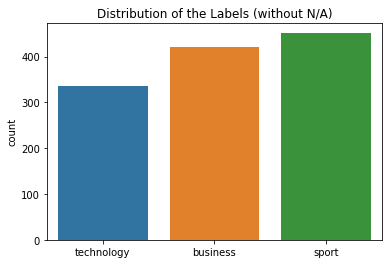

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


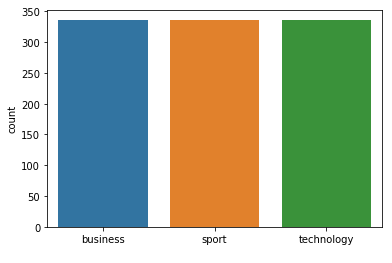



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 75
Class Distribution --> Train data (Fold 6 ):


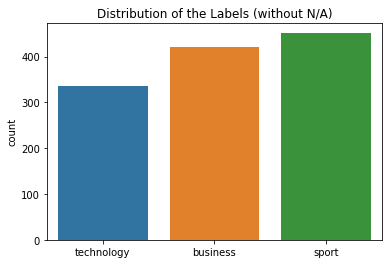

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


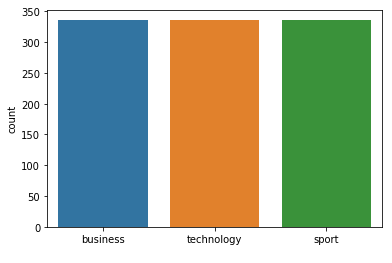



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 75
Class Distribution --> Train data (Fold 7 ):


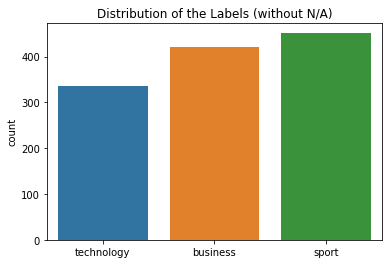

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


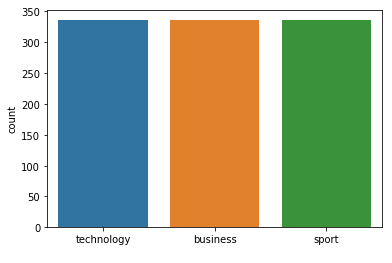



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 75  neighbours): 96.80% (+/- 1.09%)
FOLD 1 Number of neighbors 77
Class Distribution --> Train data (Fold 1 ):


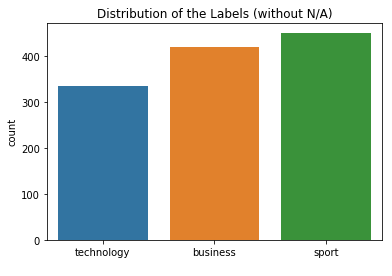

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


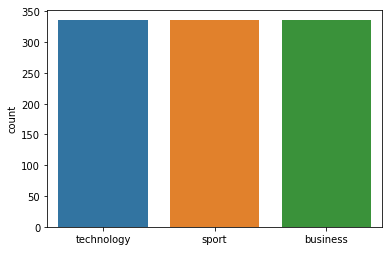



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       1.00      1.00      1.00        76
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2 Number of neighbors 77
Class Distribution --> Train data (Fold 2 ):


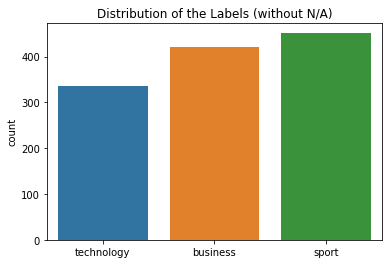

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


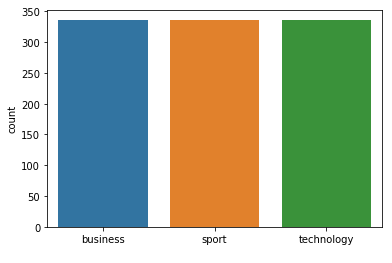



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 77
Class Distribution --> Train data (Fold 3 ):


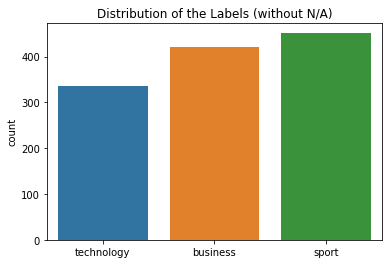

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


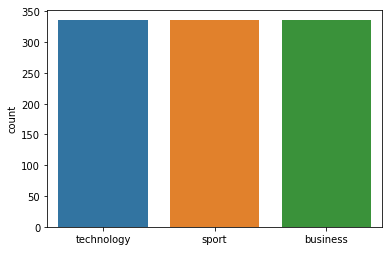



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 77
Class Distribution --> Train data (Fold 4 ):


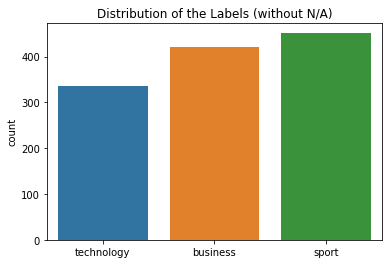

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


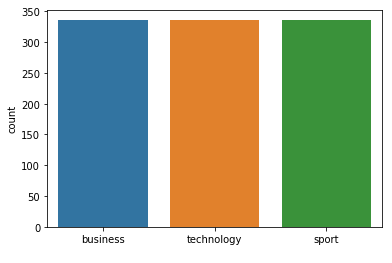



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 77
Class Distribution --> Train data (Fold 5 ):


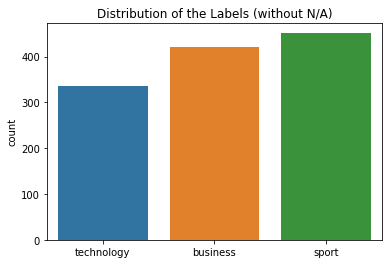

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


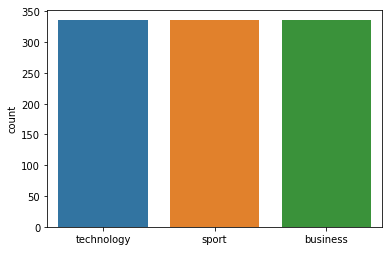



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 77
Class Distribution --> Train data (Fold 6 ):


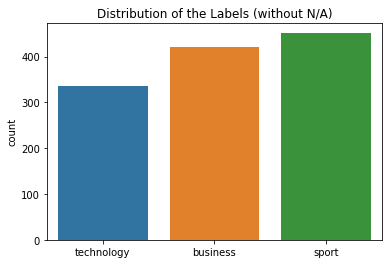

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


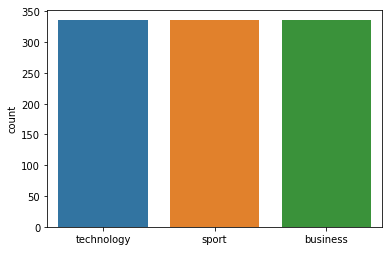



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 77
Class Distribution --> Train data (Fold 7 ):


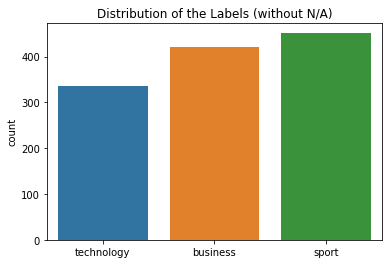

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


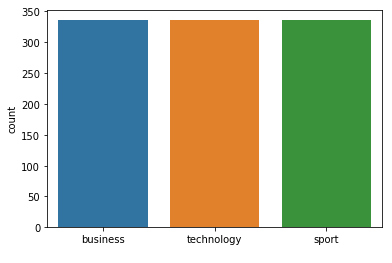



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 77  neighbours): 96.81% (+/- 1.08%)
FOLD 1 Number of neighbors 79
Class Distribution --> Train data (Fold 1 ):


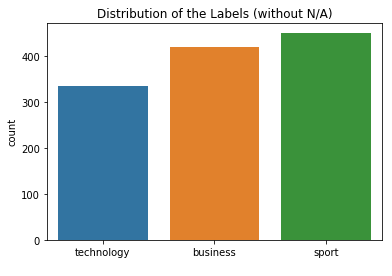

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


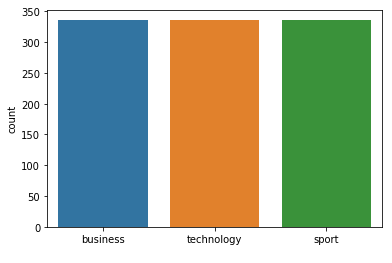



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        71
     sport
       0.99      1.00      0.99        76
technology
       0.93      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[67  0  4]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 79
Class Distribution --> Train data (Fold 2 ):


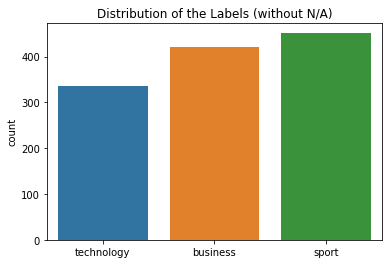

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


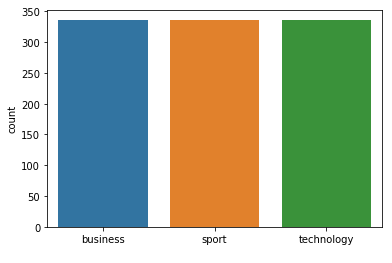



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 79
Class Distribution --> Train data (Fold 3 ):


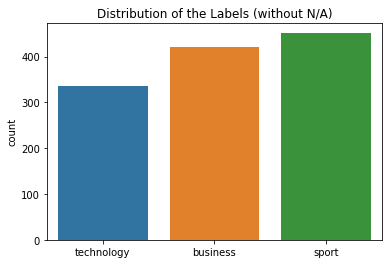

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


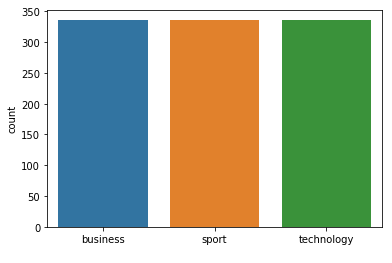



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 79
Class Distribution --> Train data (Fold 4 ):


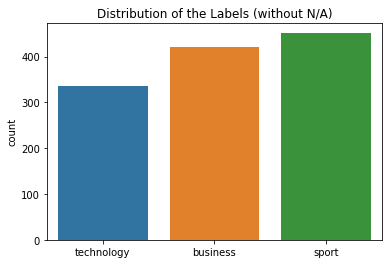

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


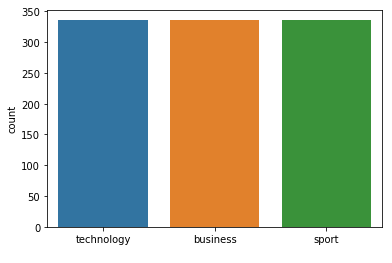



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 79
Class Distribution --> Train data (Fold 5 ):


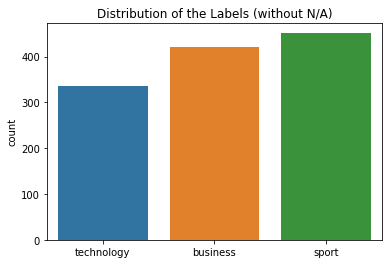

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


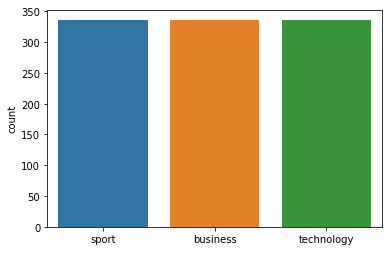



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 79
Class Distribution --> Train data (Fold 6 ):


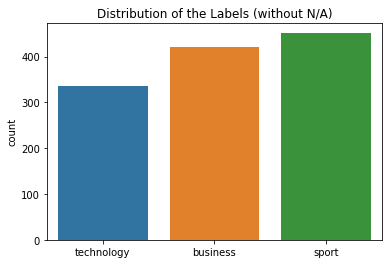

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


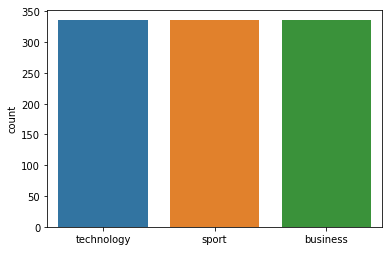



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 79
Class Distribution --> Train data (Fold 7 ):


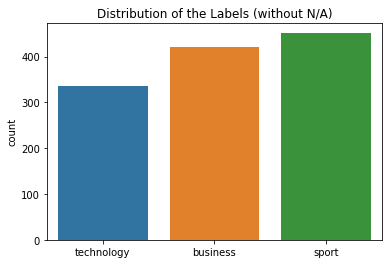

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


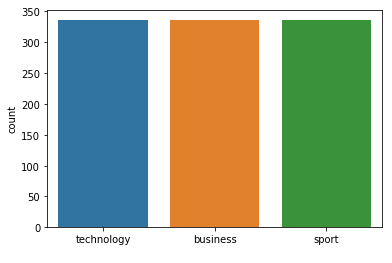



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 79  neighbours): 96.82% (+/- 1.08%)
FOLD 1 Number of neighbors 81
Class Distribution --> Train data (Fold 1 ):


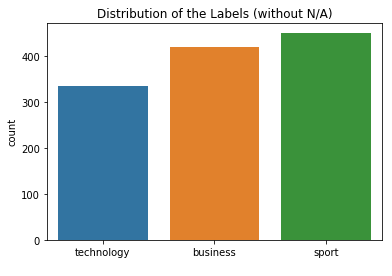

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


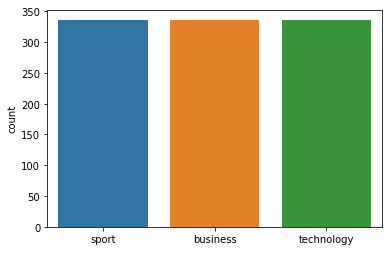



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 81
Class Distribution --> Train data (Fold 2 ):


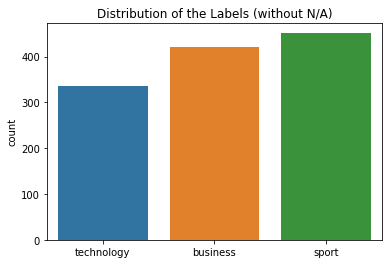

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


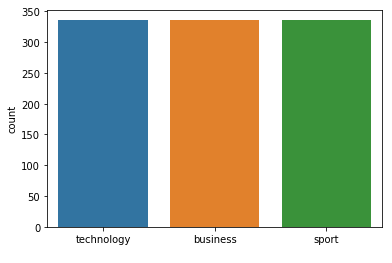



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 81
Class Distribution --> Train data (Fold 3 ):


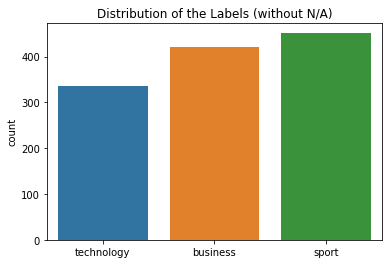

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


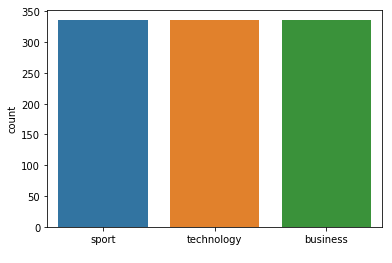



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 81
Class Distribution --> Train data (Fold 4 ):


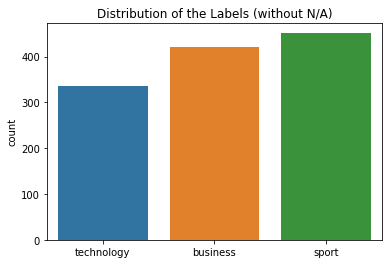

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


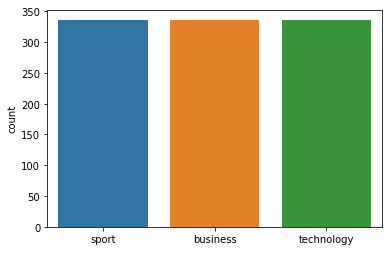



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 81
Class Distribution --> Train data (Fold 5 ):


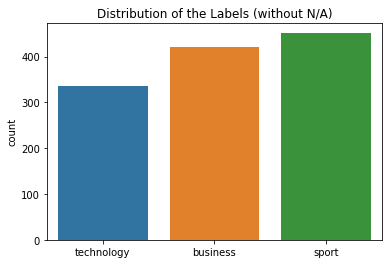

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


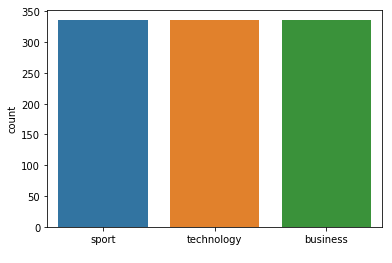



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 81
Class Distribution --> Train data (Fold 6 ):


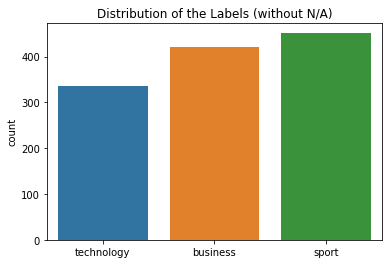

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


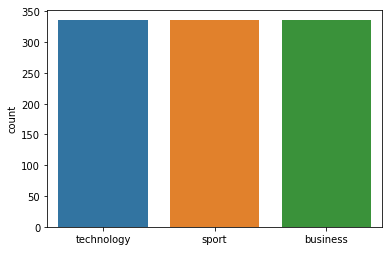



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 81
Class Distribution --> Train data (Fold 7 ):


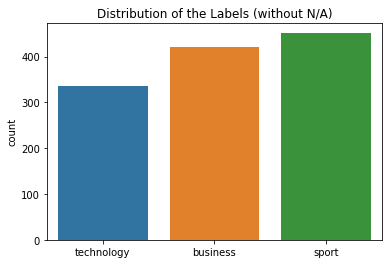

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


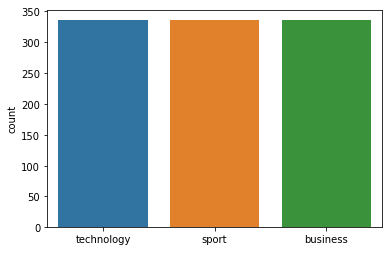



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 81  neighbours): 96.83% (+/- 1.07%)
FOLD 1 Number of neighbors 83
Class Distribution --> Train data (Fold 1 ):


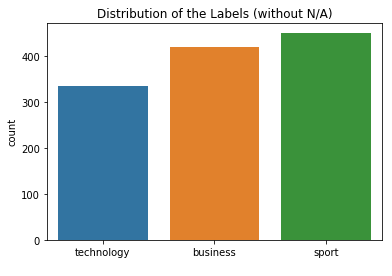

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


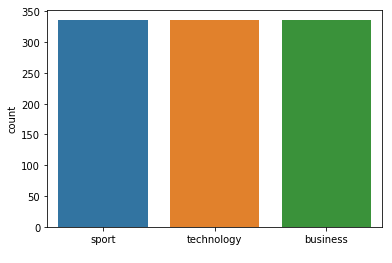



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 83
Class Distribution --> Train data (Fold 2 ):


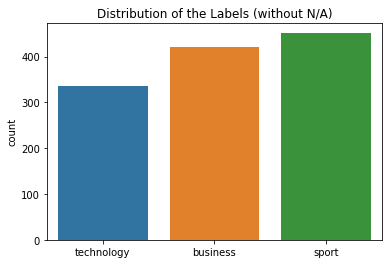

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


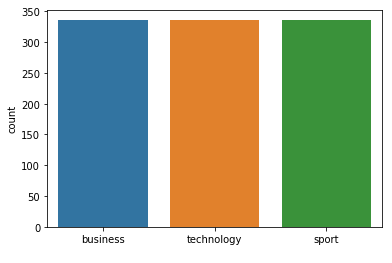



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 83
Class Distribution --> Train data (Fold 3 ):


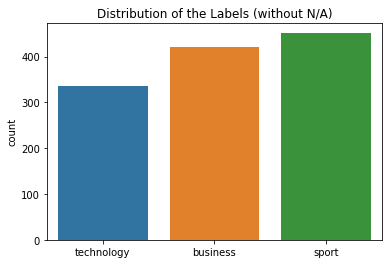

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


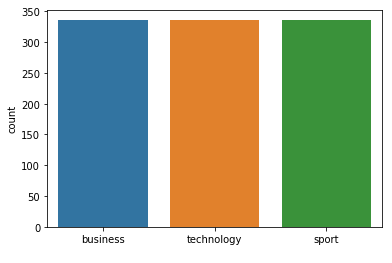



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.91      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 4 Number of neighbors 83
Class Distribution --> Train data (Fold 4 ):


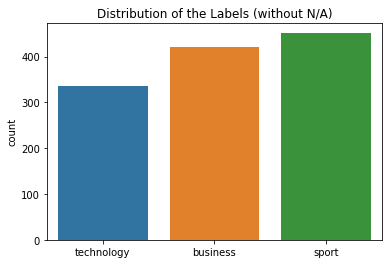

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


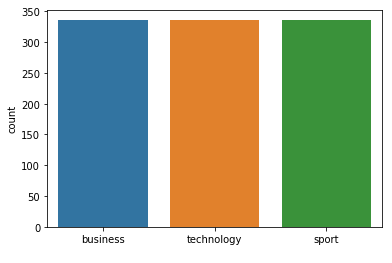



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 83
Class Distribution --> Train data (Fold 5 ):


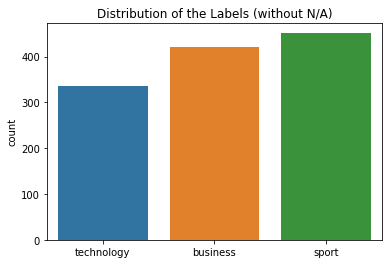

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


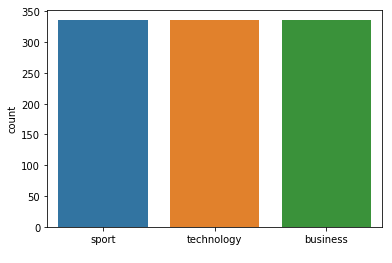



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 83
Class Distribution --> Train data (Fold 6 ):


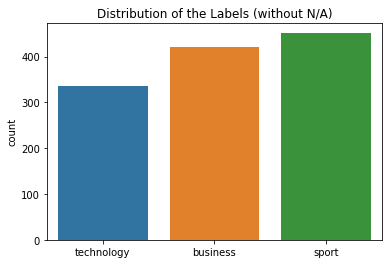

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


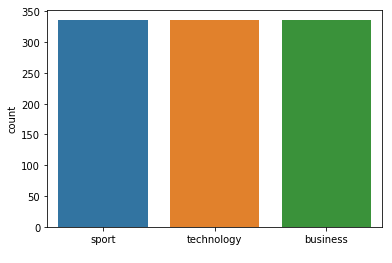



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 83
Class Distribution --> Train data (Fold 7 ):


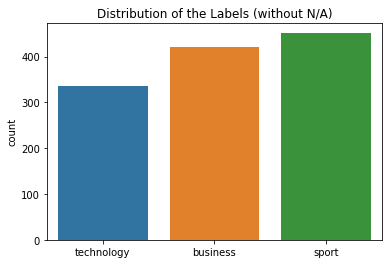

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


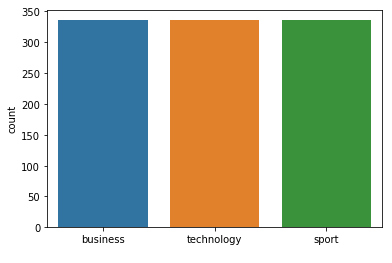



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 83  neighbours): 96.84% (+/- 1.06%)
FOLD 1 Number of neighbors 85
Class Distribution --> Train data (Fold 1 ):


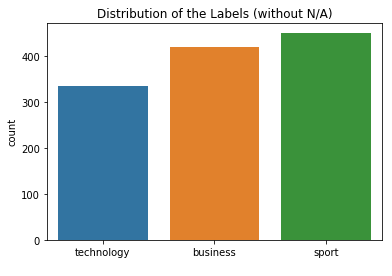

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


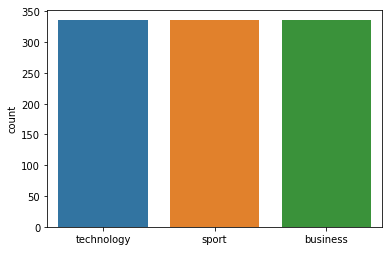



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 85
Class Distribution --> Train data (Fold 2 ):


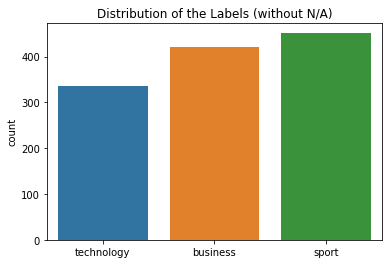

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


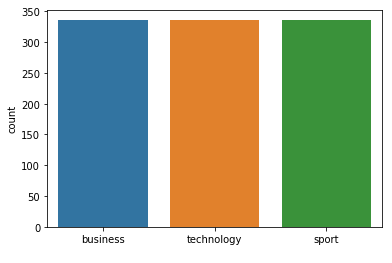



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 85
Class Distribution --> Train data (Fold 3 ):


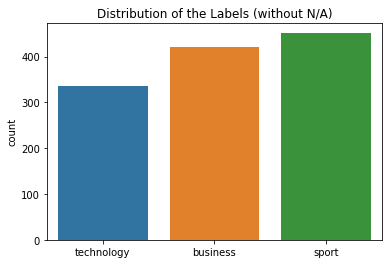

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


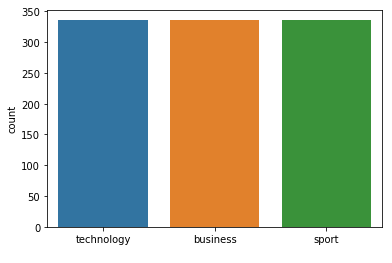



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 85
Class Distribution --> Train data (Fold 4 ):


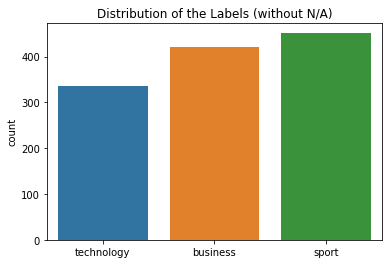

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


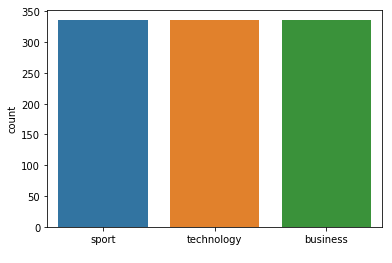



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 85
Class Distribution --> Train data (Fold 5 ):


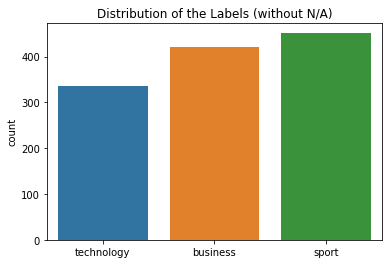

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


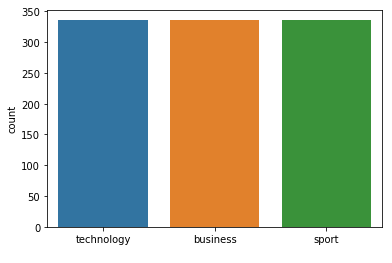



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 85
Class Distribution --> Train data (Fold 6 ):


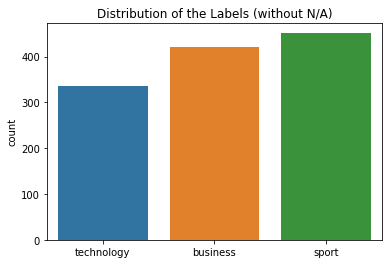

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


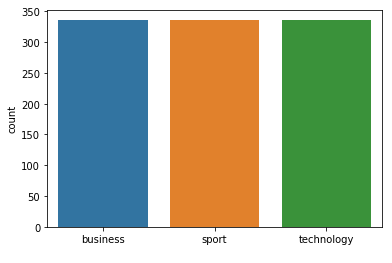



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 85
Class Distribution --> Train data (Fold 7 ):


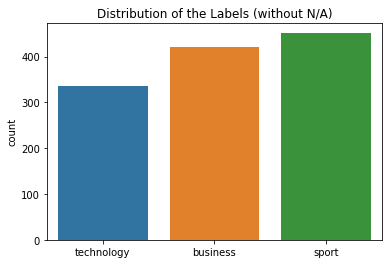

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


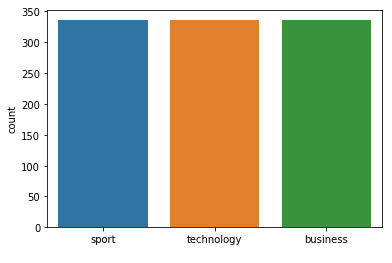



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 85  neighbours): 96.85% (+/- 1.06%)
FOLD 1 Number of neighbors 87
Class Distribution --> Train data (Fold 1 ):


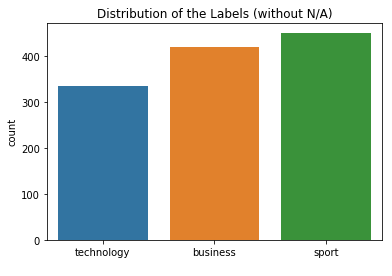

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


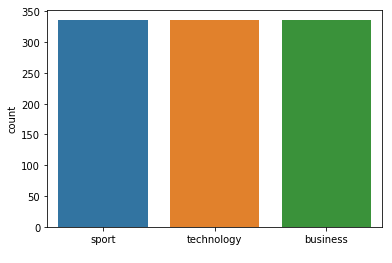



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 87
Class Distribution --> Train data (Fold 2 ):


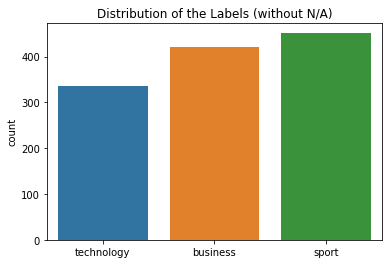

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


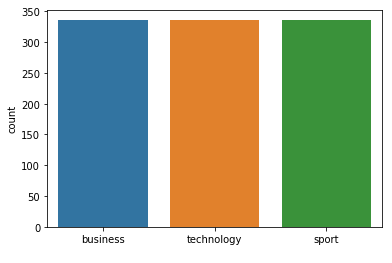



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.96      0.95        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 3 72  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 87
Class Distribution --> Train data (Fold 3 ):


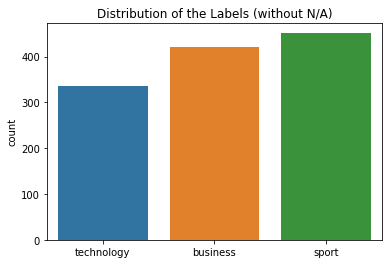

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


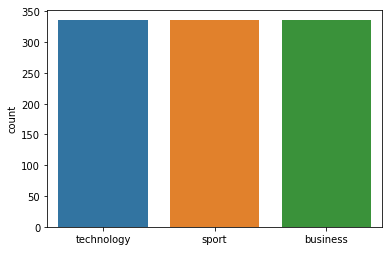



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 87
Class Distribution --> Train data (Fold 4 ):


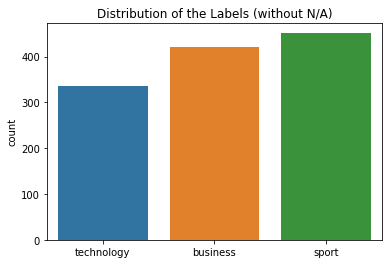

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


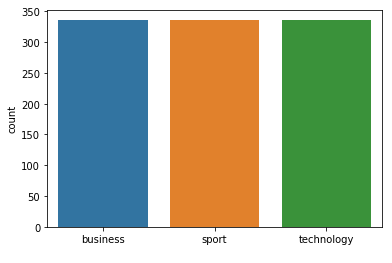



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 87
Class Distribution --> Train data (Fold 5 ):


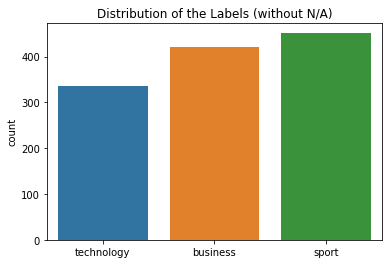

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


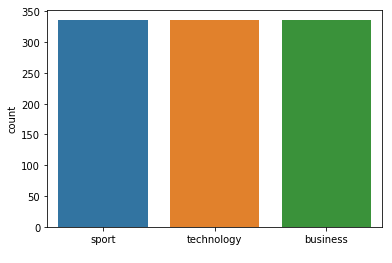



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 87
Class Distribution --> Train data (Fold 6 ):


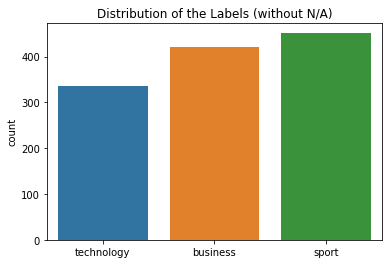

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


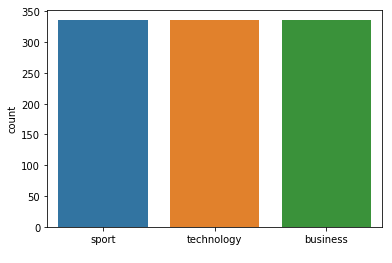



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 87
Class Distribution --> Train data (Fold 7 ):


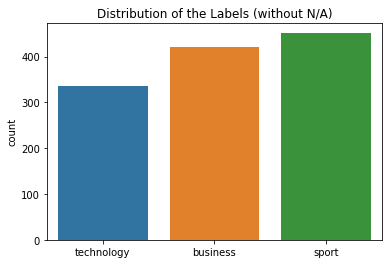

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


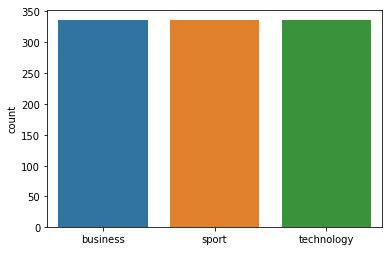



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 87  neighbours): 96.85% (+/- 1.05%)
FOLD 1 Number of neighbors 89
Class Distribution --> Train data (Fold 1 ):


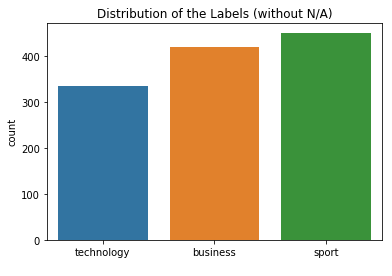

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


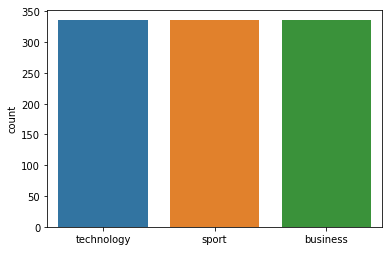



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 89
Class Distribution --> Train data (Fold 2 ):


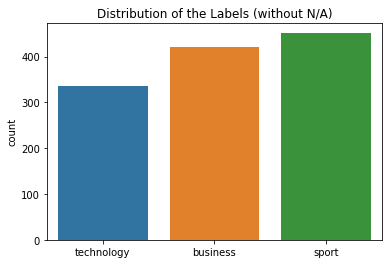

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


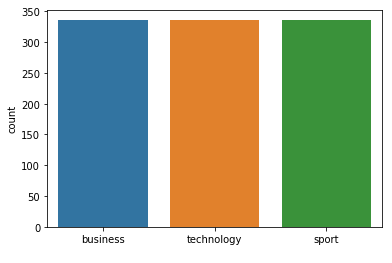



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 89
Class Distribution --> Train data (Fold 3 ):


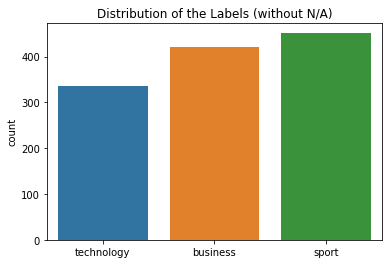

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


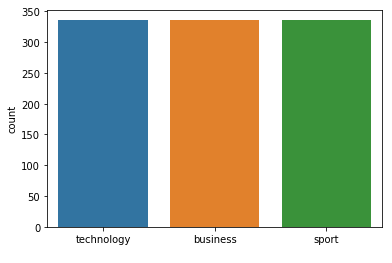



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 89
Class Distribution --> Train data (Fold 4 ):


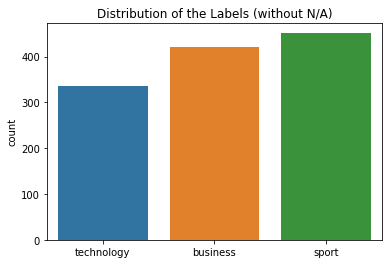

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


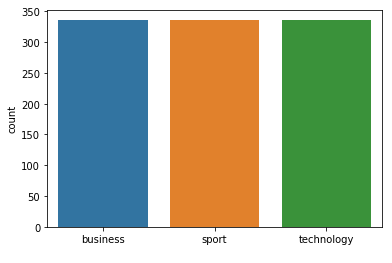



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 89
Class Distribution --> Train data (Fold 5 ):


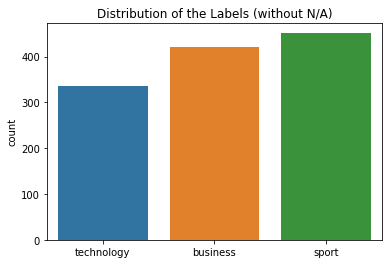

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


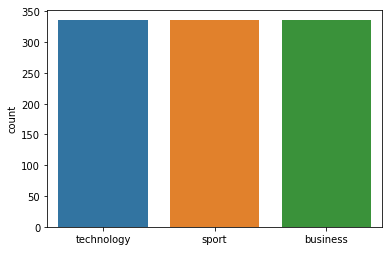



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 89
Class Distribution --> Train data (Fold 6 ):


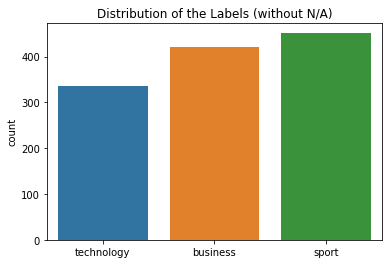

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


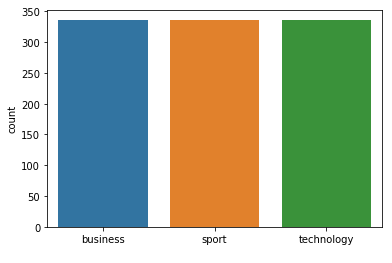



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 89
Class Distribution --> Train data (Fold 7 ):


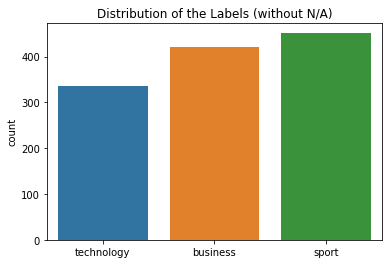

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


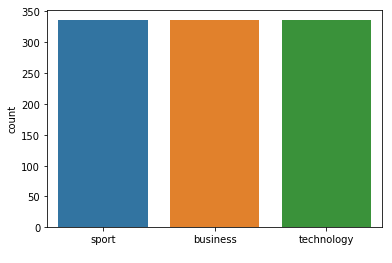



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 89  neighbours): 96.86% (+/- 1.05%)
FOLD 1 Number of neighbors 91
Class Distribution --> Train data (Fold 1 ):


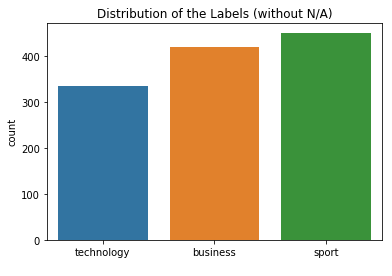

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


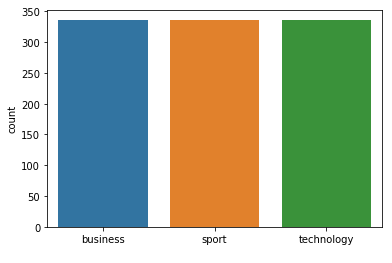



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        71
     sport
       0.99      1.00      0.99        76
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[68  0  3]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 91
Class Distribution --> Train data (Fold 2 ):


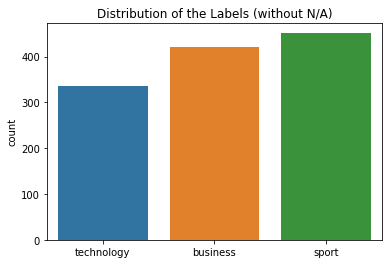

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


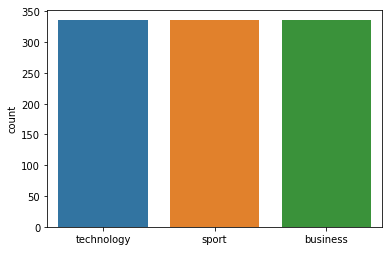



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 91
Class Distribution --> Train data (Fold 3 ):


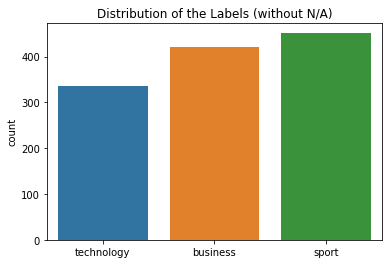

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


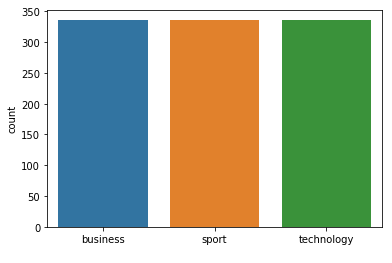



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 91
Class Distribution --> Train data (Fold 4 ):


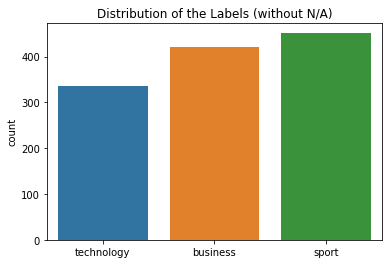

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


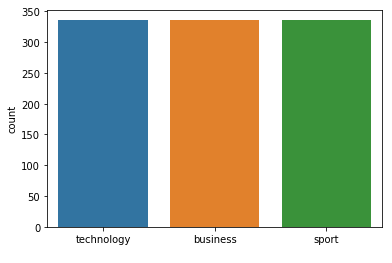



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 91
Class Distribution --> Train data (Fold 5 ):


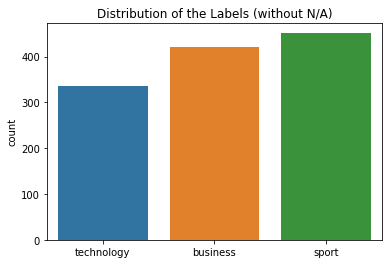

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


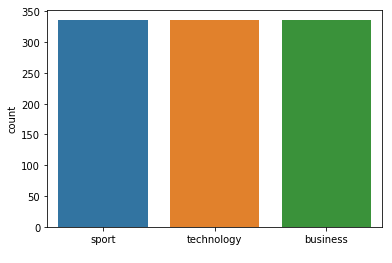



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 91
Class Distribution --> Train data (Fold 6 ):


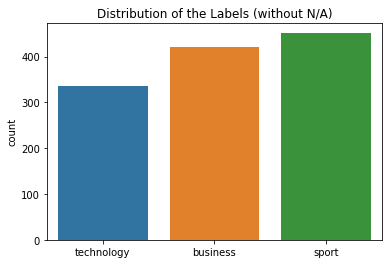

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


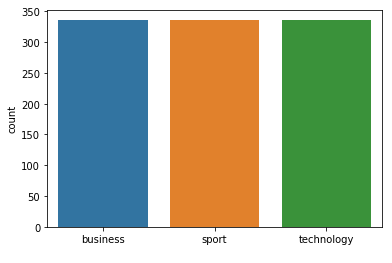



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 91
Class Distribution --> Train data (Fold 7 ):


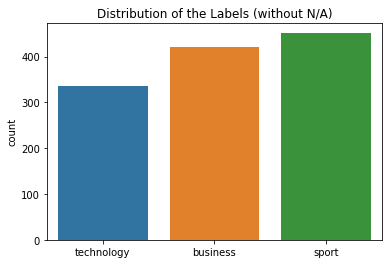

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


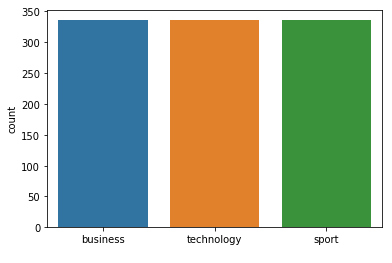



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 91  neighbours): 96.86% (+/- 1.04%)
FOLD 1 Number of neighbors 93
Class Distribution --> Train data (Fold 1 ):


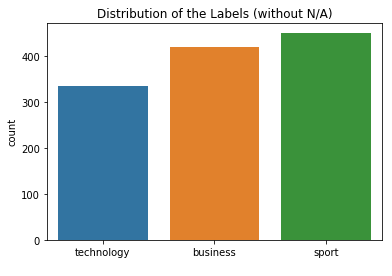

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


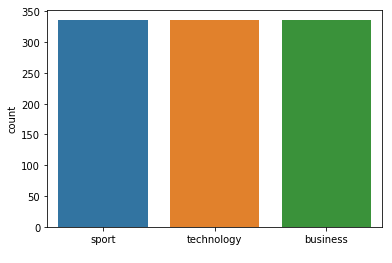



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 93
Class Distribution --> Train data (Fold 2 ):


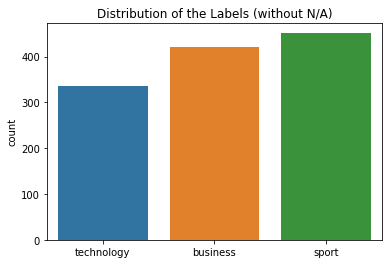

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


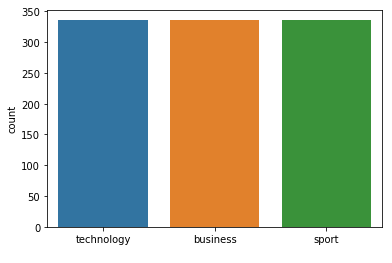



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 93
Class Distribution --> Train data (Fold 3 ):


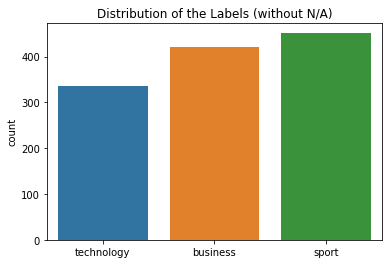

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


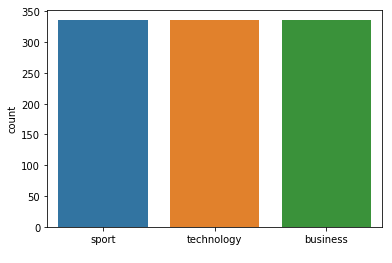



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 93
Class Distribution --> Train data (Fold 4 ):


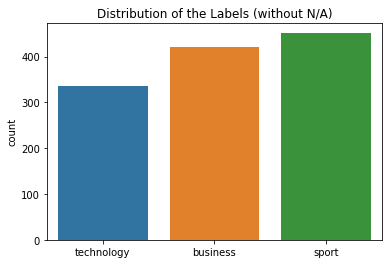

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


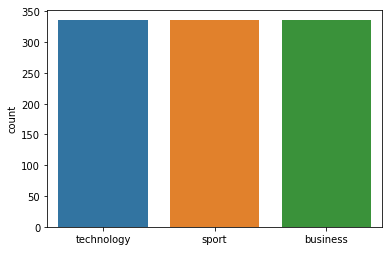



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 93
Class Distribution --> Train data (Fold 5 ):


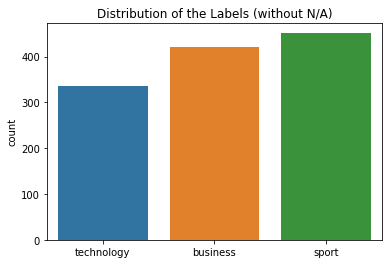

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


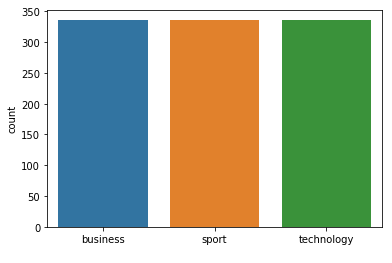



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 93
Class Distribution --> Train data (Fold 6 ):


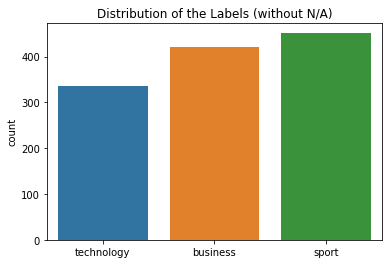

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


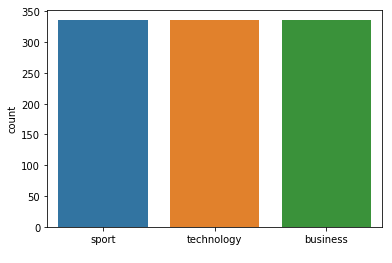



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 93
Class Distribution --> Train data (Fold 7 ):


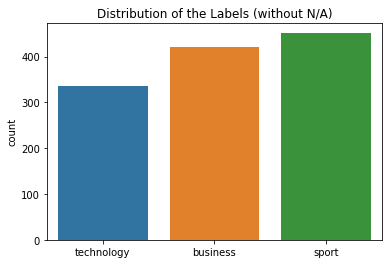

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


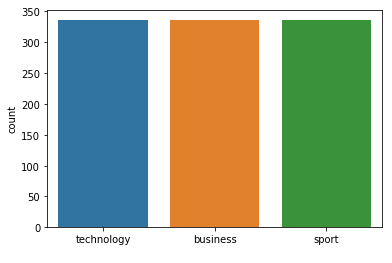



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 93  neighbours): 96.87% (+/- 1.04%)
FOLD 1 Number of neighbors 95
Class Distribution --> Train data (Fold 1 ):


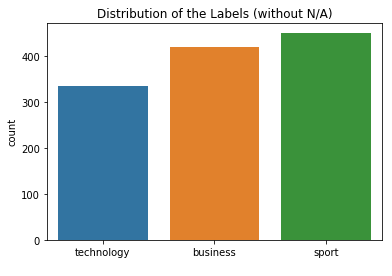

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


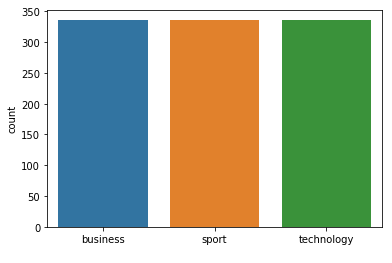



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 95
Class Distribution --> Train data (Fold 2 ):


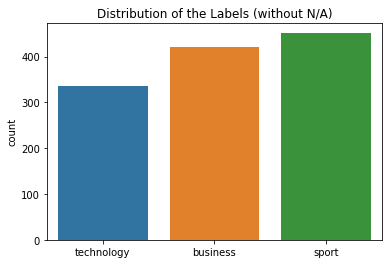

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


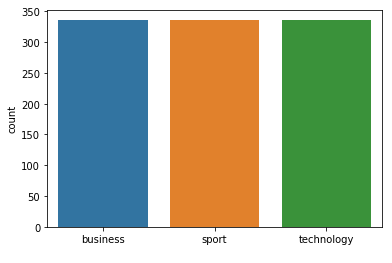



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.96      0.96        75
technology
       0.95      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 72  1]
 [ 0  2 54]]
FOLD 3 Number of neighbors 95
Class Distribution --> Train data (Fold 3 ):


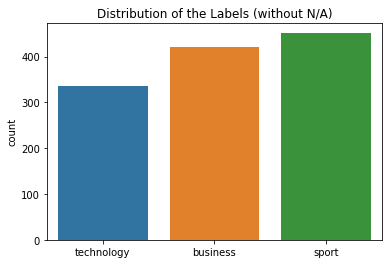

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


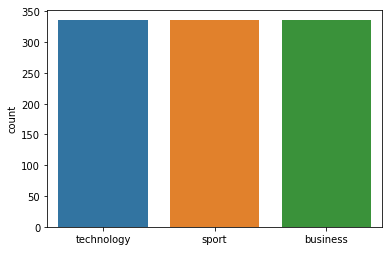



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.90      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 95
Class Distribution --> Train data (Fold 4 ):


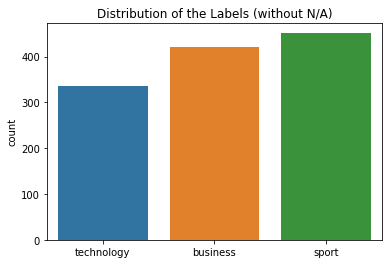

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


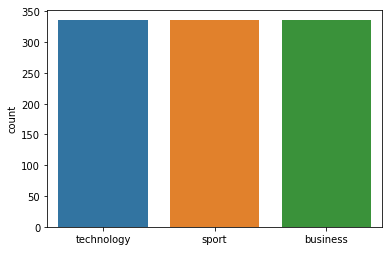



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 95
Class Distribution --> Train data (Fold 5 ):


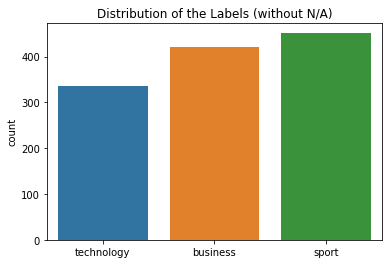

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


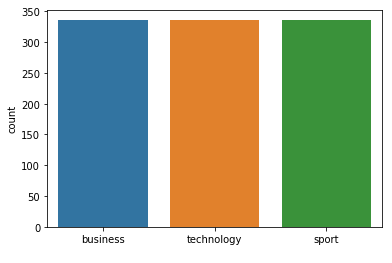



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 95
Class Distribution --> Train data (Fold 6 ):


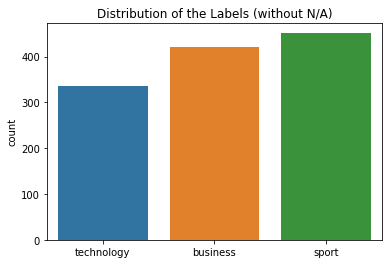

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


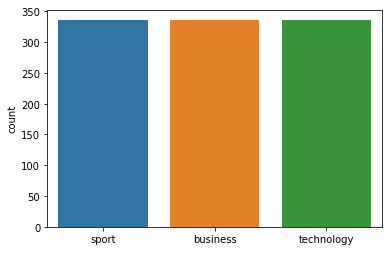



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 95
Class Distribution --> Train data (Fold 7 ):


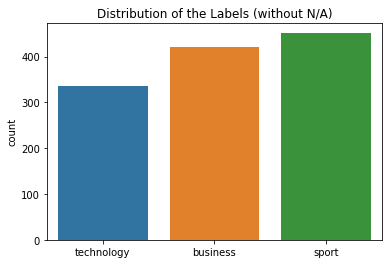

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


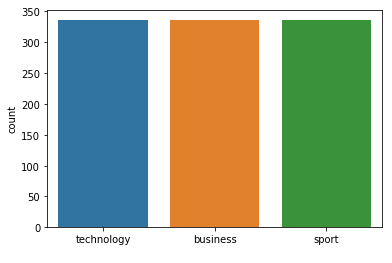



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.98      0.96        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 95  neighbours): 96.87% (+/- 1.04%)
FOLD 1 Number of neighbors 97
Class Distribution --> Train data (Fold 1 ):


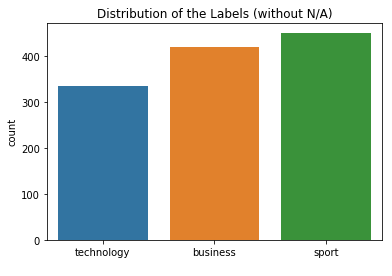

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


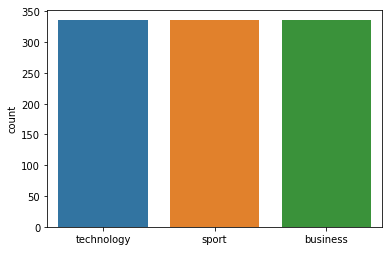



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 97
Class Distribution --> Train data (Fold 2 ):


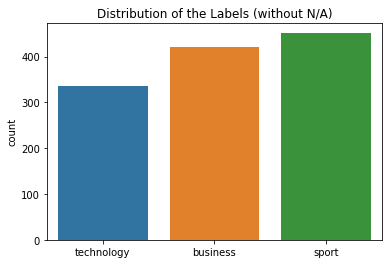

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


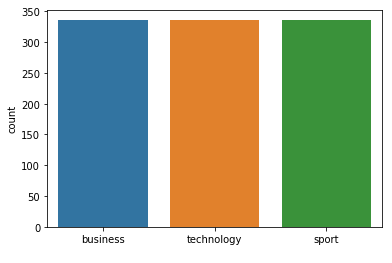



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.95      0.95        75
technology
       0.95      0.96      0.96        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 3 71  1]
 [ 0  2 54]]
FOLD 3 Number of neighbors 97
Class Distribution --> Train data (Fold 3 ):


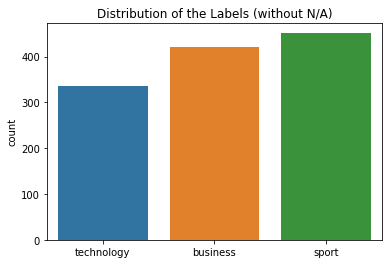

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


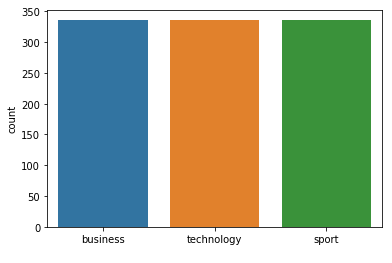



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 97
Class Distribution --> Train data (Fold 4 ):


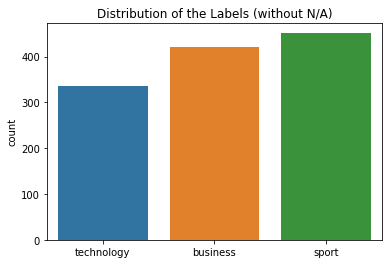

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


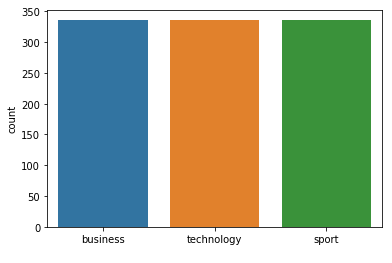



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 97
Class Distribution --> Train data (Fold 5 ):


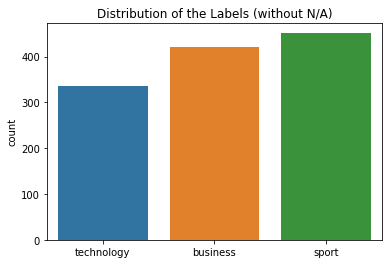

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


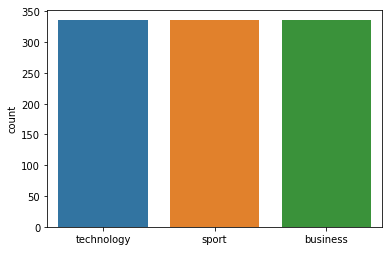



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 97
Class Distribution --> Train data (Fold 6 ):


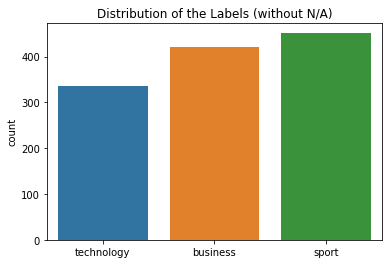

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


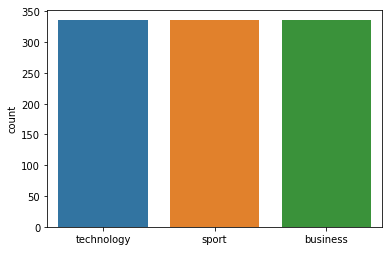



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 97
Class Distribution --> Train data (Fold 7 ):


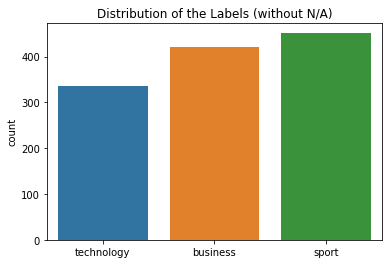

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


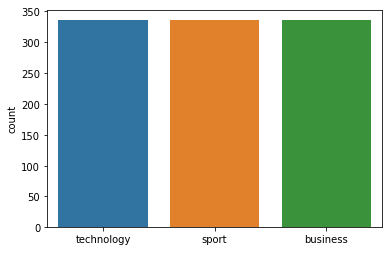



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 97  neighbours): 96.88% (+/- 1.04%)
FOLD 1 Number of neighbors 99
Class Distribution --> Train data (Fold 1 ):


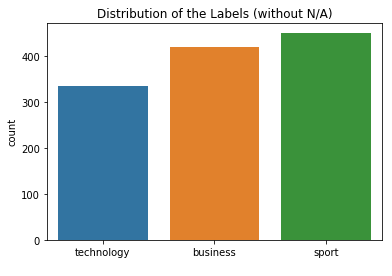

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


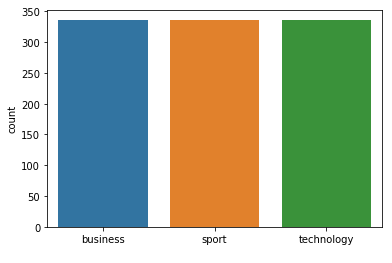



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 99
Class Distribution --> Train data (Fold 2 ):


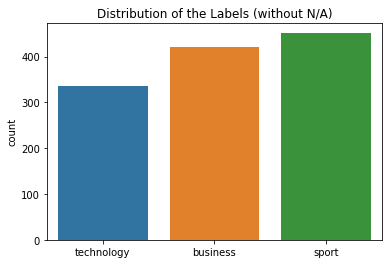

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


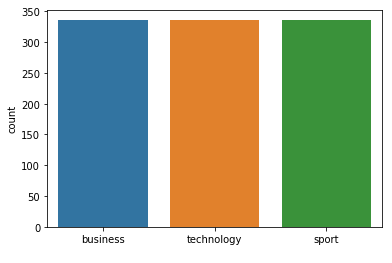



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 99
Class Distribution --> Train data (Fold 3 ):


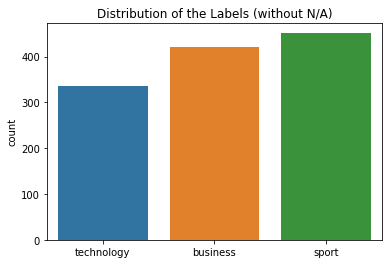

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


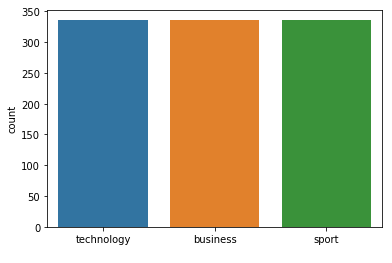



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 99
Class Distribution --> Train data (Fold 4 ):


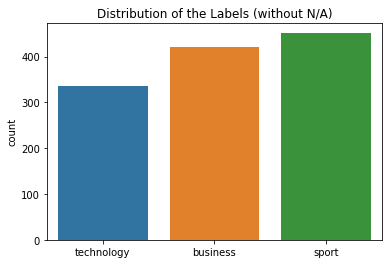

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


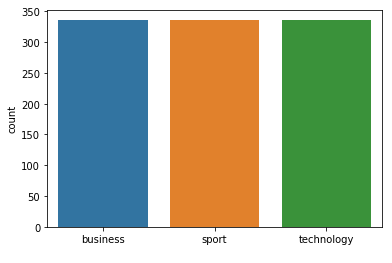



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 99
Class Distribution --> Train data (Fold 5 ):


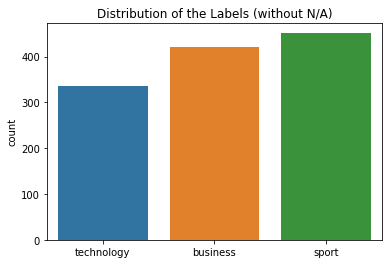

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


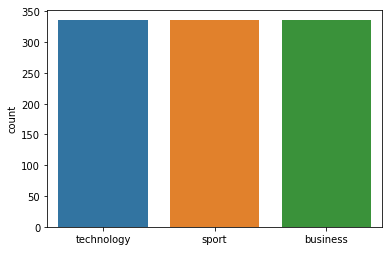



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 99
Class Distribution --> Train data (Fold 6 ):


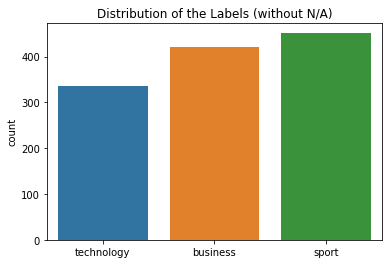

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


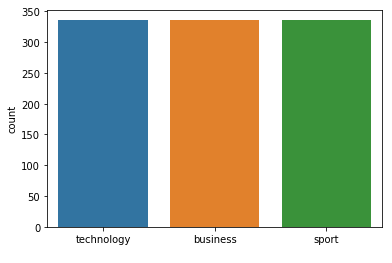



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 99
Class Distribution --> Train data (Fold 7 ):


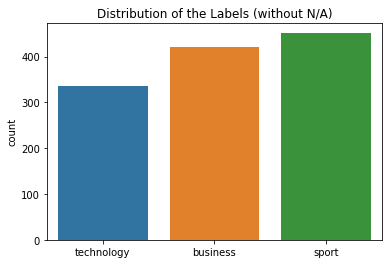

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


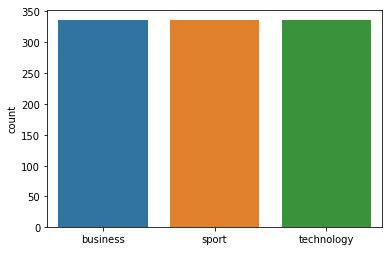



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 99  neighbours): 96.88% (+/- 1.04%)
FOLD 1 Number of neighbors 101
Class Distribution --> Train data (Fold 1 ):


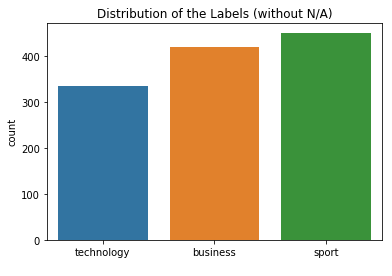

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


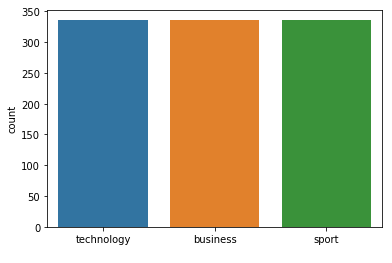



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 101
Class Distribution --> Train data (Fold 2 ):


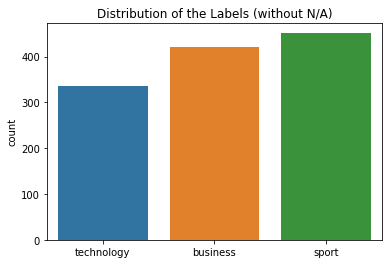

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


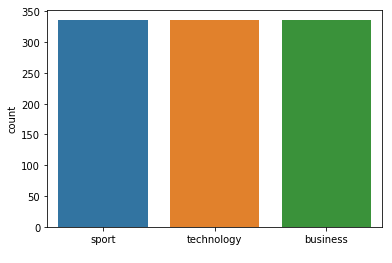



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 101
Class Distribution --> Train data (Fold 3 ):


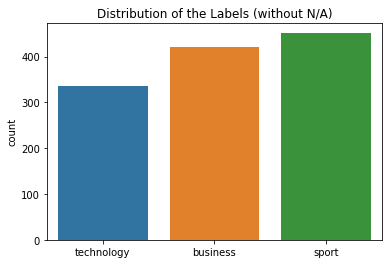

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


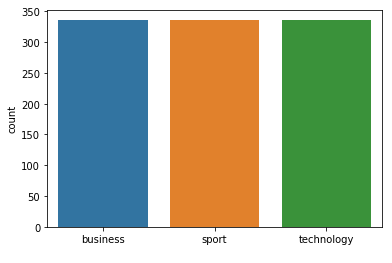



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.99      1.00      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 101
Class Distribution --> Train data (Fold 4 ):


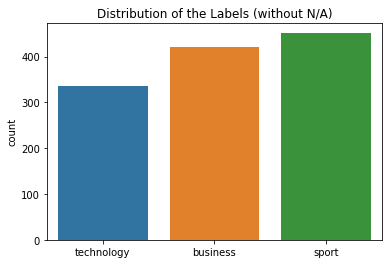

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


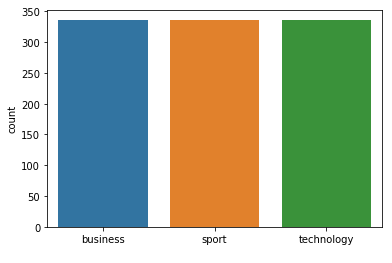



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 101
Class Distribution --> Train data (Fold 5 ):


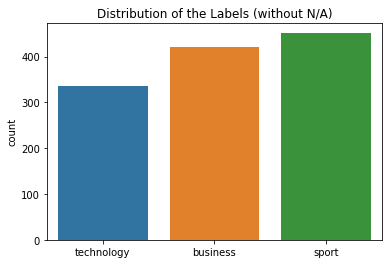

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


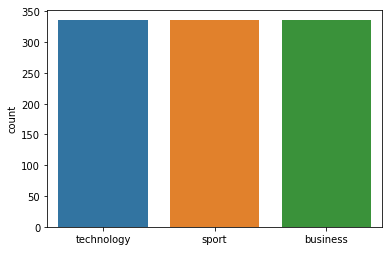



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 101
Class Distribution --> Train data (Fold 6 ):


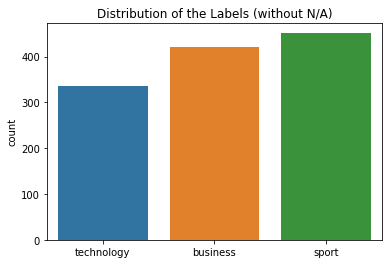

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


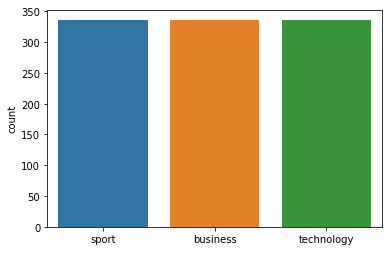



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 101
Class Distribution --> Train data (Fold 7 ):


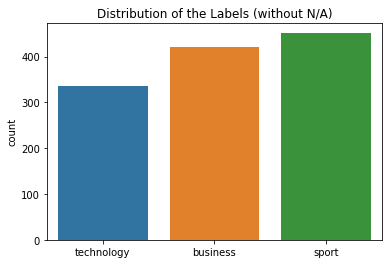

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


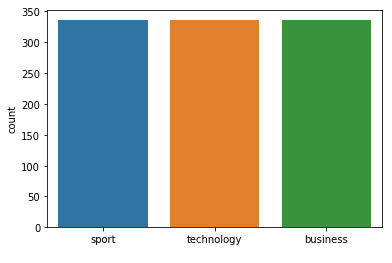



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.98      0.96        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[64  2  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 101  neighbours): 96.89% (+/- 1.04%)
FOLD 1 Number of neighbors 103
Class Distribution --> Train data (Fold 1 ):


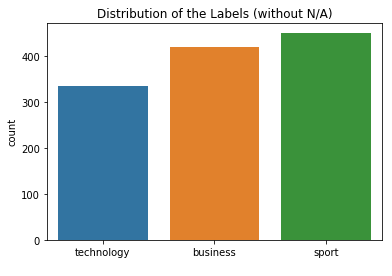

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


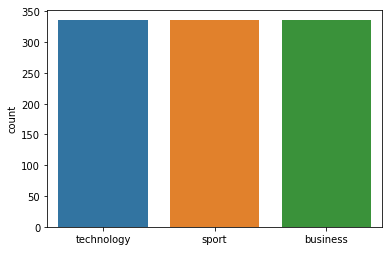



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 103
Class Distribution --> Train data (Fold 2 ):


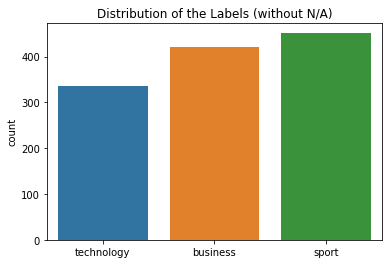

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


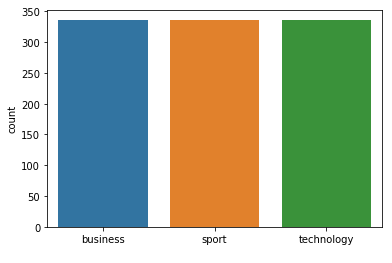



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 103
Class Distribution --> Train data (Fold 3 ):


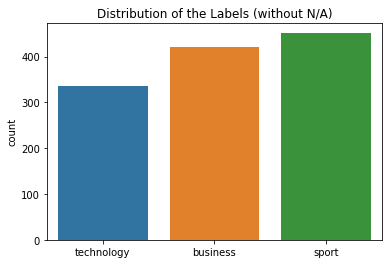

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


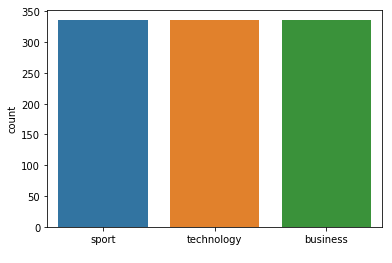



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.91      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 4 Number of neighbors 103
Class Distribution --> Train data (Fold 4 ):


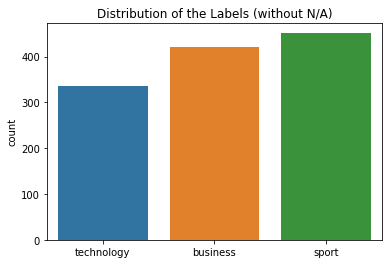

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


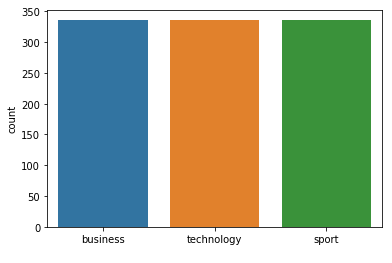



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 103
Class Distribution --> Train data (Fold 5 ):


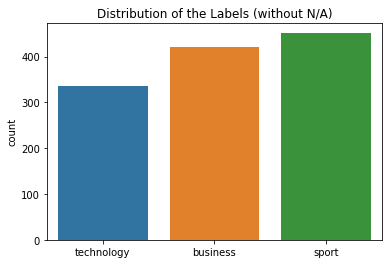

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


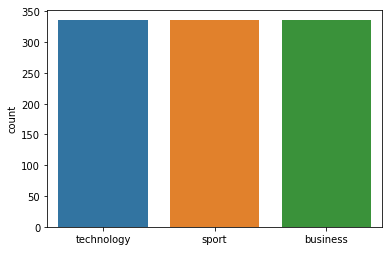



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 103
Class Distribution --> Train data (Fold 6 ):


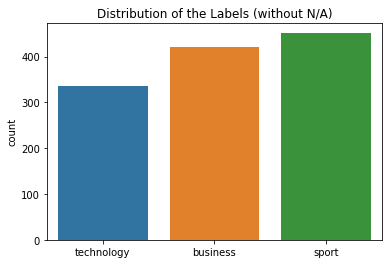

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


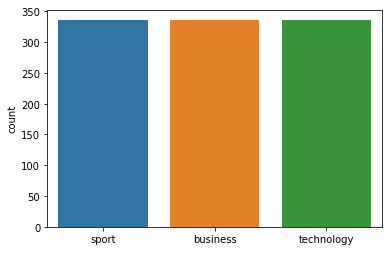



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7 Number of neighbors 103
Class Distribution --> Train data (Fold 7 ):


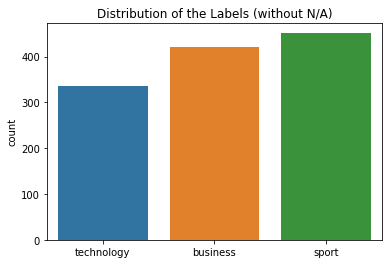

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


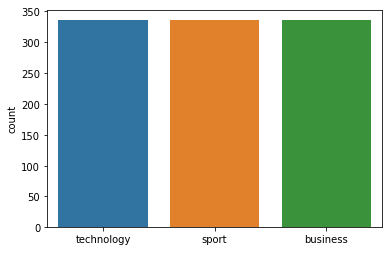



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 103  neighbours): 96.90% (+/- 1.03%)
FOLD 1 Number of neighbors 105
Class Distribution --> Train data (Fold 1 ):


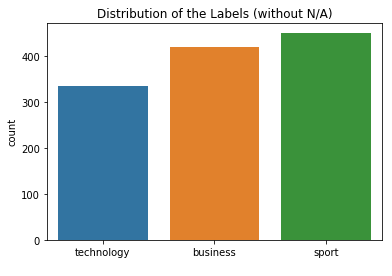

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


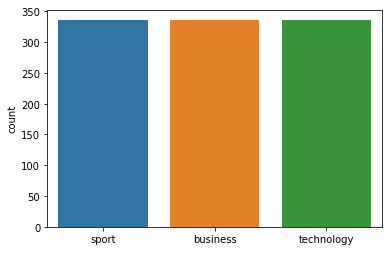



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 105
Class Distribution --> Train data (Fold 2 ):


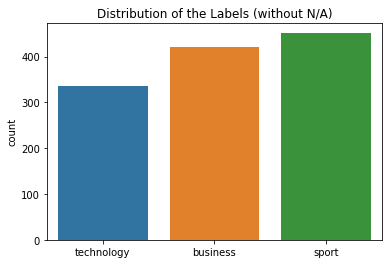

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


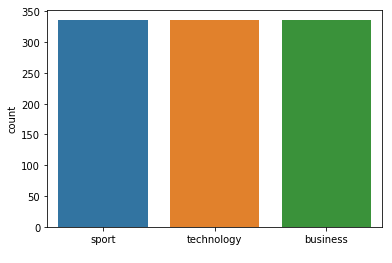



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 105
Class Distribution --> Train data (Fold 3 ):


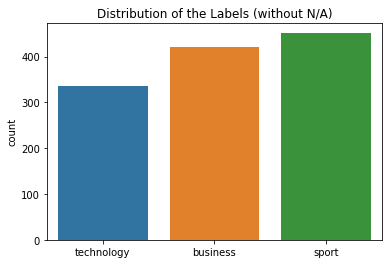

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


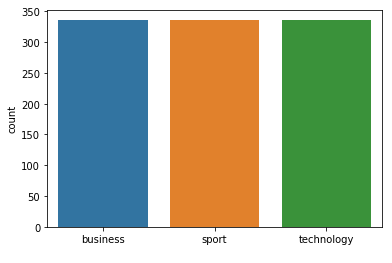



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.90      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 105
Class Distribution --> Train data (Fold 4 ):


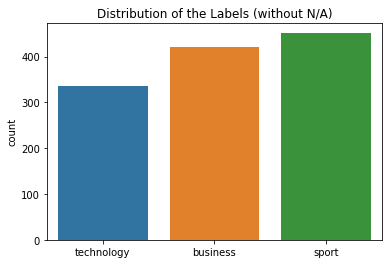

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


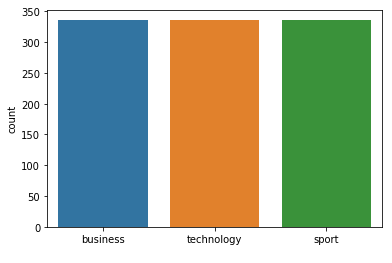



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 105
Class Distribution --> Train data (Fold 5 ):


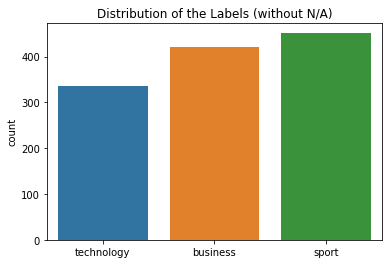

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


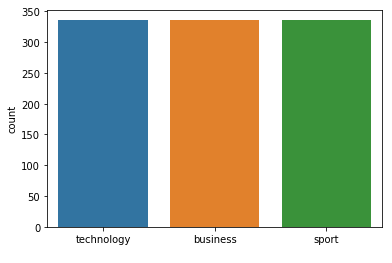



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 105
Class Distribution --> Train data (Fold 6 ):


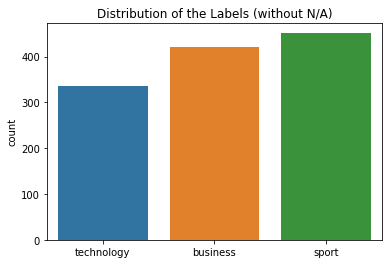

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


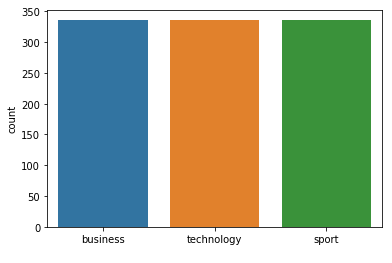



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 105
Class Distribution --> Train data (Fold 7 ):


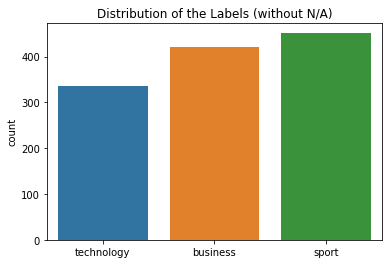

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


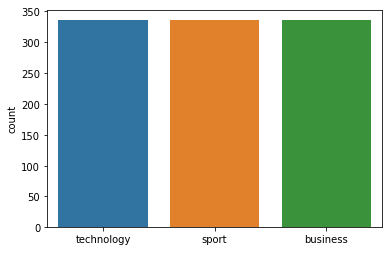



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 105  neighbours): 96.90% (+/- 1.03%)
FOLD 1 Number of neighbors 107
Class Distribution --> Train data (Fold 1 ):


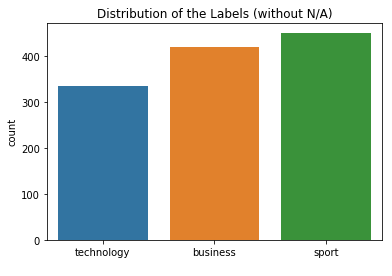

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


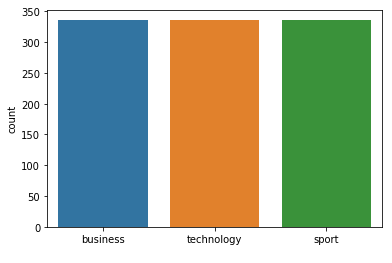



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 107
Class Distribution --> Train data (Fold 2 ):


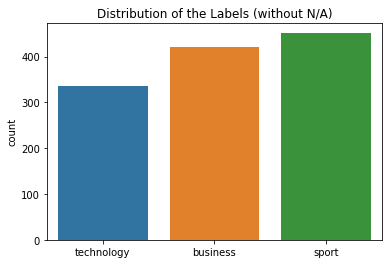

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


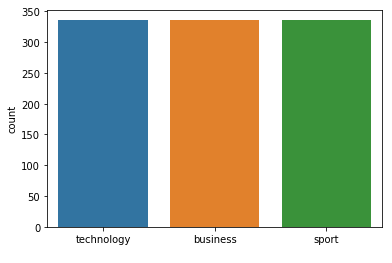



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 107
Class Distribution --> Train data (Fold 3 ):


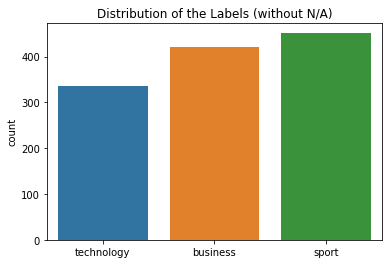

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


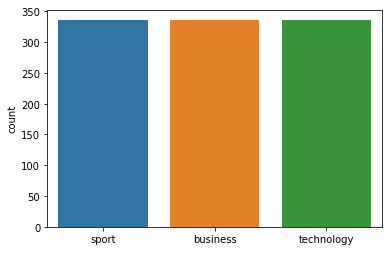



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.90      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 107
Class Distribution --> Train data (Fold 4 ):


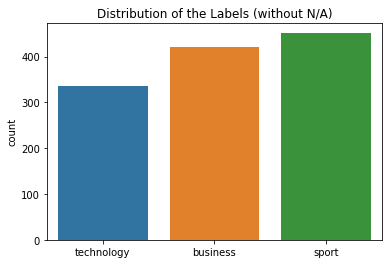

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


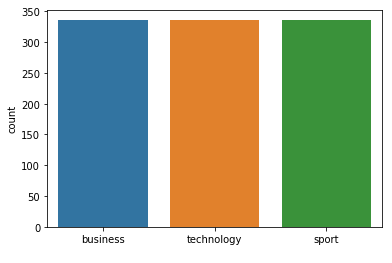



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 107
Class Distribution --> Train data (Fold 5 ):


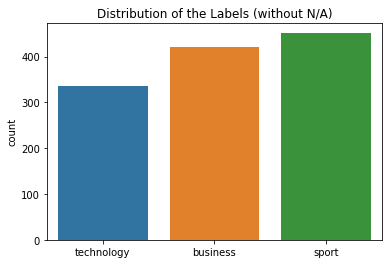

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


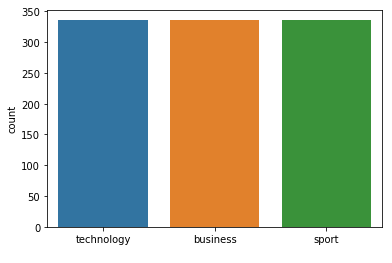



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 107
Class Distribution --> Train data (Fold 6 ):


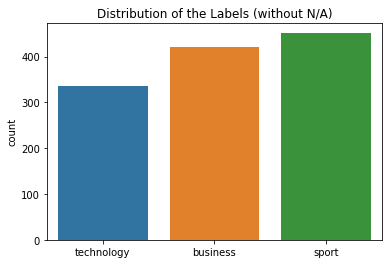

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


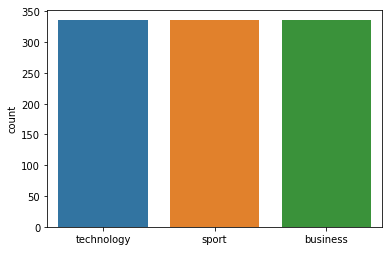



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 107
Class Distribution --> Train data (Fold 7 ):


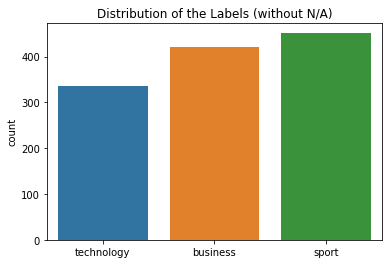

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


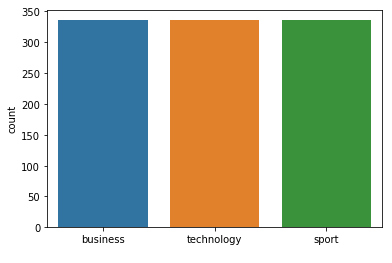



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 107  neighbours): 96.91% (+/- 1.03%)
FOLD 1 Number of neighbors 109
Class Distribution --> Train data (Fold 1 ):


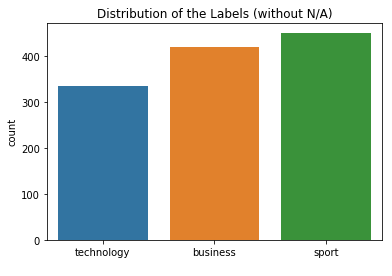

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


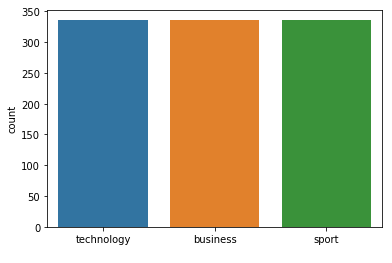



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 109
Class Distribution --> Train data (Fold 2 ):


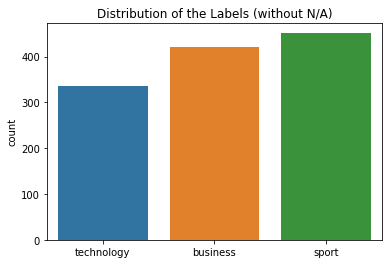

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


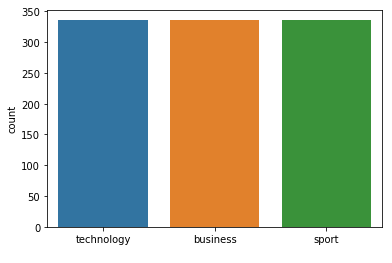



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 109
Class Distribution --> Train data (Fold 3 ):


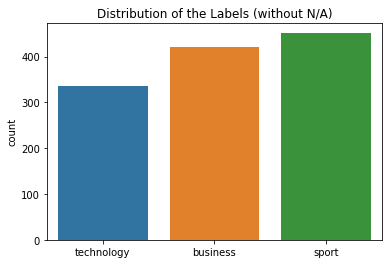

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


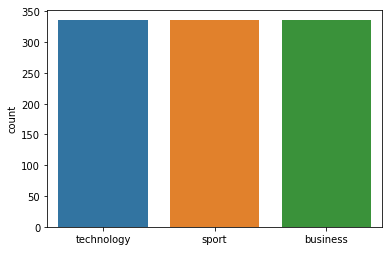



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.90      0.95        70
     sport
       0.96      1.00      0.98        75
technology
       0.92      0.98      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 4 Number of neighbors 109
Class Distribution --> Train data (Fold 4 ):


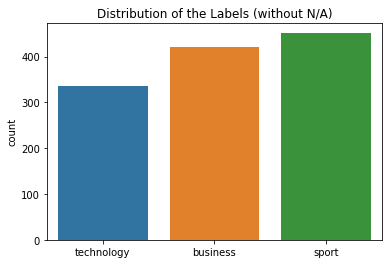

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


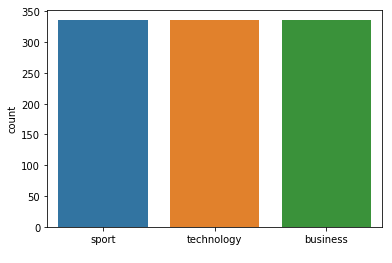



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 109
Class Distribution --> Train data (Fold 5 ):


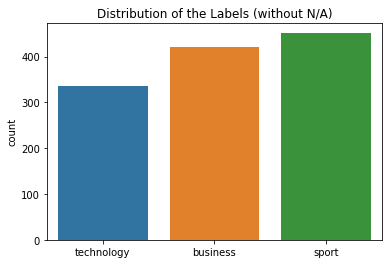

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


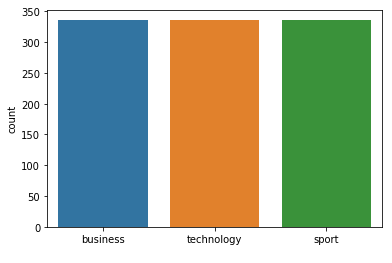



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 109
Class Distribution --> Train data (Fold 6 ):


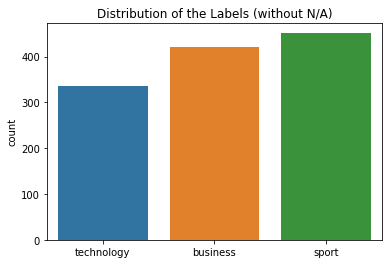

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


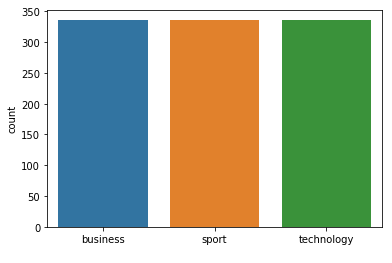



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 109
Class Distribution --> Train data (Fold 7 ):


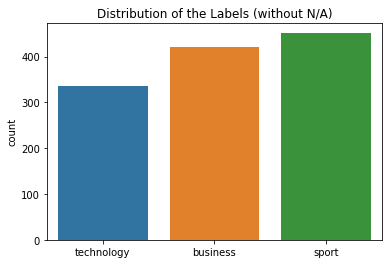

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


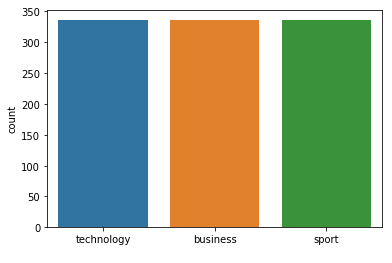



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  2  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 109  neighbours): 96.91% (+/- 1.03%)
FOLD 1 Number of neighbors 111
Class Distribution --> Train data (Fold 1 ):


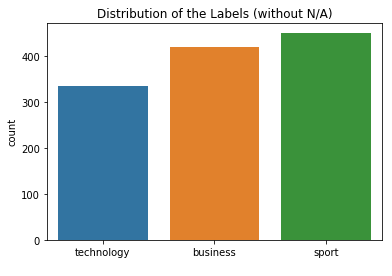

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


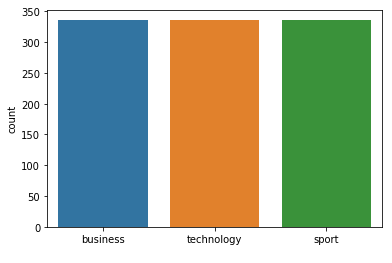



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 111
Class Distribution --> Train data (Fold 2 ):


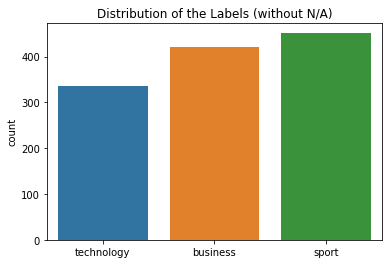

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


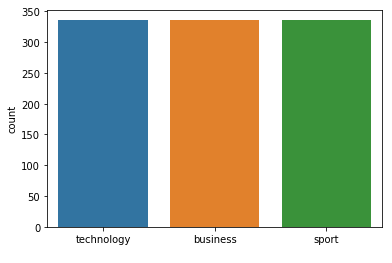



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 111
Class Distribution --> Train data (Fold 3 ):


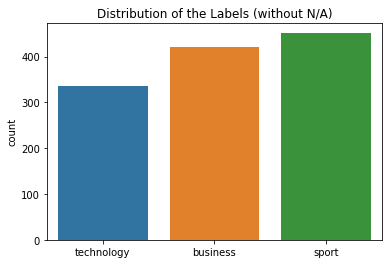

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


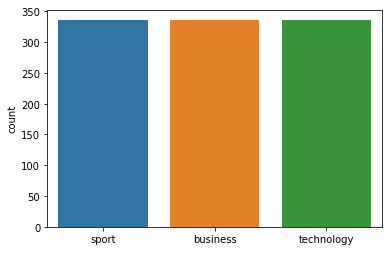



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.91      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 4 Number of neighbors 111
Class Distribution --> Train data (Fold 4 ):


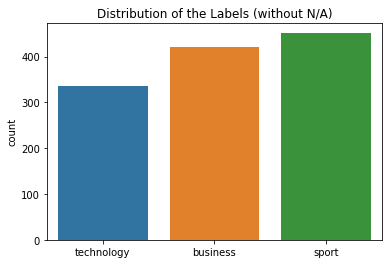

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


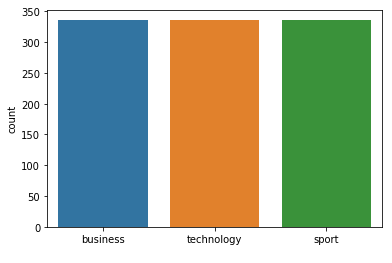



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 111
Class Distribution --> Train data (Fold 5 ):


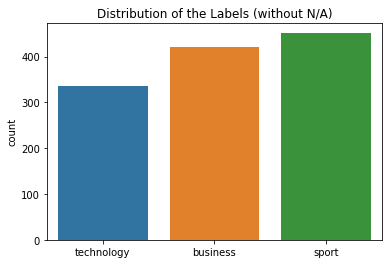

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


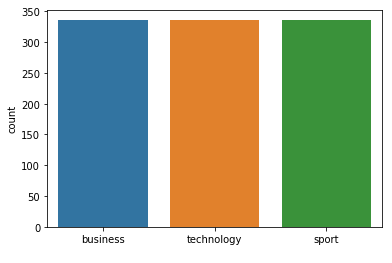



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 111
Class Distribution --> Train data (Fold 6 ):


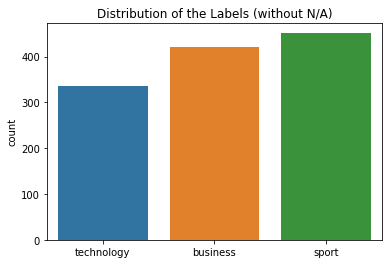

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


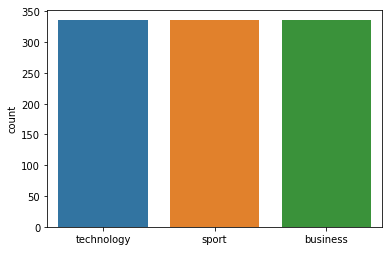



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 111
Class Distribution --> Train data (Fold 7 ):


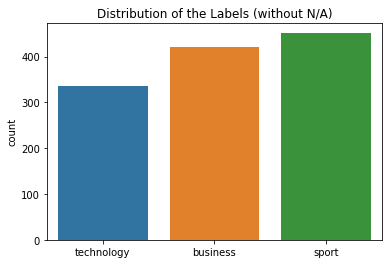

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


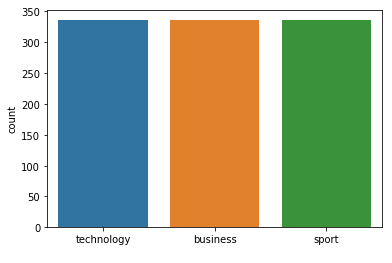



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.98      0.96        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 111  neighbours): 96.92% (+/- 1.03%)
FOLD 1 Number of neighbors 113
Class Distribution --> Train data (Fold 1 ):


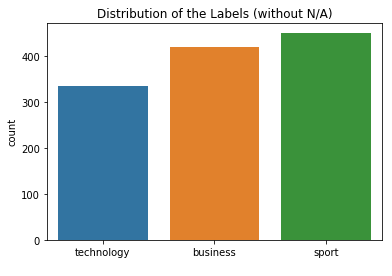

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


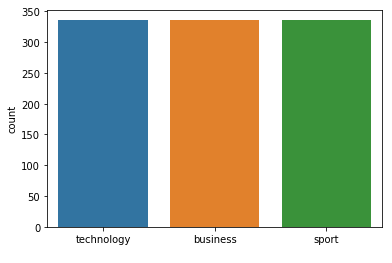



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 113
Class Distribution --> Train data (Fold 2 ):


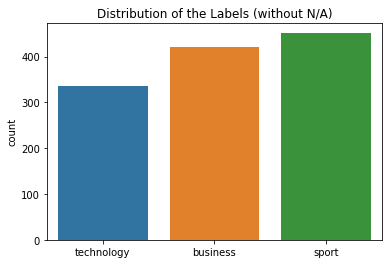

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


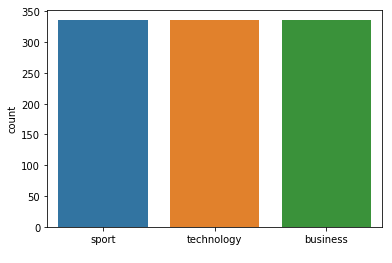



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 113
Class Distribution --> Train data (Fold 3 ):


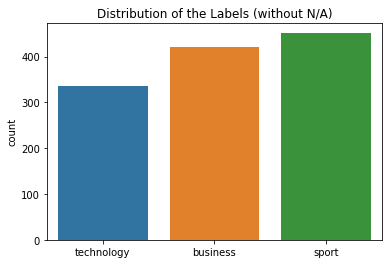

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


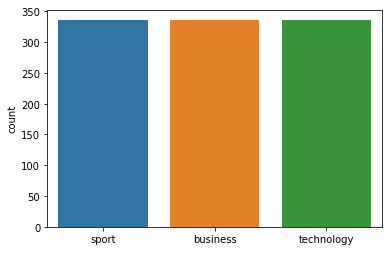



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  0 54]]
FOLD 4 Number of neighbors 113
Class Distribution --> Train data (Fold 4 ):


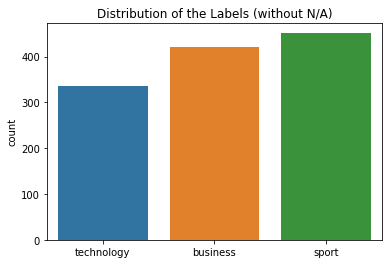

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


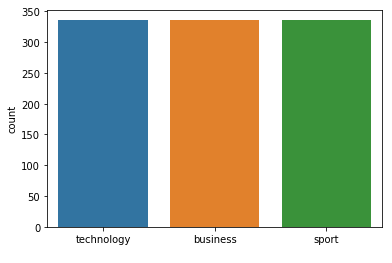



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 113
Class Distribution --> Train data (Fold 5 ):


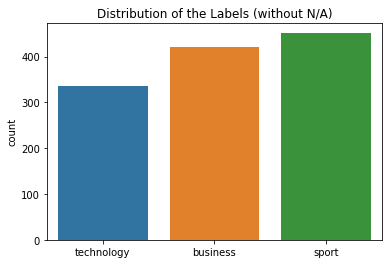

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


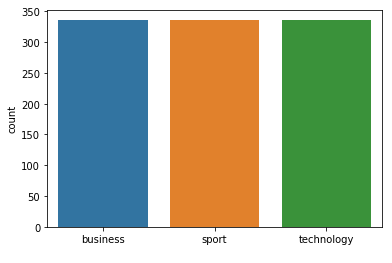



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 113
Class Distribution --> Train data (Fold 6 ):


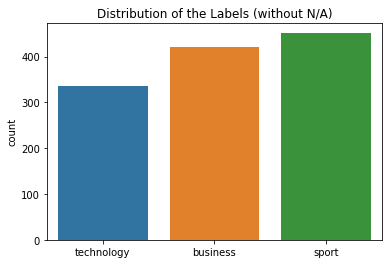

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


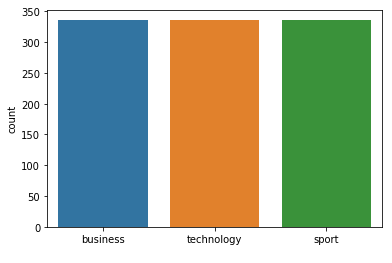



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 113
Class Distribution --> Train data (Fold 7 ):


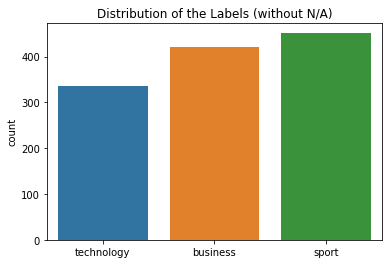

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


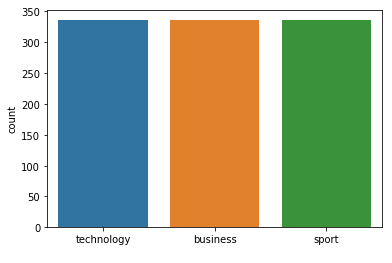



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 113  neighbours): 96.92% (+/- 1.03%)
FOLD 1 Number of neighbors 115
Class Distribution --> Train data (Fold 1 ):


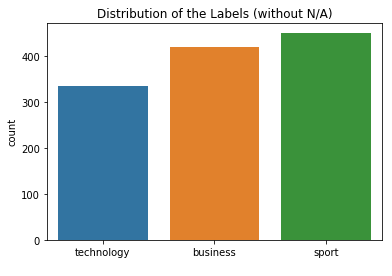

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


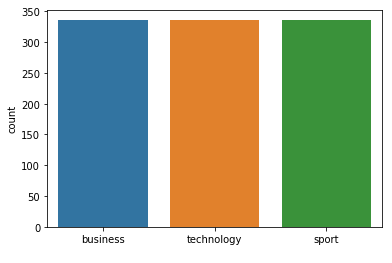



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 115
Class Distribution --> Train data (Fold 2 ):


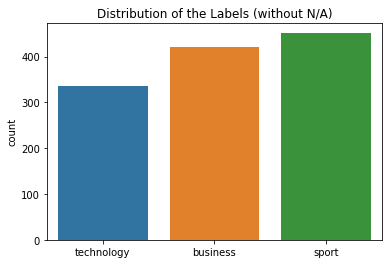

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


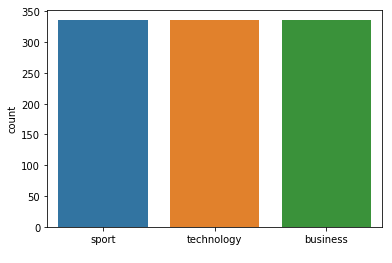



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 115
Class Distribution --> Train data (Fold 3 ):


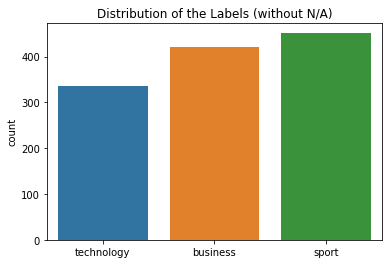

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


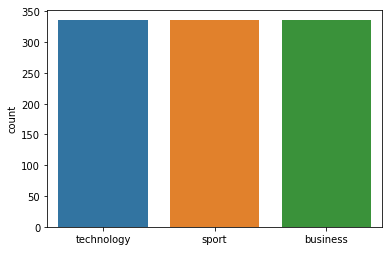



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.91      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 4 Number of neighbors 115
Class Distribution --> Train data (Fold 4 ):


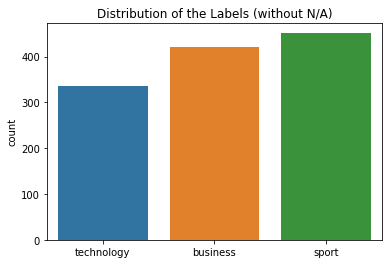

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


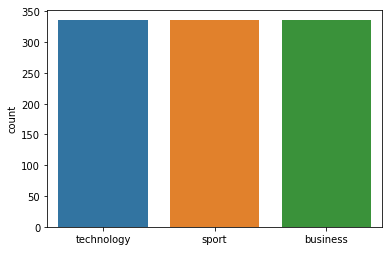



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 115
Class Distribution --> Train data (Fold 5 ):


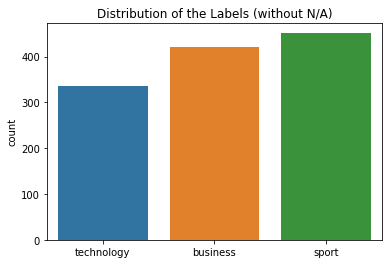

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


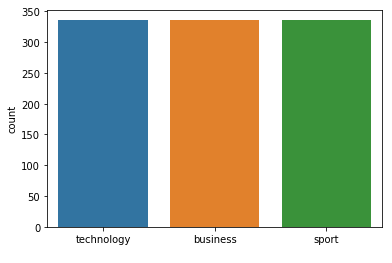



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 115
Class Distribution --> Train data (Fold 6 ):


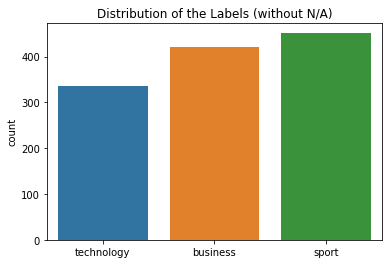

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


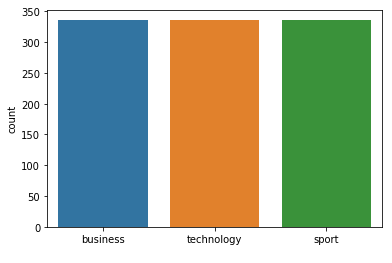



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 115
Class Distribution --> Train data (Fold 7 ):


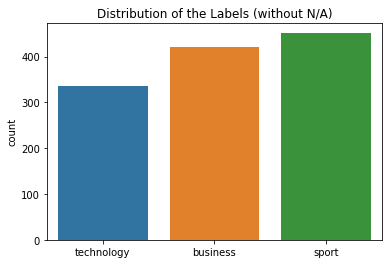

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


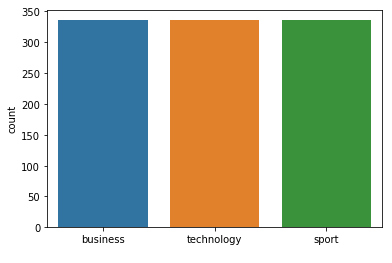



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 115  neighbours): 96.93% (+/- 1.03%)
FOLD 1 Number of neighbors 117
Class Distribution --> Train data (Fold 1 ):


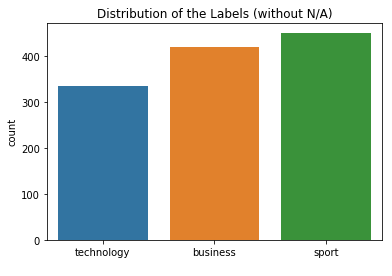

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


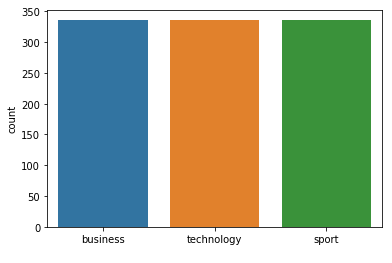



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 117
Class Distribution --> Train data (Fold 2 ):


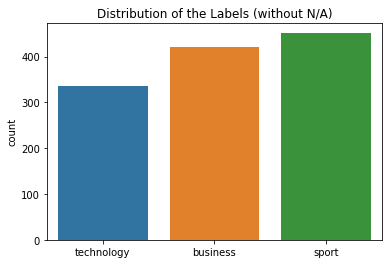

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


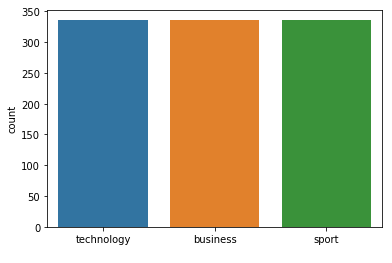



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 117
Class Distribution --> Train data (Fold 3 ):


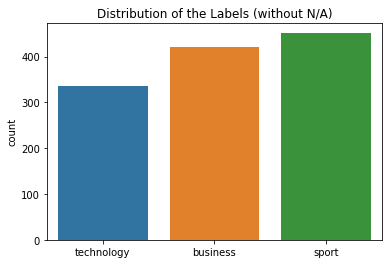

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


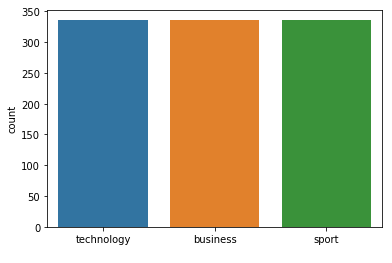



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 4 Number of neighbors 117
Class Distribution --> Train data (Fold 4 ):


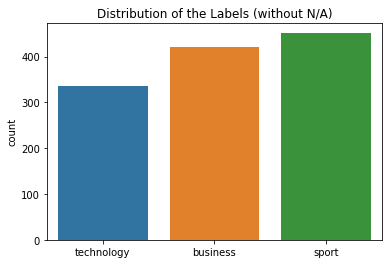

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


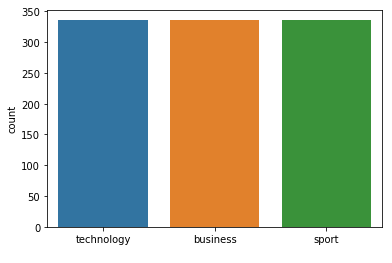



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 117
Class Distribution --> Train data (Fold 5 ):


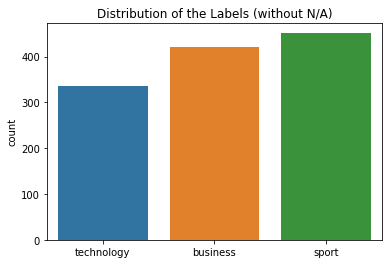

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


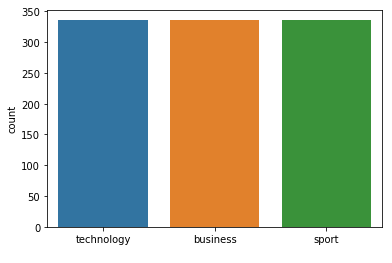



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 117
Class Distribution --> Train data (Fold 6 ):


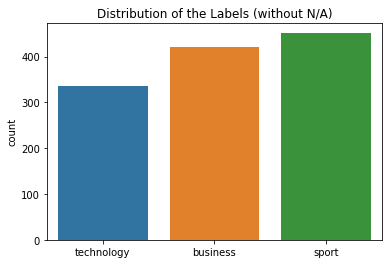

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


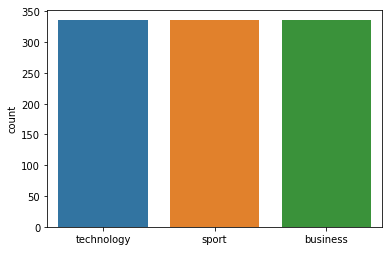



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       1.00      1.00      1.00        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  0  4]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 117
Class Distribution --> Train data (Fold 7 ):


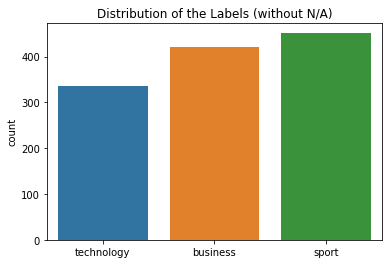

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


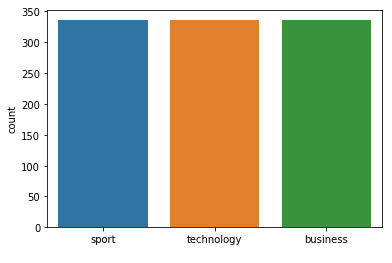



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 117  neighbours): 96.94% (+/- 1.03%)
FOLD 1 Number of neighbors 119
Class Distribution --> Train data (Fold 1 ):


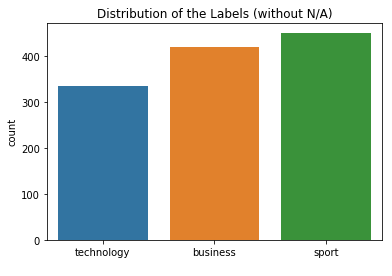

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


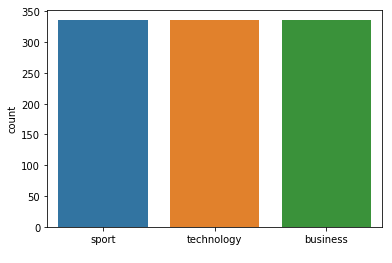



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 119
Class Distribution --> Train data (Fold 2 ):


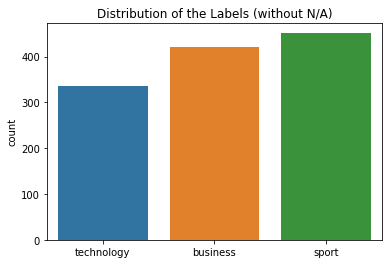

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


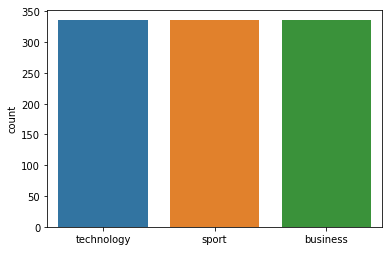



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 3 72  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 119
Class Distribution --> Train data (Fold 3 ):


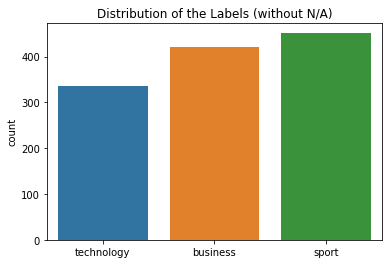

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


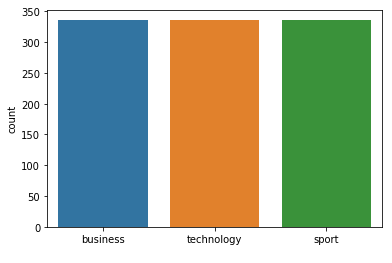



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 4 Number of neighbors 119
Class Distribution --> Train data (Fold 4 ):


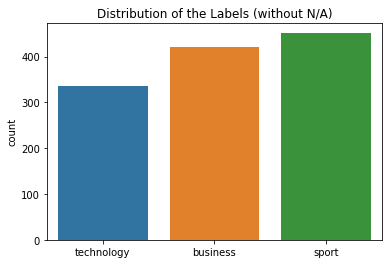

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


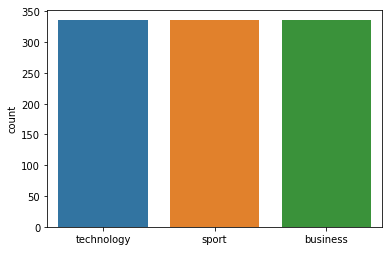



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 119
Class Distribution --> Train data (Fold 5 ):


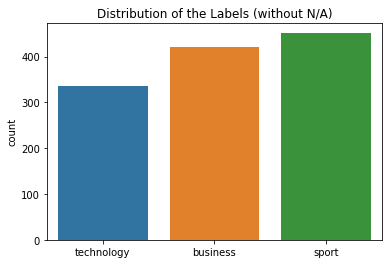

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


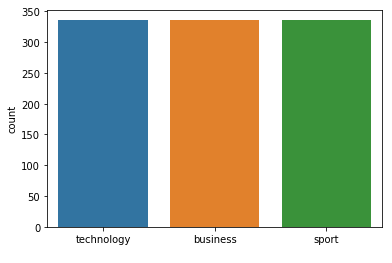



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 119
Class Distribution --> Train data (Fold 6 ):


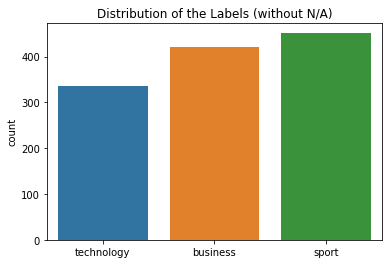

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


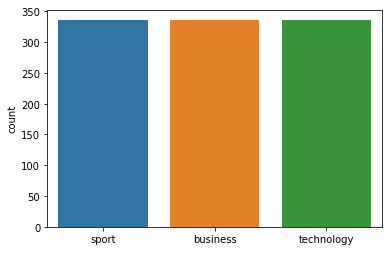



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 119
Class Distribution --> Train data (Fold 7 ):


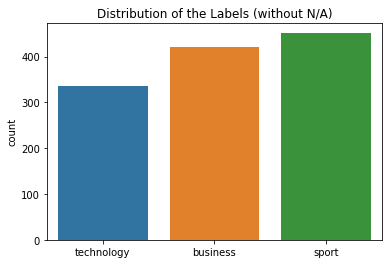

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


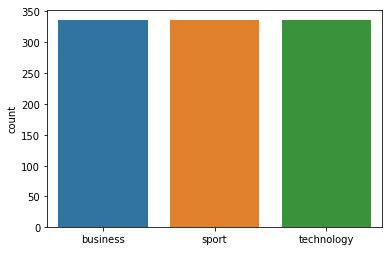



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 119  neighbours): 96.94% (+/- 1.02%)
FOLD 1 Number of neighbors 121
Class Distribution --> Train data (Fold 1 ):


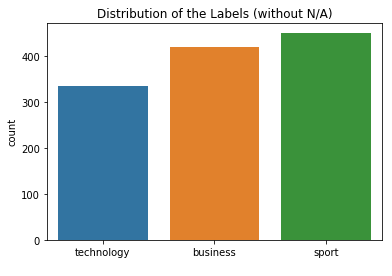

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


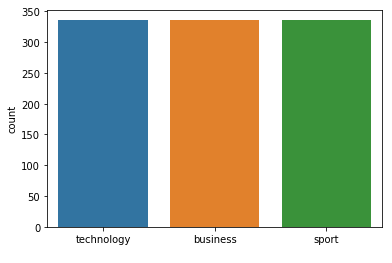



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 121
Class Distribution --> Train data (Fold 2 ):


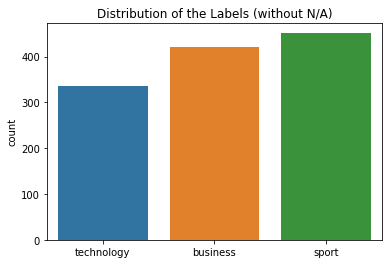

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


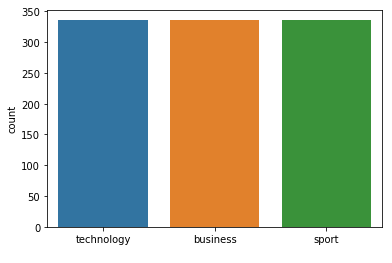



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 121
Class Distribution --> Train data (Fold 3 ):


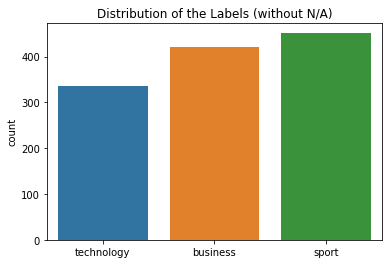

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


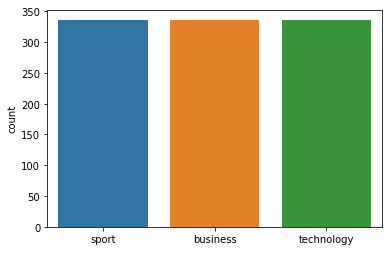



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.91      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.98      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 4 Number of neighbors 121
Class Distribution --> Train data (Fold 4 ):


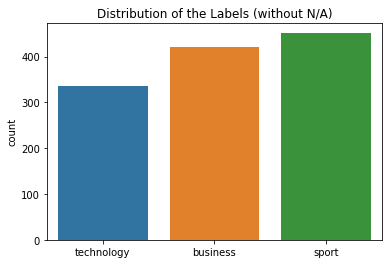

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


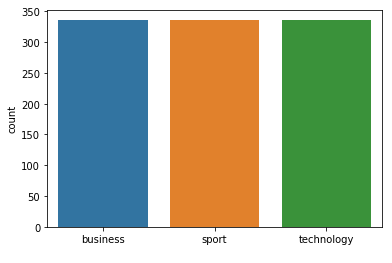



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 121
Class Distribution --> Train data (Fold 5 ):


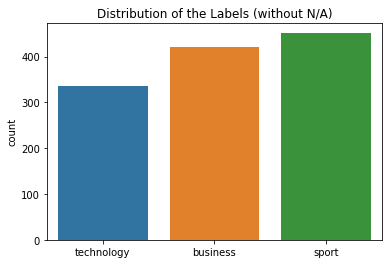

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


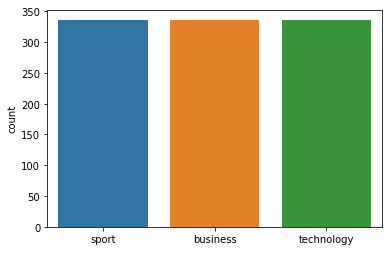



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 121
Class Distribution --> Train data (Fold 6 ):


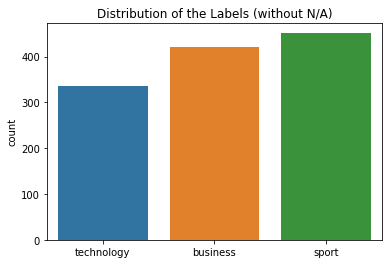

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


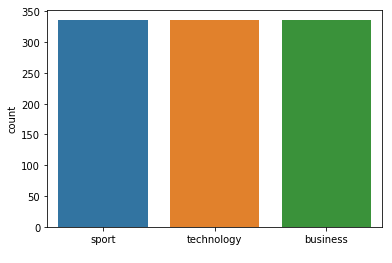



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 121
Class Distribution --> Train data (Fold 7 ):


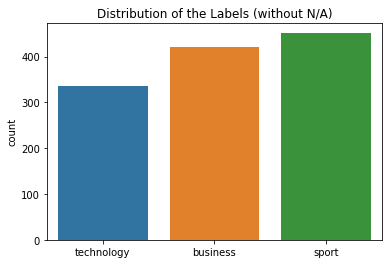

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


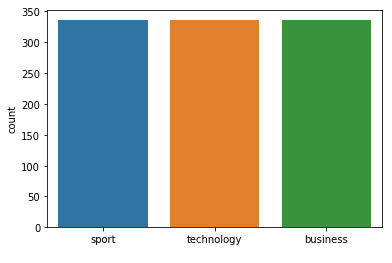



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 121  neighbours): 96.95% (+/- 1.02%)
FOLD 1 Number of neighbors 123
Class Distribution --> Train data (Fold 1 ):


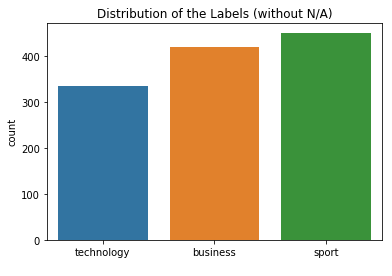

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


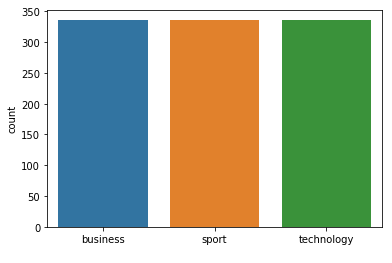



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 123
Class Distribution --> Train data (Fold 2 ):


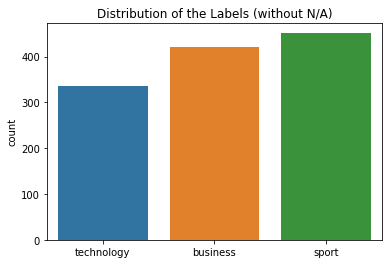

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


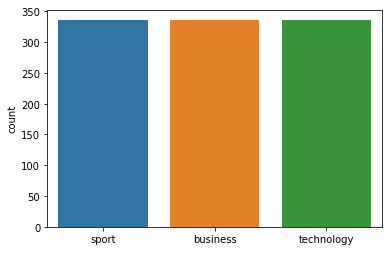



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.96      0.95        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 3 72  0]
 [ 0  2 54]]
FOLD 3 Number of neighbors 123
Class Distribution --> Train data (Fold 3 ):


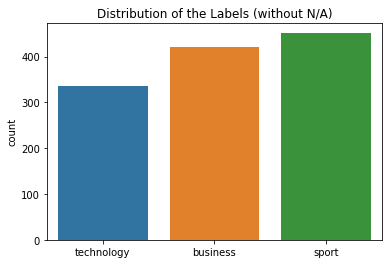

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


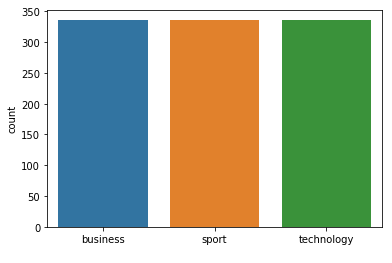



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 123
Class Distribution --> Train data (Fold 4 ):


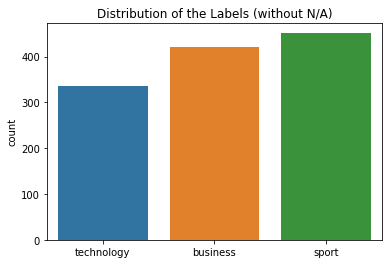

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


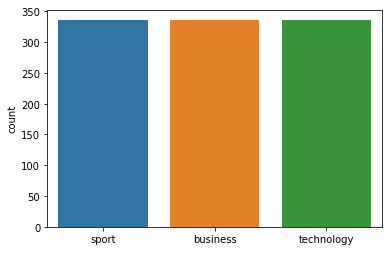



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 123
Class Distribution --> Train data (Fold 5 ):


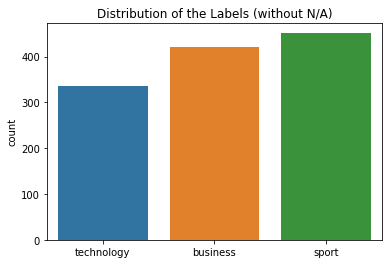

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


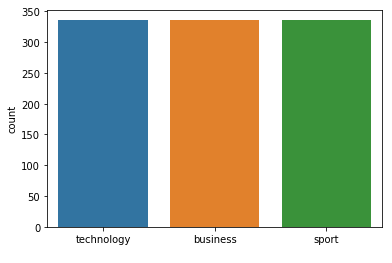



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 123
Class Distribution --> Train data (Fold 6 ):


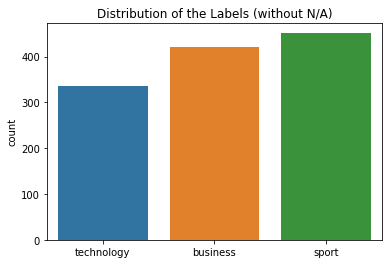

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


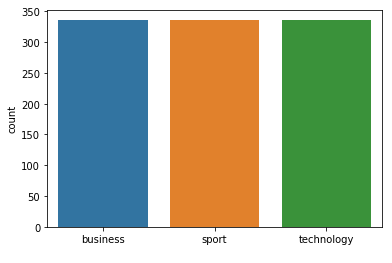



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 123
Class Distribution --> Train data (Fold 7 ):


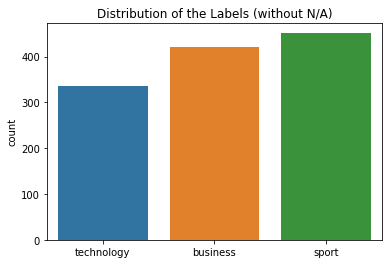

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


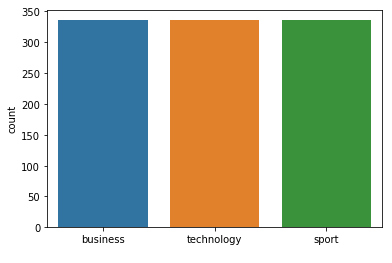



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 123  neighbours): 96.95% (+/- 1.02%)
FOLD 1 Number of neighbors 125
Class Distribution --> Train data (Fold 1 ):


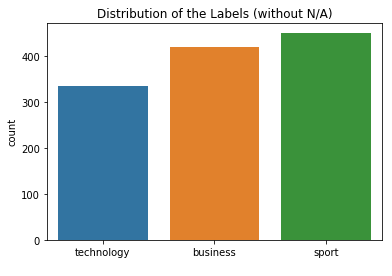

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


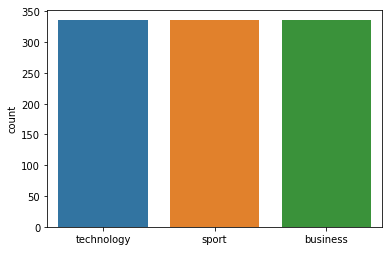



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 125
Class Distribution --> Train data (Fold 2 ):


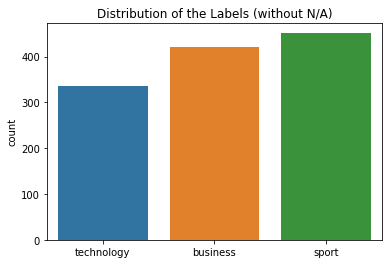

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


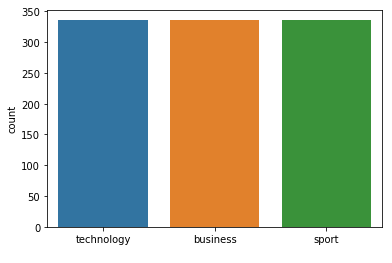



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 3 Number of neighbors 125
Class Distribution --> Train data (Fold 3 ):


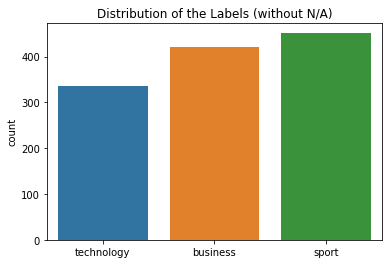

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


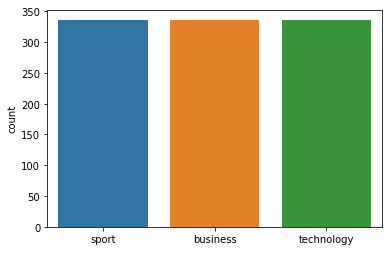



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.90      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 4 Number of neighbors 125
Class Distribution --> Train data (Fold 4 ):


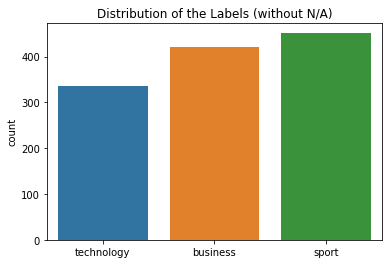

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


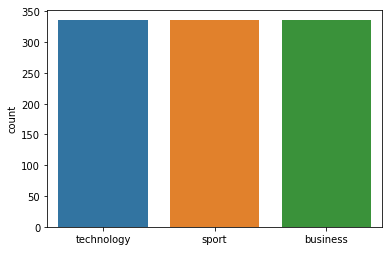



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 125
Class Distribution --> Train data (Fold 5 ):


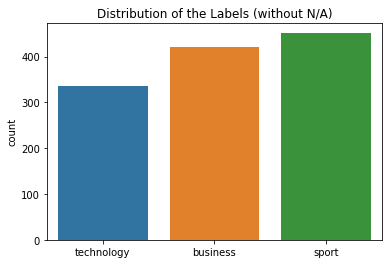

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


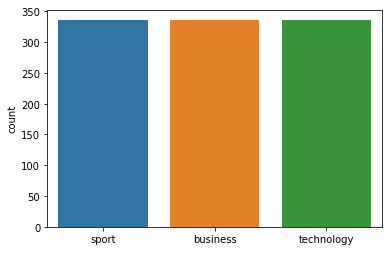



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 125
Class Distribution --> Train data (Fold 6 ):


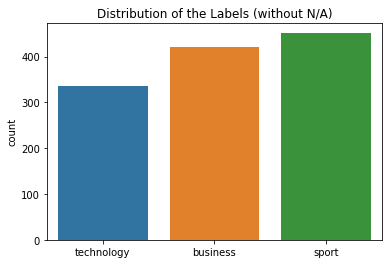

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


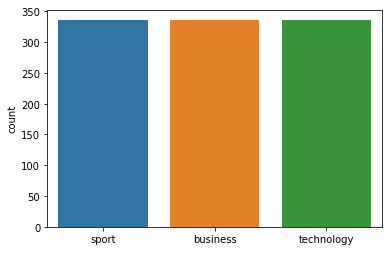



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.93      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 125
Class Distribution --> Train data (Fold 7 ):


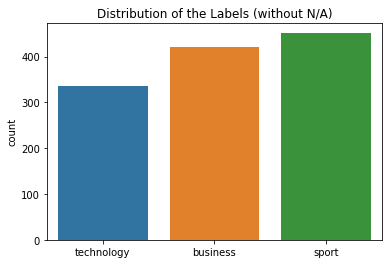

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


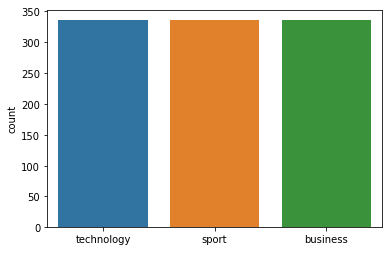



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 125  neighbours): 96.95% (+/- 1.02%)
FOLD 1 Number of neighbors 127
Class Distribution --> Train data (Fold 1 ):


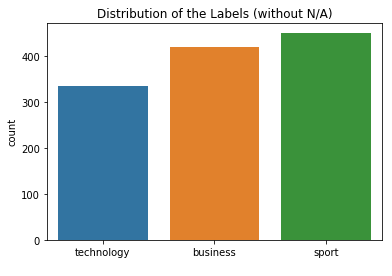

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


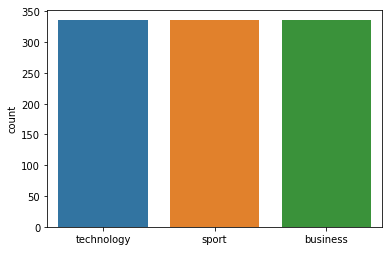



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 127
Class Distribution --> Train data (Fold 2 ):


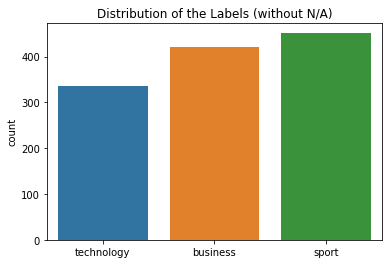

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


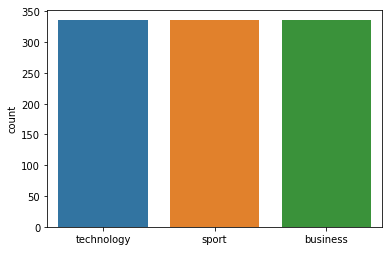



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 3 Number of neighbors 127
Class Distribution --> Train data (Fold 3 ):


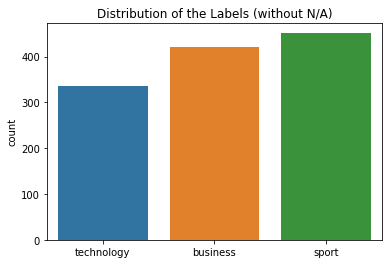

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


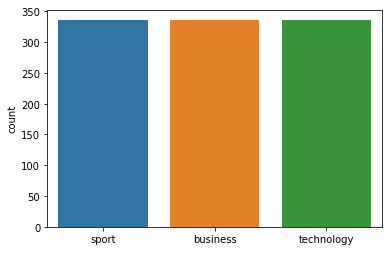



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 127
Class Distribution --> Train data (Fold 4 ):


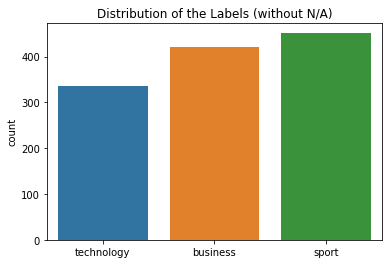

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


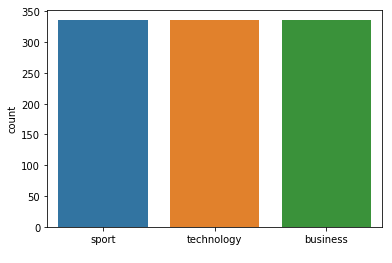



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  0  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 127
Class Distribution --> Train data (Fold 5 ):


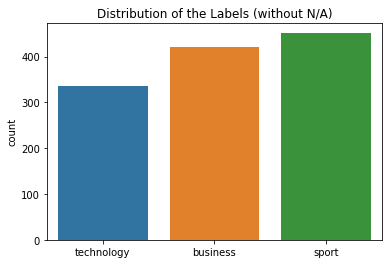

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


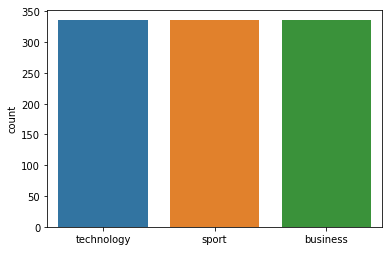



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 127
Class Distribution --> Train data (Fold 6 ):


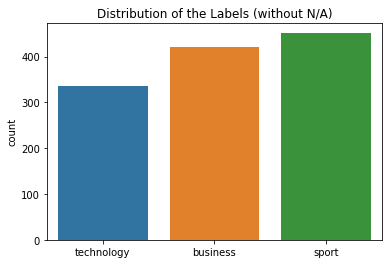

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


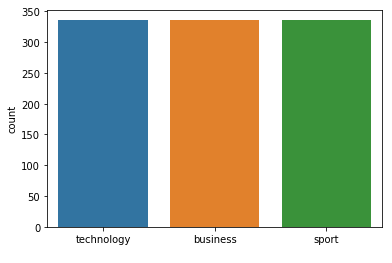



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 127
Class Distribution --> Train data (Fold 7 ):


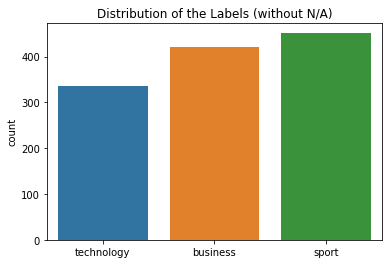

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


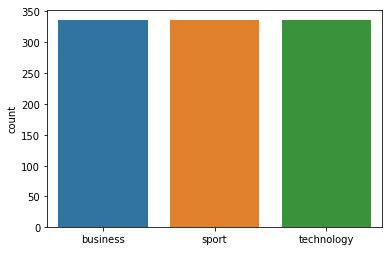



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 127  neighbours): 96.96% (+/- 1.02%)
FOLD 1 Number of neighbors 129
Class Distribution --> Train data (Fold 1 ):


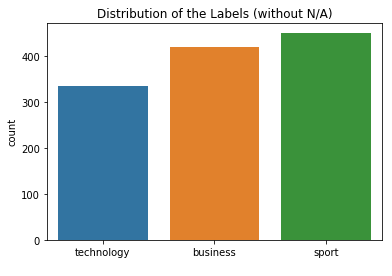

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


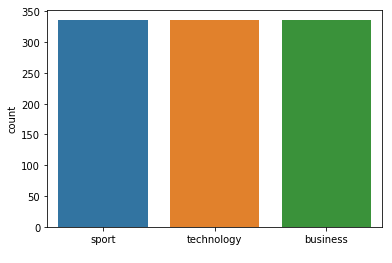



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 129
Class Distribution --> Train data (Fold 2 ):


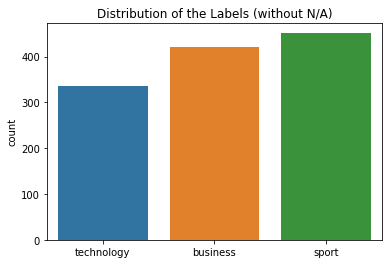

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


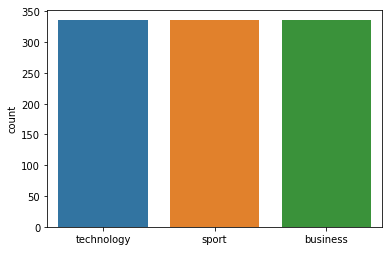



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 3 72  0]
 [ 1  1 54]]
FOLD 3 Number of neighbors 129
Class Distribution --> Train data (Fold 3 ):


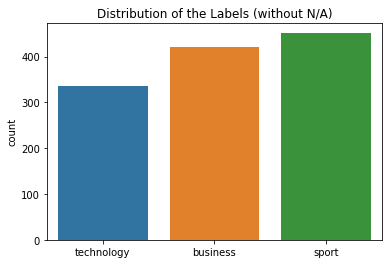

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


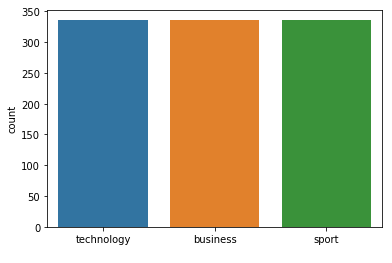



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.98      0.90      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.92      0.96      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 4 Number of neighbors 129
Class Distribution --> Train data (Fold 4 ):


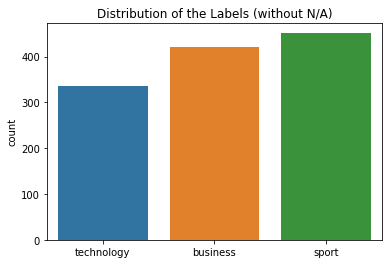

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


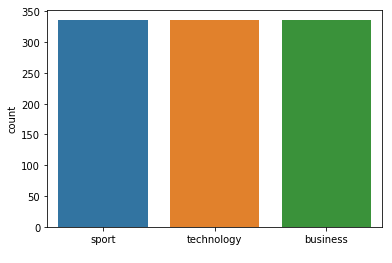



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 129
Class Distribution --> Train data (Fold 5 ):


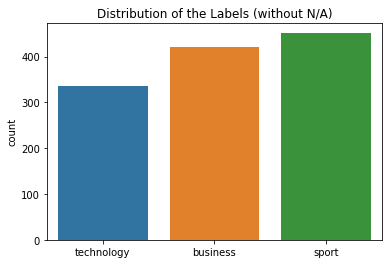

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


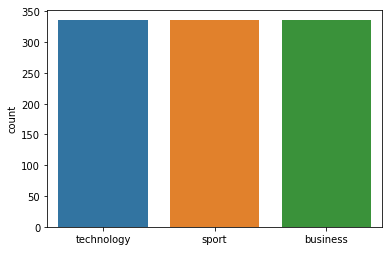



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 129
Class Distribution --> Train data (Fold 6 ):


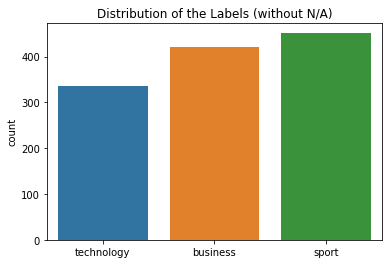

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


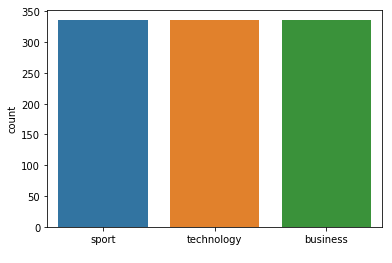



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 129
Class Distribution --> Train data (Fold 7 ):


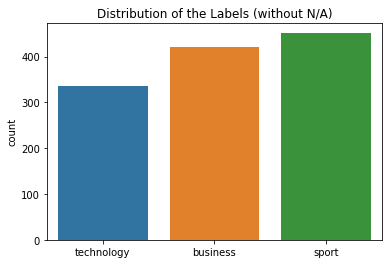

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


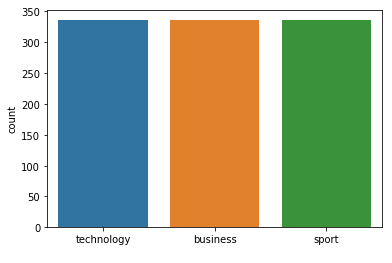



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 129  neighbours): 96.96% (+/- 1.02%)
FOLD 1 Number of neighbors 131
Class Distribution --> Train data (Fold 1 ):


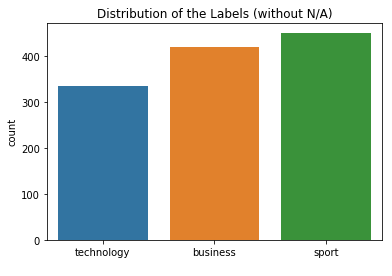

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


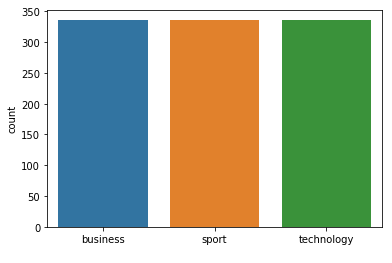



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 131
Class Distribution --> Train data (Fold 2 ):


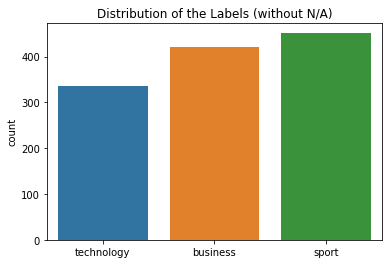

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


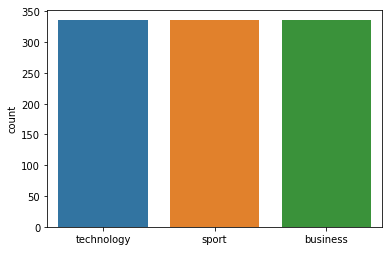



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 131
Class Distribution --> Train data (Fold 3 ):


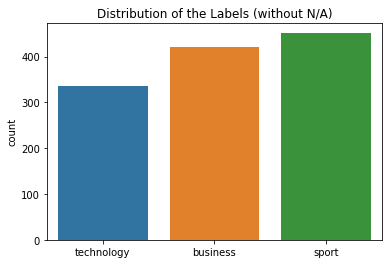

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


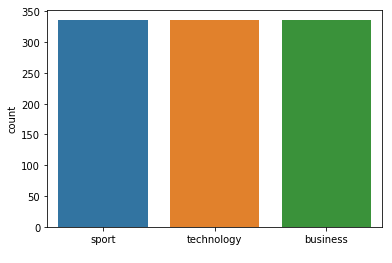



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.90      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      1.00      0.96        56

avg / total       0.97      0.97      0.96       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 4 Number of neighbors 131
Class Distribution --> Train data (Fold 4 ):


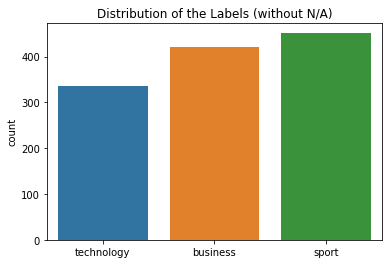

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


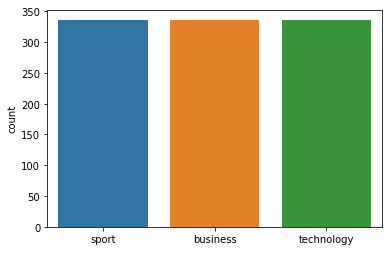



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 131
Class Distribution --> Train data (Fold 5 ):


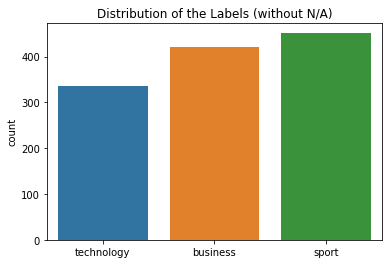

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


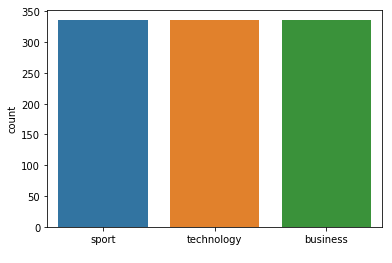



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 131
Class Distribution --> Train data (Fold 6 ):


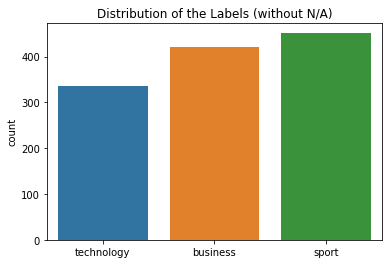

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


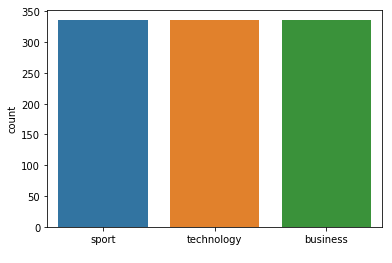



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 131
Class Distribution --> Train data (Fold 7 ):


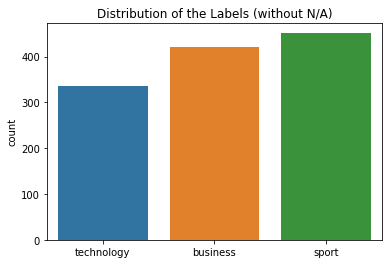

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


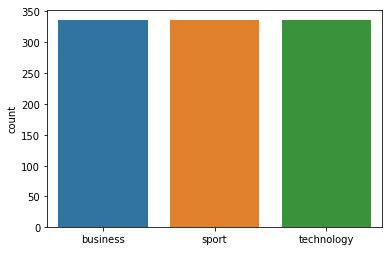



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.98      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 0  1 54]]


 Model accuracy (for 131  neighbours): 96.96% (+/- 1.02%)
FOLD 1 Number of neighbors 133
Class Distribution --> Train data (Fold 1 ):


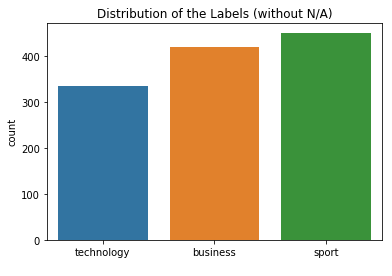

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


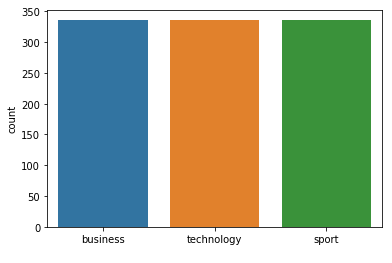



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 133
Class Distribution --> Train data (Fold 2 ):


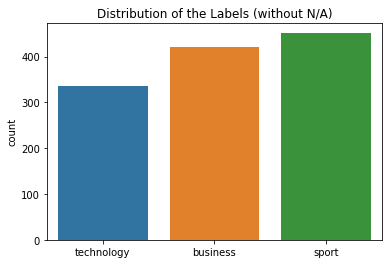

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


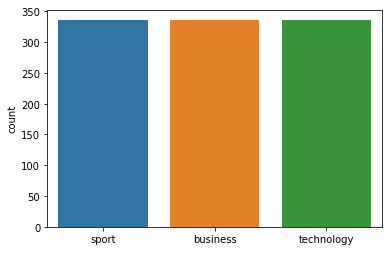



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      0.99      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 3 Number of neighbors 133
Class Distribution --> Train data (Fold 3 ):


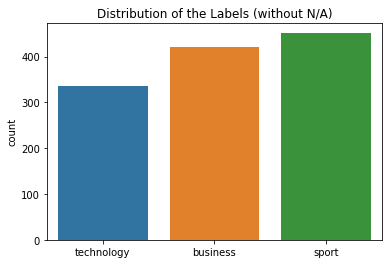

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


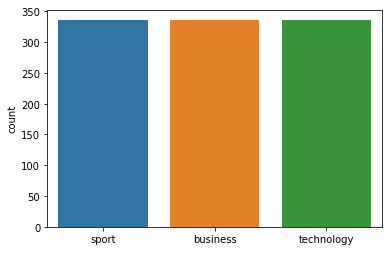



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 4 Number of neighbors 133
Class Distribution --> Train data (Fold 4 ):


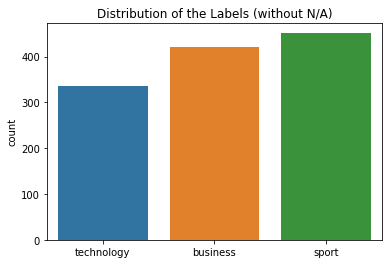

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


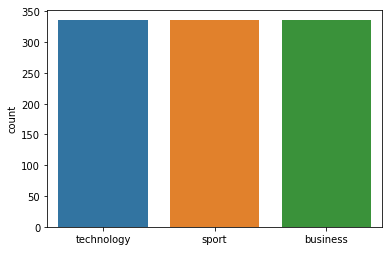



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 133
Class Distribution --> Train data (Fold 5 ):


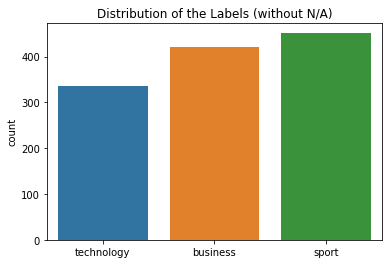

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


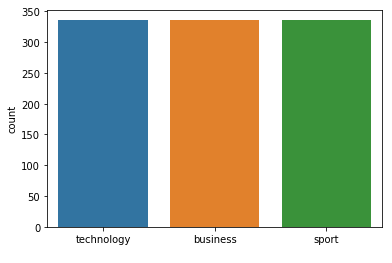



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 133
Class Distribution --> Train data (Fold 6 ):


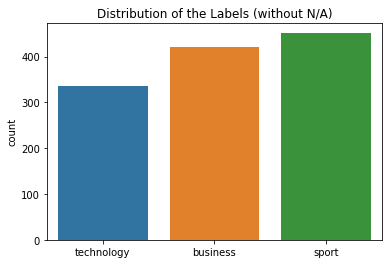

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


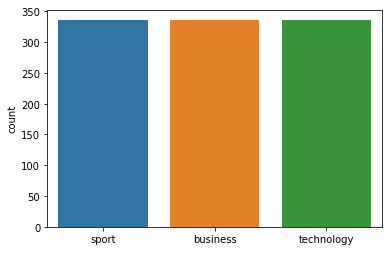



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.98      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 133
Class Distribution --> Train data (Fold 7 ):


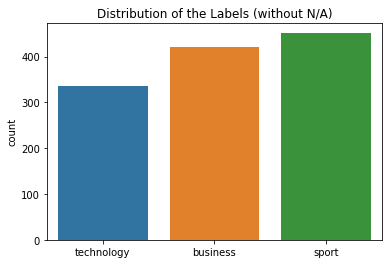

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


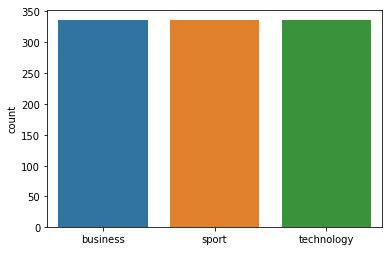



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 133  neighbours): 96.97% (+/- 1.01%)
FOLD 1 Number of neighbors 135
Class Distribution --> Train data (Fold 1 ):


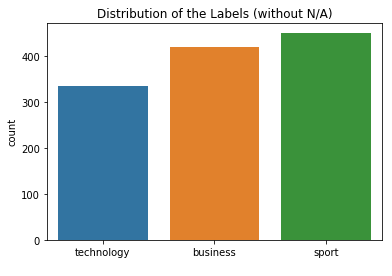

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


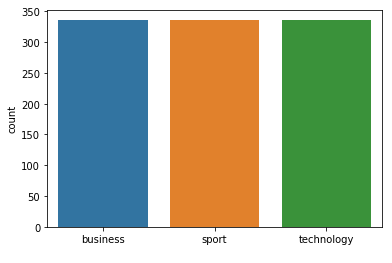



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 135
Class Distribution --> Train data (Fold 2 ):


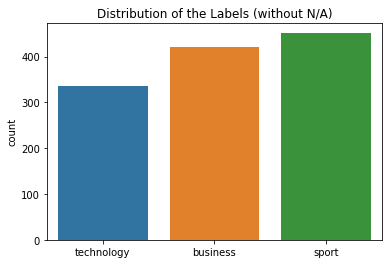

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


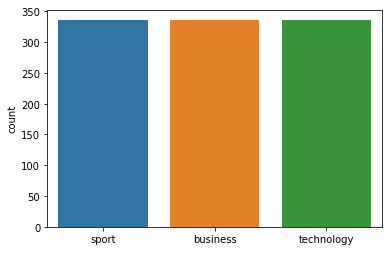



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 135
Class Distribution --> Train data (Fold 3 ):


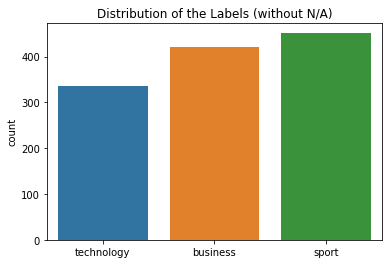

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


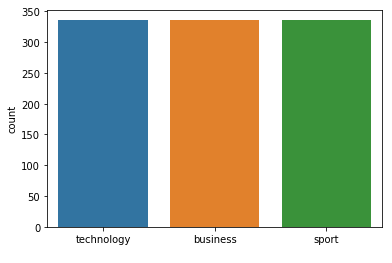



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 135
Class Distribution --> Train data (Fold 4 ):


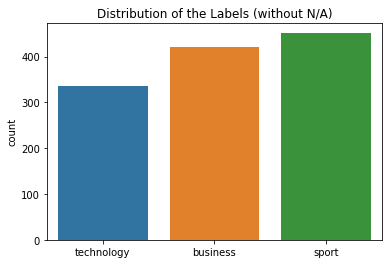

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


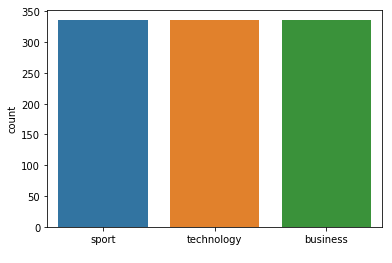



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  0  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 135
Class Distribution --> Train data (Fold 5 ):


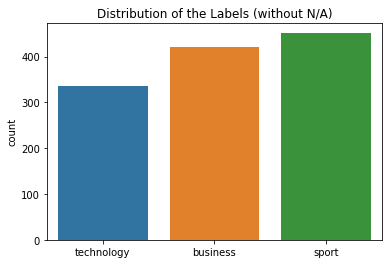

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


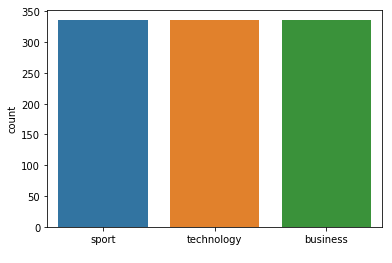



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 135
Class Distribution --> Train data (Fold 6 ):


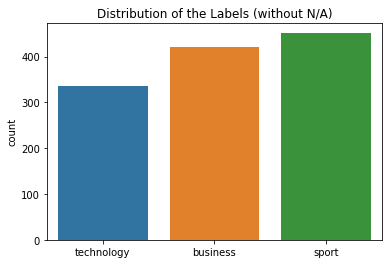

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


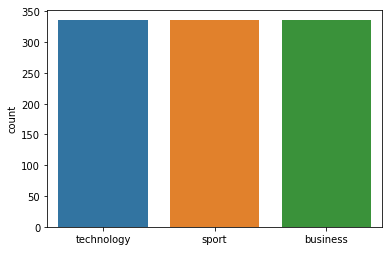



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 135
Class Distribution --> Train data (Fold 7 ):


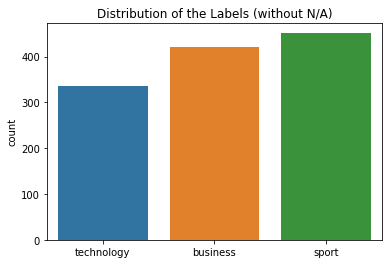

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


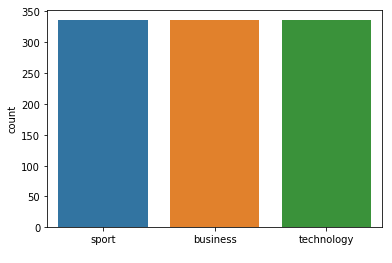



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.96      0.95        55

avg / total       0.97      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (for 135  neighbours): 96.97% (+/- 1.01%)
FOLD 1 Number of neighbors 137
Class Distribution --> Train data (Fold 1 ):


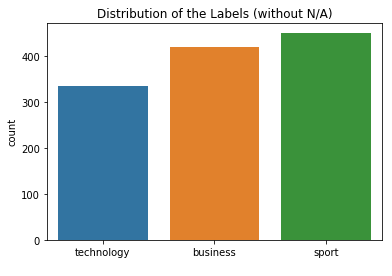

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


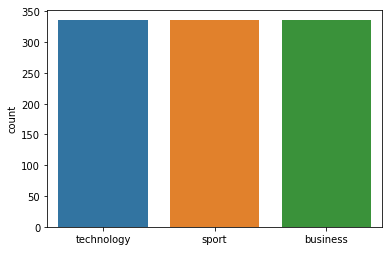



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 137
Class Distribution --> Train data (Fold 2 ):


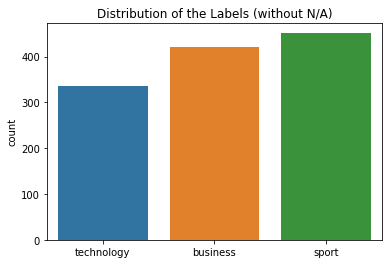

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


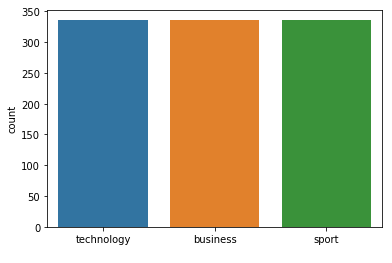



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.94      0.94        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 3 72  0]
 [ 1  1 54]]
FOLD 3 Number of neighbors 137
Class Distribution --> Train data (Fold 3 ):


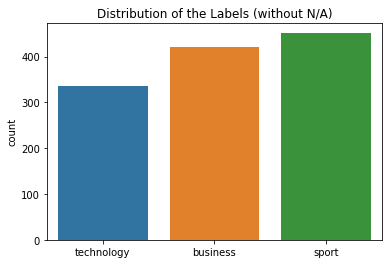

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


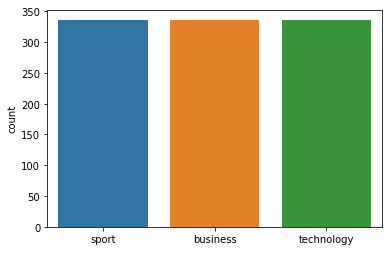



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 137
Class Distribution --> Train data (Fold 4 ):


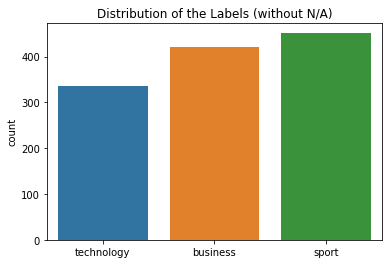

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


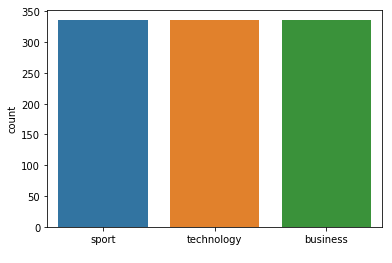



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      1.00      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[66  1  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 137
Class Distribution --> Train data (Fold 5 ):


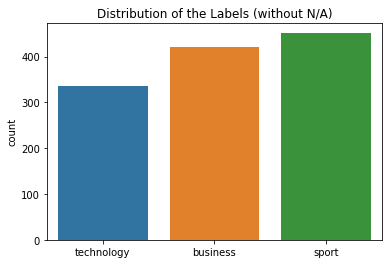

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


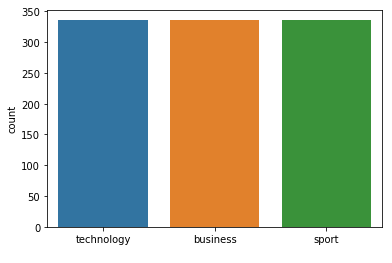



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 137
Class Distribution --> Train data (Fold 6 ):


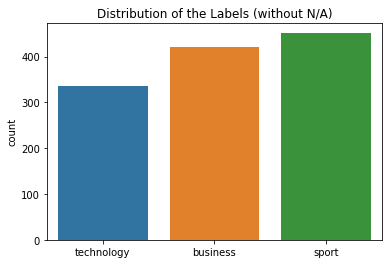

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


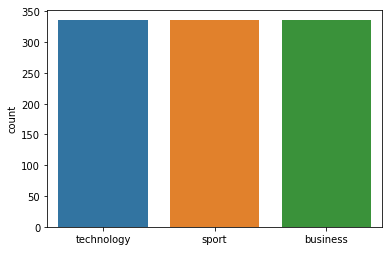



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 137
Class Distribution --> Train data (Fold 7 ):


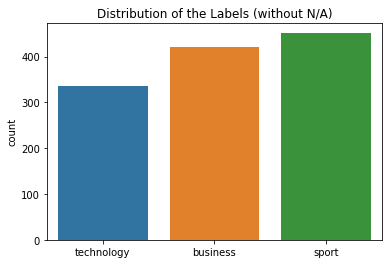

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


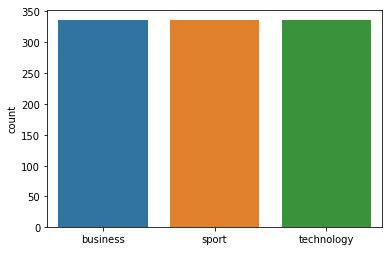



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 137  neighbours): 96.98% (+/- 1.01%)
FOLD 1 Number of neighbors 139
Class Distribution --> Train data (Fold 1 ):


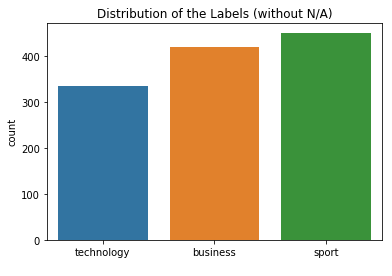

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


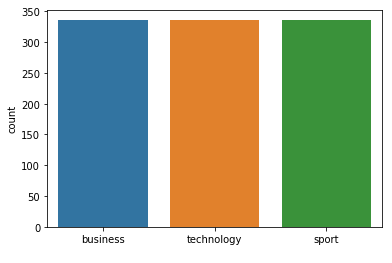



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 139
Class Distribution --> Train data (Fold 2 ):


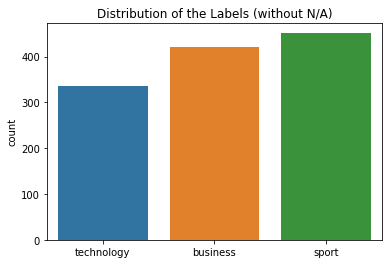

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


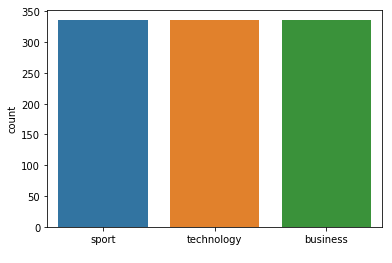



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 139
Class Distribution --> Train data (Fold 3 ):


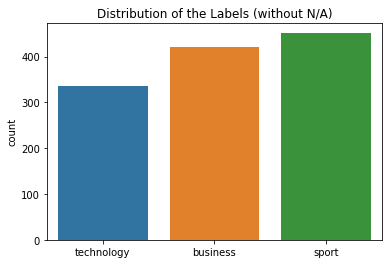

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


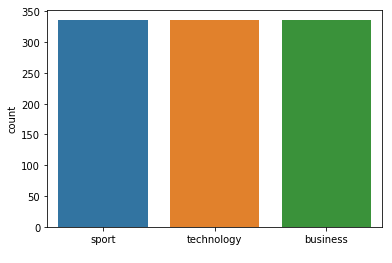



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 139
Class Distribution --> Train data (Fold 4 ):


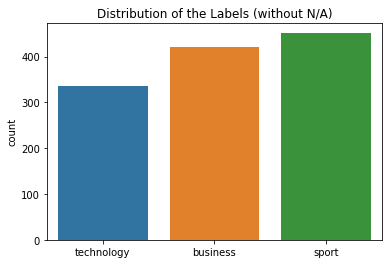

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


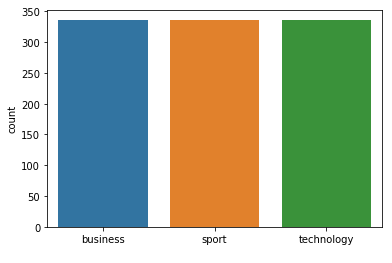



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  0  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 139
Class Distribution --> Train data (Fold 5 ):


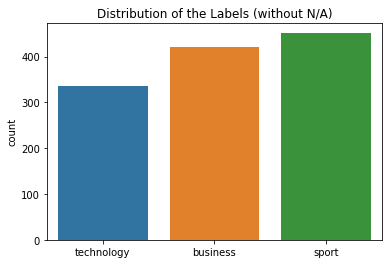

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


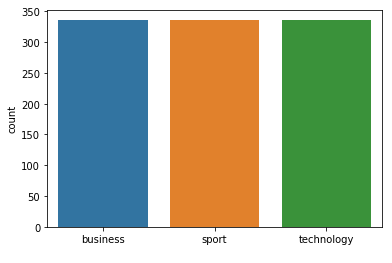



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 139
Class Distribution --> Train data (Fold 6 ):


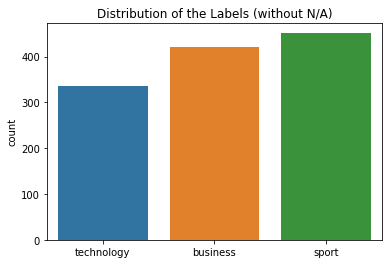

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


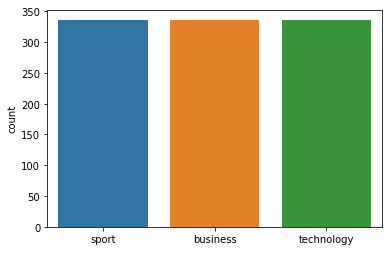



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 139
Class Distribution --> Train data (Fold 7 ):


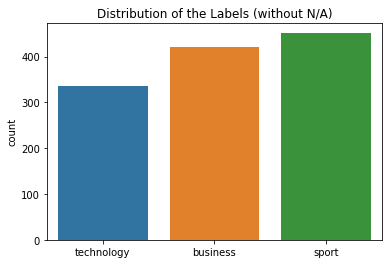

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


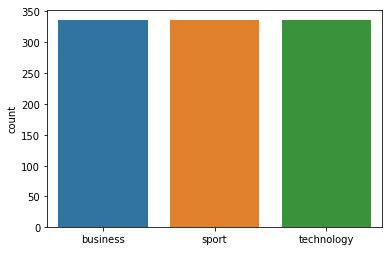



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 139  neighbours): 96.98% (+/- 1.01%)
FOLD 1 Number of neighbors 141
Class Distribution --> Train data (Fold 1 ):


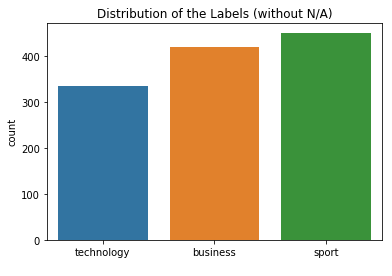

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


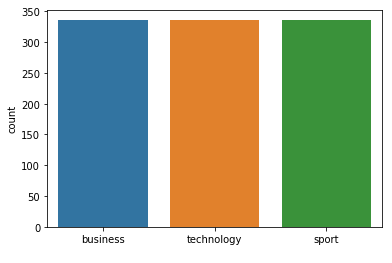



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 141
Class Distribution --> Train data (Fold 2 ):


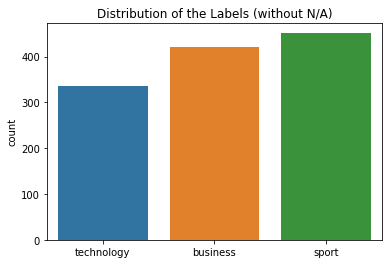

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


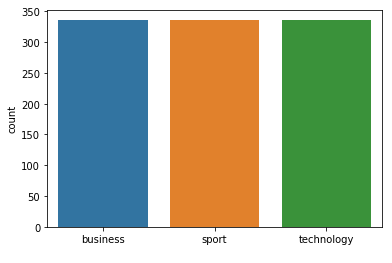



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 141
Class Distribution --> Train data (Fold 3 ):


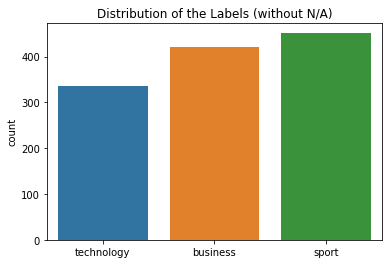

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


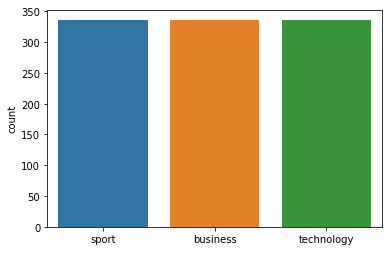



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 141
Class Distribution --> Train data (Fold 4 ):


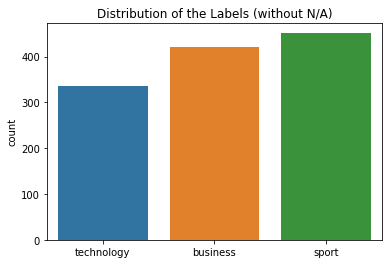

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


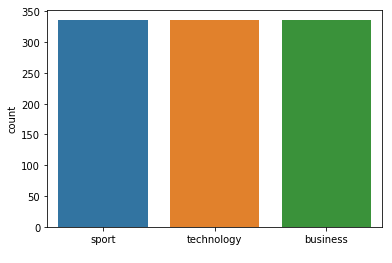



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  0  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 141
Class Distribution --> Train data (Fold 5 ):


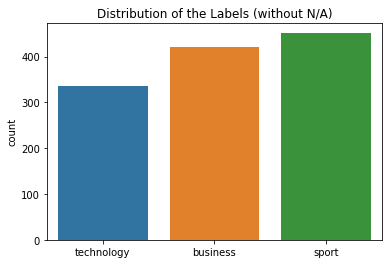

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


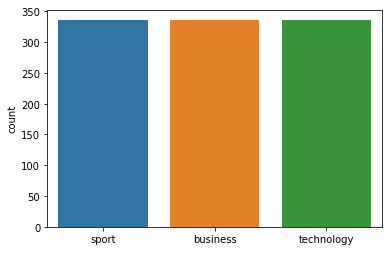



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 141
Class Distribution --> Train data (Fold 6 ):


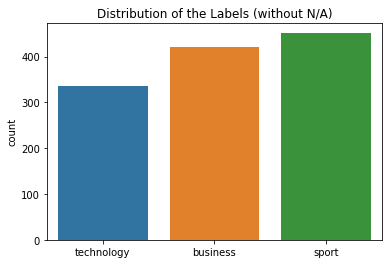

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


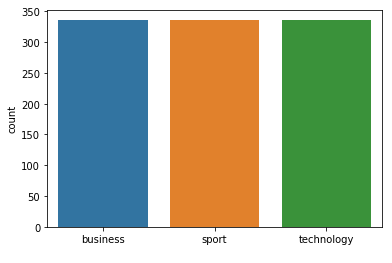



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 141
Class Distribution --> Train data (Fold 7 ):


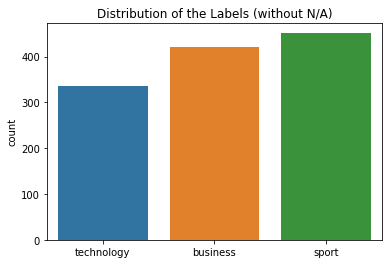

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


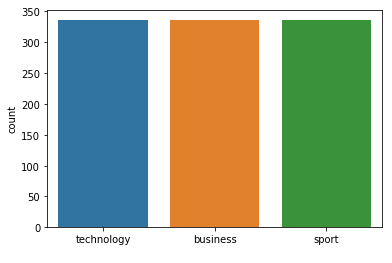



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 141  neighbours): 96.98% (+/- 1.01%)
FOLD 1 Number of neighbors 143
Class Distribution --> Train data (Fold 1 ):


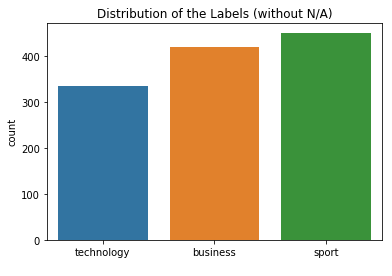

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


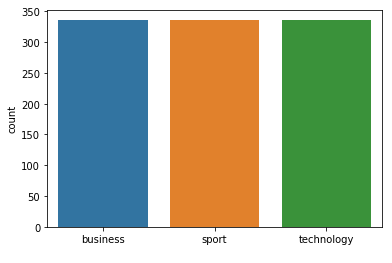



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 143
Class Distribution --> Train data (Fold 2 ):


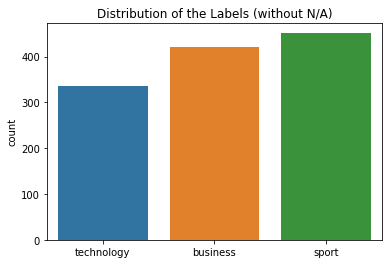

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


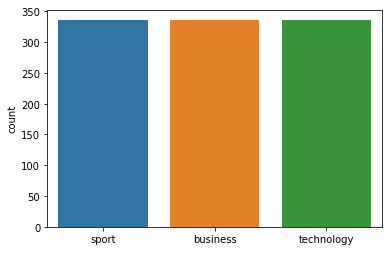



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.95      0.97      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[66  2  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 143
Class Distribution --> Train data (Fold 3 ):


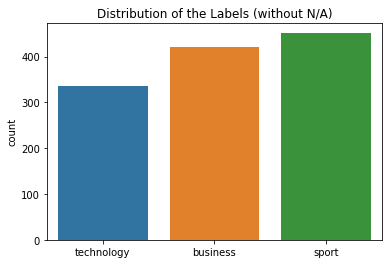

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


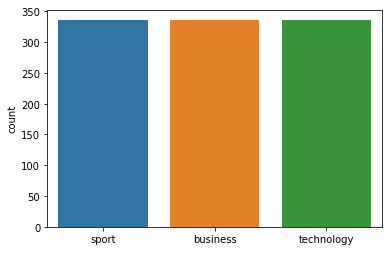



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 143
Class Distribution --> Train data (Fold 4 ):


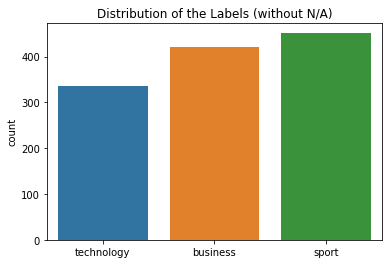

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


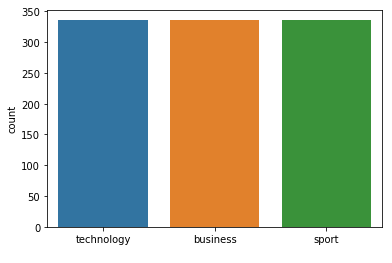



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 143
Class Distribution --> Train data (Fold 5 ):


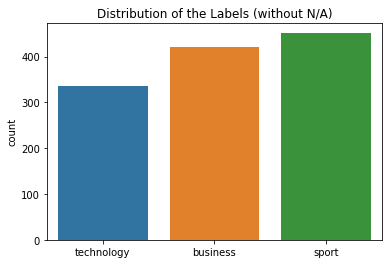

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


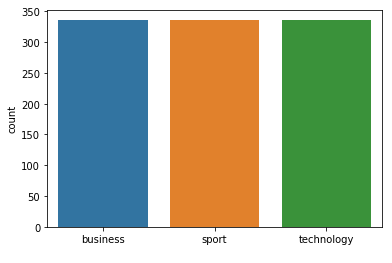



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 143
Class Distribution --> Train data (Fold 6 ):


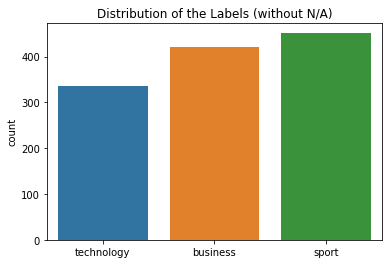

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


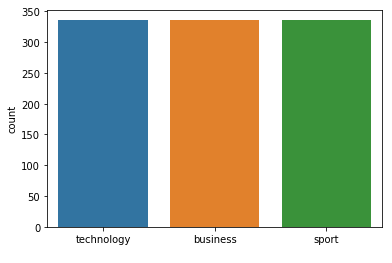



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 143
Class Distribution --> Train data (Fold 7 ):


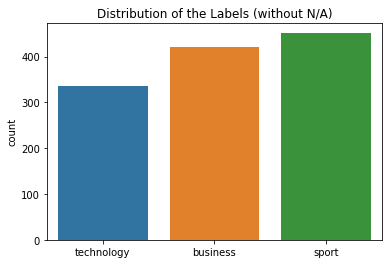

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


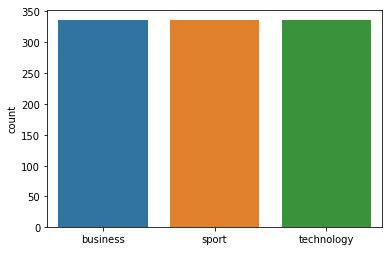



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 143  neighbours): 96.98% (+/- 1.01%)
FOLD 1 Number of neighbors 145
Class Distribution --> Train data (Fold 1 ):


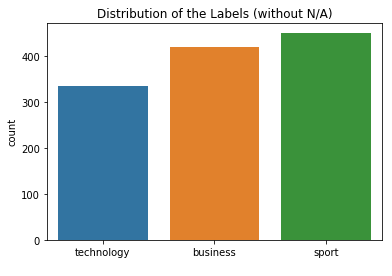

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


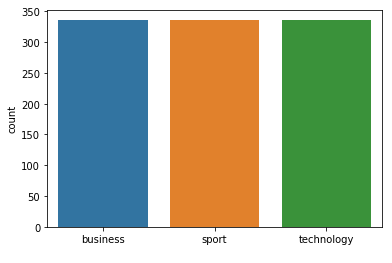



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 145
Class Distribution --> Train data (Fold 2 ):


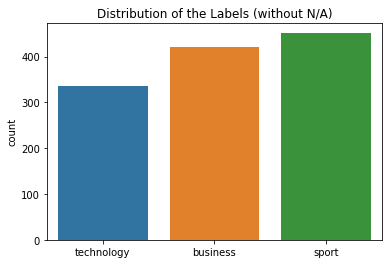

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


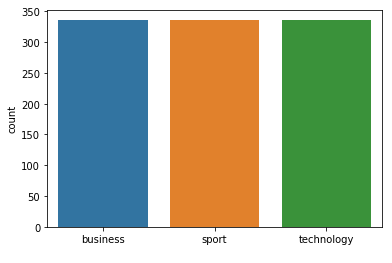



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 145
Class Distribution --> Train data (Fold 3 ):


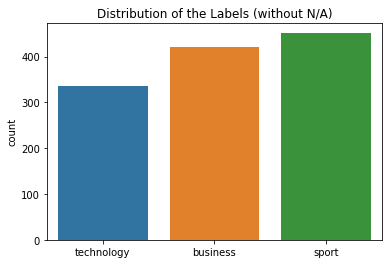

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


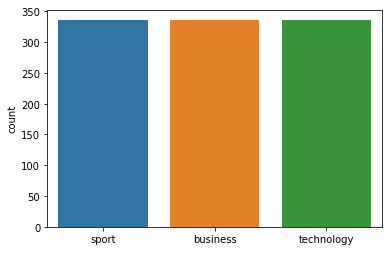



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 145
Class Distribution --> Train data (Fold 4 ):


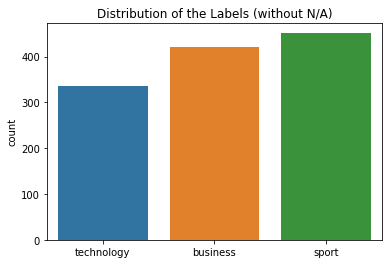

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


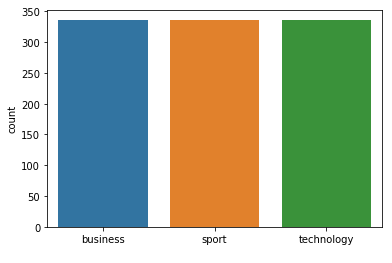



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 145
Class Distribution --> Train data (Fold 5 ):


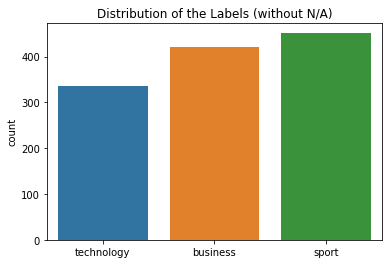

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


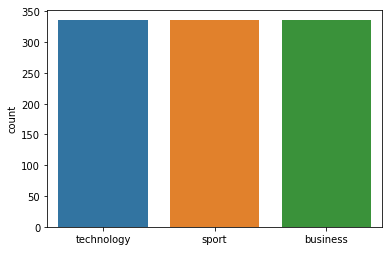



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 145
Class Distribution --> Train data (Fold 6 ):


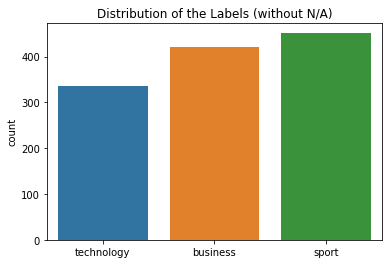

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


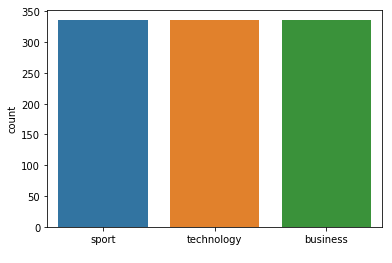



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 145
Class Distribution --> Train data (Fold 7 ):


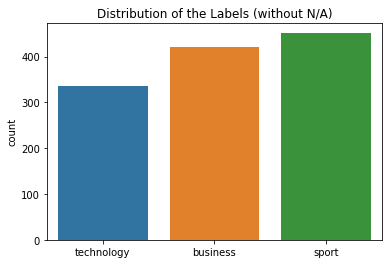

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


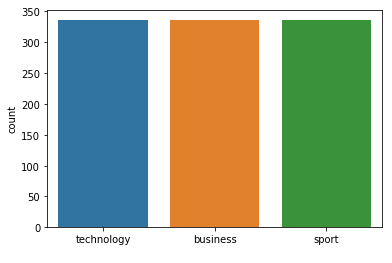



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 145  neighbours): 96.98% (+/- 1.02%)
FOLD 1 Number of neighbors 147
Class Distribution --> Train data (Fold 1 ):


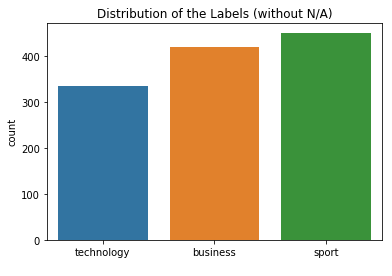

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


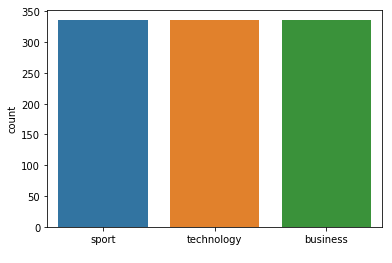



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 147
Class Distribution --> Train data (Fold 2 ):


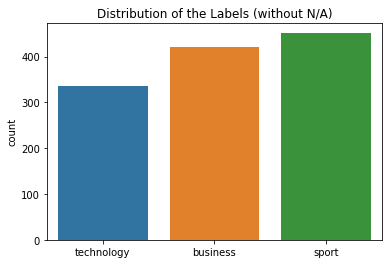

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


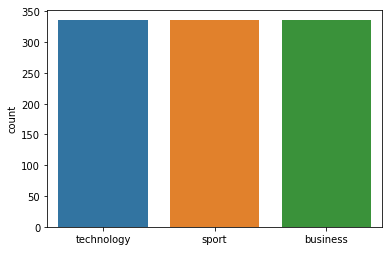



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 147
Class Distribution --> Train data (Fold 3 ):


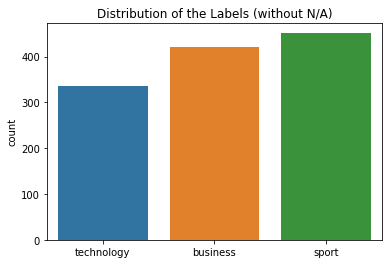

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


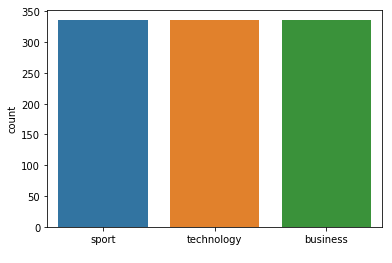



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 147
Class Distribution --> Train data (Fold 4 ):


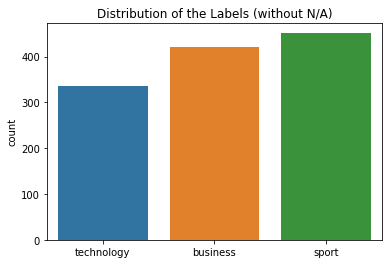

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


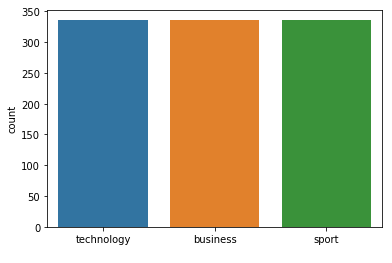



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.99      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 147
Class Distribution --> Train data (Fold 5 ):


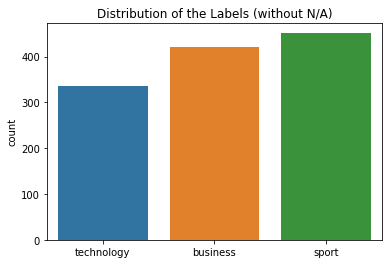

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


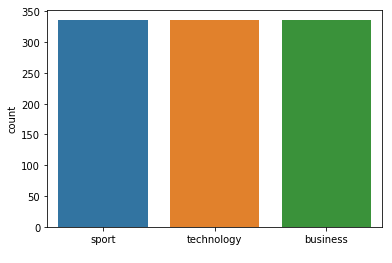



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 147
Class Distribution --> Train data (Fold 6 ):


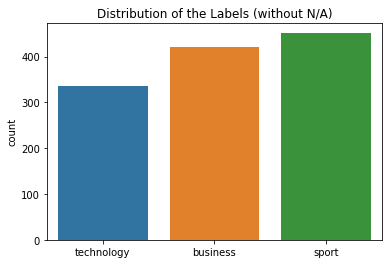

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


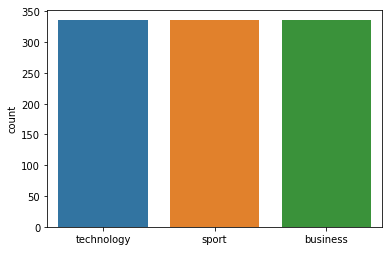



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 147
Class Distribution --> Train data (Fold 7 ):


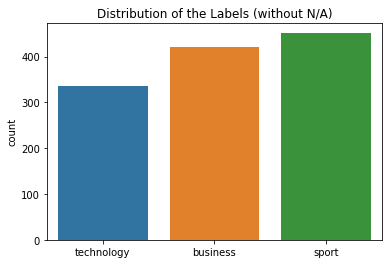

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


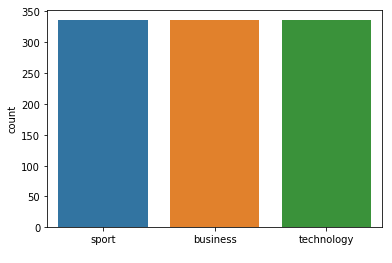



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 147  neighbours): 96.98% (+/- 1.02%)
FOLD 1 Number of neighbors 149
Class Distribution --> Train data (Fold 1 ):


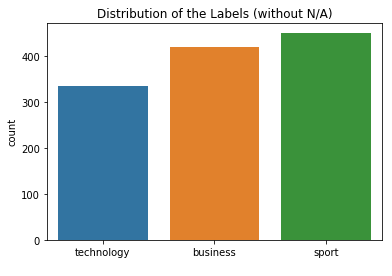

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


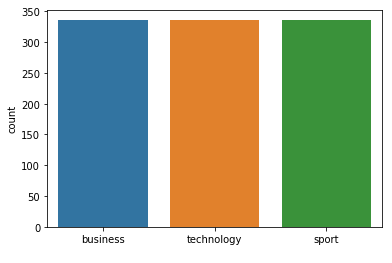



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 149
Class Distribution --> Train data (Fold 2 ):


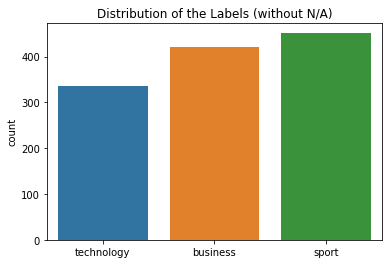

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


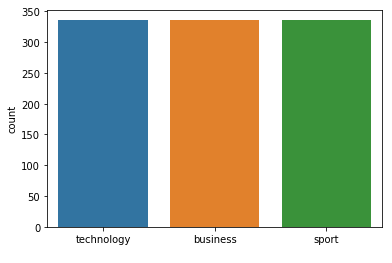



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 149
Class Distribution --> Train data (Fold 3 ):


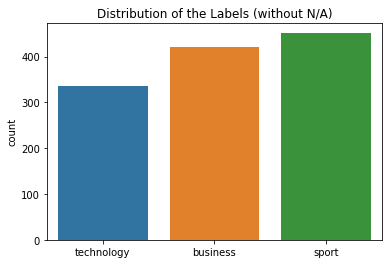

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


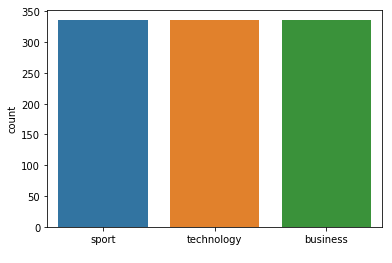



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 149
Class Distribution --> Train data (Fold 4 ):


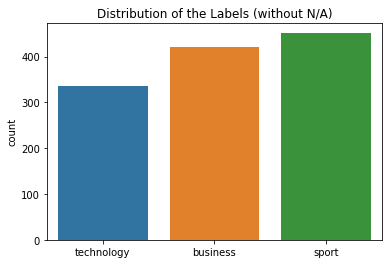

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


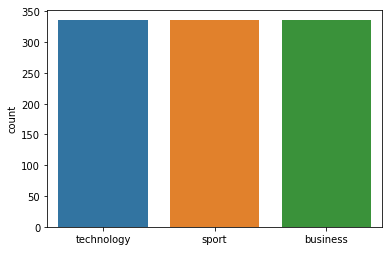



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 149
Class Distribution --> Train data (Fold 5 ):


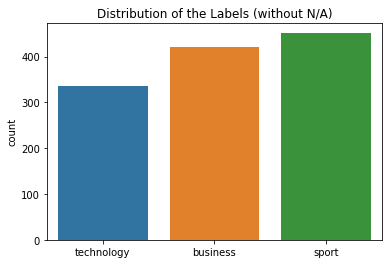

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


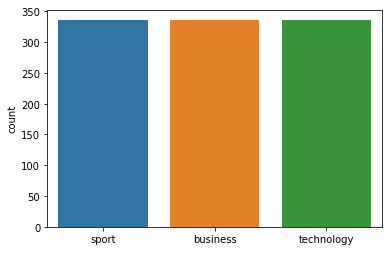



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 149
Class Distribution --> Train data (Fold 6 ):


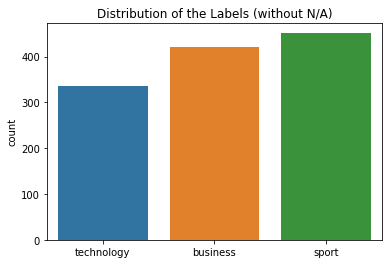

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


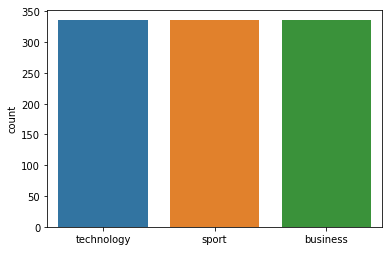



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 149
Class Distribution --> Train data (Fold 7 ):


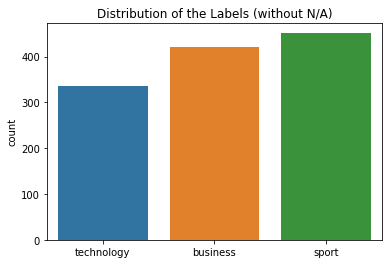

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


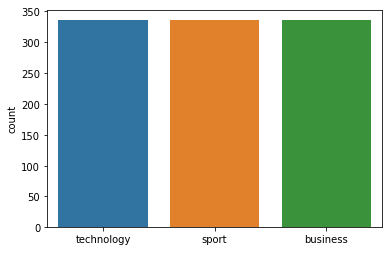



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 149  neighbours): 96.99% (+/- 1.02%)
FOLD 1 Number of neighbors 151
Class Distribution --> Train data (Fold 1 ):


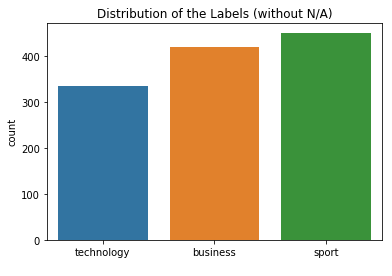

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


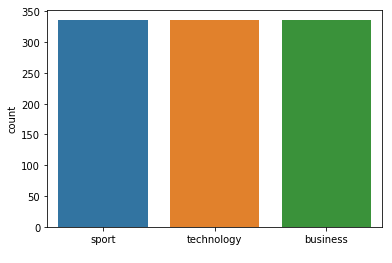



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 151
Class Distribution --> Train data (Fold 2 ):


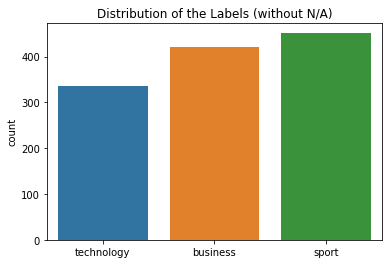

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


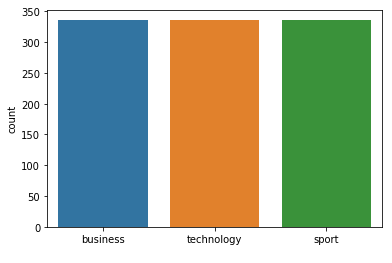



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 151
Class Distribution --> Train data (Fold 3 ):


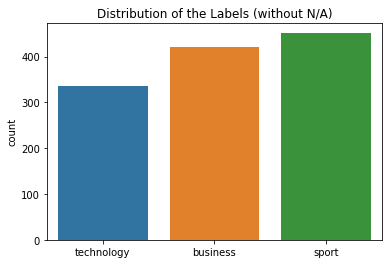

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


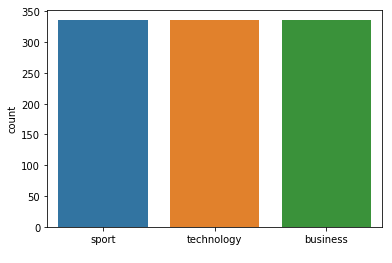



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 151
Class Distribution --> Train data (Fold 4 ):


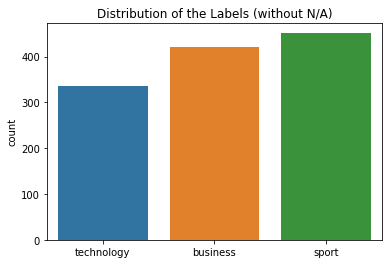

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


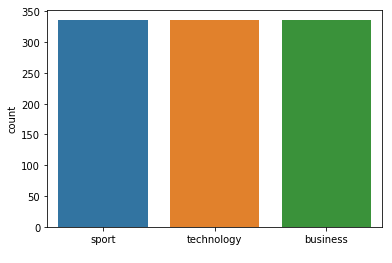



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.99      0.97      0.98        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 151
Class Distribution --> Train data (Fold 5 ):


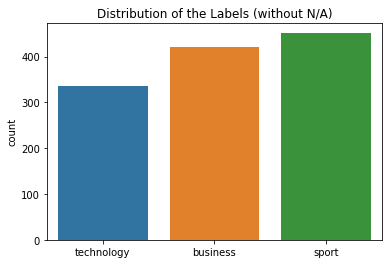

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


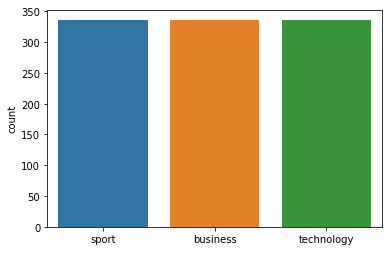



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 151
Class Distribution --> Train data (Fold 6 ):


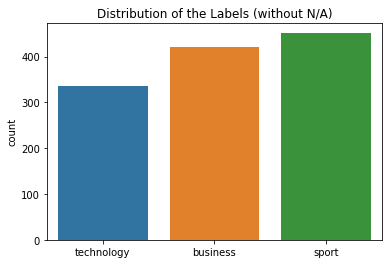

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


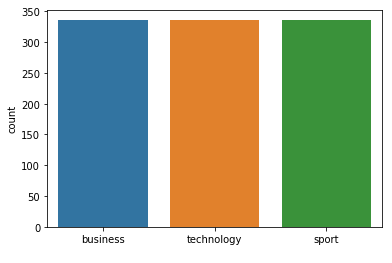



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 151
Class Distribution --> Train data (Fold 7 ):


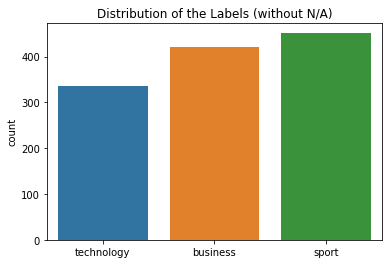

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


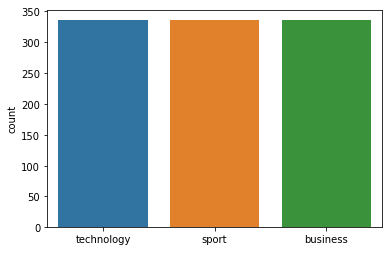



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[65  1  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 151  neighbours): 96.99% (+/- 1.02%)
FOLD 1 Number of neighbors 153
Class Distribution --> Train data (Fold 1 ):


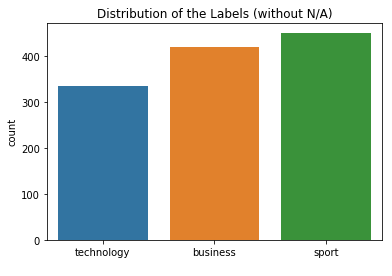

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


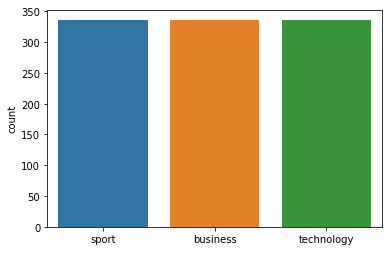



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 153
Class Distribution --> Train data (Fold 2 ):


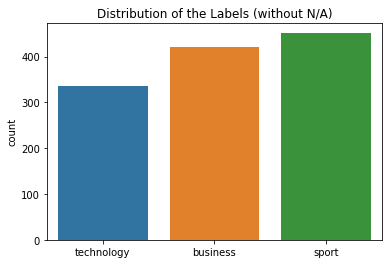

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


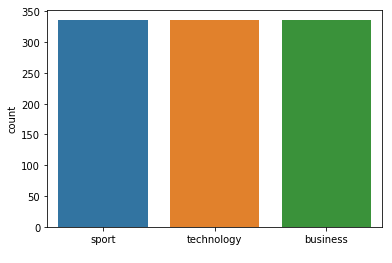



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.97      0.99      0.98        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 153
Class Distribution --> Train data (Fold 3 ):


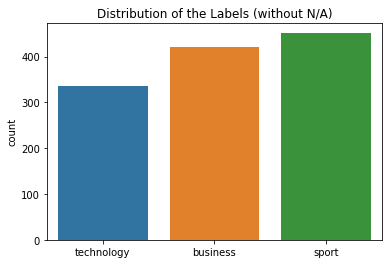

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


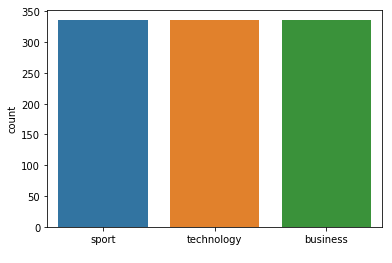



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 153
Class Distribution --> Train data (Fold 4 ):


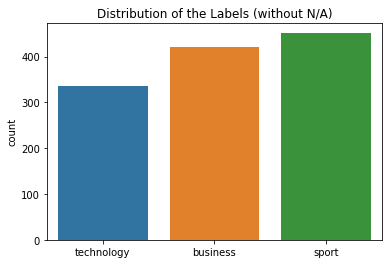

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


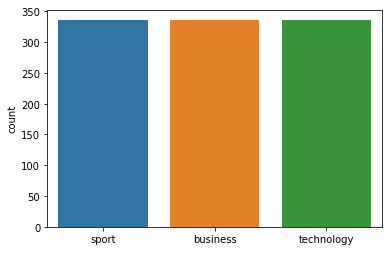



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 153
Class Distribution --> Train data (Fold 5 ):


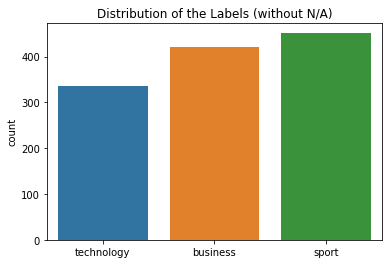

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


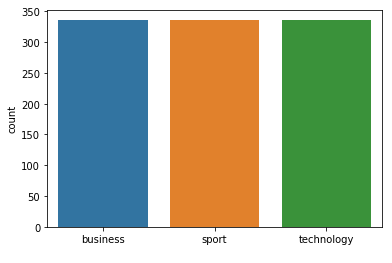



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 153
Class Distribution --> Train data (Fold 6 ):


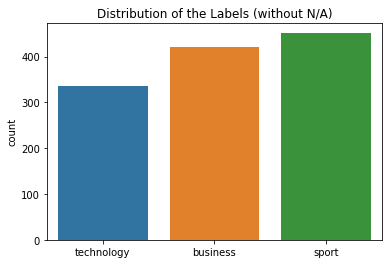

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


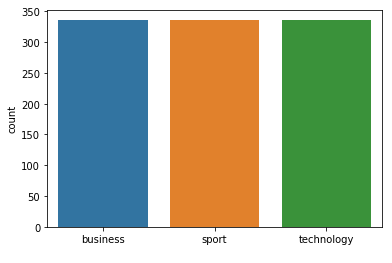



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 153
Class Distribution --> Train data (Fold 7 ):


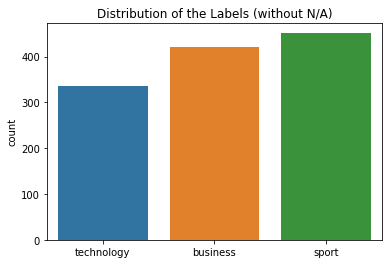

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


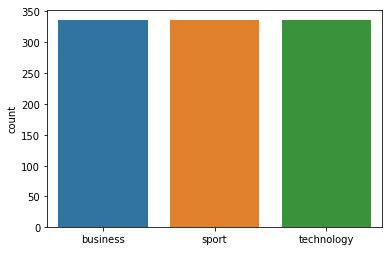



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 153  neighbours): 96.99% (+/- 1.02%)
FOLD 1 Number of neighbors 155
Class Distribution --> Train data (Fold 1 ):


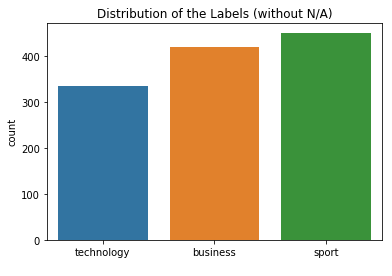

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


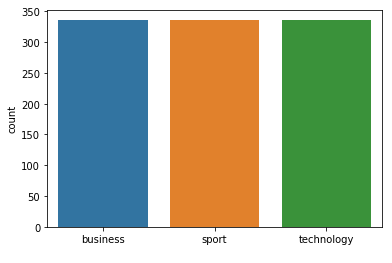



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 155
Class Distribution --> Train data (Fold 2 ):


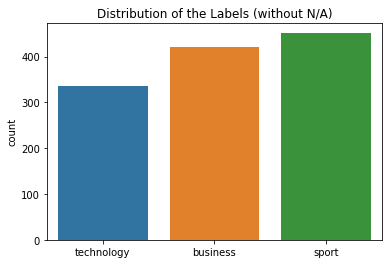

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


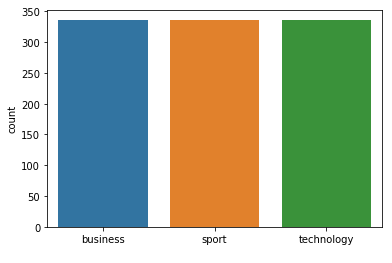



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 155
Class Distribution --> Train data (Fold 3 ):


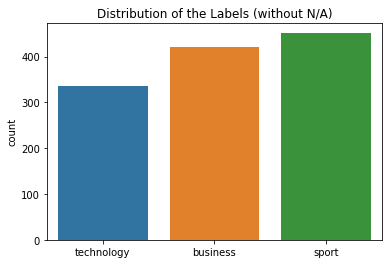

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


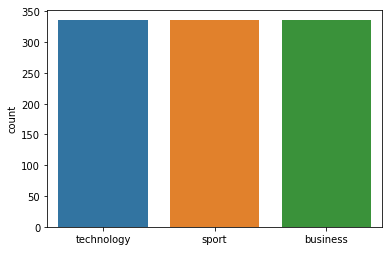



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 155
Class Distribution --> Train data (Fold 4 ):


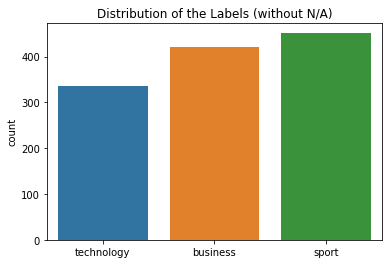

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


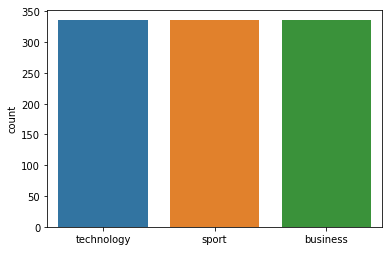



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[67  0  3]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 155
Class Distribution --> Train data (Fold 5 ):


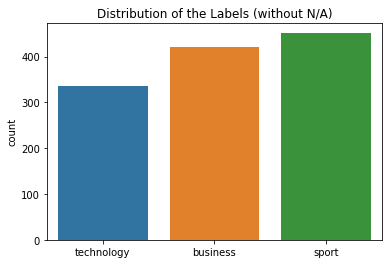

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


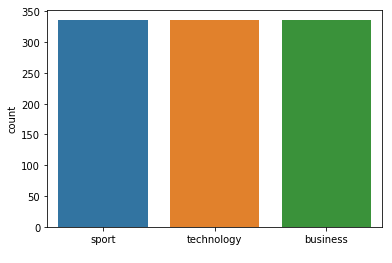



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 155
Class Distribution --> Train data (Fold 6 ):


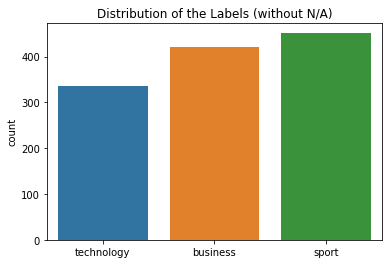

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


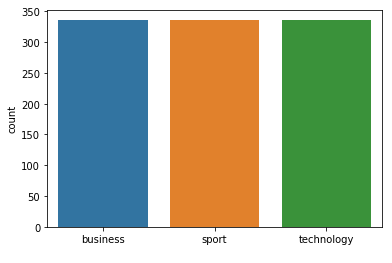



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 155
Class Distribution --> Train data (Fold 7 ):


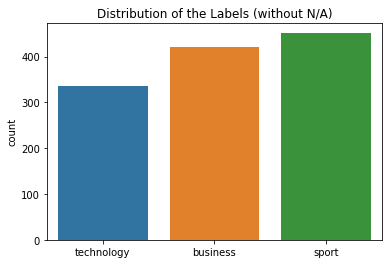

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


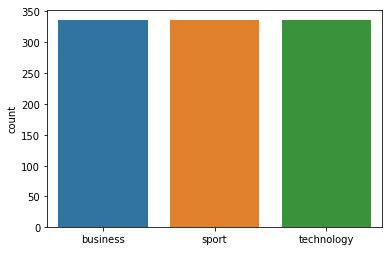



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 155  neighbours): 96.99% (+/- 1.02%)
FOLD 1 Number of neighbors 157
Class Distribution --> Train data (Fold 1 ):


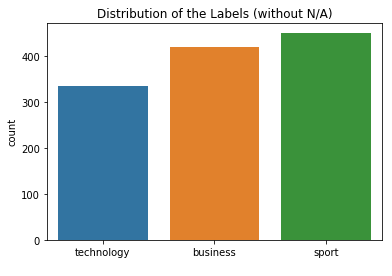

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


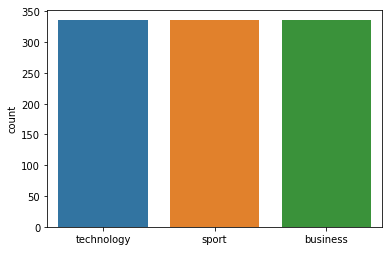



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.99      0.97      0.98        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 157
Class Distribution --> Train data (Fold 2 ):


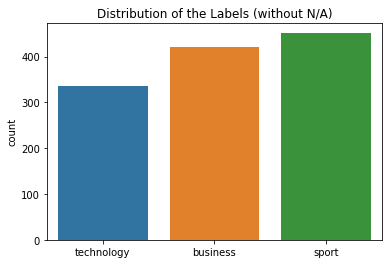

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


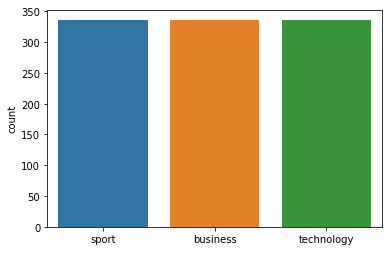



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 157
Class Distribution --> Train data (Fold 3 ):


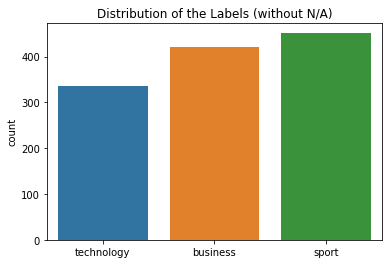

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


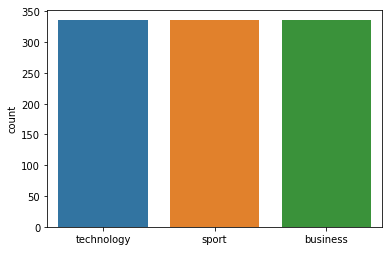



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 157
Class Distribution --> Train data (Fold 4 ):


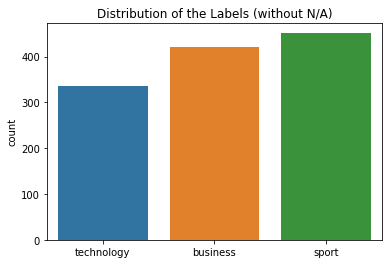

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


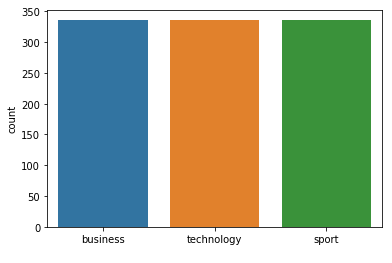



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 157
Class Distribution --> Train data (Fold 5 ):


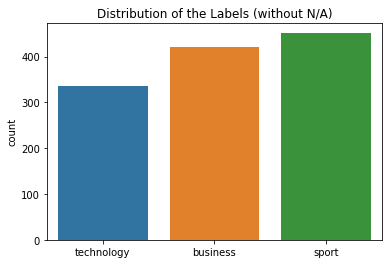

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


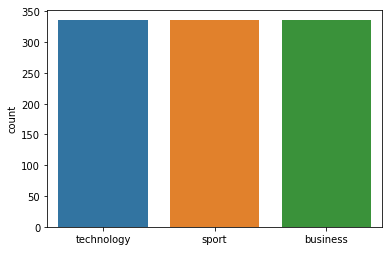



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 157
Class Distribution --> Train data (Fold 6 ):


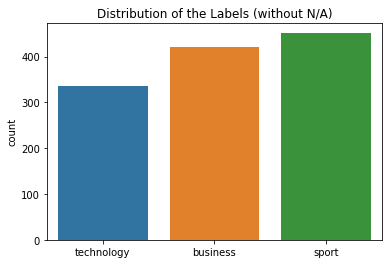

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


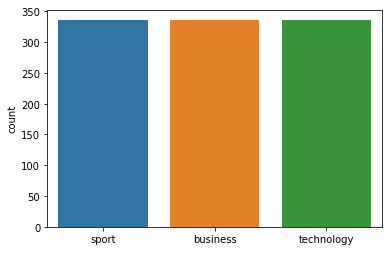



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  0  4]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 157
Class Distribution --> Train data (Fold 7 ):


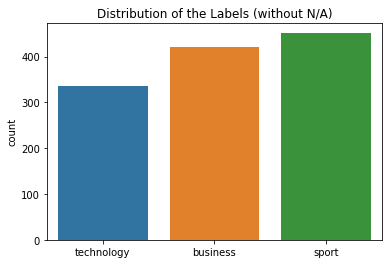

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


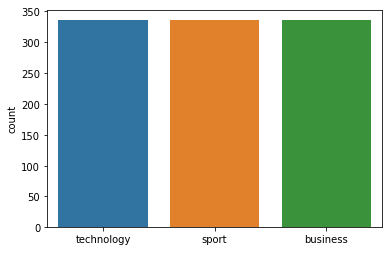



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 157  neighbours): 96.99% (+/- 1.02%)
FOLD 1 Number of neighbors 159
Class Distribution --> Train data (Fold 1 ):


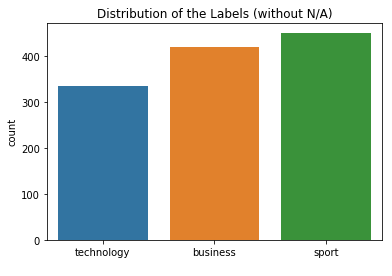

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


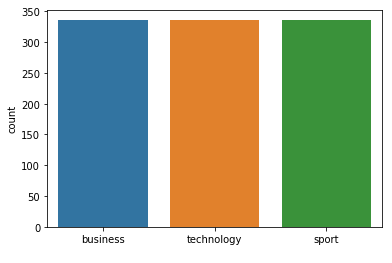



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 159
Class Distribution --> Train data (Fold 2 ):


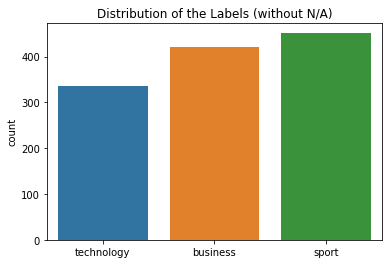

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


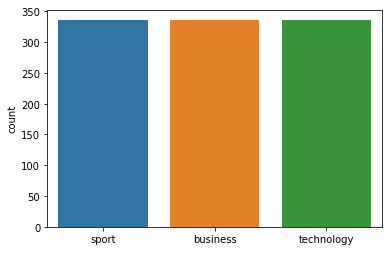



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 159
Class Distribution --> Train data (Fold 3 ):


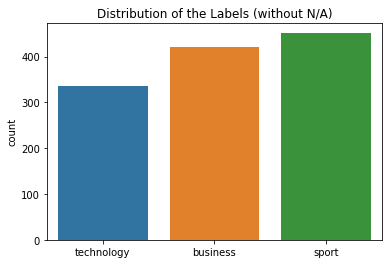

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


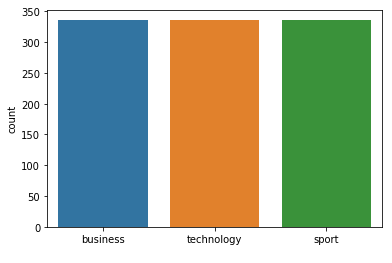



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 159
Class Distribution --> Train data (Fold 4 ):


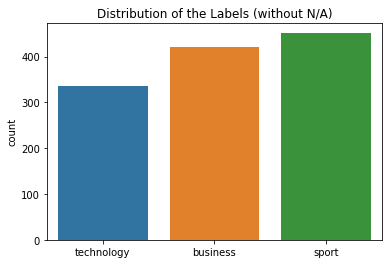

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


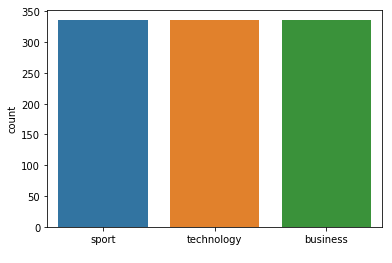



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 159
Class Distribution --> Train data (Fold 5 ):


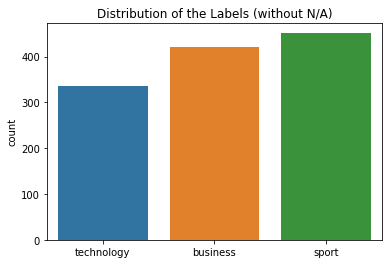

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


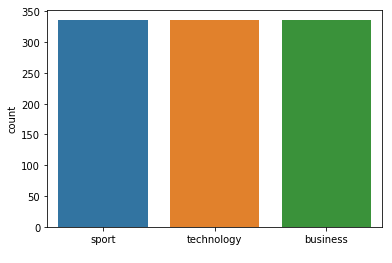



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 159
Class Distribution --> Train data (Fold 6 ):


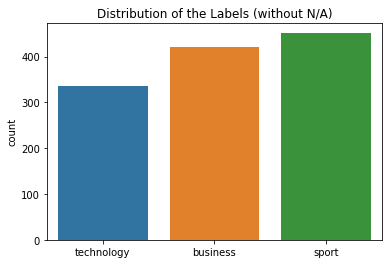

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


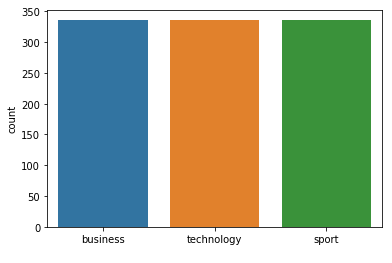



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.95      1.00      0.97        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  3 53]]
FOLD 7 Number of neighbors 159
Class Distribution --> Train data (Fold 7 ):


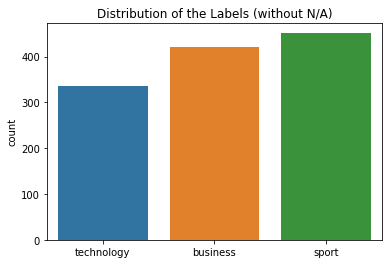

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


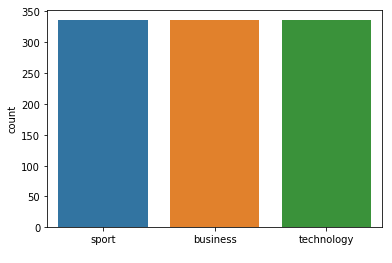



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 159  neighbours): 96.99% (+/- 1.02%)
FOLD 1 Number of neighbors 161
Class Distribution --> Train data (Fold 1 ):


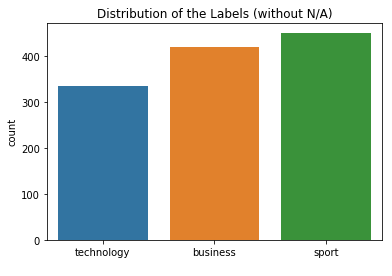

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


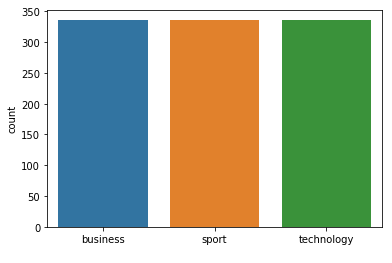



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 161
Class Distribution --> Train data (Fold 2 ):


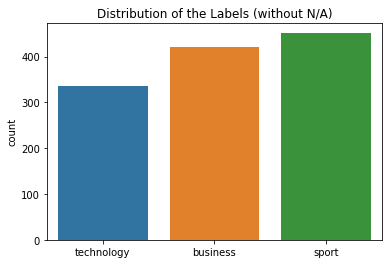

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


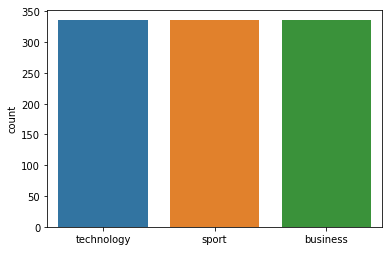



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 161
Class Distribution --> Train data (Fold 3 ):


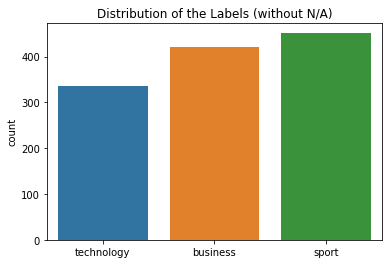

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


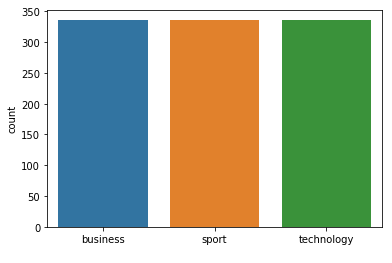



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 161
Class Distribution --> Train data (Fold 4 ):


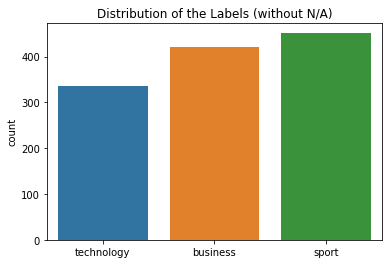

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


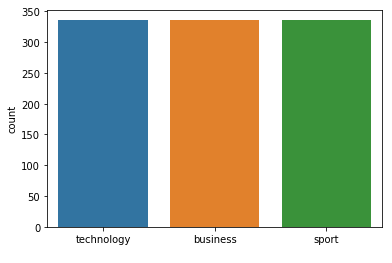



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.97      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 161
Class Distribution --> Train data (Fold 5 ):


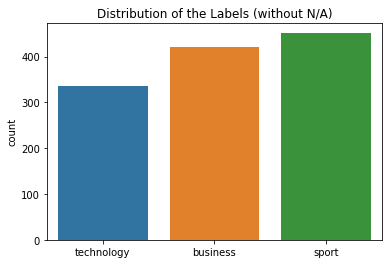

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


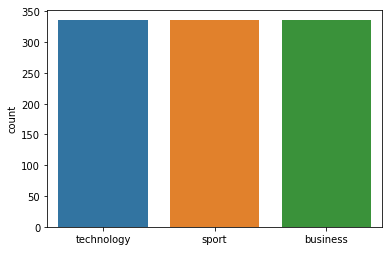



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 161
Class Distribution --> Train data (Fold 6 ):


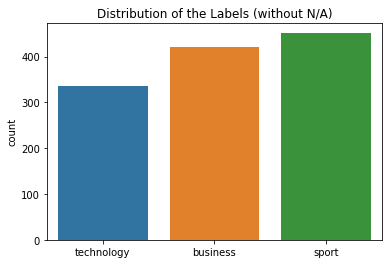

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


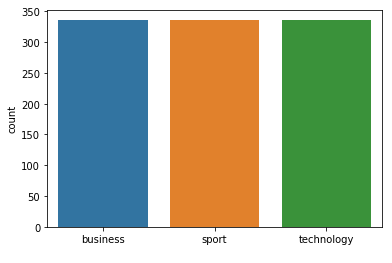



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 161
Class Distribution --> Train data (Fold 7 ):


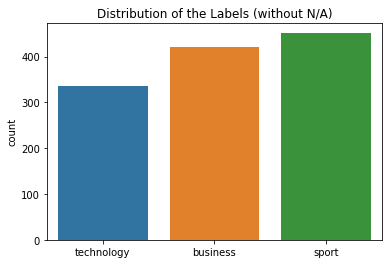

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


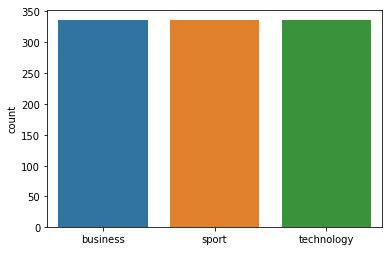



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 161  neighbours): 96.99% (+/- 1.02%)
FOLD 1 Number of neighbors 163
Class Distribution --> Train data (Fold 1 ):


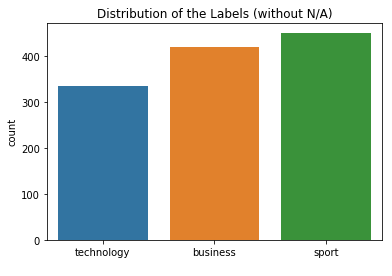

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


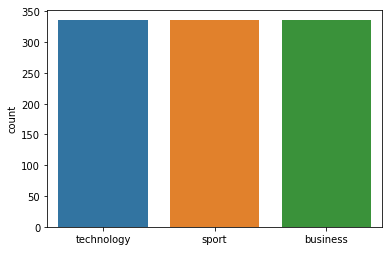



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 163
Class Distribution --> Train data (Fold 2 ):


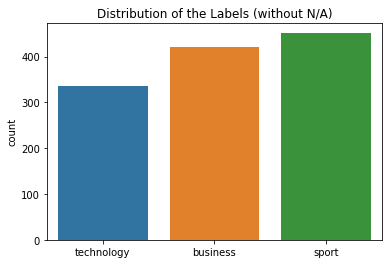

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


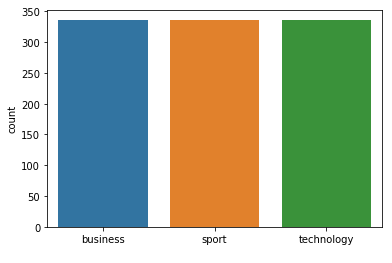



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 163
Class Distribution --> Train data (Fold 3 ):


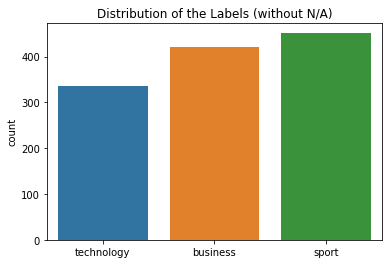

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


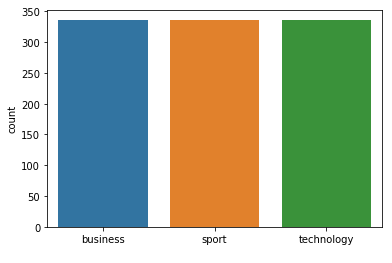



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 163
Class Distribution --> Train data (Fold 4 ):


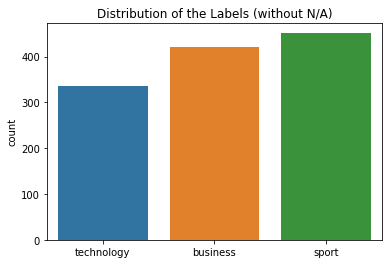

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


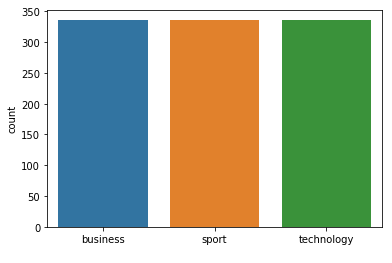



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 163
Class Distribution --> Train data (Fold 5 ):


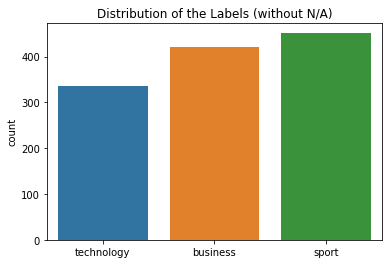

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


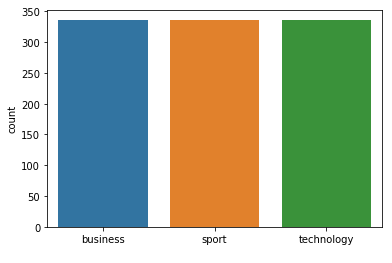



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 163
Class Distribution --> Train data (Fold 6 ):


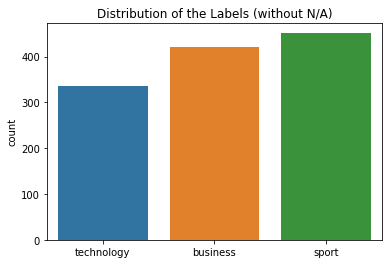

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


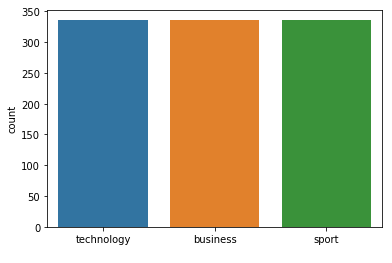



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 163
Class Distribution --> Train data (Fold 7 ):


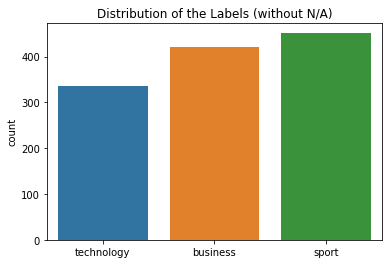

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


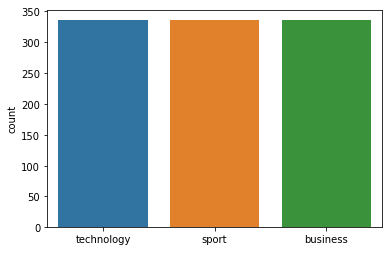



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  1  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 163  neighbours): 97.00% (+/- 1.02%)
FOLD 1 Number of neighbors 165
Class Distribution --> Train data (Fold 1 ):


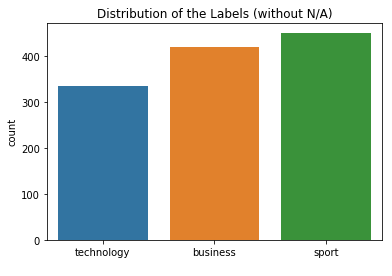

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


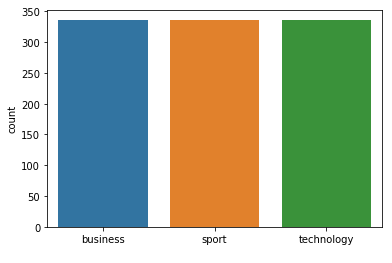



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 165
Class Distribution --> Train data (Fold 2 ):


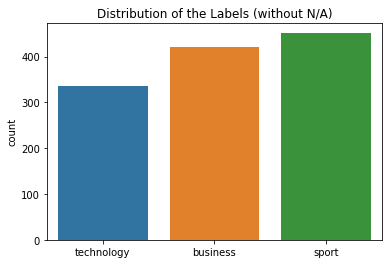

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


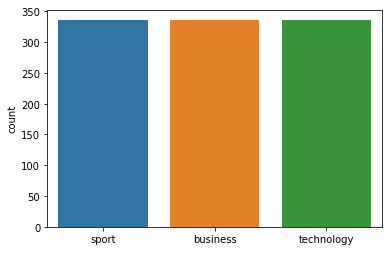



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 165
Class Distribution --> Train data (Fold 3 ):


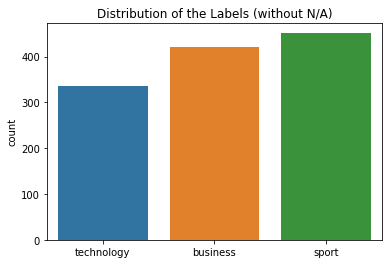

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


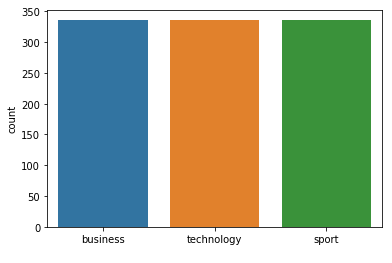



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 165
Class Distribution --> Train data (Fold 4 ):


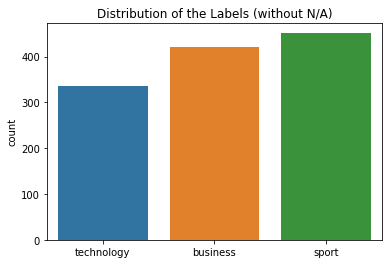

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


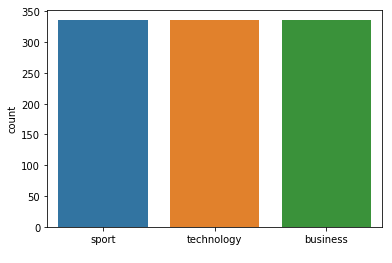



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       1.00      0.97      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  0 55]]
FOLD 5 Number of neighbors 165
Class Distribution --> Train data (Fold 5 ):


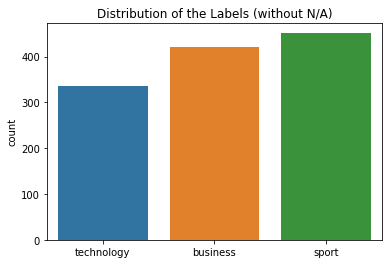

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


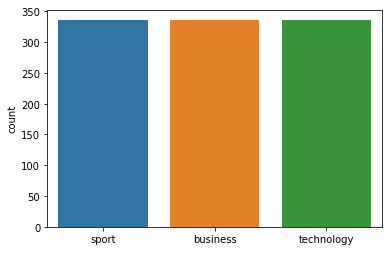



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 165
Class Distribution --> Train data (Fold 6 ):


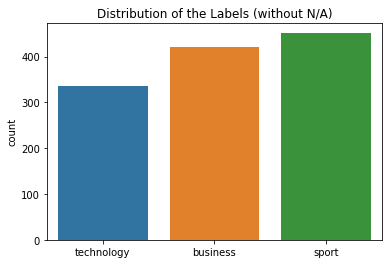

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


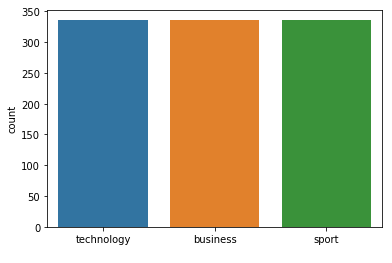



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 165
Class Distribution --> Train data (Fold 7 ):


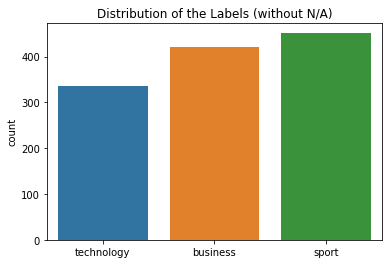

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


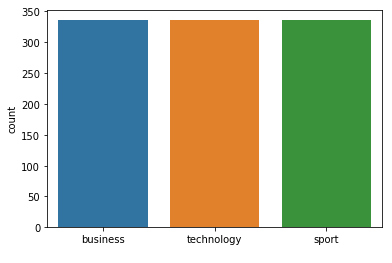



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 165  neighbours): 97.00% (+/- 1.02%)
FOLD 1 Number of neighbors 167
Class Distribution --> Train data (Fold 1 ):


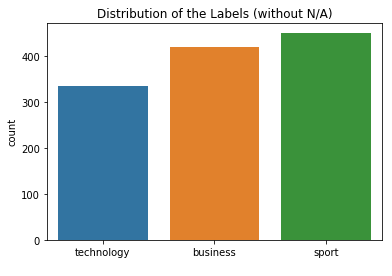

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


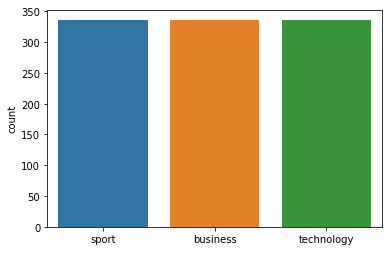



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 167
Class Distribution --> Train data (Fold 2 ):


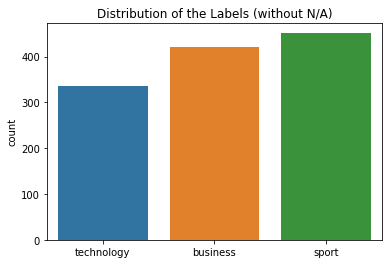

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


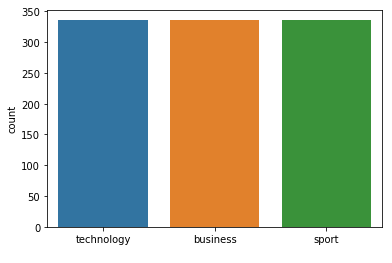



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 167
Class Distribution --> Train data (Fold 3 ):


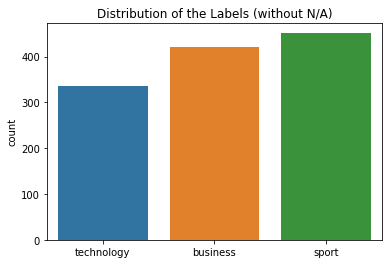

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


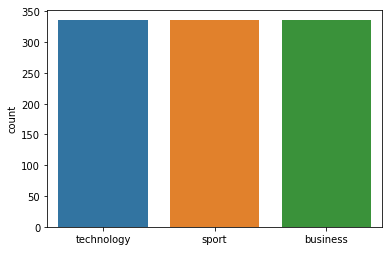



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 167
Class Distribution --> Train data (Fold 4 ):


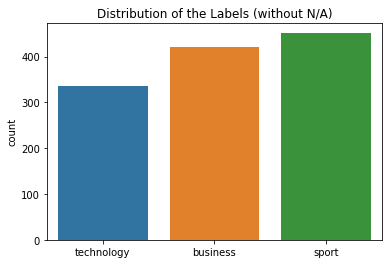

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


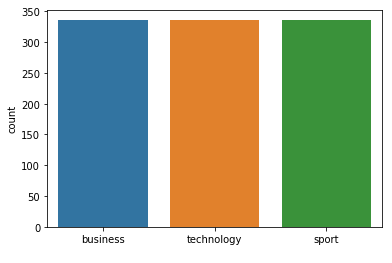



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 167
Class Distribution --> Train data (Fold 5 ):


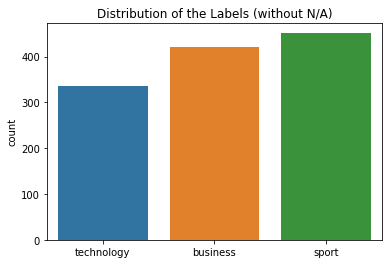

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


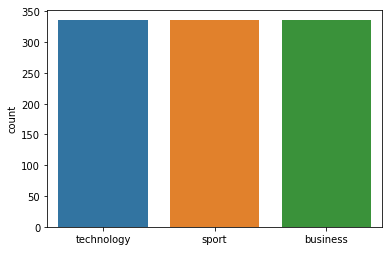



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 167
Class Distribution --> Train data (Fold 6 ):


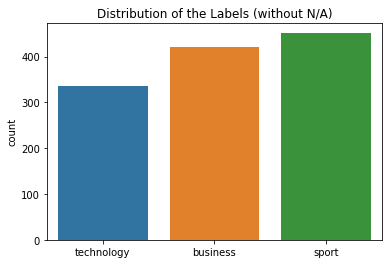

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


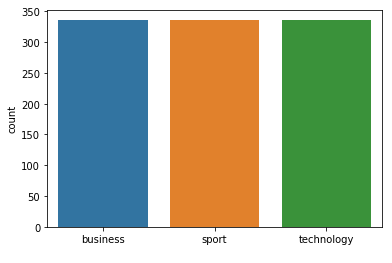



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.95      1.00      0.97        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  3 53]]
FOLD 7 Number of neighbors 167
Class Distribution --> Train data (Fold 7 ):


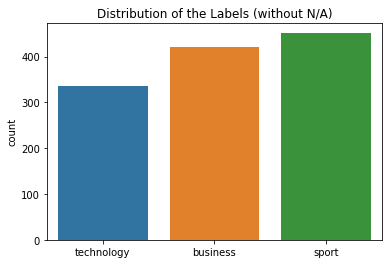

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


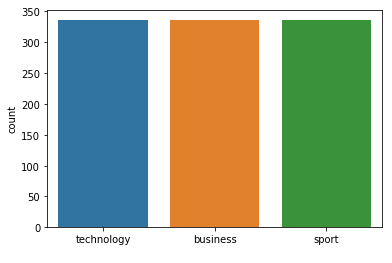



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 167  neighbours): 97.00% (+/- 1.02%)
FOLD 1 Number of neighbors 169
Class Distribution --> Train data (Fold 1 ):


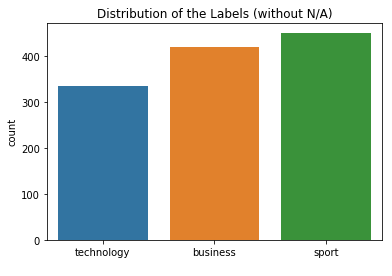

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


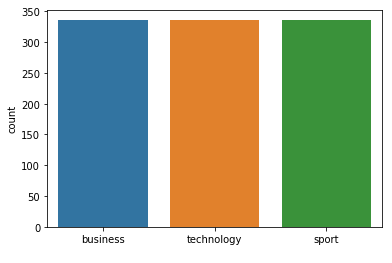



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 169
Class Distribution --> Train data (Fold 2 ):


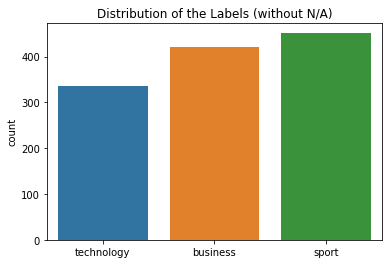

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


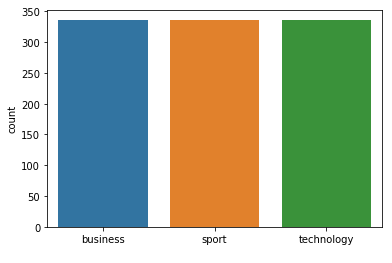



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 169
Class Distribution --> Train data (Fold 3 ):


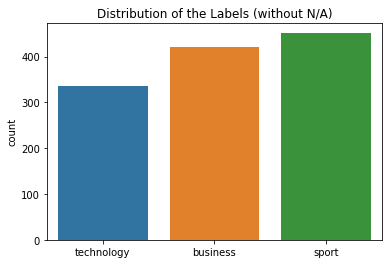

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


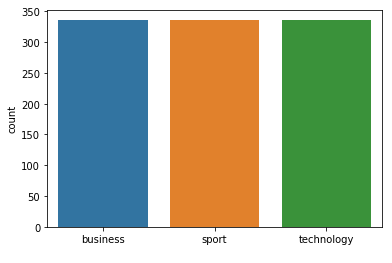



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 169
Class Distribution --> Train data (Fold 4 ):


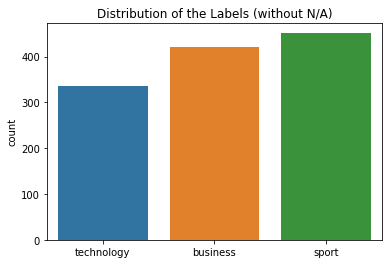

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


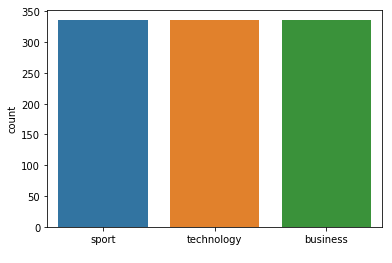



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 169
Class Distribution --> Train data (Fold 5 ):


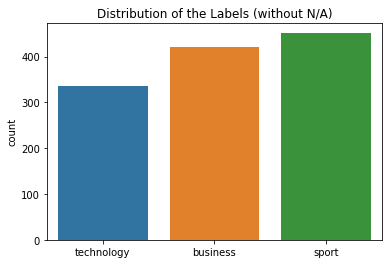

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


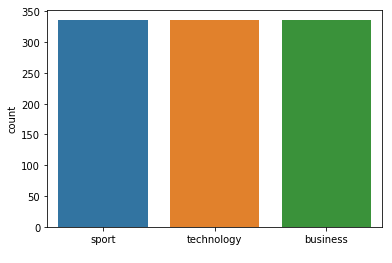



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 169
Class Distribution --> Train data (Fold 6 ):


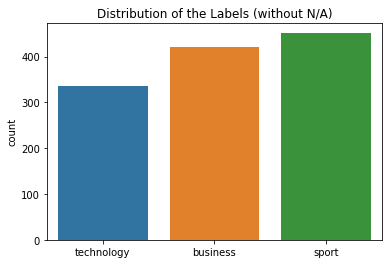

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


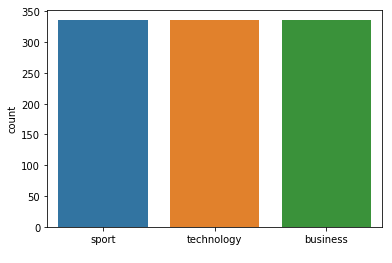



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 169
Class Distribution --> Train data (Fold 7 ):


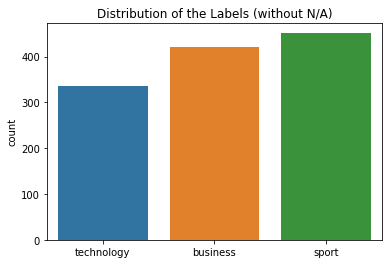

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


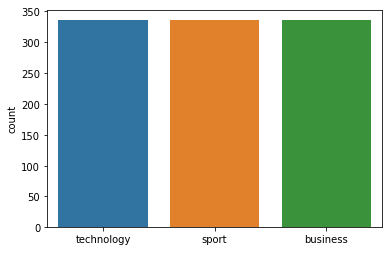



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 169  neighbours): 97.00% (+/- 1.02%)
FOLD 1 Number of neighbors 171
Class Distribution --> Train data (Fold 1 ):


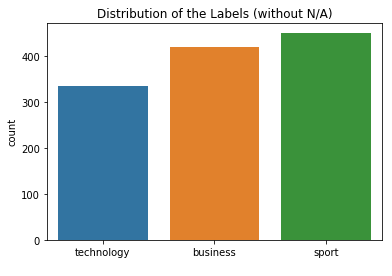

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


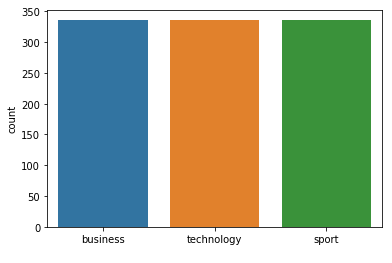



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 171
Class Distribution --> Train data (Fold 2 ):


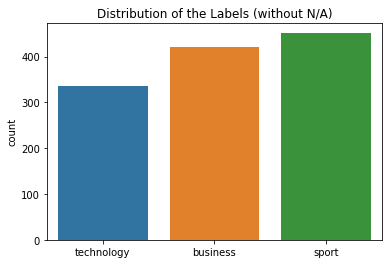

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


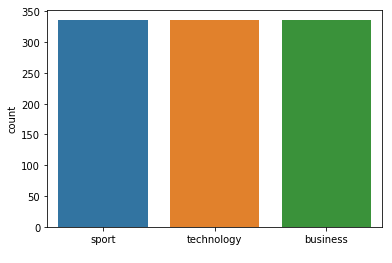



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 171
Class Distribution --> Train data (Fold 3 ):


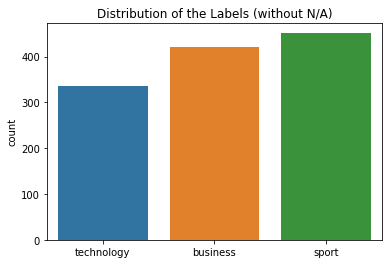

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


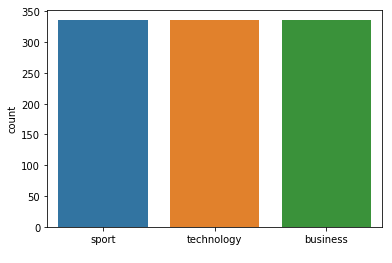



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 171
Class Distribution --> Train data (Fold 4 ):


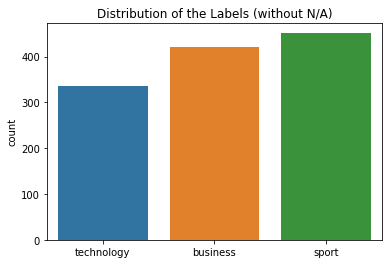

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


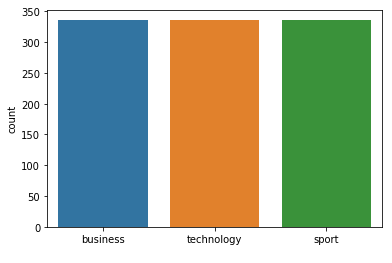



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.98      0.97        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 4 ):
[[67  1  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 171
Class Distribution --> Train data (Fold 5 ):


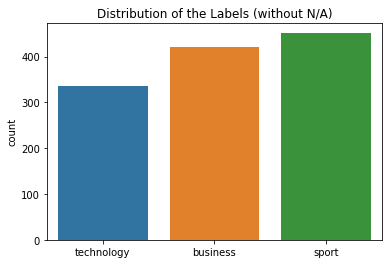

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


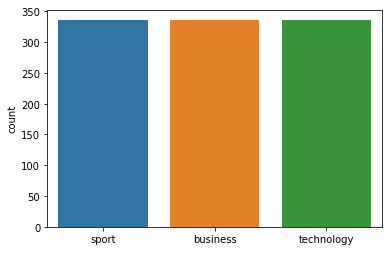



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 171
Class Distribution --> Train data (Fold 6 ):


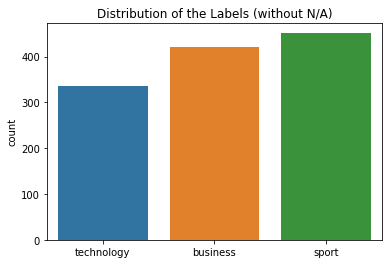

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


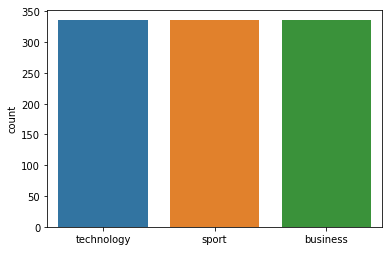



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 171
Class Distribution --> Train data (Fold 7 ):


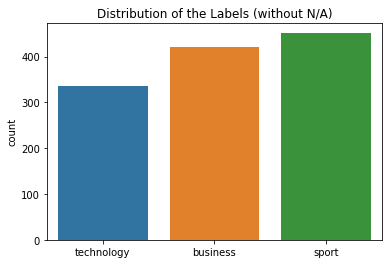

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


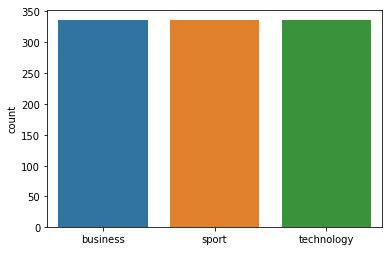



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 171  neighbours): 97.01% (+/- 1.02%)
FOLD 1 Number of neighbors 173
Class Distribution --> Train data (Fold 1 ):


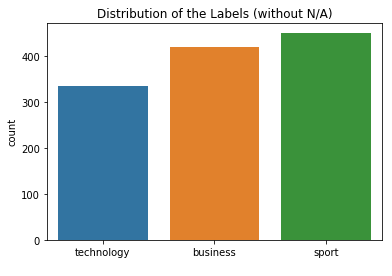

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


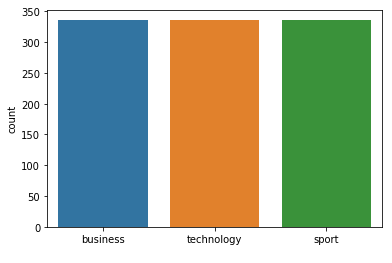



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 173
Class Distribution --> Train data (Fold 2 ):


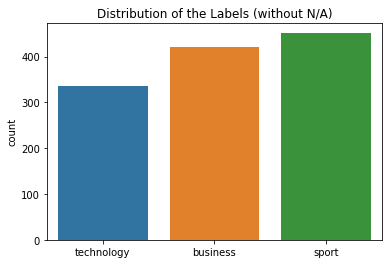

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


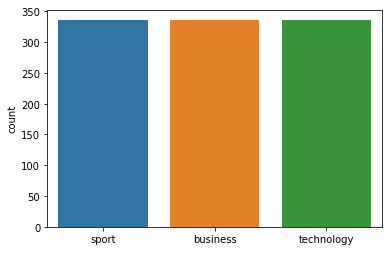



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 173
Class Distribution --> Train data (Fold 3 ):


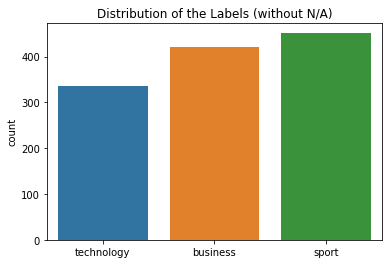

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


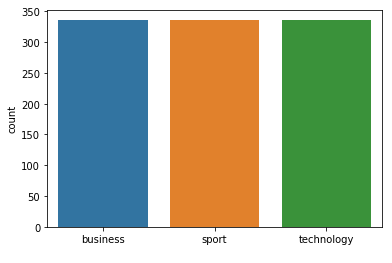



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 173
Class Distribution --> Train data (Fold 4 ):


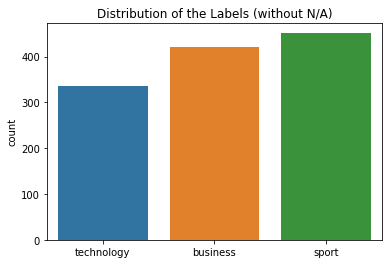

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


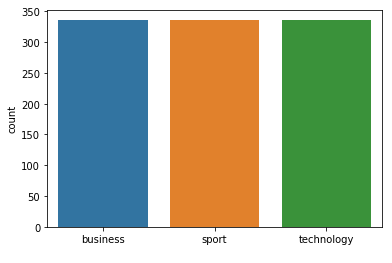



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 173
Class Distribution --> Train data (Fold 5 ):


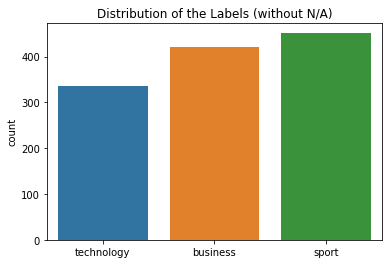

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


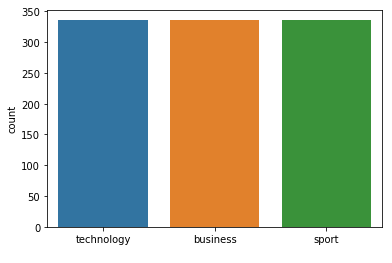



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 173
Class Distribution --> Train data (Fold 6 ):


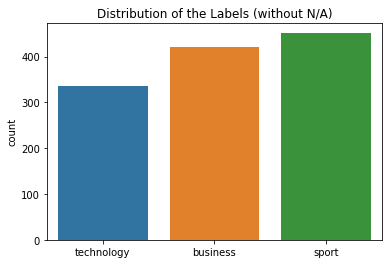

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


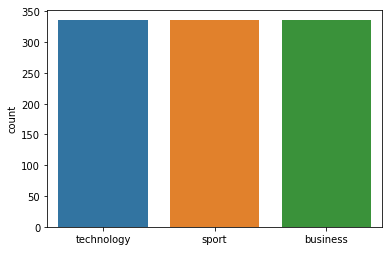



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  1 55]]
FOLD 7 Number of neighbors 173
Class Distribution --> Train data (Fold 7 ):


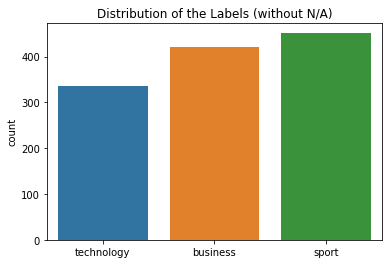

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


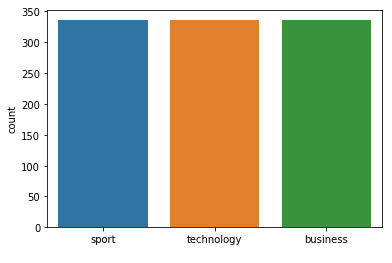



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 173  neighbours): 97.01% (+/- 1.01%)
FOLD 1 Number of neighbors 175
Class Distribution --> Train data (Fold 1 ):


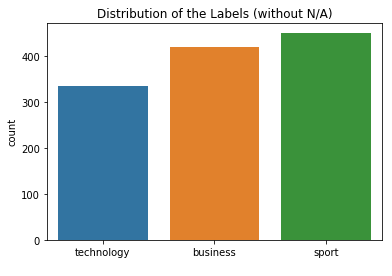

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


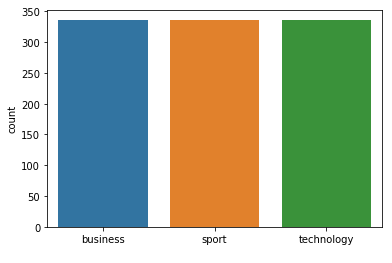



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 175
Class Distribution --> Train data (Fold 2 ):


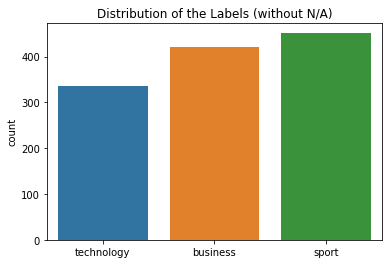

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


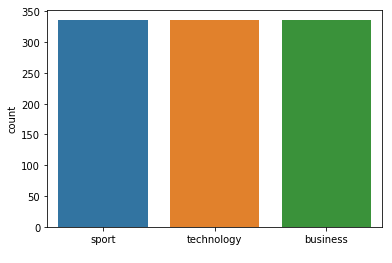



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 175
Class Distribution --> Train data (Fold 3 ):


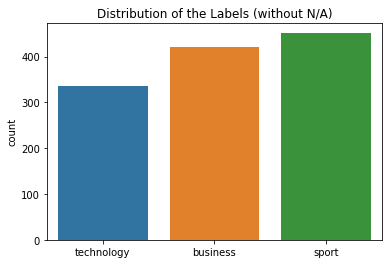

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


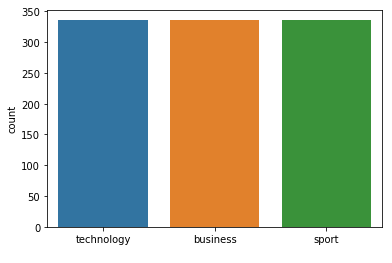



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 175
Class Distribution --> Train data (Fold 4 ):


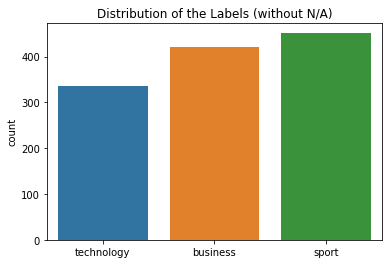

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


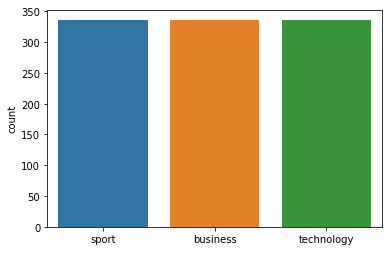



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 175
Class Distribution --> Train data (Fold 5 ):


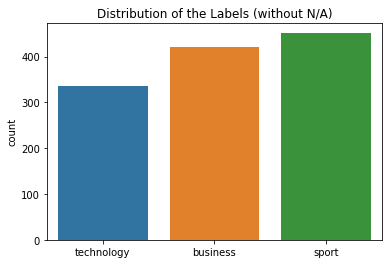

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


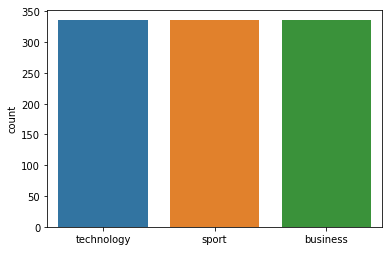



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 2  0 54]]
FOLD 6 Number of neighbors 175
Class Distribution --> Train data (Fold 6 ):


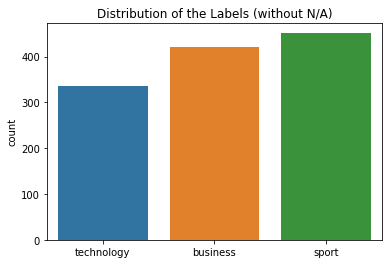

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


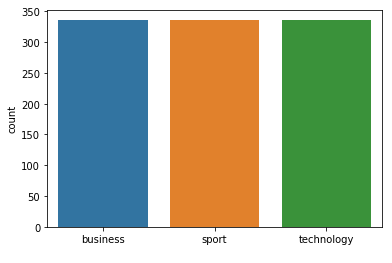



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 175
Class Distribution --> Train data (Fold 7 ):


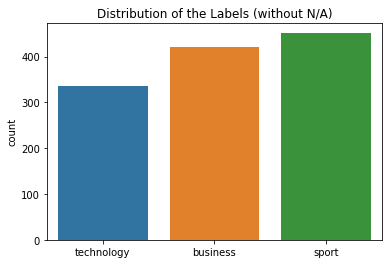

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


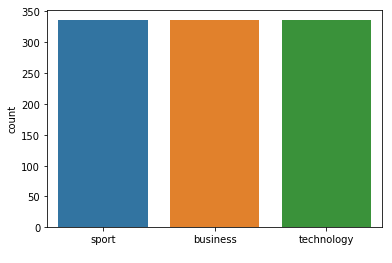



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 175  neighbours): 97.01% (+/- 1.01%)
FOLD 1 Number of neighbors 177
Class Distribution --> Train data (Fold 1 ):


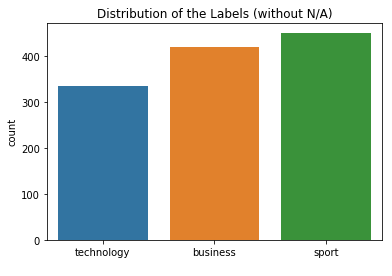

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


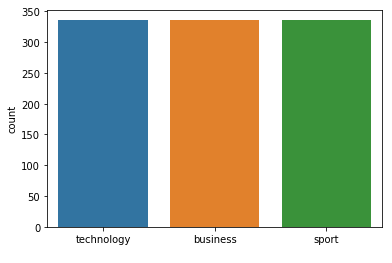



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 177
Class Distribution --> Train data (Fold 2 ):


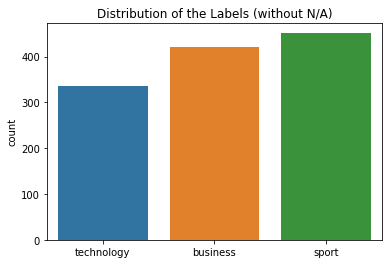

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


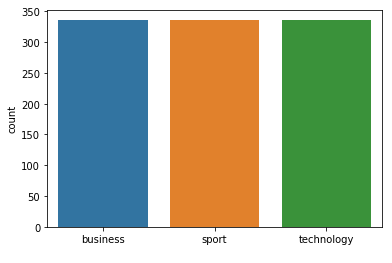



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 177
Class Distribution --> Train data (Fold 3 ):


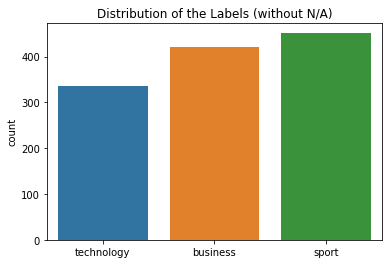

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


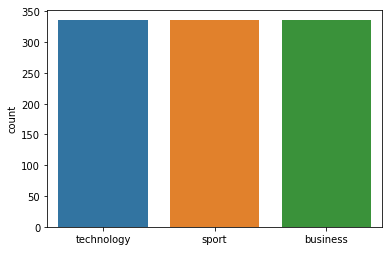



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 177
Class Distribution --> Train data (Fold 4 ):


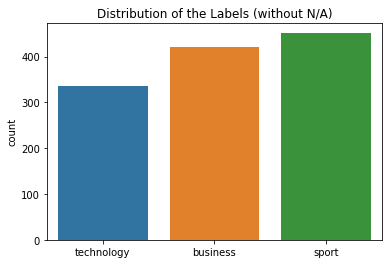

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


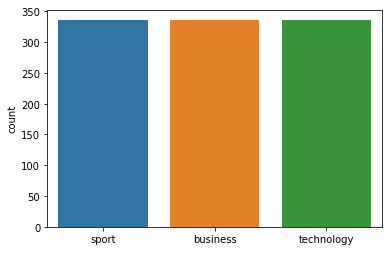



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 177
Class Distribution --> Train data (Fold 5 ):


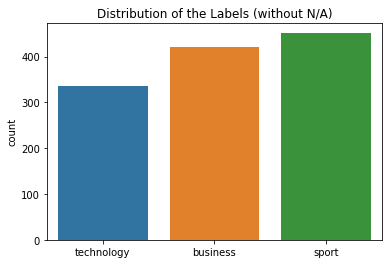

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


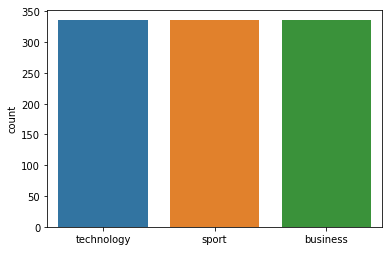



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 177
Class Distribution --> Train data (Fold 6 ):


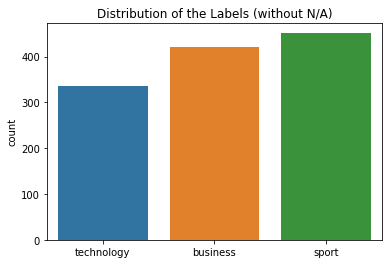

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


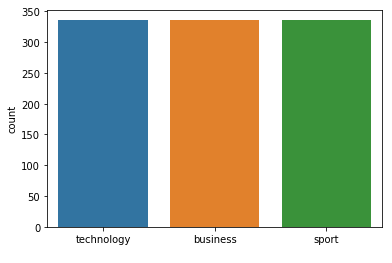



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 177
Class Distribution --> Train data (Fold 7 ):


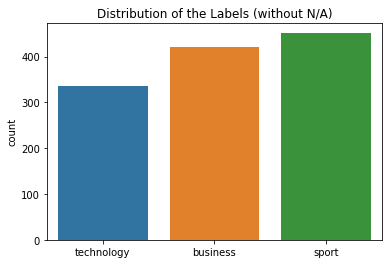

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


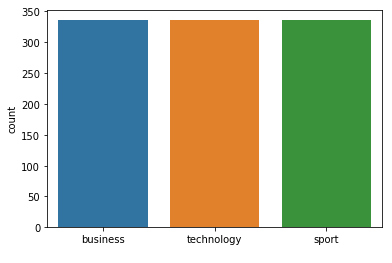



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 177  neighbours): 97.01% (+/- 1.01%)
FOLD 1 Number of neighbors 179
Class Distribution --> Train data (Fold 1 ):


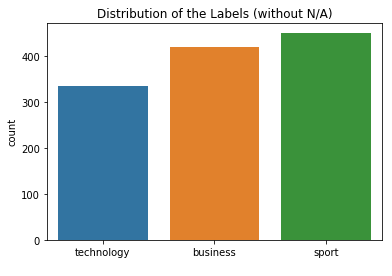

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


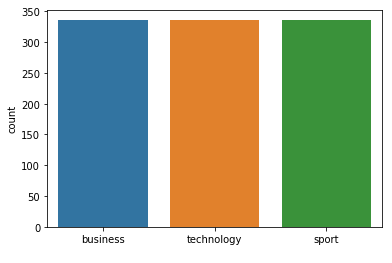



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 179
Class Distribution --> Train data (Fold 2 ):


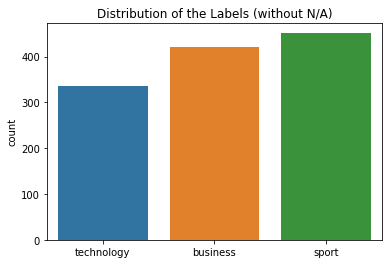

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


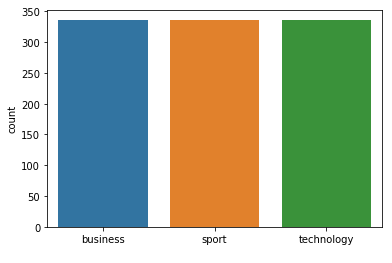



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 179
Class Distribution --> Train data (Fold 3 ):


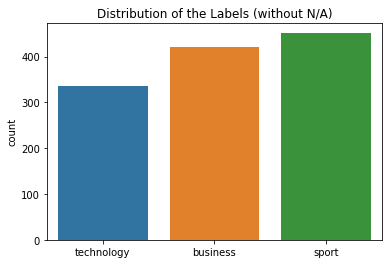

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


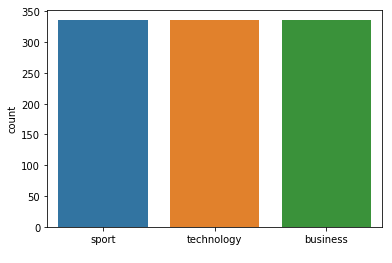



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.95      1.00      0.97        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[65  2  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 179
Class Distribution --> Train data (Fold 4 ):


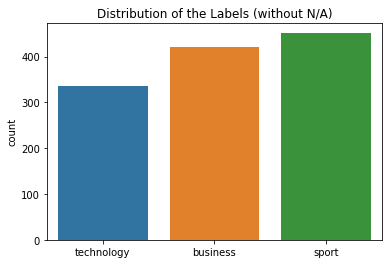

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


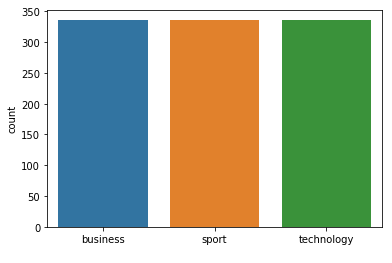



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 179
Class Distribution --> Train data (Fold 5 ):


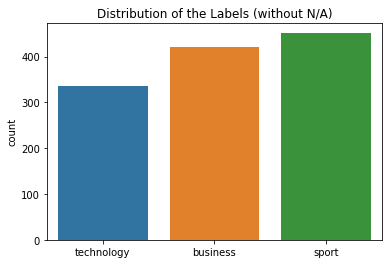

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


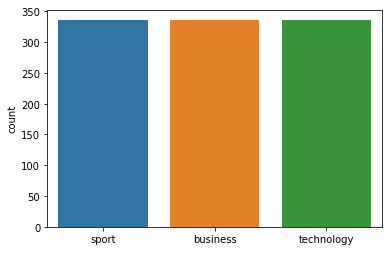



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 179
Class Distribution --> Train data (Fold 6 ):


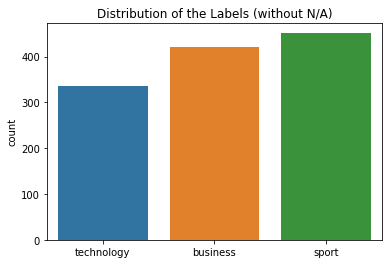

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


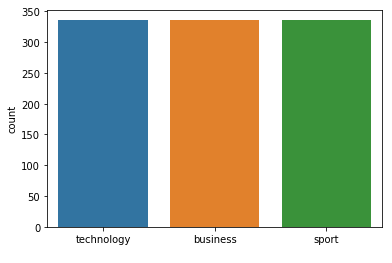



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 179
Class Distribution --> Train data (Fold 7 ):


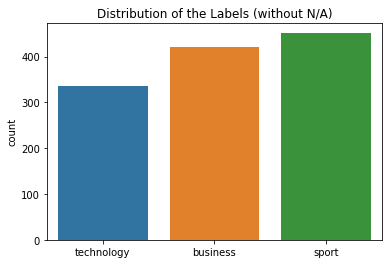

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


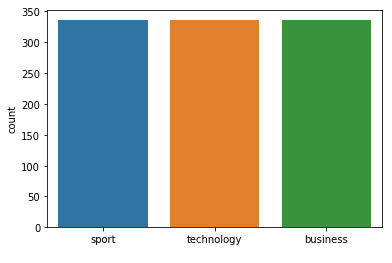



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 179  neighbours): 97.01% (+/- 1.01%)
FOLD 1 Number of neighbors 181
Class Distribution --> Train data (Fold 1 ):


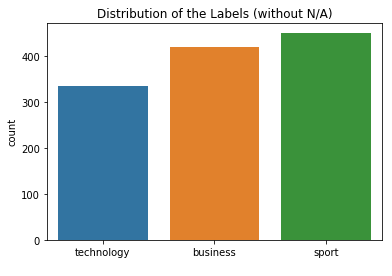

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


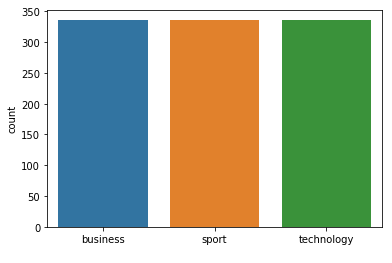



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 181
Class Distribution --> Train data (Fold 2 ):


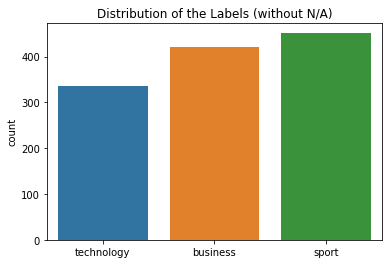

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


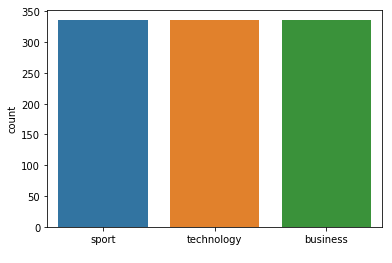



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 181
Class Distribution --> Train data (Fold 3 ):


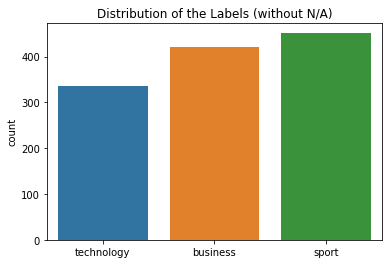

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


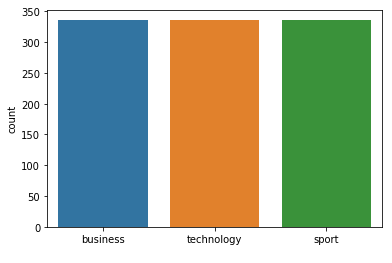



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 181
Class Distribution --> Train data (Fold 4 ):


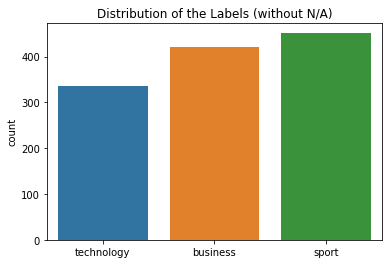

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


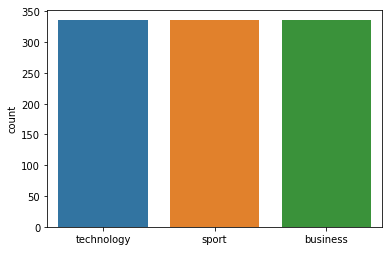



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 181
Class Distribution --> Train data (Fold 5 ):


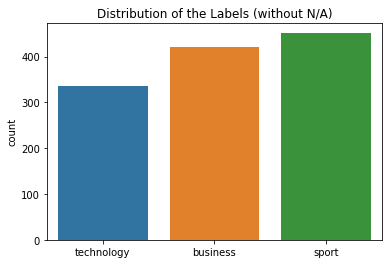

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


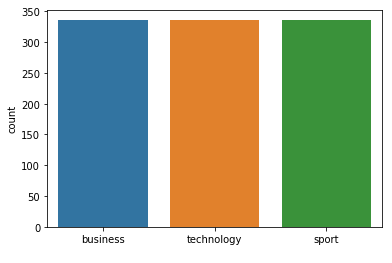



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 181
Class Distribution --> Train data (Fold 6 ):


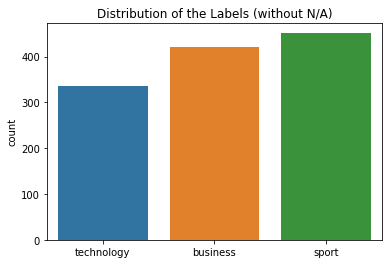

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


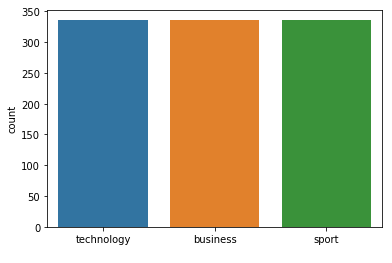



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 181
Class Distribution --> Train data (Fold 7 ):


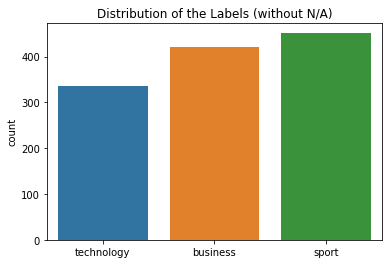

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


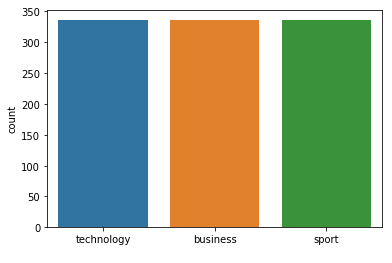



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 181  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 183
Class Distribution --> Train data (Fold 1 ):


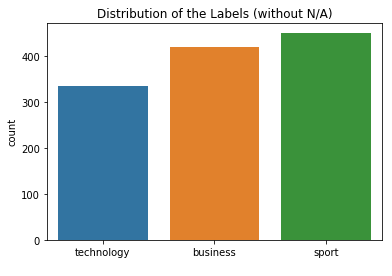

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


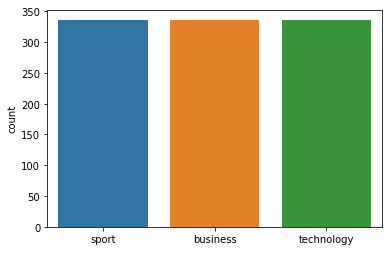



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 183
Class Distribution --> Train data (Fold 2 ):


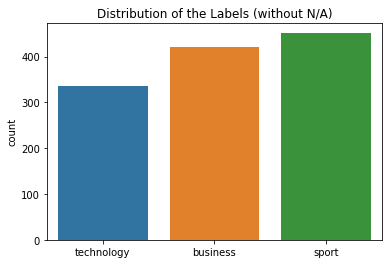

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


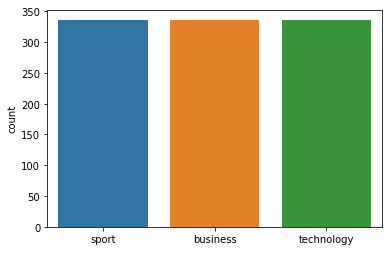



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 183
Class Distribution --> Train data (Fold 3 ):


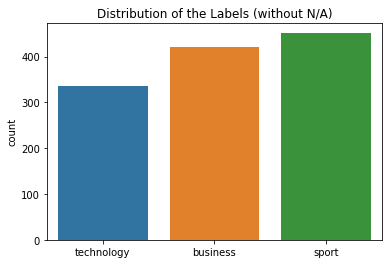

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


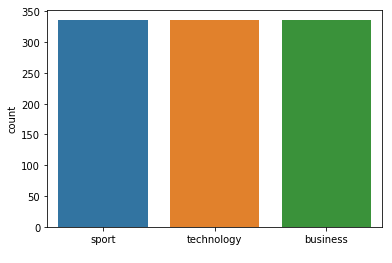



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 183
Class Distribution --> Train data (Fold 4 ):


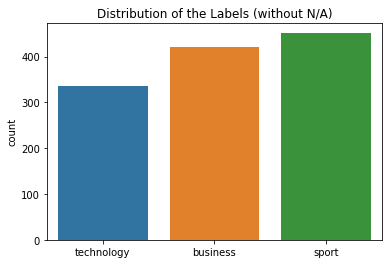

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


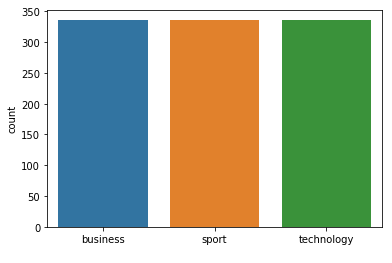



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 183
Class Distribution --> Train data (Fold 5 ):


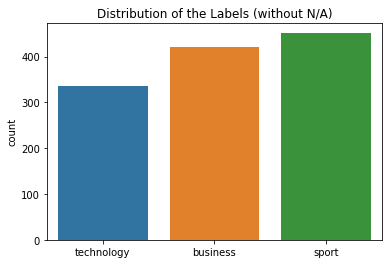

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


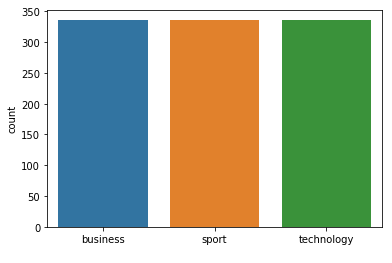



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 183
Class Distribution --> Train data (Fold 6 ):


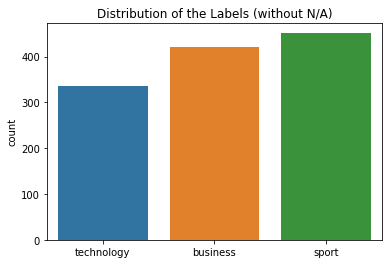

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


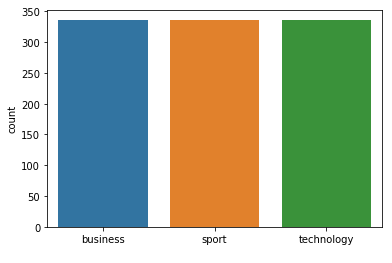



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 183
Class Distribution --> Train data (Fold 7 ):


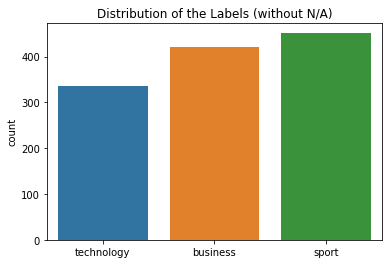

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


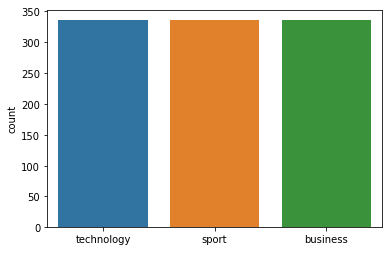



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 183  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 185
Class Distribution --> Train data (Fold 1 ):


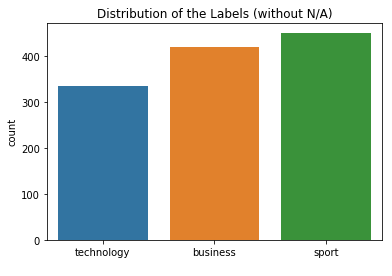

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


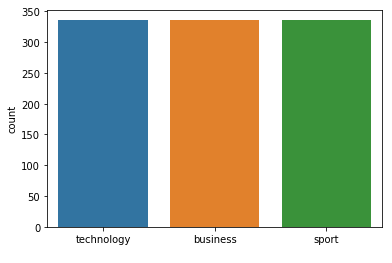



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 185
Class Distribution --> Train data (Fold 2 ):


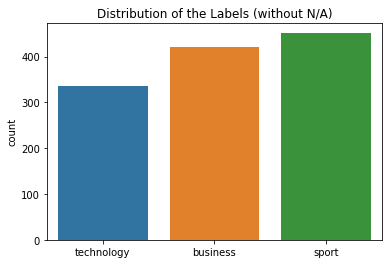

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


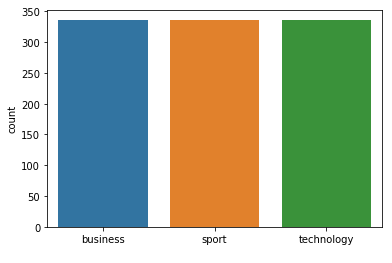



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 185
Class Distribution --> Train data (Fold 3 ):


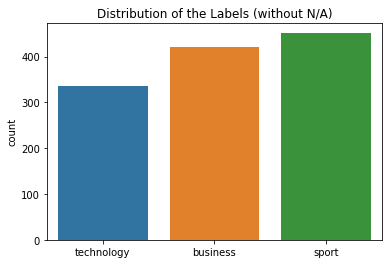

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


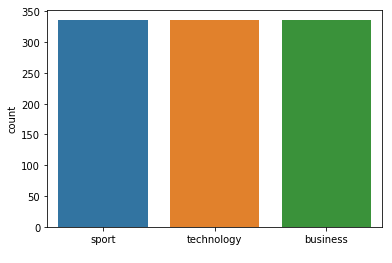



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.90      0.93        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.95      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[63  2  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 185
Class Distribution --> Train data (Fold 4 ):


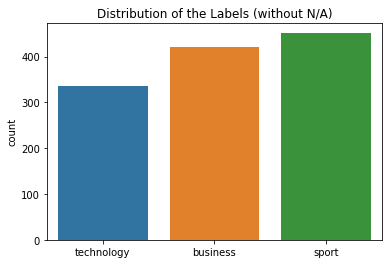

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


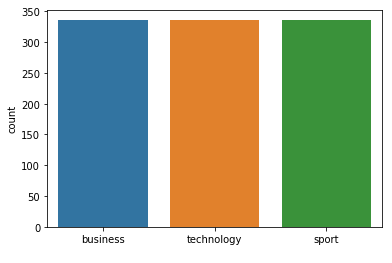



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 185
Class Distribution --> Train data (Fold 5 ):


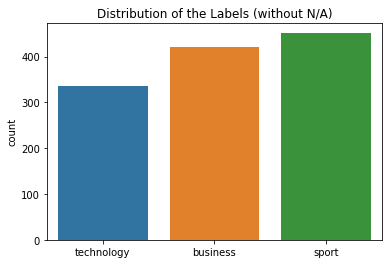

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


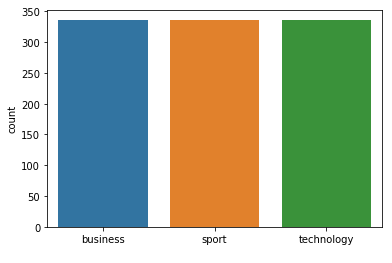



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 185
Class Distribution --> Train data (Fold 6 ):


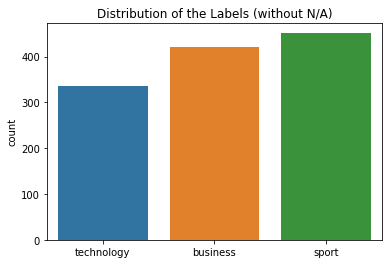

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


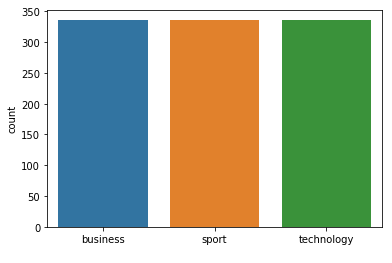



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 185
Class Distribution --> Train data (Fold 7 ):


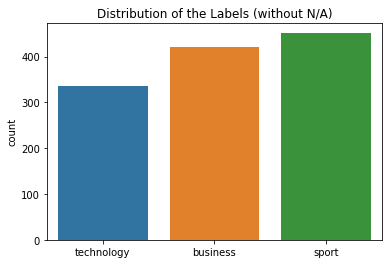

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


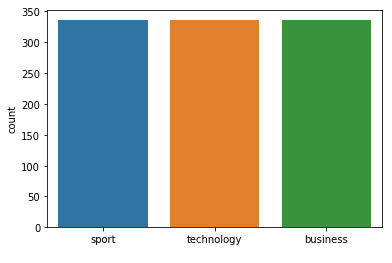



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 185  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 187
Class Distribution --> Train data (Fold 1 ):


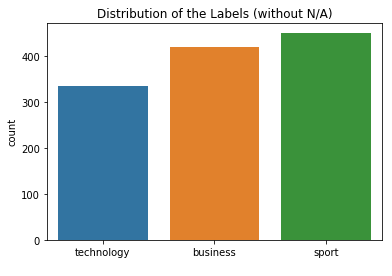

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


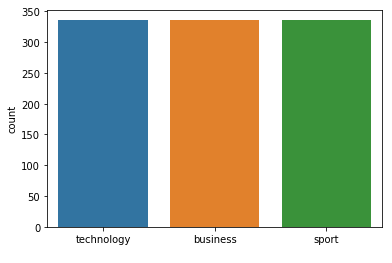



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 187
Class Distribution --> Train data (Fold 2 ):


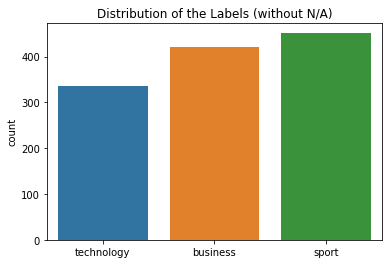

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


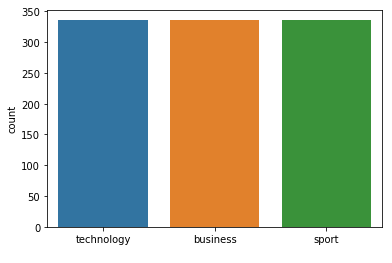



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.96      0.95        70
     sport
       0.96      0.96      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[67  1  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 187
Class Distribution --> Train data (Fold 3 ):


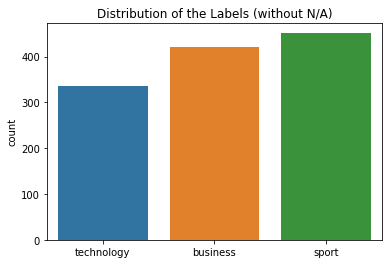

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


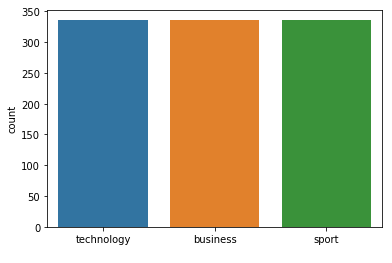



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 187
Class Distribution --> Train data (Fold 4 ):


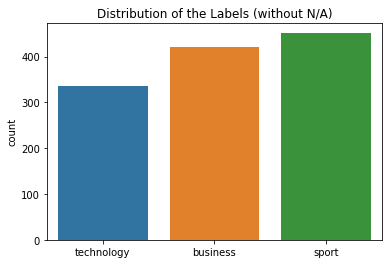

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


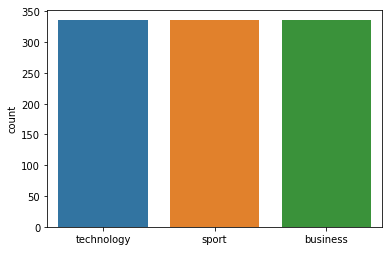



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 187
Class Distribution --> Train data (Fold 5 ):


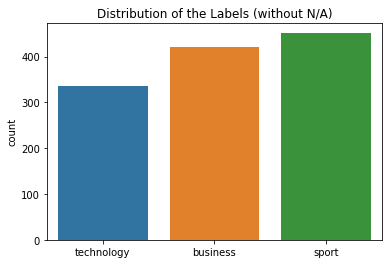

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


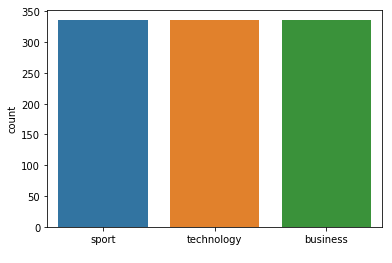



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 187
Class Distribution --> Train data (Fold 6 ):


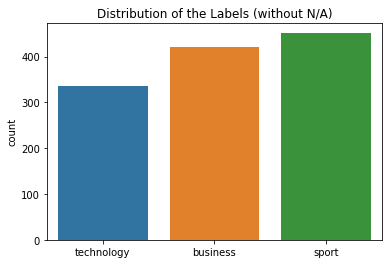

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


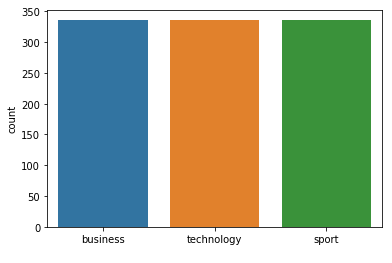



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 187
Class Distribution --> Train data (Fold 7 ):


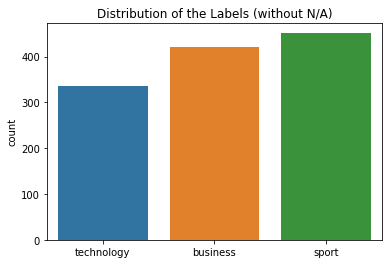

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


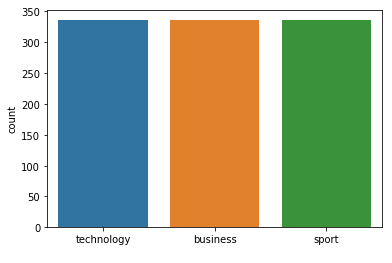



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 187  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 189
Class Distribution --> Train data (Fold 1 ):


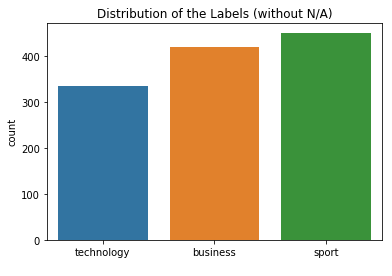

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


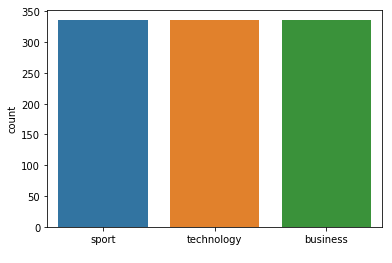



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 189
Class Distribution --> Train data (Fold 2 ):


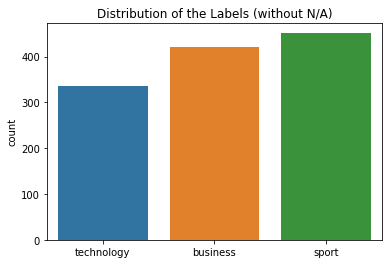

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


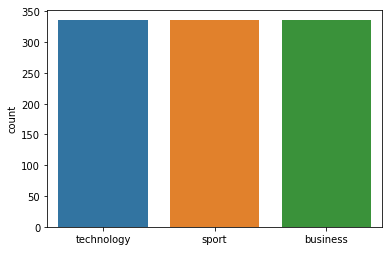



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 189
Class Distribution --> Train data (Fold 3 ):


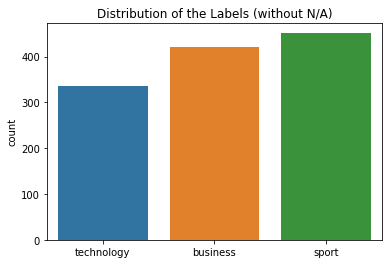

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


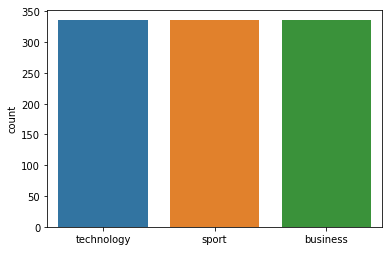



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 189
Class Distribution --> Train data (Fold 4 ):


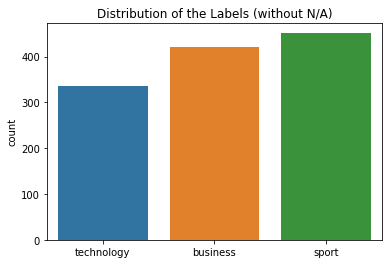

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


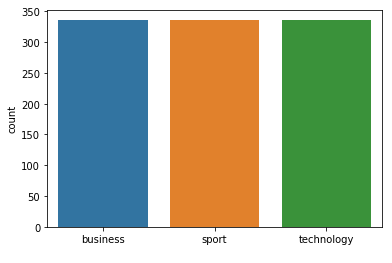



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 189
Class Distribution --> Train data (Fold 5 ):


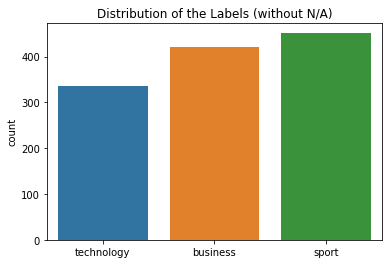

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


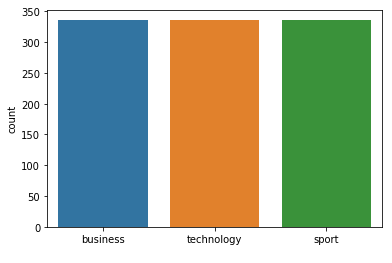



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 189
Class Distribution --> Train data (Fold 6 ):


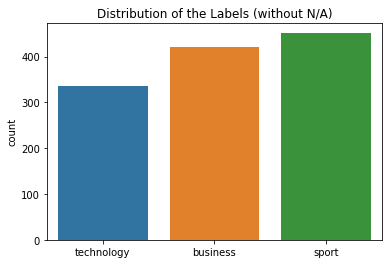

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


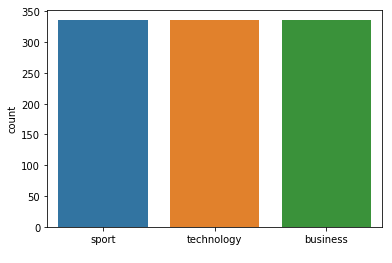



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 189
Class Distribution --> Train data (Fold 7 ):


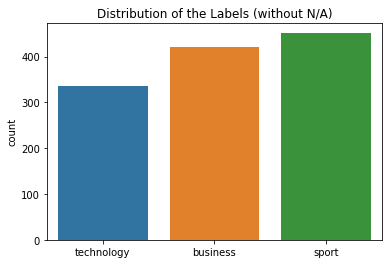

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


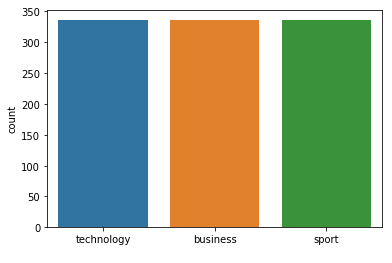



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 189  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 191
Class Distribution --> Train data (Fold 1 ):


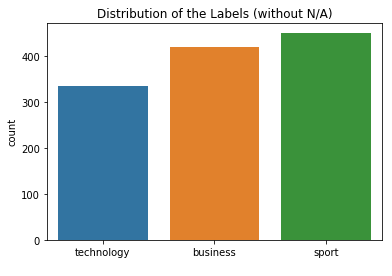

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


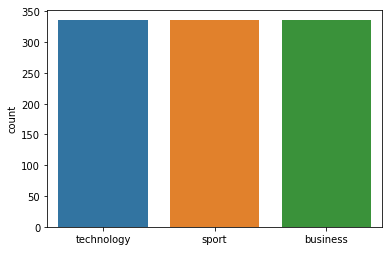



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 191
Class Distribution --> Train data (Fold 2 ):


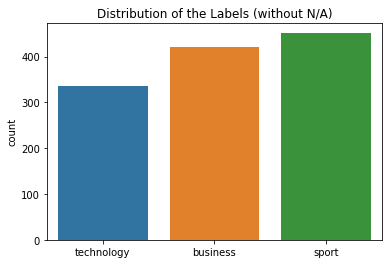

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


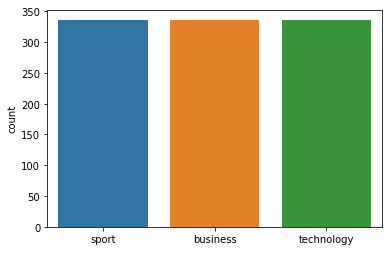



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 191
Class Distribution --> Train data (Fold 3 ):


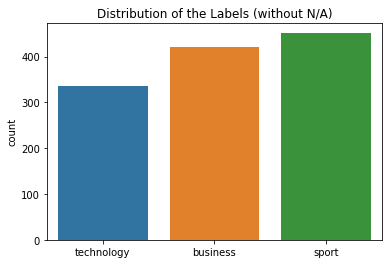

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


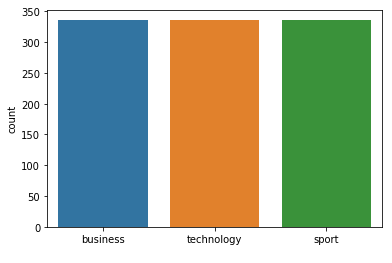



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 191
Class Distribution --> Train data (Fold 4 ):


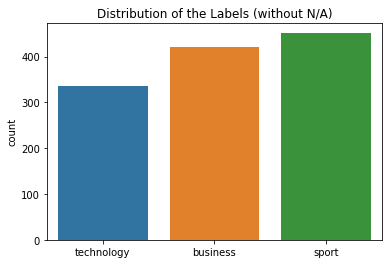

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


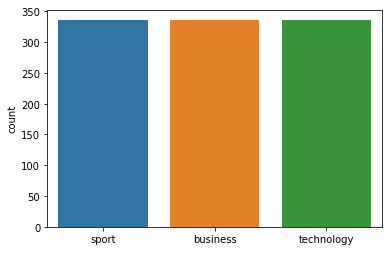



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 191
Class Distribution --> Train data (Fold 5 ):


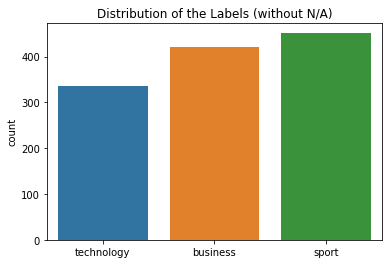

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


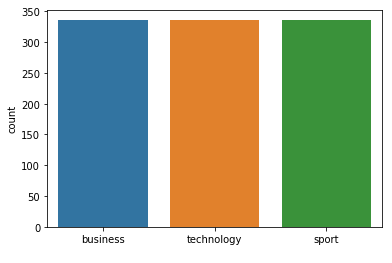



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 191
Class Distribution --> Train data (Fold 6 ):


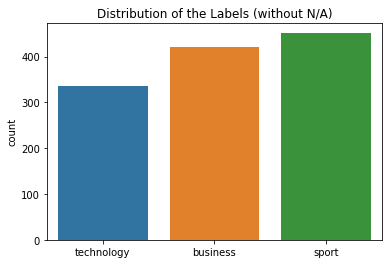

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


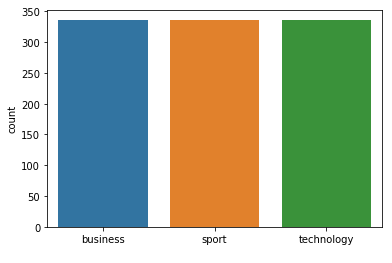



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 191
Class Distribution --> Train data (Fold 7 ):


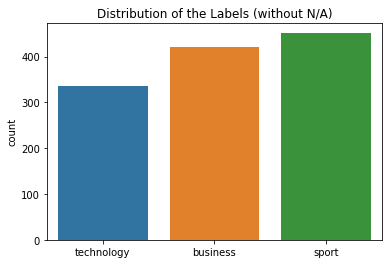

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


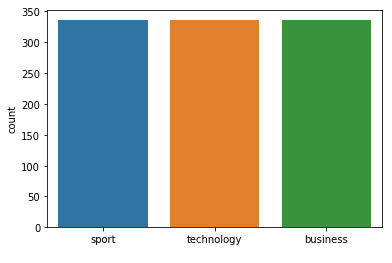



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 191  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 193
Class Distribution --> Train data (Fold 1 ):


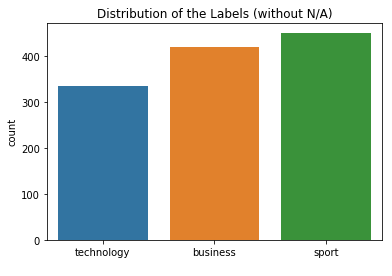

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


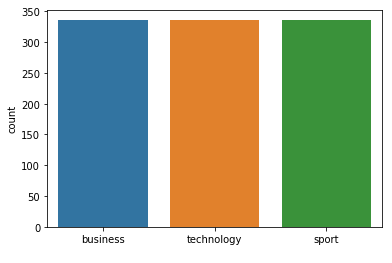



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 193
Class Distribution --> Train data (Fold 2 ):


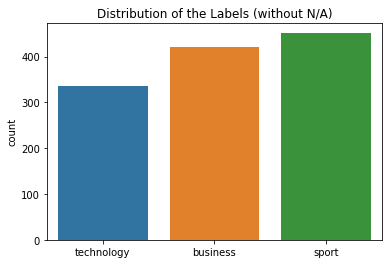

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


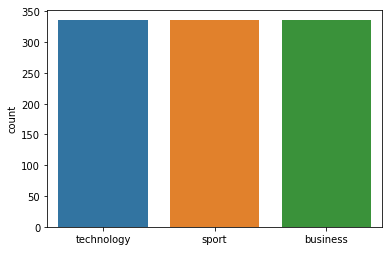



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 193
Class Distribution --> Train data (Fold 3 ):


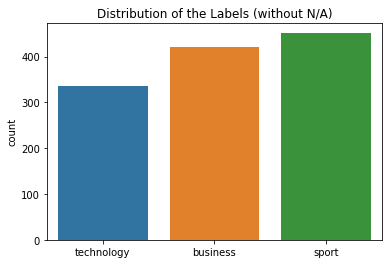

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


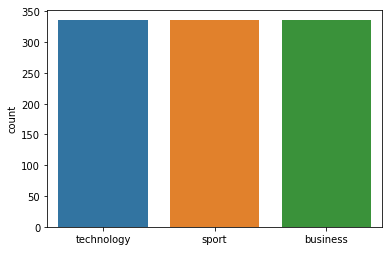



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 193
Class Distribution --> Train data (Fold 4 ):


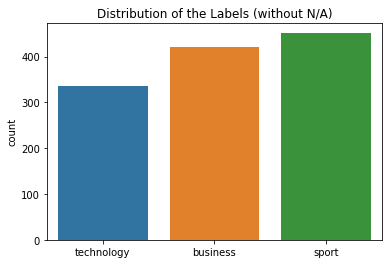

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


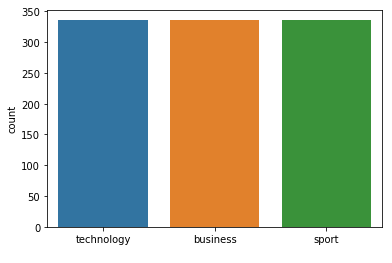



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 193
Class Distribution --> Train data (Fold 5 ):


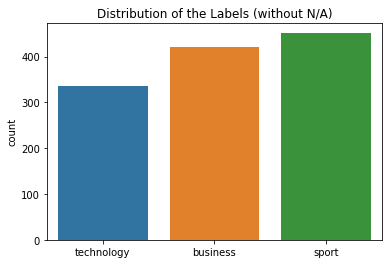

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


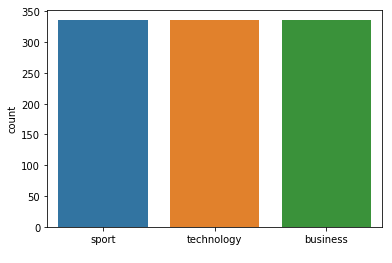



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 193
Class Distribution --> Train data (Fold 6 ):


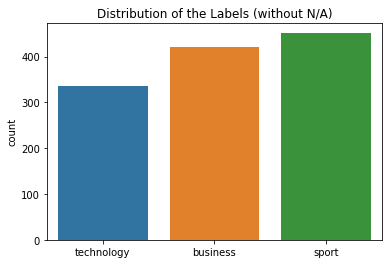

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


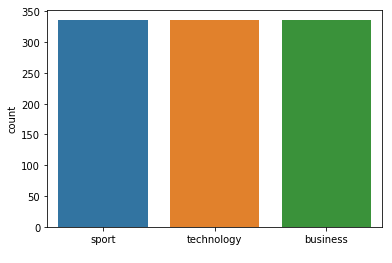



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 193
Class Distribution --> Train data (Fold 7 ):


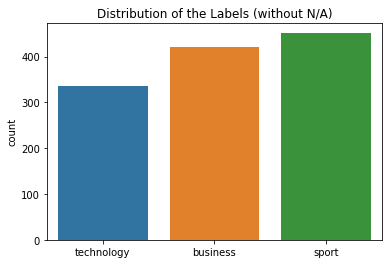

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


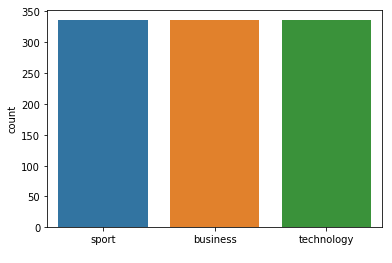



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 193  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 195
Class Distribution --> Train data (Fold 1 ):


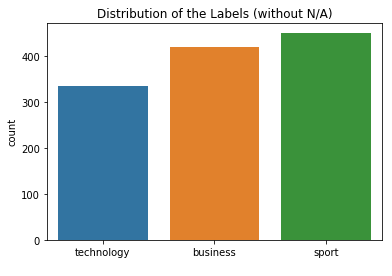

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


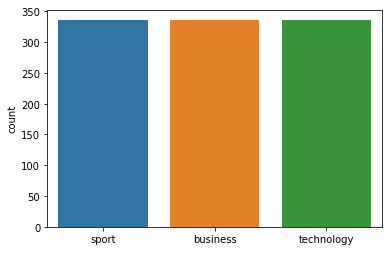



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 195
Class Distribution --> Train data (Fold 2 ):


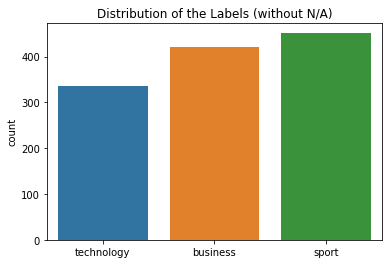

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


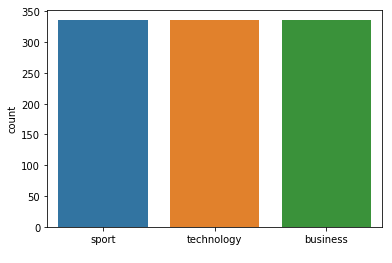



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 195
Class Distribution --> Train data (Fold 3 ):


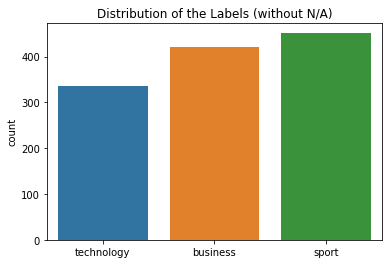

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


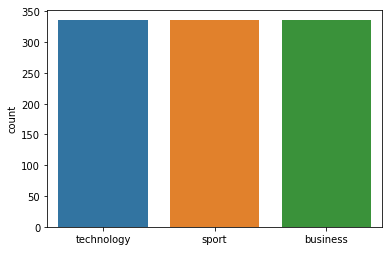



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.97      1.00      0.99        75
technology
       0.91      0.95      0.93        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 195
Class Distribution --> Train data (Fold 4 ):


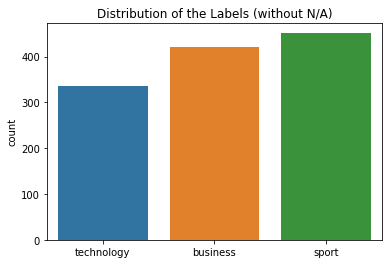

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


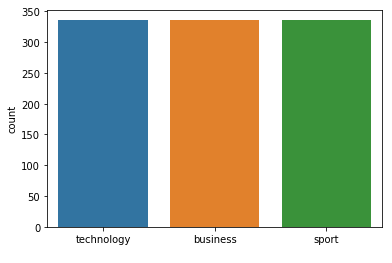



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 195
Class Distribution --> Train data (Fold 5 ):


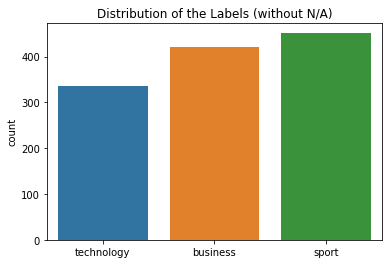

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


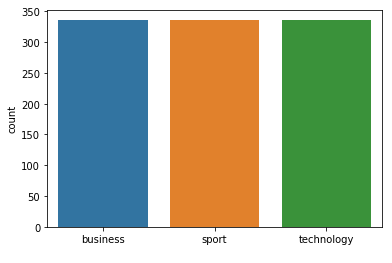



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 195
Class Distribution --> Train data (Fold 6 ):


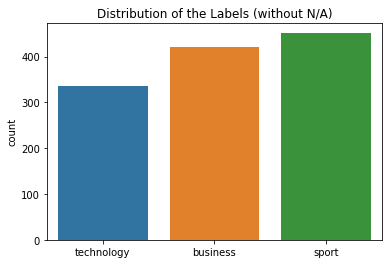

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


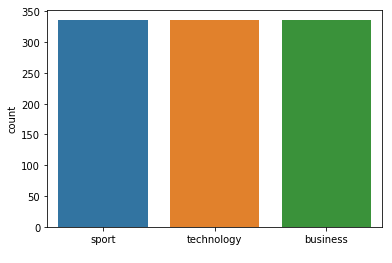



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 195
Class Distribution --> Train data (Fold 7 ):


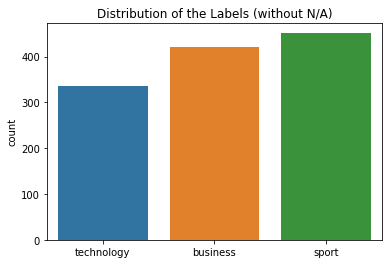

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


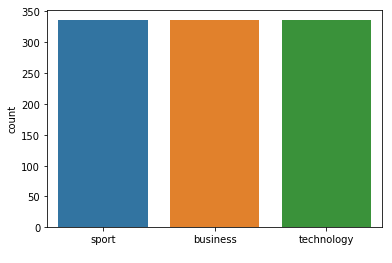



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 195  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 197
Class Distribution --> Train data (Fold 1 ):


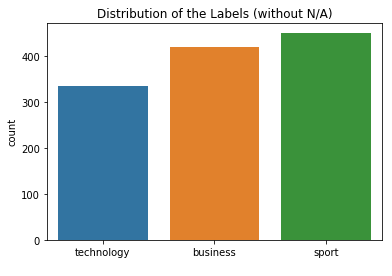

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


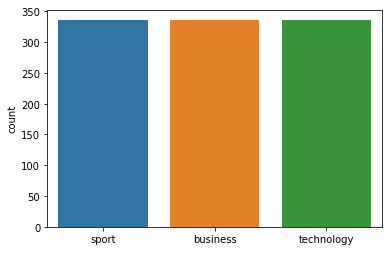



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 197
Class Distribution --> Train data (Fold 2 ):


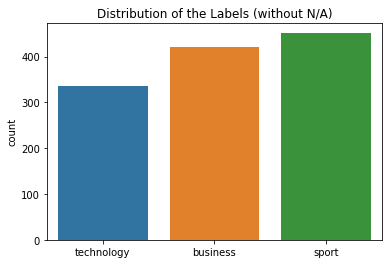

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


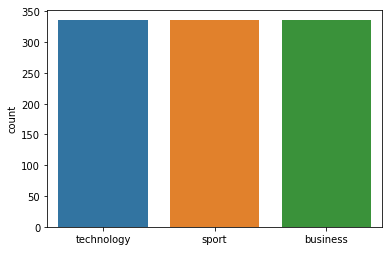



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 197
Class Distribution --> Train data (Fold 3 ):


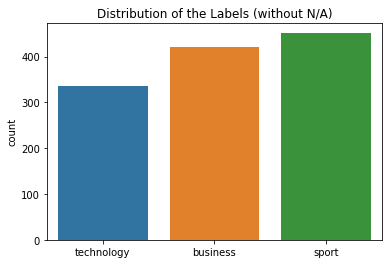

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


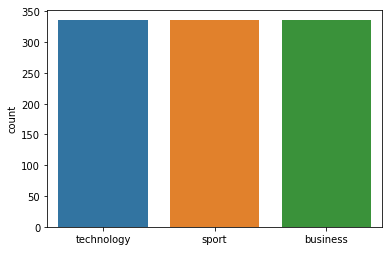



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 197
Class Distribution --> Train data (Fold 4 ):


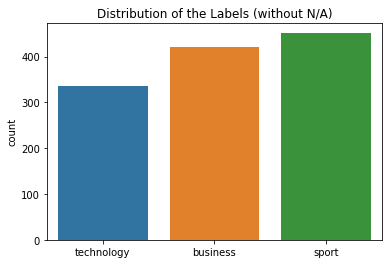

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


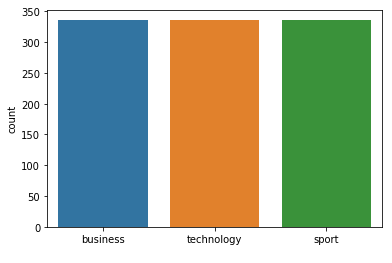



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 197
Class Distribution --> Train data (Fold 5 ):


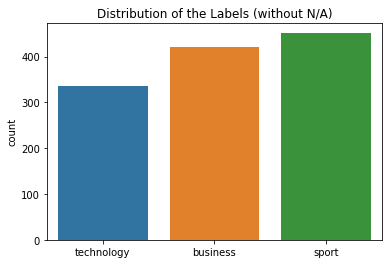

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


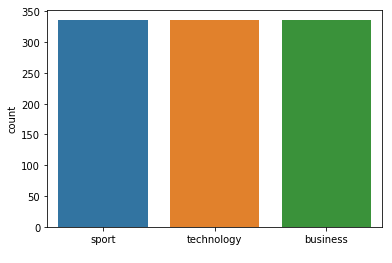



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 197
Class Distribution --> Train data (Fold 6 ):


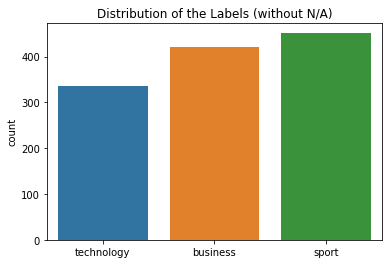

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


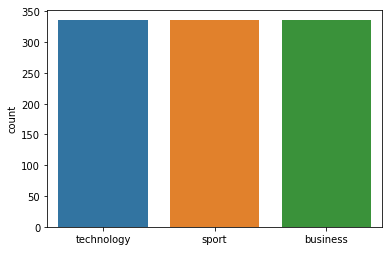



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 197
Class Distribution --> Train data (Fold 7 ):


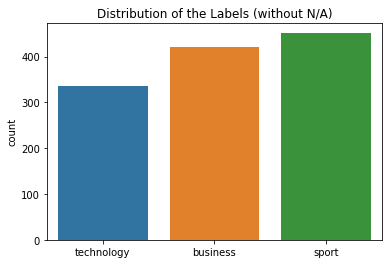

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


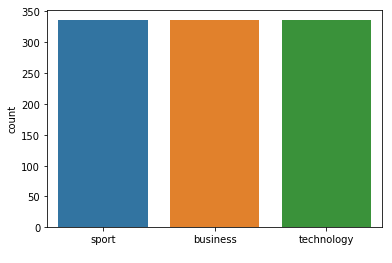



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 197  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 199
Class Distribution --> Train data (Fold 1 ):


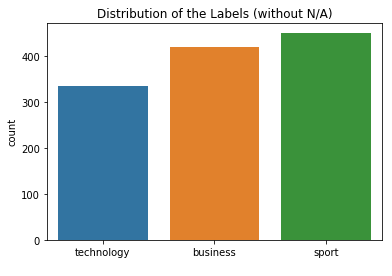

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


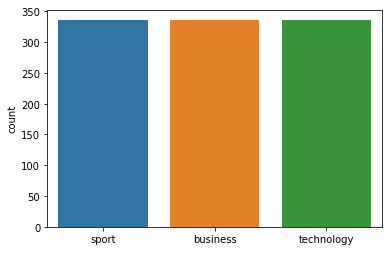



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.99      1.00      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.99      0.99      0.99       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 199
Class Distribution --> Train data (Fold 2 ):


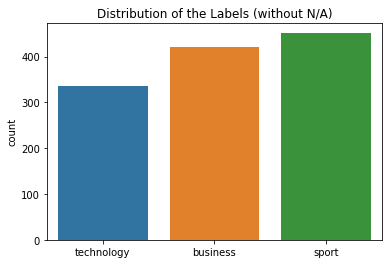

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


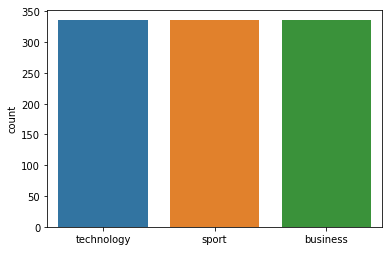



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 199
Class Distribution --> Train data (Fold 3 ):


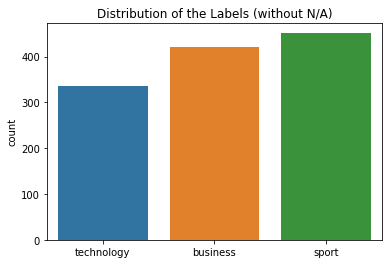

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


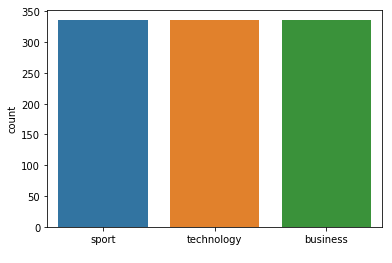



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 199
Class Distribution --> Train data (Fold 4 ):


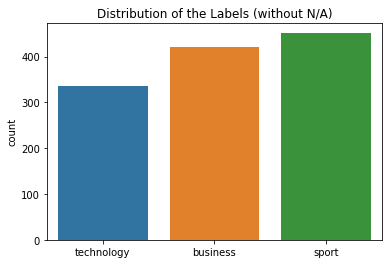

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


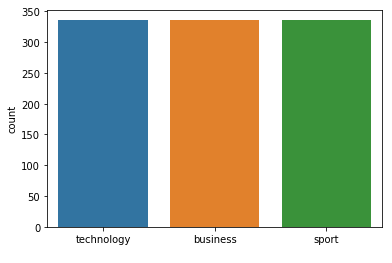



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 199
Class Distribution --> Train data (Fold 5 ):


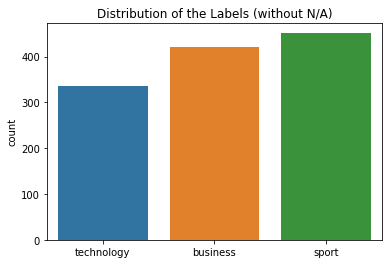

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


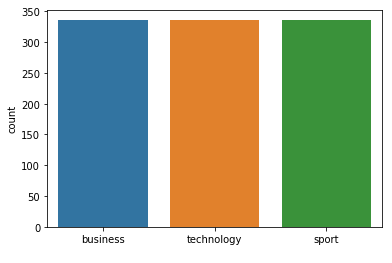



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 199
Class Distribution --> Train data (Fold 6 ):


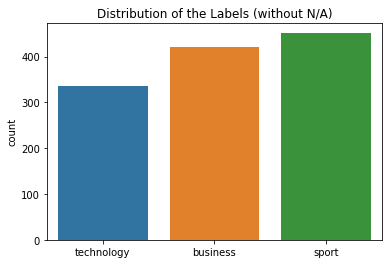

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


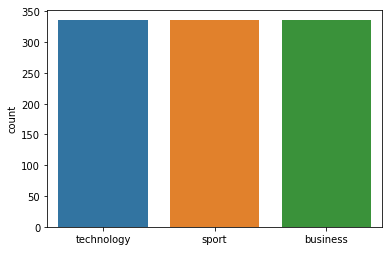



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 199
Class Distribution --> Train data (Fold 7 ):


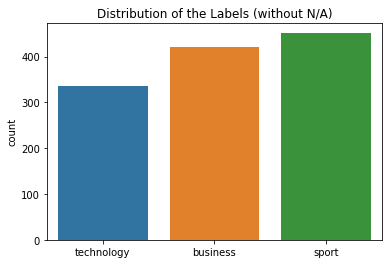

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


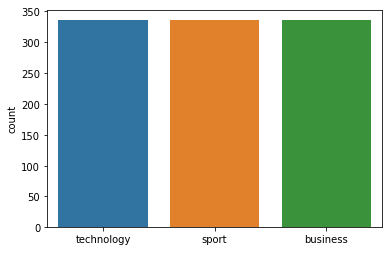



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 199  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 201
Class Distribution --> Train data (Fold 1 ):


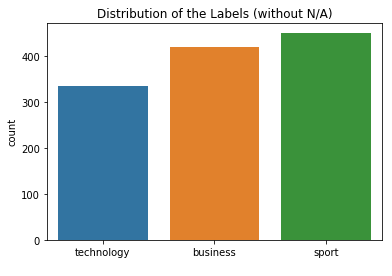

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


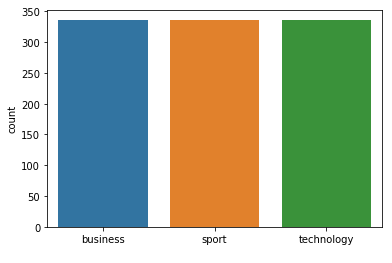



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.99      0.97      0.98        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 201
Class Distribution --> Train data (Fold 2 ):


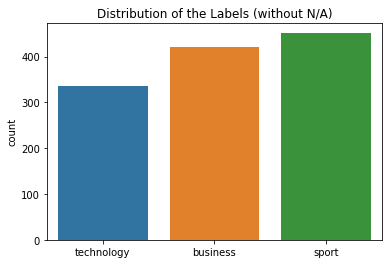

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


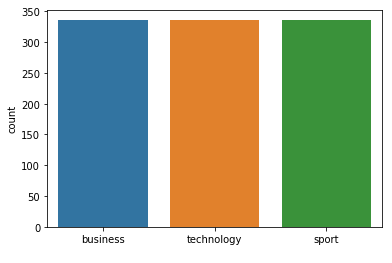



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 201
Class Distribution --> Train data (Fold 3 ):


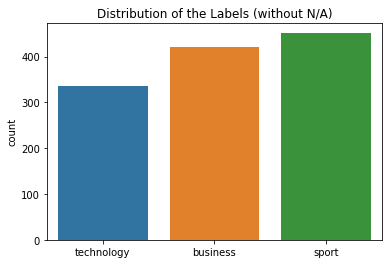

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


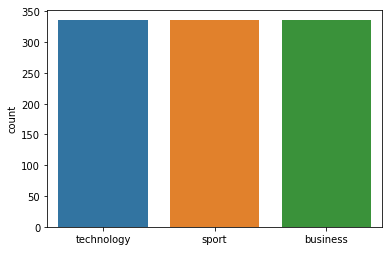



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 201
Class Distribution --> Train data (Fold 4 ):


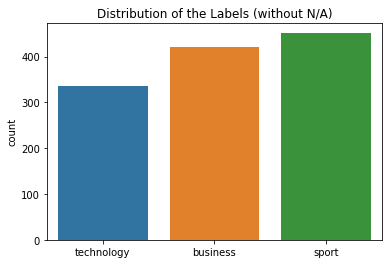

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


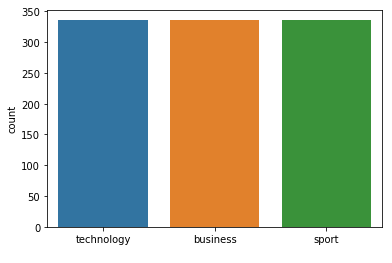



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.96      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 1  1 54]]
FOLD 5 Number of neighbors 201
Class Distribution --> Train data (Fold 5 ):


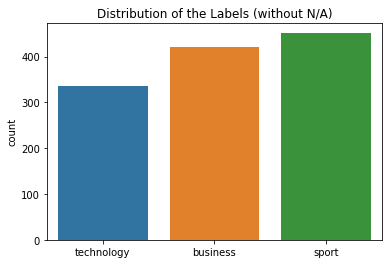

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


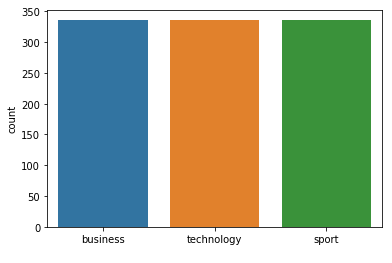



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 201
Class Distribution --> Train data (Fold 6 ):


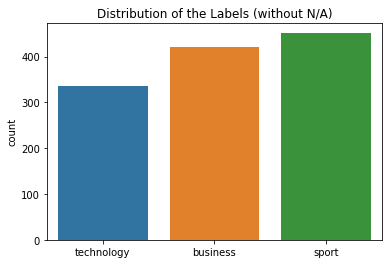

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


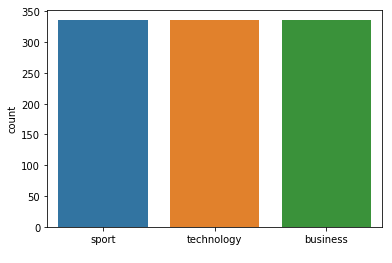



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 201
Class Distribution --> Train data (Fold 7 ):


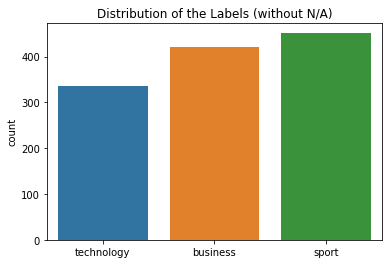

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


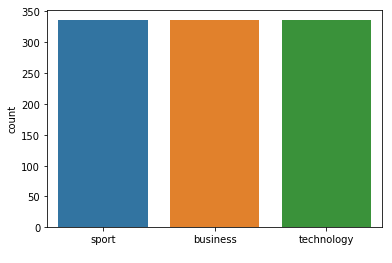



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 201  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 203
Class Distribution --> Train data (Fold 1 ):


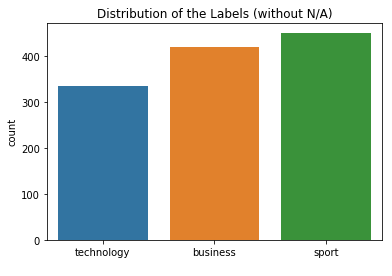

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


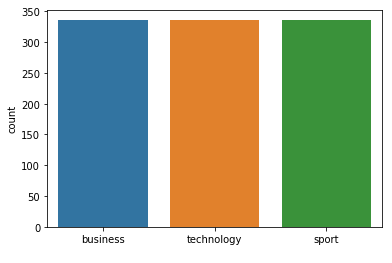



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 203
Class Distribution --> Train data (Fold 2 ):


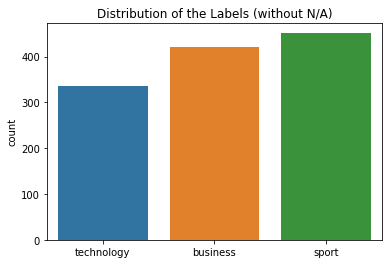

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


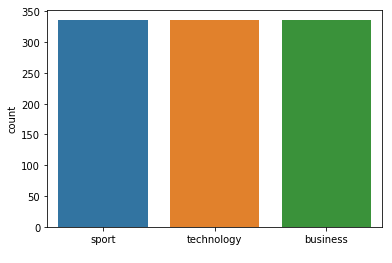



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 203
Class Distribution --> Train data (Fold 3 ):


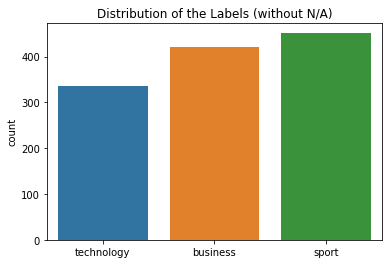

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


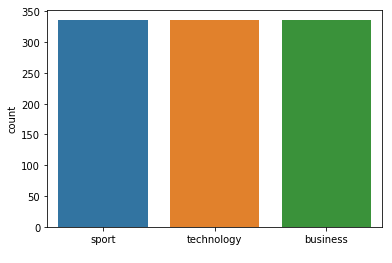



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.91      0.93      0.92        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[64  1  5]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 203
Class Distribution --> Train data (Fold 4 ):


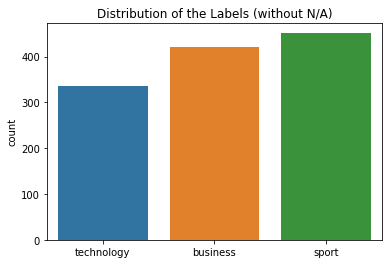

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


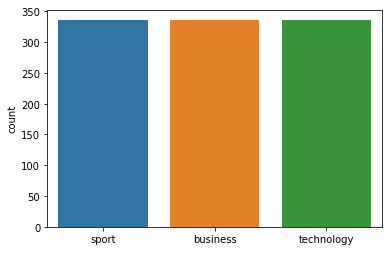



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 203
Class Distribution --> Train data (Fold 5 ):


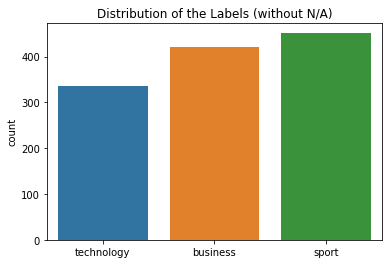

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


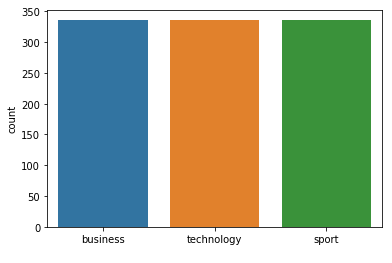



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 203
Class Distribution --> Train data (Fold 6 ):


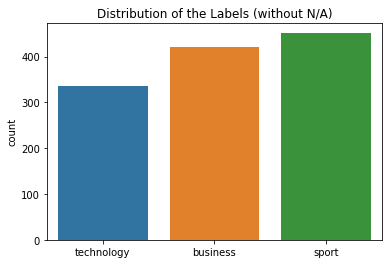

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


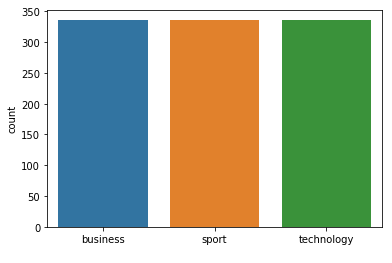



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 203
Class Distribution --> Train data (Fold 7 ):


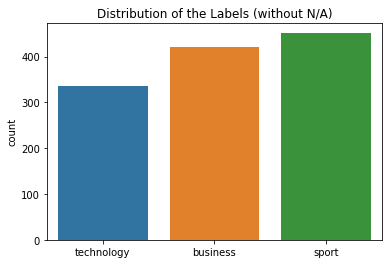

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


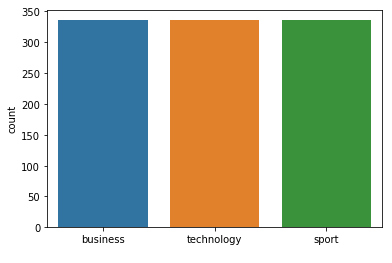



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 203  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 205
Class Distribution --> Train data (Fold 1 ):


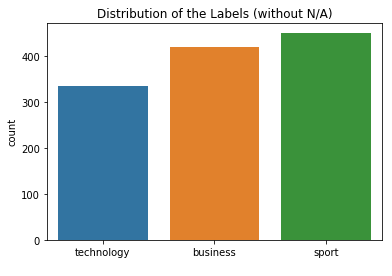

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


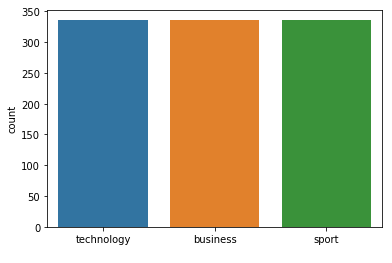



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.97      1.00      0.99        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 205
Class Distribution --> Train data (Fold 2 ):


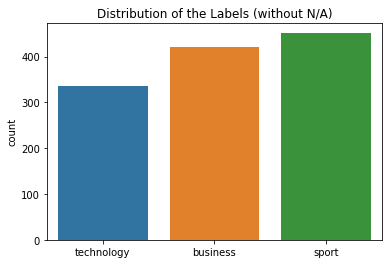

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


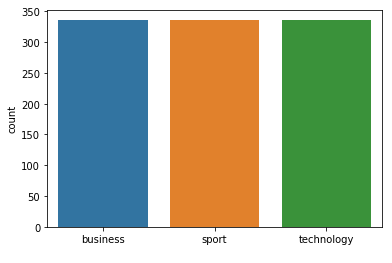



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 2 73  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 205
Class Distribution --> Train data (Fold 3 ):


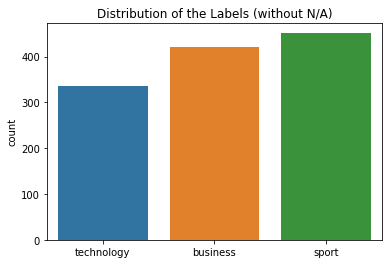

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


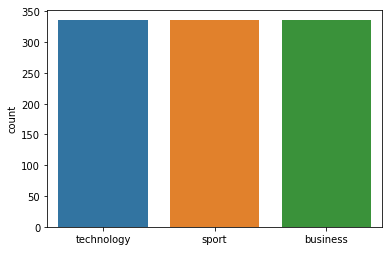



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 205
Class Distribution --> Train data (Fold 4 ):


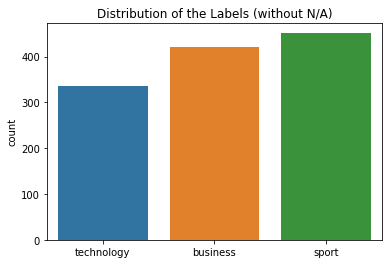

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


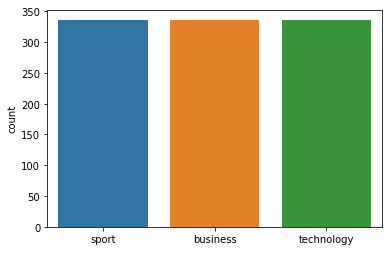



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 205
Class Distribution --> Train data (Fold 5 ):


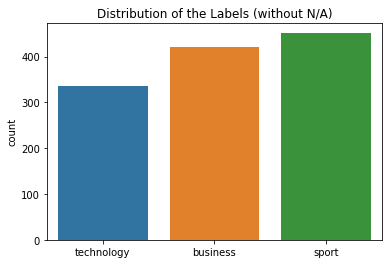

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


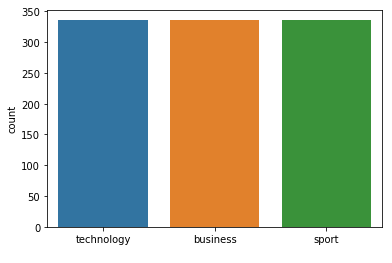



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 205
Class Distribution --> Train data (Fold 6 ):


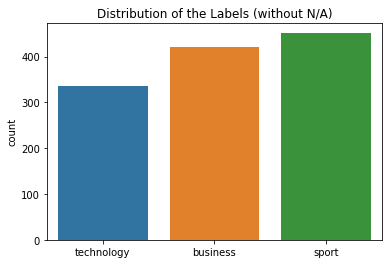

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


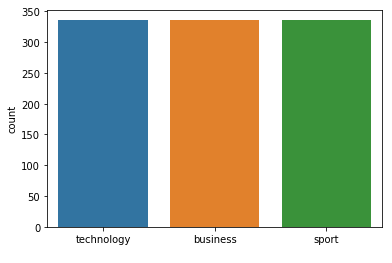



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 205
Class Distribution --> Train data (Fold 7 ):


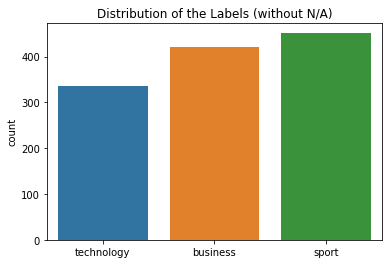

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


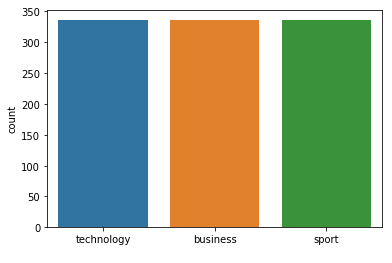



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 205  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 207
Class Distribution --> Train data (Fold 1 ):


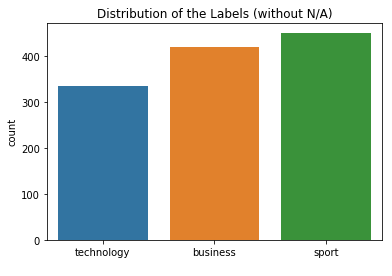

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


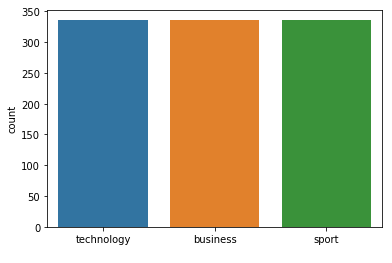



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 207
Class Distribution --> Train data (Fold 2 ):


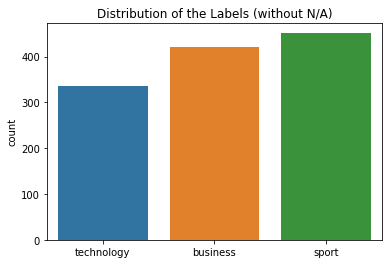

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


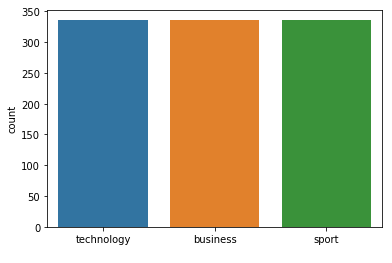



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 207
Class Distribution --> Train data (Fold 3 ):


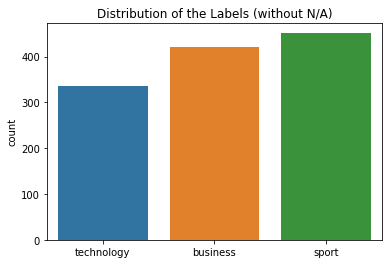

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


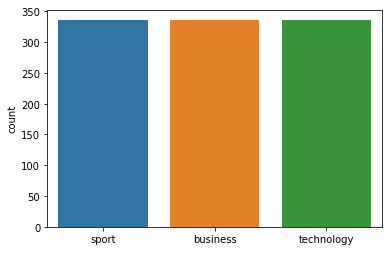



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 207
Class Distribution --> Train data (Fold 4 ):


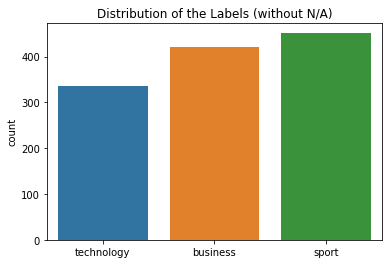

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


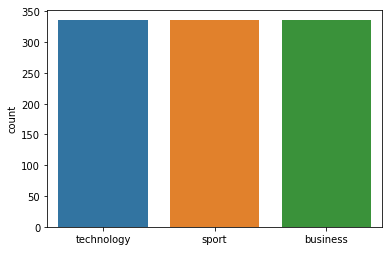



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 207
Class Distribution --> Train data (Fold 5 ):


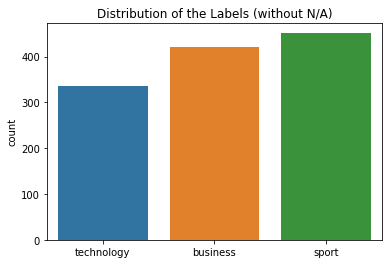

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


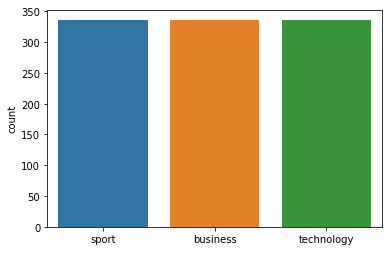



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 207
Class Distribution --> Train data (Fold 6 ):


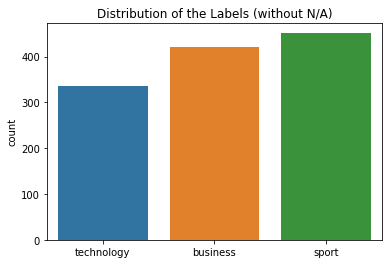

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


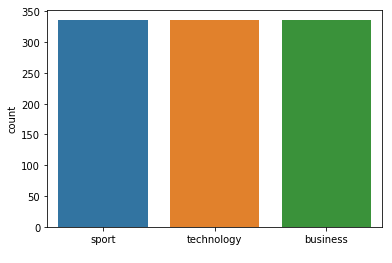



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 207
Class Distribution --> Train data (Fold 7 ):


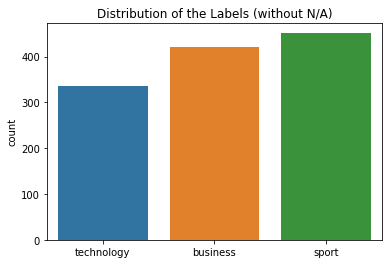

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


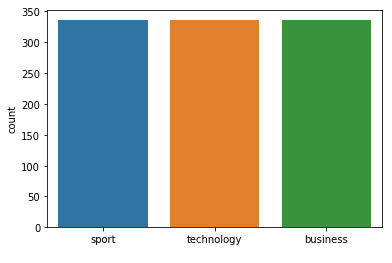



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 207  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 209
Class Distribution --> Train data (Fold 1 ):


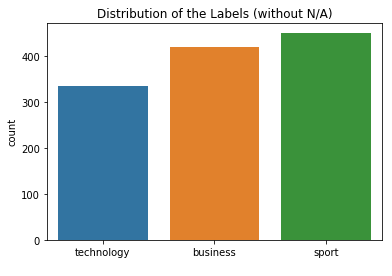

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


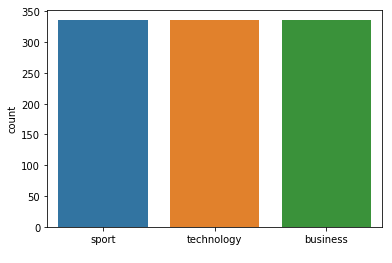



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.96      1.00      0.98        76
technology
       0.96      0.95      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 209
Class Distribution --> Train data (Fold 2 ):


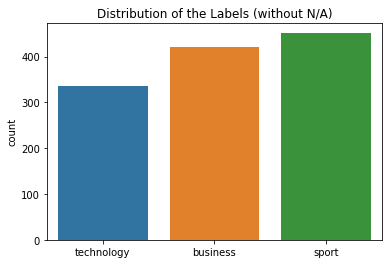

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


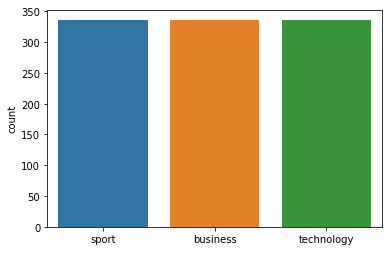



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 209
Class Distribution --> Train data (Fold 3 ):


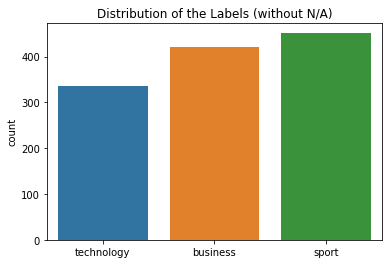

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


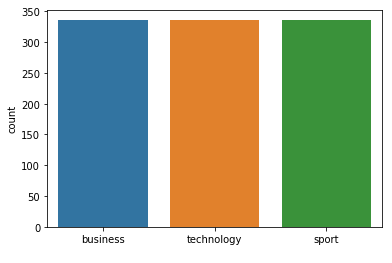



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 209
Class Distribution --> Train data (Fold 4 ):


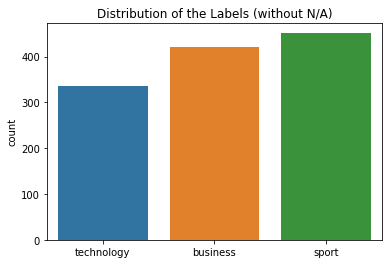

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


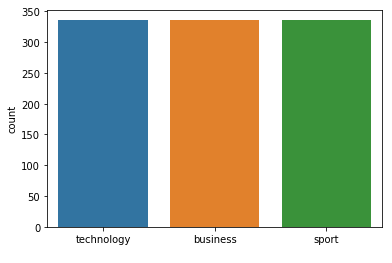



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 209
Class Distribution --> Train data (Fold 5 ):


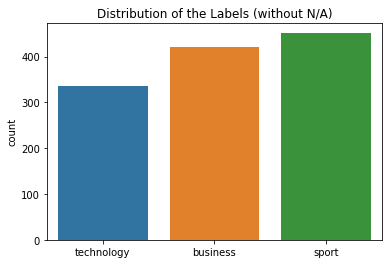

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


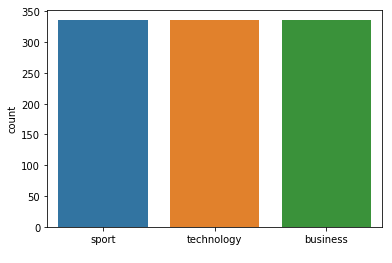



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 209
Class Distribution --> Train data (Fold 6 ):


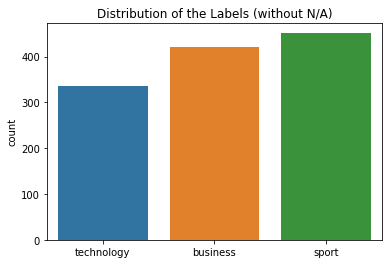

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


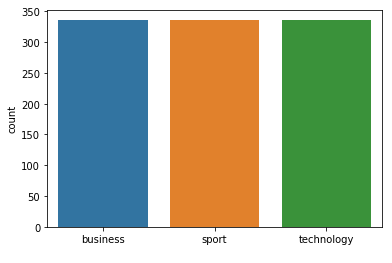



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 209
Class Distribution --> Train data (Fold 7 ):


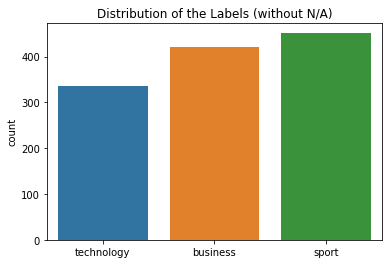

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


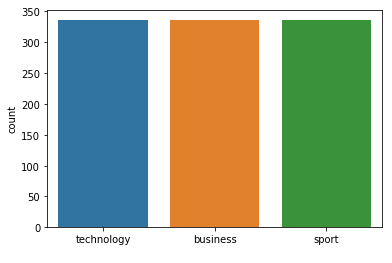



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 209  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 211
Class Distribution --> Train data (Fold 1 ):


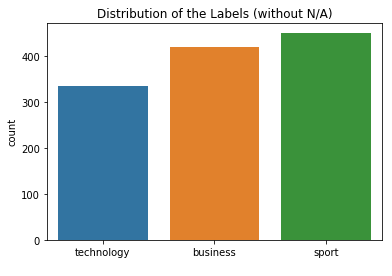

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


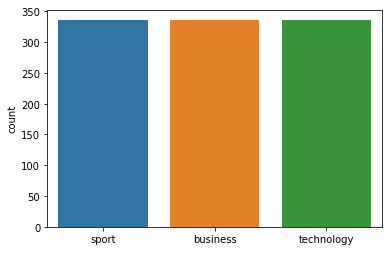



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 211
Class Distribution --> Train data (Fold 2 ):


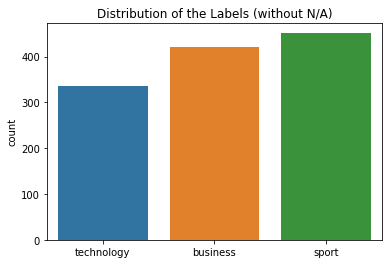

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


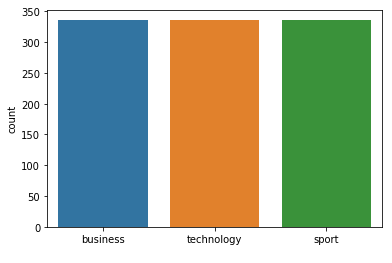



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 211
Class Distribution --> Train data (Fold 3 ):


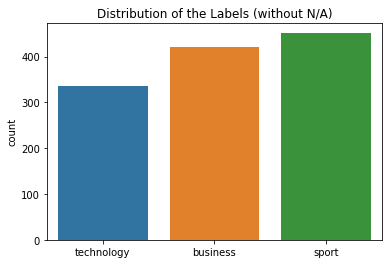

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


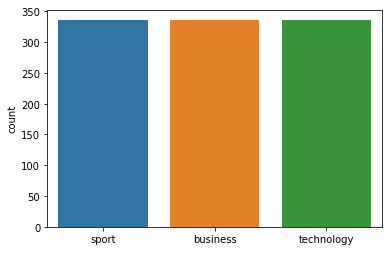



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 211
Class Distribution --> Train data (Fold 4 ):


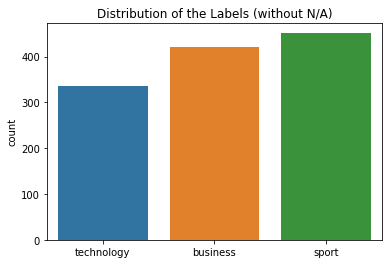

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


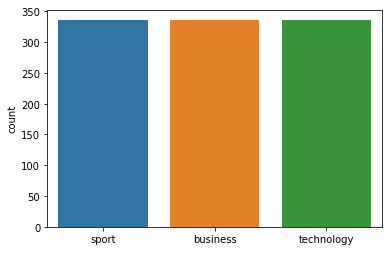



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 211
Class Distribution --> Train data (Fold 5 ):


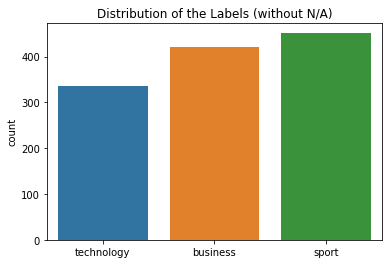

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


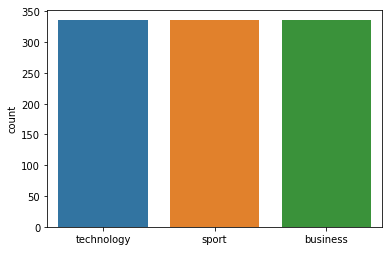



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 211
Class Distribution --> Train data (Fold 6 ):


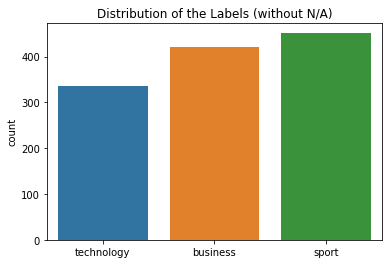

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


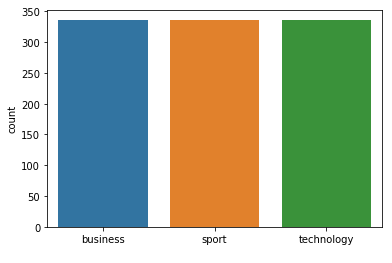



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 211
Class Distribution --> Train data (Fold 7 ):


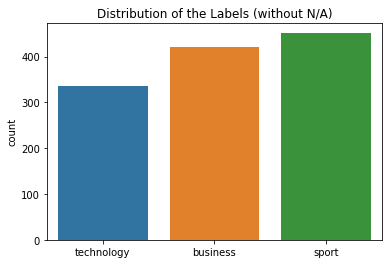

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


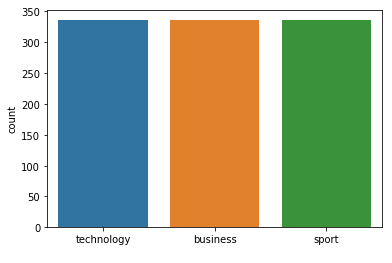



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 211  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 213
Class Distribution --> Train data (Fold 1 ):


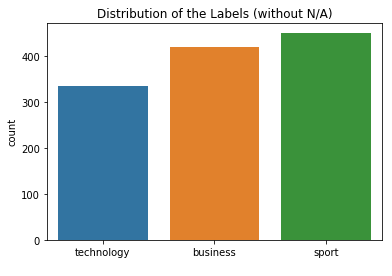

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


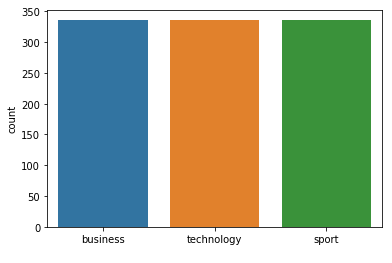



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 213
Class Distribution --> Train data (Fold 2 ):


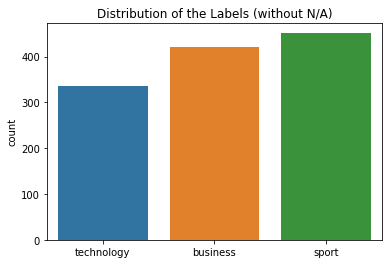

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


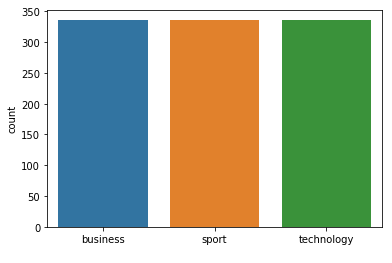



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 213
Class Distribution --> Train data (Fold 3 ):


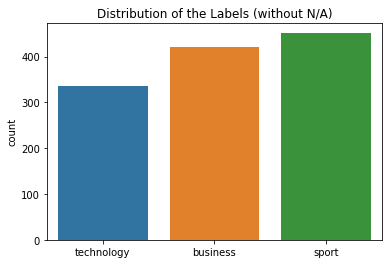

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


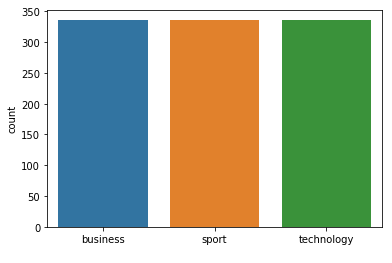



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 213
Class Distribution --> Train data (Fold 4 ):


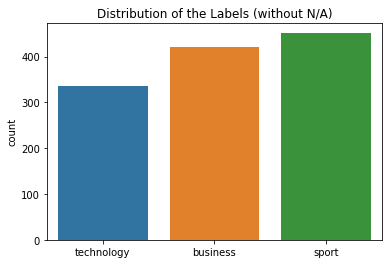

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


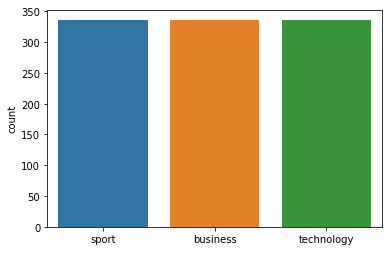



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 213
Class Distribution --> Train data (Fold 5 ):


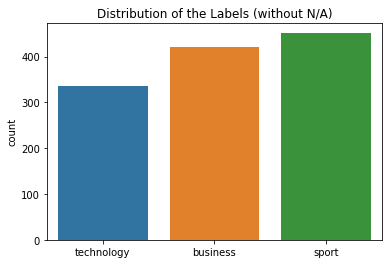

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


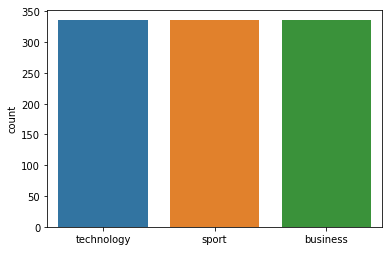



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 213
Class Distribution --> Train data (Fold 6 ):


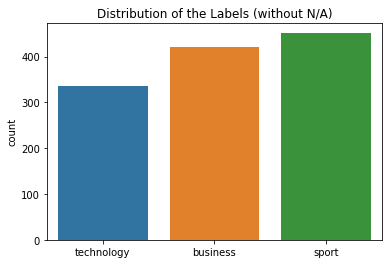

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


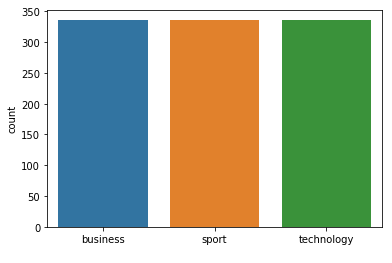



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 213
Class Distribution --> Train data (Fold 7 ):


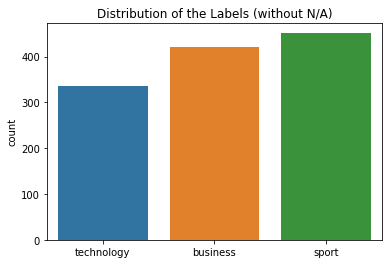

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


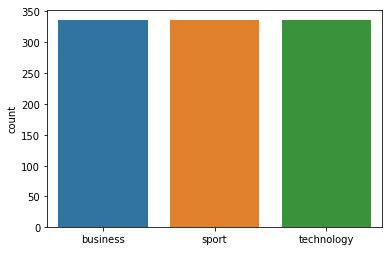



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 213  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 215
Class Distribution --> Train data (Fold 1 ):


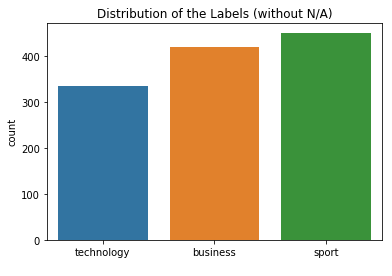

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


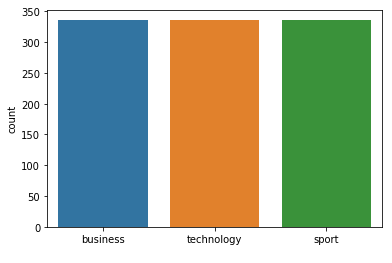



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.99      0.99      0.99        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 215
Class Distribution --> Train data (Fold 2 ):


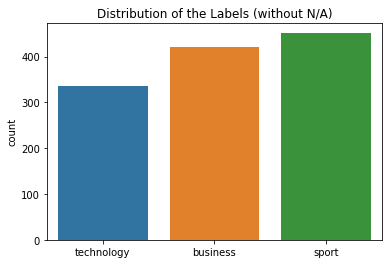

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


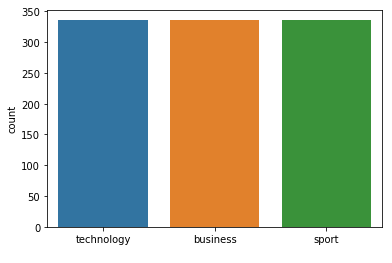



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.99      0.95      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  1 54]]
FOLD 3 Number of neighbors 215
Class Distribution --> Train data (Fold 3 ):


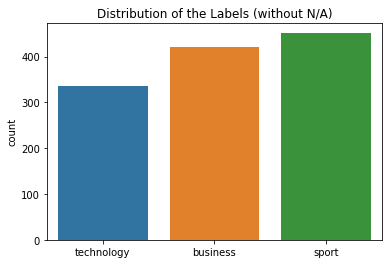

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


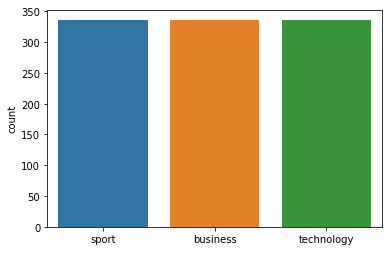



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 215
Class Distribution --> Train data (Fold 4 ):


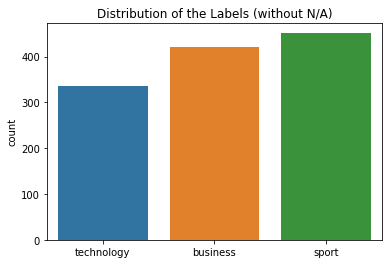

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


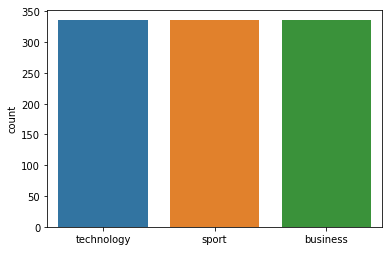



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.96      0.99      0.97        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.96      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 1  1 54]]
FOLD 5 Number of neighbors 215
Class Distribution --> Train data (Fold 5 ):


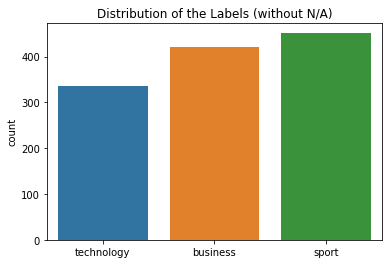

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


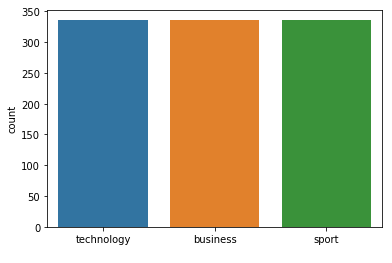



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 215
Class Distribution --> Train data (Fold 6 ):


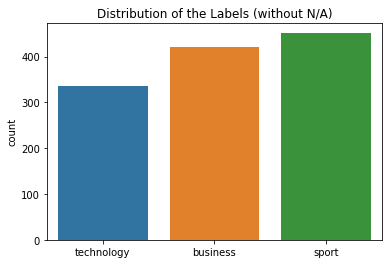

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


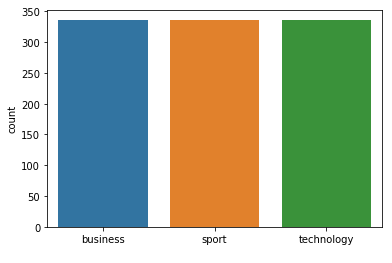



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 215
Class Distribution --> Train data (Fold 7 ):


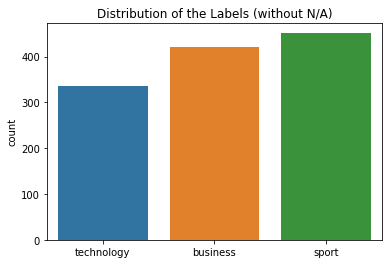

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


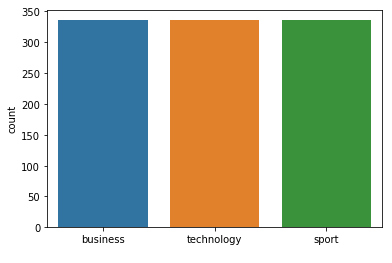



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 215  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 217
Class Distribution --> Train data (Fold 1 ):


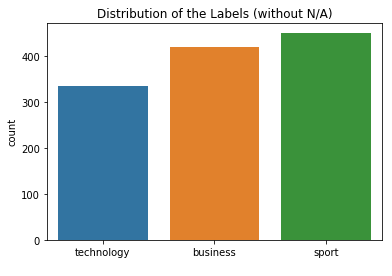

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


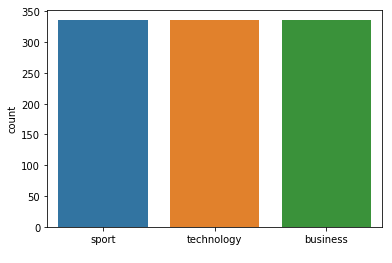



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 217
Class Distribution --> Train data (Fold 2 ):


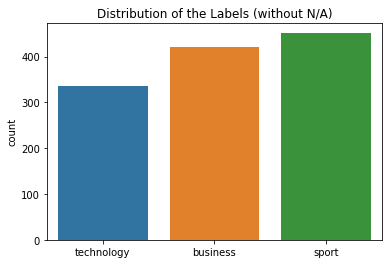

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


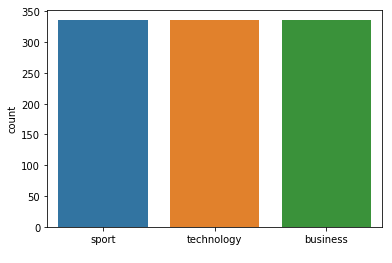



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 217
Class Distribution --> Train data (Fold 3 ):


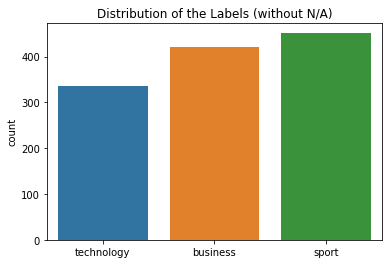

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


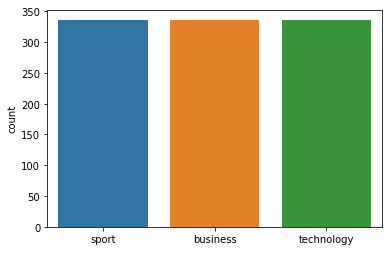



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 217
Class Distribution --> Train data (Fold 4 ):


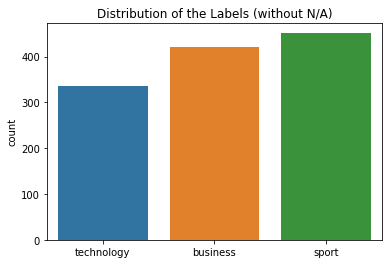

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


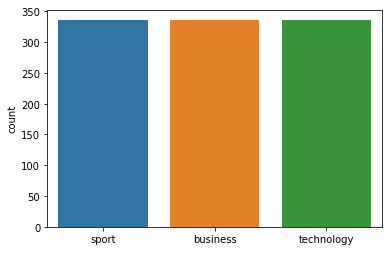



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 217
Class Distribution --> Train data (Fold 5 ):


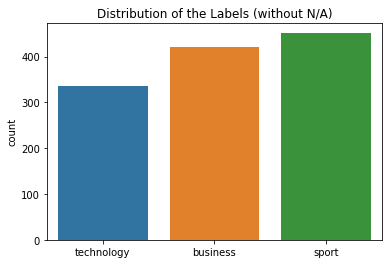

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


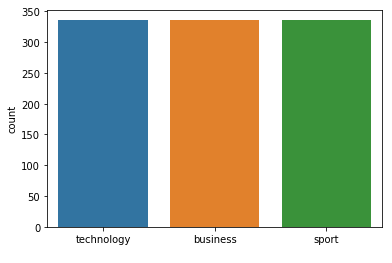



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 217
Class Distribution --> Train data (Fold 6 ):


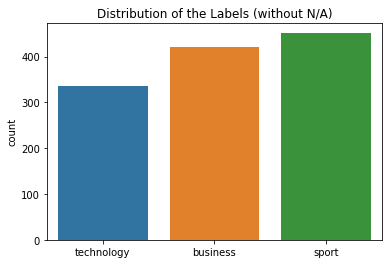

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


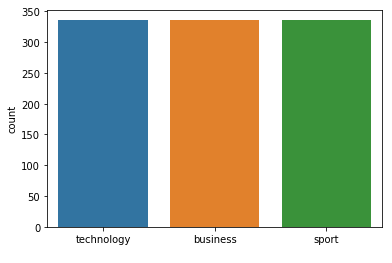



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 217
Class Distribution --> Train data (Fold 7 ):


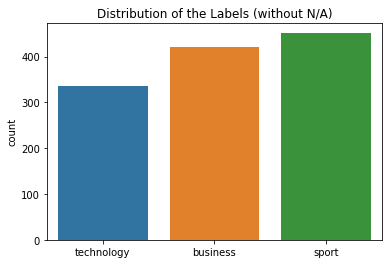

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


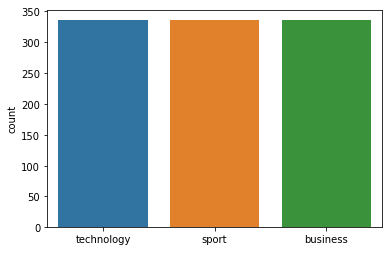



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 217  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 219
Class Distribution --> Train data (Fold 1 ):


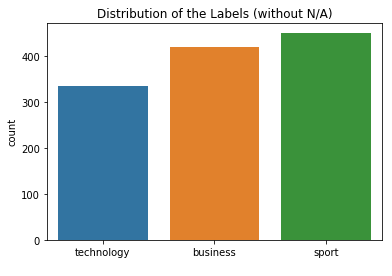

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


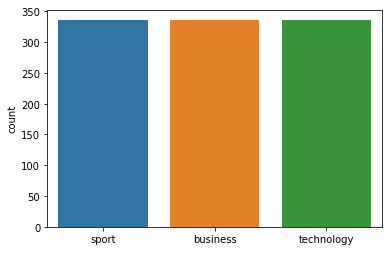



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 219
Class Distribution --> Train data (Fold 2 ):


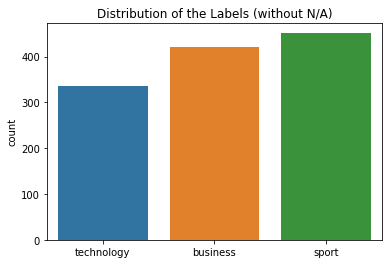

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


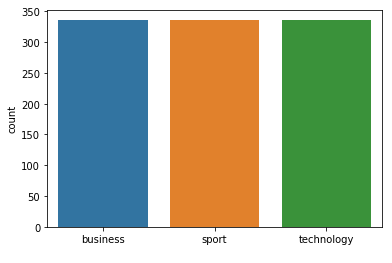



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.99      0.96      0.97        75
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  1 54]]
FOLD 3 Number of neighbors 219
Class Distribution --> Train data (Fold 3 ):


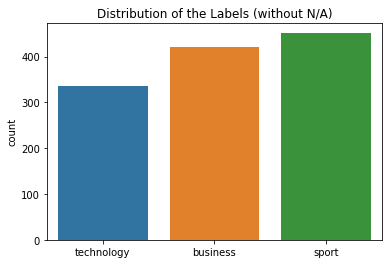

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


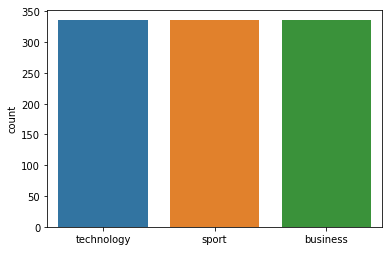



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 219
Class Distribution --> Train data (Fold 4 ):


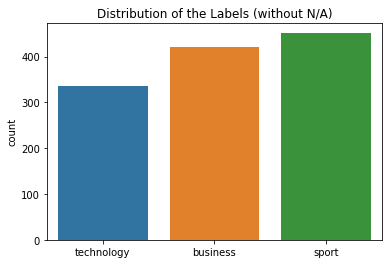

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


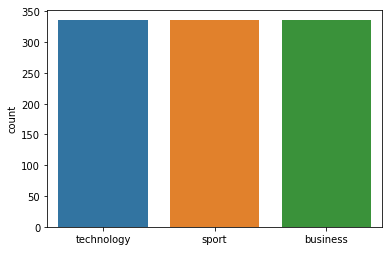



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 219
Class Distribution --> Train data (Fold 5 ):


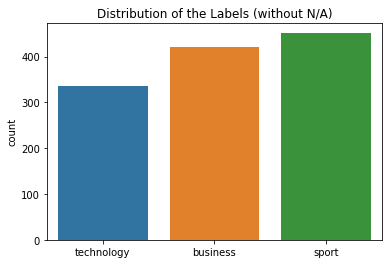

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


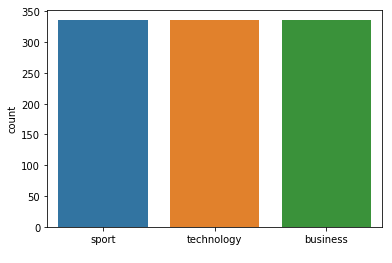



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 219
Class Distribution --> Train data (Fold 6 ):


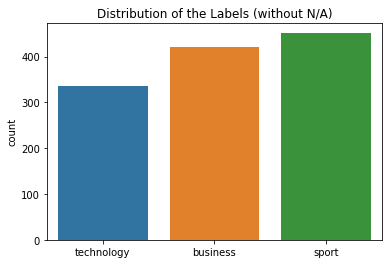

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


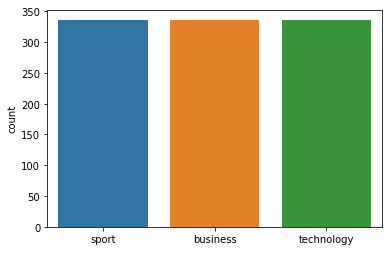



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  0 55]]
FOLD 7 Number of neighbors 219
Class Distribution --> Train data (Fold 7 ):


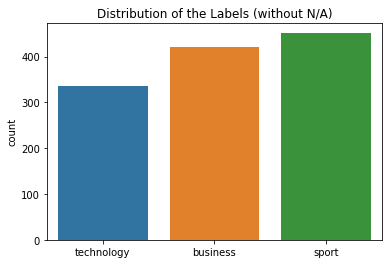

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


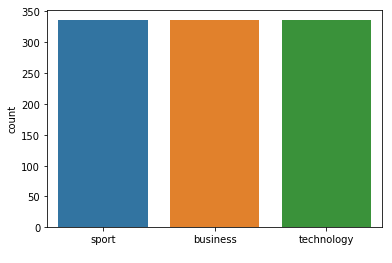



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.96      0.97      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.95      0.95      0.95       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  3 51]]


 Model accuracy (for 219  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 221
Class Distribution --> Train data (Fold 1 ):


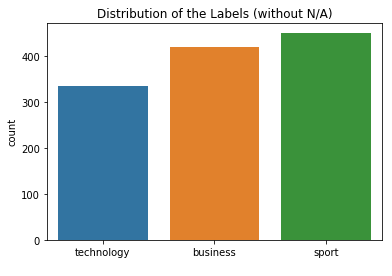

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


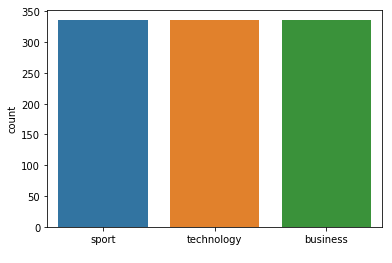



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.99      0.97      0.98        76
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  1 55]]
FOLD 2 Number of neighbors 221
Class Distribution --> Train data (Fold 2 ):


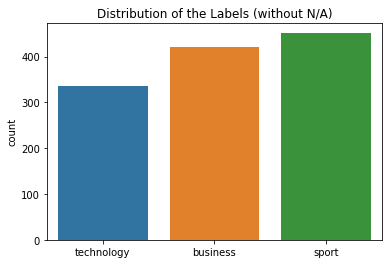

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


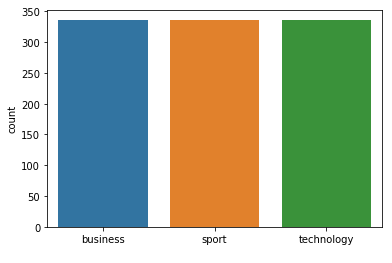



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 221
Class Distribution --> Train data (Fold 3 ):


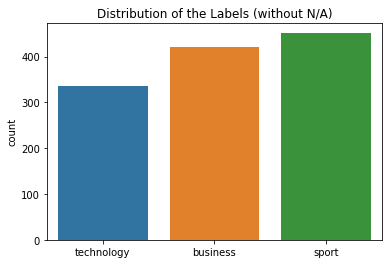

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


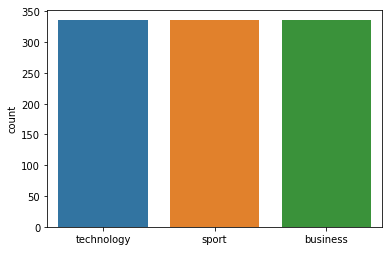



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 221
Class Distribution --> Train data (Fold 4 ):


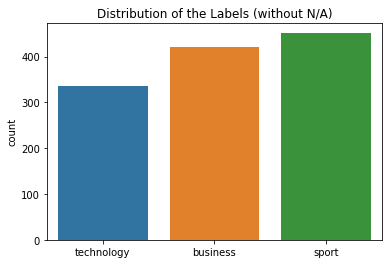

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


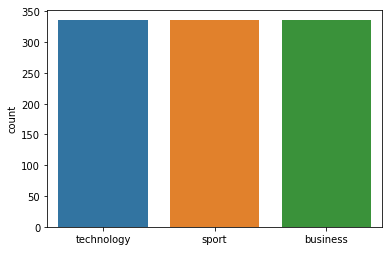



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 221
Class Distribution --> Train data (Fold 5 ):


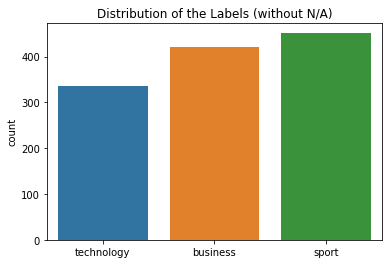

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


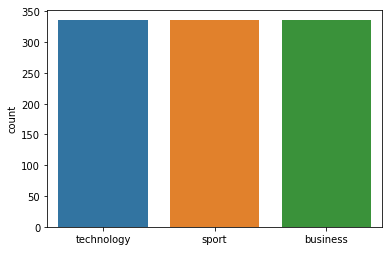



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 221
Class Distribution --> Train data (Fold 6 ):


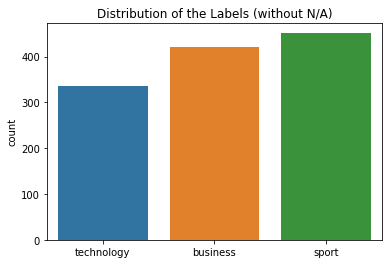

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


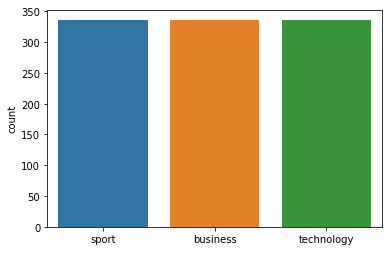



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.99      1.00      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 221
Class Distribution --> Train data (Fold 7 ):


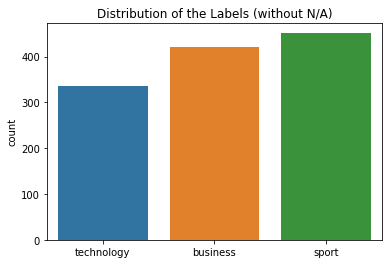

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


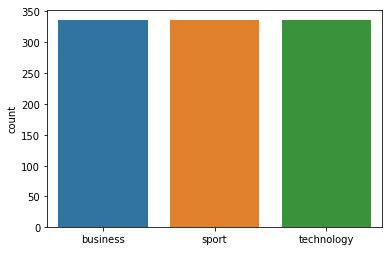



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  3 51]]


 Model accuracy (for 221  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 223
Class Distribution --> Train data (Fold 1 ):


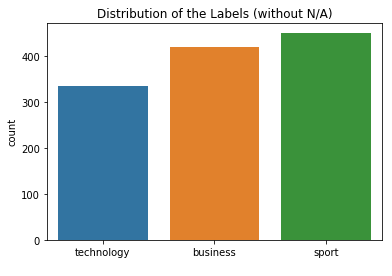

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


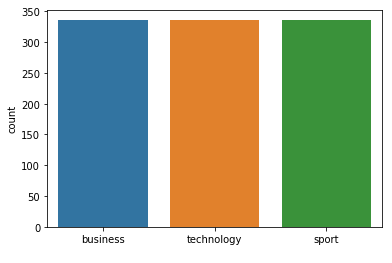



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 223
Class Distribution --> Train data (Fold 2 ):


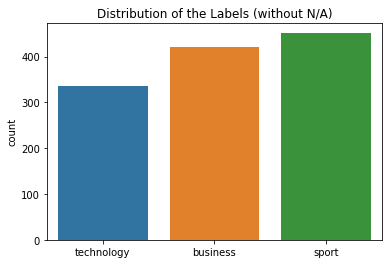

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


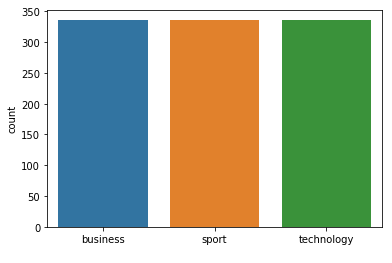



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 223
Class Distribution --> Train data (Fold 3 ):


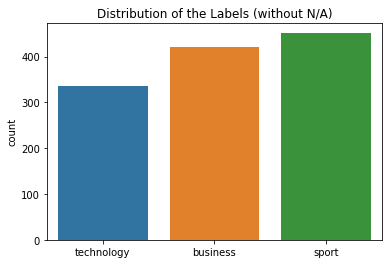

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


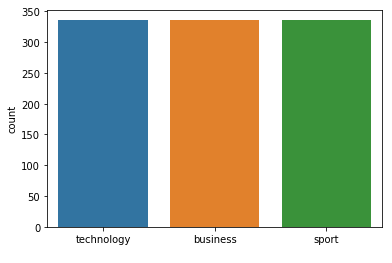



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 223
Class Distribution --> Train data (Fold 4 ):


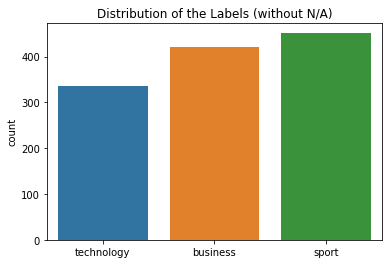

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


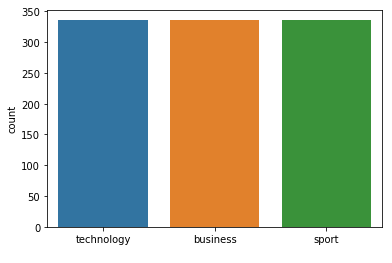



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 223
Class Distribution --> Train data (Fold 5 ):


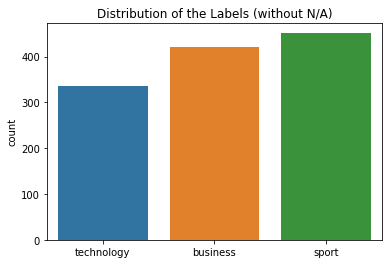

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


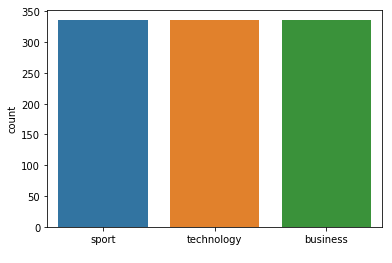



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 223
Class Distribution --> Train data (Fold 6 ):


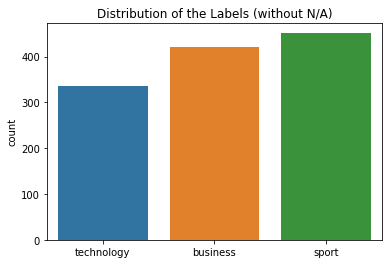

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


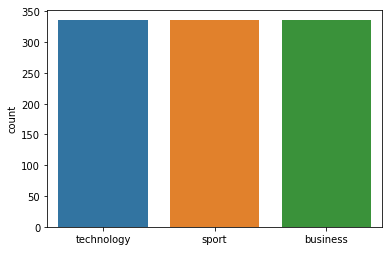



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 223
Class Distribution --> Train data (Fold 7 ):


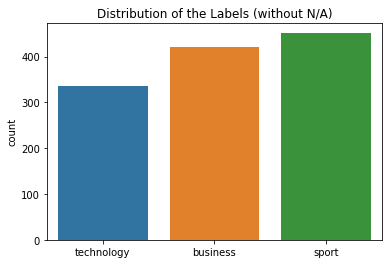

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


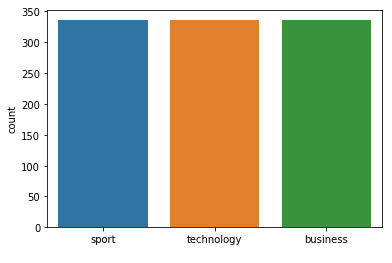



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 223  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 225
Class Distribution --> Train data (Fold 1 ):


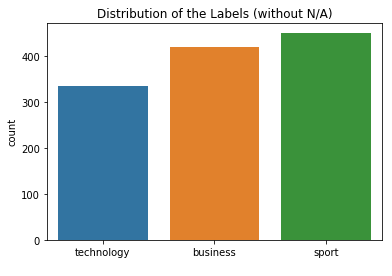

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


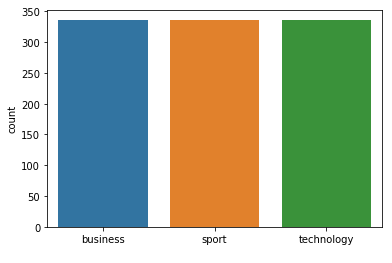



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 225
Class Distribution --> Train data (Fold 2 ):


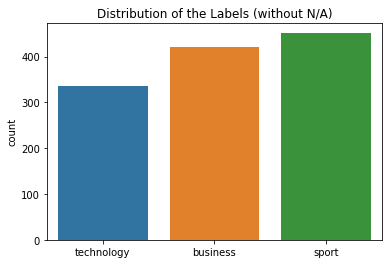

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


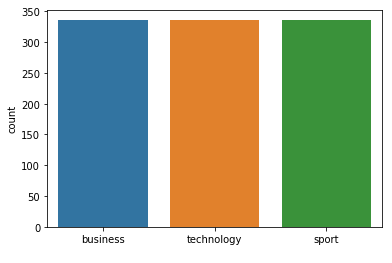



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.96      0.94        70
     sport
       0.97      0.95      0.96        75
technology
       0.95      0.95      0.95        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 2 ):
[[67  0  3]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 225
Class Distribution --> Train data (Fold 3 ):


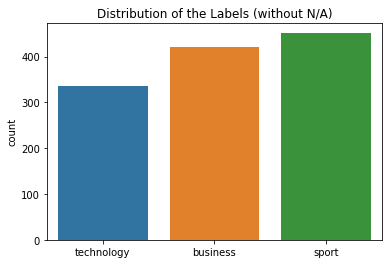

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


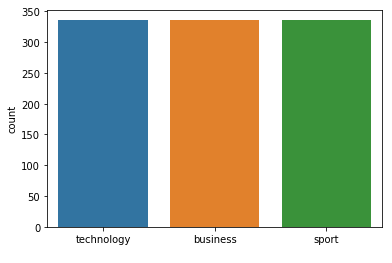



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 225
Class Distribution --> Train data (Fold 4 ):


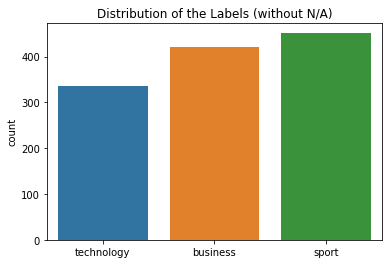

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


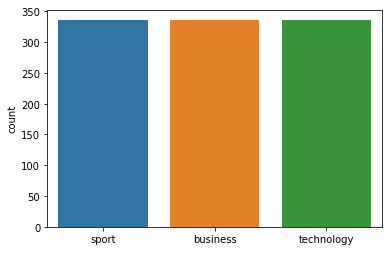



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 225
Class Distribution --> Train data (Fold 5 ):


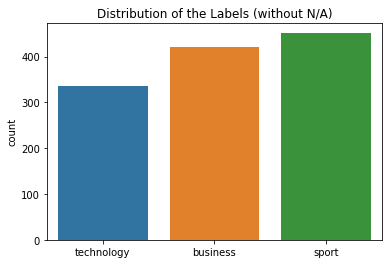

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


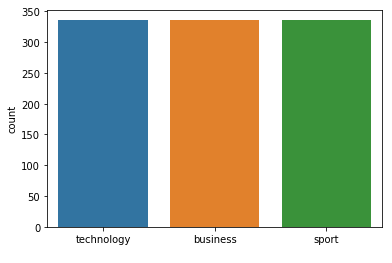



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 225
Class Distribution --> Train data (Fold 6 ):


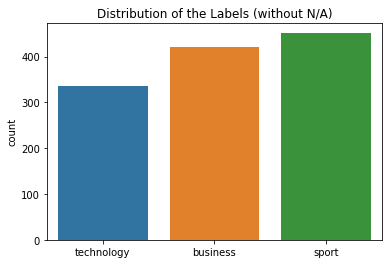

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


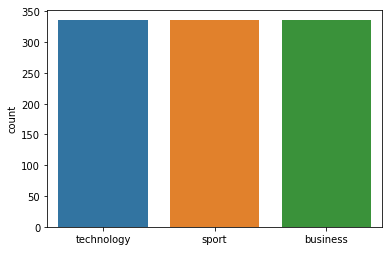



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 225
Class Distribution --> Train data (Fold 7 ):


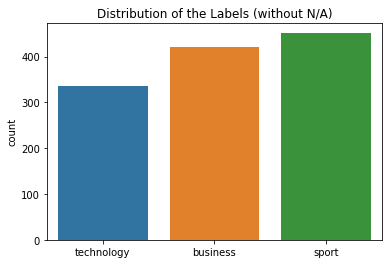

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


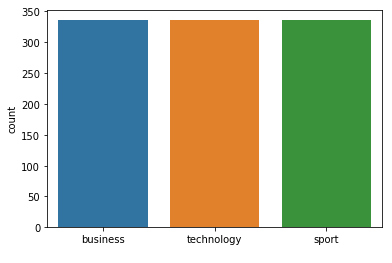



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 225  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 227
Class Distribution --> Train data (Fold 1 ):


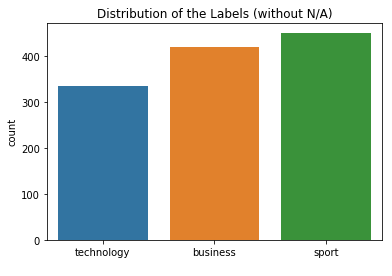

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


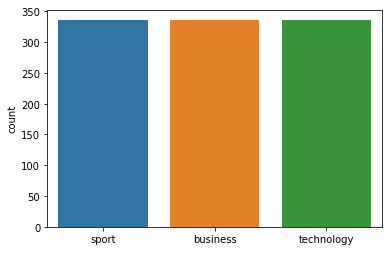



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 227
Class Distribution --> Train data (Fold 2 ):


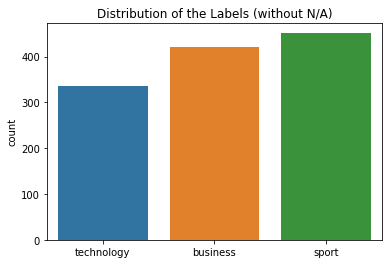

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


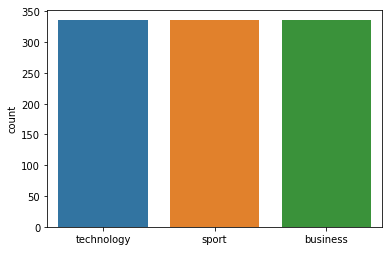



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 227
Class Distribution --> Train data (Fold 3 ):


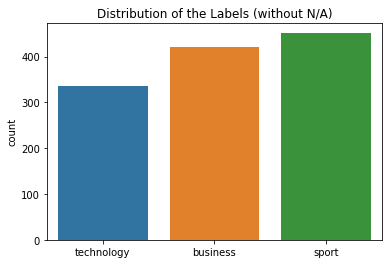

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


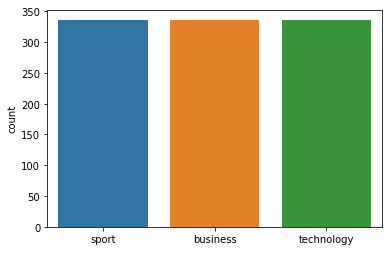



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 227
Class Distribution --> Train data (Fold 4 ):


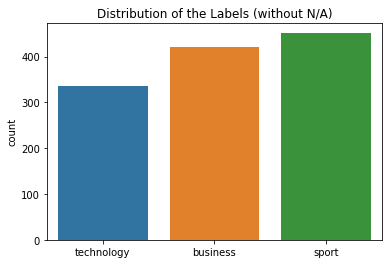

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


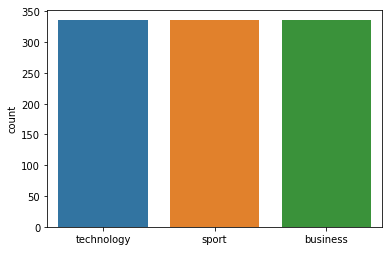



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 227
Class Distribution --> Train data (Fold 5 ):


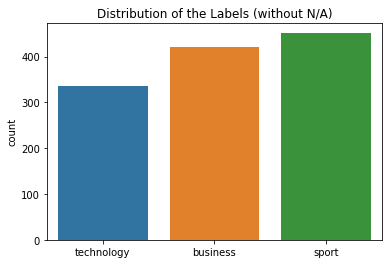

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


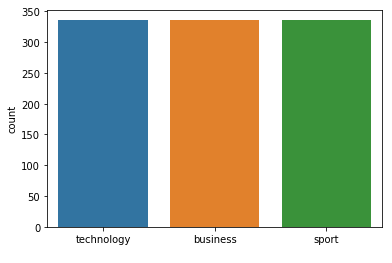



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 227
Class Distribution --> Train data (Fold 6 ):


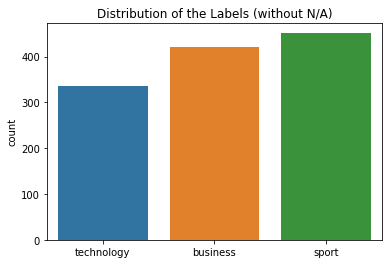

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


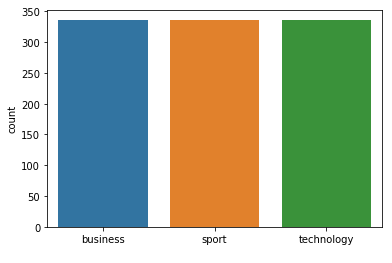



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 227
Class Distribution --> Train data (Fold 7 ):


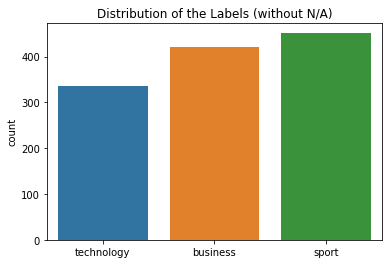

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


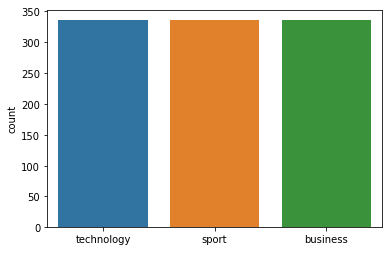



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 227  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 229
Class Distribution --> Train data (Fold 1 ):


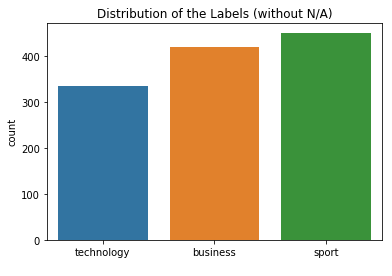

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


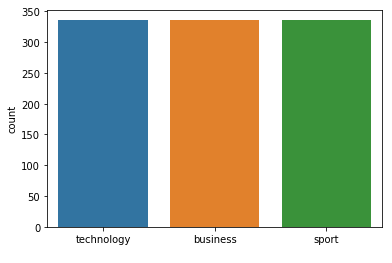



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 229
Class Distribution --> Train data (Fold 2 ):


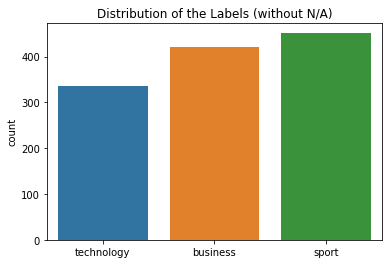

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


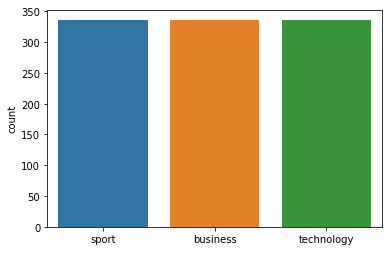



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 229
Class Distribution --> Train data (Fold 3 ):


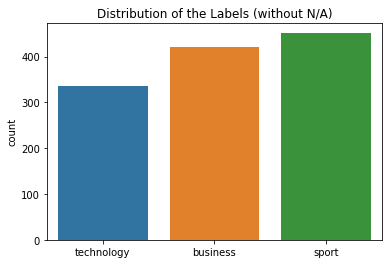

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


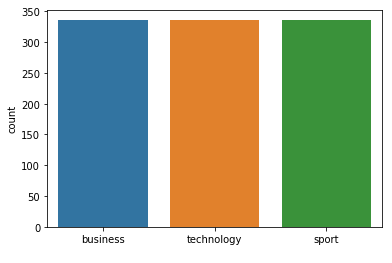



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 229
Class Distribution --> Train data (Fold 4 ):


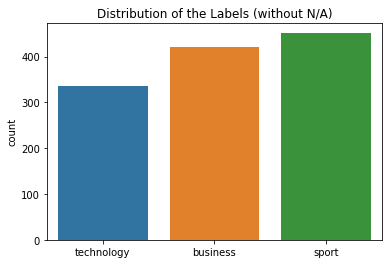

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


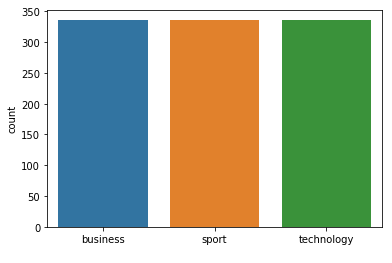



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 229
Class Distribution --> Train data (Fold 5 ):


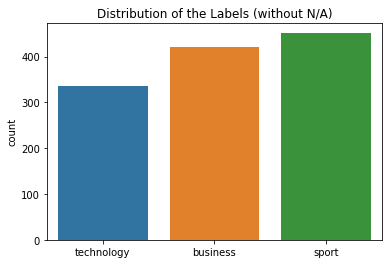

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


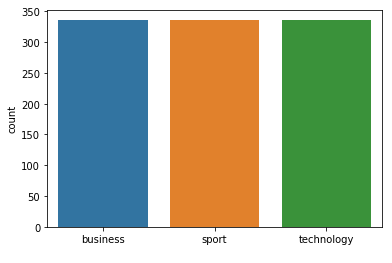



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 229
Class Distribution --> Train data (Fold 6 ):


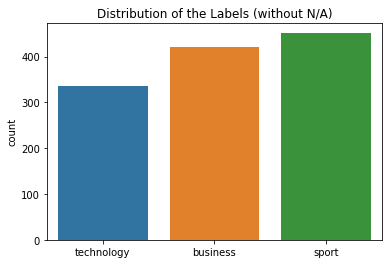

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


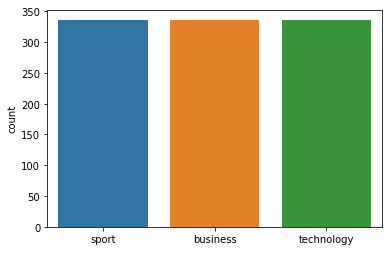



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 229
Class Distribution --> Train data (Fold 7 ):


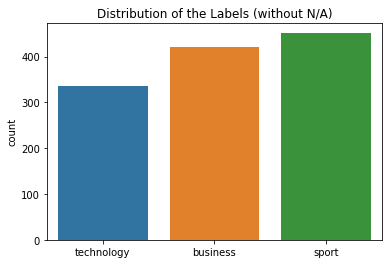

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


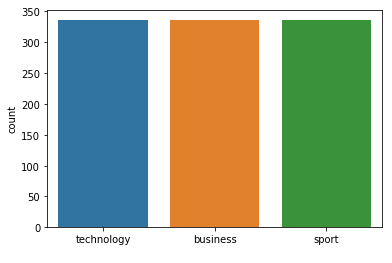



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 229  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 231
Class Distribution --> Train data (Fold 1 ):


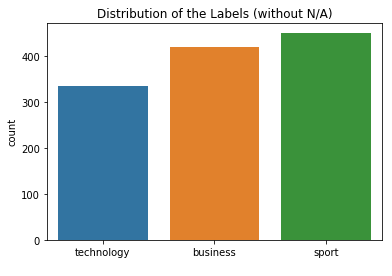

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


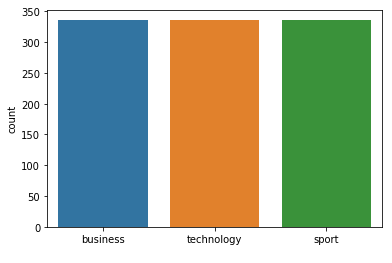



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 231
Class Distribution --> Train data (Fold 2 ):


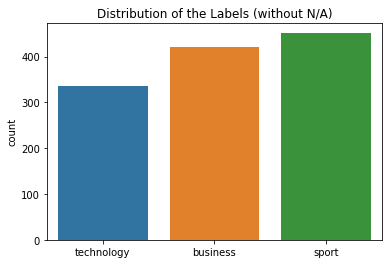

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


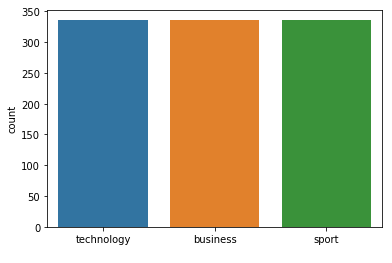



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 231
Class Distribution --> Train data (Fold 3 ):


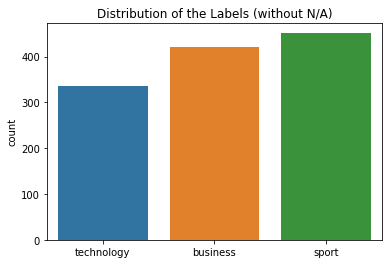

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


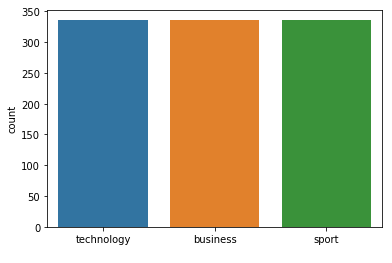



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.91      0.94        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[64  2  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 231
Class Distribution --> Train data (Fold 4 ):


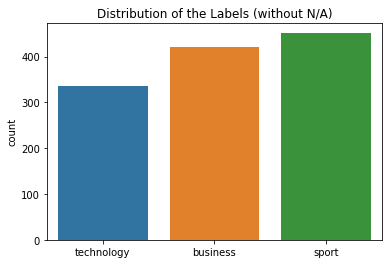

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


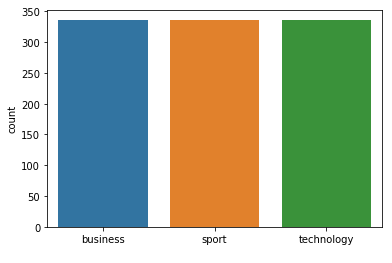



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       0.98      0.98      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 231
Class Distribution --> Train data (Fold 5 ):


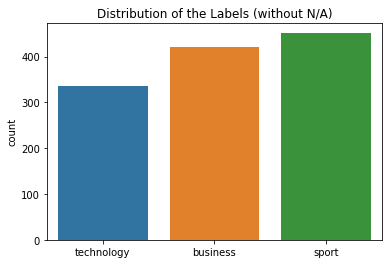

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


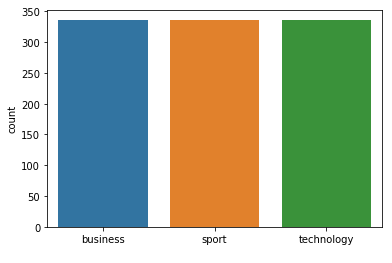



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 231
Class Distribution --> Train data (Fold 6 ):


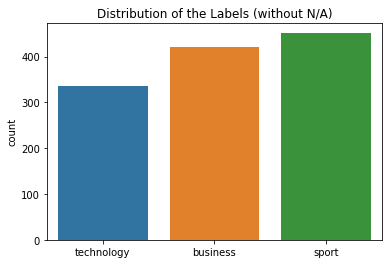

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


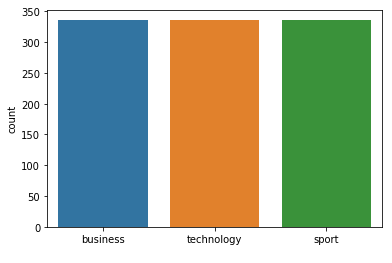



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       1.00      1.00      1.00        75
technology
       0.95      1.00      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 7 Number of neighbors 231
Class Distribution --> Train data (Fold 7 ):


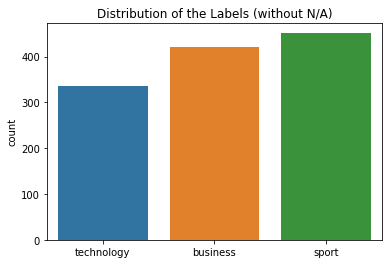

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


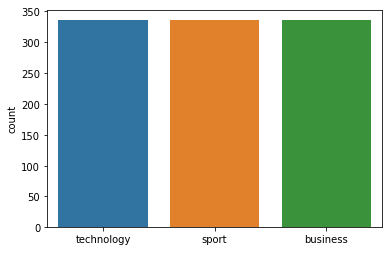



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  3 51]]


 Model accuracy (for 231  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 233
Class Distribution --> Train data (Fold 1 ):


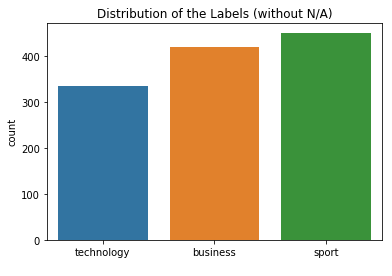

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


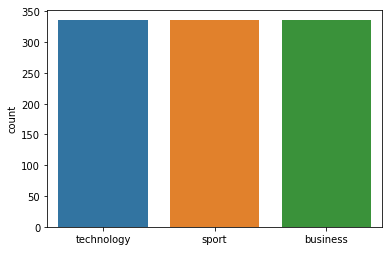



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 233
Class Distribution --> Train data (Fold 2 ):


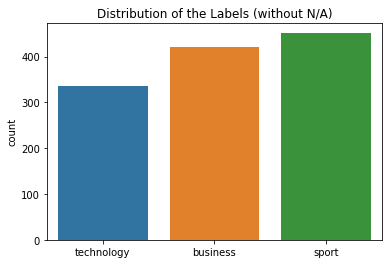

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


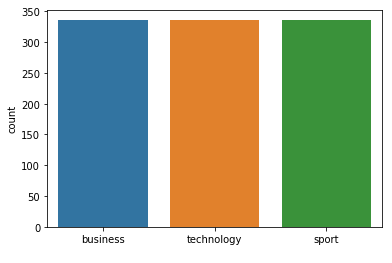



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 233
Class Distribution --> Train data (Fold 3 ):


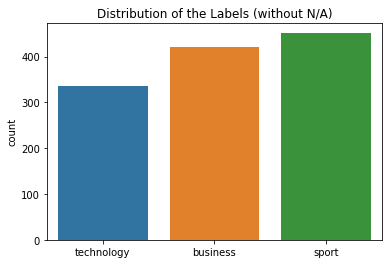

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


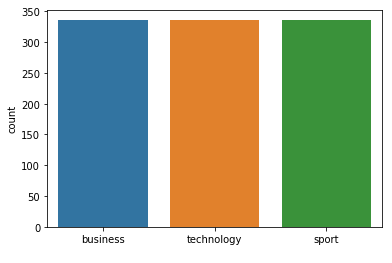



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 233
Class Distribution --> Train data (Fold 4 ):


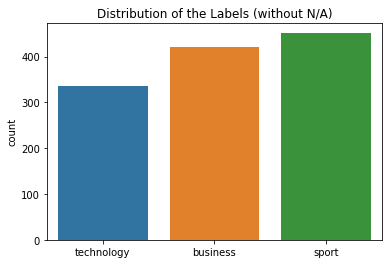

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


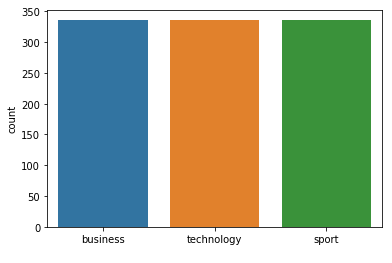



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 233
Class Distribution --> Train data (Fold 5 ):


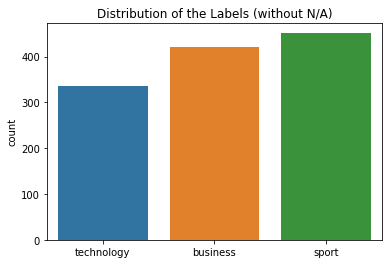

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


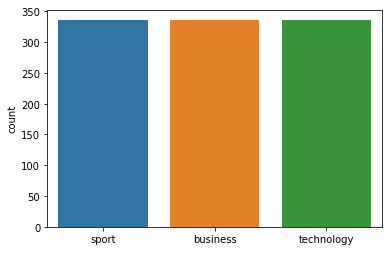



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 233
Class Distribution --> Train data (Fold 6 ):


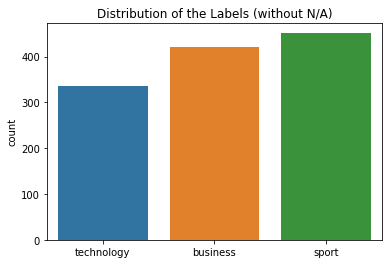

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


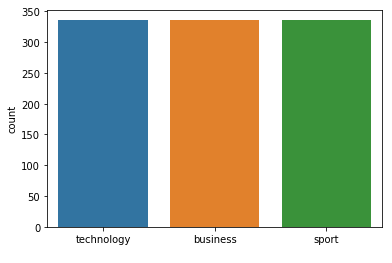



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 233
Class Distribution --> Train data (Fold 7 ):


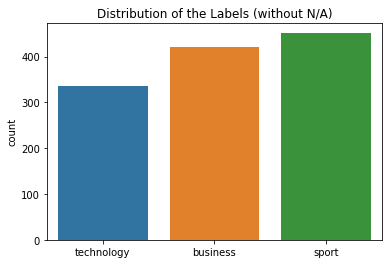

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


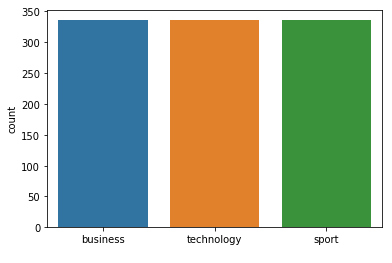



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 233  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 235
Class Distribution --> Train data (Fold 1 ):


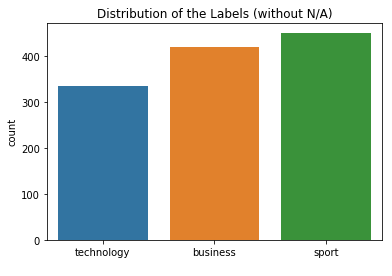

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


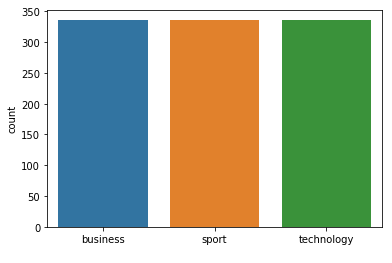



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.97      0.99      0.98        76
technology
       0.96      0.96      0.96        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 235
Class Distribution --> Train data (Fold 2 ):


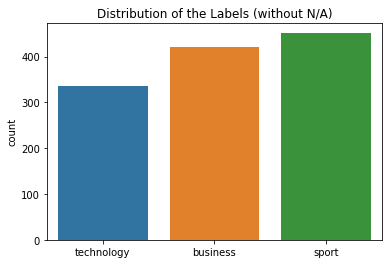

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


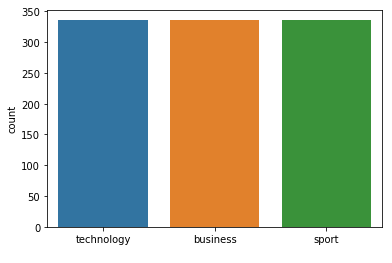



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 235
Class Distribution --> Train data (Fold 3 ):


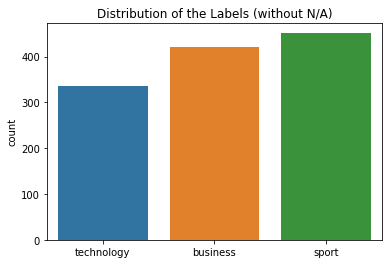

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


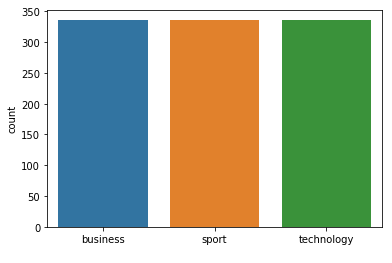



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 235
Class Distribution --> Train data (Fold 4 ):


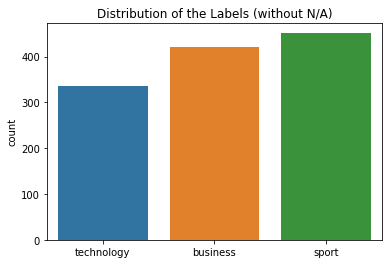

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


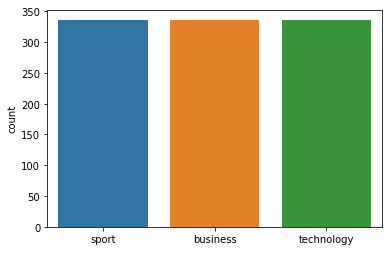



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 235
Class Distribution --> Train data (Fold 5 ):


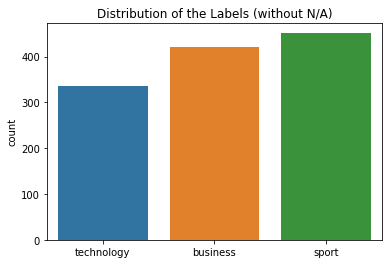

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


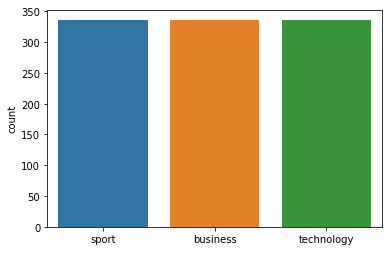



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 235
Class Distribution --> Train data (Fold 6 ):


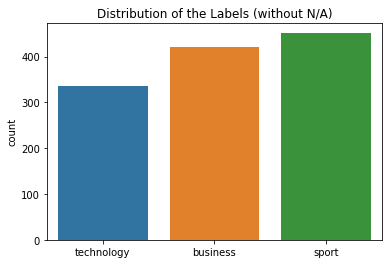

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


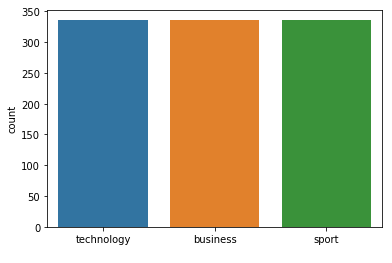



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 235
Class Distribution --> Train data (Fold 7 ):


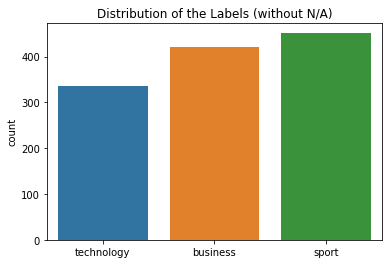

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


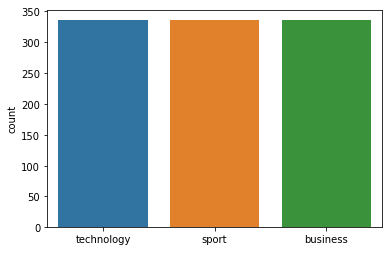



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 235  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 237
Class Distribution --> Train data (Fold 1 ):


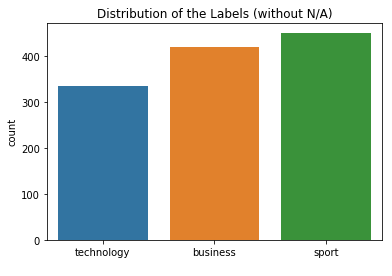

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


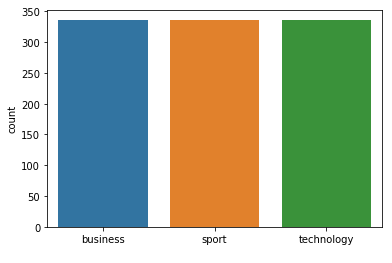



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.96      1.00      0.98        76
technology
       0.96      0.95      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 237
Class Distribution --> Train data (Fold 2 ):


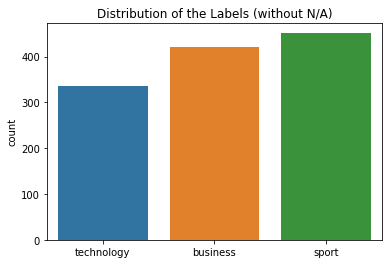

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


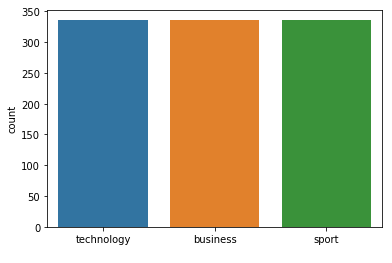



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 237
Class Distribution --> Train data (Fold 3 ):


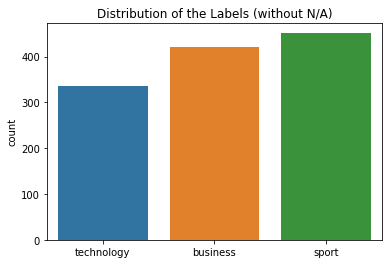

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


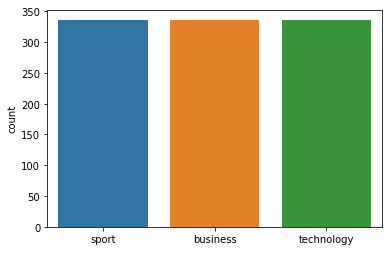



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.93      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 1 74  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 237
Class Distribution --> Train data (Fold 4 ):


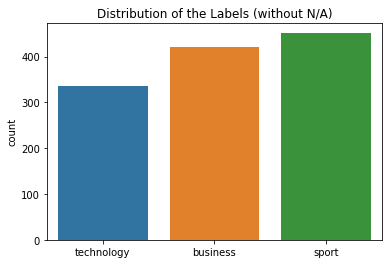

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


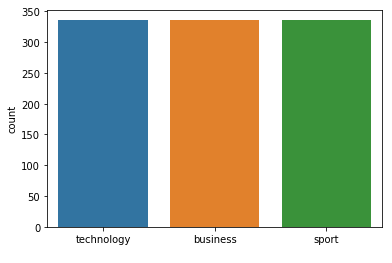



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 237
Class Distribution --> Train data (Fold 5 ):


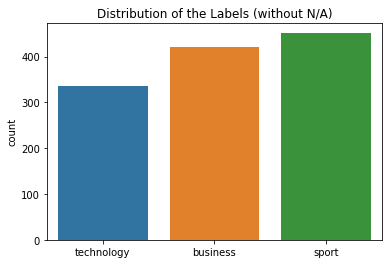

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


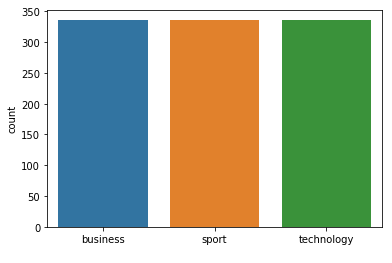



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 237
Class Distribution --> Train data (Fold 6 ):


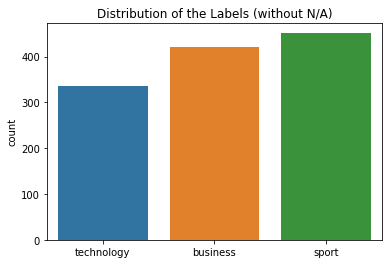

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


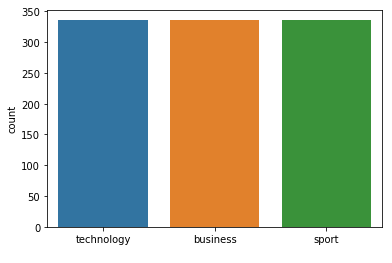



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 237
Class Distribution --> Train data (Fold 7 ):


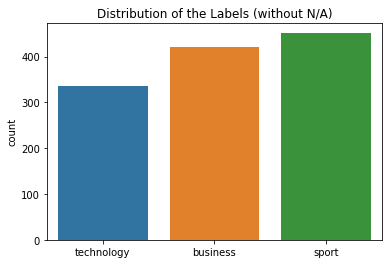

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


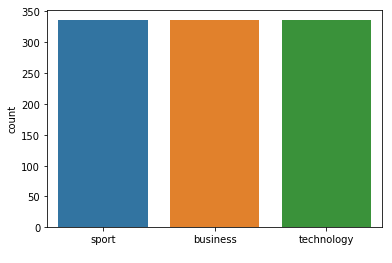



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 237  neighbours): 97.03% (+/- 1.01%)
FOLD 1 Number of neighbors 239
Class Distribution --> Train data (Fold 1 ):


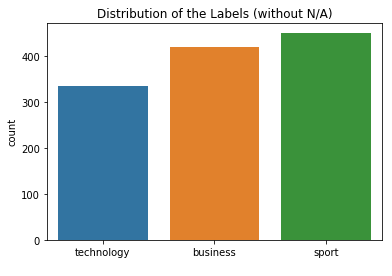

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


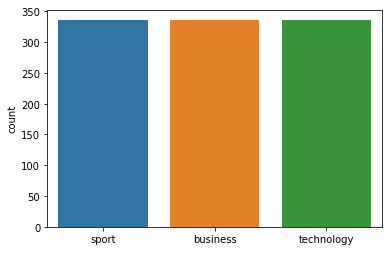



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 239
Class Distribution --> Train data (Fold 2 ):


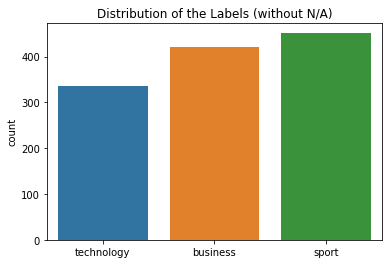

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


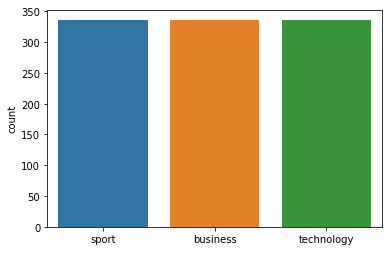



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 239
Class Distribution --> Train data (Fold 3 ):


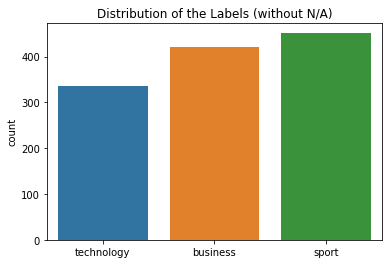

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


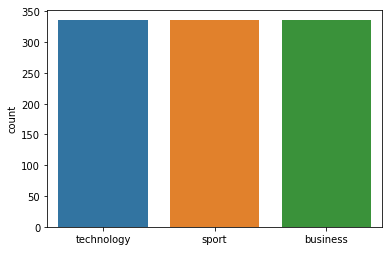



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 239
Class Distribution --> Train data (Fold 4 ):


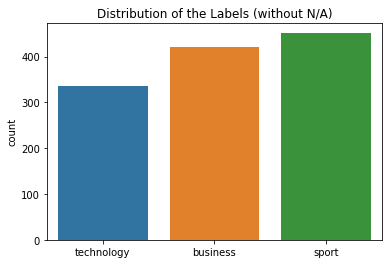

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


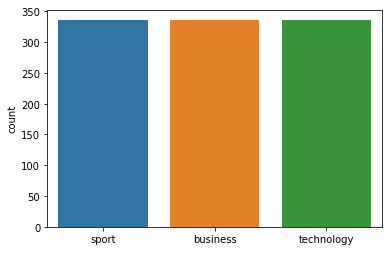



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 239
Class Distribution --> Train data (Fold 5 ):


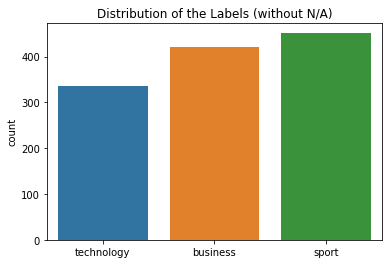

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


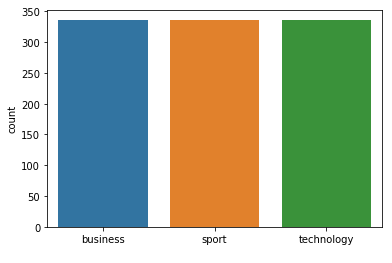



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 239
Class Distribution --> Train data (Fold 6 ):


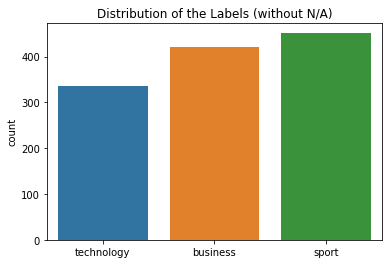

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


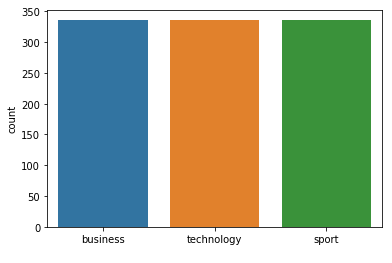



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 239
Class Distribution --> Train data (Fold 7 ):


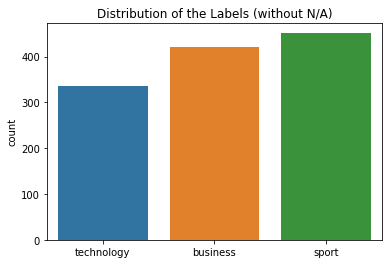

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


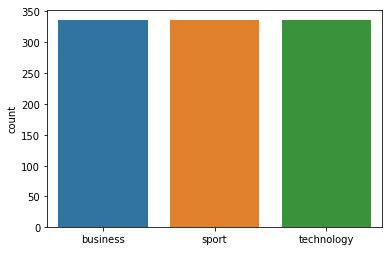



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 239  neighbours): 97.03% (+/- 1.01%)
FOLD 1 Number of neighbors 241
Class Distribution --> Train data (Fold 1 ):


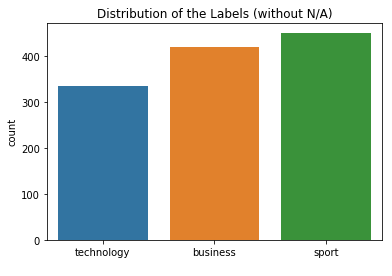

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


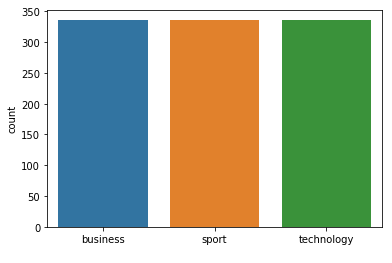



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 241
Class Distribution --> Train data (Fold 2 ):


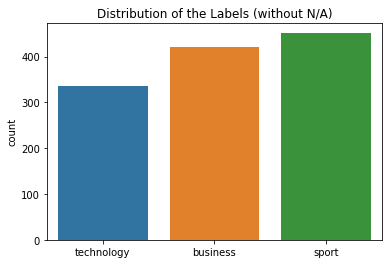

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


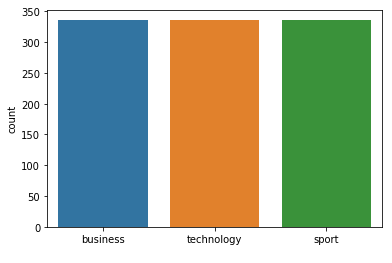



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 241
Class Distribution --> Train data (Fold 3 ):


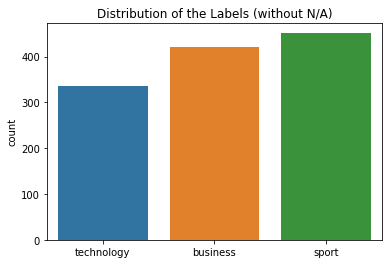

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


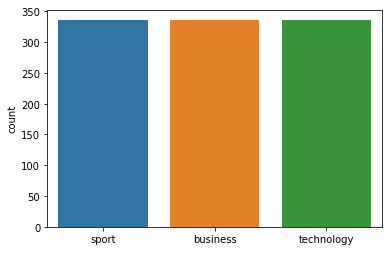



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 241
Class Distribution --> Train data (Fold 4 ):


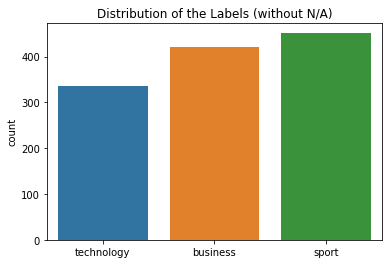

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


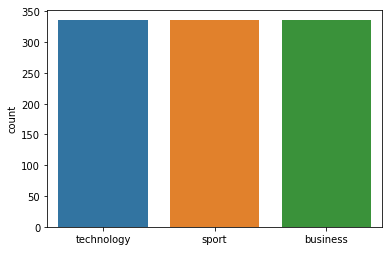



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 241
Class Distribution --> Train data (Fold 5 ):


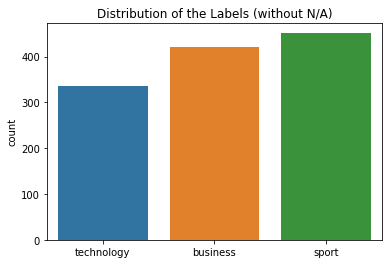

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


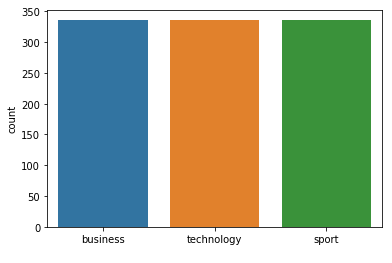



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 241
Class Distribution --> Train data (Fold 6 ):


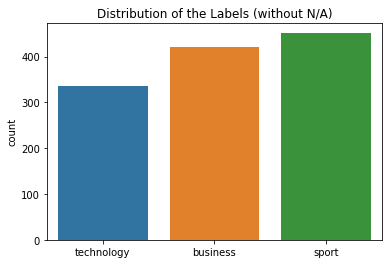

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


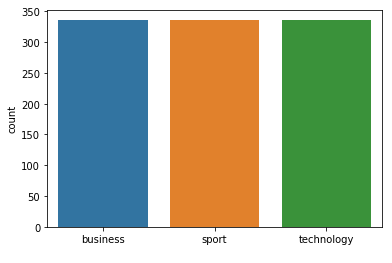



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 241
Class Distribution --> Train data (Fold 7 ):


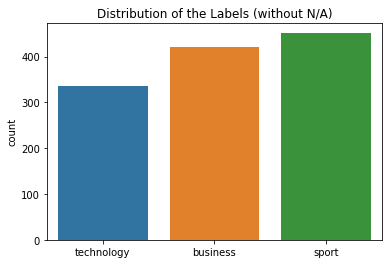

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


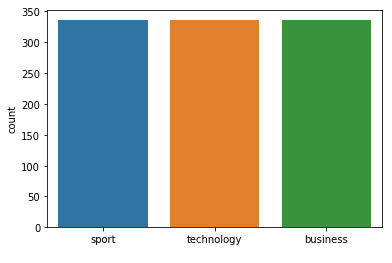



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 241  neighbours): 97.03% (+/- 1.01%)
FOLD 1 Number of neighbors 243
Class Distribution --> Train data (Fold 1 ):


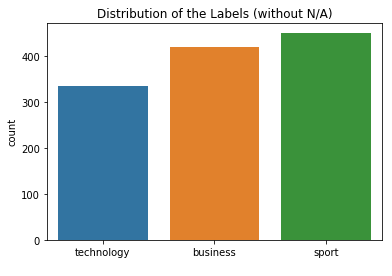

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


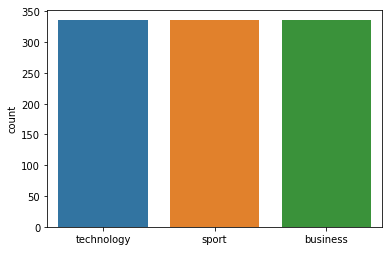



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 243
Class Distribution --> Train data (Fold 2 ):


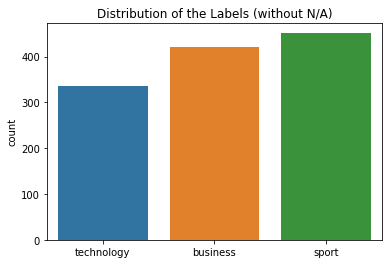

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


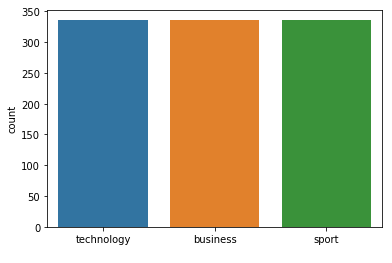



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 243
Class Distribution --> Train data (Fold 3 ):


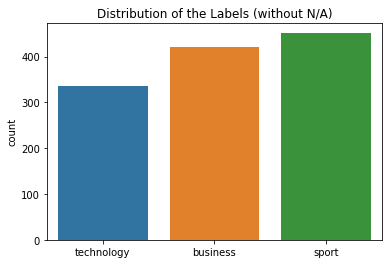

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


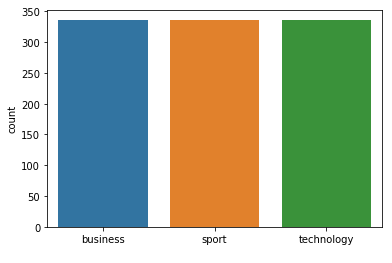



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 243
Class Distribution --> Train data (Fold 4 ):


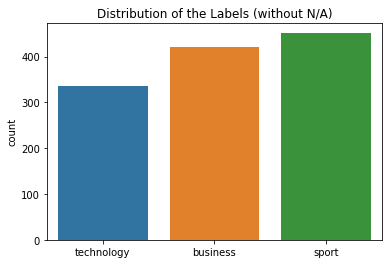

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


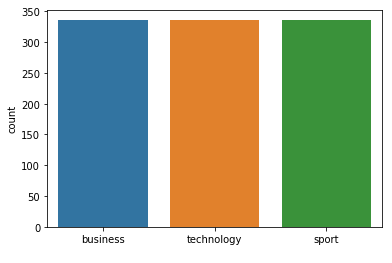



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 243
Class Distribution --> Train data (Fold 5 ):


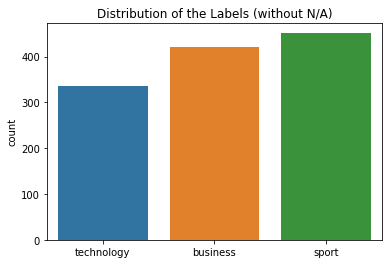

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


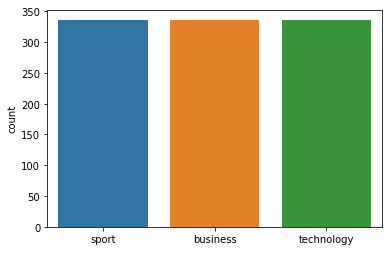



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 243
Class Distribution --> Train data (Fold 6 ):


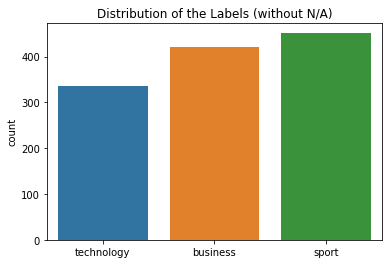

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


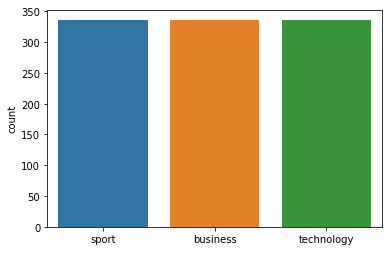



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 243
Class Distribution --> Train data (Fold 7 ):


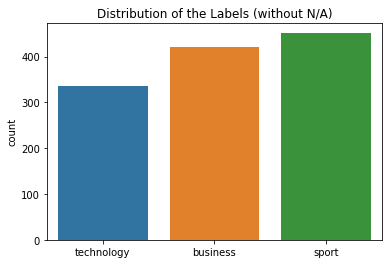

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


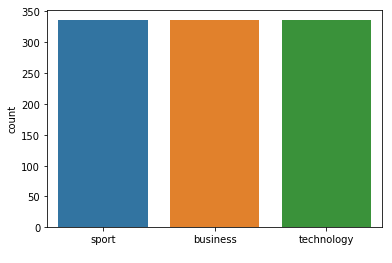



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  3 51]]


 Model accuracy (for 243  neighbours): 97.03% (+/- 1.01%)
FOLD 1 Number of neighbors 245
Class Distribution --> Train data (Fold 1 ):


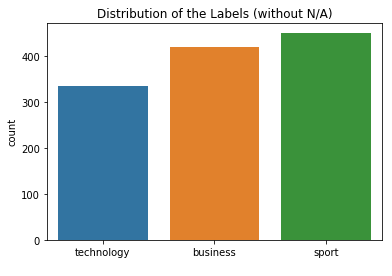

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


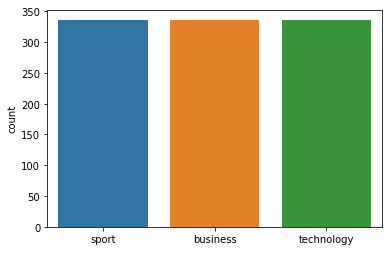



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 245
Class Distribution --> Train data (Fold 2 ):


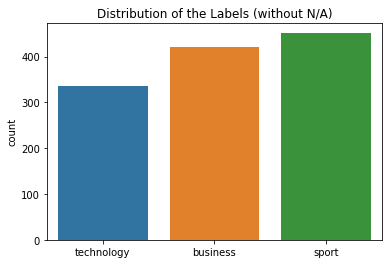

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


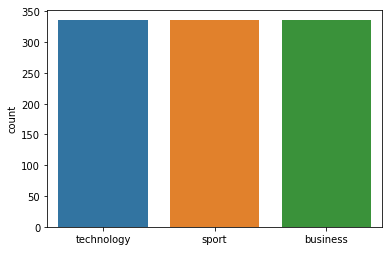



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 245
Class Distribution --> Train data (Fold 3 ):


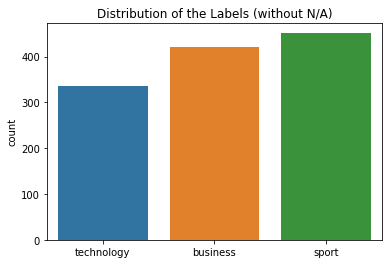

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


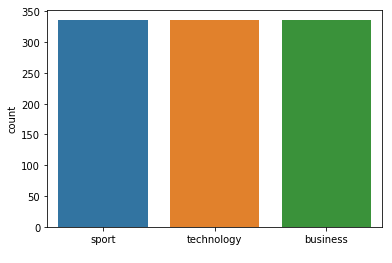



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 245
Class Distribution --> Train data (Fold 4 ):


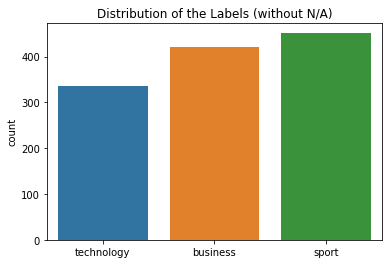

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


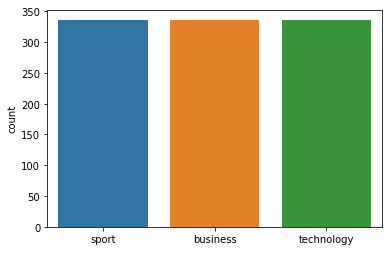



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 245
Class Distribution --> Train data (Fold 5 ):


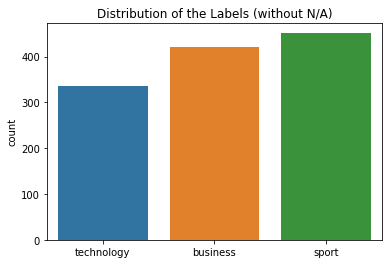

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


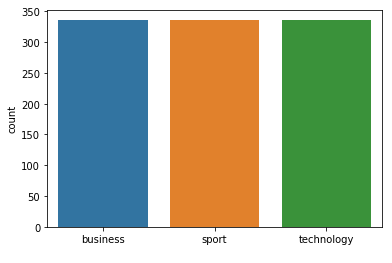



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 245
Class Distribution --> Train data (Fold 6 ):


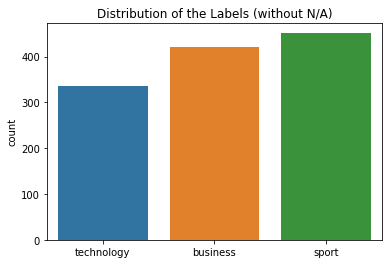

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


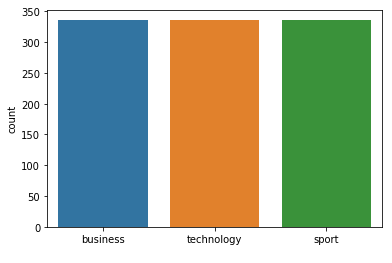



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 245
Class Distribution --> Train data (Fold 7 ):


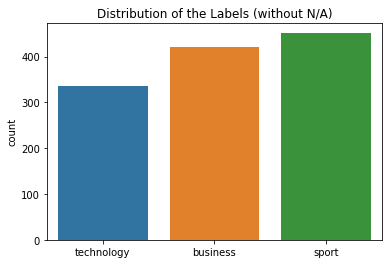

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


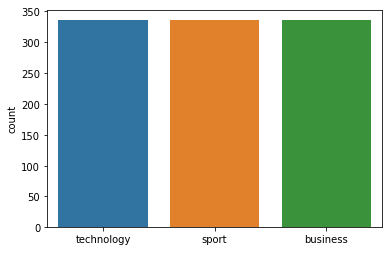



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.96      0.99      0.97        75
technology
       0.94      0.93      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  3 51]]


 Model accuracy (for 245  neighbours): 97.03% (+/- 1.01%)
FOLD 1 Number of neighbors 247
Class Distribution --> Train data (Fold 1 ):


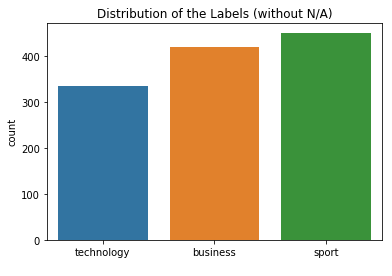

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


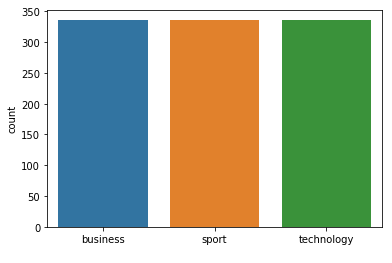



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.96      1.00      0.98        76
technology
       0.96      0.95      0.95        56

avg / total       0.98      0.98      0.98       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 76  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 247
Class Distribution --> Train data (Fold 2 ):


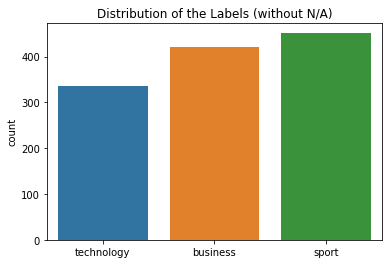

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


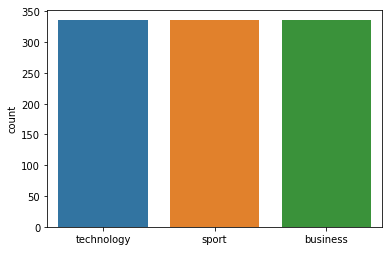



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 247
Class Distribution --> Train data (Fold 3 ):


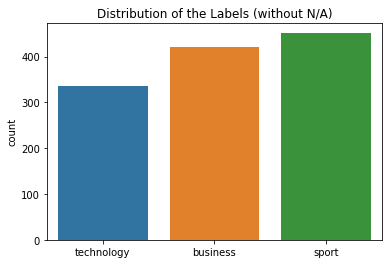

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


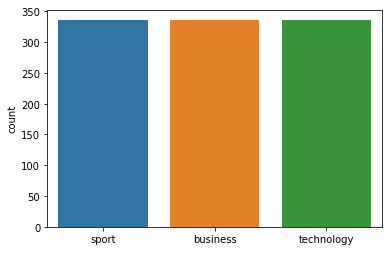



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 247
Class Distribution --> Train data (Fold 4 ):


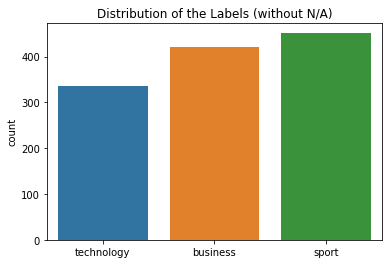

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


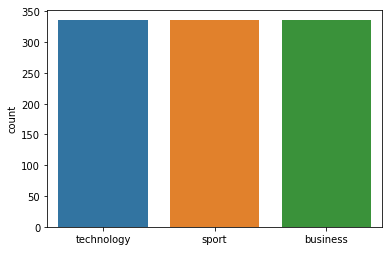



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 247
Class Distribution --> Train data (Fold 5 ):


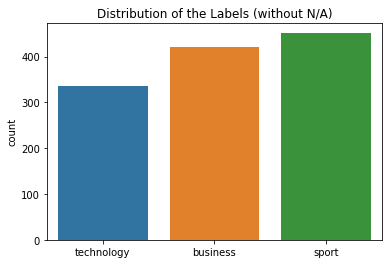

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


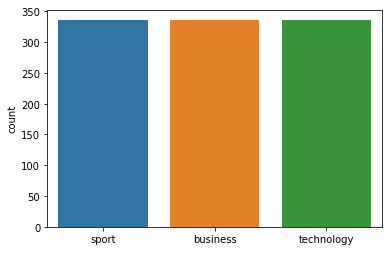



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 247
Class Distribution --> Train data (Fold 6 ):


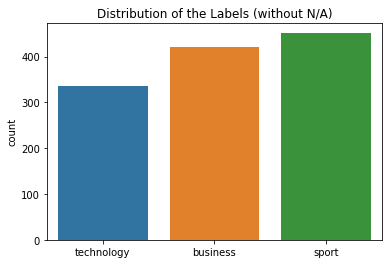

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


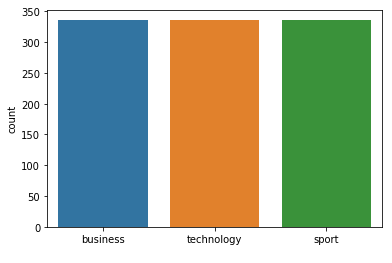



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 247
Class Distribution --> Train data (Fold 7 ):


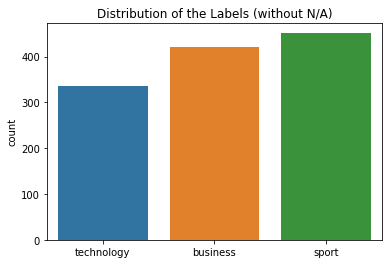

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


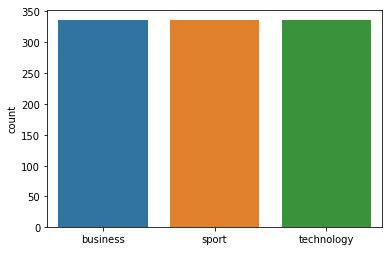



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 247  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 249
Class Distribution --> Train data (Fold 1 ):


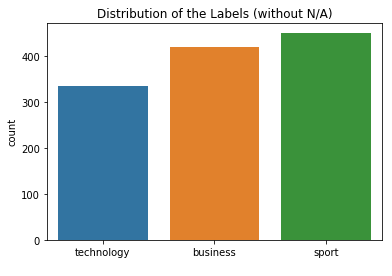

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


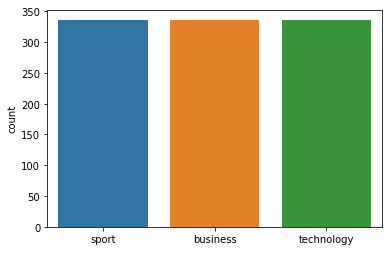



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 249
Class Distribution --> Train data (Fold 2 ):


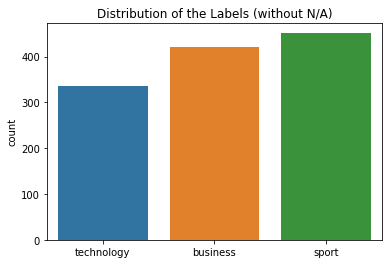

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


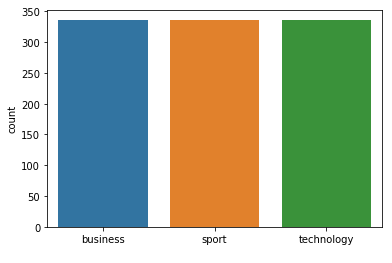



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 249
Class Distribution --> Train data (Fold 3 ):


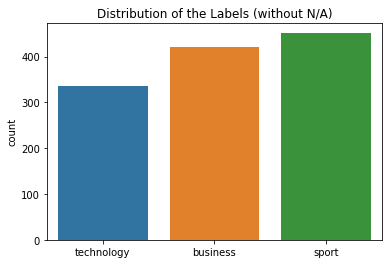

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


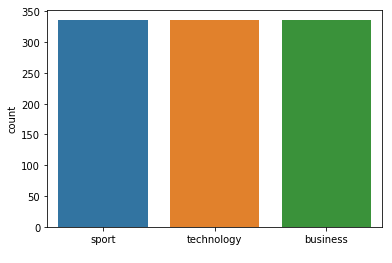



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 249
Class Distribution --> Train data (Fold 4 ):


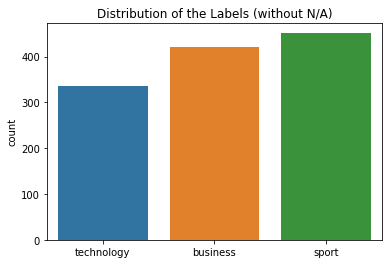

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


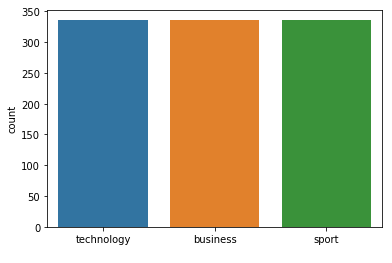



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 249
Class Distribution --> Train data (Fold 5 ):


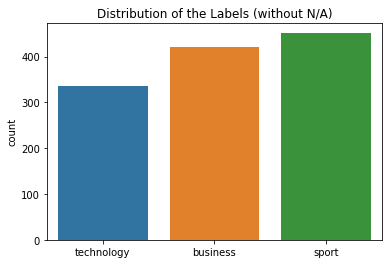

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


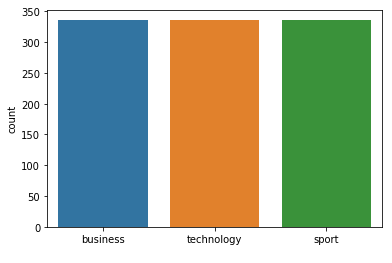



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 249
Class Distribution --> Train data (Fold 6 ):


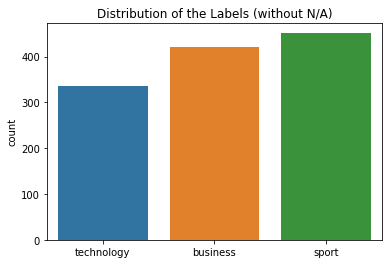

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


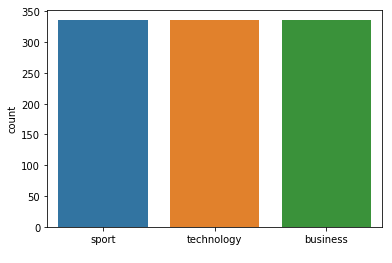



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 249
Class Distribution --> Train data (Fold 7 ):


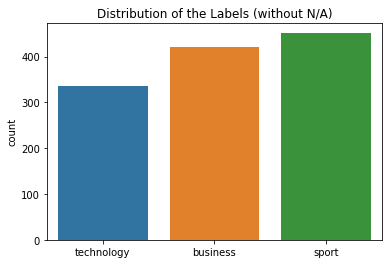

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


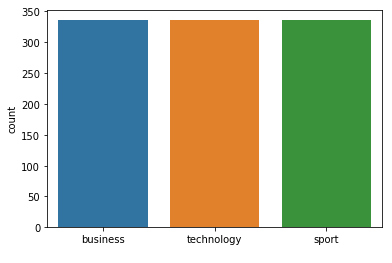



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 249  neighbours): 97.03% (+/- 1.01%)
FOLD 1 Number of neighbors 251
Class Distribution --> Train data (Fold 1 ):


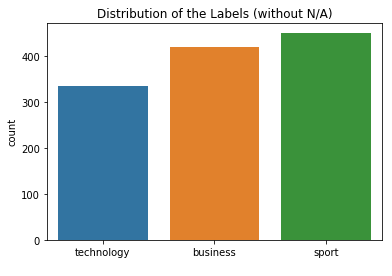

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


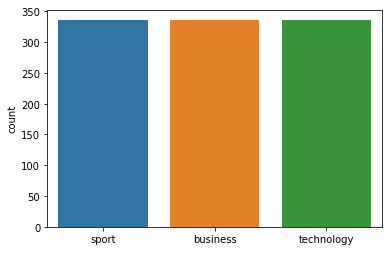



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 251
Class Distribution --> Train data (Fold 2 ):


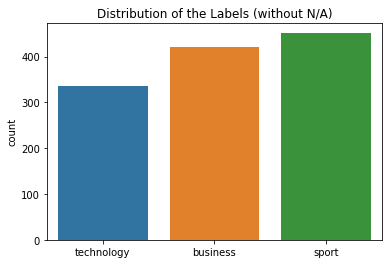

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


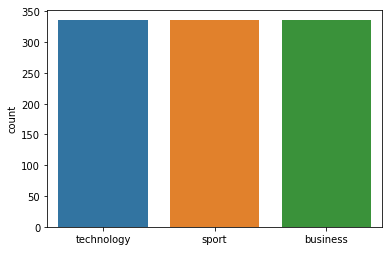



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 251
Class Distribution --> Train data (Fold 3 ):


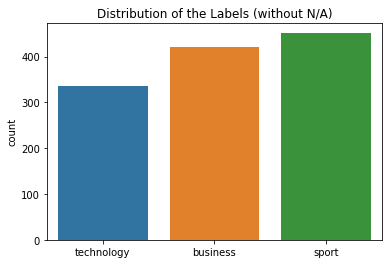

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


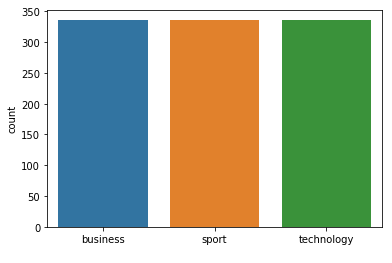



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 251
Class Distribution --> Train data (Fold 4 ):


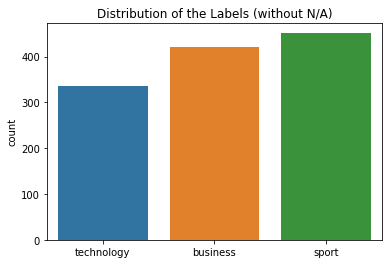

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


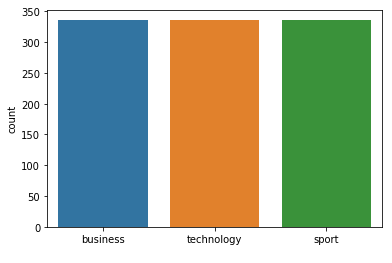



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 251
Class Distribution --> Train data (Fold 5 ):


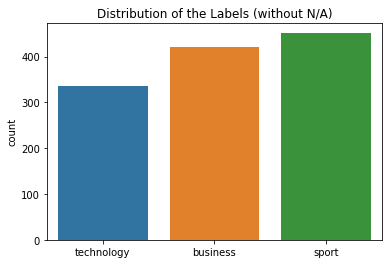

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


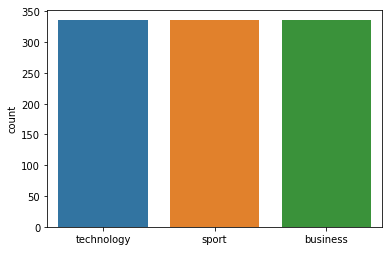



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.95      1.00      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[67  0  3]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 251
Class Distribution --> Train data (Fold 6 ):


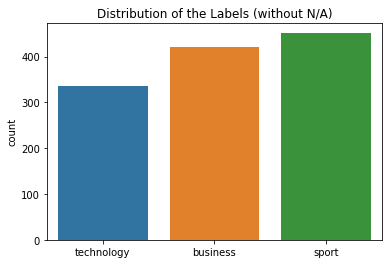

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


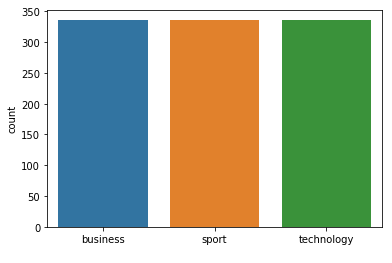



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 251
Class Distribution --> Train data (Fold 7 ):


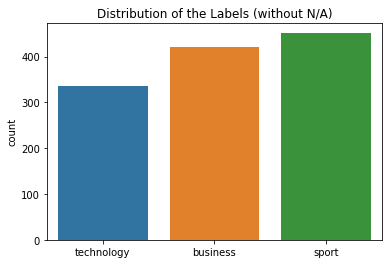

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


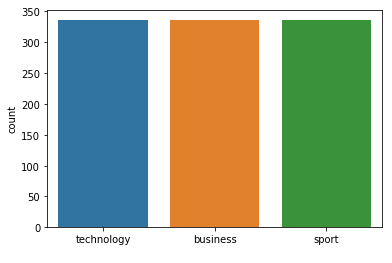



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 251  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 253
Class Distribution --> Train data (Fold 1 ):


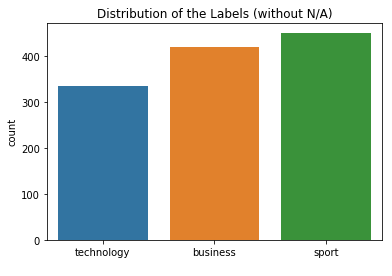

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


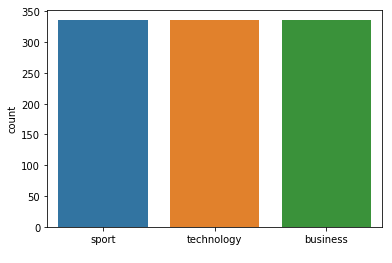



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 253
Class Distribution --> Train data (Fold 2 ):


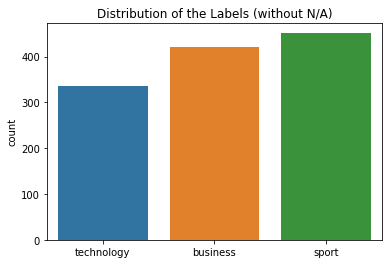

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


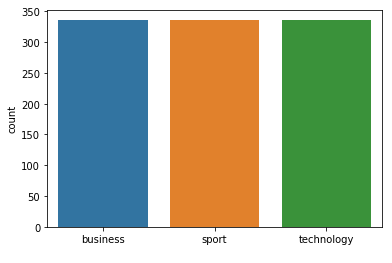



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 253
Class Distribution --> Train data (Fold 3 ):


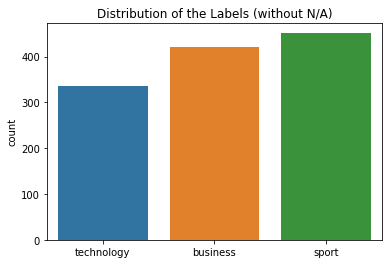

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


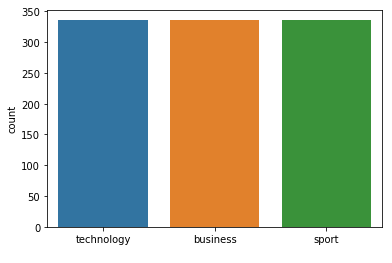



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 253
Class Distribution --> Train data (Fold 4 ):


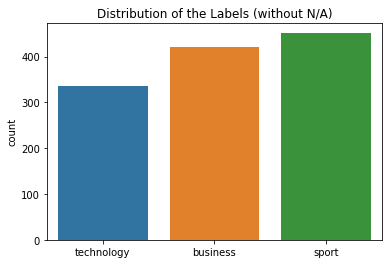

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


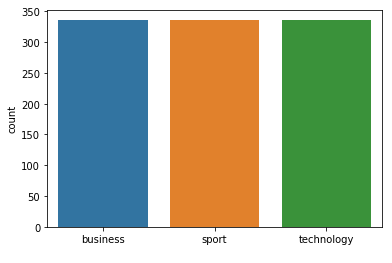



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 253
Class Distribution --> Train data (Fold 5 ):


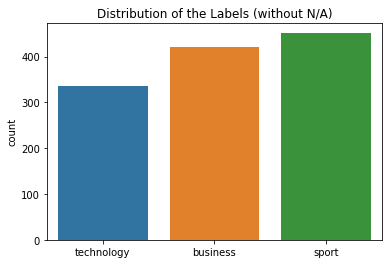

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


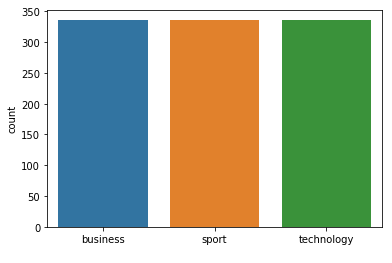



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 253
Class Distribution --> Train data (Fold 6 ):


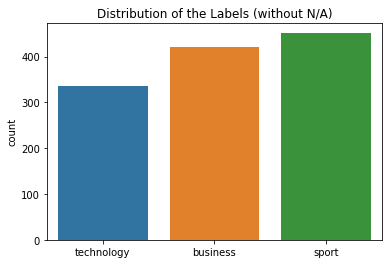

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


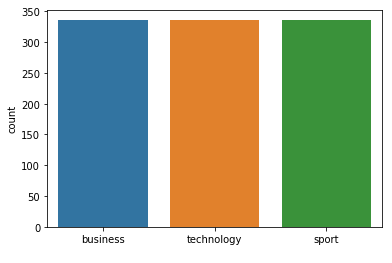



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 253
Class Distribution --> Train data (Fold 7 ):


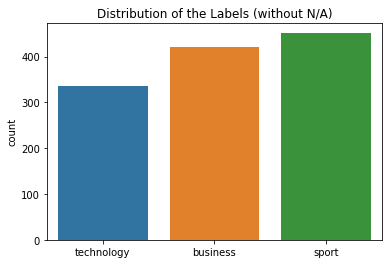

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


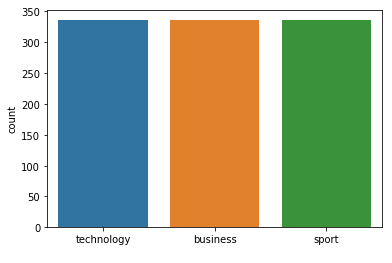



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 253  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 255
Class Distribution --> Train data (Fold 1 ):


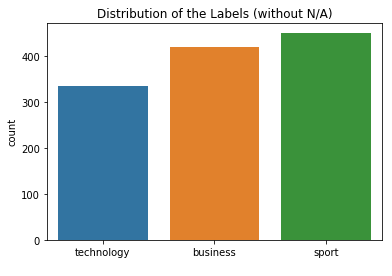

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


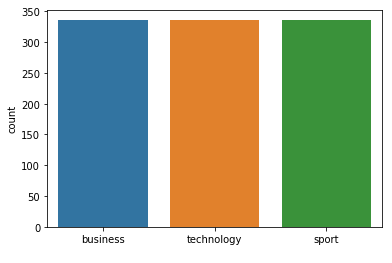



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 255
Class Distribution --> Train data (Fold 2 ):


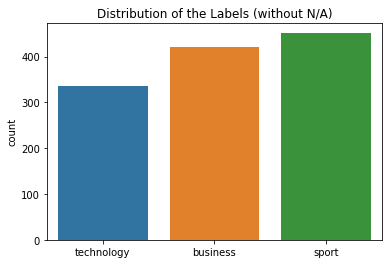

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


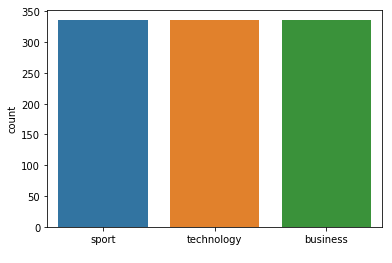



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 255
Class Distribution --> Train data (Fold 3 ):


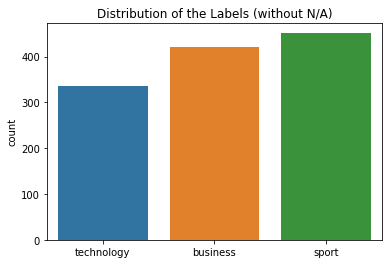

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


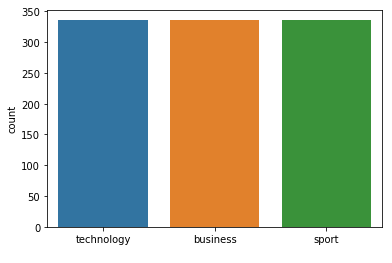



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 255
Class Distribution --> Train data (Fold 4 ):


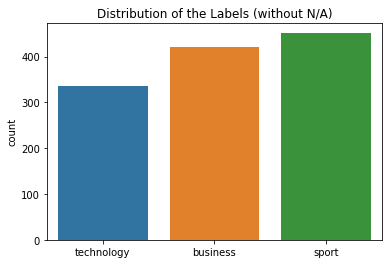

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


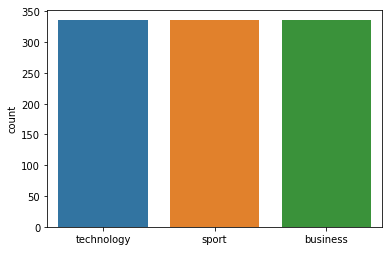



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 255
Class Distribution --> Train data (Fold 5 ):


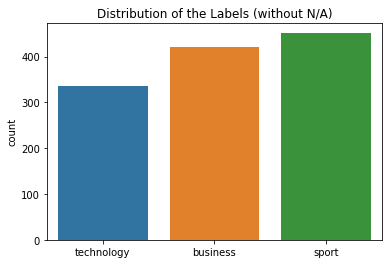

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


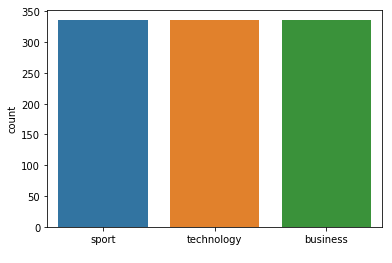



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 255
Class Distribution --> Train data (Fold 6 ):


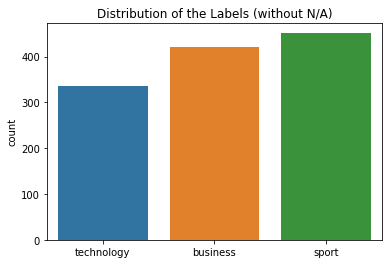

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


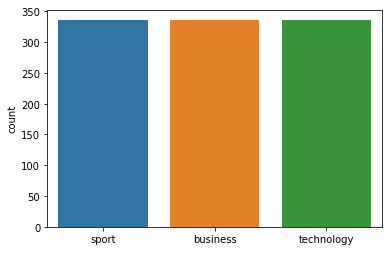



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 255
Class Distribution --> Train data (Fold 7 ):


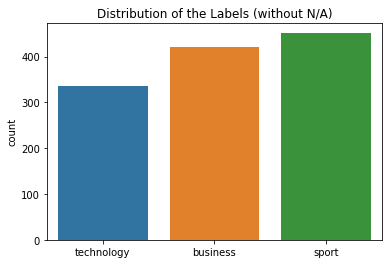

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


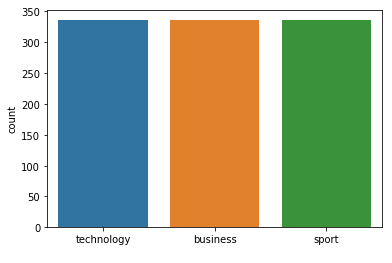



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 255  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 257
Class Distribution --> Train data (Fold 1 ):


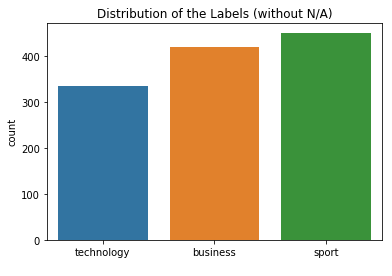

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


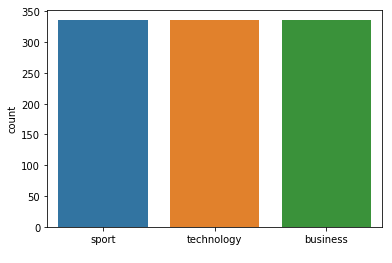



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 257
Class Distribution --> Train data (Fold 2 ):


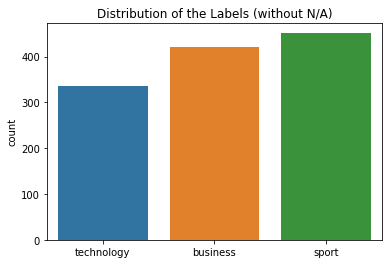

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


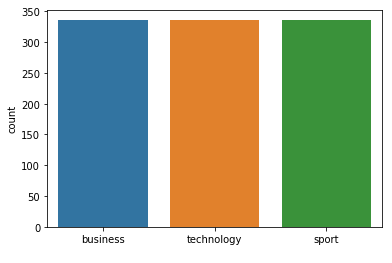



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.93      0.97      0.95        70
     sport
       0.97      0.95      0.96        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 4 71  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 257
Class Distribution --> Train data (Fold 3 ):


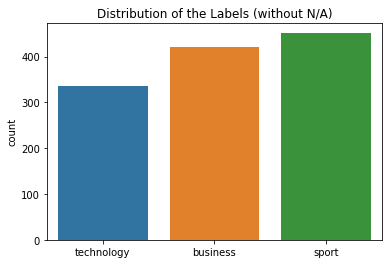

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


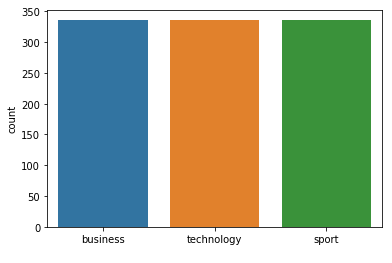



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 257
Class Distribution --> Train data (Fold 4 ):


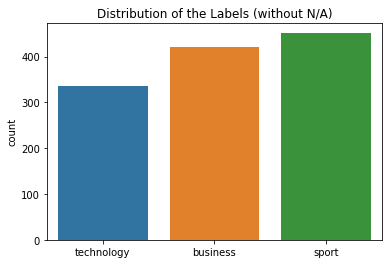

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


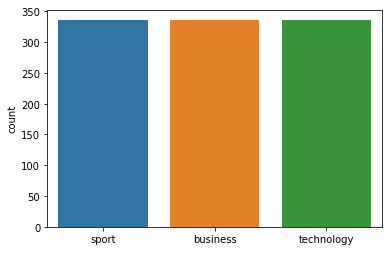



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 257
Class Distribution --> Train data (Fold 5 ):


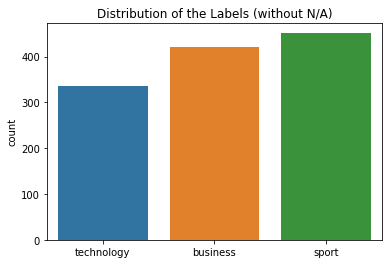

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


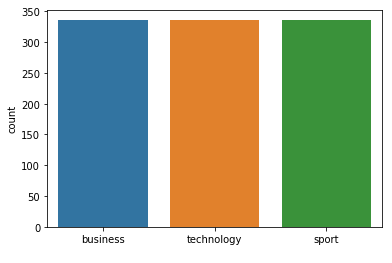



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 257
Class Distribution --> Train data (Fold 6 ):


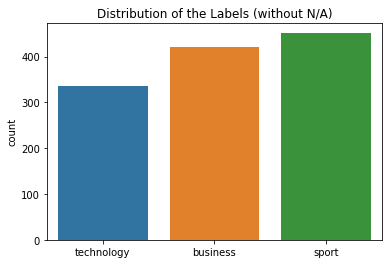

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


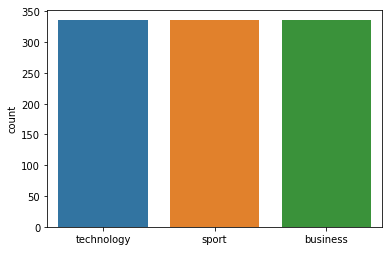



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 257
Class Distribution --> Train data (Fold 7 ):


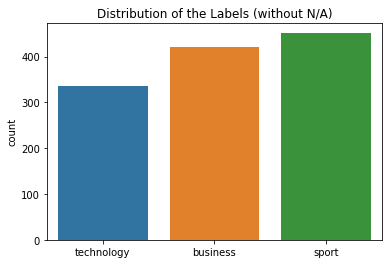

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


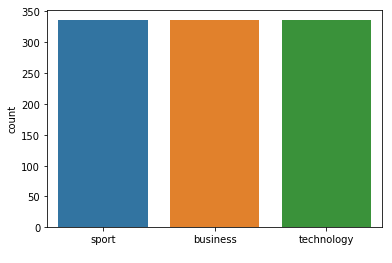



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 257  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 259
Class Distribution --> Train data (Fold 1 ):


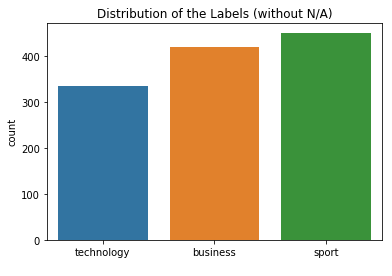

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


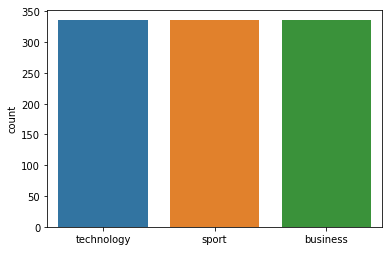



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 259
Class Distribution --> Train data (Fold 2 ):


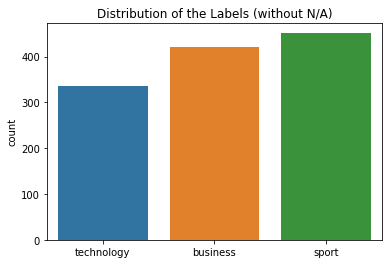

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


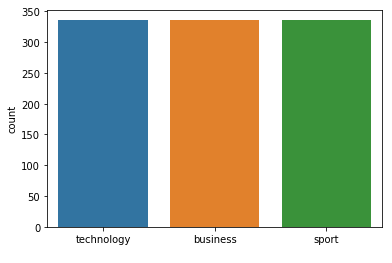



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 259
Class Distribution --> Train data (Fold 3 ):


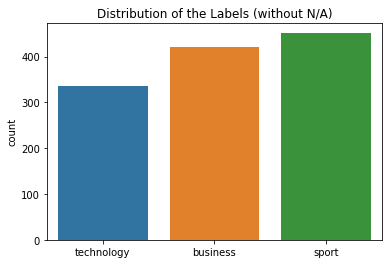

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


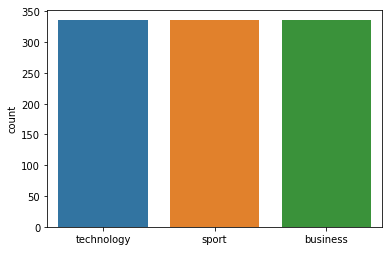



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 259
Class Distribution --> Train data (Fold 4 ):


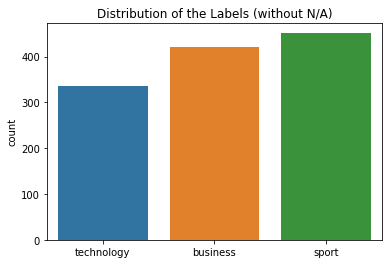

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


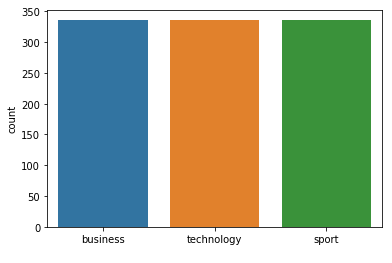



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       1.00      0.97      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 259
Class Distribution --> Train data (Fold 5 ):


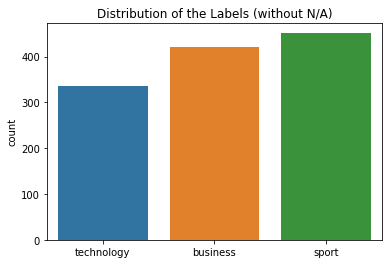

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


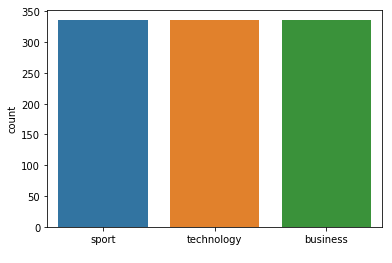



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 259
Class Distribution --> Train data (Fold 6 ):


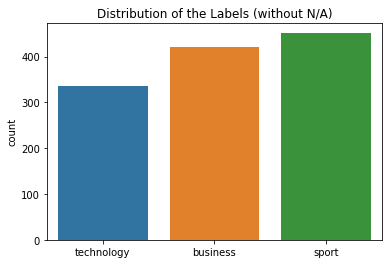

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


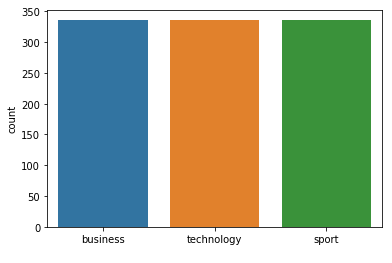



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 259
Class Distribution --> Train data (Fold 7 ):


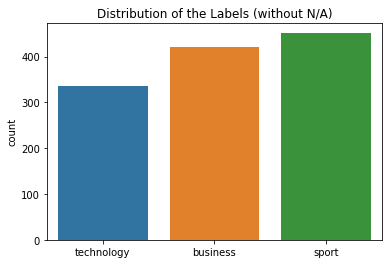

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


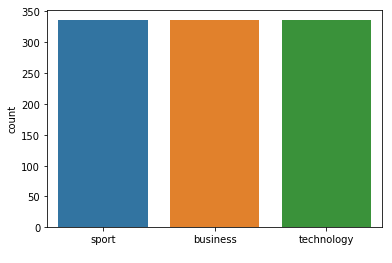



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 259  neighbours): 97.03% (+/- 1.00%)
FOLD 1 Number of neighbors 261
Class Distribution --> Train data (Fold 1 ):


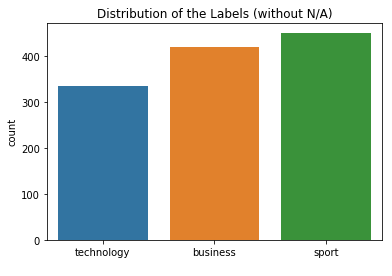

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


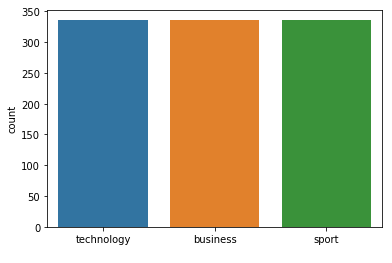



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 261
Class Distribution --> Train data (Fold 2 ):


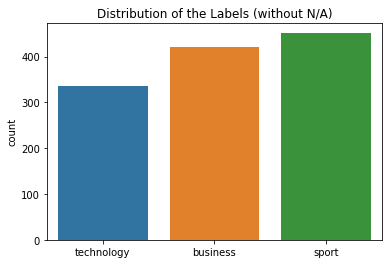

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


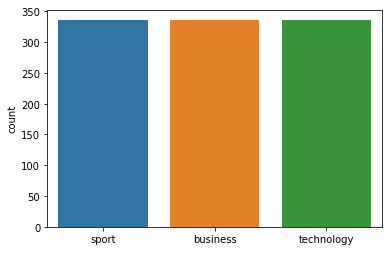



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 261
Class Distribution --> Train data (Fold 3 ):


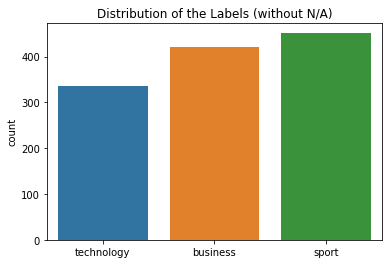

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


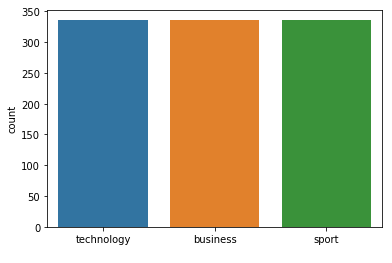



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 261
Class Distribution --> Train data (Fold 4 ):


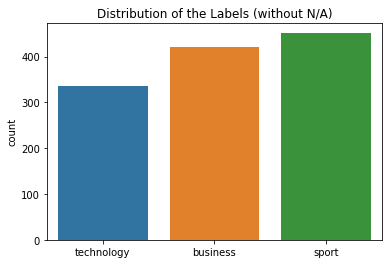

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


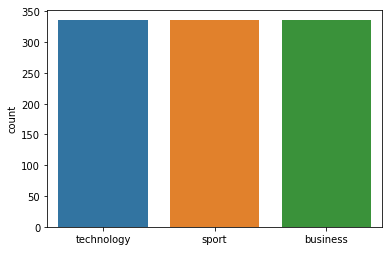



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 261
Class Distribution --> Train data (Fold 5 ):


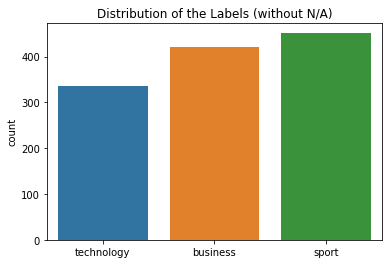

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


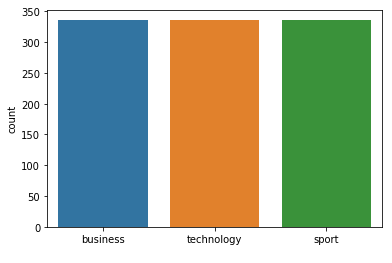



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 261
Class Distribution --> Train data (Fold 6 ):


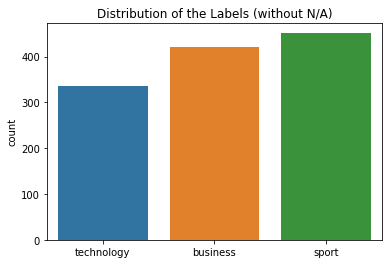

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


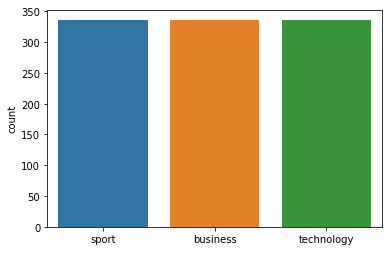



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.98      0.93      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 261
Class Distribution --> Train data (Fold 7 ):


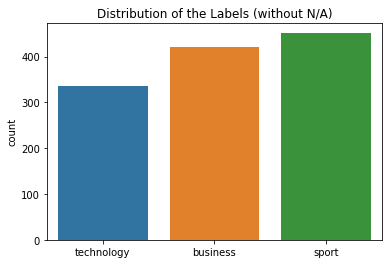

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


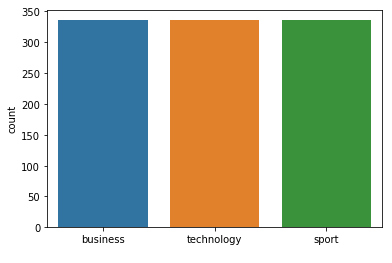



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 261  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 263
Class Distribution --> Train data (Fold 1 ):


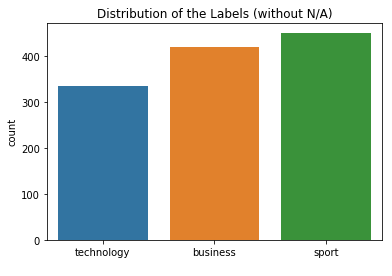

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


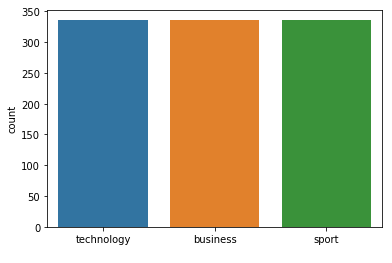



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 263
Class Distribution --> Train data (Fold 2 ):


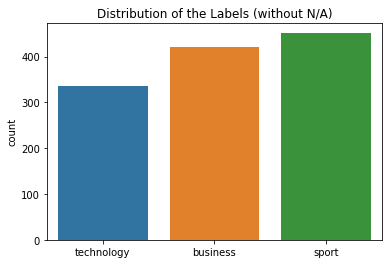

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


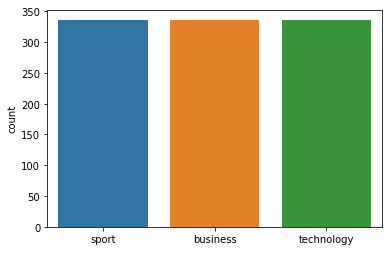



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 263
Class Distribution --> Train data (Fold 3 ):


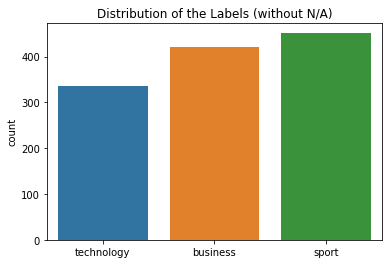

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


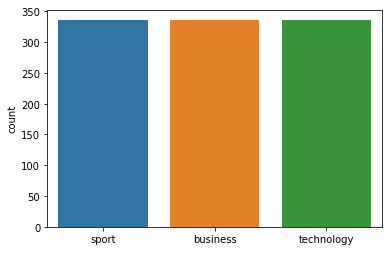



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 263
Class Distribution --> Train data (Fold 4 ):


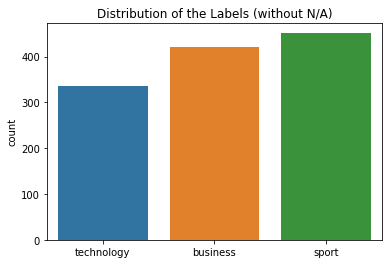

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


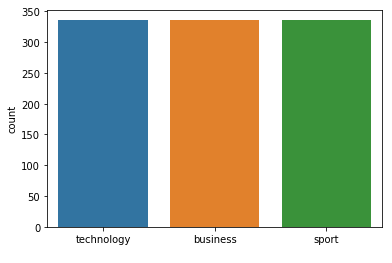



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 263
Class Distribution --> Train data (Fold 5 ):


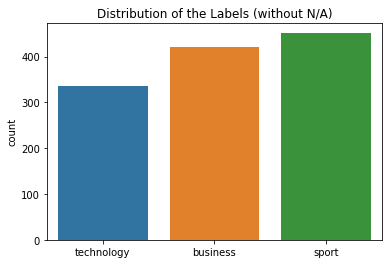

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


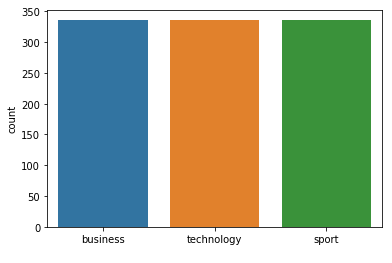



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 263
Class Distribution --> Train data (Fold 6 ):


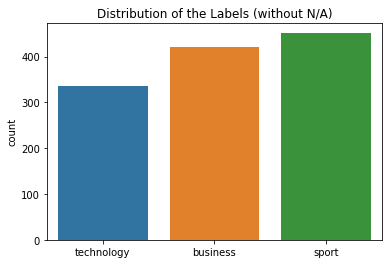

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


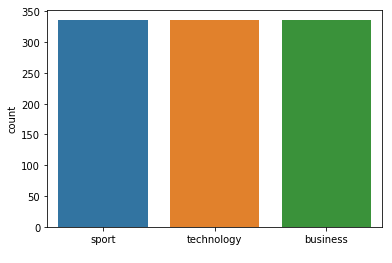



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.95      1.00      0.97        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  3 53]]
FOLD 7 Number of neighbors 263
Class Distribution --> Train data (Fold 7 ):


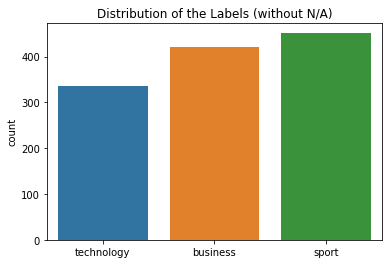

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


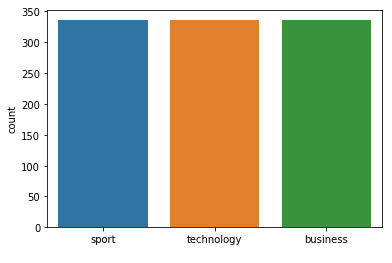



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 263  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 265
Class Distribution --> Train data (Fold 1 ):


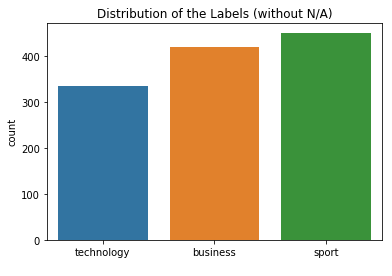

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


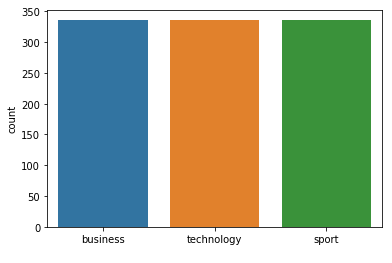



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 265
Class Distribution --> Train data (Fold 2 ):


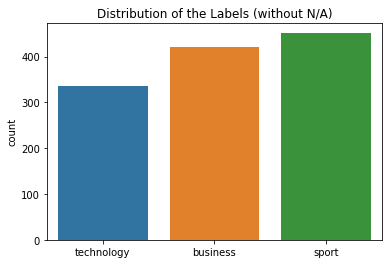

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


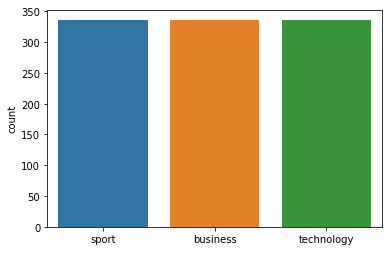



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 265
Class Distribution --> Train data (Fold 3 ):


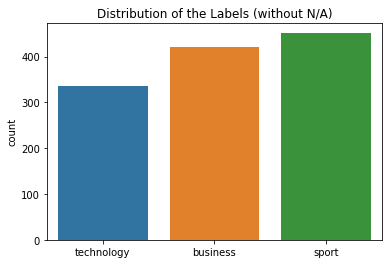

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


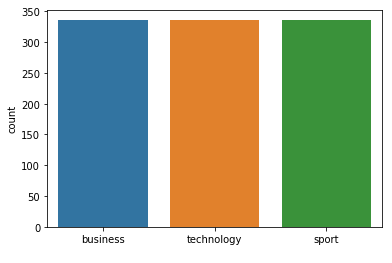



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.93      0.95        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 265
Class Distribution --> Train data (Fold 4 ):


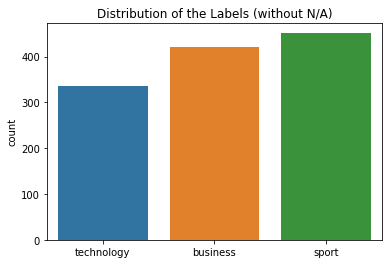

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


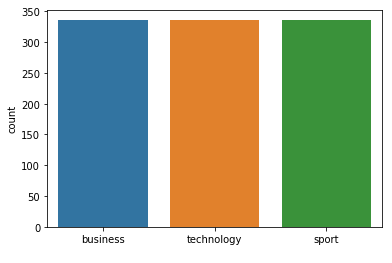



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 265
Class Distribution --> Train data (Fold 5 ):


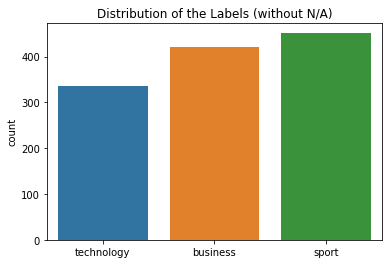

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


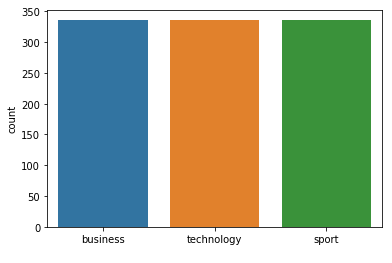



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 265
Class Distribution --> Train data (Fold 6 ):


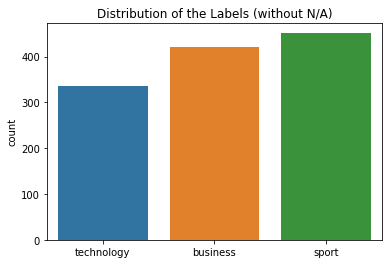

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


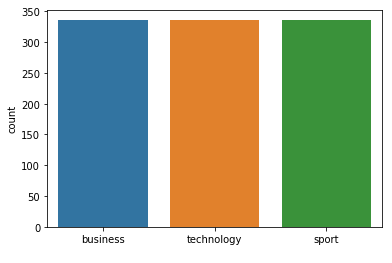



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 265
Class Distribution --> Train data (Fold 7 ):


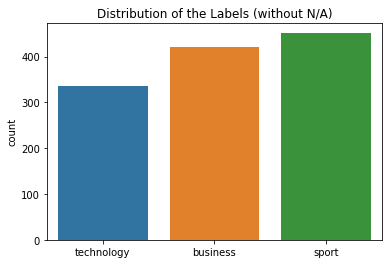

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


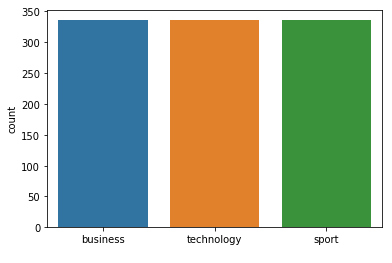



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 265  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 267
Class Distribution --> Train data (Fold 1 ):


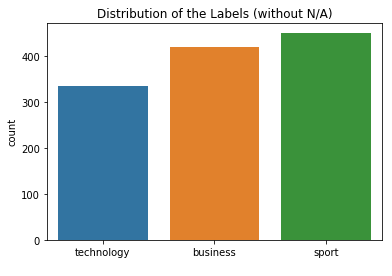

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


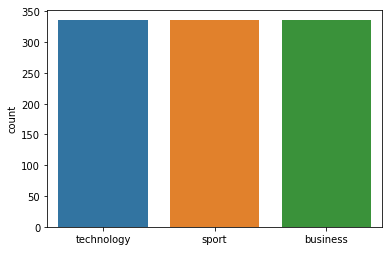



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 267
Class Distribution --> Train data (Fold 2 ):


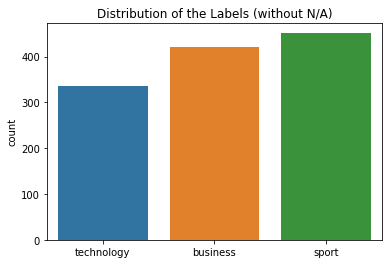

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


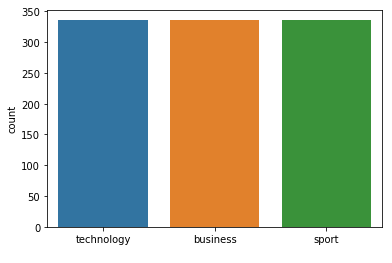



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 267
Class Distribution --> Train data (Fold 3 ):


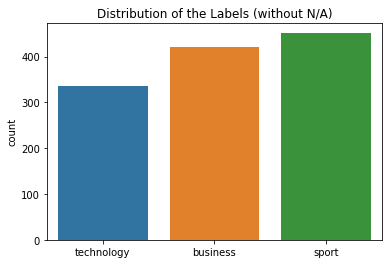

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


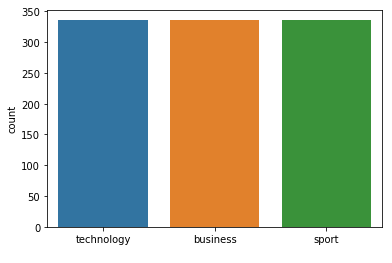



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 267
Class Distribution --> Train data (Fold 4 ):


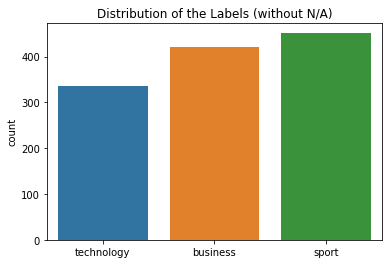

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


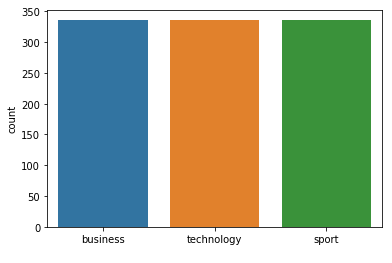



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 267
Class Distribution --> Train data (Fold 5 ):


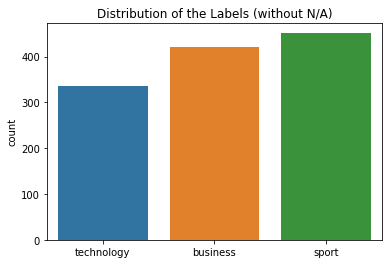

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


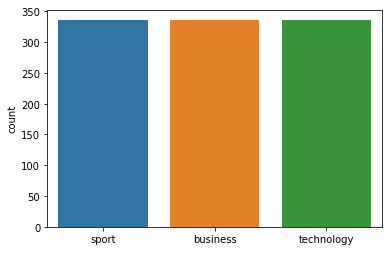



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 267
Class Distribution --> Train data (Fold 6 ):


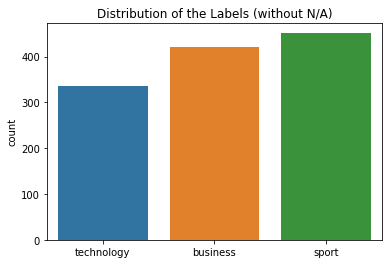

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


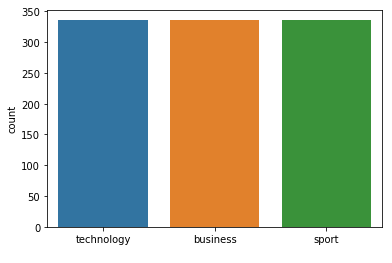



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  0  4]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 267
Class Distribution --> Train data (Fold 7 ):


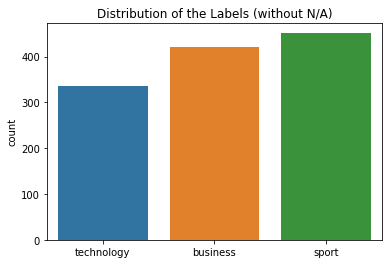

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


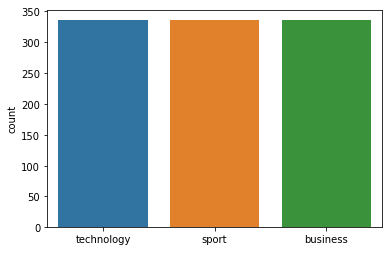



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 267  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 269
Class Distribution --> Train data (Fold 1 ):


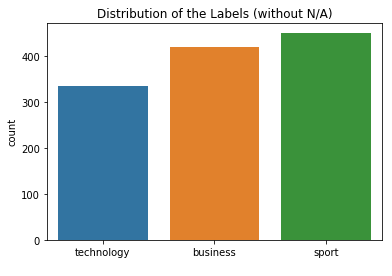

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


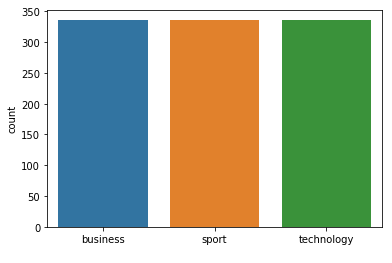



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 269
Class Distribution --> Train data (Fold 2 ):


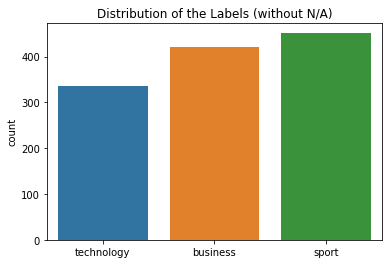

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


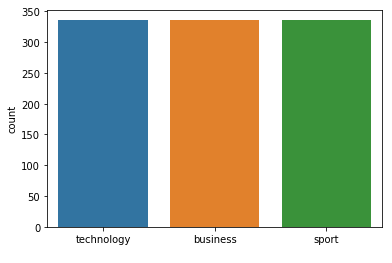



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 269
Class Distribution --> Train data (Fold 3 ):


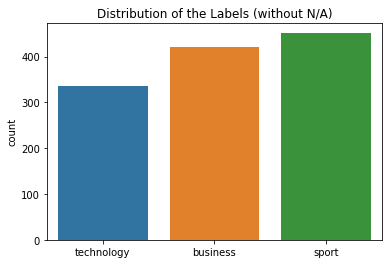

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


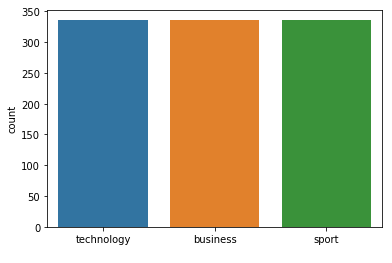



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 269
Class Distribution --> Train data (Fold 4 ):


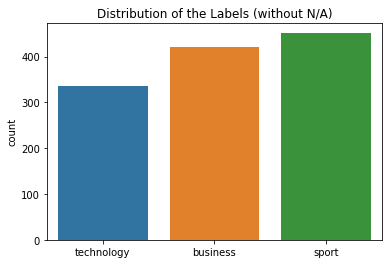

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


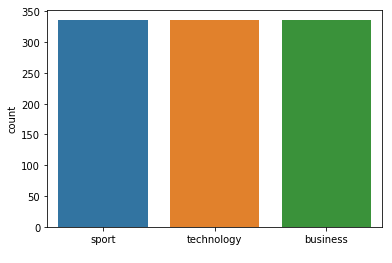



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       1.00      0.97      0.99        75
technology
       1.00      1.00      1.00        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 269
Class Distribution --> Train data (Fold 5 ):


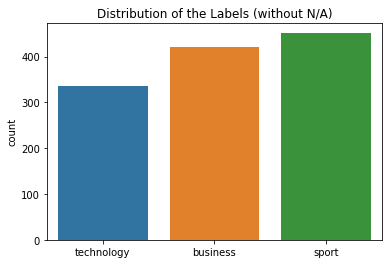

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


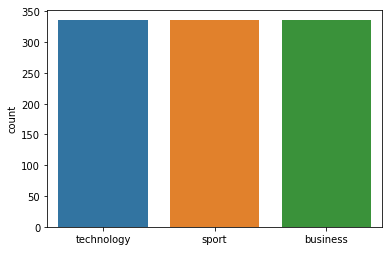



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 269
Class Distribution --> Train data (Fold 6 ):


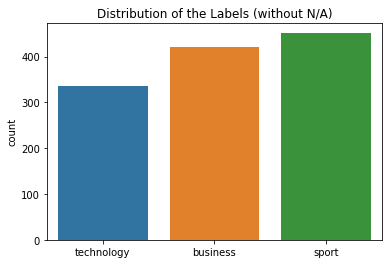

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


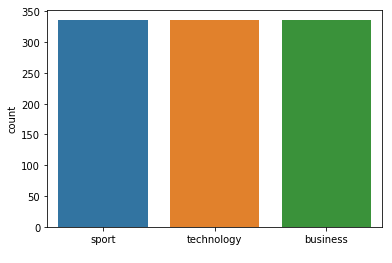



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 269
Class Distribution --> Train data (Fold 7 ):


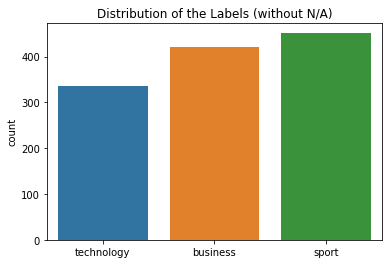

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


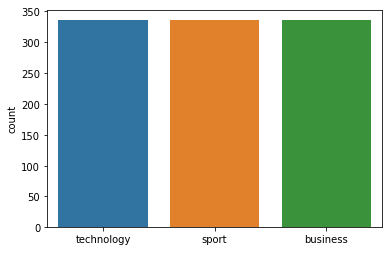



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 269  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 271
Class Distribution --> Train data (Fold 1 ):


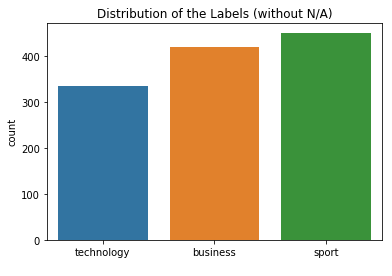

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


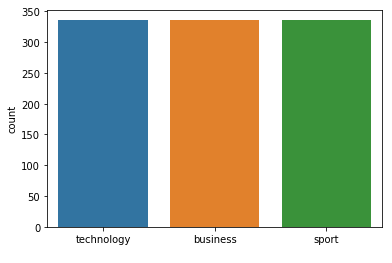



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 271
Class Distribution --> Train data (Fold 2 ):


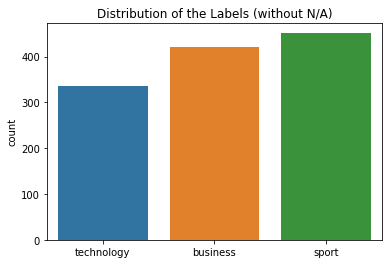

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


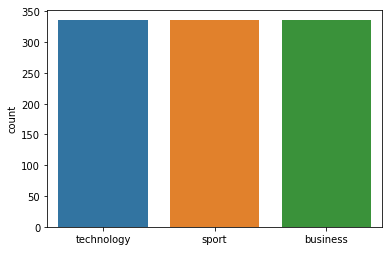



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 271
Class Distribution --> Train data (Fold 3 ):


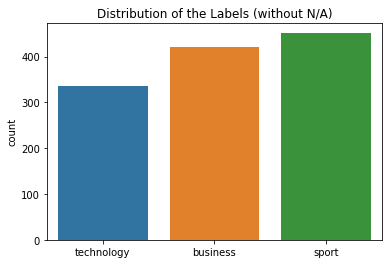

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


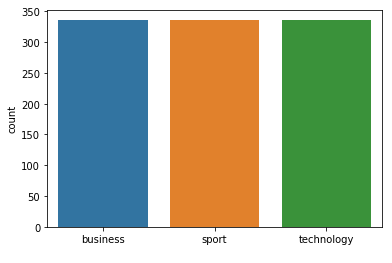



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.95      1.00      0.97        75
technology
       0.94      0.91      0.93        56

avg / total       0.96      0.96      0.95       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  3 51]]
FOLD 4 Number of neighbors 271
Class Distribution --> Train data (Fold 4 ):


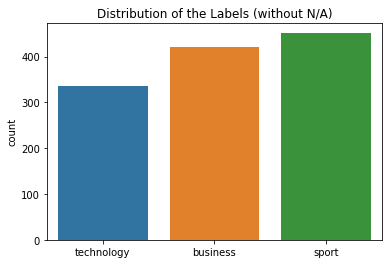

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


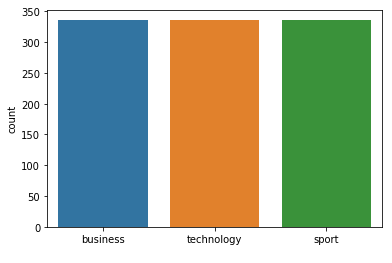



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 271
Class Distribution --> Train data (Fold 5 ):


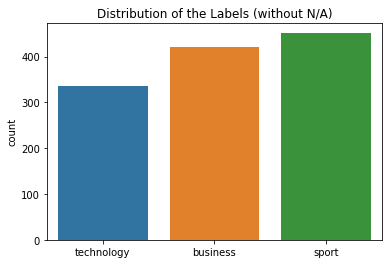

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


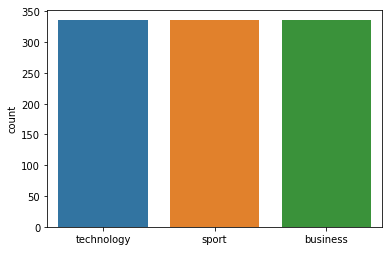



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 271
Class Distribution --> Train data (Fold 6 ):


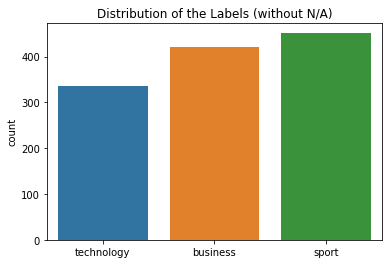

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


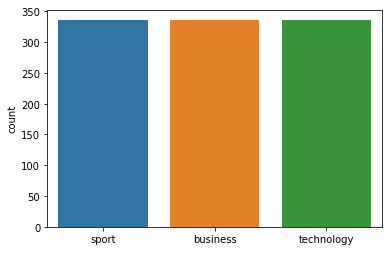



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 271
Class Distribution --> Train data (Fold 7 ):


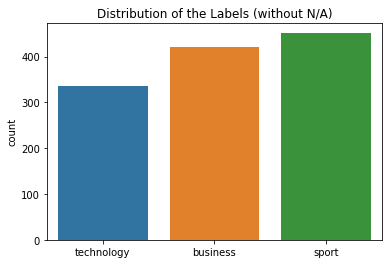

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


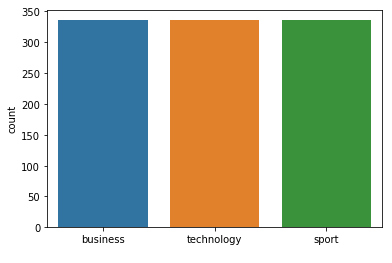



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 271  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 273
Class Distribution --> Train data (Fold 1 ):


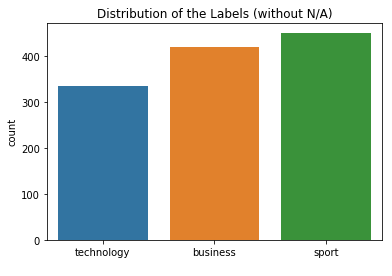

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


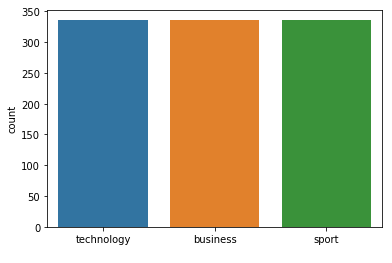



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 273
Class Distribution --> Train data (Fold 2 ):


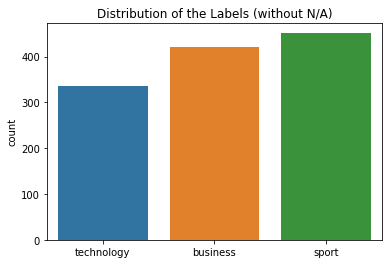

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


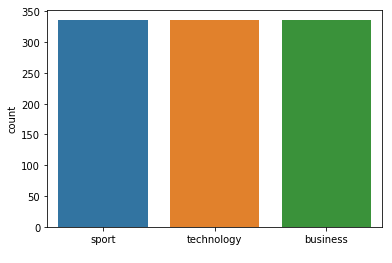



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 273
Class Distribution --> Train data (Fold 3 ):


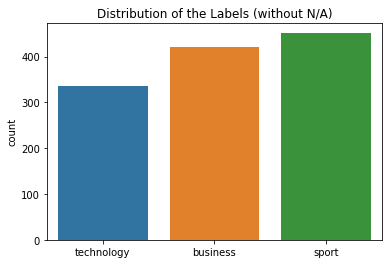

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


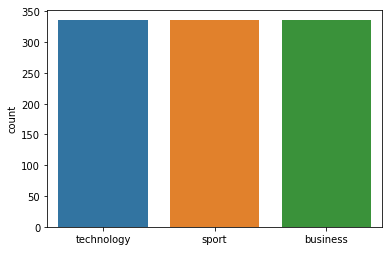



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 273
Class Distribution --> Train data (Fold 4 ):


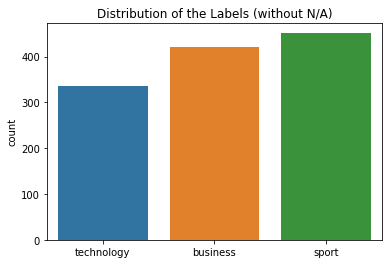

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


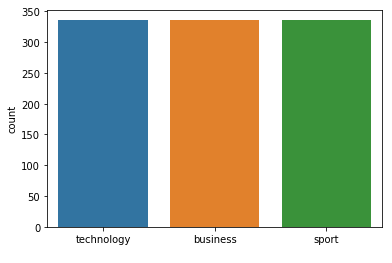



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 273
Class Distribution --> Train data (Fold 5 ):


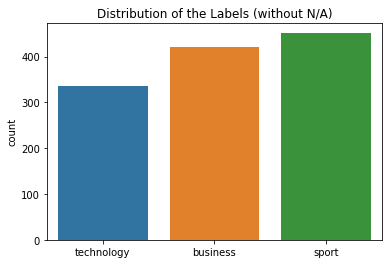

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


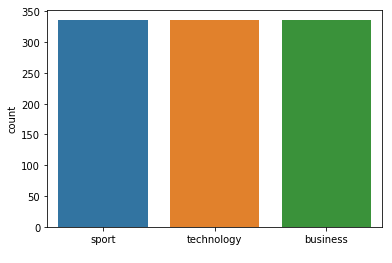



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 273
Class Distribution --> Train data (Fold 6 ):


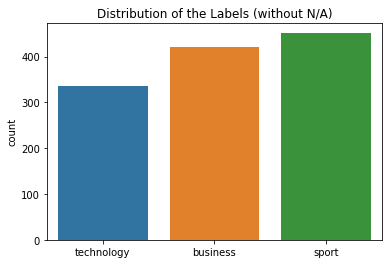

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


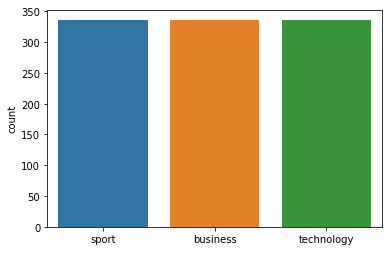



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.92      0.96      0.94        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  0  5]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 273
Class Distribution --> Train data (Fold 7 ):


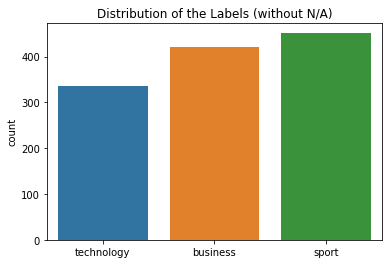

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


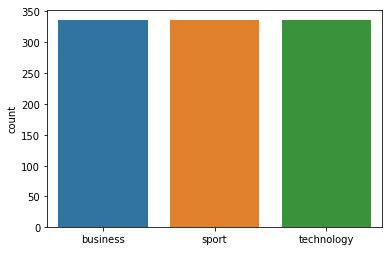



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 273  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 275
Class Distribution --> Train data (Fold 1 ):


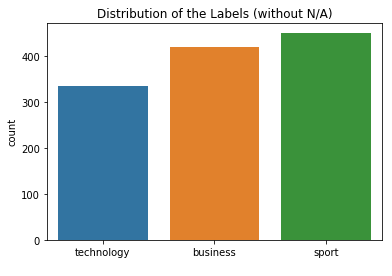

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


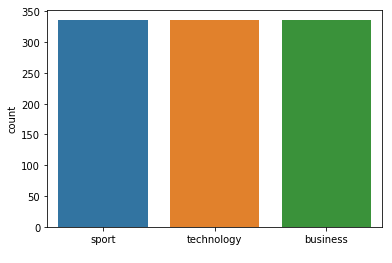



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 275
Class Distribution --> Train data (Fold 2 ):


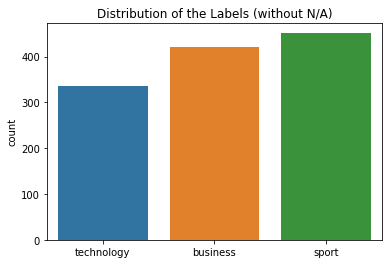

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


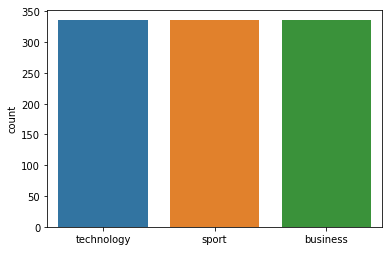



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 275
Class Distribution --> Train data (Fold 3 ):


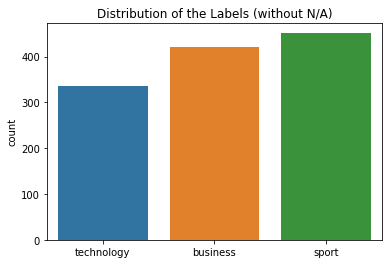

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


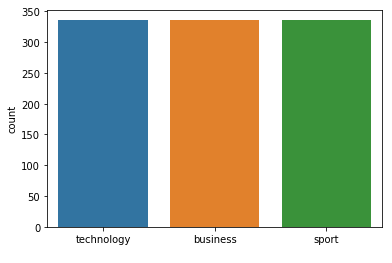



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 275
Class Distribution --> Train data (Fold 4 ):


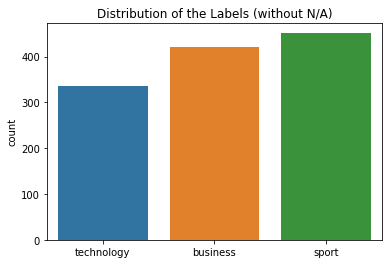

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


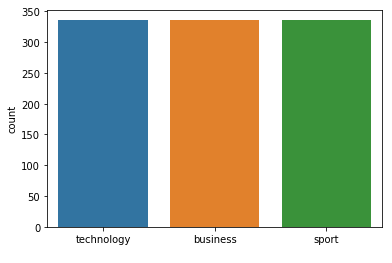



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 275
Class Distribution --> Train data (Fold 5 ):


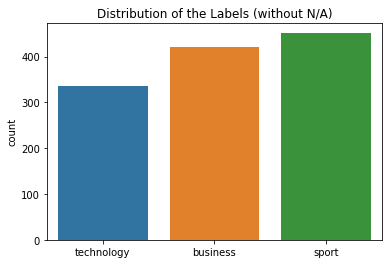

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


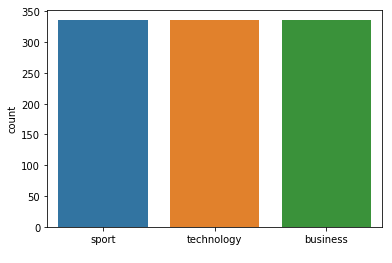



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 275
Class Distribution --> Train data (Fold 6 ):


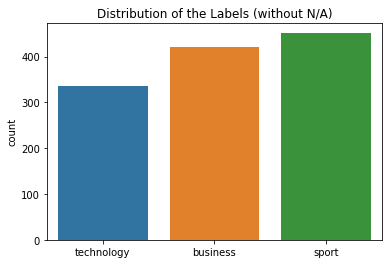

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


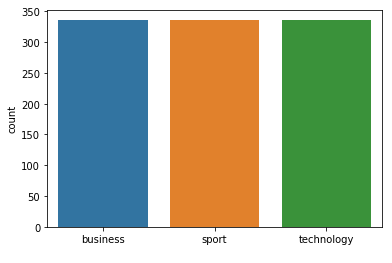



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 275
Class Distribution --> Train data (Fold 7 ):


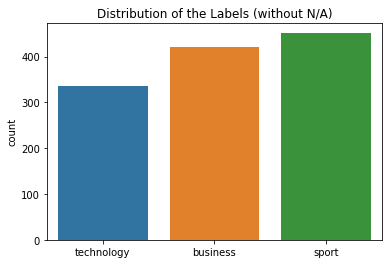

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


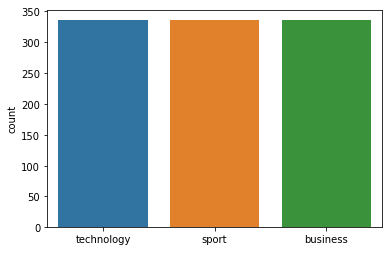



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 275  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 277
Class Distribution --> Train data (Fold 1 ):


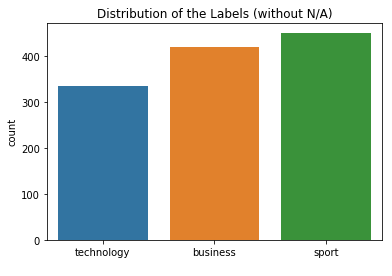

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


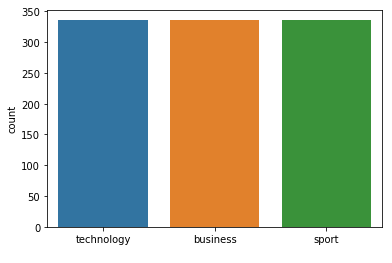



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 277
Class Distribution --> Train data (Fold 2 ):


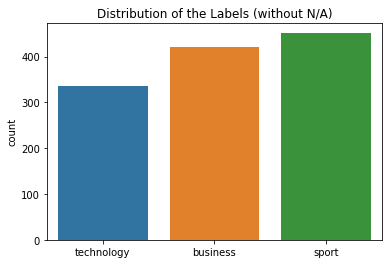

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


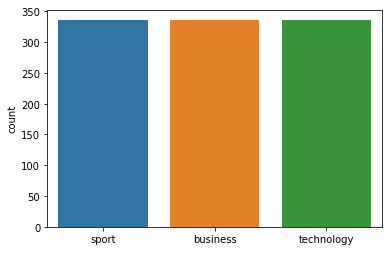



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 277
Class Distribution --> Train data (Fold 3 ):


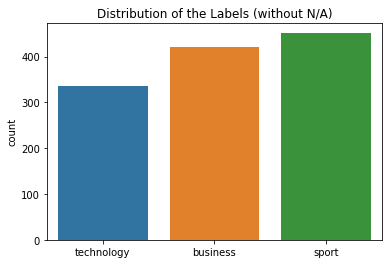

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


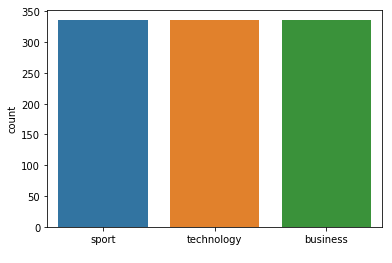



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 277
Class Distribution --> Train data (Fold 4 ):


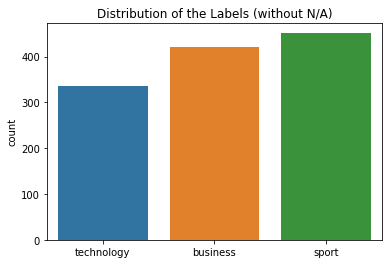

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


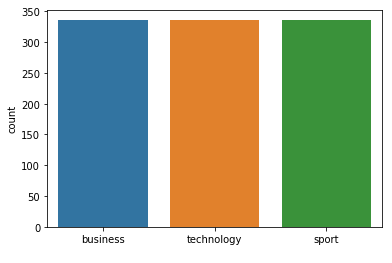



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 277
Class Distribution --> Train data (Fold 5 ):


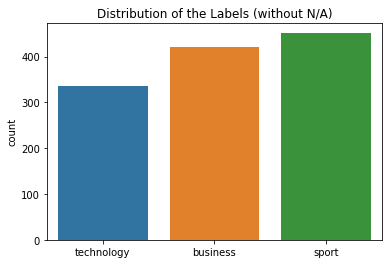

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


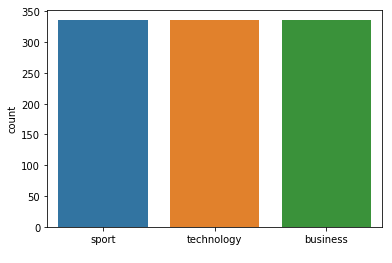



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 277
Class Distribution --> Train data (Fold 6 ):


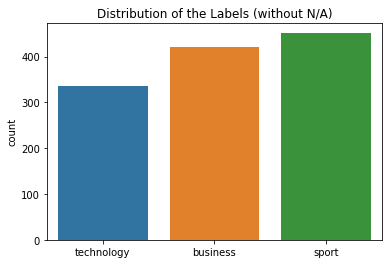

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


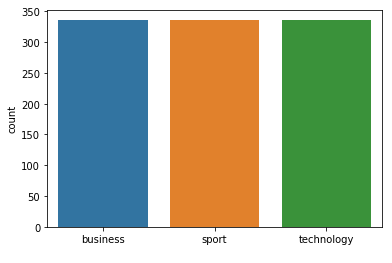



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 277
Class Distribution --> Train data (Fold 7 ):


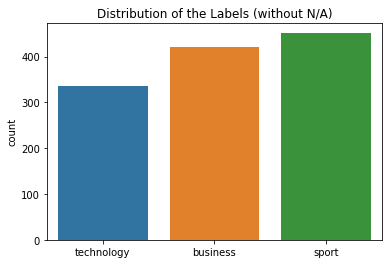

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


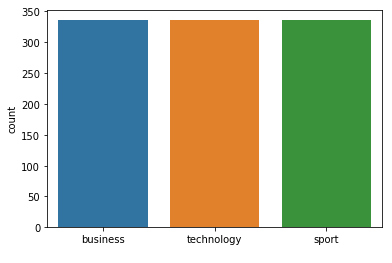



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.97      0.97        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 277  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 279
Class Distribution --> Train data (Fold 1 ):


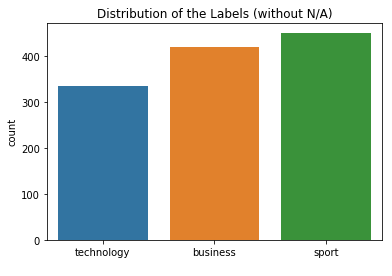

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


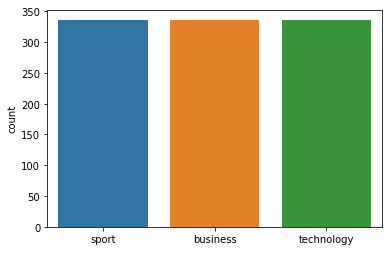



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 279
Class Distribution --> Train data (Fold 2 ):


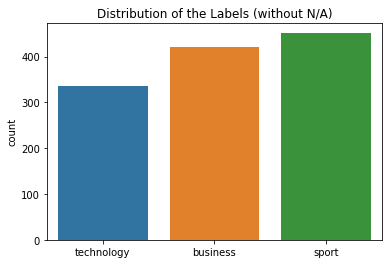

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


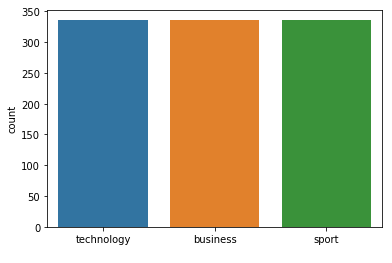



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.95      0.99      0.97        70
     sport
       0.97      0.96      0.97        75
technology
       0.98      0.95      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 2 ):
[[69  0  1]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 279
Class Distribution --> Train data (Fold 3 ):


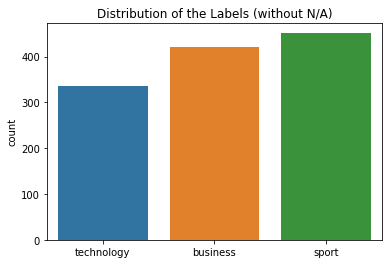

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


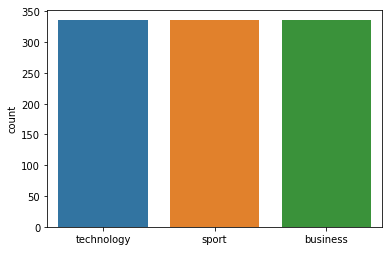



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 279
Class Distribution --> Train data (Fold 4 ):


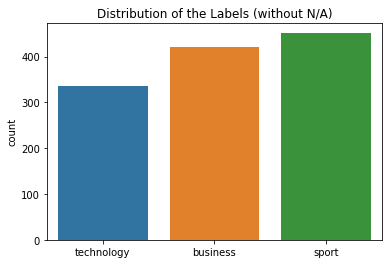

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


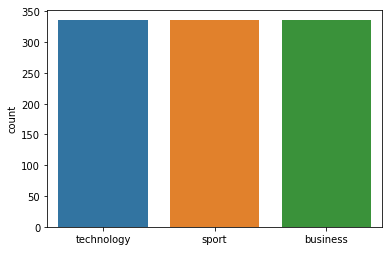



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 279
Class Distribution --> Train data (Fold 5 ):


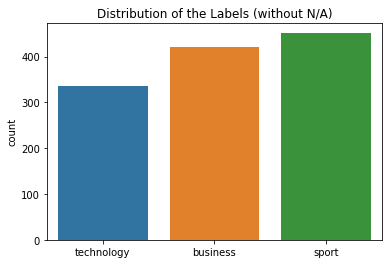

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


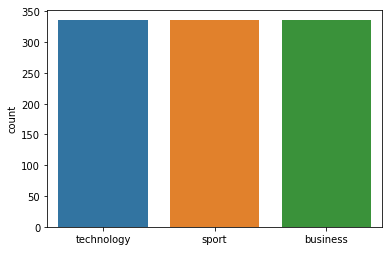



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 279
Class Distribution --> Train data (Fold 6 ):


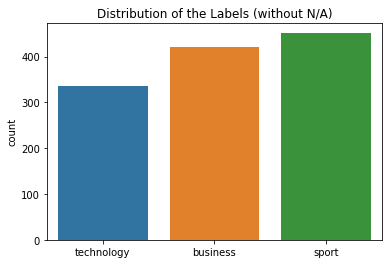

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


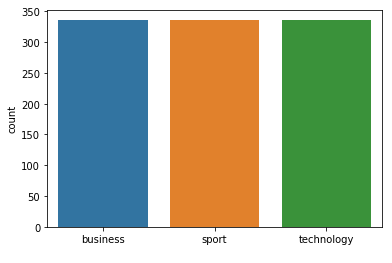



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.95      1.00      0.97        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  3 53]]
FOLD 7 Number of neighbors 279
Class Distribution --> Train data (Fold 7 ):


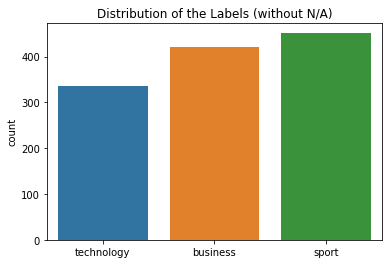

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


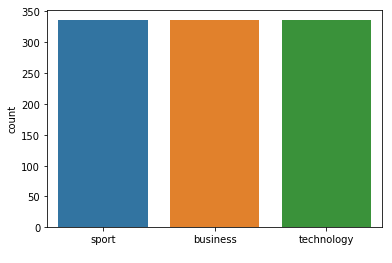



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 279  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 281
Class Distribution --> Train data (Fold 1 ):


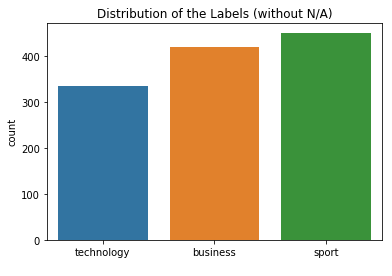

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


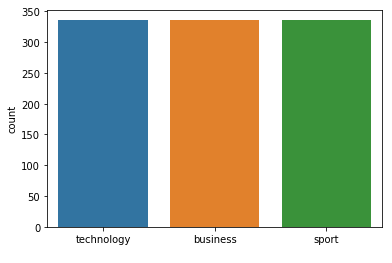



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.95      0.97      0.96        76
technology
       0.96      0.93      0.95        56

avg / total       0.96      0.96      0.96       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  4 52]]
FOLD 2 Number of neighbors 281
Class Distribution --> Train data (Fold 2 ):


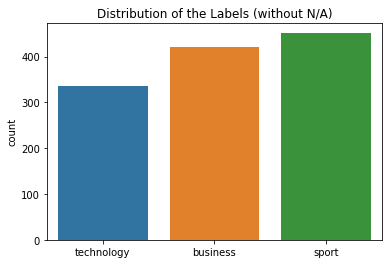

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


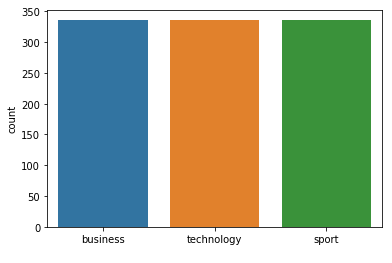



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 281
Class Distribution --> Train data (Fold 3 ):


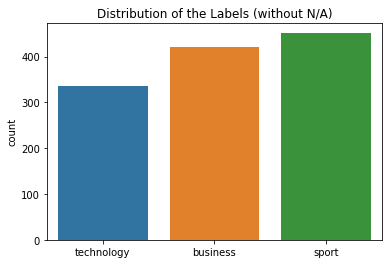

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


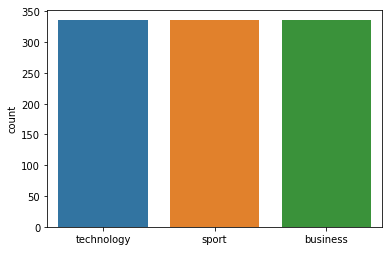



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 281
Class Distribution --> Train data (Fold 4 ):


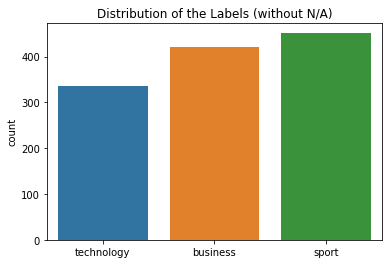

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


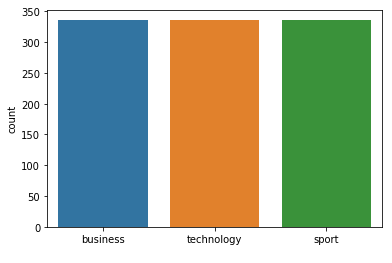



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 281
Class Distribution --> Train data (Fold 5 ):


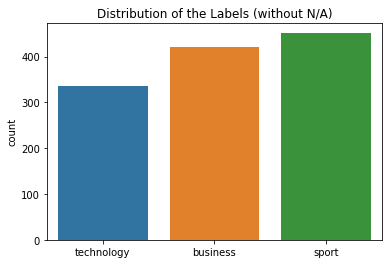

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


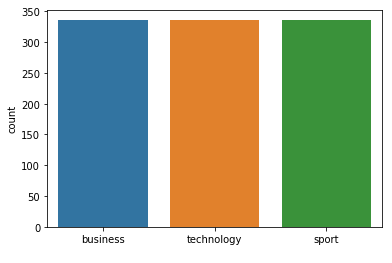



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 281
Class Distribution --> Train data (Fold 6 ):


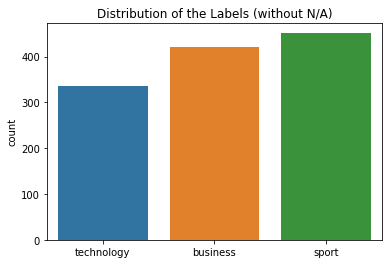

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


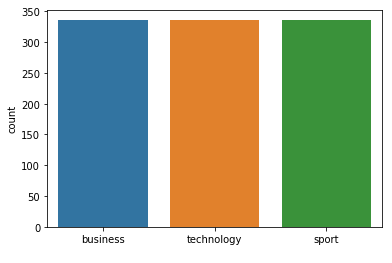



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  3 53]]
FOLD 7 Number of neighbors 281
Class Distribution --> Train data (Fold 7 ):


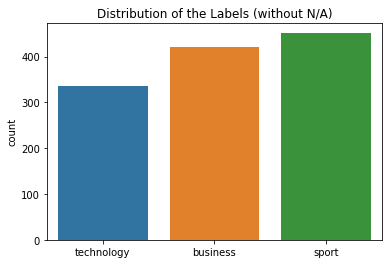

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


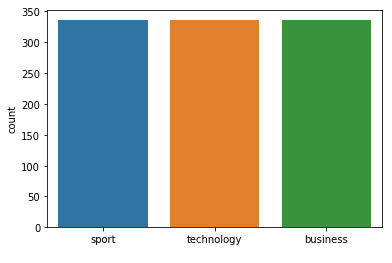



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 281  neighbours): 97.02% (+/- 1.00%)
FOLD 1 Number of neighbors 283
Class Distribution --> Train data (Fold 1 ):


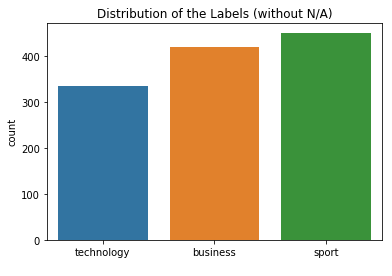

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


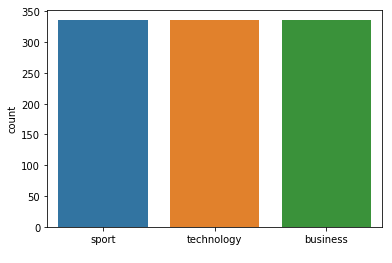



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.99      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 75  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 283
Class Distribution --> Train data (Fold 2 ):


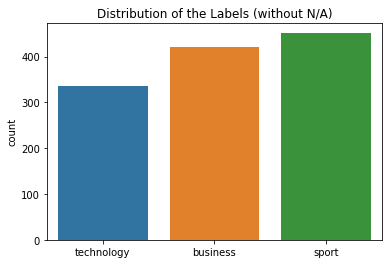

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


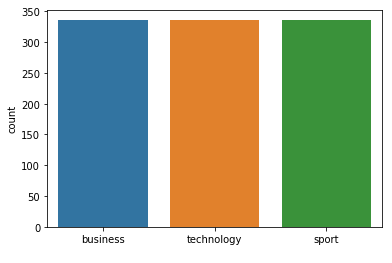



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 283
Class Distribution --> Train data (Fold 3 ):


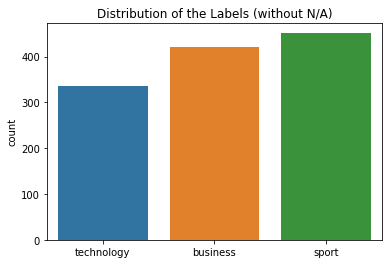

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


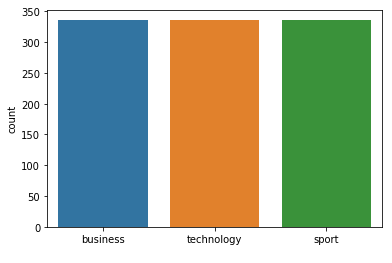



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.93      0.94        70
     sport
       0.96      0.99      0.97        75
technology
       0.93      0.93      0.93        56

avg / total       0.95      0.95      0.95       201

Confusion Matrix (Fold 3 ):
[[65  1  4]
 [ 1 74  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 283
Class Distribution --> Train data (Fold 4 ):


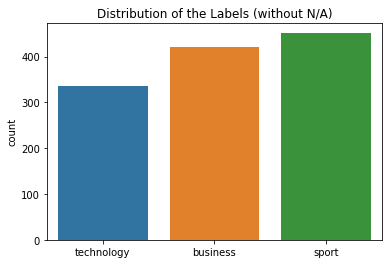

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


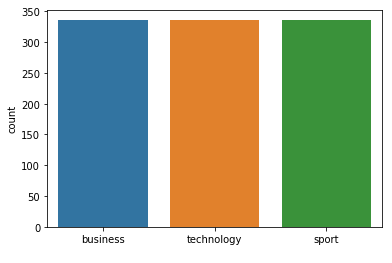



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 283
Class Distribution --> Train data (Fold 5 ):


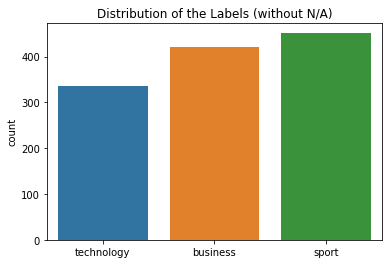

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


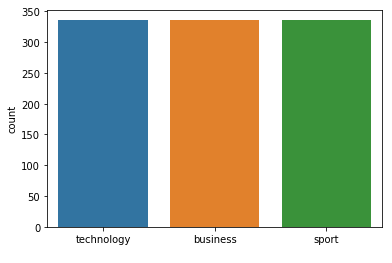



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 283
Class Distribution --> Train data (Fold 6 ):


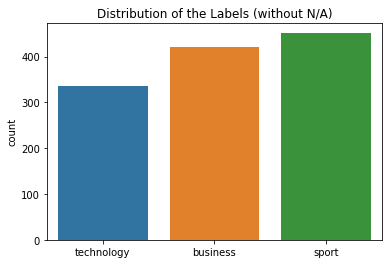

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


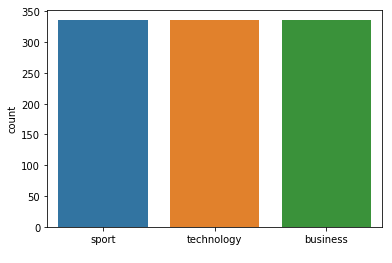



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.96      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 1  3 52]]
FOLD 7 Number of neighbors 283
Class Distribution --> Train data (Fold 7 ):


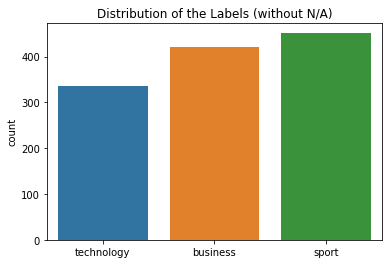

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


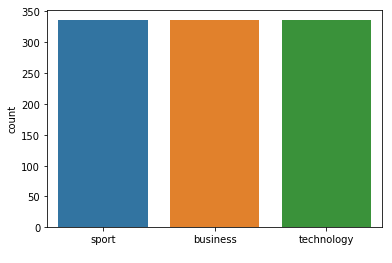



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.96      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 283  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 285
Class Distribution --> Train data (Fold 1 ):


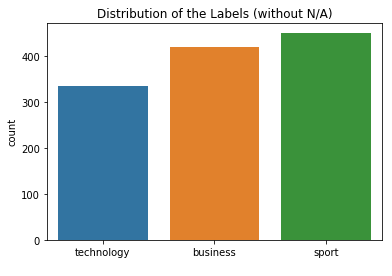

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


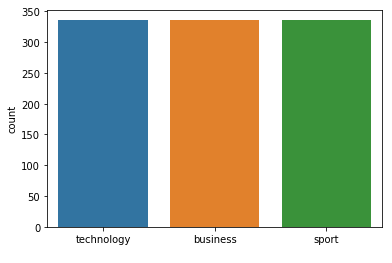



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 285
Class Distribution --> Train data (Fold 2 ):


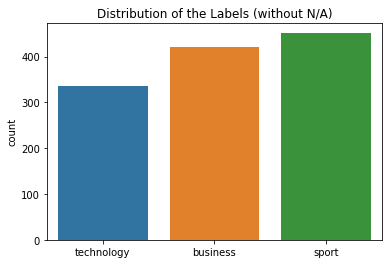

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


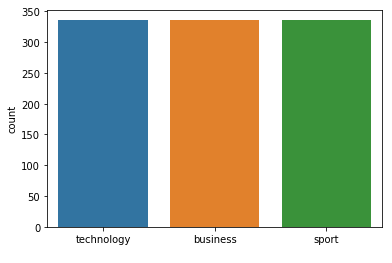



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 285
Class Distribution --> Train data (Fold 3 ):


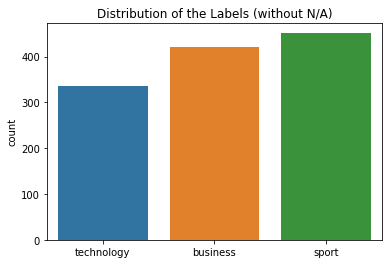

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


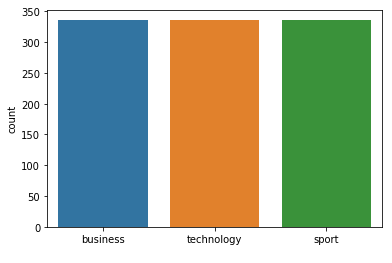



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.96      0.99      0.97        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 285
Class Distribution --> Train data (Fold 4 ):


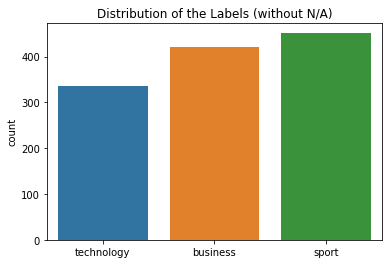

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


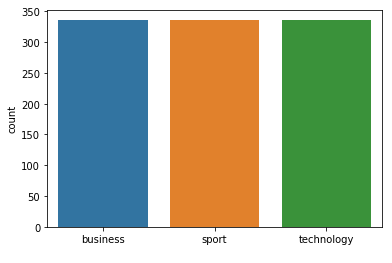



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       1.00      0.97      0.99        75
technology
       1.00      1.00      1.00        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 285
Class Distribution --> Train data (Fold 5 ):


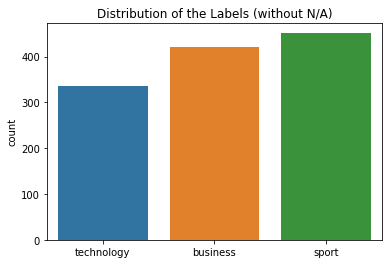

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


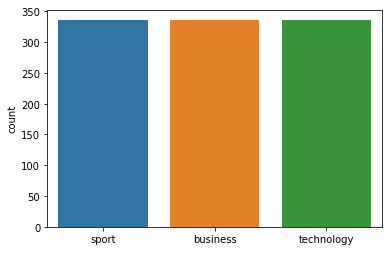



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       1.00      0.99      0.99        75
technology
       0.96      0.98      0.97        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 1  0 55]]
FOLD 6 Number of neighbors 285
Class Distribution --> Train data (Fold 6 ):


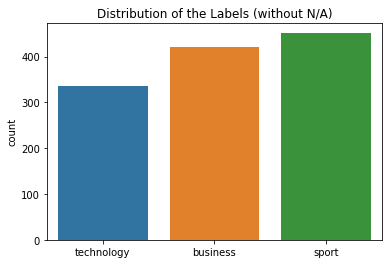

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


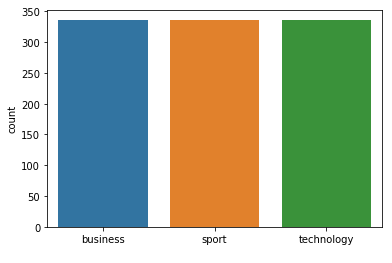



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 285
Class Distribution --> Train data (Fold 7 ):


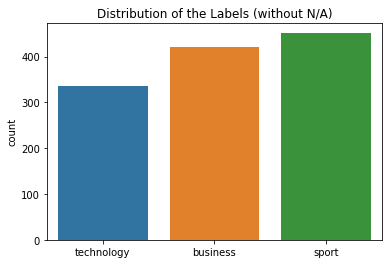

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


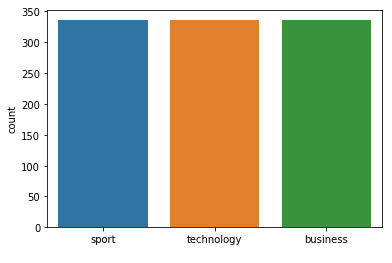



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.97      0.97        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 285  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 287
Class Distribution --> Train data (Fold 1 ):


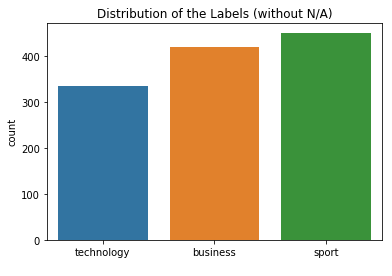

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


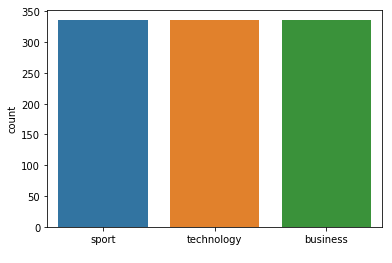



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        71
     sport
       0.96      0.99      0.97        76
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 0 75  1]
 [ 0  3 53]]
FOLD 2 Number of neighbors 287
Class Distribution --> Train data (Fold 2 ):


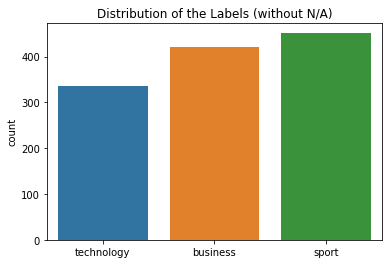

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


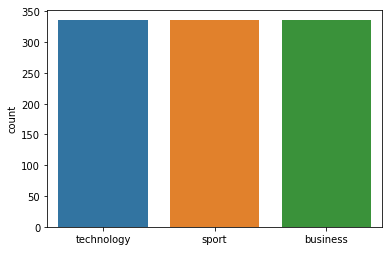



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 287
Class Distribution --> Train data (Fold 3 ):


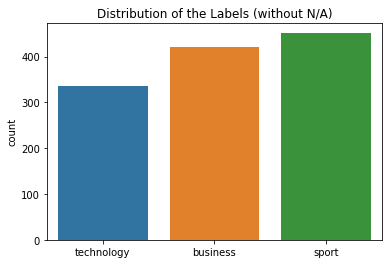

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


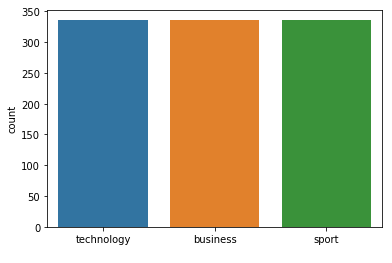



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.93      0.94        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 2  2 52]]
FOLD 4 Number of neighbors 287
Class Distribution --> Train data (Fold 4 ):


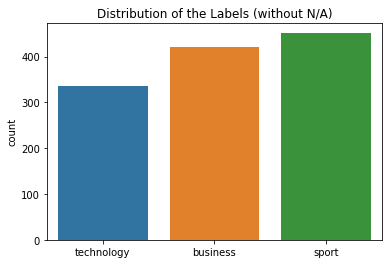

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


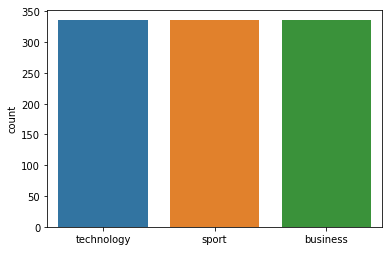



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 287
Class Distribution --> Train data (Fold 5 ):


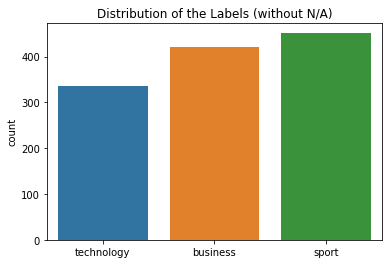

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


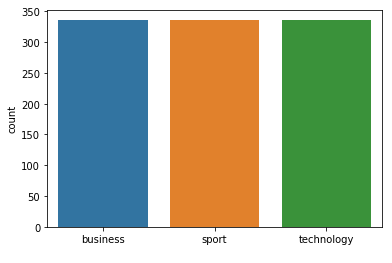



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 287
Class Distribution --> Train data (Fold 6 ):


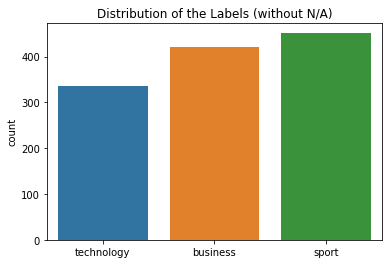

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


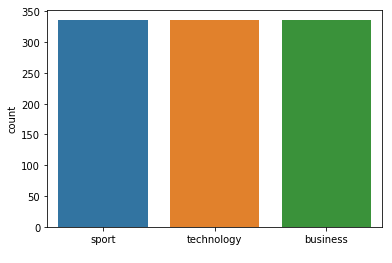



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.93      0.96        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.96      0.95        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[65  1  4]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 287
Class Distribution --> Train data (Fold 7 ):


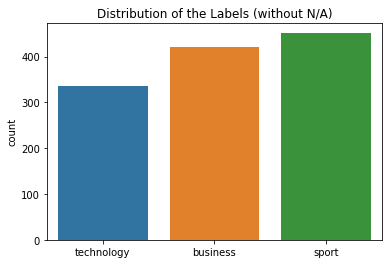

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


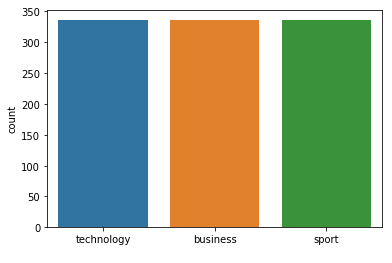



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 287  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 289
Class Distribution --> Train data (Fold 1 ):


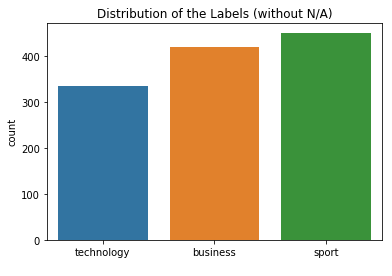

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


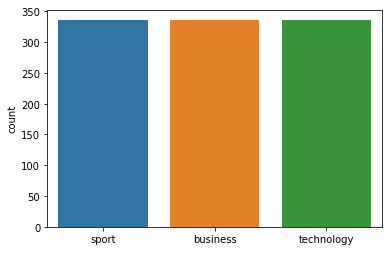



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 289
Class Distribution --> Train data (Fold 2 ):


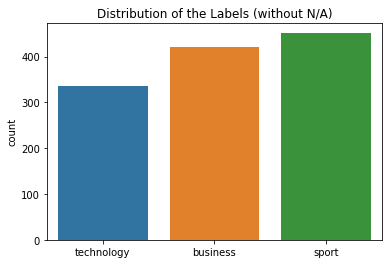

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


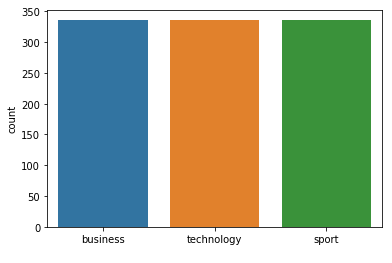



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 289
Class Distribution --> Train data (Fold 3 ):


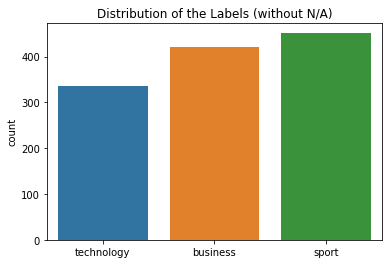

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


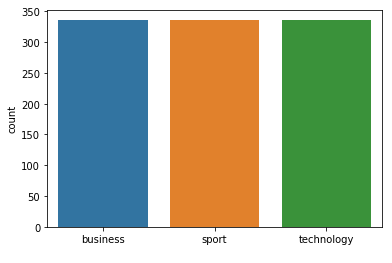



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 4 Number of neighbors 289
Class Distribution --> Train data (Fold 4 ):


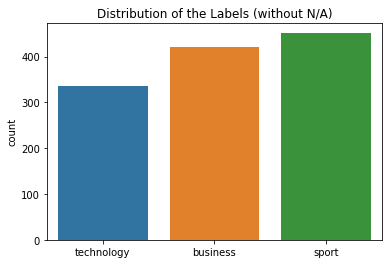

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


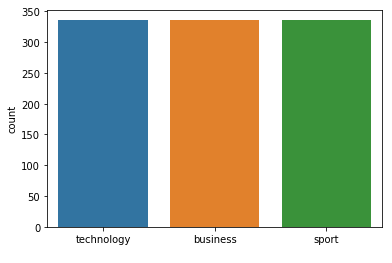



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 289
Class Distribution --> Train data (Fold 5 ):


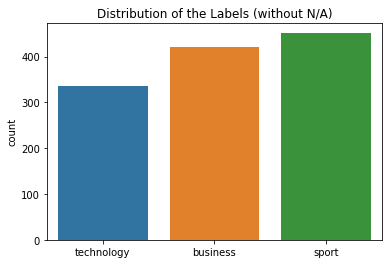

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


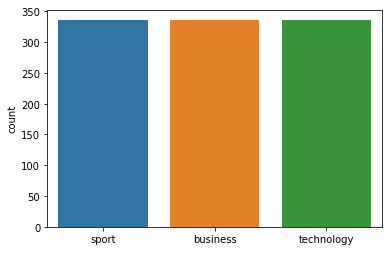



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 289
Class Distribution --> Train data (Fold 6 ):


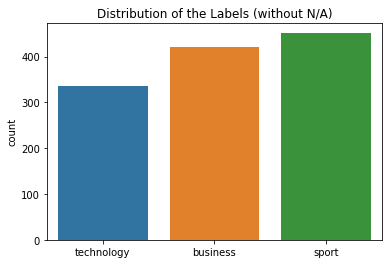

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


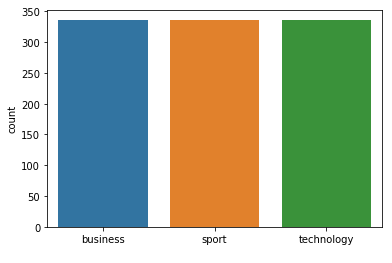



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  1  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 289
Class Distribution --> Train data (Fold 7 ):


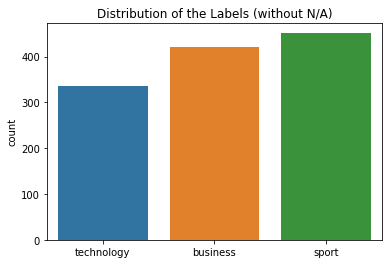

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


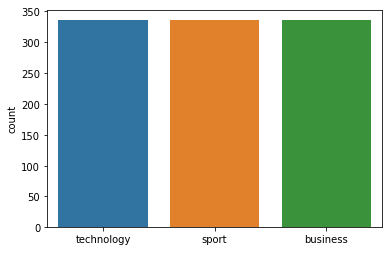



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.96      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[67  0  3]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 289  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 291
Class Distribution --> Train data (Fold 1 ):


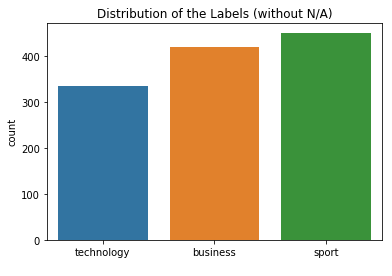

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


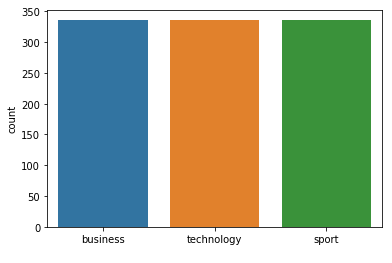



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        71
     sport
       0.96      0.97      0.97        76
technology
       0.95      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 1 74  1]
 [ 0  3 53]]
FOLD 2 Number of neighbors 291
Class Distribution --> Train data (Fold 2 ):


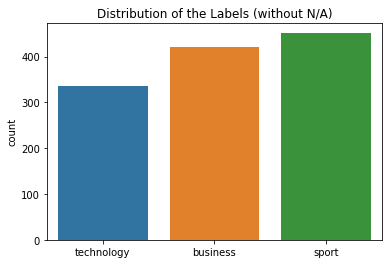

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


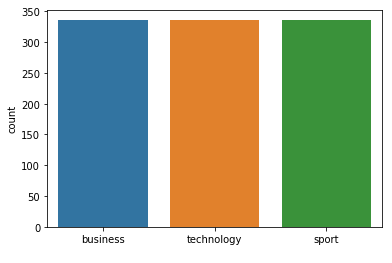



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 291
Class Distribution --> Train data (Fold 3 ):


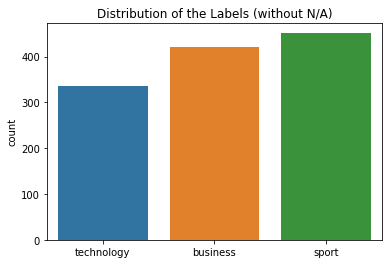

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


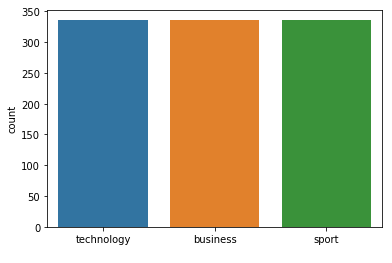



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 291
Class Distribution --> Train data (Fold 4 ):


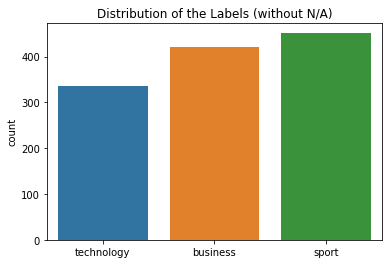

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


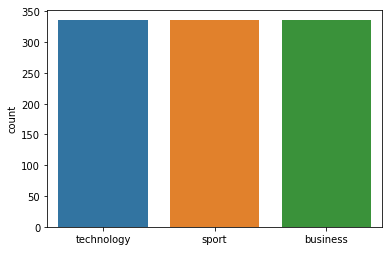



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.98      0.98      0.98        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 4 ):
[[69  0  1]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 291
Class Distribution --> Train data (Fold 5 ):


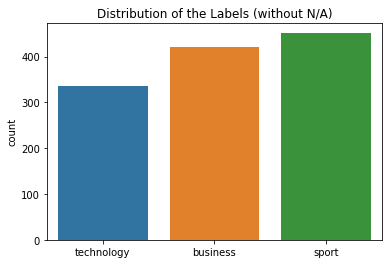

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


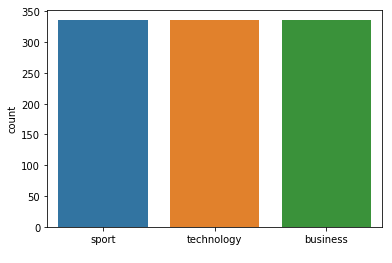



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 291
Class Distribution --> Train data (Fold 6 ):


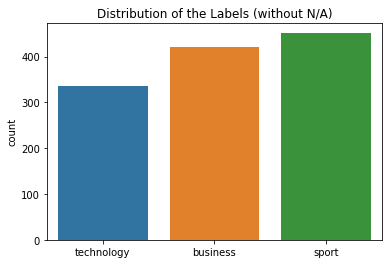

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


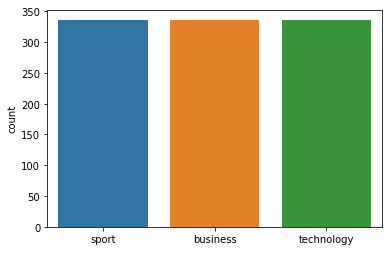



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.93      0.95      0.94        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  0  4]
 [ 0 75  0]
 [ 1  2 53]]
FOLD 7 Number of neighbors 291
Class Distribution --> Train data (Fold 7 ):


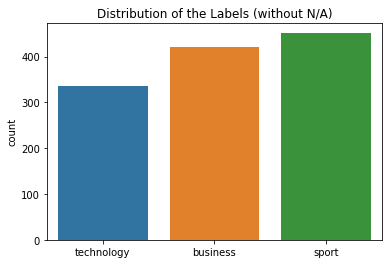

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


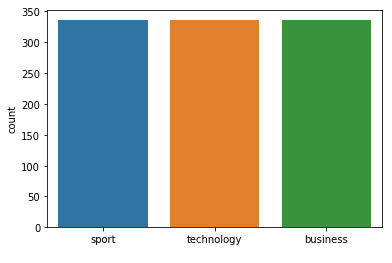



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 1 74  0]
 [ 1  2 52]]


 Model accuracy (for 291  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 293
Class Distribution --> Train data (Fold 1 ):


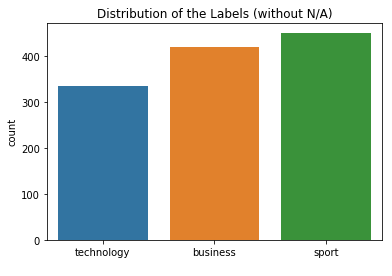

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


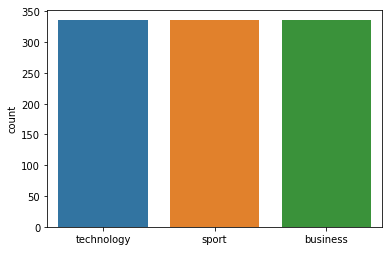



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 293
Class Distribution --> Train data (Fold 2 ):


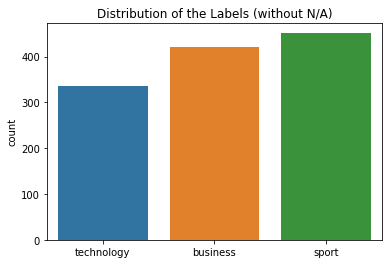

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


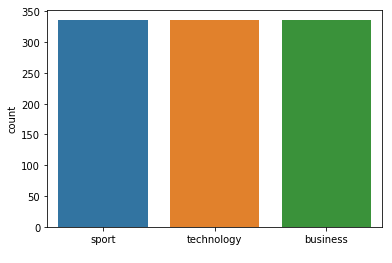



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 293
Class Distribution --> Train data (Fold 3 ):


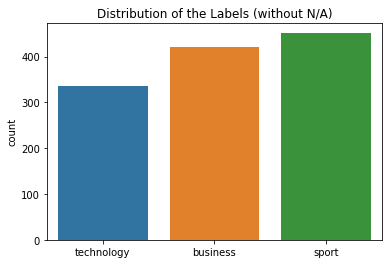

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


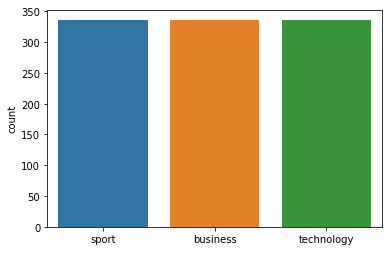



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 293
Class Distribution --> Train data (Fold 4 ):


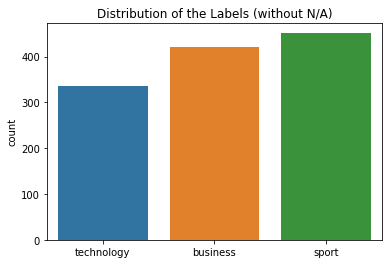

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


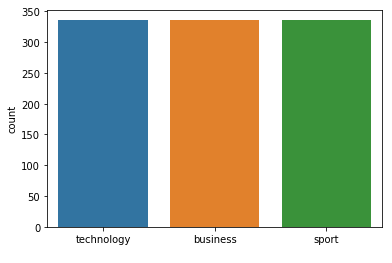



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       0.99      0.97      0.98        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 293
Class Distribution --> Train data (Fold 5 ):


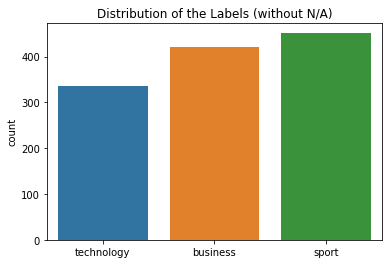

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


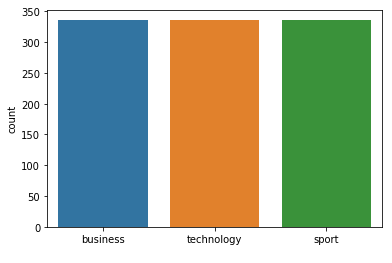



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 293
Class Distribution --> Train data (Fold 6 ):


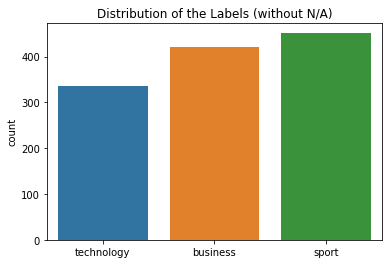

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


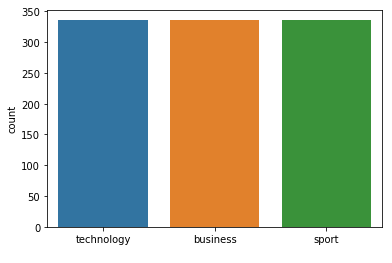



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 293
Class Distribution --> Train data (Fold 7 ):


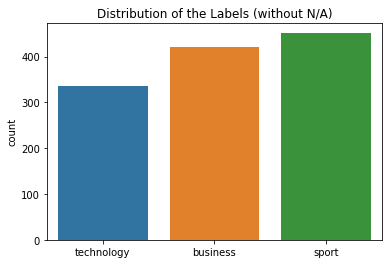

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


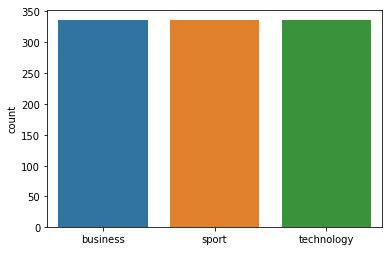



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.97      0.97        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 293  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 295
Class Distribution --> Train data (Fold 1 ):


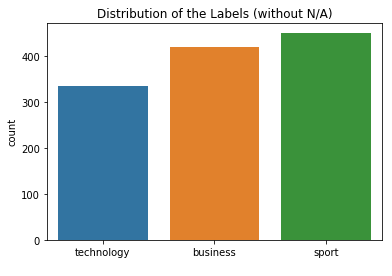

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


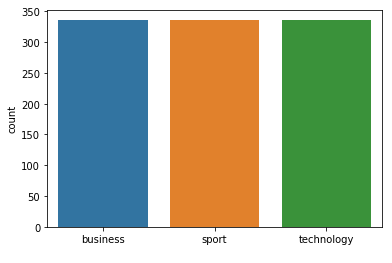



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.96      0.97      0.97        76
technology
       0.96      0.95      0.95        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  3 53]]
FOLD 2 Number of neighbors 295
Class Distribution --> Train data (Fold 2 ):


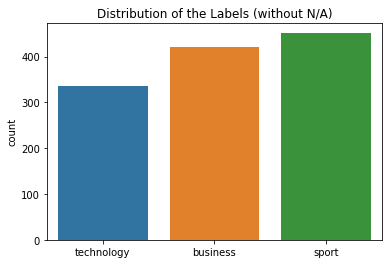

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


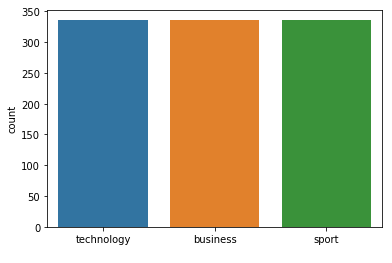



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 295
Class Distribution --> Train data (Fold 3 ):


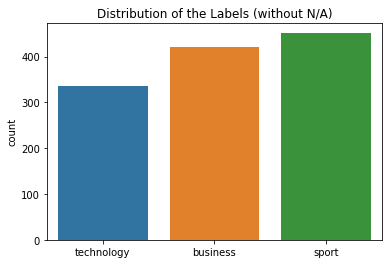

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


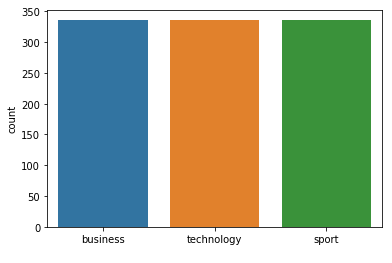



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.99      0.94      0.96        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 4 Number of neighbors 295
Class Distribution --> Train data (Fold 4 ):


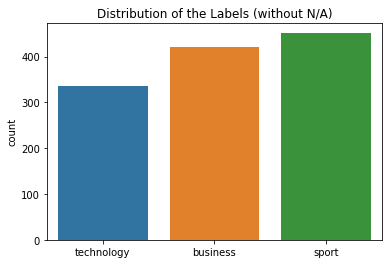

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


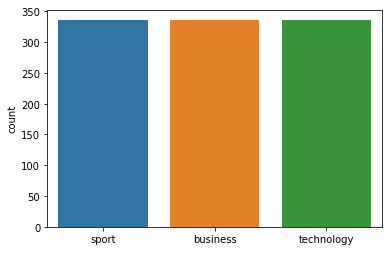



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       0.99      0.99      0.99        75
technology
       1.00      0.98      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  1 55]]
FOLD 5 Number of neighbors 295
Class Distribution --> Train data (Fold 5 ):


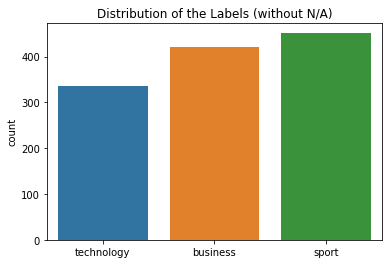

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


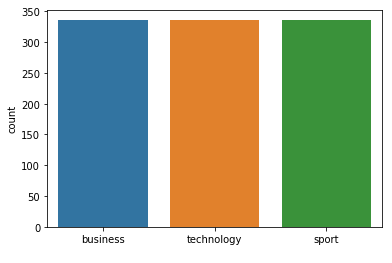



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 295
Class Distribution --> Train data (Fold 6 ):


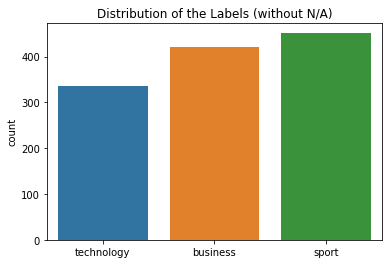

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


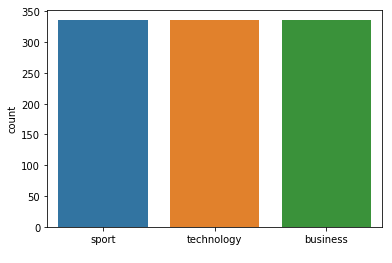



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 295
Class Distribution --> Train data (Fold 7 ):


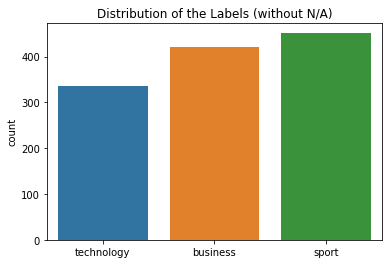

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


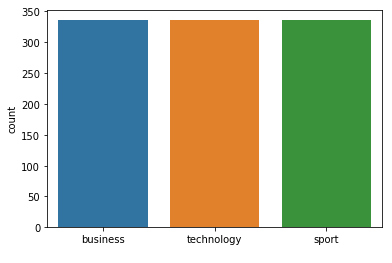



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.97      0.97        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 295  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 297
Class Distribution --> Train data (Fold 1 ):


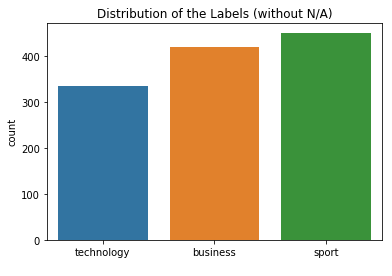

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


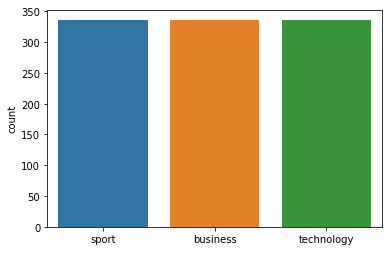



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 297
Class Distribution --> Train data (Fold 2 ):


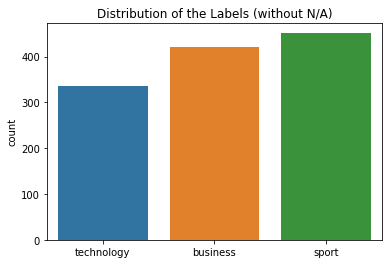

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


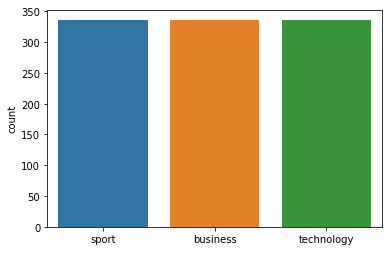



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 297
Class Distribution --> Train data (Fold 3 ):


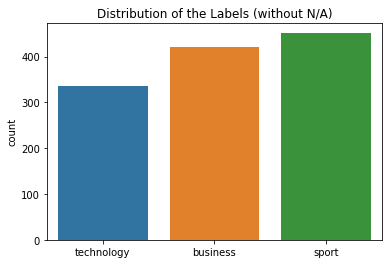

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


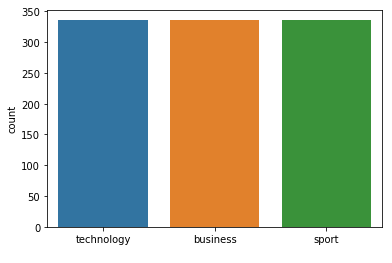



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 297
Class Distribution --> Train data (Fold 4 ):


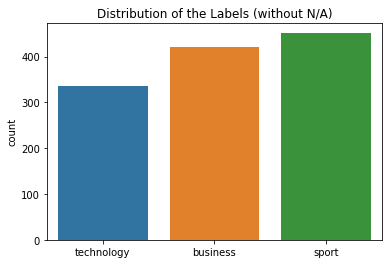

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


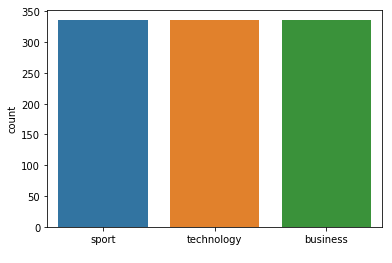



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.99      1.00      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       1.00      1.00      1.00        56

avg / total       1.00      1.00      1.00       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 297
Class Distribution --> Train data (Fold 5 ):


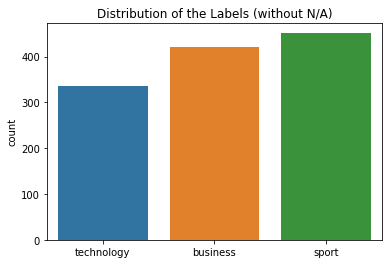

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


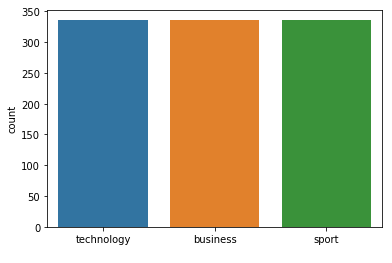



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 297
Class Distribution --> Train data (Fold 6 ):


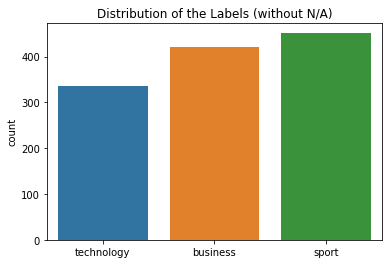

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


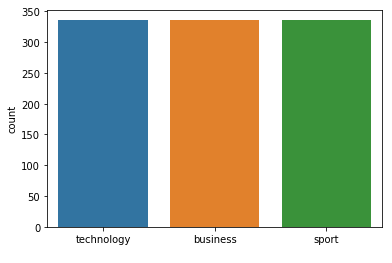



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.97      1.00      0.99        75
technology
       0.95      0.96      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[67  0  3]
 [ 0 75  0]
 [ 0  2 54]]
FOLD 7 Number of neighbors 297
Class Distribution --> Train data (Fold 7 ):


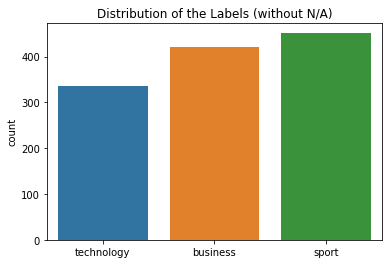

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


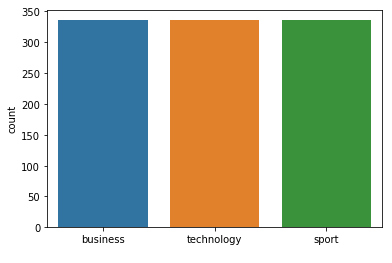



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.94      0.96        70
     sport
       0.97      0.97      0.97        75
technology
       0.93      0.96      0.95        55

avg / total       0.96      0.96      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 2 73  0]
 [ 0  2 53]]


 Model accuracy (for 297  neighbours): 97.02% (+/- 1.01%)
FOLD 1 Number of neighbors 299
Class Distribution --> Train data (Fold 1 ):


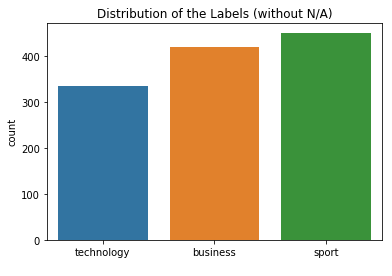

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


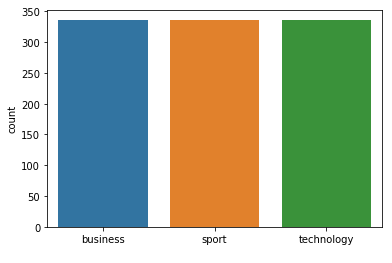



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        71
     sport
       0.97      0.97      0.97        76
technology
       0.96      0.96      0.96        56

avg / total       0.97      0.97      0.97       203

Confusion Matrix (Fold 1 ):
[[69  0  2]
 [ 2 74  0]
 [ 0  2 54]]
FOLD 2 Number of neighbors 299
Class Distribution --> Train data (Fold 2 ):


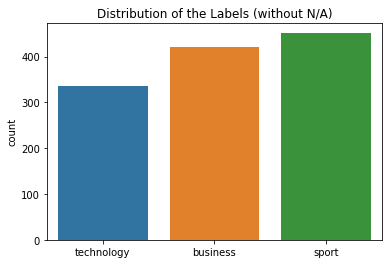

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


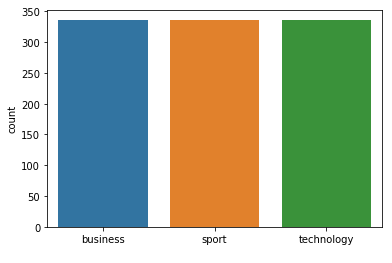



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.94      0.97      0.96        70
     sport
       0.97      0.96      0.97        75
technology
       0.96      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 3 72  0]
 [ 1  2 53]]
FOLD 3 Number of neighbors 299
Class Distribution --> Train data (Fold 3 ):


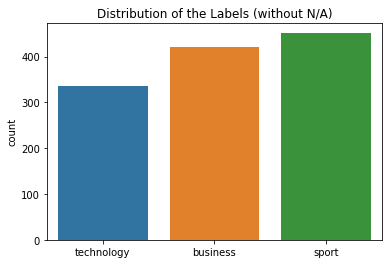

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


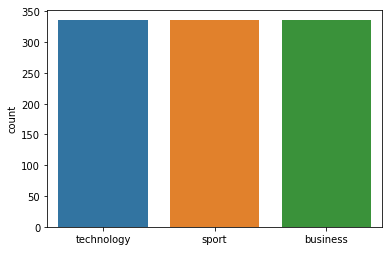



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.99      0.98        75
technology
       0.95      0.95      0.95        56

avg / total       0.96      0.96      0.96       201

Confusion Matrix (Fold 3 ):
[[66  1  3]
 [ 1 74  0]
 [ 2  1 53]]
FOLD 4 Number of neighbors 299
Class Distribution --> Train data (Fold 4 ):


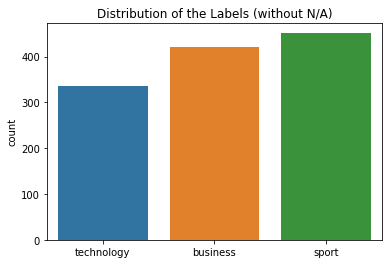

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


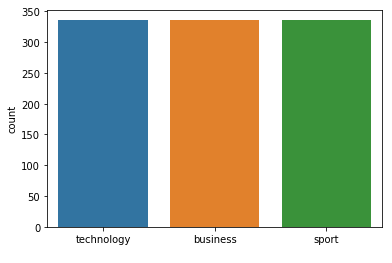



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       1.00      0.97      0.99        75
technology
       1.00      1.00      1.00        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5 Number of neighbors 299
Class Distribution --> Train data (Fold 5 ):


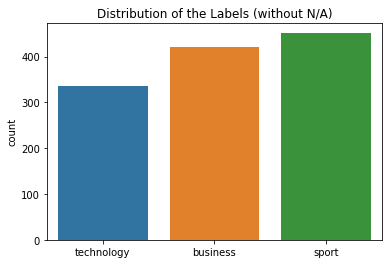

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


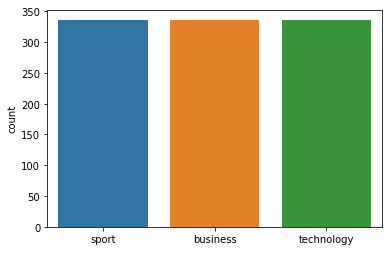



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       1.00      0.99      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6 Number of neighbors 299
Class Distribution --> Train data (Fold 6 ):


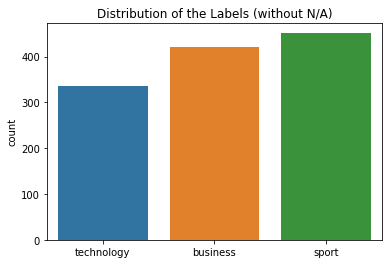

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


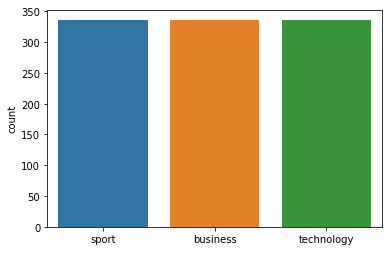



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       1.00      0.94      0.97        70
     sport
       0.96      1.00      0.98        75
technology
       0.93      0.95      0.94        56

avg / total       0.97      0.97      0.97       201

Confusion Matrix (Fold 6 ):
[[66  0  4]
 [ 0 75  0]
 [ 0  3 53]]
FOLD 7 Number of neighbors 299
Class Distribution --> Train data (Fold 7 ):


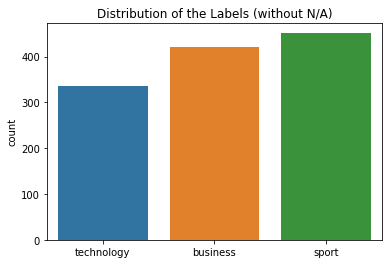

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


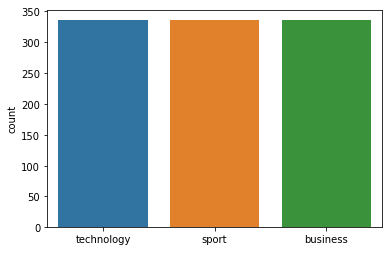



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.94      0.95        70
     sport
       0.97      0.97      0.97        75
technology
       0.93      0.95      0.94        55

avg / total       0.96      0.95      0.96       200

Confusion Matrix (Fold 7 ):
[[66  0  4]
 [ 2 73  0]
 [ 1  2 52]]


 Model accuracy (for 299  neighbours): 97.02% (+/- 1.01%)


In [381]:
cvscores_ngram = []
k_model_accuracy_ngram=[]

kfold = StratifiedKFold(n_splits=7, shuffle=True, random_state=seed)

for k in neighbors:
    fold=0
    model = KNeighborsClassifier(n_neighbors=k, metric='cosine')
    for train, test in kfold.split(X_term_weighting_ngram, class_labels):
        fold+=1
        print('FOLD',fold, 'Number of neighbors', k)
        labels_train=[]
        for i in range(len(train)):
            labels_train.append(class_labels[train[i]])
        labels_test=[]
        for i in range(len(test)):
            labels_test.append(class_labels[test[i]])

        # Plot a bar plot of the labels: class distribution is adjusted
        #seaborn.countplot - Show value counts for a single categorical variable:
        print('Class Distribution --> Train data (Fold',fold,'):')
        ax = sns.countplot(labels_train)
        ax.set_title("Distribution of the Labels (without N/A)")
        plt.show()

        # Apply the random under-sampling
        #Oversampling and undersampling in data analysis are techniques used to adjust the class distribution of a data set 
        #(i.e. the ratio between the different classes/categories represented).
        rus = RandomUnderSampler(return_indices=True)
        train_rus, train_labels_rus, idx_resampled = rus.fit_sample(X_term_weighting_ngram[train], labels_train)
        train_rus, train_labels_rus = shuffle(train_rus, train_labels_rus)

        # Plot a bar plot of the labels
        #seaborn.countplot - Show value counts for a single categorical variable:
        print('Class Distribution after performing under-sampling --> Train data (Fold',fold,'):')
        ax = sns.countplot(train_labels_rus)
        sns.countplot(train_labels_rus) #--> class distribution is adjusted
        plt.show()

        # Fit/Train the model
        model.fit(train_rus, train_labels_rus)

        #Evaluate the Model; Use the test dataset to evaluate the model
        print('\n\n ****** Test Data ******** (Fold',fold,'):')
        predicted = model.predict(X_term_weighting_ngram[test])

        # Print performance details
        print(metrics.classification_report(labels_test, predicted))

        # Print confusion matrix
        print('Confusion Matrix (Fold',fold,'):')
        print(metrics.confusion_matrix(labels_test, predicted))

        cvscores_ngram.append(accuracy_score(labels_test, predicted) * 100)
    print("\n\n Model accuracy (for",k," neighbours): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_ngram), numpy.std(cvscores_ngram)))
    k_model_accuracy_ngram.append(numpy.mean(cvscores_ngram))

The highest model accuracy 97.03437253145505 is achieved by using optimal number of neighbors 237


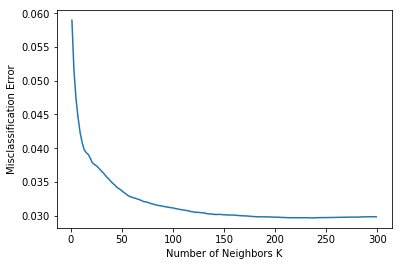

In [382]:
# changing to misclassification error
MSE_ngram = [1-x/100 for x in k_model_accuracy_ngram]
index_ngram=MSE_ngram.index(min(MSE_ngram))
optimal_k_ngram = neighbors[index_ngram]
print ("The highest model accuracy",k_model_accuracy_ngram[index_ngram],"is achieved by using optimal number of neighbors %d" % optimal_k_ngram)
# plot misclassification error vs k
plt.plot(neighbors, MSE_ngram)
plt.xlabel('Number of Neighbors K')
plt.ylabel('Misclassification Error')
plt.show()

From the **misclassification error vs number of neighbours k** graphs we can see that for all cases error decreases till around k=200 and then error plateau. At one point, for k above certain point, cross validation errors begin to go up again. The bigger the k the more smoothing takes place and it reduces over -fitting.

In [383]:
print ("\nNot balanced, without ngrams (n>1):\n The highest model accuracy",k_model_accuracy_not_bal[index_not_bal],"is achieved by using optimal number of neighbors %d" % optimal_k_not_bal)
print ("\nNot balanced, with ngrams (ngrams=(1,3)):\nThe highest model accuracy",k_model_accuracy_ngram_not_bal[index_ngram_not_bal],"is achieved by using optimal number of neighbors %d" % optimal_k_ngram_not_bal)
print ("\nBalanced, without ngrams (n>1):\nThe highest model accuracy",k_model_accuracy[index],"is achieved by using optimal number of neighbors %d" % optimal_k)
print ("\nNBalanced, with ngrams (ngrams=(1,3)):\nThe highest model accuracy",k_model_accuracy_ngram[index_ngram],"is achieved by using optimal number of neighbors %d" % optimal_k_ngram)


Not balanced, without ngrams (n>1):
 The highest model accuracy 96.82067537908272 is achieved by using optimal number of neighbors 97

Not balanced, with ngrams (ngrams=(1,3)):
The highest model accuracy 96.80225321345199 is achieved by using optimal number of neighbors 125

Balanced, without ngrams (n>1):
The highest model accuracy 97.0565916786394 is achieved by using optimal number of neighbors 205

NBalanced, with ngrams (ngrams=(1,3)):
The highest model accuracy 97.03437253145505 is achieved by using optimal number of neighbors 237


Hence, **the best kNN model** is one that uses balanced data/labels in cobination with earlier mentioned preprocessing steps, without ngrams (only tokens containing one word)

# Support Vector Machines
Often apply SVMs with a linear kernel to calculate document similarity.

In [366]:
cvscores_SVM_not_bal = []

kfold = StratifiedKFold(n_splits=7, shuffle=True, random_state=seed)
fold=0

model = svm.SVC(kernel='linear', C=1)

for train, test in kfold.split(X_term_weighting, class_labels):
    fold+=1
    print('FOLD',fold)
    labels_train=[]
    for i in range(len(train)):
        labels_train.append(class_labels[train[i]])
    labels_test=[]
    for i in range(len(test)):
        labels_test.append(class_labels[test[i]])
    
    # Fit/Train the model
    model.fit(X_term_weighting[train], labels_train)

    #Evaluate the Model; Use the test dataset to evaluate the model
    print('\n\n ****** Test Data ******** (Fold',fold,'):')
    predicted = model.predict(X_term_weighting[test])

    # Print performance details
    print(metrics.classification_report(labels_test, predicted))

    # Print confusion matrix
    print('Confusion Matrix (Fold',fold,'):')
    print(metrics.confusion_matrix(labels_test, predicted))

    cvscores_SVM_not_bal.append(accuracy_score(labels_test, predicted) * 100)
print("\n\n Model accuracy (over all",fold," folds): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_SVM_not_bal), numpy.std(cvscores_SVM_not_bal)))

FOLD 1


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       1.00      1.00      1.00        76
technology
       0.98      1.00      0.99        56

avg / total       1.00      1.00      1.00       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        70
     sport
       0.99      1.00      0.99        75
technology
       0.98      1.00 

In [367]:
cvscores_SVM_ngram_not_bal = []

kfold = StratifiedKFold(n_splits=7, shuffle=True, random_state=seed)
fold=0

model = svm.SVC(kernel='linear', C=1)

for train, test in kfold.split(X_term_weighting_ngram, class_labels):
    fold+=1
    print('FOLD',fold)
    labels_train=[]
    for i in range(len(train)):
        labels_train.append(class_labels[train[i]])
    labels_test=[]
    for i in range(len(test)):
        labels_test.append(class_labels[test[i]])
   
    # Fit/Train the model
    model.fit(X_term_weighting_ngram[train], labels_train)

    #Evaluate the Model; Use the test dataset to evaluate the model
    print('\n\n ****** Test Data ******** (Fold',fold,'):')
    predicted = model.predict(X_term_weighting_ngram[test])

    # Print performance details
    print(metrics.classification_report(labels_test, predicted))

    # Print confusion matrix
    print('Confusion Matrix (Fold',fold,'):')
    print(metrics.confusion_matrix(labels_test, predicted))

    cvscores_SVM_ngram_not_bal.append(accuracy_score(labels_test, predicted) * 100)
print("\n\n Model accuracy (over all",fold," folds): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_SVM_ngram_not_bal), numpy.std(cvscores_SVM_ngram_not_bal)))

FOLD 1


 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       1.00      1.00      1.00        76
technology
       0.98      1.00      0.99        56

avg / total       1.00      1.00      1.00       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2


 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3


 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        70
     sport
       0.99      1.00      0.99        75
technology
       0.98      1.00 

FOLD 1
Class Distribution --> Train data (Fold 1 ):


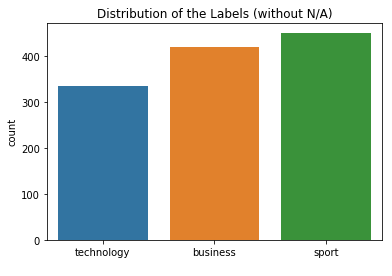

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


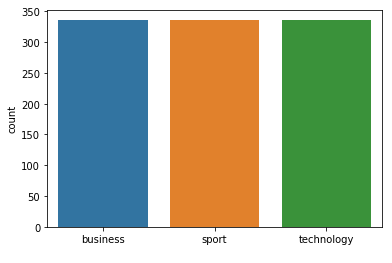



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       1.00      1.00      1.00        76
technology
       0.98      1.00      0.99        56

avg / total       1.00      1.00      1.00       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2
Class Distribution --> Train data (Fold 2 ):


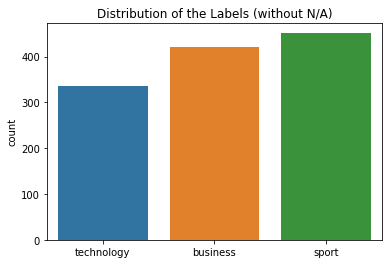

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


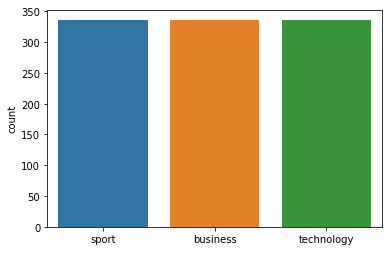



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3
Class Distribution --> Train data (Fold 3 ):


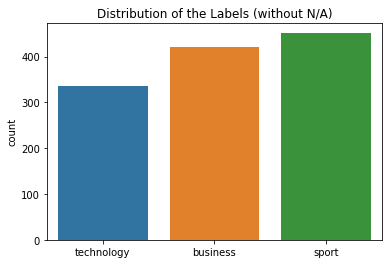

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


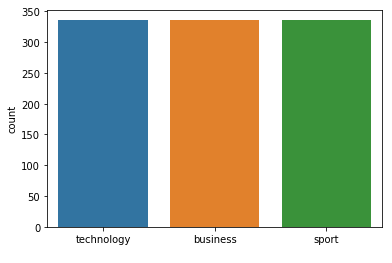



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.99      1.00      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 4
Class Distribution --> Train data (Fold 4 ):


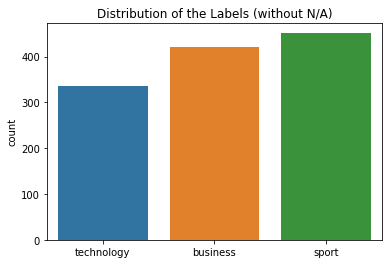

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


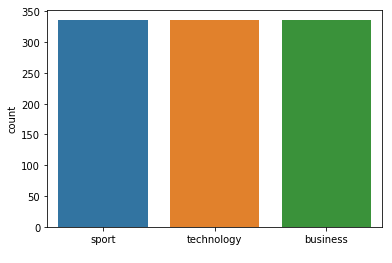



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       1.00      0.97      0.99        75
technology
       1.00      1.00      1.00        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5
Class Distribution --> Train data (Fold 5 ):


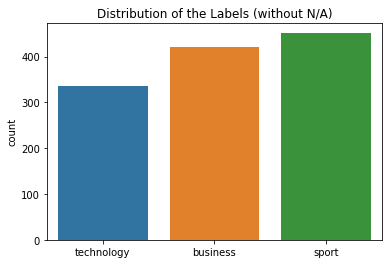

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


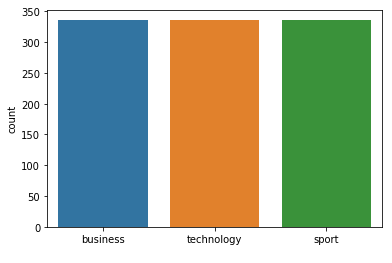



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       1.00      0.97      0.99        70
     sport
       1.00      1.00      1.00        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[68  0  2]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 6
Class Distribution --> Train data (Fold 6 ):


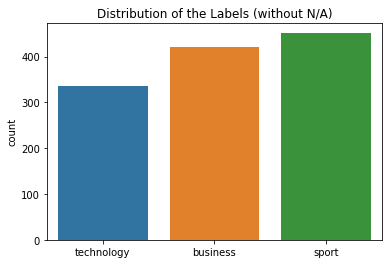

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


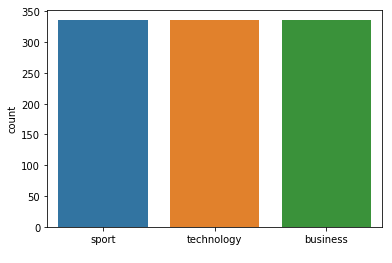



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       0.99      1.00      0.99        75
technology
       0.98      0.96      0.97        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 6 ):
[[69  0  1]
 [ 0 75  0]
 [ 1  1 54]]
FOLD 7
Class Distribution --> Train data (Fold 7 ):


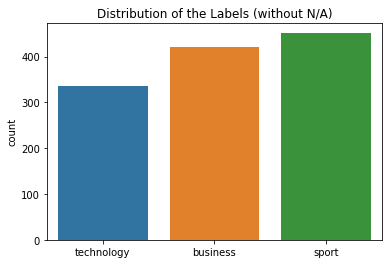

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


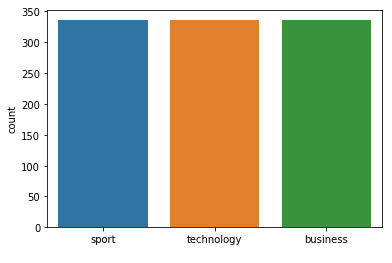



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.97      0.97      0.97        70
     sport
       0.97      0.99      0.98        75
technology
       0.98      0.96      0.97        55

avg / total       0.98      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[68  1  1]
 [ 1 74  0]
 [ 1  1 53]]


 Model accuracy (over all 7  folds): 98.51% (+/- 0.71%)


In [372]:
cvscores_SVM = []

kfold = StratifiedKFold(n_splits=7, shuffle=True, random_state=seed)

fold=0

model = svm.SVC(kernel='linear', C=1)

for train, test in kfold.split(X_term_weighting, class_labels):
    fold+=1
    print('FOLD',fold)
    labels_train=[]
    for i in range(len(train)):
        labels_train.append(class_labels[train[i]])
    labels_test=[]
    for i in range(len(test)):
        labels_test.append(class_labels[test[i]])

    # Plot a bar plot of the labels: class distribution is adjusted
    #seaborn.countplot - Show value counts for a single categorical variable:
    print('Class Distribution --> Train data (Fold',fold,'):')
    ax = sns.countplot(labels_train)
    ax.set_title("Distribution of the Labels (without N/A)")
    plt.show()

    # Apply the random under-sampling
    #Oversampling and undersampling in data analysis are techniques used to adjust the class distribution of a data set 
    #(i.e. the ratio between the different classes/categories represented).
    rus = RandomUnderSampler(return_indices=True)
    train_rus, train_labels_rus, idx_resampled = rus.fit_sample(X_term_weighting[train], labels_train)
    train_rus, train_labels_rus = shuffle(train_rus, train_labels_rus)

    # Plot a bar plot of the labels
    #seaborn.countplot - Show value counts for a single categorical variable:
    print('Class Distribution after performing under-sampling --> Train data (Fold',fold,'):')
    ax = sns.countplot(train_labels_rus)
    sns.countplot(train_labels_rus) #--> class distribution is adjusted
    plt.show()

    # Fit/Train the model
    model.fit(train_rus, train_labels_rus)

    #Evaluate the Model; Use the test dataset to evaluate the model
    print('\n\n ****** Test Data ******** (Fold',fold,'):')
    predicted = model.predict(X_term_weighting[test])

    # Print performance details
    print(metrics.classification_report(labels_test, predicted))

    # Print confusion matrix
    print('Confusion Matrix (Fold',fold,'):')
    print(metrics.confusion_matrix(labels_test, predicted))

    cvscores_SVM.append(accuracy_score(labels_test, predicted) * 100)
print("\n\n Model accuracy (over all",fold," folds): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_SVM), numpy.std(cvscores_SVM)))

FOLD 1
Class Distribution --> Train data (Fold 1 ):


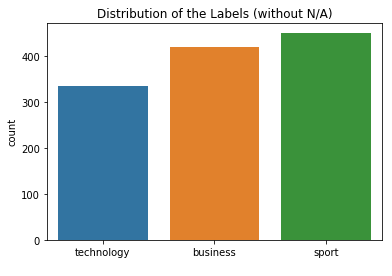

Class Distribution after performing under-sampling --> Train data (Fold 1 ):


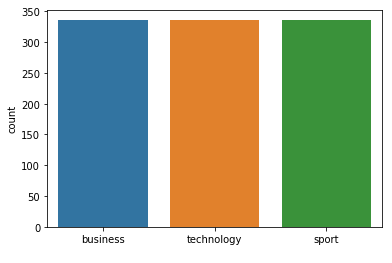



 ****** Test Data ******** (Fold 1 ):
             precision    recall  f1-score   support

  business
       1.00      0.99      0.99        71
     sport
       1.00      1.00      1.00        76
technology
       0.98      1.00      0.99        56

avg / total       1.00      1.00      1.00       203

Confusion Matrix (Fold 1 ):
[[70  0  1]
 [ 0 76  0]
 [ 0  0 56]]
FOLD 2
Class Distribution --> Train data (Fold 2 ):


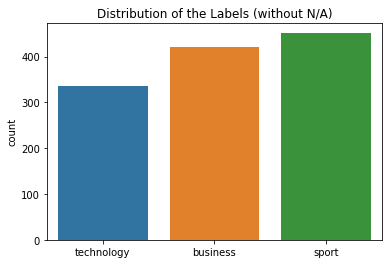

Class Distribution after performing under-sampling --> Train data (Fold 2 ):


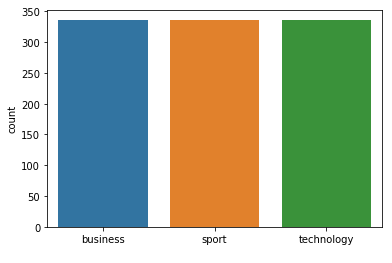



 ****** Test Data ******** (Fold 2 ):
             precision    recall  f1-score   support

  business
       0.99      0.97      0.98        70
     sport
       0.99      0.97      0.98        75
technology
       0.95      0.98      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 2 ):
[[68  0  2]
 [ 1 73  1]
 [ 0  1 55]]
FOLD 3
Class Distribution --> Train data (Fold 3 ):


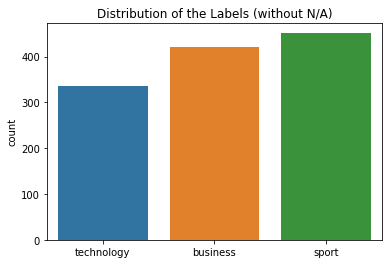

Class Distribution after performing under-sampling --> Train data (Fold 3 ):


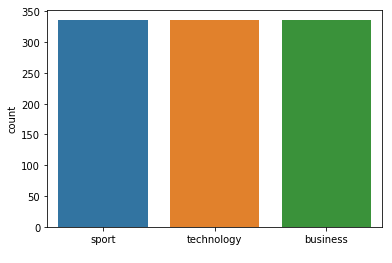



 ****** Test Data ******** (Fold 3 ):
             precision    recall  f1-score   support

  business
       1.00      0.96      0.98        70
     sport
       0.99      1.00      0.99        75
technology
       0.97      1.00      0.98        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 3 ):
[[67  1  2]
 [ 0 75  0]
 [ 0  0 56]]
FOLD 4
Class Distribution --> Train data (Fold 4 ):


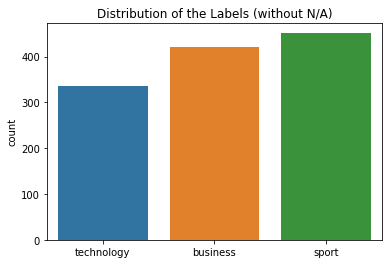

Class Distribution after performing under-sampling --> Train data (Fold 4 ):


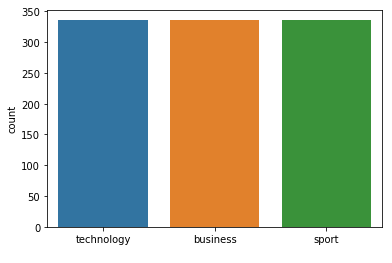



 ****** Test Data ******** (Fold 4 ):
             precision    recall  f1-score   support

  business
       0.97      1.00      0.99        70
     sport
       1.00      0.97      0.99        75
technology
       1.00      1.00      1.00        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 4 ):
[[70  0  0]
 [ 2 73  0]
 [ 0  0 56]]
FOLD 5
Class Distribution --> Train data (Fold 5 ):


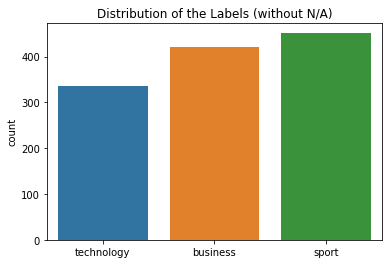

Class Distribution after performing under-sampling --> Train data (Fold 5 ):


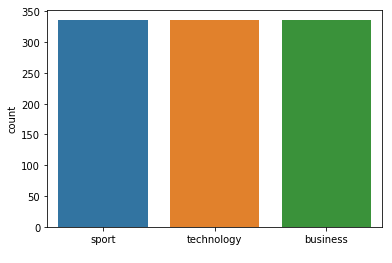



 ****** Test Data ******** (Fold 5 ):
             precision    recall  f1-score   support

  business
       0.99      0.99      0.99        70
     sport
       1.00      0.99      0.99        75
technology
       0.98      1.00      0.99        56

avg / total       0.99      0.99      0.99       201

Confusion Matrix (Fold 5 ):
[[69  0  1]
 [ 1 74  0]
 [ 0  0 56]]
FOLD 6
Class Distribution --> Train data (Fold 6 ):


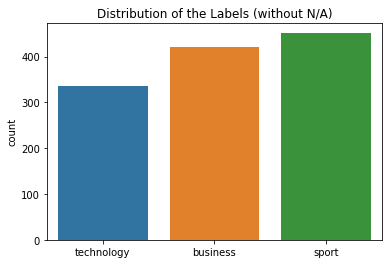

Class Distribution after performing under-sampling --> Train data (Fold 6 ):


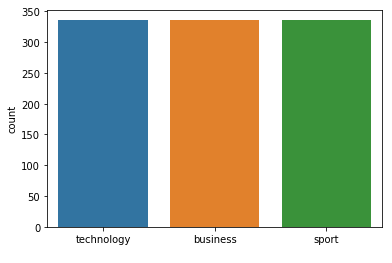



 ****** Test Data ******** (Fold 6 ):
             precision    recall  f1-score   support

  business
       0.97      0.99      0.98        70
     sport
       0.99      1.00      0.99        75
technology
       0.98      0.95      0.96        56

avg / total       0.98      0.98      0.98       201

Confusion Matrix (Fold 6 ):
[[69  0  1]
 [ 0 75  0]
 [ 2  1 53]]
FOLD 7
Class Distribution --> Train data (Fold 7 ):


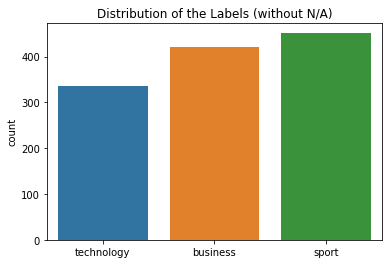

Class Distribution after performing under-sampling --> Train data (Fold 7 ):


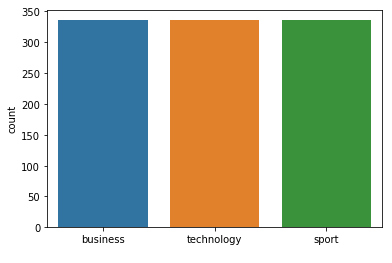



 ****** Test Data ******** (Fold 7 ):
             precision    recall  f1-score   support

  business
       0.96      0.97      0.96        70
     sport
       0.97      0.99      0.98        75
technology
       0.98      0.95      0.96        55

avg / total       0.97      0.97      0.97       200

Confusion Matrix (Fold 7 ):
[[68  1  1]
 [ 1 74  0]
 [ 2  1 52]]


 Model accuracy (over all 7  folds): 98.36% (+/- 0.83%)


In [387]:
cvscores_SVM_ngram = []

kfold = StratifiedKFold(n_splits=7, shuffle=True, random_state=seed)

fold=0

model = svm.SVC(kernel='linear', C=1)

for train, test in kfold.split(X_term_weighting_ngram, class_labels):
    fold+=1
    print('FOLD',fold)
    labels_train=[]
    for i in range(len(train)):
        labels_train.append(class_labels[train[i]])
    labels_test=[]
    for i in range(len(test)):
        labels_test.append(class_labels[test[i]])

    # Plot a bar plot of the labels: class distribution is adjusted
    #seaborn.countplot - Show value counts for a single categorical variable:
    print('Class Distribution --> Train data (Fold',fold,'):')
    ax = sns.countplot(labels_train)
    ax.set_title("Distribution of the Labels (without N/A)")
    plt.show()

    # Apply the random under-sampling
    #Oversampling and undersampling in data analysis are techniques used to adjust the class distribution of a data set 
    #(i.e. the ratio between the different classes/categories represented).
    rus = RandomUnderSampler(return_indices=True)
    train_rus, train_labels_rus, idx_resampled = rus.fit_sample(X_term_weighting_ngram[train], labels_train)
    train_rus, train_labels_rus = shuffle(train_rus, train_labels_rus)

    # Plot a bar plot of the labels
    #seaborn.countplot - Show value counts for a single categorical variable:
    print('Class Distribution after performing under-sampling --> Train data (Fold',fold,'):')
    ax = sns.countplot(train_labels_rus)
    sns.countplot(train_labels_rus) #--> class distribution is adjusted
    plt.show()

    # Fit/Train the model
    model.fit(train_rus, train_labels_rus)

    #Evaluate the Model; Use the test dataset to evaluate the model
    print('\n\n ****** Test Data ******** (Fold',fold,'):')
    predicted = model.predict(X_term_weighting_ngram[test])

    # Print performance details
    print(metrics.classification_report(labels_test, predicted))

    # Print confusion matrix
    print('Confusion Matrix (Fold',fold,'):')
    print(metrics.confusion_matrix(labels_test, predicted))

    cvscores_SVM_ngram.append(accuracy_score(labels_test, predicted) * 100)
print("\n\n Model accuracy (over all",fold," folds): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_SVM_ngram), numpy.std(cvscores_SVM_ngram)))

## k-NN Results

In [392]:
print ("\nNot balanced, without ngrams (n>1):\n The highest model accuracy",k_model_accuracy_not_bal[index_not_bal],"is achieved by using optimal number of neighbors %d" % optimal_k_not_bal)
print ("\nNot balanced, with ngrams (ngrams=(1,3)):\nThe highest model accuracy",k_model_accuracy_ngram_not_bal[index_ngram_not_bal],"is achieved by using optimal number of neighbors %d" % optimal_k_ngram_not_bal)
print ("\nBalanced, without ngrams (n>1):\nThe highest model accuracy",k_model_accuracy[index],"is achieved by using optimal number of neighbors %d" % optimal_k)
print ("\nBalanced, with ngrams (ngrams=(1,3)):\nThe highest model accuracy",k_model_accuracy_ngram[index_ngram],"is achieved by using optimal number of neighbors %d" % optimal_k_ngram)


Not balanced, without ngrams (n>1):
 The highest model accuracy 96.82067537908272 is achieved by using optimal number of neighbors 97

Not balanced, with ngrams (ngrams=(1,3)):
The highest model accuracy 96.80225321345199 is achieved by using optimal number of neighbors 125

Balanced, without ngrams (n>1):
The highest model accuracy 97.0565916786394 is achieved by using optimal number of neighbors 205

Balanced, with ngrams (ngrams=(1,3)):
The highest model accuracy 97.03437253145505 is achieved by using optimal number of neighbors 237


## SVM Results

In [393]:
print("\nNot balanced, without ngrams (n>1):\n Model accuracy (over all",fold," folds): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_SVM_not_bal), numpy.std(cvscores_SVM_not_bal)))
print("\nNot balanced, with ngrams (ngrams=(1,3)):\n Model accuracy (over all",fold," folds): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_SVM_ngram_not_bal), numpy.std(cvscores_SVM_ngram_not_bal)))
print("\nBalanced, without ngrams (n>1):\n Model accuracy (over all",fold," folds): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_SVM), numpy.std(cvscores_SVM)))
print("\nBalanced, with ngrams (ngrams=(1,3)):\n Model accuracy (over all",fold," folds): %.2f%% (+/- %.2f%%)" % (numpy.mean(cvscores_SVM_ngram), numpy.std(cvscores_SVM_ngram)))


Not balanced, without ngrams (n>1):
 Model accuracy (over all 7  folds): 98.51% (+/- 0.88%)

Not balanced, with ngrams (ngrams=(1,3)):
 Model accuracy (over all 7  folds): 98.36% (+/- 1.09%)

Balanced, without ngrams (n>1):
 Model accuracy (over all 7  folds): 98.51% (+/- 0.71%)

Balanced, with ngrams (ngrams=(1,3)):
 Model accuracy (over all 7  folds): 98.36% (+/- 0.83%)


### **Best kNN accuracy: 97.06%**

### **Best SVM accuracy: 98.51%**

We can see that the **SVM** performs a bit better than **kNN**. Also, the best accuracy for both algorithms was achieved when using **balanced distribution**, and following **preprocessing steps**:
filtering out english stop words, filtering out terms that appear less than 5 times, reducing all the terms to its canonical form (lemmatization). Also all words are lower case and more weights are given to the more "important" terms.

Also by using **three-grams** we are getting high accuracy as well and with that we are solving the problem of losing the order og words in a sentence (**2nd best kNN accuracy: 97.03%, 2nd best SVM accuracy: 98.36%**)